In [30]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [31]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [32]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[3166, 237, 2609, 44, 2881, 1679, 526, 5385, 6230, 4439, 3893, 3370, 4331, 6080, 4063, 6990, 7368, 2394, 3543, 4965]
log initialized
Average similarity between family members is 0.9652938128053827 at temperature -1
Average similarity between family and home is 0.9998486752387286 at temperature -1
Average similarity between students and their classroom is 0.7573013186891201 at temperature -1
Average classroom occupancy is 4.257142857142857 and number classrooms is 70
Average similarity between workers is 0.9683119753262962 at temperature -1
Average office occupancy is 3.350515463917526 and number offices is 194
Average friend similarity for adults: 0.8483659349183049 for kids: 0.718750155482595
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6173714158141911
avg restaurant similarity 0.642808650282778
avg restaurant similarity 0.6652410152095122
avg restaurant similarity 0.6487732749832504
avg restaurant similarity 0.6693113079760612
avg restaurant similarity 0.6653290887892827
avg restaurant similarity 0.6663099593931898
avg restaurant similarity 0.6828207431080802
avg restaurant similarity 0.7101566251848588
avg restaurant similarity 0.6406255072874498
avg restaurant similarity 0.6269242985283575
avg restaurant similarity 0.6308619201076502
avg restaurant similarity 0.6314996874762254
avg restaurant similarity 0.5702819562726599
avg restaurant similarity 0.6683357378350285
avg restaurant similarity 0.6104816226101992
avg restaurant similarity 0.6544743832408141
avg restaurant similarity 0.6353521959410355
avg restaurant similarity 0.6624014199906502
avg restaurant similarity 0.6288783963598533
avg restaurant similarity 0.6765583334664689
avg restaurant similarity 0.6896439556089009
avg restaur

avg restaurant similarity 0.7069610433651923
avg restaurant similarity 0.6575581222823463
avg restaurant similarity 0.6694024258043074
avg restaurant similarity 0.6113040097369293
avg restaurant similarity 0.6015598625609119
avg restaurant similarity 0.7145155191478145
avg restaurant similarity 0.5940532646085258
avg restaurant similarity 0.676152864621409
avg restaurant similarity 0.6855842792341433
avg restaurant similarity 0.6720888243857378
avg restaurant similarity 0.6498352552767491
avg restaurant similarity 0.6756075521335454
avg restaurant similarity 0.6941013343088154
avg restaurant similarity 0.6813244066621744
avg restaurant similarity 0.6466322695737245
avg restaurant similarity 0.6655152803689632
avg restaurant similarity 0.6470258182914576
avg restaurant similarity 0.6147531851686712
avg restaurant similarity 0.6625913188863943
avg restaurant similarity 0.667298170972009
avg restaurant similarity 0.6221884517577575
avg restaurant similarity 0.6925537447694978
avg restaura

avg restaurant similarity 0.7056763217533367
avg restaurant similarity 0.6870261452436386
avg restaurant similarity 0.6500530599574564
avg restaurant similarity 0.7206866621979952
avg restaurant similarity 0.6468770575093264
avg restaurant similarity 0.7111219567348523
avg restaurant similarity 0.6895931301537659
avg restaurant similarity 0.6848705767008544
avg restaurant similarity 0.6800249737730074
avg restaurant similarity 0.6912111486010257
avg restaurant similarity 0.7016925207648611
avg restaurant similarity 0.6599705220816914
avg restaurant similarity 0.6899157895981867
avg restaurant similarity 0.7001959692842783
avg restaurant similarity 0.6908096266657516
avg restaurant similarity 0.7040544952047995
avg restaurant similarity 0.6833111267155032
avg restaurant similarity 0.6829324808783254
avg restaurant similarity 0.7006187222622978
avg restaurant similarity 0.6667583120030847
avg restaurant similarity 0.7278612752158561
avg restaurant similarity 0.6834392008928094
avg restau

avg restaurant similarity 0.6944231589494918
avg restaurant similarity 0.672087520039536
avg restaurant similarity 0.6543525029401495
avg restaurant similarity 0.6709003613868926
avg restaurant similarity 0.6660219187569965
avg restaurant similarity 0.6877252058605575
avg restaurant similarity 0.6444186364994003
avg restaurant similarity 0.6522562940803632
avg restaurant similarity 0.6619650166362049
avg restaurant similarity 0.725900216398623
avg restaurant similarity 0.6601867846837854
avg restaurant similarity 0.723319822921831
avg restaurant similarity 0.7242722966845604
avg restaurant similarity 0.672640353604047
avg restaurant similarity 0.6732093104653147
avg restaurant similarity 0.651011482960891
avg restaurant similarity 0.7001918897672822
avg restaurant similarity 0.6448819079630281
avg restaurant similarity 0.6613888586826701
avg restaurant similarity 0.6779570772183551
avg restaurant similarity 0.7048992791724736
avg restaurant similarity 0.6940098807115309
avg restaurant 

avg restaurant similarity 0.6261986635315705
avg restaurant similarity 0.6915255468245334
avg restaurant similarity 0.5943795901881842
avg restaurant similarity 0.6198034644214259
avg restaurant similarity 0.6522184778852446
avg restaurant similarity 0.6542851341514045
avg restaurant similarity 0.6151831478868071
avg restaurant similarity 0.656116891348136
avg restaurant similarity 0.6181283569427232
avg restaurant similarity 0.6059511075099528
avg restaurant similarity 0.6506040266743413
avg restaurant similarity 0.6105229687289665
avg restaurant similarity 0.6253168614929959
avg restaurant similarity 0.7061681201737163
avg restaurant similarity 0.6476421368655206
avg restaurant similarity 0.677144651716035
avg restaurant similarity 0.6375926829722159
avg restaurant similarity 0.6586828522020496
avg restaurant similarity 0.6302195295147099
avg restaurant similarity 0.610948710263453
avg restaurant similarity 0.6539838795893786
avg restaurant similarity 0.6539183149213252
avg restauran

avg restaurant similarity 0.620820202196821
avg restaurant similarity 0.6556158656243228
avg restaurant similarity 0.655636925774054
avg restaurant similarity 0.6654279443176497
avg restaurant similarity 0.639774986375479
avg restaurant similarity 0.589463691925807
avg restaurant similarity 0.6193001487826574
avg restaurant similarity 0.6193543831503254
avg restaurant similarity 0.6078054979664563
avg restaurant similarity 0.6120054239431842
avg restaurant similarity 0.6145027912953152
avg restaurant similarity 0.6050988044878902
avg restaurant similarity 0.6546604387162615
avg restaurant similarity 0.6840139536192414
avg restaurant similarity 0.6300089644042283
avg restaurant similarity 0.6414693575288511
avg restaurant similarity 0.6145213881258185
avg restaurant similarity 0.6193883030169659
avg restaurant similarity 0.633266888122718
avg restaurant similarity 0.6912692223537266
avg restaurant similarity 0.6655426266498063
avg restaurant similarity 0.6515293181821037
avg restaurant 

avg restaurant similarity 0.6370587060234613
avg restaurant similarity 0.6704397569562033
avg restaurant similarity 0.6582471873785213
avg restaurant similarity 0.6278579212739152
avg restaurant similarity 0.6208401963030967
avg restaurant similarity 0.7238817781639897
avg restaurant similarity 0.6919378478060662
avg restaurant similarity 0.6682120639335839
avg restaurant similarity 0.6379728313920218
avg restaurant similarity 0.655712478201922
avg restaurant similarity 0.6487838194756064
avg restaurant similarity 0.7467780461109398
avg restaurant similarity 0.7321386222151116
avg restaurant similarity 0.7053827800266483
avg restaurant similarity 0.6977762592589327
avg restaurant similarity 0.6625165700053831
avg restaurant similarity 0.6607571293106418
avg restaurant similarity 0.6953357847554971
avg restaurant similarity 0.6658319784159418
avg restaurant similarity 0.6986096333621259
avg restaurant similarity 0.6623670590791688
avg restaurant similarity 0.7031017292543313
avg restaur

avg restaurant similarity 0.6833392786715338
avg restaurant similarity 0.6997435877855069
avg restaurant similarity 0.7195473814696265
avg restaurant similarity 0.6773393586190399
avg restaurant similarity 0.668201631879103
avg restaurant similarity 0.6747634690790433
avg restaurant similarity 0.7310234648768583
avg restaurant similarity 0.6832236076472438
avg restaurant similarity 0.6820209642101362
avg restaurant similarity 0.727729421644483
avg restaurant similarity 0.6318976623567151
avg restaurant similarity 0.7440282074742961
avg restaurant similarity 0.6572991489417693
avg restaurant similarity 0.6588060009597014
avg restaurant similarity 0.6898307754900186
avg restaurant similarity 0.6843774682358499
avg restaurant similarity 0.6746938061728001
avg restaurant similarity 0.6721645385065104
avg restaurant similarity 0.6680589397300453
avg restaurant similarity 0.689675971773769
avg restaurant similarity 0.7124852469526004
avg restaurant similarity 0.7307315598009666
avg restauran

avg restaurant similarity 0.7210755282191268
avg restaurant similarity 0.6357072700347255
avg restaurant similarity 0.6629051499326354
avg restaurant similarity 0.6352871699390433
avg restaurant similarity 0.7069102198969489
avg restaurant similarity 0.6847976656689578
avg restaurant similarity 0.6762434749798547
avg restaurant similarity 0.6388956995720146
avg restaurant similarity 0.7055864921665003
avg restaurant similarity 0.650488308366805
avg restaurant similarity 0.6738137177109291
avg restaurant similarity 0.6537047835973865
avg restaurant similarity 0.6779838550395753
avg restaurant similarity 0.69201311112712
avg restaurant similarity 0.6715569387253771
avg restaurant similarity 0.6552431796891172
avg restaurant similarity 0.6879184537558789
avg restaurant similarity 0.6512999031290658
avg restaurant similarity 0.6865419573100325
avg restaurant similarity 0.6869406675884866
avg restaurant similarity 0.6991618887283615
avg restaurant similarity 0.6943746089420978
avg restauran

avg restaurant similarity 0.7003688497999853
avg restaurant similarity 0.6862873904452299
avg restaurant similarity 0.6480140308518957
avg restaurant similarity 0.6396994811938909
avg restaurant similarity 0.6404821001856159
avg restaurant similarity 0.7096753363710543
avg restaurant similarity 0.6312298391678848
avg restaurant similarity 0.7006997786113324
avg restaurant similarity 0.6645507489634883
avg restaurant similarity 0.7193694508265382
avg restaurant similarity 0.6618847993659106
avg restaurant similarity 0.6654633691037855
avg restaurant similarity 0.6747757762060818
avg restaurant similarity 0.6563985913089049
avg restaurant similarity 0.6965225703585637
avg restaurant similarity 0.6696445730366685
avg restaurant similarity 0.6406186132271944
avg restaurant similarity 0.6881858450062276
avg restaurant similarity 0.6735573973701846
avg restaurant similarity 0.6627822327789683
avg restaurant similarity 0.6799423253078055
avg restaurant similarity 0.6848797405744634
avg restau

avg restaurant similarity 0.5782421602661013
avg restaurant similarity 0.6065649146668305
avg restaurant similarity 0.6934517895322135
avg restaurant similarity 0.5985806521234354
avg restaurant similarity 0.668478177907164
avg restaurant similarity 0.666350169409081
avg restaurant similarity 0.6660724550748054
avg restaurant similarity 0.5915731269389836
avg restaurant similarity 0.6252365472549645
avg restaurant similarity 0.6390439932967288
avg restaurant similarity 0.6054510179999715
avg restaurant similarity 0.5912626563833066
avg restaurant similarity 0.6142668223669089
avg restaurant similarity 0.6223451812268102
avg restaurant similarity 0.5982515329661404
avg restaurant similarity 0.6012242138932414
avg restaurant similarity 0.5405362546802454
avg restaurant similarity 0.6310059871265719
avg restaurant similarity 0.6969476868859964
avg restaurant similarity 0.6540311216596585
avg restaurant similarity 0.6024823811336337
avg restaurant similarity 0.6131441395386604
avg restaura

avg restaurant similarity 0.6170781461333423
avg restaurant similarity 0.6207425059445819
avg restaurant similarity 0.6453780375615884
avg restaurant similarity 0.6836594911072446
avg restaurant similarity 0.5624467649269342
avg restaurant similarity 0.6520701526239465
avg restaurant similarity 0.5943258203083673
avg restaurant similarity 0.6669713597099658
avg restaurant similarity 0.5980342297934551
avg restaurant similarity 0.6380028423759002
avg restaurant similarity 0.6695921180467347
avg restaurant similarity 0.6238454794203205
avg restaurant similarity 0.6170973745060112
avg restaurant similarity 0.6573263776406577
avg restaurant similarity 0.7084364835006086
avg restaurant similarity 0.6568718128413247
avg restaurant similarity 0.6193515648229105
avg restaurant similarity 0.6467965248045294
avg restaurant similarity 0.6775500552144978
avg restaurant similarity 0.6183316923301186
avg restaurant similarity 0.6515364742213688
avg restaurant similarity 0.6598129022059528
avg restau

avg restaurant similarity 0.6259236050715273
avg restaurant similarity 0.6344550522565195
avg restaurant similarity 0.6207905028558967
avg restaurant similarity 0.6553415497487576
avg restaurant similarity 0.6231549114769388
avg restaurant similarity 0.6571038382642768
avg restaurant similarity 0.6246527577465117
avg restaurant similarity 0.6579922488497894
avg restaurant similarity 0.6370759601364375
avg restaurant similarity 0.684885002864459
avg restaurant similarity 0.6341764076526522
avg restaurant similarity 0.6703231378411635
avg restaurant similarity 0.6304814502160632
avg restaurant similarity 0.6621845071943534
avg restaurant similarity 0.6473816229594468
avg restaurant similarity 0.6221999139076221
avg restaurant similarity 0.6553181785890793
avg restaurant similarity 0.632576815347736
avg restaurant similarity 0.6769893938262171
avg restaurant similarity 0.6583504293977145
avg restaurant similarity 0.6617632008764442
avg restaurant similarity 0.6197928991143804
avg restaura

avg restaurant similarity 0.6277003870817003
avg restaurant similarity 0.6276687787476573
avg restaurant similarity 0.6599892392816626
avg restaurant similarity 0.6513028597295273
avg restaurant similarity 0.6014963810663958
avg restaurant similarity 0.6875841727056299
avg restaurant similarity 0.6057341614200209
avg restaurant similarity 0.6648790236201981
avg restaurant similarity 0.6391745526711401
avg restaurant similarity 0.6850065676145828
avg restaurant similarity 0.6565803555436739
avg restaurant similarity 0.6549704708513294
avg restaurant similarity 0.6345942937396916
avg restaurant similarity 0.6885645917824851
avg restaurant similarity 0.6309806201197466
avg restaurant similarity 0.6568739932422086
avg restaurant similarity 0.6215121100798437
avg restaurant similarity 0.6607112200764614
avg restaurant similarity 0.5947662645082779
avg restaurant similarity 0.6200579542476287
avg restaurant similarity 0.7039379430780114
avg restaurant similarity 0.6590682201834231
avg restau

avg restaurant similarity 0.7050695982802407
avg restaurant similarity 0.6737083390549858
avg restaurant similarity 0.7237660842354561
avg restaurant similarity 0.7724559643917108
avg restaurant similarity 0.6940800888642108
avg restaurant similarity 0.6861445673104187
avg restaurant similarity 0.724127948847719
avg restaurant similarity 0.669810858527522
avg restaurant similarity 0.7069912214236835
avg restaurant similarity 0.6563007429473261
avg restaurant similarity 0.6616742922409075
avg restaurant similarity 0.7058323460437782
avg restaurant similarity 0.7566590026836285
avg restaurant similarity 0.6905202979269943
avg restaurant similarity 0.6811223388646204
avg restaurant similarity 0.6679130457703327
avg restaurant similarity 0.7175494820723145
avg restaurant similarity 0.6691566766557676
avg restaurant similarity 0.7007479772409141
avg restaurant similarity 0.6661150094163455
avg restaurant similarity 0.6934681450554259
avg restaurant similarity 0.7513078107432963
avg restaura

avg restaurant similarity 0.6945960985875447
avg restaurant similarity 0.6606819791607971
avg restaurant similarity 0.6999312293147141
avg restaurant similarity 0.6670223481178047
avg restaurant similarity 0.6928083865168178
avg restaurant similarity 0.7330354672651842
avg restaurant similarity 0.7012461900775628
avg restaurant similarity 0.6535137868040833
avg restaurant similarity 0.6984619333206991
avg restaurant similarity 0.7057130846251011
avg restaurant similarity 0.7580554294233881
avg restaurant similarity 0.6846657143666273
avg restaurant similarity 0.6858470780789262
avg restaurant similarity 0.6697030144800915
avg restaurant similarity 0.6908986402128259
avg restaurant similarity 0.6905630060388557
avg restaurant similarity 0.6723543398202527
avg restaurant similarity 0.7018720366624753
avg restaurant similarity 0.7365459465866512
avg restaurant similarity 0.6879886037596817
avg restaurant similarity 0.6698252446579229
avg restaurant similarity 0.7432395983824333
avg restau

avg restaurant similarity 0.656934572068489
avg restaurant similarity 0.6861703467176405
avg restaurant similarity 0.6597010915235285
avg restaurant similarity 0.7001678859817917
avg restaurant similarity 0.7220468259117847
avg restaurant similarity 0.6661161226861748
avg restaurant similarity 0.6905265853262359
avg restaurant similarity 0.680833341128438
avg restaurant similarity 0.6804275824347251
avg restaurant similarity 0.6338260294204424
avg restaurant similarity 0.6845175937255797
avg restaurant similarity 0.6489055298265659
avg restaurant similarity 0.6803156837619094
avg restaurant similarity 0.6911037538101217
avg restaurant similarity 0.616952346758753
avg restaurant similarity 0.6793213788320661
avg restaurant similarity 0.651174816865309
avg restaurant similarity 0.6549205070010365
avg restaurant similarity 0.6776776491128053
avg restaurant similarity 0.6646868789513781
avg restaurant similarity 0.6800761292919775
avg restaurant similarity 0.6673340376835319
avg restaurant

avg restaurant similarity 0.7059792564118551
avg restaurant similarity 0.6963804226783074
avg restaurant similarity 0.7079924326275833
avg restaurant similarity 0.734771065375695
avg restaurant similarity 0.6462262495406741
avg restaurant similarity 0.7027660487818911
avg restaurant similarity 0.6504675535509333
avg restaurant similarity 0.7208988694386488
avg restaurant similarity 0.7070638876625915
avg restaurant similarity 0.7441332932898927
avg restaurant similarity 0.6791830493255551
avg restaurant similarity 0.7186303989891702
avg restaurant similarity 0.6927609949637189
avg restaurant similarity 0.6824884117727219
avg restaurant similarity 0.7240490672792628
avg restaurant similarity 0.7046146134290012
avg restaurant similarity 0.7038842605069673
avg restaurant similarity 0.7140049010416325
avg restaurant similarity 0.6671993292759852
avg restaurant similarity 0.683811071066094
avg restaurant similarity 0.6642761105445809
avg restaurant similarity 0.6665384908973896
avg restaura

avg restaurant similarity 0.6863455131677059
avg restaurant similarity 0.6226855884410643
avg restaurant similarity 0.6073174869702561
avg restaurant similarity 0.6572793574490688
avg restaurant similarity 0.6498312173125343
avg restaurant similarity 0.6427706640980158
avg restaurant similarity 0.622951174019205
avg restaurant similarity 0.6423132437682706
avg restaurant similarity 0.6542522345504483
avg restaurant similarity 0.6678828547606953
avg restaurant similarity 0.6456809929513145
avg restaurant similarity 0.6625382117677961
avg restaurant similarity 0.7167350453973873
avg restaurant similarity 0.6541093784656554
avg restaurant similarity 0.6318985260109045
avg restaurant similarity 0.6141320538866178
avg restaurant similarity 0.6724718221512294
avg restaurant similarity 0.6487629452044102
avg restaurant similarity 0.601027272199524
avg restaurant similarity 0.6330580664110039
avg restaurant similarity 0.6586951996830717
avg restaurant similarity 0.6495088087009437
avg restaura

avg restaurant similarity 0.6607840630644726
avg restaurant similarity 0.6341873720236959
avg restaurant similarity 0.6445422703776041
avg restaurant similarity 0.6643267840700152
avg restaurant similarity 0.6297234381728444
avg restaurant similarity 0.6564300669969032
avg restaurant similarity 0.6278177292448516
avg restaurant similarity 0.6382469235958232
avg restaurant similarity 0.6472216360621657
avg restaurant similarity 0.6500933410317256
avg restaurant similarity 0.6404229631884734
avg restaurant similarity 0.60795207930126
avg restaurant similarity 0.6393768469220383
avg restaurant similarity 0.5840914139544626
avg restaurant similarity 0.659254575290222
avg restaurant similarity 0.649408992842732
avg restaurant similarity 0.6095212998590043
avg restaurant similarity 0.6806439643773703
avg restaurant similarity 0.7523207727217286
avg restaurant similarity 0.6412824727937408
avg restaurant similarity 0.6441588408836889
avg restaurant similarity 0.6063696218900706
avg restaurant

avg restaurant similarity 0.6541563338549136
avg restaurant similarity 0.6748361694856425
avg restaurant similarity 0.7257239338237219
avg restaurant similarity 0.6997131852358357
avg restaurant similarity 0.7190426618738169
avg restaurant similarity 0.6996133063157947
avg restaurant similarity 0.6961183506731908
avg restaurant similarity 0.684104033883634
avg restaurant similarity 0.6968975349384062
avg restaurant similarity 0.7266355870630695
avg restaurant similarity 0.6664648340360085
avg restaurant similarity 0.6726435351966505
avg restaurant similarity 0.6944391095099757
avg restaurant similarity 0.7242542607489827
avg restaurant similarity 0.6700697810987402
avg restaurant similarity 0.679141097986994
avg restaurant similarity 0.7118458299313088
avg restaurant similarity 0.6717841708434111
avg restaurant similarity 0.7096834868157864
avg restaurant similarity 0.6660674801229347
avg restaurant similarity 0.6823013667883611
avg restaurant similarity 0.7078046578234013
avg restaura

avg restaurant similarity 0.6496127167884793
avg restaurant similarity 0.7164488917848428
avg restaurant similarity 0.6706064009746922
avg restaurant similarity 0.7111525550061726
avg restaurant similarity 0.6792176682689541
avg restaurant similarity 0.6775971639031165
avg restaurant similarity 0.7081921642475751
avg restaurant similarity 0.7129576037144023
avg restaurant similarity 0.6480383009236724
avg restaurant similarity 0.6711199983740861
avg restaurant similarity 0.6923275902472331
avg restaurant similarity 0.7040407076735239
avg restaurant similarity 0.6741134051853447
avg restaurant similarity 0.6995157692812771
avg restaurant similarity 0.6782211707034519
avg restaurant similarity 0.7055908503090623
avg restaurant similarity 0.6878412480943579
avg restaurant similarity 0.6780971260808596
avg restaurant similarity 0.6456660795318533
avg restaurant similarity 0.7123864980449585
avg restaurant similarity 0.7062252651444002
avg restaurant similarity 0.6522923084715628
avg restau

avg restaurant similarity 0.6877428454296136
avg restaurant similarity 0.6496827011113445
avg restaurant similarity 0.6697889568291738
avg restaurant similarity 0.6960240810700891
avg restaurant similarity 0.6757411152853023
avg restaurant similarity 0.6610031458304203
avg restaurant similarity 0.7076007029400124
avg restaurant similarity 0.6987321905070615
avg restaurant similarity 0.6826911819413716
avg restaurant similarity 0.6666055995203821
avg restaurant similarity 0.6764971227111737
avg restaurant similarity 0.682537572427641
avg restaurant similarity 0.6485521816652376
avg restaurant similarity 0.7149264500538264
avg restaurant similarity 0.6439824156093801
avg restaurant similarity 0.6869947545526295
avg restaurant similarity 0.7274613698707386
avg restaurant similarity 0.6853104562747764
avg restaurant similarity 0.6415786165513135
avg restaurant similarity 0.6923787049313415
avg restaurant similarity 0.6838672286492461
avg restaurant similarity 0.646550403161384
avg restaura

avg restaurant similarity 0.6433796093928419
avg restaurant similarity 0.6725580349632859
avg restaurant similarity 0.6717269475123382
avg restaurant similarity 0.6658525340061406
avg restaurant similarity 0.6788748492850124
avg restaurant similarity 0.6831392016802005
avg restaurant similarity 0.6725668026188184
avg restaurant similarity 0.6926070981127216
avg restaurant similarity 0.6541550966148837
avg restaurant similarity 0.6927555970590928
avg restaurant similarity 0.6624864667998284
avg restaurant similarity 0.6749915668744854
avg restaurant similarity 0.7191875903597116
avg restaurant similarity 0.6942017427550217
avg restaurant similarity 0.6866557999307875
avg restaurant similarity 0.6762700219710864
avg restaurant similarity 0.6463007517594525
avg restaurant similarity 0.7012365518008622
avg restaurant similarity 0.639948988370679
avg restaurant similarity 0.6838428540668362
avg restaurant similarity 0.6805350314202243
avg restaurant similarity 0.7034320309733965
avg restaur

avg restaurant similarity 0.7044980767899941
avg restaurant similarity 0.6028791019056051
avg restaurant similarity 0.6750598766492962
avg restaurant similarity 0.6148536657449432
avg restaurant similarity 0.6923548432558295
avg restaurant similarity 0.6861000445269981
avg restaurant similarity 0.6683078843330998
avg restaurant similarity 0.6187862270765949
avg restaurant similarity 0.7005218798180045
avg restaurant similarity 0.637238994590523
avg restaurant similarity 0.6932870428388095
avg restaurant similarity 0.6668140430248188
avg restaurant similarity 0.6476249413149765
avg restaurant similarity 0.6744095811252346
avg restaurant similarity 0.6654593037109218
avg restaurant similarity 0.6849053826930087
avg restaurant similarity 0.6550264002270344
avg restaurant similarity 0.6759051321468151
avg restaurant similarity 0.6714415639620457
avg restaurant similarity 0.6700851152477183
avg restaurant similarity 0.6612363391384981
avg restaurant similarity 0.6896443667002209
avg restaur

avg restaurant similarity 0.681951091866829
avg restaurant similarity 0.7181181833948066
avg restaurant similarity 0.7316377263068505
avg restaurant similarity 0.7223653633735718
avg restaurant similarity 0.6744521760812862
avg restaurant similarity 0.725018095652726
avg restaurant similarity 0.6637877106892744
avg restaurant similarity 0.6843636774274365
avg restaurant similarity 0.750918516104474
avg restaurant similarity 0.6592457068460982
avg restaurant similarity 0.6633746099034605
avg restaurant similarity 0.6827212748235271
avg restaurant similarity 0.6800774917189125
avg restaurant similarity 0.7048724718833769
avg restaurant similarity 0.7183411300796435
avg restaurant similarity 0.7044797332406632
avg restaurant similarity 0.6828000486401107
avg restaurant similarity 0.6901617689145864
avg restaurant similarity 0.6128954760132596
avg restaurant similarity 0.6871625112377762
avg restaurant similarity 0.6973002014851584
avg restaurant similarity 0.7007689539109409
avg restauran

avg restaurant similarity 0.690077958226678
avg restaurant similarity 0.6652154886150863
avg restaurant similarity 0.6702275749632935
avg restaurant similarity 0.6638182710680761
avg restaurant similarity 0.6777189747141604
avg restaurant similarity 0.6398977449534323
avg restaurant similarity 0.6858281692723216
avg restaurant similarity 0.6785330173651178
avg restaurant similarity 0.6894889650246555
avg restaurant similarity 0.7015071776453398
avg restaurant similarity 0.673636137639648
avg restaurant similarity 0.6874811734234588
avg restaurant similarity 0.679777607438956
avg restaurant similarity 0.6678320235657407
avg restaurant similarity 0.6892363733029143
avg restaurant similarity 0.6388185954437384
avg restaurant similarity 0.6472330357661014
avg restaurant similarity 0.6574691605662797
avg restaurant similarity 0.6871063023392797
avg restaurant similarity 0.6444385942771983
avg restaurant similarity 0.6316208266042197
avg restaurant similarity 0.6681475283331718
avg restauran

avg restaurant similarity 0.7067768912276683
avg restaurant similarity 0.70509874016184
avg restaurant similarity 0.6457683371673133
avg restaurant similarity 0.6906983546363415
avg restaurant similarity 0.7101979446504174
avg restaurant similarity 0.7280941025479071
avg restaurant similarity 0.6948792521319023
avg restaurant similarity 0.6717806688715529
avg restaurant similarity 0.6971988752768525
avg restaurant similarity 0.7025015644400773
avg restaurant similarity 0.657303173318379
avg restaurant similarity 0.6992701977839131
avg restaurant similarity 0.7488417634964666
avg restaurant similarity 0.6722351395890905
avg restaurant similarity 0.6400767377250356
avg restaurant similarity 0.701424551278434
avg restaurant similarity 0.7035571620464842
avg restaurant similarity 0.7051997359092668
avg restaurant similarity 0.7218900095626573
avg restaurant similarity 0.6749021525197154
avg restaurant similarity 0.7191734287963477
avg restaurant similarity 0.6912397156654638
avg restaurant

avg restaurant similarity 0.6533795819313305
avg restaurant similarity 0.6946476764899729
avg restaurant similarity 0.6584001904709926
avg restaurant similarity 0.6861124499849971
avg restaurant similarity 0.7596890723096141
avg restaurant similarity 0.6907890226129606
avg restaurant similarity 0.6832476872438077
avg restaurant similarity 0.6706925490485143
avg restaurant similarity 0.7113855873172803
avg restaurant similarity 0.6851244312806968
avg restaurant similarity 0.7163266881072993
avg restaurant similarity 0.664630515610735
avg restaurant similarity 0.697435384101965
avg restaurant similarity 0.6832612257254497
avg restaurant similarity 0.6977770888564994
avg restaurant similarity 0.6559318257745893
avg restaurant similarity 0.7730420940960115
avg restaurant similarity 0.7215529794357319
avg restaurant similarity 0.6721570872938061
avg restaurant similarity 0.7178131032637179
avg restaurant similarity 0.6878216625469141
avg restaurant similarity 0.6744311051152878
avg restaura

avg restaurant similarity 0.661135086377112
avg restaurant similarity 0.7343079222655161
avg restaurant similarity 0.657237175691732
avg restaurant similarity 0.6248445725227454
avg restaurant similarity 0.7103861976649647
avg restaurant similarity 0.7069041430415713
avg restaurant similarity 0.713729288135776
avg restaurant similarity 0.7248183906685768
avg restaurant similarity 0.7168485064607112
avg restaurant similarity 0.7283566014117925
avg restaurant similarity 0.6696813587434581
avg restaurant similarity 0.7078760808604418
avg restaurant similarity 0.6991130877337222
avg restaurant similarity 0.7192368763268676
avg restaurant similarity 0.6660335456074823
avg restaurant similarity 0.7173870662576175
avg restaurant similarity 0.6505509241744686
avg restaurant similarity 0.6528234733332069
avg restaurant similarity 0.7047063594276073
avg restaurant similarity 0.6894887195903395
avg restaurant similarity 0.6496709392343869
avg restaurant similarity 0.6402689702053138
avg restauran

avg restaurant similarity 0.6552848222122755
avg restaurant similarity 0.6372297477370501
avg restaurant similarity 0.6819822637452794
avg restaurant similarity 0.7203538546995206
avg restaurant similarity 0.6788123365614633
avg restaurant similarity 0.7123759661551331
avg restaurant similarity 0.7056661949245657
avg restaurant similarity 0.703005155568009
avg restaurant similarity 0.6820137835466802
avg restaurant similarity 0.664939032488791
avg restaurant similarity 0.6747697523810657
avg restaurant similarity 0.7187583387548133
avg restaurant similarity 0.7047661344116956
avg restaurant similarity 0.661434523521902
avg restaurant similarity 0.7004149423331727
avg restaurant similarity 0.6750035790580867
avg restaurant similarity 0.6603938790618064
avg restaurant similarity 0.704288271881725
avg restaurant similarity 0.7402117375187657
avg restaurant similarity 0.6955432902688418
avg restaurant similarity 0.6375404273643062
avg restaurant similarity 0.7097130344939715
avg restaurant

avg restaurant similarity 0.75295960937987
avg restaurant similarity 0.6808938799608643
avg restaurant similarity 0.6886202670571258
avg restaurant similarity 0.6747731067684327
avg restaurant similarity 0.6876488474797828
avg restaurant similarity 0.6409514787506576
avg restaurant similarity 0.6858178567429349
avg restaurant similarity 0.6929093256909314
avg restaurant similarity 0.6895953217031892
avg restaurant similarity 0.663983654040095
avg restaurant similarity 0.684952696983251
avg restaurant similarity 0.6919423172736399
avg restaurant similarity 0.6908119926533336
avg restaurant similarity 0.6521048930991773
avg restaurant similarity 0.6827856342348333
avg restaurant similarity 0.7230914588005468
avg restaurant similarity 0.6773470197824278
avg restaurant similarity 0.680321403958361
avg restaurant similarity 0.8021767636026909
avg restaurant similarity 0.7194970330743388
avg restaurant similarity 0.6852409449803601
avg restaurant similarity 0.649705172825759
avg restaurant s

avg restaurant similarity 0.6452204984191402
avg restaurant similarity 0.6792458000514244
avg restaurant similarity 0.5566682403426141
avg restaurant similarity 0.6906938770501496
avg restaurant similarity 0.6882098868778077
avg restaurant similarity 0.6948827687994638
avg restaurant similarity 0.598873057134831
avg restaurant similarity 0.6459772685030563
avg restaurant similarity 0.6415162156604114
avg restaurant similarity 0.6787167538677509
avg restaurant similarity 0.6178463688432253
avg restaurant similarity 0.5941321059685456
avg restaurant similarity 0.6677942846656404
avg restaurant similarity 0.6839938441777902
avg restaurant similarity 0.6940534725324828
avg restaurant similarity 0.6790815753172212
avg restaurant similarity 0.6400708065814762
avg restaurant similarity 0.679789868509518
avg restaurant similarity 0.6326404469668229
avg restaurant similarity 0.6757931785945799
avg restaurant similarity 0.6284204682334468
avg restaurant similarity 0.6294219815974085
avg restaura

avg restaurant similarity 0.690113567936199
avg restaurant similarity 0.6370561132274898
avg restaurant similarity 0.6233083166532482
avg restaurant similarity 0.6339983315287285
avg restaurant similarity 0.6773159627692443
avg restaurant similarity 0.6586061962174418
avg restaurant similarity 0.691012927961161
avg restaurant similarity 0.626302887967089
avg restaurant similarity 0.6602161656050589
avg restaurant similarity 0.5936248215562006
avg restaurant similarity 0.6494975717765896
avg restaurant similarity 0.6695140066198715
avg restaurant similarity 0.5494912029510535
avg restaurant similarity 0.6740667563062025
avg restaurant similarity 0.620551173285361
avg restaurant similarity 0.6453107977195022
avg restaurant similarity 0.69704716915939
avg restaurant similarity 0.6511880972531335
avg restaurant similarity 0.6336641459774318
avg restaurant similarity 0.6781886120561806
avg restaurant similarity 0.7090101393047387
avg restaurant similarity 0.6466367723440093
avg restaurant s

avg restaurant similarity 0.6717878487741833
avg restaurant similarity 0.723751494800246
avg restaurant similarity 0.6862758132138416
avg restaurant similarity 0.7342890455932074
avg restaurant similarity 0.67790089846444
avg restaurant similarity 0.7336977717501655
avg restaurant similarity 0.6548241514206625
avg restaurant similarity 0.6988431281987503
avg restaurant similarity 0.6987305574661897
avg restaurant similarity 0.6945373229197659
avg restaurant similarity 0.7246918040965938
avg restaurant similarity 0.6936652178096029
avg restaurant similarity 0.701957168385646
avg restaurant similarity 0.6509102970715026
avg restaurant similarity 0.671628846813723
avg restaurant similarity 0.678449488651225
avg restaurant similarity 0.6579218647112364
avg restaurant similarity 0.6625313089208443
avg restaurant similarity 0.6595998296285243
avg restaurant similarity 0.6781597337202271
avg restaurant similarity 0.6592351049382155
avg restaurant similarity 0.6795316514227423
avg restaurant s

avg restaurant similarity 0.6751252380812588
avg restaurant similarity 0.6097087809000097
avg restaurant similarity 0.7155008971404508
avg restaurant similarity 0.6448320989587628
avg restaurant similarity 0.6730236725499591
avg restaurant similarity 0.6477095316794458
avg restaurant similarity 0.6314094939270588
avg restaurant similarity 0.6837824237093423
avg restaurant similarity 0.6810708301884927
avg restaurant similarity 0.6675489342735623
avg restaurant similarity 0.6818908718660935
avg restaurant similarity 0.6967402953674057
avg restaurant similarity 0.6599360952823736
avg restaurant similarity 0.6827652128540995
avg restaurant similarity 0.6737153553730479
avg restaurant similarity 0.6831875602978754
avg restaurant similarity 0.6953944619885708
avg restaurant similarity 0.6662950233178178
avg restaurant similarity 0.6858114860805476
avg restaurant similarity 0.6901295656419155
avg restaurant similarity 0.6804302113598779
avg restaurant similarity 0.6282195138846127
avg restau

avg restaurant similarity 0.5626445243564097
avg restaurant similarity 0.6374472158575645
avg restaurant similarity 0.6232633947021513
avg restaurant similarity 0.602277791649842
avg restaurant similarity 0.6402213189717282
avg restaurant similarity 0.6234970315602554
avg restaurant similarity 0.5818693276397144
avg restaurant similarity 0.6128301177584384
avg restaurant similarity 0.6120651344424893
avg restaurant similarity 0.5992988246653814
avg restaurant similarity 0.6628588062649873
avg restaurant similarity 0.6593557601767869
avg restaurant similarity 0.6254112685959574
avg restaurant similarity 0.6479360424887552
avg restaurant similarity 0.5849596611677333
avg restaurant similarity 0.6214434721785632
avg restaurant similarity 0.6299169133925897
avg restaurant similarity 0.6716357276792299
avg restaurant similarity 0.6810883545088893
avg restaurant similarity 0.6573545559176736
avg restaurant similarity 0.6086172295623664
avg restaurant similarity 0.6663355718665194
avg restaur

avg restaurant similarity 0.6519677906331866
avg restaurant similarity 0.650997217721072
avg restaurant similarity 0.6482874248777662
avg restaurant similarity 0.6643377527571085
avg restaurant similarity 0.6506473936626036
avg restaurant similarity 0.6907435257173298
avg restaurant similarity 0.6500851341835429
avg restaurant similarity 0.6923007256045262
avg restaurant similarity 0.6744409468197138
avg restaurant similarity 0.7091502250581068
avg restaurant similarity 0.6614686461666128
avg restaurant similarity 0.5892131457642221
avg restaurant similarity 0.6375455765454965
avg restaurant similarity 0.6641656984184162
avg restaurant similarity 0.6358046111768236
avg restaurant similarity 0.6317605385601475
avg restaurant similarity 0.6150982428749108
avg restaurant similarity 0.5976506537036467
avg restaurant similarity 0.6536337925023743
avg restaurant similarity 0.6495763182005064
avg restaurant similarity 0.6104451306466236
avg restaurant similarity 0.690397371903299
avg restaura

avg restaurant similarity 0.5805958833509302
avg restaurant similarity 0.617125029791923
avg restaurant similarity 0.6484147677699033
avg restaurant similarity 0.5766964242883564
avg restaurant similarity 0.6583557926298387
avg restaurant similarity 0.6058348499404329
avg restaurant similarity 0.6407743608645546
avg restaurant similarity 0.634469980663696
avg restaurant similarity 0.6127290336589892
avg restaurant similarity 0.6261415484776768
avg restaurant similarity 0.6551074840050118
avg restaurant similarity 0.5719999339657771
avg restaurant similarity 0.6351872708210045
avg restaurant similarity 0.5924337767252613
avg restaurant similarity 0.5702955630703812
avg restaurant similarity 0.6410057317003767
avg restaurant similarity 0.5950325950644135
avg restaurant similarity 0.5952164787821755
avg restaurant similarity 0.6361975445942981
avg restaurant similarity 0.5844446672818561
avg restaurant similarity 0.6360261675137091
avg restaurant similarity 0.5938380701985794
avg restaura

avg restaurant similarity 0.537942723726499
avg restaurant similarity 0.6184426238618086
avg restaurant similarity 0.6499460535451111
avg restaurant similarity 0.6230543546016043
avg restaurant similarity 0.6055511438223241
avg restaurant similarity 0.6531018708843952
avg restaurant similarity 0.6406131631262897
avg restaurant similarity 0.6360294574844984
avg restaurant similarity 0.6283229713348217
avg restaurant similarity 0.6378347224964145
avg restaurant similarity 0.6432942339603283
avg restaurant similarity 0.5778914336193625
avg restaurant similarity 0.6327039444903616
avg restaurant similarity 0.5713393515606108
avg restaurant similarity 0.627108306251537
avg restaurant similarity 0.6452530016121252
avg restaurant similarity 0.6542761696320223
avg restaurant similarity 0.593202931979498
avg restaurant similarity 0.6195960093721801
avg restaurant similarity 0.5959468797875813
avg restaurant similarity 0.5678171999254853
avg restaurant similarity 0.6160007479341103
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

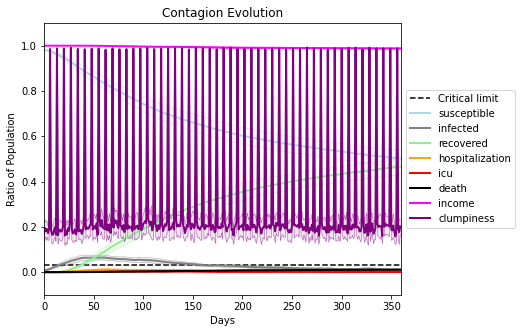

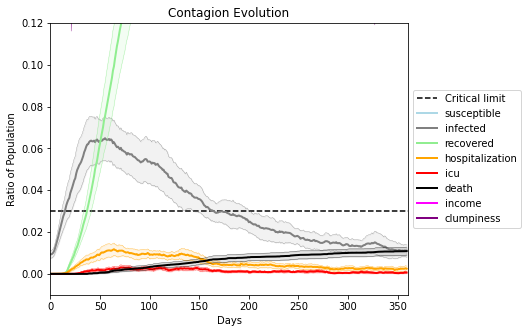

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7053, 1608, 1831, 7606, 7075, 1863, 7093, 1012, 7811, 920, 1683, 8900, 1334, 829, 1432, 9216, 5109, 5983, 3870, 6592]
Average similarity between family members is 0.9712558859265898 at temperature -0.999
Average similarity between family and home is 0.9998454018855374 at temperature -1
Average similarity between students and their classroom is 0.7305254882230359 at temperature -0.999
Average classroom occupancy is 4.5606060606060606 and number classrooms is 66
Average similarity between workers is 0.9789414557528067 at temperature -0.999
Average office occupancy is 3.518918918918919 and number offices is 185
Average friend similarity for adults: 0.8591815968450696 for kids: 0.7320536343745914
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6756990094210117
avg restaurant similarity 0.6664432348937351
avg restaurant similarity 0.7081467854665522
avg restaurant similarity 0.65744759027423
avg restaurant similarity 0.7215234626291143
avg restaurant similarity 0.7018430431349626
avg restaurant similarity 0.6815806214371537
avg restaurant similarity 0.6671175671987924
avg restaurant similarity 0.7135367759473904
avg restaurant similarity 0.6882710826201349
avg restaurant similarity 0.7077704071813734
avg restaurant similarity 0.7174236370569492
avg restaurant similarity 0.7201537075604926
avg restaurant similarity 0.7238248203272271
avg restaurant similarity 0.7035081267824882
avg restaurant similarity 0.7101100125848974
avg restaurant similarity 0.7495754096099049
avg restaurant similarity 0.7230075224976988
avg restaurant similarity 0.6884985033422832
avg restaurant similarity 0.7184973528017865
avg restaurant similarity 0.6897478166245625
avg restaurant similarity 0.6400451674879672
avg restaura

avg restaurant similarity 0.6939835161659172
avg restaurant similarity 0.6722098280430132
avg restaurant similarity 0.6760405948278331
avg restaurant similarity 0.6969158587233576
avg restaurant similarity 0.6948611970263536
avg restaurant similarity 0.6949385222857459
avg restaurant similarity 0.6679096975688856
avg restaurant similarity 0.6573866188258132
avg restaurant similarity 0.6801543686348628
avg restaurant similarity 0.6803786401486774
avg restaurant similarity 0.6432573801984631
avg restaurant similarity 0.6671561512505426
avg restaurant similarity 0.6090850184538299
avg restaurant similarity 0.6262606723811455
avg restaurant similarity 0.6999114761759135
avg restaurant similarity 0.6993472279237686
avg restaurant similarity 0.7184980102073025
avg restaurant similarity 0.661843784161494
avg restaurant similarity 0.7084021509532847
avg restaurant similarity 0.6748540355071742
avg restaurant similarity 0.7095446352531822
avg restaurant similarity 0.6550161386007289
avg restaur

avg restaurant similarity 0.6899038809672114
avg restaurant similarity 0.7072664470388002
avg restaurant similarity 0.680253948283691
avg restaurant similarity 0.6995665273760404
avg restaurant similarity 0.6670916931829335
avg restaurant similarity 0.6737147214151881
avg restaurant similarity 0.680045013497752
avg restaurant similarity 0.6551518852628517
avg restaurant similarity 0.6467193928740472
avg restaurant similarity 0.7041009057457264
avg restaurant similarity 0.6885912814069062
avg restaurant similarity 0.7395998155960445
avg restaurant similarity 0.7010066443074391
avg restaurant similarity 0.6633727649175057
avg restaurant similarity 0.7102559630954816
avg restaurant similarity 0.6898726413680647
avg restaurant similarity 0.6290381293449513
avg restaurant similarity 0.6812994916571044
avg restaurant similarity 0.7063593978623891
avg restaurant similarity 0.6697954850093293
avg restaurant similarity 0.6578851527132855
avg restaurant similarity 0.6685347729854616
avg restaura

avg restaurant similarity 0.6726302540837793
avg restaurant similarity 0.6862237708654509
avg restaurant similarity 0.7277372631458972
avg restaurant similarity 0.6987708201381769
avg restaurant similarity 0.7067822227469691
avg restaurant similarity 0.7135611252140022
avg restaurant similarity 0.6666189442864507
avg restaurant similarity 0.66162951518773
avg restaurant similarity 0.6698969464440686
avg restaurant similarity 0.6622656231263269
avg restaurant similarity 0.6972053326171798
avg restaurant similarity 0.7019731333760744
avg restaurant similarity 0.7209705739391598
avg restaurant similarity 0.6773665872341561
avg restaurant similarity 0.7110629598482069
avg restaurant similarity 0.6965593194920928
avg restaurant similarity 0.6813991122678228
avg restaurant similarity 0.7013467266205365
avg restaurant similarity 0.665778781177707
avg restaurant similarity 0.7047576473494761
avg restaurant similarity 0.7314073160601152
avg restaurant similarity 0.6944602884692833
avg restauran

avg restaurant similarity 0.6537072353640583
avg restaurant similarity 0.7187406822527819
avg restaurant similarity 0.6725329613142242
avg restaurant similarity 0.6940853846562213
avg restaurant similarity 0.721683715451953
avg restaurant similarity 0.669083372113831
avg restaurant similarity 0.6706124819210686
avg restaurant similarity 0.677870350301783
avg restaurant similarity 0.6815918591013947
avg restaurant similarity 0.6948927342241995
avg restaurant similarity 0.6772492865781202
avg restaurant similarity 0.7161550710646042
avg restaurant similarity 0.6492819172696258
avg restaurant similarity 0.6695635234228107
avg restaurant similarity 0.7102704563447864
avg restaurant similarity 0.7041979302982087
avg restaurant similarity 0.6955388016279357
avg restaurant similarity 0.6850164598571634
avg restaurant similarity 0.6865634111020169
avg restaurant similarity 0.7568915291900045
avg restaurant similarity 0.7000154664964137
avg restaurant similarity 0.6732713697857778
avg restauran

avg restaurant similarity 0.7100096517066642
avg restaurant similarity 0.6540800818388464
avg restaurant similarity 0.6556597799092527
avg restaurant similarity 0.6513297271140659
avg restaurant similarity 0.7089557992415324
avg restaurant similarity 0.7035251859677704
avg restaurant similarity 0.6748582983412149
avg restaurant similarity 0.6886728612813973
avg restaurant similarity 0.6964183692970464
avg restaurant similarity 0.6883542261949395
avg restaurant similarity 0.7093315390697299
avg restaurant similarity 0.6681657022000954
avg restaurant similarity 0.7424813647677163
avg restaurant similarity 0.7185514658605499
avg restaurant similarity 0.7610300604840883
avg restaurant similarity 0.7316959146886186
avg restaurant similarity 0.7022620121534877
avg restaurant similarity 0.7212533598074801
avg restaurant similarity 0.6926340942026532
avg restaurant similarity 0.7468594231370309
avg restaurant similarity 0.7309382171484325
avg restaurant similarity 0.6757886401131337
avg restau

avg restaurant similarity 0.6557878302160081
avg restaurant similarity 0.7033900909768487
avg restaurant similarity 0.6951943506146367
avg restaurant similarity 0.7047903120335239
avg restaurant similarity 0.64626667869018
avg restaurant similarity 0.6831621014939341
avg restaurant similarity 0.6866530524375335
avg restaurant similarity 0.6940412543827333
avg restaurant similarity 0.6790965193213586
avg restaurant similarity 0.6952507198094038
avg restaurant similarity 0.6667923217738875
avg restaurant similarity 0.6828516908372843
avg restaurant similarity 0.6134339971771403
avg restaurant similarity 0.7037612951486505
avg restaurant similarity 0.6978107158838103
avg restaurant similarity 0.6897304567131051
avg restaurant similarity 0.6654884945681281
avg restaurant similarity 0.7051936883104538
avg restaurant similarity 0.6647835048779495
avg restaurant similarity 0.6945314210636201
avg restaurant similarity 0.6990489730391185
avg restaurant similarity 0.7125086285067058
avg restaura

avg restaurant similarity 0.7500471199695977
avg restaurant similarity 0.7410499572795705
avg restaurant similarity 0.7032562494738444
avg restaurant similarity 0.6731668349841062
avg restaurant similarity 0.6924010421093848
avg restaurant similarity 0.6857432666542186
avg restaurant similarity 0.7450485426370056
avg restaurant similarity 0.7268830174307214
avg restaurant similarity 0.7174486787260054
avg restaurant similarity 0.7156429569311983
avg restaurant similarity 0.7235198510988619
avg restaurant similarity 0.6644713060502705
avg restaurant similarity 0.6860026152960297
avg restaurant similarity 0.7359968015152093
avg restaurant similarity 0.6885073245405319
avg restaurant similarity 0.7579951059631392
avg restaurant similarity 0.6645443189168825
avg restaurant similarity 0.6728410103591403
avg restaurant similarity 0.7053636570773666
avg restaurant similarity 0.6885051955138967
avg restaurant similarity 0.7161796855418383
avg restaurant similarity 0.6539208806103946
avg restau

avg restaurant similarity 0.7296526072907642
avg restaurant similarity 0.6564705650103106
avg restaurant similarity 0.6538431281151408
avg restaurant similarity 0.715170037123778
avg restaurant similarity 0.6613959251569337
avg restaurant similarity 0.7012694856120151
avg restaurant similarity 0.6536783586726467
avg restaurant similarity 0.6220674436640482
avg restaurant similarity 0.7423508159450843
avg restaurant similarity 0.6554687927333147
avg restaurant similarity 0.6783935146078262
avg restaurant similarity 0.6611008600750458
avg restaurant similarity 0.6757469748771174
avg restaurant similarity 0.681222946938044
avg restaurant similarity 0.6730714137336402
avg restaurant similarity 0.6529283710062324
avg restaurant similarity 0.6689952629169156
avg restaurant similarity 0.6526467770330614
avg restaurant similarity 0.6754593567185477
avg restaurant similarity 0.6528820370223155
avg restaurant similarity 0.6596147166954672
avg restaurant similarity 0.6814061108479066
avg restaura

avg restaurant similarity 0.6771938067387102
avg restaurant similarity 0.6437501986364587
avg restaurant similarity 0.6857789101182149
avg restaurant similarity 0.7137546106886958
avg restaurant similarity 0.7024109461092101
avg restaurant similarity 0.7272396802365283
avg restaurant similarity 0.7065719243538864
avg restaurant similarity 0.7233655095111998
avg restaurant similarity 0.7057937767360113
avg restaurant similarity 0.7014773647020197
avg restaurant similarity 0.7711640979261178
avg restaurant similarity 0.6787255363391219
avg restaurant similarity 0.710785311771025
avg restaurant similarity 0.6556474720752028
avg restaurant similarity 0.7337199374183112
avg restaurant similarity 0.7583339907815101
avg restaurant similarity 0.6809765294848052
avg restaurant similarity 0.7178235693246878
avg restaurant similarity 0.6921542818041281
avg restaurant similarity 0.6583984403332491
avg restaurant similarity 0.6628054081175487
avg restaurant similarity 0.6748791295295692
avg restaur

avg restaurant similarity 0.6110564508759091
avg restaurant similarity 0.5894519796493014
avg restaurant similarity 0.5825273751904073
avg restaurant similarity 0.6150758328688496
avg restaurant similarity 0.5632907439108775
avg restaurant similarity 0.6442145625293679
avg restaurant similarity 0.6336770603849978
avg restaurant similarity 0.6139762057171481
avg restaurant similarity 0.6388541375596852
avg restaurant similarity 0.655712840487679
avg restaurant similarity 0.64979047569604
avg restaurant similarity 0.6158054551741611
avg restaurant similarity 0.5526135615679341
avg restaurant similarity 0.6610318657608192
avg restaurant similarity 0.6719073994914669
avg restaurant similarity 0.6171184914103977
avg restaurant similarity 0.6105918669690401
avg restaurant similarity 0.6355029548009407
avg restaurant similarity 0.5831569509032524
avg restaurant similarity 0.6670603202084237
avg restaurant similarity 0.6219779880071667
avg restaurant similarity 0.6140030934344058
avg restauran

avg restaurant similarity 0.5919316196272796
avg restaurant similarity 0.638954074823051
avg restaurant similarity 0.5816640520312311
avg restaurant similarity 0.6548928909656816
avg restaurant similarity 0.5997745301393299
avg restaurant similarity 0.6722398893837717
avg restaurant similarity 0.6536803229841416
avg restaurant similarity 0.587211597410339
avg restaurant similarity 0.6202505274906563
avg restaurant similarity 0.6233972760578795
avg restaurant similarity 0.6250230260849469
avg restaurant similarity 0.6051969906950427
avg restaurant similarity 0.6557877942055331
avg restaurant similarity 0.6044863187526076
avg restaurant similarity 0.5998913157971074
avg restaurant similarity 0.5995057834666035
avg restaurant similarity 0.5894659450176007
avg restaurant similarity 0.6181905627683745
avg restaurant similarity 0.6291225933629235
avg restaurant similarity 0.5914335328118476
avg restaurant similarity 0.5934748587747919
avg restaurant similarity 0.6168064390559543
avg restaura

avg restaurant similarity 0.6225831087065962
avg restaurant similarity 0.6719050791824859
avg restaurant similarity 0.6892934268446503
avg restaurant similarity 0.7075602658722396
avg restaurant similarity 0.6806857410399707
avg restaurant similarity 0.7098839453508351
avg restaurant similarity 0.7094569304394549
avg restaurant similarity 0.6878271278265372
avg restaurant similarity 0.6633097925564658
avg restaurant similarity 0.6731864583993799
avg restaurant similarity 0.669874998664686
avg restaurant similarity 0.6933184529371781
avg restaurant similarity 0.7237240644237134
avg restaurant similarity 0.6999273761920786
avg restaurant similarity 0.7157344503045245
avg restaurant similarity 0.6833277266280027
avg restaurant similarity 0.7120938936690148
avg restaurant similarity 0.6947367082733242
avg restaurant similarity 0.7210106493852348
avg restaurant similarity 0.7026686350873729
avg restaurant similarity 0.6713598633979246
avg restaurant similarity 0.684142645738373
avg restaura

avg restaurant similarity 0.673631907588569
avg restaurant similarity 0.6686788422914764
avg restaurant similarity 0.702534929873421
avg restaurant similarity 0.7492517619340822
avg restaurant similarity 0.6582121125635018
avg restaurant similarity 0.6737259305588447
avg restaurant similarity 0.6587547593589359
avg restaurant similarity 0.6754502241082925
avg restaurant similarity 0.7141003715498984
avg restaurant similarity 0.6609217628846378
avg restaurant similarity 0.7177131030828429
avg restaurant similarity 0.6902390756694282
avg restaurant similarity 0.7510378388468941
avg restaurant similarity 0.6512378793221043
avg restaurant similarity 0.6430672336029656
avg restaurant similarity 0.6731600492745509
avg restaurant similarity 0.737681303425432
avg restaurant similarity 0.6990816612363363
avg restaurant similarity 0.6923159615815558
avg restaurant similarity 0.7169287851635764
avg restaurant similarity 0.6538037894676135
avg restaurant similarity 0.7119506431178148
avg restauran

avg restaurant similarity 0.641478127822857
avg restaurant similarity 0.6220042513882915
avg restaurant similarity 0.6491987713386655
avg restaurant similarity 0.6289753212249326
avg restaurant similarity 0.6273347283772226
avg restaurant similarity 0.627638409158028
avg restaurant similarity 0.6442895580407376
avg restaurant similarity 0.6477789368310995
avg restaurant similarity 0.6589376827887881
avg restaurant similarity 0.5989057576716086
avg restaurant similarity 0.6793344552484117
avg restaurant similarity 0.6341346803169192
avg restaurant similarity 0.6569499261514509
avg restaurant similarity 0.6778705918027847
avg restaurant similarity 0.6565349815020474
avg restaurant similarity 0.6874503967696816
avg restaurant similarity 0.6325275887413743
avg restaurant similarity 0.6272934471764181
avg restaurant similarity 0.6498627241727251
avg restaurant similarity 0.6725827568373569
avg restaurant similarity 0.6725144669393648
avg restaurant similarity 0.6588935203086536
avg restaura

avg restaurant similarity 0.6274773448846036
avg restaurant similarity 0.6340166359459435
avg restaurant similarity 0.6379837896847879
avg restaurant similarity 0.6423661192984436
avg restaurant similarity 0.6848176962614573
avg restaurant similarity 0.6530460326161242
avg restaurant similarity 0.6420931819617056
avg restaurant similarity 0.6193723568093727
avg restaurant similarity 0.6633465441848837
avg restaurant similarity 0.6823133612654443
avg restaurant similarity 0.6674333431556932
avg restaurant similarity 0.678734623403167
avg restaurant similarity 0.6714140376026598
avg restaurant similarity 0.6619204862434203
avg restaurant similarity 0.6148378735480147
avg restaurant similarity 0.6815200435866651
avg restaurant similarity 0.7035053609269494
avg restaurant similarity 0.6604679098157321
avg restaurant similarity 0.6571445406960503
avg restaurant similarity 0.6743762092410208
avg restaurant similarity 0.6589442373293788
avg restaurant similarity 0.6460738382835409
avg restaur

avg restaurant similarity 0.6252551001325056
avg restaurant similarity 0.6438535007682784
avg restaurant similarity 0.6635280151632882
avg restaurant similarity 0.6785519709802094
avg restaurant similarity 0.5629187139980192
avg restaurant similarity 0.6762774480856462
avg restaurant similarity 0.6009421405999632
avg restaurant similarity 0.6850306734796019
avg restaurant similarity 0.6527483578002965
avg restaurant similarity 0.6648468578138114
avg restaurant similarity 0.6306981752727233
avg restaurant similarity 0.6259394652837614
avg restaurant similarity 0.6238143837675636
avg restaurant similarity 0.6317398026967513
avg restaurant similarity 0.6918149296619016
avg restaurant similarity 0.6951986503215438
avg restaurant similarity 0.6023755688325527
avg restaurant similarity 0.6291206857885002
avg restaurant similarity 0.6524370793103077
avg restaurant similarity 0.6620241776446835
avg restaurant similarity 0.6067110938869974
avg restaurant similarity 0.6329225609424524
avg restau

avg restaurant similarity 0.5994583536277799
avg restaurant similarity 0.6299125079908118
avg restaurant similarity 0.6606960064649179
avg restaurant similarity 0.6778091342527018
avg restaurant similarity 0.6073555695226996
avg restaurant similarity 0.647306317272766
avg restaurant similarity 0.6608317496485477
avg restaurant similarity 0.6092194881465476
avg restaurant similarity 0.6550807846884873
avg restaurant similarity 0.6851055956447015
avg restaurant similarity 0.6316137101169745
avg restaurant similarity 0.642079132199319
avg restaurant similarity 0.7208178279985967
avg restaurant similarity 0.609572519765243
avg restaurant similarity 0.673302231662164
avg restaurant similarity 0.6572942290393046
avg restaurant similarity 0.6748857296064551
avg restaurant similarity 0.6417420975824786
avg restaurant similarity 0.6633043591459445
avg restaurant similarity 0.639479660801034
avg restaurant similarity 0.6137543176169696
avg restaurant similarity 0.6411616722180495
avg restaurant 

avg restaurant similarity 0.6592262778925718
avg restaurant similarity 0.6278284943768281
avg restaurant similarity 0.6747271558799504
avg restaurant similarity 0.6401060271310876
avg restaurant similarity 0.6382484149759536
avg restaurant similarity 0.6260854119076745
avg restaurant similarity 0.7125655015271316
avg restaurant similarity 0.5738270161001372
avg restaurant similarity 0.651278319174769
avg restaurant similarity 0.6824279093667397
avg restaurant similarity 0.6672906617954787
avg restaurant similarity 0.6494044546789509
avg restaurant similarity 0.6685897088605184
avg restaurant similarity 0.6278705896186708
avg restaurant similarity 0.6773080941159385
avg restaurant similarity 0.6769246722430294
avg restaurant similarity 0.6511513603925154
avg restaurant similarity 0.6644804128161358
avg restaurant similarity 0.6429092870806332
avg restaurant similarity 0.6773414685301106
avg restaurant similarity 0.6419285420670565
avg restaurant similarity 0.654195573385671
avg restaura

avg restaurant similarity 0.7066059526524066
avg restaurant similarity 0.6801763582087498
avg restaurant similarity 0.6841271782425136
avg restaurant similarity 0.6292768403329791
avg restaurant similarity 0.6660846340862587
avg restaurant similarity 0.6767253632691078
avg restaurant similarity 0.6337362210066193
avg restaurant similarity 0.6573862602154725
avg restaurant similarity 0.690178295427535
avg restaurant similarity 0.6239013251402628
avg restaurant similarity 0.5917269379185646
avg restaurant similarity 0.6749453963508685
avg restaurant similarity 0.6929439844933721
avg restaurant similarity 0.6856237181723861
avg restaurant similarity 0.7018954868933176
avg restaurant similarity 0.6625553856506051
avg restaurant similarity 0.6370075745339335
avg restaurant similarity 0.6309103149143183
avg restaurant similarity 0.6708549922530456
avg restaurant similarity 0.679065338683354
avg restaurant similarity 0.6182179912568215
avg restaurant similarity 0.5800979701312323
avg restaura

avg restaurant similarity 0.6556194745438211
avg restaurant similarity 0.675528930932004
avg restaurant similarity 0.7010016809589416
avg restaurant similarity 0.6941892922391882
avg restaurant similarity 0.6396607931905512
avg restaurant similarity 0.6579901656027218
avg restaurant similarity 0.6866958736675105
avg restaurant similarity 0.6894434265252373
avg restaurant similarity 0.6726297386922534
avg restaurant similarity 0.6837186049120284
avg restaurant similarity 0.6436803074895636
avg restaurant similarity 0.66855622077979
avg restaurant similarity 0.6802210402791615
avg restaurant similarity 0.6956533200029498
avg restaurant similarity 0.7231265837910184
avg restaurant similarity 0.7129376232295367
avg restaurant similarity 0.6812781213789215
avg restaurant similarity 0.6819894295271244
avg restaurant similarity 0.6543626741426478
avg restaurant similarity 0.6844891254639018
avg restaurant similarity 0.637892798277274
avg restaurant similarity 0.6664288759991418
avg restaurant

avg restaurant similarity 0.7087379293884895
avg restaurant similarity 0.6706194239508552
avg restaurant similarity 0.7063103289610679
avg restaurant similarity 0.7028796198921764
avg restaurant similarity 0.6644840233017487
avg restaurant similarity 0.673992288057473
avg restaurant similarity 0.6665936476442339
avg restaurant similarity 0.6744256681343904
avg restaurant similarity 0.6733474748018524
avg restaurant similarity 0.6535016263090598
avg restaurant similarity 0.6799882013977872
avg restaurant similarity 0.6856423799741617
avg restaurant similarity 0.6440680395010693
avg restaurant similarity 0.7054908194673251
avg restaurant similarity 0.686684761860932
avg restaurant similarity 0.6982445919703634
avg restaurant similarity 0.7241722477679913
avg restaurant similarity 0.681398482941728
avg restaurant similarity 0.715857996837271
avg restaurant similarity 0.6516066846743777
avg restaurant similarity 0.6893120617445966
avg restaurant similarity 0.7428878368508771
avg restaurant

avg restaurant similarity 0.6730349663299592
avg restaurant similarity 0.6174262235756286
avg restaurant similarity 0.6967890982404679
avg restaurant similarity 0.6195098892352844
avg restaurant similarity 0.6100752272931146
avg restaurant similarity 0.6627632826782144
avg restaurant similarity 0.6576607282013464
avg restaurant similarity 0.6847166336415087
avg restaurant similarity 0.6453478616985252
avg restaurant similarity 0.6074417557324957
avg restaurant similarity 0.6925316772521125
avg restaurant similarity 0.6793242211638044
avg restaurant similarity 0.6496697695052552
avg restaurant similarity 0.7244540838417857
avg restaurant similarity 0.674018129479354
avg restaurant similarity 0.688975521345788
avg restaurant similarity 0.6799220732829796
avg restaurant similarity 0.6531294783697851
avg restaurant similarity 0.6914138436951788
avg restaurant similarity 0.6438595834425451
avg restaurant similarity 0.6860277659059326
avg restaurant similarity 0.6758723631613123
avg restaura

avg restaurant similarity 0.6577078355022132
avg restaurant similarity 0.6638055271353576
avg restaurant similarity 0.6804689567143414
avg restaurant similarity 0.6929769708408803
avg restaurant similarity 0.676181581604082
avg restaurant similarity 0.663263526282086
avg restaurant similarity 0.6943678227330394
avg restaurant similarity 0.7310686885369019
avg restaurant similarity 0.6594861941904676
avg restaurant similarity 0.6601650589429533
avg restaurant similarity 0.6790864005161266
avg restaurant similarity 0.6748239890678137
avg restaurant similarity 0.6771347713206277
avg restaurant similarity 0.6659593447237079
avg restaurant similarity 0.7111633849029341
avg restaurant similarity 0.698069969764451
avg restaurant similarity 0.6500743695635829
avg restaurant similarity 0.6476701500394287
avg restaurant similarity 0.6387569997039075
avg restaurant similarity 0.6131028910297607
avg restaurant similarity 0.7139228780410783
avg restaurant similarity 0.6865543508944181
avg restauran

avg restaurant similarity 0.7044679195654935
avg restaurant similarity 0.6822723073739141
avg restaurant similarity 0.6809663371210745
avg restaurant similarity 0.7130492767493839
avg restaurant similarity 0.6811133360074759
avg restaurant similarity 0.7015073233055392
avg restaurant similarity 0.7059241317558287
avg restaurant similarity 0.6049603177036893
avg restaurant similarity 0.6698002631700876
avg restaurant similarity 0.617513274690361
avg restaurant similarity 0.6732110726862209
avg restaurant similarity 0.6729198996527208
avg restaurant similarity 0.6003030194958239
avg restaurant similarity 0.6689776275465598
avg restaurant similarity 0.6710308911938571
avg restaurant similarity 0.6771387601810027
avg restaurant similarity 0.7025542914987095
avg restaurant similarity 0.7198327652555523
avg restaurant similarity 0.6587928553117176
avg restaurant similarity 0.6947721910453335
avg restaurant similarity 0.6669191666838306
avg restaurant similarity 0.726816597066427
avg restaura

avg restaurant similarity 0.6861439842098174
avg restaurant similarity 0.6755530384124216
avg restaurant similarity 0.6674884181131048
avg restaurant similarity 0.6641478973770182
avg restaurant similarity 0.7252148564425316
avg restaurant similarity 0.662451618337824
avg restaurant similarity 0.6479504002876033
avg restaurant similarity 0.7036014911737019
avg restaurant similarity 0.6361848285152127
avg restaurant similarity 0.6128769107927845
avg restaurant similarity 0.6594431136873252
avg restaurant similarity 0.650468510990919
avg restaurant similarity 0.6111336604337495
avg restaurant similarity 0.6968779481106805
avg restaurant similarity 0.6831094215002387
avg restaurant similarity 0.6736574221371509
avg restaurant similarity 0.6836116494557343
avg restaurant similarity 0.6930661090014989
avg restaurant similarity 0.6989340659890794
avg restaurant similarity 0.7045751477549783
avg restaurant similarity 0.7196270628485052
avg restaurant similarity 0.7074922276936407
avg restaura

avg restaurant similarity 0.6206372143723855
avg restaurant similarity 0.6351260683257025
avg restaurant similarity 0.6418469767760511
avg restaurant similarity 0.6985455149118619
avg restaurant similarity 0.6752723141327575
avg restaurant similarity 0.7364986373736561
avg restaurant similarity 0.6641799640536084
avg restaurant similarity 0.6261679536435084
avg restaurant similarity 0.6641233224579058
avg restaurant similarity 0.641892425122724
avg restaurant similarity 0.6271974816830207
avg restaurant similarity 0.6496563784650988
avg restaurant similarity 0.6868932825688552
avg restaurant similarity 0.615822529351614
avg restaurant similarity 0.6532122160385702
avg restaurant similarity 0.6557231482946055
avg restaurant similarity 0.6245637189364485
avg restaurant similarity 0.6708656731136966
avg restaurant similarity 0.5920679103607488
avg restaurant similarity 0.6451801388638295
avg restaurant similarity 0.6727145665602057
avg restaurant similarity 0.6533421589254543
avg restaura

avg restaurant similarity 0.5915369381193247
avg restaurant similarity 0.6353249082375607
avg restaurant similarity 0.564419657060093
avg restaurant similarity 0.6571697940447976
avg restaurant similarity 0.5867777157485874
avg restaurant similarity 0.5465681435910706
avg restaurant similarity 0.6224013491624256
avg restaurant similarity 0.6033916113713296
avg restaurant similarity 0.5923509612818372
avg restaurant similarity 0.6128238318657449
avg restaurant similarity 0.6401141443013727
avg restaurant similarity 0.6004566195589656
avg restaurant similarity 0.6439215325782495
avg restaurant similarity 0.5976196048556085
avg restaurant similarity 0.5986825481561733
avg restaurant similarity 0.5835989160042429
avg restaurant similarity 0.5726397825285253
avg restaurant similarity 0.5676171127766211
avg restaurant similarity 0.6354713392560272
avg restaurant similarity 0.6191069922231534
avg restaurant similarity 0.6248459602387844
avg restaurant similarity 0.6005461765199056
avg restaur

avg restaurant similarity 0.7101076286259755
avg restaurant similarity 0.6885893806944455
avg restaurant similarity 0.6643554900878528
avg restaurant similarity 0.6882005375435981
avg restaurant similarity 0.6393341371171631
avg restaurant similarity 0.7080482685541738
avg restaurant similarity 0.7038699433205768
avg restaurant similarity 0.7086869499955608
avg restaurant similarity 0.6958302040056343
avg restaurant similarity 0.746028770927038
avg restaurant similarity 0.7184215522810078
avg restaurant similarity 0.7037594740169762
avg restaurant similarity 0.696431168520411
avg restaurant similarity 0.6856122822306038
avg restaurant similarity 0.6897469379271568
avg restaurant similarity 0.702592080611704
avg restaurant similarity 0.7060821481807167
avg restaurant similarity 0.7141097419348473
avg restaurant similarity 0.6569272068346358
avg restaurant similarity 0.6763810535156085
avg restaurant similarity 0.6634418181536248
avg restaurant similarity 0.652053142150163
avg restaurant

avg restaurant similarity 0.7152815131515026
avg restaurant similarity 0.6811541238726193
avg restaurant similarity 0.6969139134269525
avg restaurant similarity 0.6843046264345578
avg restaurant similarity 0.6840347774098847
avg restaurant similarity 0.6646647358097025
avg restaurant similarity 0.7135766323479559
avg restaurant similarity 0.7216168702807448
avg restaurant similarity 0.666751967806392
avg restaurant similarity 0.653859453415097
avg restaurant similarity 0.7170279948837456
avg restaurant similarity 0.7163445200543938
avg restaurant similarity 0.6986057701501174
avg restaurant similarity 0.723996498673315
avg restaurant similarity 0.6557982705577395
avg restaurant similarity 0.7164566775518593
avg restaurant similarity 0.6693075956477749
avg restaurant similarity 0.681746898549067
avg restaurant similarity 0.724457415316566
avg restaurant similarity 0.6840651503192939
avg restaurant similarity 0.6863182949295474
avg restaurant similarity 0.6992248671113288
avg restaurant 

avg restaurant similarity 0.6494950746172193
avg restaurant similarity 0.6586607957531119
avg restaurant similarity 0.6538204312653618
avg restaurant similarity 0.6396739008558183
avg restaurant similarity 0.6622659455768298
avg restaurant similarity 0.6874014104500742
avg restaurant similarity 0.6407115720909203
avg restaurant similarity 0.6842707595774038
avg restaurant similarity 0.6243335636936924
avg restaurant similarity 0.7031182659730549
avg restaurant similarity 0.6883313753499236
avg restaurant similarity 0.719531822352248
avg restaurant similarity 0.7240074089028972
avg restaurant similarity 0.695483891237969
avg restaurant similarity 0.6631865631888032
avg restaurant similarity 0.6895489105385227
avg restaurant similarity 0.7102190193300101
avg restaurant similarity 0.7036727440407904
avg restaurant similarity 0.716146121664764
avg restaurant similarity 0.6286606521727516
avg restaurant similarity 0.7123977013704398
avg restaurant similarity 0.6844583315125714
avg restauran

avg restaurant similarity 0.7783393131282
avg restaurant similarity 0.7056381188636354
avg restaurant similarity 0.6821028072570473
avg restaurant similarity 0.7009480080955466
avg restaurant similarity 0.6865877719007284
avg restaurant similarity 0.7171423649062172
avg restaurant similarity 0.7015729778692731
avg restaurant similarity 0.7369668657932286
avg restaurant similarity 0.722482920225461
avg restaurant similarity 0.6913176590976625
avg restaurant similarity 0.6659038883620425
avg restaurant similarity 0.6734113128843738
avg restaurant similarity 0.7235288796888201
avg restaurant similarity 0.7336508328734885
avg restaurant similarity 0.6899719906482934
avg restaurant similarity 0.7305682659717441
avg restaurant similarity 0.7129081537998716
avg restaurant similarity 0.7237146921788034
avg restaurant similarity 0.7250572315052174
avg restaurant similarity 0.6808634249801018
avg restaurant similarity 0.6544007082278747
avg restaurant similarity 0.6492121411482366
avg restaurant

avg restaurant similarity 0.6138595010845419
avg restaurant similarity 0.662866310671124
avg restaurant similarity 0.6538616528169711
avg restaurant similarity 0.6586063792887127
avg restaurant similarity 0.6360162881364069
avg restaurant similarity 0.5866624498534534
avg restaurant similarity 0.6242704497094933
avg restaurant similarity 0.611202401065966
avg restaurant similarity 0.6445208475921157
avg restaurant similarity 0.6502745888166319
avg restaurant similarity 0.649985127642696
avg restaurant similarity 0.6651232627978408
avg restaurant similarity 0.6937223955390865
avg restaurant similarity 0.6555368120452062
avg restaurant similarity 0.6961624283575402
avg restaurant similarity 0.6573188687815267
avg restaurant similarity 0.6602740902215137
avg restaurant similarity 0.6118079132975572
avg restaurant similarity 0.6468750742040974
avg restaurant similarity 0.6294415152324322
avg restaurant similarity 0.628202303513689
avg restaurant similarity 0.6404162201968554
avg restaurant

avg restaurant similarity 0.6426813190204482
avg restaurant similarity 0.660530658009363
avg restaurant similarity 0.70037443551922
avg restaurant similarity 0.6471544608533931
avg restaurant similarity 0.6929020293053529
avg restaurant similarity 0.6882192458132919
avg restaurant similarity 0.7136003510683739
avg restaurant similarity 0.6417961227338118
avg restaurant similarity 0.6596887999544376
avg restaurant similarity 0.6988624581736902
avg restaurant similarity 0.6323852924550254
avg restaurant similarity 0.7134337419892719
avg restaurant similarity 0.6772612500499244
avg restaurant similarity 0.6576447304949334
avg restaurant similarity 0.6728205830046182
avg restaurant similarity 0.6323856438557757
avg restaurant similarity 0.6460835263869522
avg restaurant similarity 0.6089386478737766
avg restaurant similarity 0.6432451486728039
avg restaurant similarity 0.6177420958848955
avg restaurant similarity 0.6998255646191182
avg restaurant similarity 0.6608131291519259
avg restauran

avg restaurant similarity 0.6507921913947401
avg restaurant similarity 0.6802619152780204
avg restaurant similarity 0.6772556298464001
avg restaurant similarity 0.6444868314185616
avg restaurant similarity 0.6718929063873842
avg restaurant similarity 0.6614676111111275
avg restaurant similarity 0.7254858460431135
avg restaurant similarity 0.6859631418460886
avg restaurant similarity 0.6680913324799951
avg restaurant similarity 0.6447151437135787
avg restaurant similarity 0.7017957190890608
avg restaurant similarity 0.6575417759528325
avg restaurant similarity 0.6566788950143846
avg restaurant similarity 0.6820642348427781
avg restaurant similarity 0.6510618056752221
avg restaurant similarity 0.6395785093707572
avg restaurant similarity 0.7429252652168707
avg restaurant similarity 0.7107595116369861
avg restaurant similarity 0.666751468320329
avg restaurant similarity 0.6299306475553648
avg restaurant similarity 0.7031434158920695
avg restaurant similarity 0.6434838394270783
avg restaur

avg restaurant similarity 0.6714960555179422
avg restaurant similarity 0.6488659120096887
avg restaurant similarity 0.7020457257150404
avg restaurant similarity 0.6585388475794838
avg restaurant similarity 0.6386152334731208
avg restaurant similarity 0.6736919520019853
avg restaurant similarity 0.6758274463750579
avg restaurant similarity 0.681538203094461
avg restaurant similarity 0.6574514881955619
avg restaurant similarity 0.6588536705958926
avg restaurant similarity 0.7021144653866908
avg restaurant similarity 0.6990053985389174
avg restaurant similarity 0.6341750400030045
avg restaurant similarity 0.6652865343216876
avg restaurant similarity 0.704643907591726
avg restaurant similarity 0.6829346546997288
avg restaurant similarity 0.6734627765335948
avg restaurant similarity 0.6330903256577615
avg restaurant similarity 0.6662382428093875
avg restaurant similarity 0.6236246064118575
avg restaurant similarity 0.6553758036922684
avg restaurant similarity 0.6918536235892228
avg restaura

avg restaurant similarity 0.6297793885399487
avg restaurant similarity 0.7451122745082512
avg restaurant similarity 0.6343731442592692
avg restaurant similarity 0.6757486834965372
avg restaurant similarity 0.6443135613718488
avg restaurant similarity 0.7285579847149881
avg restaurant similarity 0.6719766850152623
avg restaurant similarity 0.6890489431918566
avg restaurant similarity 0.6246832662915272
avg restaurant similarity 0.7205567135661909
avg restaurant similarity 0.6726938735311927
avg restaurant similarity 0.7347783358392136
avg restaurant similarity 0.7207569871653087
avg restaurant similarity 0.7353228079123802
avg restaurant similarity 0.7421333009558613
avg restaurant similarity 0.6418715401978328
avg restaurant similarity 0.6771623746448423
avg restaurant similarity 0.689255165307313
avg restaurant similarity 0.6393282860248419
avg restaurant similarity 0.6958336571165092
avg restaurant similarity 0.6662015721961049
avg restaurant similarity 0.7441413072932902
avg restaur

avg restaurant similarity 0.6456057518959691
avg restaurant similarity 0.6535151372497304
avg restaurant similarity 0.6834340928365887
avg restaurant similarity 0.641030989988607
avg restaurant similarity 0.6901824940820395
avg restaurant similarity 0.6773698106147471
avg restaurant similarity 0.6594403030454764
avg restaurant similarity 0.6348796227502068
avg restaurant similarity 0.6524317792080616
avg restaurant similarity 0.6823120110809983
avg restaurant similarity 0.624971492528118
avg restaurant similarity 0.6475178498595524
avg restaurant similarity 0.6023643996402264
avg restaurant similarity 0.7293240733846807
avg restaurant similarity 0.6743783268813549
avg restaurant similarity 0.6386473560262813
avg restaurant similarity 0.6343228430249841
avg restaurant similarity 0.6446937339399214
avg restaurant similarity 0.7032038872651888
avg restaurant similarity 0.7202392292240516
avg restaurant similarity 0.6818233919689954
avg restaurant similarity 0.699300298183833
avg restauran

avg restaurant similarity 0.693819083340112
avg restaurant similarity 0.6754041822252749
avg restaurant similarity 0.6812621094624092
avg restaurant similarity 0.6809525024186034
avg restaurant similarity 0.6965709681804242
avg restaurant similarity 0.6709133026029555
avg restaurant similarity 0.6518911536963043
avg restaurant similarity 0.6724515093461331
avg restaurant similarity 0.6899194081865074
avg restaurant similarity 0.664102859390195
avg restaurant similarity 0.6402578571378789
avg restaurant similarity 0.6887102469057333
avg restaurant similarity 0.6783600193118492
avg restaurant similarity 0.6962550499591585
avg restaurant similarity 0.656778223482836
avg restaurant similarity 0.6873398723962705
avg restaurant similarity 0.7216077712913569
avg restaurant similarity 0.6959892906167818
avg restaurant similarity 0.6744647907909664
avg restaurant similarity 0.6948806140873635
avg restaurant similarity 0.6622391627310626
avg restaurant similarity 0.6676110151286906
avg restauran

avg restaurant similarity 0.7043721976218726
avg restaurant similarity 0.6922379436987719
avg restaurant similarity 0.6989547439177216
avg restaurant similarity 0.6819317176465495
avg restaurant similarity 0.651085590438369
avg restaurant similarity 0.664368705785032
avg restaurant similarity 0.6827499113989253
avg restaurant similarity 0.6630466116422981
avg restaurant similarity 0.6601382871270716
avg restaurant similarity 0.651937154603367
avg restaurant similarity 0.6672986941785101
avg restaurant similarity 0.6541424950322557
avg restaurant similarity 0.6767004143636982
avg restaurant similarity 0.681299892702736
avg restaurant similarity 0.6699311836030116
avg restaurant similarity 0.60803242663297
avg restaurant similarity 0.7056536415579558
avg restaurant similarity 0.6571300513531079
avg restaurant similarity 0.6497470301993377
avg restaurant similarity 0.6485859255728281
avg restaurant similarity 0.6339650714050561
avg restaurant similarity 0.6185553314415125
avg restaurant s

(<function dict.items>, <function dict.items>, <function dict.items>)

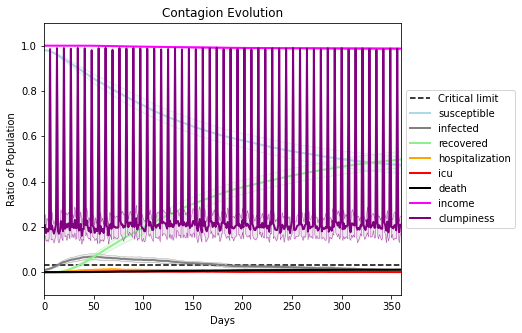

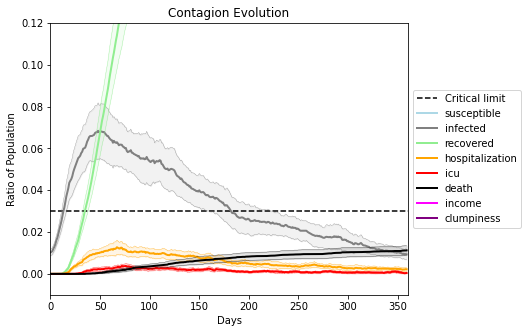

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[921, 784, 4445, 4506, 956, 6874, 4115, 6609, 4291, 6855, 4752, 931, 9924, 1853, 1845, 9573, 9318, 8144, 7994, 7491]
Average similarity between family members is 0.9689155895975193 at temperature -0.998
Average similarity between family and home is 0.9998518617458757 at temperature -1
Average similarity between students and their classroom is 0.7774054022791759 at temperature -0.998
Average classroom occupancy is 4.348484848484849 and number classrooms is 66
Average similarity between workers is 0.9751579368206894 at temperature -0.998
Average office occupancy is 3.6775956284153004 and number offices is 183
Average friend similarity for adults: 0.8634638695482073 for kids: 0.7259357738920972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.677714407755857
avg restaurant similarity 0.6886113413447202
avg restaurant similarity 0.6860698007393018
avg restaurant similarity 0.69994080070894
avg restaurant similarity 0.7138918600335671
avg restaurant similarity 0.7275439021711287
avg restaurant similarity 0.7009823024981302
avg restaurant similarity 0.6857865111579703
avg restaurant similarity 0.711325351007406
avg restaurant similarity 0.6597352630284001
avg restaurant similarity 0.6773789224451302
avg restaurant similarity 0.6727437091613898
avg restaurant similarity 0.6942918253067207
avg restaurant similarity 0.7045778640686515
avg restaurant similarity 0.7054075848154386
avg restaurant similarity 0.6847016496768817
avg restaurant similarity 0.7000783897720575
avg restaurant similarity 0.7064263499130861
avg restaurant similarity 0.7425265840922822
avg restaurant similarity 0.6467610129514793
avg restaurant similarity 0.6705966753435265
avg restaurant similarity 0.7024230540690711
avg restaurant

avg restaurant similarity 0.6577775758328391
avg restaurant similarity 0.7550075877857418
avg restaurant similarity 0.7127065941804502
avg restaurant similarity 0.7387883717592225
avg restaurant similarity 0.6608726641899338
avg restaurant similarity 0.7013099890913896
avg restaurant similarity 0.7050954139432631
avg restaurant similarity 0.6581151317620685
avg restaurant similarity 0.7023673578136227
avg restaurant similarity 0.7168115976633442
avg restaurant similarity 0.6892229498802953
avg restaurant similarity 0.6899693611432806
avg restaurant similarity 0.6504853495945315
avg restaurant similarity 0.7369447814491245
avg restaurant similarity 0.6774066372233916
avg restaurant similarity 0.6894550893608292
avg restaurant similarity 0.6605122617405262
avg restaurant similarity 0.7211563400801176
avg restaurant similarity 0.6698897617843494
avg restaurant similarity 0.7205690290780787
avg restaurant similarity 0.6576880122783398
avg restaurant similarity 0.723437580913742
avg restaur

avg restaurant similarity 0.6455873720843665
avg restaurant similarity 0.6724122079751998
avg restaurant similarity 0.6721801069935956
avg restaurant similarity 0.6781725599997042
avg restaurant similarity 0.6982276654778142
avg restaurant similarity 0.6494875308969195
avg restaurant similarity 0.7184227111214755
avg restaurant similarity 0.7047432439420882
avg restaurant similarity 0.676163706701222
avg restaurant similarity 0.6665738640090142
avg restaurant similarity 0.6851754541507171
avg restaurant similarity 0.734215202285847
avg restaurant similarity 0.6442840221744833
avg restaurant similarity 0.6504258784459505
avg restaurant similarity 0.6828274351589169
avg restaurant similarity 0.6695872365764618
avg restaurant similarity 0.6346304731618979
avg restaurant similarity 0.7059363414706071
avg restaurant similarity 0.6661372649520023
avg restaurant similarity 0.6905350833775562
avg restaurant similarity 0.6649782160126219
avg restaurant similarity 0.7569660698613744
avg restaura

avg restaurant similarity 0.6373935990243661
avg restaurant similarity 0.6857179804165933
avg restaurant similarity 0.6436548151367106
avg restaurant similarity 0.6509743439078214
avg restaurant similarity 0.6799398987844214
avg restaurant similarity 0.6414015412692469
avg restaurant similarity 0.6648280840346469
avg restaurant similarity 0.6945395060679066
avg restaurant similarity 0.7268274540640802
avg restaurant similarity 0.6574325496037545
avg restaurant similarity 0.6736063019092663
avg restaurant similarity 0.6488386070560157
avg restaurant similarity 0.6634898462040771
avg restaurant similarity 0.6654666020849063
avg restaurant similarity 0.6896139196168071
avg restaurant similarity 0.6689525928383885
avg restaurant similarity 0.652400687656143
avg restaurant similarity 0.739959575151217
avg restaurant similarity 0.6158156729169606
avg restaurant similarity 0.6388482240700971
avg restaurant similarity 0.699409893948911
avg restaurant similarity 0.6278910262786517
avg restauran

avg restaurant similarity 0.6830595246332847
avg restaurant similarity 0.6935150990873075
avg restaurant similarity 0.6582438622939545
avg restaurant similarity 0.6740811705542186
avg restaurant similarity 0.6431993267223124
avg restaurant similarity 0.6413274887200935
avg restaurant similarity 0.6272981410482443
avg restaurant similarity 0.6767604219158655
avg restaurant similarity 0.6467478594850273
avg restaurant similarity 0.6415147360337451
avg restaurant similarity 0.6107216376813435
avg restaurant similarity 0.6187614629849897
avg restaurant similarity 0.6281793494417104
avg restaurant similarity 0.6392535989935654
avg restaurant similarity 0.6326247761264349
avg restaurant similarity 0.6264982567200048
avg restaurant similarity 0.6097947974943708
avg restaurant similarity 0.6327095162362428
avg restaurant similarity 0.6169615796025116
avg restaurant similarity 0.636654801496386
avg restaurant similarity 0.6968642195119354
avg restaurant similarity 0.6359964428614991
avg restaur

avg restaurant similarity 0.7061159603444946
avg restaurant similarity 0.6425403104421868
avg restaurant similarity 0.6680312091049787
avg restaurant similarity 0.6179103569492909
avg restaurant similarity 0.6453497446201862
avg restaurant similarity 0.6026823057583036
avg restaurant similarity 0.6292736309722715
avg restaurant similarity 0.6515511644164184
avg restaurant similarity 0.6621209008828899
avg restaurant similarity 0.6401807830772734
avg restaurant similarity 0.6579537426258002
avg restaurant similarity 0.6484474295165179
avg restaurant similarity 0.6503564324121063
avg restaurant similarity 0.6026359688604436
avg restaurant similarity 0.6075155128649646
avg restaurant similarity 0.5909335030574802
avg restaurant similarity 0.6318895463719045
avg restaurant similarity 0.6386491897335427
avg restaurant similarity 0.6555716582491864
avg restaurant similarity 0.6219205002838911
avg restaurant similarity 0.6069124514849179
avg restaurant similarity 0.6394238443105776
avg restau

avg restaurant similarity 0.672869589779971
avg restaurant similarity 0.6615265724581555
avg restaurant similarity 0.6789446810112979
avg restaurant similarity 0.6764964375693506
avg restaurant similarity 0.6766585771700426
avg restaurant similarity 0.6490613441981249
avg restaurant similarity 0.6561223948196815
avg restaurant similarity 0.633415770299724
avg restaurant similarity 0.681649108837839
avg restaurant similarity 0.6527761988232416
avg restaurant similarity 0.6691549175948625
avg restaurant similarity 0.705787040008578
avg restaurant similarity 0.7391967611753338
avg restaurant similarity 0.6636152152516173
avg restaurant similarity 0.621448892259695
avg restaurant similarity 0.6796554379352825
avg restaurant similarity 0.6375800861155134
avg restaurant similarity 0.6970902667345824
avg restaurant similarity 0.6538485734948957
avg restaurant similarity 0.6505659642299666
avg restaurant similarity 0.6030543606973078
avg restaurant similarity 0.6632281648483939
avg restaurant 

avg restaurant similarity 0.679257273811723
avg restaurant similarity 0.6777613732246162
avg restaurant similarity 0.7059126698902519
avg restaurant similarity 0.683229992875669
avg restaurant similarity 0.6593408226477068
avg restaurant similarity 0.6646782953870799
avg restaurant similarity 0.6763215577965119
avg restaurant similarity 0.6779520372043827
avg restaurant similarity 0.6628707749290171
avg restaurant similarity 0.7398780469027512
avg restaurant similarity 0.698244615229467
avg restaurant similarity 0.735181849816155
avg restaurant similarity 0.6900660948520448
avg restaurant similarity 0.6912072658031768
avg restaurant similarity 0.6922364021695682
avg restaurant similarity 0.6896347849783884
avg restaurant similarity 0.6923020157278847
avg restaurant similarity 0.6994044624823775
avg restaurant similarity 0.7105624950168414
avg restaurant similarity 0.6554510501996492
avg restaurant similarity 0.6670149045661955
avg restaurant similarity 0.7053845707498457
avg restaurant

avg restaurant similarity 0.712027470282149
avg restaurant similarity 0.659911068376025
avg restaurant similarity 0.6440300832660328
avg restaurant similarity 0.6647615976289559
avg restaurant similarity 0.6415554989470619
avg restaurant similarity 0.657031406627658
avg restaurant similarity 0.6543959605433416
avg restaurant similarity 0.6573852692273893
avg restaurant similarity 0.6588415723462028
avg restaurant similarity 0.6599261901838248
avg restaurant similarity 0.7297661723049618
avg restaurant similarity 0.7085220482238886
avg restaurant similarity 0.6858510026036195
avg restaurant similarity 0.6801340850657757
avg restaurant similarity 0.6384524593406675
avg restaurant similarity 0.6745359258301806
avg restaurant similarity 0.6245130790024345
avg restaurant similarity 0.6401643486518286
avg restaurant similarity 0.6340707058856648
avg restaurant similarity 0.6582331890519395
avg restaurant similarity 0.638258091269685
avg restaurant similarity 0.6500874561122829
avg restaurant

avg restaurant similarity 0.7048254370428684
avg restaurant similarity 0.6532598601907583
avg restaurant similarity 0.6693658020286769
avg restaurant similarity 0.6588379301560833
avg restaurant similarity 0.6168931843572524
avg restaurant similarity 0.6310469383058539
avg restaurant similarity 0.7057611466756064
avg restaurant similarity 0.6533093529896069
avg restaurant similarity 0.6747773641248965
avg restaurant similarity 0.680402613423067
avg restaurant similarity 0.6306910471140377
avg restaurant similarity 0.6532796519007503
avg restaurant similarity 0.7032922092363828
avg restaurant similarity 0.655012818193337
avg restaurant similarity 0.6247146738484042
avg restaurant similarity 0.6502662897939341
avg restaurant similarity 0.6636155272097926
avg restaurant similarity 0.6587793539716373
avg restaurant similarity 0.6813747093529722
avg restaurant similarity 0.7028935965631954
avg restaurant similarity 0.6726367953709798
avg restaurant similarity 0.6626012119187564
avg restaura

avg restaurant similarity 0.7239541890450422
avg restaurant similarity 0.6557711912225613
avg restaurant similarity 0.7170201777074146
avg restaurant similarity 0.6659337685533132
avg restaurant similarity 0.6824817600552978
avg restaurant similarity 0.6747091253273282
avg restaurant similarity 0.6798102425593555
avg restaurant similarity 0.6716684498610724
avg restaurant similarity 0.7121774436529298
avg restaurant similarity 0.7188821288539253
avg restaurant similarity 0.71942023586951
avg restaurant similarity 0.6640911394314558
avg restaurant similarity 0.6703329783694083
avg restaurant similarity 0.6959957416393726
avg restaurant similarity 0.6667467654949872
avg restaurant similarity 0.7047602725288765
avg restaurant similarity 0.7010592815008615
avg restaurant similarity 0.7000293415623681
avg restaurant similarity 0.6710006106872946
avg restaurant similarity 0.705766020176489
avg restaurant similarity 0.7063280578237067
avg restaurant similarity 0.7080925958700837
avg restauran

avg restaurant similarity 0.6713238667623364
avg restaurant similarity 0.7482306624268134
avg restaurant similarity 0.7347562873296187
avg restaurant similarity 0.6894123907260387
avg restaurant similarity 0.720336716855252
avg restaurant similarity 0.7106407429554
avg restaurant similarity 0.7071265222827613
avg restaurant similarity 0.6621657852456698
avg restaurant similarity 0.6764995807683449
avg restaurant similarity 0.6845067213485561
avg restaurant similarity 0.7233140625538739
avg restaurant similarity 0.6592465476727228
avg restaurant similarity 0.6856766556875629
avg restaurant similarity 0.6857750740429178
avg restaurant similarity 0.7099784667119181
avg restaurant similarity 0.7490611483451525
avg restaurant similarity 0.7217016925843273
avg restaurant similarity 0.6703541144599215
avg restaurant similarity 0.6816038025753377
avg restaurant similarity 0.7125971090342423
avg restaurant similarity 0.6837248203449388
avg restaurant similarity 0.6706985044637065
avg restaurant

avg restaurant similarity 0.6797868309241147
avg restaurant similarity 0.6794466566492958
avg restaurant similarity 0.675734456538333
avg restaurant similarity 0.6867221030999977
avg restaurant similarity 0.7014014243830482
avg restaurant similarity 0.6142455275071889
avg restaurant similarity 0.6732923489955654
avg restaurant similarity 0.7371630636653547
avg restaurant similarity 0.7189505894232473
avg restaurant similarity 0.691405782103798
avg restaurant similarity 0.6810091837188336
avg restaurant similarity 0.6688009749815296
avg restaurant similarity 0.6497141984788238
avg restaurant similarity 0.7443418248121118
avg restaurant similarity 0.6989942484111482
avg restaurant similarity 0.6857643642792156
avg restaurant similarity 0.6645950310583133
avg restaurant similarity 0.6528360921277155
avg restaurant similarity 0.6579018065568882
avg restaurant similarity 0.7049637404340094
avg restaurant similarity 0.7038248806548538
avg restaurant similarity 0.6835383372427019
avg restaura

avg restaurant similarity 0.7006863272507237
avg restaurant similarity 0.6626932598880363
avg restaurant similarity 0.702800678439052
avg restaurant similarity 0.6940031266822887
avg restaurant similarity 0.6884120460980693
avg restaurant similarity 0.7212275444596928
avg restaurant similarity 0.7170610031483623
avg restaurant similarity 0.6793679956996792
avg restaurant similarity 0.6428752828685957
avg restaurant similarity 0.682961847246241
avg restaurant similarity 0.6773002856608283
avg restaurant similarity 0.6392823022764125
avg restaurant similarity 0.6711965237019768
avg restaurant similarity 0.6807353151830504
avg restaurant similarity 0.695997412885715
avg restaurant similarity 0.6825605916710347
avg restaurant similarity 0.7110548709387363
avg restaurant similarity 0.7027190387311538
avg restaurant similarity 0.6942767558723856
avg restaurant similarity 0.6995077379795749
avg restaurant similarity 0.6700791803755098
avg restaurant similarity 0.7204618731321013
avg restauran

avg restaurant similarity 0.6602262200403822
avg restaurant similarity 0.6527810870345628
avg restaurant similarity 0.6370209413582666
avg restaurant similarity 0.635921998527826
avg restaurant similarity 0.6466624670867661
avg restaurant similarity 0.6693476777148372
avg restaurant similarity 0.6516437957858392
avg restaurant similarity 0.637536013348932
avg restaurant similarity 0.6210092440183974
avg restaurant similarity 0.6754586518983493
avg restaurant similarity 0.633497643464065
avg restaurant similarity 0.6614691179253201
avg restaurant similarity 0.6297278500060872
avg restaurant similarity 0.6935393684662262
avg restaurant similarity 0.6388859801082571
avg restaurant similarity 0.6533119541166359
avg restaurant similarity 0.637550102101532
avg restaurant similarity 0.6617318833228866
avg restaurant similarity 0.6664342958081907
avg restaurant similarity 0.6618460872877304
avg restaurant similarity 0.6536932678535448
avg restaurant similarity 0.6851739886647936
avg restaurant

avg restaurant similarity 0.6159321490496424
avg restaurant similarity 0.6861048441585225
avg restaurant similarity 0.6296773514362898
avg restaurant similarity 0.6691859314475543
avg restaurant similarity 0.5900288171839434
avg restaurant similarity 0.658877338467139
avg restaurant similarity 0.6774518102360874
avg restaurant similarity 0.6504470917465333
avg restaurant similarity 0.6215338515801854
avg restaurant similarity 0.6554819520619874
avg restaurant similarity 0.6725067119258361
avg restaurant similarity 0.5903108076177565
avg restaurant similarity 0.6069879648467719
avg restaurant similarity 0.6677037929777124
avg restaurant similarity 0.6540744082016376
avg restaurant similarity 0.5992513917748307
avg restaurant similarity 0.6250198196841742
avg restaurant similarity 0.6734904259503797
avg restaurant similarity 0.6399625890082994
avg restaurant similarity 0.6916590581222918
avg restaurant similarity 0.6645678146862242
avg restaurant similarity 0.6308392054113007
avg restaur

avg restaurant similarity 0.686102611636118
avg restaurant similarity 0.696195364243753
avg restaurant similarity 0.6808304023734263
avg restaurant similarity 0.7356938520592778
avg restaurant similarity 0.6796028868717949
avg restaurant similarity 0.6706132578978204
avg restaurant similarity 0.6791954065768899
avg restaurant similarity 0.6318030088729819
avg restaurant similarity 0.7037632418079754
avg restaurant similarity 0.7016268370062392
avg restaurant similarity 0.7216810622403608
avg restaurant similarity 0.6368008606404776
avg restaurant similarity 0.7647516849116345
avg restaurant similarity 0.6528958502295996
avg restaurant similarity 0.694479111895657
avg restaurant similarity 0.6855559829398109
avg restaurant similarity 0.6981388140892222
avg restaurant similarity 0.6921641787426628
avg restaurant similarity 0.6835568990580918
avg restaurant similarity 0.7035720237316921
avg restaurant similarity 0.6708261047560133
avg restaurant similarity 0.7305841191205443
avg restauran

avg restaurant similarity 0.7015381392091228
avg restaurant similarity 0.6717503020947498
avg restaurant similarity 0.6400176851640348
avg restaurant similarity 0.6982973115820996
avg restaurant similarity 0.6724226037428347
avg restaurant similarity 0.6847655731184328
avg restaurant similarity 0.6934965247675039
avg restaurant similarity 0.7066033191007118
avg restaurant similarity 0.7394644935676744
avg restaurant similarity 0.6994095617700651
avg restaurant similarity 0.6767563004535073
avg restaurant similarity 0.6509055827627278
avg restaurant similarity 0.6855374996789906
avg restaurant similarity 0.7003198010505695
avg restaurant similarity 0.6911728816102489
avg restaurant similarity 0.6849869105284966
avg restaurant similarity 0.6934219528821746
avg restaurant similarity 0.7261581844717371
avg restaurant similarity 0.6833173554029498
avg restaurant similarity 0.7186957171910571
avg restaurant similarity 0.683576329909029
avg restaurant similarity 0.7196346672345609
avg restaur

avg restaurant similarity 0.6766350419514164
avg restaurant similarity 0.7212128181320829
avg restaurant similarity 0.6457651657080911
avg restaurant similarity 0.6582353426678808
avg restaurant similarity 0.7161702969719215
avg restaurant similarity 0.6849815068502374
avg restaurant similarity 0.6796995024372711
avg restaurant similarity 0.7482710036676239
avg restaurant similarity 0.6908798484858835
avg restaurant similarity 0.6767172081817932
avg restaurant similarity 0.7123255810935049
avg restaurant similarity 0.6936406842290247
avg restaurant similarity 0.6850084293221935
avg restaurant similarity 0.6760923868535871
avg restaurant similarity 0.6550472979691155
avg restaurant similarity 0.7125234852923129
avg restaurant similarity 0.6941717610457413
avg restaurant similarity 0.6592676703341143
avg restaurant similarity 0.6832290155050866
avg restaurant similarity 0.61332374263082
avg restaurant similarity 0.6840820691003847
avg restaurant similarity 0.6803231998030054
avg restaura

avg restaurant similarity 0.6878738103264899
avg restaurant similarity 0.7333411504376296
avg restaurant similarity 0.7026640903469911
avg restaurant similarity 0.724112460687588
avg restaurant similarity 0.6344703937833551
avg restaurant similarity 0.7072036637953907
avg restaurant similarity 0.7174545187142881
avg restaurant similarity 0.6886920766630027
avg restaurant similarity 0.6652515745551387
avg restaurant similarity 0.6789595280929338
avg restaurant similarity 0.6608584785433594
avg restaurant similarity 0.7402784178189838
avg restaurant similarity 0.6912237497528841
avg restaurant similarity 0.722591634231907
avg restaurant similarity 0.6873260677637655
avg restaurant similarity 0.6963401962365542
avg restaurant similarity 0.6883916961894394
avg restaurant similarity 0.6730745045919159
avg restaurant similarity 0.7191770604968709
avg restaurant similarity 0.7089586013209055
avg restaurant similarity 0.6859835452030171
avg restaurant similarity 0.70064128089799
avg restaurant

avg restaurant similarity 0.6632151324678149
avg restaurant similarity 0.646482334802533
avg restaurant similarity 0.596373210789466
avg restaurant similarity 0.6227390537065073
avg restaurant similarity 0.6296106809751263
avg restaurant similarity 0.6252431233305147
avg restaurant similarity 0.6530725677502092
avg restaurant similarity 0.6107086312241433
avg restaurant similarity 0.652538829740721
avg restaurant similarity 0.633440022952695
avg restaurant similarity 0.7169744070856342
avg restaurant similarity 0.6857834291543721
avg restaurant similarity 0.6670149318169681
avg restaurant similarity 0.6334320995790695
avg restaurant similarity 0.6434368646568107
avg restaurant similarity 0.6416919077503337
avg restaurant similarity 0.6162152182696145
avg restaurant similarity 0.6096552527153083
avg restaurant similarity 0.6680114556265909
avg restaurant similarity 0.6924779889770988
avg restaurant similarity 0.6434481987866972
avg restaurant similarity 0.6502544312948711
avg restaurant

avg restaurant similarity 0.5906563424482296
avg restaurant similarity 0.6689752410960247
avg restaurant similarity 0.6711112070061395
avg restaurant similarity 0.6454072824820887
avg restaurant similarity 0.5910454661246873
avg restaurant similarity 0.61982194785005
avg restaurant similarity 0.682012391521593
avg restaurant similarity 0.6370364956917418
avg restaurant similarity 0.6292097616916105
avg restaurant similarity 0.6393164518267781
avg restaurant similarity 0.7079290806936192
avg restaurant similarity 0.6799257005178315
avg restaurant similarity 0.6724304385701108
avg restaurant similarity 0.6566692280515803
avg restaurant similarity 0.654452908745593
avg restaurant similarity 0.625115871094322
avg restaurant similarity 0.614090524931777
avg restaurant similarity 0.6982107612004013
avg restaurant similarity 0.669732147111649
avg restaurant similarity 0.6214808139822746
avg restaurant similarity 0.6405869892988088
avg restaurant similarity 0.6279563379183036
avg restaurant si

avg restaurant similarity 0.6690321081920738
avg restaurant similarity 0.6653854118708632
avg restaurant similarity 0.6813580434366903
avg restaurant similarity 0.5757204317212541
avg restaurant similarity 0.6259568321682254
avg restaurant similarity 0.6454119753004223
avg restaurant similarity 0.5818592305497484
avg restaurant similarity 0.5549302261885076
avg restaurant similarity 0.6434549797994923
avg restaurant similarity 0.6170295145306995
avg restaurant similarity 0.6514845950132577
avg restaurant similarity 0.6092060800150645
avg restaurant similarity 0.6883316097454573
avg restaurant similarity 0.6076527863255923
avg restaurant similarity 0.5775722611442876
avg restaurant similarity 0.571352127013258
avg restaurant similarity 0.5438970726238094
avg restaurant similarity 0.5615913325345325
avg restaurant similarity 0.6099904886998515
avg restaurant similarity 0.6475686160456781
avg restaurant similarity 0.6677800521283587
avg restaurant similarity 0.5925277232915521
avg restaur

avg restaurant similarity 0.7138171388440396
avg restaurant similarity 0.676057828252065
avg restaurant similarity 0.6947712214013189
avg restaurant similarity 0.7131500231092542
avg restaurant similarity 0.5870121864538006
avg restaurant similarity 0.6776791595552966
avg restaurant similarity 0.6478379874707532
avg restaurant similarity 0.6854249781644489
avg restaurant similarity 0.6362942286064848
avg restaurant similarity 0.6667382887915227
avg restaurant similarity 0.6426963885610556
avg restaurant similarity 0.6607131966333728
avg restaurant similarity 0.6734381907857805
avg restaurant similarity 0.6589213158441892
avg restaurant similarity 0.6489485186361662
avg restaurant similarity 0.6859836666633982
avg restaurant similarity 0.6580424650088436
avg restaurant similarity 0.6708599485705896
avg restaurant similarity 0.7036578371226687
avg restaurant similarity 0.7003668074098583
avg restaurant similarity 0.6647228920576633
avg restaurant similarity 0.6527513970396266
avg restaur

avg restaurant similarity 0.6052210000959833
avg restaurant similarity 0.7184207049105524
avg restaurant similarity 0.6835645236693012
avg restaurant similarity 0.7061604074613916
avg restaurant similarity 0.7089097744003768
avg restaurant similarity 0.6870488422271237
avg restaurant similarity 0.7158159001336746
avg restaurant similarity 0.7096463853083783
avg restaurant similarity 0.6877361465320108
avg restaurant similarity 0.7441042630745996
avg restaurant similarity 0.6573086713778211
avg restaurant similarity 0.7055500382728427
avg restaurant similarity 0.6263409249217602
avg restaurant similarity 0.6783488645500632
avg restaurant similarity 0.701110888423591
avg restaurant similarity 0.7238960406729373
avg restaurant similarity 0.6412046972460869
avg restaurant similarity 0.7028163847591513
avg restaurant similarity 0.6671843487973398
avg restaurant similarity 0.7176436228223991
avg restaurant similarity 0.6699685898914103
avg restaurant similarity 0.7056077821221091
avg restaur

avg restaurant similarity 0.7024804970939271
avg restaurant similarity 0.6978861641928589
avg restaurant similarity 0.676332675459997
avg restaurant similarity 0.6812858923792212
avg restaurant similarity 0.6852157034564348
avg restaurant similarity 0.6576444636376741
avg restaurant similarity 0.7154101043598532
avg restaurant similarity 0.6587111543906075
avg restaurant similarity 0.721918533080267
avg restaurant similarity 0.7398132624081688
avg restaurant similarity 0.6477331767712092
avg restaurant similarity 0.7082207977613189
avg restaurant similarity 0.6952396160633033
avg restaurant similarity 0.6932552667057736
avg restaurant similarity 0.7233843934847993
avg restaurant similarity 0.7054656253494828
avg restaurant similarity 0.6664416727143354
avg restaurant similarity 0.7074939069988735
avg restaurant similarity 0.718882375510794
avg restaurant similarity 0.7185468550840032
avg restaurant similarity 0.6540617233573542
avg restaurant similarity 0.6704054069551937
avg restauran

avg restaurant similarity 0.7125461736877152
avg restaurant similarity 0.6164799870266037
avg restaurant similarity 0.7329188275584113
avg restaurant similarity 0.6617572064306414
avg restaurant similarity 0.7007379444855543
avg restaurant similarity 0.6891678031618026
avg restaurant similarity 0.6761448132280335
avg restaurant similarity 0.6921418304977588
avg restaurant similarity 0.7273965538001144
avg restaurant similarity 0.6502073418032822
avg restaurant similarity 0.6291407597442447
avg restaurant similarity 0.6818300994905246
avg restaurant similarity 0.6330787508604159
avg restaurant similarity 0.6689541113830749
avg restaurant similarity 0.6440383074628295
avg restaurant similarity 0.6495335552887075
avg restaurant similarity 0.6959169318404631
avg restaurant similarity 0.6542197104678822
avg restaurant similarity 0.692788973998843
avg restaurant similarity 0.6858883932535863
avg restaurant similarity 0.6492512784665847
avg restaurant similarity 0.7132888895831451
avg restaur

avg restaurant similarity 0.7025105011198189
avg restaurant similarity 0.6721349254443412
avg restaurant similarity 0.6802634488819221
avg restaurant similarity 0.7051508358156663
avg restaurant similarity 0.6854954219867136
avg restaurant similarity 0.700594886772708
avg restaurant similarity 0.7102203170585294
avg restaurant similarity 0.6801665750917945
avg restaurant similarity 0.6638874297642773
avg restaurant similarity 0.6049512637201205
avg restaurant similarity 0.7119055149717612
avg restaurant similarity 0.6356740363016298
avg restaurant similarity 0.7027387091646584
avg restaurant similarity 0.6616983349295595
avg restaurant similarity 0.6808290654875464
avg restaurant similarity 0.7119286019646893
avg restaurant similarity 0.7072276758730706
avg restaurant similarity 0.7182043193819528
avg restaurant similarity 0.6294609074452864
avg restaurant similarity 0.6707876122458329
avg restaurant similarity 0.6968328993522885
avg restaurant similarity 0.6989440962040235
avg restaur

avg restaurant similarity 0.6799527900771875
avg restaurant similarity 0.717754196526877
avg restaurant similarity 0.6063093623417511
avg restaurant similarity 0.6438437667175724
avg restaurant similarity 0.6631366107278195
avg restaurant similarity 0.6288777453459673
avg restaurant similarity 0.6808601405820209
avg restaurant similarity 0.6304733497290318
avg restaurant similarity 0.6542427310420931
avg restaurant similarity 0.6342446115787099
avg restaurant similarity 0.6806356756323544
avg restaurant similarity 0.6978397917196913
avg restaurant similarity 0.699806828786858
avg restaurant similarity 0.6344346770896298
avg restaurant similarity 0.6927921208452832
avg restaurant similarity 0.7002080324041651
avg restaurant similarity 0.6721956016834539
avg restaurant similarity 0.660760997043283
avg restaurant similarity 0.6461823351339949
avg restaurant similarity 0.6601450919589998
avg restaurant similarity 0.6405763733651815
avg restaurant similarity 0.6653794141055522
avg restauran

avg restaurant similarity 0.6815813092198116
avg restaurant similarity 0.6067981723207939
avg restaurant similarity 0.6643227934305421
avg restaurant similarity 0.6562335881137922
avg restaurant similarity 0.6979851030205414
avg restaurant similarity 0.6332605265980169
avg restaurant similarity 0.5867505314769624
avg restaurant similarity 0.7029145538297927
avg restaurant similarity 0.6491653049317034
avg restaurant similarity 0.656967324820082
avg restaurant similarity 0.7194754879246852
avg restaurant similarity 0.6487488054338957
avg restaurant similarity 0.6937428552373984
avg restaurant similarity 0.6519276811277517
avg restaurant similarity 0.692340309854957
avg restaurant similarity 0.6629680625274911
avg restaurant similarity 0.6292900675000828
avg restaurant similarity 0.6231745560580018
avg restaurant similarity 0.666911631896032
avg restaurant similarity 0.7046612900332749
avg restaurant similarity 0.6583197993536347
avg restaurant similarity 0.681383535888632
avg restaurant

avg restaurant similarity 0.665169144828442
avg restaurant similarity 0.6893245678007593
avg restaurant similarity 0.6524130899845269
avg restaurant similarity 0.660590990609726
avg restaurant similarity 0.7182837975437575
avg restaurant similarity 0.7138909756878128
avg restaurant similarity 0.6577682249955457
avg restaurant similarity 0.6541934906496591
avg restaurant similarity 0.6936511283871785
avg restaurant similarity 0.6511235852705903
avg restaurant similarity 0.7084824087236387
avg restaurant similarity 0.6686145673964837
avg restaurant similarity 0.6992557235408827
avg restaurant similarity 0.6642751815707185
avg restaurant similarity 0.6843381921638949
avg restaurant similarity 0.6820673053089967
avg restaurant similarity 0.6548970777078793
avg restaurant similarity 0.6614670051197022
avg restaurant similarity 0.6503423372491787
avg restaurant similarity 0.6922801272596598
avg restaurant similarity 0.695700867458951
avg restaurant similarity 0.7059158538406899
avg restauran

avg restaurant similarity 0.6640422328764665
avg restaurant similarity 0.6976328571736216
avg restaurant similarity 0.640305352254769
avg restaurant similarity 0.6692388948097051
avg restaurant similarity 0.6414205540990092
avg restaurant similarity 0.6292434498689917
avg restaurant similarity 0.676014729471386
avg restaurant similarity 0.6511374568264989
avg restaurant similarity 0.6140286100636805
avg restaurant similarity 0.6881911175505602
avg restaurant similarity 0.6591340797413656
avg restaurant similarity 0.6705411194954237
avg restaurant similarity 0.6609587025800431
avg restaurant similarity 0.634938838835333
avg restaurant similarity 0.691306568201211
avg restaurant similarity 0.6553195089643672
avg restaurant similarity 0.6668929379477819
avg restaurant similarity 0.7085073113014516
avg restaurant similarity 0.6649137158769657
avg restaurant similarity 0.6539970228601205
avg restaurant similarity 0.677362183675004
avg restaurant similarity 0.6244764588701508
avg restaurant 

avg restaurant similarity 0.7165887354827983
avg restaurant similarity 0.6805735085997479
avg restaurant similarity 0.6279212822905215
avg restaurant similarity 0.6259961778336961
avg restaurant similarity 0.6575073787708365
avg restaurant similarity 0.7089214174318952
avg restaurant similarity 0.6972409436099303
avg restaurant similarity 0.6979745624616139
avg restaurant similarity 0.6803476021415494
avg restaurant similarity 0.678100257070401
avg restaurant similarity 0.6990301707261598
avg restaurant similarity 0.653599449539243
avg restaurant similarity 0.6656654709423931
avg restaurant similarity 0.70798945985079
avg restaurant similarity 0.6629270310338644
avg restaurant similarity 0.639988571236893
avg restaurant similarity 0.6756120240489493
avg restaurant similarity 0.6592372309245877
avg restaurant similarity 0.7226527367643634
avg restaurant similarity 0.6936047452219108
avg restaurant similarity 0.6718410192295277
avg restaurant similarity 0.6819743116875303
avg restaurant 

avg restaurant similarity 0.6858624167877406
avg restaurant similarity 0.6724434222684078
avg restaurant similarity 0.7038671947766773
avg restaurant similarity 0.6518749756437657
avg restaurant similarity 0.6885505959201886
avg restaurant similarity 0.6597238570156455
avg restaurant similarity 0.6394745799776309
avg restaurant similarity 0.6822860909904856
avg restaurant similarity 0.6600202743567405
avg restaurant similarity 0.6923420601490048
avg restaurant similarity 0.6845555001593493
avg restaurant similarity 0.6529892725582932
avg restaurant similarity 0.6500520809747207
avg restaurant similarity 0.7256984901019602
avg restaurant similarity 0.6624312372231105
avg restaurant similarity 0.73210650794469
avg restaurant similarity 0.6868587140240712
avg restaurant similarity 0.6243133277625302
avg restaurant similarity 0.6525640138162679
avg restaurant similarity 0.6437068244887485
avg restaurant similarity 0.6134781375059986
avg restaurant similarity 0.7178045358583252
avg restaura

avg restaurant similarity 0.6451510588064746
avg restaurant similarity 0.6575720380328873
avg restaurant similarity 0.6656301861346701
avg restaurant similarity 0.6536535069758518
avg restaurant similarity 0.6955876899622312
avg restaurant similarity 0.7157606189523525
avg restaurant similarity 0.6339630416333056
avg restaurant similarity 0.692597118606136
avg restaurant similarity 0.6481077142239094
avg restaurant similarity 0.6472469167661311
avg restaurant similarity 0.6534338835652755
avg restaurant similarity 0.6694035393597435
avg restaurant similarity 0.6859564844759262
avg restaurant similarity 0.7129410522527991
avg restaurant similarity 0.683706987287939
avg restaurant similarity 0.6936481733986164
avg restaurant similarity 0.6490525078434501
avg restaurant similarity 0.718365877233938
avg restaurant similarity 0.6624356164899154
avg restaurant similarity 0.709905444482408
avg restaurant similarity 0.7047994200676161
avg restaurant similarity 0.6687536948053142
avg restaurant

avg restaurant similarity 0.6544224785224397
avg restaurant similarity 0.6699452762512836
avg restaurant similarity 0.6837370493380703
avg restaurant similarity 0.6777002820786217
avg restaurant similarity 0.6613174106239317
avg restaurant similarity 0.6620359147003553
avg restaurant similarity 0.6476766108449742
avg restaurant similarity 0.6521315717749882
avg restaurant similarity 0.6515371277860258
avg restaurant similarity 0.6788832438450045
avg restaurant similarity 0.6909602751273238
avg restaurant similarity 0.7090789254391687
avg restaurant similarity 0.6839467197600403
avg restaurant similarity 0.6638114430873402
avg restaurant similarity 0.6558563970706989
avg restaurant similarity 0.60959151953658
avg restaurant similarity 0.6928008064355665
avg restaurant similarity 0.6463167913050416
avg restaurant similarity 0.6983827654720297
avg restaurant similarity 0.6589065107744932
avg restaurant similarity 0.6258335507521783
avg restaurant similarity 0.6394121694259599
avg restaura

avg restaurant similarity 0.7064045060705977
avg restaurant similarity 0.6703605469770657
avg restaurant similarity 0.6699363842861448
avg restaurant similarity 0.6694465473957811
avg restaurant similarity 0.6686155424646616
avg restaurant similarity 0.6911982448334818
avg restaurant similarity 0.6832154566311955
avg restaurant similarity 0.6920989800029468
avg restaurant similarity 0.6768822570779401
avg restaurant similarity 0.6935049697336693
avg restaurant similarity 0.6972862198863706
avg restaurant similarity 0.6575722816901194
avg restaurant similarity 0.6876448693741418
avg restaurant similarity 0.707992490013534
avg restaurant similarity 0.6711765199685483
avg restaurant similarity 0.660991144066099
avg restaurant similarity 0.6846241237391699
avg restaurant similarity 0.6566962035628333
avg restaurant similarity 0.6781658884992875
avg restaurant similarity 0.6713377389980624
avg restaurant similarity 0.6952876935565121
avg restaurant similarity 0.6922089434928096
avg restaura

avg restaurant similarity 0.7102411770824893
avg restaurant similarity 0.6753515430849885
avg restaurant similarity 0.6769626665759061
avg restaurant similarity 0.6770766780637902
avg restaurant similarity 0.691351107258544
avg restaurant similarity 0.6730834712533234
avg restaurant similarity 0.6639970378382958
avg restaurant similarity 0.6805545981934584
avg restaurant similarity 0.6649871218669581
avg restaurant similarity 0.690557709792803
avg restaurant similarity 0.7098271213506815
avg restaurant similarity 0.6820575873251081
avg restaurant similarity 0.6547338195137782
avg restaurant similarity 0.6512517995213114
avg restaurant similarity 0.7141934173705229
avg restaurant similarity 0.6638286236105303
avg restaurant similarity 0.7182552978960509
avg restaurant similarity 0.6760038725763615
avg restaurant similarity 0.690915087666246
avg restaurant similarity 0.7383068192779009
avg restaurant similarity 0.6985784329195003
avg restaurant similarity 0.6732545948594062
avg restauran

avg restaurant similarity 0.615625248966634
avg restaurant similarity 0.7233856535088801
avg restaurant similarity 0.674051203477417
avg restaurant similarity 0.6721589332759272
avg restaurant similarity 0.6531402168038016
avg restaurant similarity 0.592695436628724
avg restaurant similarity 0.6587981321449417
avg restaurant similarity 0.7012749354534419
avg restaurant similarity 0.6487757371507713
avg restaurant similarity 0.7221235928772237
avg restaurant similarity 0.6739082376524314
avg restaurant similarity 0.6722750633962332
avg restaurant similarity 0.691258411912544
avg restaurant similarity 0.6821119947627182
avg restaurant similarity 0.6713296928428004
avg restaurant similarity 0.6664708904343538
avg restaurant similarity 0.665908767986264
avg restaurant similarity 0.739565503873516
avg restaurant similarity 0.6781694091431693
avg restaurant similarity 0.6423754266565168
avg restaurant similarity 0.6842931748378673
avg restaurant similarity 0.6833383260301996
avg restaurant s

avg restaurant similarity 0.6512211375718223
avg restaurant similarity 0.7319382872732925
avg restaurant similarity 0.715592002586353
avg restaurant similarity 0.702100404084711
avg restaurant similarity 0.6890709229046903
avg restaurant similarity 0.62741470470993
avg restaurant similarity 0.6932595528764991
avg restaurant similarity 0.7006408347231835
avg restaurant similarity 0.6883363969854359
avg restaurant similarity 0.7148028822781111
avg restaurant similarity 0.6565544877822836
avg restaurant similarity 0.700294391927571
avg restaurant similarity 0.6617249761327753
avg restaurant similarity 0.707014090039254
avg restaurant similarity 0.6916030250003936
avg restaurant similarity 0.6699517967644484
avg restaurant similarity 0.6843974708599044
avg restaurant similarity 0.6703780566415317
avg restaurant similarity 0.7089326631459442
avg restaurant similarity 0.6799119544681902
avg restaurant similarity 0.701252538764104
avg restaurant similarity 0.7223683733265027
avg restaurant si

(<function dict.items>, <function dict.items>, <function dict.items>)

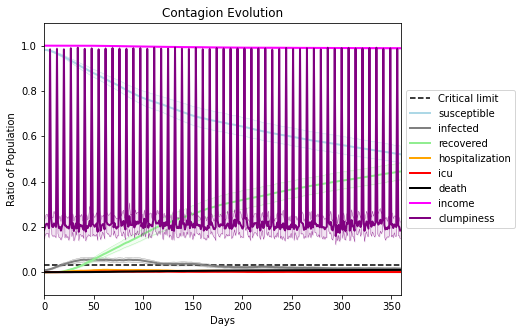

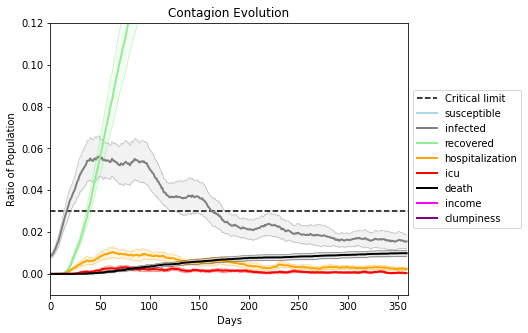

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3907, 5316, 8970, 7601, 7195, 386, 6940, 1274, 5336, 1721, 3504, 1914, 9362, 9371, 8979, 3918, 1819, 690, 3217, 6079]
Average similarity between family members is 0.9568332555605668 at temperature -0.9975
Average similarity between family and home is 0.9998610885033297 at temperature -1
Average similarity between students and their classroom is 0.678195629163641 at temperature -0.9975
Average classroom occupancy is 3.911764705882353 and number classrooms is 68
Average similarity between workers is 0.9425336567317568 at temperature -0.9975
Average office occupancy is 3.581151832460733 and number offices is 191
Average friend similarity for adults: 0.8773010841396703 for kids: 0.7058517731107318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.6161670095273611
avg restaurant similarity 0.583362847234515
avg restaurant similarity 0.6784677055620674
avg restaurant similarity 0.6131304365802273
avg restaurant similarity 0.6373962018072574
avg restaurant similarity 0.6316836319823798
avg restaurant similarity 0.6394996144885193
avg restaurant similarity 0.6589712767926763
avg restaurant similarity 0.6157717459907442
avg restaurant similarity 0.6870305684485332
avg restaurant similarity 0.669874076810744
avg restaurant similarity 0.610920719355426
avg restaurant similarity 0.6349085888421777
avg restaurant similarity 0.6371138672587664
avg restaurant similarity 0.5900187041707073
avg restaurant similarity 0.633412669523284
avg restaurant similarity 0.66728039297557
avg restaurant similarity 0.6691087902734569
avg restaurant similarity 0.6047570487343735
avg restaurant similarity 0.626505596136634
avg restaurant similarity 0.5888059088153123
avg restaurant similarity 0.590623831646795
avg restaurant sim

avg restaurant similarity 0.6177280818424411
avg restaurant similarity 0.6105653827738542
avg restaurant similarity 0.6002785286050553
avg restaurant similarity 0.5949811804440309
avg restaurant similarity 0.5869376521965364
avg restaurant similarity 0.6197978027501866
avg restaurant similarity 0.6154088055931414
avg restaurant similarity 0.6401863984263215
avg restaurant similarity 0.6660450986801361
avg restaurant similarity 0.6462716845180662
avg restaurant similarity 0.6347104161908913
avg restaurant similarity 0.5757126983162502
avg restaurant similarity 0.6384880238289924
avg restaurant similarity 0.6236831690795547
avg restaurant similarity 0.5834291821038249
avg restaurant similarity 0.609453924939802
avg restaurant similarity 0.6183795945506033
avg restaurant similarity 0.6418793600027269
avg restaurant similarity 0.6163541720939777
avg restaurant similarity 0.6306087097900087
avg restaurant similarity 0.5672049322669821
avg restaurant similarity 0.6406195892522423
avg restaur

avg restaurant similarity 0.7154198407965724
avg restaurant similarity 0.6466852060700218
avg restaurant similarity 0.611107399337671
avg restaurant similarity 0.6446023411541834
avg restaurant similarity 0.6081193813119798
avg restaurant similarity 0.6041059901681375
avg restaurant similarity 0.5488815225753254
avg restaurant similarity 0.6618848311649413
avg restaurant similarity 0.6357061839556466
avg restaurant similarity 0.6109420677684666
avg restaurant similarity 0.6798000526452246
avg restaurant similarity 0.6452532783817155
avg restaurant similarity 0.629641997531088
avg restaurant similarity 0.6068775751272765
avg restaurant similarity 0.6950274225258949
avg restaurant similarity 0.5347841612978622
avg restaurant similarity 0.6161690107444218
avg restaurant similarity 0.6235159546046002
avg restaurant similarity 0.6841074296936269
avg restaurant similarity 0.5824573977490387
avg restaurant similarity 0.6071541936620395
avg restaurant similarity 0.630145825591938
avg restauran

avg restaurant similarity 0.6182961814374415
avg restaurant similarity 0.6391997064462626
avg restaurant similarity 0.6265731680811532
avg restaurant similarity 0.6168389320236716
avg restaurant similarity 0.6787392317062371
avg restaurant similarity 0.5863832973866504
avg restaurant similarity 0.665641079464337
avg restaurant similarity 0.6602332198842136
avg restaurant similarity 0.5814238769148609
avg restaurant similarity 0.5907984393877153
avg restaurant similarity 0.6022254559149335
avg restaurant similarity 0.6204536324174638
avg restaurant similarity 0.6342045810376795
avg restaurant similarity 0.5738846177285681
avg restaurant similarity 0.6572826131950283
avg restaurant similarity 0.5908744096625347
avg restaurant similarity 0.6347697364777721
avg restaurant similarity 0.6333530018409689
avg restaurant similarity 0.6262247489093109
avg restaurant similarity 0.6846449006527711
avg restaurant similarity 0.6228338820880842
avg restaurant similarity 0.5984095159745753
avg restaur

avg restaurant similarity 0.6320550366860904
avg restaurant similarity 0.6015864712603581
avg restaurant similarity 0.6228668798295564
avg restaurant similarity 0.6690584008068183
avg restaurant similarity 0.6380301538680625
avg restaurant similarity 0.6511057823276193
avg restaurant similarity 0.6256578332608539
avg restaurant similarity 0.6825091759338787
avg restaurant similarity 0.6197936628675654
avg restaurant similarity 0.6056492727137681
avg restaurant similarity 0.6293065079490823
avg restaurant similarity 0.602706068262298
avg restaurant similarity 0.6555315799189114
avg restaurant similarity 0.6128169701465075
avg restaurant similarity 0.6579410467406407
avg restaurant similarity 0.5849087329524993
avg restaurant similarity 0.6345995444113235
avg restaurant similarity 0.6203622436557601
avg restaurant similarity 0.5805565222035115
avg restaurant similarity 0.6366081001832189
avg restaurant similarity 0.6386769536793593
avg restaurant similarity 0.6938511049122671
avg restaur

avg restaurant similarity 0.6046932087617833
avg restaurant similarity 0.6600072137820893
avg restaurant similarity 0.6487500769580112
avg restaurant similarity 0.6604702411028062
avg restaurant similarity 0.6681374723314004
avg restaurant similarity 0.5813420165134244
avg restaurant similarity 0.7072883680594435
avg restaurant similarity 0.66053417314863
avg restaurant similarity 0.6050605163750917
avg restaurant similarity 0.6750954572444775
avg restaurant similarity 0.6786167712478769
avg restaurant similarity 0.6689900536197834
avg restaurant similarity 0.6134688526380123
avg restaurant similarity 0.6192015493324982
avg restaurant similarity 0.6280746262599287
avg restaurant similarity 0.6256313239749239
avg restaurant similarity 0.6144046359147627
avg restaurant similarity 0.6277880358586445
avg restaurant similarity 0.6371858816905109
avg restaurant similarity 0.6775801002629567
avg restaurant similarity 0.6383283436261576
avg restaurant similarity 0.6324258201265465
avg restaura

avg restaurant similarity 0.6054551852931589
avg restaurant similarity 0.677030809703191
avg restaurant similarity 0.6369466143508206
avg restaurant similarity 0.5945896390704513
avg restaurant similarity 0.6765577060373145
avg restaurant similarity 0.6248085310763065
avg restaurant similarity 0.57969702084361
avg restaurant similarity 0.609746044459499
avg restaurant similarity 0.6337243096563865
avg restaurant similarity 0.6361736548887652
avg restaurant similarity 0.6273032276658008
avg restaurant similarity 0.5945447402481145
avg restaurant similarity 0.6142724104338895
avg restaurant similarity 0.6248064832457021
avg restaurant similarity 0.6221392370723451
avg restaurant similarity 0.6335567373722484
avg restaurant similarity 0.6251781615478854
avg restaurant similarity 0.6436964207115567
avg restaurant similarity 0.642670421504961
avg restaurant similarity 0.5283137139238314
avg restaurant similarity 0.6281234258257612
avg restaurant similarity 0.6295099331845606
avg restaurant 

avg restaurant similarity 0.6296064264799454
avg restaurant similarity 0.6381157709765835
avg restaurant similarity 0.6810247085474332
avg restaurant similarity 0.6389001782343942
avg restaurant similarity 0.6570749848087419
avg restaurant similarity 0.6085322182528506
avg restaurant similarity 0.6793772235039156
avg restaurant similarity 0.6176481713104716
avg restaurant similarity 0.613876068098361
avg restaurant similarity 0.5960837006590716
avg restaurant similarity 0.5974602160529602
avg restaurant similarity 0.626596635776034
avg restaurant similarity 0.5941991798733547
avg restaurant similarity 0.6375581991075171
avg restaurant similarity 0.6024849834249215
avg restaurant similarity 0.5910067070506734
avg restaurant similarity 0.6064823423195274
avg restaurant similarity 0.6591133018631263
avg restaurant similarity 0.654031223311608
avg restaurant similarity 0.6323763428054388
avg restaurant similarity 0.6430431350623891
avg restaurant similarity 0.6635839765544567
avg restauran

avg restaurant similarity 0.6220360006961233
avg restaurant similarity 0.6192586881221667
avg restaurant similarity 0.6336663069379527
avg restaurant similarity 0.5718676078639249
avg restaurant similarity 0.6214397819817872
avg restaurant similarity 0.6669219129740765
avg restaurant similarity 0.5835172286412713
avg restaurant similarity 0.6229313937070471
avg restaurant similarity 0.6361323473232983
avg restaurant similarity 0.6690471761466324
avg restaurant similarity 0.6619601336354183
avg restaurant similarity 0.5803502783434632
avg restaurant similarity 0.6310036408982392
avg restaurant similarity 0.6479363150638484
avg restaurant similarity 0.6267491745568602
avg restaurant similarity 0.6133709836498762
avg restaurant similarity 0.6147212352916621
avg restaurant similarity 0.5921290728227524
avg restaurant similarity 0.5900472533512803
avg restaurant similarity 0.6694801538826045
avg restaurant similarity 0.606679423237619
avg restaurant similarity 0.5774169326390799
avg restaur

avg restaurant similarity 0.6320624592893582
avg restaurant similarity 0.619869121942281
avg restaurant similarity 0.606935042168546
avg restaurant similarity 0.6160932780189875
avg restaurant similarity 0.5905831996367535
avg restaurant similarity 0.6096625357960879
avg restaurant similarity 0.6467944640594949
avg restaurant similarity 0.5931256087762895
avg restaurant similarity 0.5697386507277337
avg restaurant similarity 0.5980532584739164
avg restaurant similarity 0.5834462098175035
avg restaurant similarity 0.545183996492635
avg restaurant similarity 0.5972471853664686
avg restaurant similarity 0.6045764745660083
avg restaurant similarity 0.5788390558612401
avg restaurant similarity 0.6244423761513049
avg restaurant similarity 0.6330761043238853
avg restaurant similarity 0.5999410036289421
avg restaurant similarity 0.615779370325047
avg restaurant similarity 0.5996321603110745
avg restaurant similarity 0.6484933946925261
avg restaurant similarity 0.6367881401950843
avg restaurant

avg restaurant similarity 0.6350895160566394
avg restaurant similarity 0.6463757983214572
avg restaurant similarity 0.6201323549598907
avg restaurant similarity 0.6384281792060356
avg restaurant similarity 0.647683744255055
avg restaurant similarity 0.6437387261291556
avg restaurant similarity 0.678153569239807
avg restaurant similarity 0.6560975427549894
avg restaurant similarity 0.6346774677477088
avg restaurant similarity 0.6156990324347897
avg restaurant similarity 0.6348176189769886
avg restaurant similarity 0.6758162312594508
avg restaurant similarity 0.6214404499978903
avg restaurant similarity 0.6423453601580942
avg restaurant similarity 0.6353879834381427
avg restaurant similarity 0.6073205755075806
avg restaurant similarity 0.5737980155679073
avg restaurant similarity 0.6543951716927169
avg restaurant similarity 0.5808027050046894
avg restaurant similarity 0.6365002803212517
avg restaurant similarity 0.6520483892593351
avg restaurant similarity 0.586489709772344
avg restauran

avg restaurant similarity 0.6530304355060306
avg restaurant similarity 0.5939517882859902
avg restaurant similarity 0.6373490587824746
avg restaurant similarity 0.5917256265384523
avg restaurant similarity 0.6407304250943235
avg restaurant similarity 0.6015012244550375
avg restaurant similarity 0.5704895073759397
avg restaurant similarity 0.6320320626509559
avg restaurant similarity 0.6416872019146299
avg restaurant similarity 0.6684673945618553
avg restaurant similarity 0.5866038506399844
avg restaurant similarity 0.5788254135969993
avg restaurant similarity 0.6268124491990269
avg restaurant similarity 0.6373056195761685
avg restaurant similarity 0.6330701527162794
avg restaurant similarity 0.6060105123977224
avg restaurant similarity 0.632915351748983
avg restaurant similarity 0.5900916223854604
avg restaurant similarity 0.6134923301596829
avg restaurant similarity 0.621389615532659
avg restaurant similarity 0.629710153735487
avg restaurant similarity 0.5422104397269287
avg restauran

avg restaurant similarity 0.632111831947619
avg restaurant similarity 0.6518732558064944
avg restaurant similarity 0.5464181091707864
avg restaurant similarity 0.6365870610194572
avg restaurant similarity 0.571198978684409
avg restaurant similarity 0.5490636227424786
avg restaurant similarity 0.6132075305303798
avg restaurant similarity 0.6704741865721278
avg restaurant similarity 0.6604740947136117
avg restaurant similarity 0.6682462874758442
avg restaurant similarity 0.6156577581820158
avg restaurant similarity 0.659982055329475
avg restaurant similarity 0.6344502070861847
avg restaurant similarity 0.6113829281177763
avg restaurant similarity 0.6331072497886968
avg restaurant similarity 0.6213048734552081
avg restaurant similarity 0.61957918759585
avg restaurant similarity 0.6715564869930323
avg restaurant similarity 0.6919742707554025
avg restaurant similarity 0.6672013135434565
avg restaurant similarity 0.619462497603369
avg restaurant similarity 0.6409858833661918
avg restaurant s

avg restaurant similarity 0.5857123339498569
avg restaurant similarity 0.6019366953112483
avg restaurant similarity 0.601591149499116
avg restaurant similarity 0.5650446509549465
avg restaurant similarity 0.6218022696570779
avg restaurant similarity 0.6135831898519377
avg restaurant similarity 0.6378280734180772
avg restaurant similarity 0.6255166029481609
avg restaurant similarity 0.6534155978177704
avg restaurant similarity 0.5537544416817485
avg restaurant similarity 0.6375158398561135
avg restaurant similarity 0.6170486747797823
avg restaurant similarity 0.6175185617341442
avg restaurant similarity 0.6633870923322726
avg restaurant similarity 0.6235199189732089
avg restaurant similarity 0.6061459041811135
avg restaurant similarity 0.6337779778580673
avg restaurant similarity 0.6382900757900223
avg restaurant similarity 0.6028277964429501
avg restaurant similarity 0.6262214861412876
avg restaurant similarity 0.5756512034201499
avg restaurant similarity 0.631068790289684
avg restaura

avg restaurant similarity 0.6508948467679512
avg restaurant similarity 0.5988847453992855
avg restaurant similarity 0.6523842886979476
avg restaurant similarity 0.6770565451166307
avg restaurant similarity 0.5797169955015717
avg restaurant similarity 0.6031279934198681
avg restaurant similarity 0.6681578399883129
avg restaurant similarity 0.5613989003073988
avg restaurant similarity 0.6238590369268953
avg restaurant similarity 0.6552413982935897
avg restaurant similarity 0.640100406410635
avg restaurant similarity 0.6500143751329909
avg restaurant similarity 0.7019020524701026
avg restaurant similarity 0.6742187262865209
avg restaurant similarity 0.6908924443757669
avg restaurant similarity 0.6943599869228714
avg restaurant similarity 0.6792157414753608
avg restaurant similarity 0.6728224924623519
avg restaurant similarity 0.6796773261790897
avg restaurant similarity 0.6500468473235587
avg restaurant similarity 0.6542091559756469
avg restaurant similarity 0.6069766526123301
avg restaur

avg restaurant similarity 0.6138034706187877
avg restaurant similarity 0.6249174783955256
avg restaurant similarity 0.6027630565453942
avg restaurant similarity 0.6269705218707559
avg restaurant similarity 0.6336963681026181
avg restaurant similarity 0.6361517151259295
avg restaurant similarity 0.6077287358375224
avg restaurant similarity 0.6315983069433766
avg restaurant similarity 0.6217007102843283
avg restaurant similarity 0.6126366851045092
avg restaurant similarity 0.6675061729896422
avg restaurant similarity 0.5812047318623937
avg restaurant similarity 0.6376497168441042
avg restaurant similarity 0.637609725601448
avg restaurant similarity 0.6626881212246472
avg restaurant similarity 0.6470370410843458
avg restaurant similarity 0.6385591271898019
avg restaurant similarity 0.6021798325209184
avg restaurant similarity 0.6449613994592387
avg restaurant similarity 0.6105993327297022
avg restaurant similarity 0.6457906166806964
avg restaurant similarity 0.6698801078154086
avg restaur

avg restaurant similarity 0.689997401670355
avg restaurant similarity 0.6317917371096994
avg restaurant similarity 0.673994635193779
avg restaurant similarity 0.6811365924626978
avg restaurant similarity 0.6336064467934036
avg restaurant similarity 0.6442033105651698
avg restaurant similarity 0.6770768025222399
avg restaurant similarity 0.6769569806516698
avg restaurant similarity 0.6036526258279041
avg restaurant similarity 0.6495215021455165
avg restaurant similarity 0.6889775033565925
avg restaurant similarity 0.7015774555244424
avg restaurant similarity 0.66522395832124
avg restaurant similarity 0.6599672558370469
avg restaurant similarity 0.6503602813014321
avg restaurant similarity 0.7415586949627073
avg restaurant similarity 0.617360944154517
avg restaurant similarity 0.6756019443180188
avg restaurant similarity 0.6887534841913421
avg restaurant similarity 0.6593418610955282
avg restaurant similarity 0.6780327731174567
avg restaurant similarity 0.6651748935272289
avg restaurant 

avg restaurant similarity 0.6578646445686461
avg restaurant similarity 0.6800284680772519
avg restaurant similarity 0.6585387616337298
avg restaurant similarity 0.6572432227647791
avg restaurant similarity 0.6595653002237128
avg restaurant similarity 0.6285002195695741
avg restaurant similarity 0.6833315205633727
avg restaurant similarity 0.6607255772574399
avg restaurant similarity 0.6673777579319464
avg restaurant similarity 0.6763488952298241
avg restaurant similarity 0.6175221898725632
avg restaurant similarity 0.6721222081911652
avg restaurant similarity 0.6704972249577573
avg restaurant similarity 0.6636976602597481
avg restaurant similarity 0.6582066055802518
avg restaurant similarity 0.6658796016159044
avg restaurant similarity 0.6692001848410577
avg restaurant similarity 0.6740053931887214
avg restaurant similarity 0.6633085644419546
avg restaurant similarity 0.7120131163527686
avg restaurant similarity 0.6914376288932428
avg restaurant similarity 0.6476996228782956
avg restau

avg restaurant similarity 0.5842368533486216
avg restaurant similarity 0.637863724557411
avg restaurant similarity 0.6672942768632161
avg restaurant similarity 0.5781705548159558
avg restaurant similarity 0.586733604432811
avg restaurant similarity 0.6096725051175637
avg restaurant similarity 0.6273536037432167
avg restaurant similarity 0.6883364425245936
avg restaurant similarity 0.6498262309774485
avg restaurant similarity 0.6000395778612986
avg restaurant similarity 0.6127729288934495
avg restaurant similarity 0.6458710235429397
avg restaurant similarity 0.59827399435545
avg restaurant similarity 0.6773636154119207
avg restaurant similarity 0.6279968428730109
avg restaurant similarity 0.6601371071366059
avg restaurant similarity 0.6666109671288107
avg restaurant similarity 0.5988784997078704
avg restaurant similarity 0.6149558747750866
avg restaurant similarity 0.5963829638435083
avg restaurant similarity 0.5900763499183106
avg restaurant similarity 0.6021358625405243
avg restaurant

avg restaurant similarity 0.6345750606050915
avg restaurant similarity 0.5810154463406427
avg restaurant similarity 0.6631222130841256
avg restaurant similarity 0.6089264615948609
avg restaurant similarity 0.5945905098152208
avg restaurant similarity 0.6435665305692432
avg restaurant similarity 0.6310554144921278
avg restaurant similarity 0.648878567847572
avg restaurant similarity 0.608434120966311
avg restaurant similarity 0.6136879829081359
avg restaurant similarity 0.665089866064085
avg restaurant similarity 0.6367232720036706
avg restaurant similarity 0.6035548490566547
avg restaurant similarity 0.6348650395109319
avg restaurant similarity 0.6765821539680498
avg restaurant similarity 0.6369055580220755
avg restaurant similarity 0.6564461186155468
avg restaurant similarity 0.6869232944542734
avg restaurant similarity 0.7004510334093219
avg restaurant similarity 0.6521535645015893
avg restaurant similarity 0.6299746305497516
avg restaurant similarity 0.683480108900611
avg restaurant

avg restaurant similarity 0.6261399504408236
avg restaurant similarity 0.564870433570645
avg restaurant similarity 0.6431754275090064
avg restaurant similarity 0.6294422790201579
avg restaurant similarity 0.5734247578966958
avg restaurant similarity 0.6504269162837694
avg restaurant similarity 0.6488423625966059
avg restaurant similarity 0.5950515572013191
avg restaurant similarity 0.6519242371198597
avg restaurant similarity 0.6425378661314951
avg restaurant similarity 0.5757285319858337
avg restaurant similarity 0.6201840809919237
avg restaurant similarity 0.6147632621836342
avg restaurant similarity 0.6100877203950489
avg restaurant similarity 0.5638584971005784
avg restaurant similarity 0.5890144705012865
avg restaurant similarity 0.633699441194578
avg restaurant similarity 0.5779542805724306
avg restaurant similarity 0.6231930267454131
avg restaurant similarity 0.6081851056222422
avg restaurant similarity 0.6305011127749182
avg restaurant similarity 0.6012183579996366
avg restaura

avg restaurant similarity 0.6367446894379454
avg restaurant similarity 0.6439331472345177
avg restaurant similarity 0.6412010333438166
avg restaurant similarity 0.6493785551663778
avg restaurant similarity 0.6917973274754343
avg restaurant similarity 0.6013763229964101
avg restaurant similarity 0.5952184700226198
avg restaurant similarity 0.6161874653442697
avg restaurant similarity 0.5367378034833145
avg restaurant similarity 0.6123720570584389
avg restaurant similarity 0.6008752456742
avg restaurant similarity 0.6248486240260998
avg restaurant similarity 0.5650019352150429
avg restaurant similarity 0.595182554407671
avg restaurant similarity 0.5931855419508812
avg restaurant similarity 0.6104668658936663
avg restaurant similarity 0.6586147120624974
avg restaurant similarity 0.5860104409969774
avg restaurant similarity 0.5628717966502206
avg restaurant similarity 0.6616660485744855
avg restaurant similarity 0.6217504619508059
avg restaurant similarity 0.5996535041916239
avg restaurant

avg restaurant similarity 0.6641284883697623
avg restaurant similarity 0.6374703603896644
avg restaurant similarity 0.6553086828464365
avg restaurant similarity 0.7329019974902024
avg restaurant similarity 0.7094689695881821
avg restaurant similarity 0.6516728148210059
avg restaurant similarity 0.6707011317485669
avg restaurant similarity 0.6810879347387391
avg restaurant similarity 0.6611340786608454
avg restaurant similarity 0.6912218230629293
avg restaurant similarity 0.6362272064535026
avg restaurant similarity 0.6409765601309033
avg restaurant similarity 0.7000445751502635
avg restaurant similarity 0.6413352888540662
avg restaurant similarity 0.7004116323569218
avg restaurant similarity 0.6413547118189727
avg restaurant similarity 0.6926428406511544
avg restaurant similarity 0.6741795478719234
avg restaurant similarity 0.6700746324507283
avg restaurant similarity 0.6865719985024986
avg restaurant similarity 0.6625325794876707
avg restaurant similarity 0.6891518629320922
avg restau

avg restaurant similarity 0.7065548772098917
avg restaurant similarity 0.6645798334789965
avg restaurant similarity 0.6518389645910515
avg restaurant similarity 0.6874905856654011
avg restaurant similarity 0.6896777863077748
avg restaurant similarity 0.7125737814272691
avg restaurant similarity 0.6862514404406498
avg restaurant similarity 0.6397430262095171
avg restaurant similarity 0.7001315025778726
avg restaurant similarity 0.6459404134452047
avg restaurant similarity 0.7041956339683951
avg restaurant similarity 0.6798307804159037
avg restaurant similarity 0.6749192392156059
avg restaurant similarity 0.6066984613212554
avg restaurant similarity 0.7209743171529652
avg restaurant similarity 0.6458342701263494
avg restaurant similarity 0.6731651246447283
avg restaurant similarity 0.6996941627499754
avg restaurant similarity 0.6297830475526522
avg restaurant similarity 0.6828411156978811
avg restaurant similarity 0.6249349405658464
avg restaurant similarity 0.677085099916186
avg restaur

avg restaurant similarity 0.6268693942132517
avg restaurant similarity 0.6236935971810387
avg restaurant similarity 0.6625018055113365
avg restaurant similarity 0.638165710161426
avg restaurant similarity 0.6656413264800489
avg restaurant similarity 0.6518989499808763
avg restaurant similarity 0.6650238373065193
avg restaurant similarity 0.6641371953136992
avg restaurant similarity 0.6676150774453492
avg restaurant similarity 0.6823907904342333
avg restaurant similarity 0.6656922090974453
avg restaurant similarity 0.6465514031386059
avg restaurant similarity 0.6593357436956705
avg restaurant similarity 0.6676311989110617
avg restaurant similarity 0.6379854473550035
avg restaurant similarity 0.6448349287057151
avg restaurant similarity 0.6459308009329536
avg restaurant similarity 0.6067708233222295
avg restaurant similarity 0.6060998786062175
avg restaurant similarity 0.6132732229363929
avg restaurant similarity 0.6163808924265535
avg restaurant similarity 0.6299271273413005
avg restaur

avg restaurant similarity 0.5851690350959234
avg restaurant similarity 0.6415175867517477
avg restaurant similarity 0.6880380552125749
avg restaurant similarity 0.6508942331618298
avg restaurant similarity 0.6087739445632556
avg restaurant similarity 0.6642860686866732
avg restaurant similarity 0.6331406125775687
avg restaurant similarity 0.6709556284766047
avg restaurant similarity 0.6518985709689004
avg restaurant similarity 0.6230718448192492
avg restaurant similarity 0.685793087671236
avg restaurant similarity 0.6578297975452239
avg restaurant similarity 0.7079869556282309
avg restaurant similarity 0.636652691263996
avg restaurant similarity 0.62447496140061
avg restaurant similarity 0.6325659317383103
avg restaurant similarity 0.6137192025826145
avg restaurant similarity 0.7171090834286656
avg restaurant similarity 0.6711247411387532
avg restaurant similarity 0.6891497554404764
avg restaurant similarity 0.6285777148257148
avg restaurant similarity 0.6614909774815099
avg restaurant

avg restaurant similarity 0.6251644213285595
avg restaurant similarity 0.607854324207417
avg restaurant similarity 0.6231713684051902
avg restaurant similarity 0.6144633795162702
avg restaurant similarity 0.6343011414073073
avg restaurant similarity 0.5763653857066035
avg restaurant similarity 0.6528357528501689
avg restaurant similarity 0.6577347849156653
avg restaurant similarity 0.6684154803472062
avg restaurant similarity 0.6335819134481908
avg restaurant similarity 0.6871664467658689
avg restaurant similarity 0.6970093969205648
avg restaurant similarity 0.6561540535457778
avg restaurant similarity 0.6496324802266259
avg restaurant similarity 0.6198487256421709
avg restaurant similarity 0.6280440998715879
avg restaurant similarity 0.6375360424863815
avg restaurant similarity 0.6179769795521393
avg restaurant similarity 0.6569905539941024
avg restaurant similarity 0.5783740382808314
avg restaurant similarity 0.5858877998581622
avg restaurant similarity 0.5902709521634766
avg restaur

avg restaurant similarity 0.6403161239603152
avg restaurant similarity 0.6210415622866182
avg restaurant similarity 0.5997501507518012
avg restaurant similarity 0.5619043925700731
avg restaurant similarity 0.6714754163195955
avg restaurant similarity 0.659472756509611
avg restaurant similarity 0.6135444193755881
avg restaurant similarity 0.6867325159247661
avg restaurant similarity 0.6018415897507307
avg restaurant similarity 0.6150510872342757
avg restaurant similarity 0.6160991507229013
avg restaurant similarity 0.5680664995879582
avg restaurant similarity 0.6101598965030076
avg restaurant similarity 0.6304736042966957
avg restaurant similarity 0.650220602788764
avg restaurant similarity 0.6463442449448168
avg restaurant similarity 0.6484308520444846
avg restaurant similarity 0.6440866614439668
avg restaurant similarity 0.6539747803156206
avg restaurant similarity 0.6665267273222649
avg restaurant similarity 0.6135303836995408
avg restaurant similarity 0.6256655413555041
avg restaura

avg restaurant similarity 0.6202671587168797
avg restaurant similarity 0.6055650227880619
avg restaurant similarity 0.6013086285070363
avg restaurant similarity 0.6476406920953177
avg restaurant similarity 0.6234769092089759
avg restaurant similarity 0.6563688228324438
avg restaurant similarity 0.6403262401437694
avg restaurant similarity 0.6470556351828182
avg restaurant similarity 0.6470320712908781
avg restaurant similarity 0.5883605337539098
avg restaurant similarity 0.630250225044157
avg restaurant similarity 0.6149516328891759
avg restaurant similarity 0.6146875342989462
avg restaurant similarity 0.6255018255476428
avg restaurant similarity 0.5977950770107436
avg restaurant similarity 0.6187141548805595
avg restaurant similarity 0.6021833014769118
avg restaurant similarity 0.6535941251912051
avg restaurant similarity 0.630800945402313
avg restaurant similarity 0.6093029311241259
avg restaurant similarity 0.643775007067193
avg restaurant similarity 0.5930976208376715
avg restauran

avg restaurant similarity 0.6168218995237891
avg restaurant similarity 0.5993499776817829
avg restaurant similarity 0.6377346455460341
avg restaurant similarity 0.5994745137421242
avg restaurant similarity 0.5937955729117463
avg restaurant similarity 0.631788579872726
avg restaurant similarity 0.6230268699359179
avg restaurant similarity 0.6100532668572364
avg restaurant similarity 0.6963269811764906
avg restaurant similarity 0.583193893411026
avg restaurant similarity 0.6408302895164718
avg restaurant similarity 0.6194776585094679
avg restaurant similarity 0.6365422569775292
avg restaurant similarity 0.6481015419470345
avg restaurant similarity 0.6063655806316457
avg restaurant similarity 0.6081712493489662
avg restaurant similarity 0.591635594084233
avg restaurant similarity 0.588590991427503
avg restaurant similarity 0.5718857098948797
avg restaurant similarity 0.6447284516593879
avg restaurant similarity 0.6194401348037147
avg restaurant similarity 0.6327790228484629
avg restaurant

avg restaurant similarity 0.6423646457971045
avg restaurant similarity 0.6798376962045706
avg restaurant similarity 0.6568939112592244
avg restaurant similarity 0.6374868036508431
avg restaurant similarity 0.6194716569328491
avg restaurant similarity 0.5776526017557563
avg restaurant similarity 0.6426277763877197
avg restaurant similarity 0.598196015605381
avg restaurant similarity 0.5989041577198277
avg restaurant similarity 0.6005650444492592
avg restaurant similarity 0.6355883972157643
avg restaurant similarity 0.623523015537676
avg restaurant similarity 0.5955451770987235
avg restaurant similarity 0.6492452217231324
avg restaurant similarity 0.641149282076512
avg restaurant similarity 0.6018048614660084
avg restaurant similarity 0.5546287136731115
avg restaurant similarity 0.5861530427945356
avg restaurant similarity 0.6231317963960616
avg restaurant similarity 0.6451734689661839
avg restaurant similarity 0.6167750522671148
avg restaurant similarity 0.6870363655550963
avg restauran

avg restaurant similarity 0.5966390582771197
avg restaurant similarity 0.6159017483240902
avg restaurant similarity 0.6318859223191907
avg restaurant similarity 0.5528936435572813
avg restaurant similarity 0.578203371739312
avg restaurant similarity 0.6218938950579379
avg restaurant similarity 0.6206219274299876
avg restaurant similarity 0.6328831666227478
avg restaurant similarity 0.6079472711722168
avg restaurant similarity 0.6011937469108691
avg restaurant similarity 0.575111901922333
avg restaurant similarity 0.5642649876136042
avg restaurant similarity 0.5732441118914263
avg restaurant similarity 0.5793169370001221
avg restaurant similarity 0.5925673414071996
avg restaurant similarity 0.6113338758604536
avg restaurant similarity 0.5969788038833842
avg restaurant similarity 0.6496228292267882
avg restaurant similarity 0.6399496616236915
avg restaurant similarity 0.539552490271369
avg restaurant similarity 0.5563750495020059
avg restaurant similarity 0.5902493839262812
avg restauran

avg restaurant similarity 0.668859975470592
avg restaurant similarity 0.6632441284473828
avg restaurant similarity 0.6143972036232334
avg restaurant similarity 0.6202956492269394
avg restaurant similarity 0.579627453857818
avg restaurant similarity 0.595975944996367
avg restaurant similarity 0.595253452640006
avg restaurant similarity 0.6520571183078994
avg restaurant similarity 0.5941923854575709
avg restaurant similarity 0.60042003106882
avg restaurant similarity 0.5940431041006891
avg restaurant similarity 0.6345612026617046
avg restaurant similarity 0.5797408004560232
avg restaurant similarity 0.6590377842569829
avg restaurant similarity 0.6187388285855885
avg restaurant similarity 0.6251527968860513
avg restaurant similarity 0.6033327383396366
avg restaurant similarity 0.5583543551913221
avg restaurant similarity 0.5964294065881965
avg restaurant similarity 0.6230277103954883
avg restaurant similarity 0.572027867448719
avg restaurant similarity 0.6438596509002582
avg restaurant si

avg restaurant similarity 0.60845481430172
avg restaurant similarity 0.5830159195950219
avg restaurant similarity 0.6245153612907489
avg restaurant similarity 0.5862829119659118
avg restaurant similarity 0.5644866687685635
avg restaurant similarity 0.6016390923887445
avg restaurant similarity 0.5778685665817145
avg restaurant similarity 0.5969246354877669
avg restaurant similarity 0.5901825128715615
avg restaurant similarity 0.665285475616302
avg restaurant similarity 0.569694655308544
avg restaurant similarity 0.5779102112052326
avg restaurant similarity 0.5934456592810171
avg restaurant similarity 0.6409340960438275
avg restaurant similarity 0.5869132473711259
avg restaurant similarity 0.554998171558702
avg restaurant similarity 0.5963137685130278
avg restaurant similarity 0.6015958736836196
avg restaurant similarity 0.6145722280297584
avg restaurant similarity 0.5925079677959342
avg restaurant similarity 0.5900573259530567
avg restaurant similarity 0.596344188488924
avg restaurant s

avg restaurant similarity 0.6130053220072936
avg restaurant similarity 0.5763908604162741
avg restaurant similarity 0.5597192915695233
avg restaurant similarity 0.5755776900609538
avg restaurant similarity 0.5496142986686682
avg restaurant similarity 0.6128468099578117
avg restaurant similarity 0.6062282473681406
avg restaurant similarity 0.5668492671607092
avg restaurant similarity 0.6282341293741676
avg restaurant similarity 0.6082189330899729
avg restaurant similarity 0.5767505209080455
avg restaurant similarity 0.6421096243713611
avg restaurant similarity 0.5986565440621987
avg restaurant similarity 0.6108737813332596
avg restaurant similarity 0.6025780087931628
avg restaurant similarity 0.5928582917045703
avg restaurant similarity 0.6118947906721113
avg restaurant similarity 0.6700437199975087
avg restaurant similarity 0.5767291329947857
avg restaurant similarity 0.6470175696464643
avg restaurant similarity 0.6826648159047849
avg restaurant similarity 0.6180609362283811
avg restau

avg restaurant similarity 0.5431932540140485
avg restaurant similarity 0.606877914734339
avg restaurant similarity 0.5487064820068404
avg restaurant similarity 0.6075224185879868
avg restaurant similarity 0.5580911620379772
avg restaurant similarity 0.6391259910962616
avg restaurant similarity 0.5986607734527165
avg restaurant similarity 0.6053889188660372
avg restaurant similarity 0.602317313847447
avg restaurant similarity 0.629535104832115
avg restaurant similarity 0.6226998970724622
avg restaurant similarity 0.5695527241745003
avg restaurant similarity 0.6006631514517118
avg restaurant similarity 0.6082875800961978
avg restaurant similarity 0.6052809206206498
avg restaurant similarity 0.5734264892607877
avg restaurant similarity 0.5872085044575421
avg restaurant similarity 0.5870954599045297
avg restaurant similarity 0.5940169386364934
avg restaurant similarity 0.6225612487719288
avg restaurant similarity 0.5925777109046282
avg restaurant similarity 0.5574307699795267
avg restauran

avg restaurant similarity 0.6408714608178614
avg restaurant similarity 0.5629679179116975
avg restaurant similarity 0.6323445108367982
avg restaurant similarity 0.6265782149296956
avg restaurant similarity 0.5956190724699159
avg restaurant similarity 0.6417848200033824
avg restaurant similarity 0.6164281050664758
avg restaurant similarity 0.6325341552067353
avg restaurant similarity 0.6276652179861071
avg restaurant similarity 0.6328326169791666
avg restaurant similarity 0.6161588555700616
avg restaurant similarity 0.6078892668143185
avg restaurant similarity 0.6245242795299375
avg restaurant similarity 0.6160323087353013
avg restaurant similarity 0.5987622135511692
avg restaurant similarity 0.5858050402720325
avg restaurant similarity 0.5823781659785219
avg restaurant similarity 0.6150589500221473
avg restaurant similarity 0.5901053179256445
avg restaurant similarity 0.645361485274942
avg restaurant similarity 0.5842062254637171
avg restaurant similarity 0.6478153190548394
avg restaur

avg restaurant similarity 0.6319595919458417
avg restaurant similarity 0.6801555525870202
avg restaurant similarity 0.6328002347542717
avg restaurant similarity 0.613920853425706
avg restaurant similarity 0.6099290800233438
avg restaurant similarity 0.5998217174331512
avg restaurant similarity 0.6062485773179813
avg restaurant similarity 0.6142611491117077
avg restaurant similarity 0.6289858056049132
avg restaurant similarity 0.6087879059635053
avg restaurant similarity 0.6102306230266471
avg restaurant similarity 0.6324366559582162
avg restaurant similarity 0.613485454571694
avg restaurant similarity 0.6572395572649313
avg restaurant similarity 0.6073163059632749
avg restaurant similarity 0.5939514218482311
avg restaurant similarity 0.6052011893460757
avg restaurant similarity 0.6333594535271571
avg restaurant similarity 0.6141932501638032
avg restaurant similarity 0.617785313935288
avg restaurant similarity 0.5828877256712152
avg restaurant similarity 0.6243609129688883
avg restauran

avg restaurant similarity 0.6653613538254983
avg restaurant similarity 0.6632162536285603
avg restaurant similarity 0.6997640753701655
avg restaurant similarity 0.6614482571342153
avg restaurant similarity 0.605045496292479
avg restaurant similarity 0.6866617370667831
avg restaurant similarity 0.6914436859638111
avg restaurant similarity 0.7106517525610082
avg restaurant similarity 0.6775949891523255
avg restaurant similarity 0.6920385484382835
avg restaurant similarity 0.6629677720820659
avg restaurant similarity 0.6710281562539133
avg restaurant similarity 0.7406220266324993
avg restaurant similarity 0.6745780093416547
avg restaurant similarity 0.6744792396160662
avg restaurant similarity 0.6978906950778893
avg restaurant similarity 0.6874032771320258
avg restaurant similarity 0.664834410488768
avg restaurant similarity 0.6304618185446765
avg restaurant similarity 0.6685605723296012
avg restaurant similarity 0.692818485034021
avg restaurant similarity 0.6643427933675159
avg restauran

avg restaurant similarity 0.6717490465090661
avg restaurant similarity 0.6733215505725904
avg restaurant similarity 0.6779288272368189
avg restaurant similarity 0.7258279739506047
avg restaurant similarity 0.6838698511740766
avg restaurant similarity 0.6993608789418204
avg restaurant similarity 0.6817050241801459
avg restaurant similarity 0.686841094745324
avg restaurant similarity 0.699241145611102
avg restaurant similarity 0.6832431110185772
avg restaurant similarity 0.6655345099191524
avg restaurant similarity 0.7029647314427115
avg restaurant similarity 0.6890454245369759
avg restaurant similarity 0.7119864333242232
avg restaurant similarity 0.6672761601150142
avg restaurant similarity 0.6644863286484107
avg restaurant similarity 0.7072429222492557
avg restaurant similarity 0.6743211416907458
avg restaurant similarity 0.6981121786683243
avg restaurant similarity 0.6736124403352083
avg restaurant similarity 0.6932748533552269
avg restaurant similarity 0.6425780620411348
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

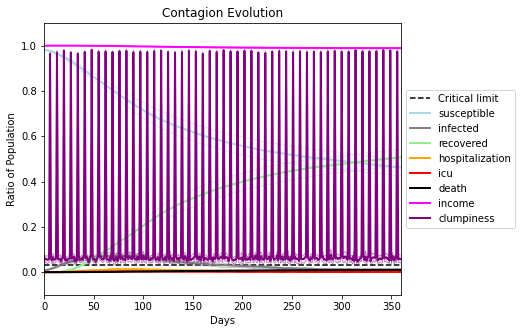

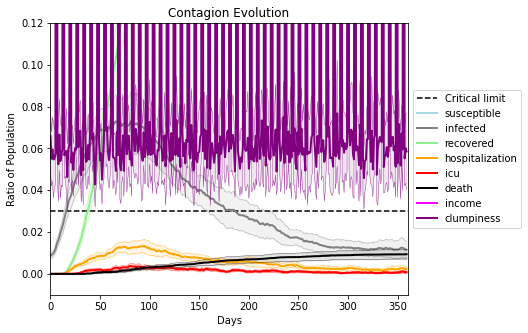

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9294, 4706, 5029, 351, 6474, 9738, 6427, 2624, 6755, 1869, 3172, 5132, 9439, 5635, 736, 1811, 6793, 9077, 7508, 8097]
Average similarity between family members is 0.9528448314069661 at temperature -0.997
Average similarity between family and home is 0.9998344728087079 at temperature -1
Average similarity between students and their classroom is 0.6334516954772815 at temperature -0.997
Average classroom occupancy is 4.088235294117647 and number classrooms is 68
Average similarity between workers is 0.9235812734094534 at temperature -0.997
Average office occupancy is 3.546875 and number offices is 192
Average friend similarity for adults: 0.8649864304230507 for kids: 0.6926074153843406
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.5931963264015271
avg restaurant similarity 0.622313758265015
avg restaurant similarity 0.6220024761760272
avg restaurant similarity 0.5777638537547257
avg restaurant similarity 0.5909856539992949
avg restaurant similarity 0.6204365669367279
avg restaurant similarity 0.6099916073843713
avg restaurant similarity 0.592956093828551
avg restaurant similarity 0.5975840328036135
avg restaurant similarity 0.6029507856633884
avg restaurant similarity 0.5984561602287647
avg restaurant similarity 0.5945802715125033
avg restaurant similarity 0.6007401682262283
avg restaurant similarity 0.6354594221538495
avg restaurant similarity 0.6068266311021788
avg restaurant similarity 0.6098313440832954
avg restaurant similarity 0.630725647925601
avg restaurant similarity 0.6024286383937334
avg restaurant similarity 0.6422757381857211
avg restaurant similarity 0.619909305415558
avg restaurant similarity 0.5788280026497017
avg restaurant similarity 0.5809906323046106
avg restaurant

avg restaurant similarity 0.5855151911780669
avg restaurant similarity 0.5525929629446444
avg restaurant similarity 0.6095595576616923
avg restaurant similarity 0.6038885242749519
avg restaurant similarity 0.5954237721495556
avg restaurant similarity 0.5816742451345422
avg restaurant similarity 0.6003359571851254
avg restaurant similarity 0.5714230693773014
avg restaurant similarity 0.5582041659337494
avg restaurant similarity 0.6013552454096851
avg restaurant similarity 0.5982730919038198
avg restaurant similarity 0.6234285254810821
avg restaurant similarity 0.5832204500252066
avg restaurant similarity 0.62940397183402
avg restaurant similarity 0.5852806807059955
avg restaurant similarity 0.6072052054203786
avg restaurant similarity 0.5932297018632982
avg restaurant similarity 0.6487789748219206
avg restaurant similarity 0.6171630184003238
avg restaurant similarity 0.5831311228068563
avg restaurant similarity 0.6417654940529269
avg restaurant similarity 0.5515137316065943
avg restaura

avg restaurant similarity 0.6332481537316531
avg restaurant similarity 0.6234565664740046
avg restaurant similarity 0.5847686601618859
avg restaurant similarity 0.6596719812879182
avg restaurant similarity 0.653596331584348
avg restaurant similarity 0.5930724952339593
avg restaurant similarity 0.6180630588897372
avg restaurant similarity 0.6804290472611171
avg restaurant similarity 0.6188263208539486
avg restaurant similarity 0.6701493570195103
avg restaurant similarity 0.6038636628232704
avg restaurant similarity 0.614066935754884
avg restaurant similarity 0.6538871371134851
avg restaurant similarity 0.6414812246450814
avg restaurant similarity 0.6438188273697552
avg restaurant similarity 0.6366744242510896
avg restaurant similarity 0.6548904802842899
avg restaurant similarity 0.6218828618929839
avg restaurant similarity 0.6630227351652445
avg restaurant similarity 0.6436375579738537
avg restaurant similarity 0.6051366997283114
avg restaurant similarity 0.6822801168151007
avg restaura

avg restaurant similarity 0.6995088281340249
avg restaurant similarity 0.6545385417834966
avg restaurant similarity 0.7245288643431489
avg restaurant similarity 0.662771795594132
avg restaurant similarity 0.676379402367267
avg restaurant similarity 0.6793380858593239
avg restaurant similarity 0.6370118126947779
avg restaurant similarity 0.6519390329398633
avg restaurant similarity 0.6771616795120772
avg restaurant similarity 0.704620521757809
avg restaurant similarity 0.671627583686978
avg restaurant similarity 0.6045113957347589
avg restaurant similarity 0.6784870000167812
avg restaurant similarity 0.646147540524918
avg restaurant similarity 0.650407546727091
avg restaurant similarity 0.6481556175291274
avg restaurant similarity 0.6214817935367674
avg restaurant similarity 0.6193912926673159
avg restaurant similarity 0.670336443477978
avg restaurant similarity 0.659846874581892
avg restaurant similarity 0.6830775106542224
avg restaurant similarity 0.6333746875840878
avg restaurant sim

avg restaurant similarity 0.6247242540700706
avg restaurant similarity 0.6106176209368824
avg restaurant similarity 0.6318592185169916
avg restaurant similarity 0.6058460124764267
avg restaurant similarity 0.6288333637355774
avg restaurant similarity 0.6017062409809079
avg restaurant similarity 0.6263819570512708
avg restaurant similarity 0.6729547750400776
avg restaurant similarity 0.6902500117220131
avg restaurant similarity 0.6218454016374168
avg restaurant similarity 0.6429178684044075
avg restaurant similarity 0.5837315252442994
avg restaurant similarity 0.6838102983890173
avg restaurant similarity 0.5615503581388498
avg restaurant similarity 0.6114833202535666
avg restaurant similarity 0.6109241214385196
avg restaurant similarity 0.6345051664654126
avg restaurant similarity 0.645885291361072
avg restaurant similarity 0.6119799951997718
avg restaurant similarity 0.5810226232996293
avg restaurant similarity 0.6032464534175412
avg restaurant similarity 0.6481950445049823
avg restaur

avg restaurant similarity 0.6395175561362884
avg restaurant similarity 0.6562194519040855
avg restaurant similarity 0.5857179796162427
avg restaurant similarity 0.6314860293264859
avg restaurant similarity 0.5705664971899217
avg restaurant similarity 0.5929959811307258
avg restaurant similarity 0.5468846841505943
avg restaurant similarity 0.5749758084819905
avg restaurant similarity 0.6098224470509288
avg restaurant similarity 0.5581409051931099
avg restaurant similarity 0.6547511718633432
avg restaurant similarity 0.5863992728273314
avg restaurant similarity 0.6709865591163712
avg restaurant similarity 0.6149717970475274
avg restaurant similarity 0.6326334770914341
avg restaurant similarity 0.6411622890259402
avg restaurant similarity 0.6086327095857174
avg restaurant similarity 0.6239746397704723
avg restaurant similarity 0.6160802700840273
avg restaurant similarity 0.5871601176004002
avg restaurant similarity 0.6138942085696254
avg restaurant similarity 0.5932720638360178
avg restau

avg restaurant similarity 0.6610540297708766
avg restaurant similarity 0.6432980400461378
avg restaurant similarity 0.6774070028215112
avg restaurant similarity 0.6883052859409997
avg restaurant similarity 0.6574585668999765
avg restaurant similarity 0.6181531656221214
avg restaurant similarity 0.6341819655290147
avg restaurant similarity 0.6127931284527395
avg restaurant similarity 0.6112470946369049
avg restaurant similarity 0.6207589392061992
avg restaurant similarity 0.5821944900344843
avg restaurant similarity 0.6138069348771877
avg restaurant similarity 0.6498130171403931
avg restaurant similarity 0.6269302660463699
avg restaurant similarity 0.6605318308252521
avg restaurant similarity 0.6441811085661338
avg restaurant similarity 0.6359202297891551
avg restaurant similarity 0.6352001000166815
avg restaurant similarity 0.6352086258878799
avg restaurant similarity 0.657438559582993
avg restaurant similarity 0.6479128787777575
avg restaurant similarity 0.6641220841815194
avg restaur

avg restaurant similarity 0.6270057093675186
avg restaurant similarity 0.6619575415064991
avg restaurant similarity 0.6670271156714244
avg restaurant similarity 0.6442734576080813
avg restaurant similarity 0.5649469566946284
avg restaurant similarity 0.6608826504086521
avg restaurant similarity 0.6017208587237455
avg restaurant similarity 0.6107339699171099
avg restaurant similarity 0.6706079098746254
avg restaurant similarity 0.632018474610047
avg restaurant similarity 0.6134948673273803
avg restaurant similarity 0.5920821770106844
avg restaurant similarity 0.590077921767983
avg restaurant similarity 0.6646243936100178
avg restaurant similarity 0.6483809254235963
avg restaurant similarity 0.6126036142475217
avg restaurant similarity 0.629083579242223
avg restaurant similarity 0.6458837592706526
avg restaurant similarity 0.6548388466276062
avg restaurant similarity 0.630918763462655
avg restaurant similarity 0.6540076879766785
avg restaurant similarity 0.6211553078058955
avg restaurant

avg restaurant similarity 0.6376193109797339
avg restaurant similarity 0.6735065634943987
avg restaurant similarity 0.6145956747139996
avg restaurant similarity 0.6516409636870657
avg restaurant similarity 0.635933566827809
avg restaurant similarity 0.6711038196845902
avg restaurant similarity 0.5804412793458291
avg restaurant similarity 0.5875243271842155
avg restaurant similarity 0.6099253743617502
avg restaurant similarity 0.6514981772457501
avg restaurant similarity 0.6180449352261592
avg restaurant similarity 0.6052193726274636
avg restaurant similarity 0.6350767196633277
avg restaurant similarity 0.5630916508546749
avg restaurant similarity 0.6077952621271134
avg restaurant similarity 0.6594573804195096
avg restaurant similarity 0.6330533143820082
avg restaurant similarity 0.6055733943709404
avg restaurant similarity 0.616149134475534
avg restaurant similarity 0.5955486800879906
avg restaurant similarity 0.6193268421100376
avg restaurant similarity 0.6364941092809242
avg restaura

avg restaurant similarity 0.6468806234551376
avg restaurant similarity 0.6025415951216889
avg restaurant similarity 0.5826256182665267
avg restaurant similarity 0.642931166434314
avg restaurant similarity 0.6178679776407975
avg restaurant similarity 0.6398215047454457
avg restaurant similarity 0.6571641013015742
avg restaurant similarity 0.6093583077645632
avg restaurant similarity 0.6263288968610412
avg restaurant similarity 0.6429126740988601
avg restaurant similarity 0.6278028279710918
avg restaurant similarity 0.6849736209215732
avg restaurant similarity 0.5993269396079403
avg restaurant similarity 0.6773166512964194
avg restaurant similarity 0.6120707040839106
avg restaurant similarity 0.6228380907835437
avg restaurant similarity 0.562789585650875
avg restaurant similarity 0.5579542300160619
avg restaurant similarity 0.6121963928584652
avg restaurant similarity 0.596621665439004
avg restaurant similarity 0.6585613481104962
avg restaurant similarity 0.6489767166231662
avg restauran

avg restaurant similarity 0.5679088786226111
avg restaurant similarity 0.6049464966123916
avg restaurant similarity 0.6136201712680532
avg restaurant similarity 0.6244713866693452
avg restaurant similarity 0.5993913170030908
avg restaurant similarity 0.6160207326764029
avg restaurant similarity 0.603511235383681
avg restaurant similarity 0.5967538175306802
avg restaurant similarity 0.6005455023055399
avg restaurant similarity 0.6104001096144853
avg restaurant similarity 0.5991743995993848
avg restaurant similarity 0.6067337088001827
avg restaurant similarity 0.5965740960424245
avg restaurant similarity 0.6154903436549045
avg restaurant similarity 0.6243388187348886
avg restaurant similarity 0.656149326535502
avg restaurant similarity 0.6051516415551133
avg restaurant similarity 0.6266762306632042
avg restaurant similarity 0.6189051281688231
avg restaurant similarity 0.5628432850780457
avg restaurant similarity 0.6035389328409572
avg restaurant similarity 0.5803800523026923
avg restaura

avg restaurant similarity 0.5392588437148386
avg restaurant similarity 0.5791994946797588
avg restaurant similarity 0.5915062378171728
avg restaurant similarity 0.6106070096014913
avg restaurant similarity 0.6625502953489428
avg restaurant similarity 0.5873847606747044
avg restaurant similarity 0.6109312148349322
avg restaurant similarity 0.5713777277454543
avg restaurant similarity 0.6376174383568592
avg restaurant similarity 0.5889627756200406
avg restaurant similarity 0.6271068911051478
avg restaurant similarity 0.5931254170759057
avg restaurant similarity 0.6061254372501519
avg restaurant similarity 0.6091529526825862
avg restaurant similarity 0.5435244145965933
avg restaurant similarity 0.5251564621419402
avg restaurant similarity 0.5776426957122615
avg restaurant similarity 0.6124136162586892
avg restaurant similarity 0.588362279991622
avg restaurant similarity 0.6105569723991118
avg restaurant similarity 0.6114337194440768
avg restaurant similarity 0.5816572307079377
avg restaur

avg restaurant similarity 0.6042092694725202
avg restaurant similarity 0.6227203332968909
avg restaurant similarity 0.6287942639571337
avg restaurant similarity 0.6660888941347518
avg restaurant similarity 0.6249411505484056
avg restaurant similarity 0.6111682914473086
avg restaurant similarity 0.6481267138448252
avg restaurant similarity 0.6302390839394817
avg restaurant similarity 0.6347713509169322
avg restaurant similarity 0.613176448964175
avg restaurant similarity 0.6409950248637966
avg restaurant similarity 0.6432711045712288
avg restaurant similarity 0.6307569852476486
avg restaurant similarity 0.6122768590436697
avg restaurant similarity 0.626072711103392
avg restaurant similarity 0.5977804795689909
avg restaurant similarity 0.6518612428562628
avg restaurant similarity 0.6021052786331506
avg restaurant similarity 0.6414359626154137
avg restaurant similarity 0.5705100826638225
avg restaurant similarity 0.6398138355708102
avg restaurant similarity 0.6045763339722943
avg restaura

avg restaurant similarity 0.5978915357881416
avg restaurant similarity 0.6131212087094919
avg restaurant similarity 0.6110099010901356
avg restaurant similarity 0.6664780701405096
avg restaurant similarity 0.6461066007987892
avg restaurant similarity 0.6324331510905381
avg restaurant similarity 0.6242677606789855
avg restaurant similarity 0.6368656274466756
avg restaurant similarity 0.6758984552522912
avg restaurant similarity 0.5677188538402104
avg restaurant similarity 0.6222983299080748
avg restaurant similarity 0.5827496530647003
avg restaurant similarity 0.6209177789496512
avg restaurant similarity 0.5976331568147394
avg restaurant similarity 0.6243961343226464
avg restaurant similarity 0.6227008712216324
avg restaurant similarity 0.5992949622588157
avg restaurant similarity 0.6381192372991848
avg restaurant similarity 0.6393416411089177
avg restaurant similarity 0.6173787325791801
avg restaurant similarity 0.5896596795778468
avg restaurant similarity 0.5138960057315477
avg restau

avg restaurant similarity 0.709698487623948
avg restaurant similarity 0.6721201978104736
avg restaurant similarity 0.6440422858530809
avg restaurant similarity 0.6561363873091951
avg restaurant similarity 0.7092559438481721
avg restaurant similarity 0.643042839861918
avg restaurant similarity 0.6652214592078373
avg restaurant similarity 0.6826494231648095
avg restaurant similarity 0.7650074396968716
avg restaurant similarity 0.6776913388347963
avg restaurant similarity 0.6706359385901476
avg restaurant similarity 0.6415801841500656
avg restaurant similarity 0.6237056759382744
avg restaurant similarity 0.636061586894604
avg restaurant similarity 0.6523559657191564
avg restaurant similarity 0.6623875642986017
avg restaurant similarity 0.6124181295012986
avg restaurant similarity 0.6529038273708667
avg restaurant similarity 0.6623422427739692
avg restaurant similarity 0.6969922195752247
avg restaurant similarity 0.6758908042025571
avg restaurant similarity 0.6380971566004451
avg restauran

avg restaurant similarity 0.691362715213224
avg restaurant similarity 0.6078287642079968
avg restaurant similarity 0.6462868257953444
avg restaurant similarity 0.6820453690697161
avg restaurant similarity 0.6766620995940739
avg restaurant similarity 0.6675816331841287
avg restaurant similarity 0.7255347475702268
avg restaurant similarity 0.7032820280056082
avg restaurant similarity 0.6862812401793484
avg restaurant similarity 0.6471550229990098
avg restaurant similarity 0.6207744218382101
avg restaurant similarity 0.6597856282747897
avg restaurant similarity 0.6724313026520577
avg restaurant similarity 0.6812908572435159
avg restaurant similarity 0.6844426078448416
avg restaurant similarity 0.6672352759303535
avg restaurant similarity 0.6868116555839878
avg restaurant similarity 0.6519785755298017
avg restaurant similarity 0.6982990054122467
avg restaurant similarity 0.6946235132017056
avg restaurant similarity 0.687584365203842
avg restaurant similarity 0.6600676746684517
avg restaura

avg restaurant similarity 0.6300442661966323
avg restaurant similarity 0.6411761918725564
avg restaurant similarity 0.5784819047067149
avg restaurant similarity 0.6153929820517693
avg restaurant similarity 0.613687189044151
avg restaurant similarity 0.5978489481595207
avg restaurant similarity 0.6104755558975489
avg restaurant similarity 0.6140767393231893
avg restaurant similarity 0.6374513491810708
avg restaurant similarity 0.609636011308486
avg restaurant similarity 0.6063991621792878
avg restaurant similarity 0.6322977462336601
avg restaurant similarity 0.6005986446174358
avg restaurant similarity 0.5905115952931405
avg restaurant similarity 0.62351127932549
avg restaurant similarity 0.6337650535821109
avg restaurant similarity 0.6526230033154927
avg restaurant similarity 0.6527302181827254
avg restaurant similarity 0.603902460754861
avg restaurant similarity 0.6512096907965722
avg restaurant similarity 0.5867386541982818
avg restaurant similarity 0.5723144878659194
avg restaurant 

avg restaurant similarity 0.6123332786953664
avg restaurant similarity 0.5907639065075478
avg restaurant similarity 0.6115970603175057
avg restaurant similarity 0.6511480106279202
avg restaurant similarity 0.638162549223107
avg restaurant similarity 0.669845764329567
avg restaurant similarity 0.5857388595522558
avg restaurant similarity 0.5899722583579269
avg restaurant similarity 0.6166038413213439
avg restaurant similarity 0.5991899992413351
avg restaurant similarity 0.6089080508402085
avg restaurant similarity 0.5957767397973135
avg restaurant similarity 0.6312633275979117
avg restaurant similarity 0.6253207534876658
avg restaurant similarity 0.6239309672550409
avg restaurant similarity 0.5853766323952951
avg restaurant similarity 0.5957022347430998
avg restaurant similarity 0.5873954960264426
avg restaurant similarity 0.6240306158891304
avg restaurant similarity 0.5618303925553509
avg restaurant similarity 0.5782556612164476
avg restaurant similarity 0.652478837929906
avg restauran

avg restaurant similarity 0.653681024129877
avg restaurant similarity 0.6608172443384657
avg restaurant similarity 0.6547602532877261
avg restaurant similarity 0.6169028067200948
avg restaurant similarity 0.6522301251360029
avg restaurant similarity 0.615367009360442
avg restaurant similarity 0.6297484270103975
avg restaurant similarity 0.6320658391031686
avg restaurant similarity 0.6331763875158423
avg restaurant similarity 0.6311880949032623
avg restaurant similarity 0.6654063376981589
avg restaurant similarity 0.62518994724
avg restaurant similarity 0.6292697052119391
avg restaurant similarity 0.5790068300034352
avg restaurant similarity 0.6189155026984828
avg restaurant similarity 0.6253737986932181
avg restaurant similarity 0.6013616224718568
avg restaurant similarity 0.6086498422132663
avg restaurant similarity 0.5637007693922781
avg restaurant similarity 0.5873595035281768
avg restaurant similarity 0.5831232445807915
avg restaurant similarity 0.6336991912002038
avg restaurant si

avg restaurant similarity 0.6213361532366051
avg restaurant similarity 0.6551223069413976
avg restaurant similarity 0.6352157970378718
avg restaurant similarity 0.6266452854033753
avg restaurant similarity 0.6666506807364098
avg restaurant similarity 0.6141468932351866
avg restaurant similarity 0.6450498512852862
avg restaurant similarity 0.622966012455218
avg restaurant similarity 0.5740549487665493
avg restaurant similarity 0.6589394031591204
avg restaurant similarity 0.614683953920034
avg restaurant similarity 0.6470943587398255
avg restaurant similarity 0.6480797263179117
avg restaurant similarity 0.6149598695755315
avg restaurant similarity 0.6339189812101609
avg restaurant similarity 0.6606136272945073
avg restaurant similarity 0.6535044434591625
avg restaurant similarity 0.6583732554590238
avg restaurant similarity 0.6466031846511382
avg restaurant similarity 0.6403964925895026
avg restaurant similarity 0.6500184348024254
avg restaurant similarity 0.6229193938789225
avg restaura

avg restaurant similarity 0.6076249244974091
avg restaurant similarity 0.5658683589022129
avg restaurant similarity 0.6335068431777489
avg restaurant similarity 0.643299802808083
avg restaurant similarity 0.633411099095863
avg restaurant similarity 0.6288797657082023
avg restaurant similarity 0.6490168390317903
avg restaurant similarity 0.6521017168808081
avg restaurant similarity 0.6837623949345338
avg restaurant similarity 0.5904802812980394
avg restaurant similarity 0.6896433694593588
avg restaurant similarity 0.6264783601215101
avg restaurant similarity 0.7018913123972046
avg restaurant similarity 0.6001579758480299
avg restaurant similarity 0.6248663165565347
avg restaurant similarity 0.6002717708052046
avg restaurant similarity 0.6042548740810285
avg restaurant similarity 0.6277380257355889
avg restaurant similarity 0.6513972203626777
avg restaurant similarity 0.6514512724035794
avg restaurant similarity 0.6027791336326811
avg restaurant similarity 0.6385590873416058
avg restaura

avg restaurant similarity 0.6392614500155044
avg restaurant similarity 0.634108036638674
avg restaurant similarity 0.6541957479775276
avg restaurant similarity 0.6625649670553415
avg restaurant similarity 0.6097327701976625
avg restaurant similarity 0.6927439075622822
avg restaurant similarity 0.6414991312117156
avg restaurant similarity 0.7064234089454922
avg restaurant similarity 0.6344114864934677
avg restaurant similarity 0.6960934941877588
avg restaurant similarity 0.6334511988282279
avg restaurant similarity 0.6607459700134246
avg restaurant similarity 0.6607572492772573
avg restaurant similarity 0.6957379581930695
avg restaurant similarity 0.6334381462682737
avg restaurant similarity 0.6523252433402874
avg restaurant similarity 0.6253823915396434
avg restaurant similarity 0.6164889091229683
avg restaurant similarity 0.6364628194169617
avg restaurant similarity 0.6960905337544085
avg restaurant similarity 0.6735965800882698
avg restaurant similarity 0.651113634515015
avg restaura

avg restaurant similarity 0.568628021379748
avg restaurant similarity 0.6198485086081117
avg restaurant similarity 0.6257569473915651
avg restaurant similarity 0.6136097120420395
avg restaurant similarity 0.5844133972747451
avg restaurant similarity 0.6056961076174837
avg restaurant similarity 0.6139050125139511
avg restaurant similarity 0.6048504805219966
avg restaurant similarity 0.5618467887367554
avg restaurant similarity 0.6184755451260415
avg restaurant similarity 0.6254106258980351
avg restaurant similarity 0.6003410299357811
avg restaurant similarity 0.5708418366227334
avg restaurant similarity 0.6315374359073849
avg restaurant similarity 0.5900492733957822
avg restaurant similarity 0.6221996899639487
avg restaurant similarity 0.5695414027849036
avg restaurant similarity 0.5913150746158221
avg restaurant similarity 0.5874935010373823
avg restaurant similarity 0.6115436665564511
avg restaurant similarity 0.569676160980315
avg restaurant similarity 0.6068651833892049
avg restaura

avg restaurant similarity 0.6187774127917107
avg restaurant similarity 0.6071566376194557
avg restaurant similarity 0.6035440348571385
avg restaurant similarity 0.6275181698263893
avg restaurant similarity 0.5685921102091498
avg restaurant similarity 0.6301914516260321
avg restaurant similarity 0.5793331490875656
avg restaurant similarity 0.633468654581106
avg restaurant similarity 0.6008683565510983
avg restaurant similarity 0.5972778781381813
avg restaurant similarity 0.5686284484212282
avg restaurant similarity 0.5865384724557174
avg restaurant similarity 0.6338535905016177
avg restaurant similarity 0.6442134559319871
avg restaurant similarity 0.5909203535382886
avg restaurant similarity 0.6257873242013713
avg restaurant similarity 0.6062301466862525
avg restaurant similarity 0.6734414421716576
avg restaurant similarity 0.6200146268436755
avg restaurant similarity 0.5678398701364405
avg restaurant similarity 0.6210671539218819
avg restaurant similarity 0.5870853148054103
avg restaur

avg restaurant similarity 0.5808784973201622
avg restaurant similarity 0.5449191822086289
avg restaurant similarity 0.6238542797729936
avg restaurant similarity 0.6182640047639474
avg restaurant similarity 0.6153691252251668
avg restaurant similarity 0.59834922767426
avg restaurant similarity 0.5795664677387213
avg restaurant similarity 0.6079880115283923
avg restaurant similarity 0.6153922035366599
avg restaurant similarity 0.6148853452135201
avg restaurant similarity 0.6525795716734392
avg restaurant similarity 0.6555643611792531
avg restaurant similarity 0.572113852613737
avg restaurant similarity 0.5697158697467881
avg restaurant similarity 0.5730284579900212
avg restaurant similarity 0.5231974382985367
avg restaurant similarity 0.56620413061787
avg restaurant similarity 0.568488059573401
avg restaurant similarity 0.6410615012038775
avg restaurant similarity 0.5899022986926901
avg restaurant similarity 0.5914326779726043
avg restaurant similarity 0.5810310239948471
avg restaurant s

avg restaurant similarity 0.5988029182353146
avg restaurant similarity 0.6241428897661804
avg restaurant similarity 0.6125674099196191
avg restaurant similarity 0.5893585751216079
avg restaurant similarity 0.5920199670013854
avg restaurant similarity 0.5922744768818791
avg restaurant similarity 0.5438502969163148
avg restaurant similarity 0.6276177779315872
avg restaurant similarity 0.5856918972801086
avg restaurant similarity 0.5681358709583056
avg restaurant similarity 0.5731909247914637
avg restaurant similarity 0.5907940440182511
avg restaurant similarity 0.5902897240308517
avg restaurant similarity 0.5767909629042639
avg restaurant similarity 0.5748233175830553
avg restaurant similarity 0.5989365132559326
avg restaurant similarity 0.6443114895293928
avg restaurant similarity 0.5734398020367011
avg restaurant similarity 0.5754963706531432
avg restaurant similarity 0.581273920946364
avg restaurant similarity 0.6484084582447195
avg restaurant similarity 0.5192122523451383
avg restaur

avg restaurant similarity 0.5637357974642079
avg restaurant similarity 0.6624301662748079
avg restaurant similarity 0.6167071558008466
avg restaurant similarity 0.6795195227740788
avg restaurant similarity 0.6097202111492954
avg restaurant similarity 0.5976101859718856
avg restaurant similarity 0.6244573719524374
avg restaurant similarity 0.5690937089695036
avg restaurant similarity 0.601796794798302
avg restaurant similarity 0.601463514024918
avg restaurant similarity 0.670740574226978
avg restaurant similarity 0.5904332819706606
avg restaurant similarity 0.5926745401393676
avg restaurant similarity 0.6384233086337084
avg restaurant similarity 0.6104466585898269
avg restaurant similarity 0.5662258599393215
avg restaurant similarity 0.6118514637769642
avg restaurant similarity 0.6098667882012473
avg restaurant similarity 0.5942217413542642
avg restaurant similarity 0.6178629936852287
avg restaurant similarity 0.6502988862955109
avg restaurant similarity 0.6209488379177371
avg restauran

avg restaurant similarity 0.5783673351999157
avg restaurant similarity 0.6075879693870192
avg restaurant similarity 0.5734250078847978
avg restaurant similarity 0.5868230111358992
avg restaurant similarity 0.6176256775882606
avg restaurant similarity 0.5807843094098518
avg restaurant similarity 0.6631120796279899
avg restaurant similarity 0.5852151693602947
avg restaurant similarity 0.6308560555226128
avg restaurant similarity 0.586176067306623
avg restaurant similarity 0.5661044376345746
avg restaurant similarity 0.5862177078756732
avg restaurant similarity 0.5821997261173101
avg restaurant similarity 0.6226040269355065
avg restaurant similarity 0.6147609689553301
avg restaurant similarity 0.6043737629594919
avg restaurant similarity 0.6044226513323996
avg restaurant similarity 0.6308577393425446
avg restaurant similarity 0.6283283133170936
avg restaurant similarity 0.6103499581724744
avg restaurant similarity 0.6343960380648048
avg restaurant similarity 0.5551429745564918
avg restaur

avg restaurant similarity 0.5999358010147883
avg restaurant similarity 0.5748418609488963
avg restaurant similarity 0.6492559413357432
avg restaurant similarity 0.6134937389225318
avg restaurant similarity 0.6324635874887083
avg restaurant similarity 0.6102536660802409
avg restaurant similarity 0.6154199297289226
avg restaurant similarity 0.6212069806163752
avg restaurant similarity 0.5947927206559903
avg restaurant similarity 0.5918011639960893
avg restaurant similarity 0.6160108405026973
avg restaurant similarity 0.5629679268739901
avg restaurant similarity 0.6440351042632606
avg restaurant similarity 0.6168486102388892
avg restaurant similarity 0.5987740436145735
avg restaurant similarity 0.56067551079634
avg restaurant similarity 0.6255961828264929
avg restaurant similarity 0.6094482569474943
avg restaurant similarity 0.6375562434812395
avg restaurant similarity 0.6032094344276718
avg restaurant similarity 0.6708793086290806
avg restaurant similarity 0.5796769766888903
avg restaura

avg restaurant similarity 0.6394603676106269
avg restaurant similarity 0.6518753451333019
avg restaurant similarity 0.6070228634294538
avg restaurant similarity 0.5214589943099952
avg restaurant similarity 0.605390393446907
avg restaurant similarity 0.5820239065279452
avg restaurant similarity 0.6262117495169472
avg restaurant similarity 0.5917603012090622
avg restaurant similarity 0.5827805802977659
avg restaurant similarity 0.603037846369517
avg restaurant similarity 0.6219261282958826
avg restaurant similarity 0.6495854033794437
avg restaurant similarity 0.614677621810304
avg restaurant similarity 0.6817465096701475
avg restaurant similarity 0.6137635925178241
avg restaurant similarity 0.618785218065177
avg restaurant similarity 0.6329395046829949
avg restaurant similarity 0.5625064167215801
avg restaurant similarity 0.6413251188101413
avg restaurant similarity 0.594544391152804
avg restaurant similarity 0.6359823344730339
avg restaurant similarity 0.5567942781611341
avg restaurant 

avg restaurant similarity 0.65096710017686
avg restaurant similarity 0.6178111412661879
avg restaurant similarity 0.675178340417261
avg restaurant similarity 0.6436306541843828
avg restaurant similarity 0.633553316771902
avg restaurant similarity 0.6554137453591755
avg restaurant similarity 0.6401837422590592
avg restaurant similarity 0.6217209434406642
avg restaurant similarity 0.6098493296931237
avg restaurant similarity 0.6358827783810986
avg restaurant similarity 0.6385765288527967
avg restaurant similarity 0.6241876585581551
avg restaurant similarity 0.6027931154344208
avg restaurant similarity 0.6795466331939677
avg restaurant similarity 0.6595591040128209
avg restaurant similarity 0.6255151411591058
avg restaurant similarity 0.6121233736939229
avg restaurant similarity 0.6740022997194649
avg restaurant similarity 0.6368281868391646
avg restaurant similarity 0.6481994074306232
avg restaurant similarity 0.6340443780777523
avg restaurant similarity 0.6387297713992955
avg restaurant

avg restaurant similarity 0.5664771540409584
avg restaurant similarity 0.5989176919830218
avg restaurant similarity 0.584319707349021
avg restaurant similarity 0.6402685889355537
avg restaurant similarity 0.6414395771268884
avg restaurant similarity 0.6112996763838172
avg restaurant similarity 0.6821593912088124
avg restaurant similarity 0.6592410419992878
avg restaurant similarity 0.6958058645699791
avg restaurant similarity 0.6105206984331953
avg restaurant similarity 0.6188218358352185
avg restaurant similarity 0.6447349387114304
avg restaurant similarity 0.6273117196136913
avg restaurant similarity 0.6564282172403665
avg restaurant similarity 0.6237417975964101
avg restaurant similarity 0.64966330943111
avg restaurant similarity 0.6619284575092452
avg restaurant similarity 0.6134219758484265
avg restaurant similarity 0.6043075893202293
avg restaurant similarity 0.6013396571577986
avg restaurant similarity 0.6341098077163557
avg restaurant similarity 0.6474319955318752
avg restauran

avg restaurant similarity 0.6617594658836912
avg restaurant similarity 0.6229529395276163
avg restaurant similarity 0.607815879539747
avg restaurant similarity 0.6335401681778603
avg restaurant similarity 0.6143684254663522
avg restaurant similarity 0.630749683222527
avg restaurant similarity 0.6035231932238855
avg restaurant similarity 0.6297624478322805
avg restaurant similarity 0.6247188256855255
avg restaurant similarity 0.5645532514726619
avg restaurant similarity 0.6132294707643507
avg restaurant similarity 0.6371797894873572
avg restaurant similarity 0.6093862951028917
avg restaurant similarity 0.6237841312812308
avg restaurant similarity 0.6101194091270142
avg restaurant similarity 0.6202664610952316
avg restaurant similarity 0.629534830383756
avg restaurant similarity 0.6445111147719838
avg restaurant similarity 0.5798085420639776
avg restaurant similarity 0.6180922514630095
avg restaurant similarity 0.5902205135816808
avg restaurant similarity 0.5893080036958603
avg restauran

avg restaurant similarity 0.5845772206971039
avg restaurant similarity 0.6219038938337816
avg restaurant similarity 0.6577540595438932
avg restaurant similarity 0.635419049897461
avg restaurant similarity 0.6022714622142634
avg restaurant similarity 0.5866758775603202
avg restaurant similarity 0.5784157956017102
avg restaurant similarity 0.6428298776158395
avg restaurant similarity 0.6151924355043143
avg restaurant similarity 0.6603869416298863
avg restaurant similarity 0.6423348881283175
avg restaurant similarity 0.6245038890728172
avg restaurant similarity 0.5974003510520689
avg restaurant similarity 0.5771661199542436
avg restaurant similarity 0.630346532379583
avg restaurant similarity 0.6137582934269603
avg restaurant similarity 0.566735735450486
avg restaurant similarity 0.6154612932014802
avg restaurant similarity 0.6239667770462086
avg restaurant similarity 0.6478741727838053
avg restaurant similarity 0.6159556357654286
avg restaurant similarity 0.6112278920562676
avg restauran

avg restaurant similarity 0.6268201856525846
avg restaurant similarity 0.6663069577917107
avg restaurant similarity 0.6493577852024185
avg restaurant similarity 0.6874913962805007
avg restaurant similarity 0.5974032933264544
avg restaurant similarity 0.6687693537587344
avg restaurant similarity 0.6172604453097127
avg restaurant similarity 0.6385623947030977
avg restaurant similarity 0.6414136123141806
avg restaurant similarity 0.6455331020740614
avg restaurant similarity 0.6416513938856826
avg restaurant similarity 0.6808292694161046
avg restaurant similarity 0.61992485396042
avg restaurant similarity 0.6401643832850623
avg restaurant similarity 0.6055043128249463
avg restaurant similarity 0.6836036512513001
avg restaurant similarity 0.6863227408501819
avg restaurant similarity 0.6229941474856037
avg restaurant similarity 0.6311652987152248
avg restaurant similarity 0.6580505870486946
avg restaurant similarity 0.6184649786213975
avg restaurant similarity 0.5991255081372299
avg restaura

avg restaurant similarity 0.6496390323349688
avg restaurant similarity 0.6388089659146703
avg restaurant similarity 0.6326998743803142
avg restaurant similarity 0.6340083132965038
avg restaurant similarity 0.604836383755799
avg restaurant similarity 0.6412148687921334
avg restaurant similarity 0.6224963153934507
avg restaurant similarity 0.6279833904152804
avg restaurant similarity 0.5824075730546251
avg restaurant similarity 0.6019613262226132
avg restaurant similarity 0.7045778393780767
avg restaurant similarity 0.6449183459508709
avg restaurant similarity 0.6132271347153422
avg restaurant similarity 0.5844174442180968
avg restaurant similarity 0.6243654904017163
avg restaurant similarity 0.6337712217493693
avg restaurant similarity 0.6243490370728078
avg restaurant similarity 0.5839689628009184
avg restaurant similarity 0.6088218323828446
avg restaurant similarity 0.6431667150544738
avg restaurant similarity 0.6675817357696305
avg restaurant similarity 0.6082569024967026
avg restaur

avg restaurant similarity 0.6703381972207201
avg restaurant similarity 0.6600341923950028
avg restaurant similarity 0.5784509463841568
avg restaurant similarity 0.6115308861215046
avg restaurant similarity 0.6963035060937292
avg restaurant similarity 0.6285802768056039
avg restaurant similarity 0.5737684623835289
avg restaurant similarity 0.5858871365821614
avg restaurant similarity 0.6172503538499837
avg restaurant similarity 0.6931414726891085
avg restaurant similarity 0.6833438084221101
avg restaurant similarity 0.6813856924016813
avg restaurant similarity 0.6686165875445368
avg restaurant similarity 0.637824364407474
avg restaurant similarity 0.6098081655472614
avg restaurant similarity 0.5752270843715247
avg restaurant similarity 0.6477422385659556
avg restaurant similarity 0.6114309107255261
avg restaurant similarity 0.6497531247002104
avg restaurant similarity 0.6057456336595476
avg restaurant similarity 0.6309241699743848
avg restaurant similarity 0.6360845095502812
avg restaur

avg restaurant similarity 0.6847052788356387
avg restaurant similarity 0.6411578535872685
avg restaurant similarity 0.6257379359987558
avg restaurant similarity 0.5990264978549208
avg restaurant similarity 0.5948022814047386
avg restaurant similarity 0.6286578482901712
avg restaurant similarity 0.5886914714754873
avg restaurant similarity 0.6386653812549304
avg restaurant similarity 0.6443637763083175
avg restaurant similarity 0.6520210953697556
avg restaurant similarity 0.6096157789852291
avg restaurant similarity 0.6439203376734207
avg restaurant similarity 0.5995622382368128
avg restaurant similarity 0.579526391100622
avg restaurant similarity 0.6239124701552992
avg restaurant similarity 0.6301177364125504
avg restaurant similarity 0.6059530440659163
avg restaurant similarity 0.6177871975153998
avg restaurant similarity 0.6704661846026112
avg restaurant similarity 0.5646730520347439
avg restaurant similarity 0.6297286501101763
avg restaurant similarity 0.6526906837440103
avg restaur

avg restaurant similarity 0.5360412100604653
avg restaurant similarity 0.563588334088823
avg restaurant similarity 0.62244627753201
avg restaurant similarity 0.633377183542975
avg restaurant similarity 0.6182830828942983
avg restaurant similarity 0.5995729789750164
avg restaurant similarity 0.5563596548579262
avg restaurant similarity 0.6104670390641307
avg restaurant similarity 0.5690347178670991
avg restaurant similarity 0.6150880762230604
avg restaurant similarity 0.6420662350462387
avg restaurant similarity 0.5832695369281021
avg restaurant similarity 0.615406187973697
avg restaurant similarity 0.5951490867416325
avg restaurant similarity 0.5491901449207527
avg restaurant similarity 0.5772591236869362
avg restaurant similarity 0.6080706226452827
avg restaurant similarity 0.6537658152745336
avg restaurant similarity 0.5694132352184754
avg restaurant similarity 0.5818326495641135
avg restaurant similarity 0.6331922994991875
avg restaurant similarity 0.5619362608813765
avg restaurant 

avg restaurant similarity 0.5638903411929432
avg restaurant similarity 0.618898010881438
avg restaurant similarity 0.608262747507878
avg restaurant similarity 0.5753396880710715
avg restaurant similarity 0.5791303432311748
avg restaurant similarity 0.5712151528027356
avg restaurant similarity 0.6592075702757456
avg restaurant similarity 0.621285312154567
avg restaurant similarity 0.5418721978920514
avg restaurant similarity 0.6097286245813509
avg restaurant similarity 0.5902342341371911
avg restaurant similarity 0.5866687775155383
avg restaurant similarity 0.6052915113805023
avg restaurant similarity 0.5667811661438225
avg restaurant similarity 0.5511937504482748
avg restaurant similarity 0.5978282818198462
avg restaurant similarity 0.547037571013191
avg restaurant similarity 0.6457637589631758
avg restaurant similarity 0.6215891280984899
avg restaurant similarity 0.6130869161694423
avg restaurant similarity 0.6611048869718629
avg restaurant similarity 0.5653369630458154
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

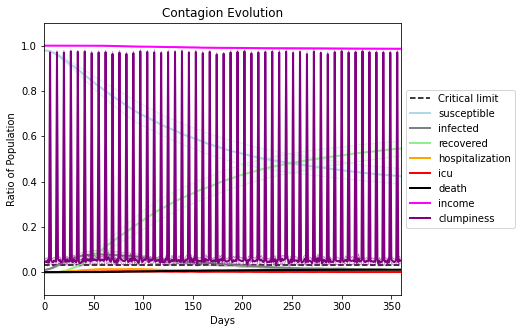

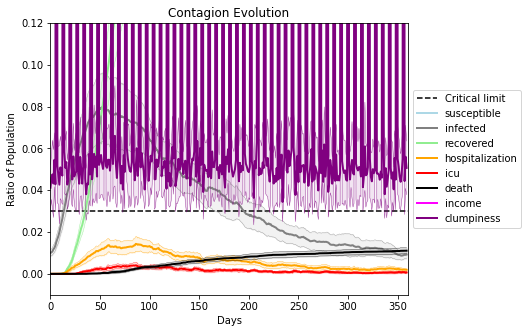

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2895, 1791, 1169, 3361, 1619, 4224, 5300, 5246, 8338, 8941, 5688, 7903, 9726, 5442, 6134, 9689, 5686, 744, 1190, 4839]
Average similarity between family members is 0.9517277576285537 at temperature -0.996
Average similarity between family and home is 0.9998577620720687 at temperature -1
Average similarity between students and their classroom is 0.6147004486648519 at temperature -0.996
Average classroom occupancy is 4.072463768115942 and number classrooms is 69
Average similarity between workers is 0.9410822552611217 at temperature -0.996
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.8506695260505028 for kids: 0.7021094412214303
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6287911930853289
avg restaurant similarity 0.6141207852800624
avg restaurant similarity 0.5822386373448485
avg restaurant similarity 0.6943864161672996
avg restaurant similarity 0.6247414851190282
avg restaurant similarity 0.6709647713763401
avg restaurant similarity 0.6181485681174569
avg restaurant similarity 0.5957803971742668
avg restaurant similarity 0.6366622221265397
avg restaurant similarity 0.613081894960417
avg restaurant similarity 0.5977966056581252
avg restaurant similarity 0.5791771485129613
avg restaurant similarity 0.6167264298505735
avg restaurant similarity 0.5902583405517535
avg restaurant similarity 0.5933220025936781
avg restaurant similarity 0.6102095825978464
avg restaurant similarity 0.5645437776072766
avg restaurant similarity 0.6301788920889767
avg restaurant similarity 0.6538319573598987
avg restaurant similarity 0.5771858929340336
avg restaurant similarity 0.6299026497763299
avg restaurant similarity 0.584956944264113
avg restaura

avg restaurant similarity 0.5762633081407355
avg restaurant similarity 0.6159459762581992
avg restaurant similarity 0.5665239182002632
avg restaurant similarity 0.5811404975879525
avg restaurant similarity 0.5945797877013829
avg restaurant similarity 0.5942316970405345
avg restaurant similarity 0.6237915509506899
avg restaurant similarity 0.586510199085797
avg restaurant similarity 0.5630667517234721
avg restaurant similarity 0.5833475098562793
avg restaurant similarity 0.6157161244711914
avg restaurant similarity 0.6446490613156475
avg restaurant similarity 0.5932822364747452
avg restaurant similarity 0.6171710910707648
avg restaurant similarity 0.632755346380339
avg restaurant similarity 0.5801318745006228
avg restaurant similarity 0.6701864106031451
avg restaurant similarity 0.5692753604615044
avg restaurant similarity 0.5658286018355213
avg restaurant similarity 0.5586573302930273
avg restaurant similarity 0.5924325384491833
avg restaurant similarity 0.6188140805455647
avg restaura

avg restaurant similarity 0.6508536215115172
avg restaurant similarity 0.5993610409506787
avg restaurant similarity 0.6570325335424423
avg restaurant similarity 0.6292245298677405
avg restaurant similarity 0.6594199654374273
avg restaurant similarity 0.6485269847107853
avg restaurant similarity 0.663385140834154
avg restaurant similarity 0.6485196561129783
avg restaurant similarity 0.6600657540375025
avg restaurant similarity 0.6122256604606321
avg restaurant similarity 0.6596143809659342
avg restaurant similarity 0.6795413787497281
avg restaurant similarity 0.6222533700446226
avg restaurant similarity 0.6376651924839061
avg restaurant similarity 0.6573270369352165
avg restaurant similarity 0.6607658111554646
avg restaurant similarity 0.6531828329348951
avg restaurant similarity 0.6214019897120926
avg restaurant similarity 0.6395131040950252
avg restaurant similarity 0.6410946714920904
avg restaurant similarity 0.6384338066299426
avg restaurant similarity 0.6290001273910011
avg restaur

avg restaurant similarity 0.708426190089041
avg restaurant similarity 0.6543987585019594
avg restaurant similarity 0.6179426325902221
avg restaurant similarity 0.6743419065173699
avg restaurant similarity 0.635525428300731
avg restaurant similarity 0.6600432904988359
avg restaurant similarity 0.627594626529403
avg restaurant similarity 0.656549473706215
avg restaurant similarity 0.6391665737161499
avg restaurant similarity 0.6542731297928742
avg restaurant similarity 0.6462857004315451
avg restaurant similarity 0.6205849772136737
avg restaurant similarity 0.6439881401369699
avg restaurant similarity 0.6977339825552331
avg restaurant similarity 0.6658578301009298
avg restaurant similarity 0.6601917438399262
avg restaurant similarity 0.6453647748238314
avg restaurant similarity 0.6496199173645528
avg restaurant similarity 0.6006898998475454
avg restaurant similarity 0.6289012860810447
avg restaurant similarity 0.6235329085133646
avg restaurant similarity 0.6593613527914709
avg restaurant

avg restaurant similarity 0.6206661466489765
avg restaurant similarity 0.6217277935783228
avg restaurant similarity 0.5665018136720545
avg restaurant similarity 0.6182628561185238
avg restaurant similarity 0.5926115254590971
avg restaurant similarity 0.5927940523009114
avg restaurant similarity 0.5793769775188726
avg restaurant similarity 0.6101235870293654
avg restaurant similarity 0.6162040278467137
avg restaurant similarity 0.5932865528894147
avg restaurant similarity 0.6219305384766789
avg restaurant similarity 0.599355968902014
avg restaurant similarity 0.5764452446876056
avg restaurant similarity 0.6137016169082987
avg restaurant similarity 0.5577179649407136
avg restaurant similarity 0.6214648956790049
avg restaurant similarity 0.5883062410148536
avg restaurant similarity 0.5678955279877216
avg restaurant similarity 0.6092098428777009
avg restaurant similarity 0.5949081252069639
avg restaurant similarity 0.6280449620611661
avg restaurant similarity 0.6124099316497347
avg restaur

avg restaurant similarity 0.5693119675231274
avg restaurant similarity 0.585971730746307
avg restaurant similarity 0.6091220779733072
avg restaurant similarity 0.6021377898705426
avg restaurant similarity 0.590468121455264
avg restaurant similarity 0.5961108438655918
avg restaurant similarity 0.5695406455283416
avg restaurant similarity 0.5315780113598942
avg restaurant similarity 0.5988973971114052
avg restaurant similarity 0.57849502885486
avg restaurant similarity 0.5887706280740995
avg restaurant similarity 0.6012519683246417
avg restaurant similarity 0.5652299505586807
avg restaurant similarity 0.563839101088243
avg restaurant similarity 0.626364604194009
avg restaurant similarity 0.5581298796123416
avg restaurant similarity 0.5644271093296307
avg restaurant similarity 0.5738201052121863
avg restaurant similarity 0.6112209421213862
avg restaurant similarity 0.566768099310103
avg restaurant similarity 0.6245106032890972
avg restaurant similarity 0.6130129135717621
avg restaurant si

avg restaurant similarity 0.6319242291216774
avg restaurant similarity 0.6180457956641505
avg restaurant similarity 0.6160874531160494
avg restaurant similarity 0.5947881681224875
avg restaurant similarity 0.6472893748290384
avg restaurant similarity 0.6338706975679398
avg restaurant similarity 0.6638468969489635
avg restaurant similarity 0.6422878885644815
avg restaurant similarity 0.6261583620910831
avg restaurant similarity 0.6733302153144016
avg restaurant similarity 0.6041243984914215
avg restaurant similarity 0.6289551807873371
avg restaurant similarity 0.6425297281345036
avg restaurant similarity 0.6057825172475039
avg restaurant similarity 0.6403707659573962
avg restaurant similarity 0.6103438329195972
avg restaurant similarity 0.6349143613126332
avg restaurant similarity 0.6220562383965337
avg restaurant similarity 0.6544873210365578
avg restaurant similarity 0.6289097112427245
avg restaurant similarity 0.5790937209368678
avg restaurant similarity 0.6522146087197076
avg restau

avg restaurant similarity 0.633148192247362
avg restaurant similarity 0.6195936019981718
avg restaurant similarity 0.5769749478894897
avg restaurant similarity 0.6024278277269184
avg restaurant similarity 0.6052642097324844
avg restaurant similarity 0.6308379592973041
avg restaurant similarity 0.5784971224569762
avg restaurant similarity 0.6510055203000066
avg restaurant similarity 0.5670319260638043
avg restaurant similarity 0.6622788185510274
avg restaurant similarity 0.6112456246867632
avg restaurant similarity 0.5959259756770393
avg restaurant similarity 0.623212240571231
avg restaurant similarity 0.5772828415017195
avg restaurant similarity 0.5763356105000401
avg restaurant similarity 0.5614370573925316
avg restaurant similarity 0.557414093090544
avg restaurant similarity 0.6425404474350142
avg restaurant similarity 0.6388802965918184
avg restaurant similarity 0.580869304839483
avg restaurant similarity 0.6243888628453114
avg restaurant similarity 0.6123091970790341
avg restaurant

avg restaurant similarity 0.6272753361592432
avg restaurant similarity 0.5686224052690565
avg restaurant similarity 0.6257987370864527
avg restaurant similarity 0.5587673877277298
avg restaurant similarity 0.6193928548299886
avg restaurant similarity 0.6373838301799841
avg restaurant similarity 0.6405649758469253
avg restaurant similarity 0.622224070134865
avg restaurant similarity 0.6194688055822355
avg restaurant similarity 0.6016865809543671
avg restaurant similarity 0.6299229441196958
avg restaurant similarity 0.6191064202105129
avg restaurant similarity 0.5907796378194455
avg restaurant similarity 0.6420292647041501
avg restaurant similarity 0.5905014840653129
avg restaurant similarity 0.6427329876568174
avg restaurant similarity 0.6446699584214953
avg restaurant similarity 0.6366885668999483
avg restaurant similarity 0.6302563325785266
avg restaurant similarity 0.5888870703928132
avg restaurant similarity 0.6255735596001496
avg restaurant similarity 0.5865999814563657
avg restaur

avg restaurant similarity 0.558126459328211
avg restaurant similarity 0.6470873564485804
avg restaurant similarity 0.5956961694395584
avg restaurant similarity 0.6157044187978746
avg restaurant similarity 0.6328244952938039
avg restaurant similarity 0.6239459690397072
avg restaurant similarity 0.6038495208866566
avg restaurant similarity 0.6038644131693907
avg restaurant similarity 0.637922177925602
avg restaurant similarity 0.607065007881582
avg restaurant similarity 0.6445651125522823
avg restaurant similarity 0.6200203685928859
avg restaurant similarity 0.6249138695221441
avg restaurant similarity 0.575435012729646
avg restaurant similarity 0.5996678385224463
avg restaurant similarity 0.5869000098538845
avg restaurant similarity 0.6323390637964458
avg restaurant similarity 0.6080884771222104
avg restaurant similarity 0.6130428831892206
avg restaurant similarity 0.6444833238514294
avg restaurant similarity 0.5860637913985686
avg restaurant similarity 0.6496065039345935
avg restaurant

avg restaurant similarity 0.5649377753641627
avg restaurant similarity 0.6379165975995964
avg restaurant similarity 0.6261749378763249
avg restaurant similarity 0.6191419959390577
avg restaurant similarity 0.6050088830692881
avg restaurant similarity 0.6415411928095168
avg restaurant similarity 0.5752994865021515
avg restaurant similarity 0.6241287982465695
avg restaurant similarity 0.5799913565551874
avg restaurant similarity 0.6064859992076709
avg restaurant similarity 0.6300517746562335
avg restaurant similarity 0.6195425176933941
avg restaurant similarity 0.5822997762858904
avg restaurant similarity 0.6455879046324008
avg restaurant similarity 0.5922101750865402
avg restaurant similarity 0.5873886468995154
avg restaurant similarity 0.6044760708355127
avg restaurant similarity 0.6004223057614471
avg restaurant similarity 0.6052574057177011
avg restaurant similarity 0.6482630493155763
avg restaurant similarity 0.6298914188975097
avg restaurant similarity 0.6022791253143569
avg restau

avg restaurant similarity 0.6082015963049359
avg restaurant similarity 0.6373148482127688
avg restaurant similarity 0.6050830925857579
avg restaurant similarity 0.6023181422651698
avg restaurant similarity 0.6585159987002183
avg restaurant similarity 0.5856154317627082
avg restaurant similarity 0.6072128464925317
avg restaurant similarity 0.6192889478101489
avg restaurant similarity 0.6135422952817128
avg restaurant similarity 0.5968304734774627
avg restaurant similarity 0.6303136225865891
avg restaurant similarity 0.6424181147033731
avg restaurant similarity 0.6486950199472611
avg restaurant similarity 0.5908016238020208
avg restaurant similarity 0.6576427574377639
avg restaurant similarity 0.6261511702924616
avg restaurant similarity 0.6148476154460389
avg restaurant similarity 0.6257898212195709
avg restaurant similarity 0.5731043880288256
avg restaurant similarity 0.5688984896171345
avg restaurant similarity 0.6436742452571387
avg restaurant similarity 0.5844483184284547
avg restau

avg restaurant similarity 0.6855899795053366
avg restaurant similarity 0.6889868939227346
avg restaurant similarity 0.6125331403459645
avg restaurant similarity 0.636433868265954
avg restaurant similarity 0.6626862219082966
avg restaurant similarity 0.6641124205724522
avg restaurant similarity 0.6803351147273661
avg restaurant similarity 0.6315166413720803
avg restaurant similarity 0.615029896438822
avg restaurant similarity 0.6524770038792446
avg restaurant similarity 0.6431719853622043
avg restaurant similarity 0.6691601730071688
avg restaurant similarity 0.6062310362848133
avg restaurant similarity 0.6443083076622022
avg restaurant similarity 0.6428409073593434
avg restaurant similarity 0.612245692194121
avg restaurant similarity 0.6557679399434373
avg restaurant similarity 0.5782875392439082
avg restaurant similarity 0.6270897143654667
avg restaurant similarity 0.6172860794255652
avg restaurant similarity 0.6385533431700233
avg restaurant similarity 0.6178862416882398
avg restauran

avg restaurant similarity 0.6714163281080834
avg restaurant similarity 0.6806518632962303
avg restaurant similarity 0.607262294382582
avg restaurant similarity 0.576870508026709
avg restaurant similarity 0.6088836397392138
avg restaurant similarity 0.5877221884993231
avg restaurant similarity 0.5384950595765091
avg restaurant similarity 0.5999767733400481
avg restaurant similarity 0.6391844904189372
avg restaurant similarity 0.6646398646048904
avg restaurant similarity 0.6451178209954392
avg restaurant similarity 0.6445269806983414
avg restaurant similarity 0.6584266632534146
avg restaurant similarity 0.6456688502791714
avg restaurant similarity 0.6279181095284136
avg restaurant similarity 0.5899448532397334
avg restaurant similarity 0.6920788254106033
avg restaurant similarity 0.5966849711364818
avg restaurant similarity 0.6459446239744653
avg restaurant similarity 0.5695819980062309
avg restaurant similarity 0.6704896508544315
avg restaurant similarity 0.6046546533447288
avg restaura

avg restaurant similarity 0.6432658995388622
avg restaurant similarity 0.6308496356391938
avg restaurant similarity 0.5918521632006368
avg restaurant similarity 0.5785124310502943
avg restaurant similarity 0.6280847606144618
avg restaurant similarity 0.6050321051302663
avg restaurant similarity 0.5681482378521241
avg restaurant similarity 0.552670698225784
avg restaurant similarity 0.5784451627887811
avg restaurant similarity 0.6118482755498048
avg restaurant similarity 0.5654578847489067
avg restaurant similarity 0.5512892326161503
avg restaurant similarity 0.5461449163787574
avg restaurant similarity 0.6057099805410782
avg restaurant similarity 0.6088939594877263
avg restaurant similarity 0.5803493063387591
avg restaurant similarity 0.5631916091530178
avg restaurant similarity 0.5703453916597099
avg restaurant similarity 0.5894993869932156
avg restaurant similarity 0.5465071841815441
avg restaurant similarity 0.5562669003501483
avg restaurant similarity 0.6299608715102167
avg restaur

avg restaurant similarity 0.5979649795486973
avg restaurant similarity 0.6279606114610451
avg restaurant similarity 0.6165239303805642
avg restaurant similarity 0.5643087041409389
avg restaurant similarity 0.5754648464174
avg restaurant similarity 0.6512470226046233
avg restaurant similarity 0.5783809248782719
avg restaurant similarity 0.6245631709813189
avg restaurant similarity 0.5400983800527634
avg restaurant similarity 0.5952747385156656
avg restaurant similarity 0.6450422735074329
avg restaurant similarity 0.6166813658126536
avg restaurant similarity 0.5927464874077514
avg restaurant similarity 0.596807708235833
avg restaurant similarity 0.6001370982171944
avg restaurant similarity 0.5961905253994718
avg restaurant similarity 0.5881130497663429
avg restaurant similarity 0.6098048119913124
avg restaurant similarity 0.5691181749895752
avg restaurant similarity 0.5589748758662002
avg restaurant similarity 0.5933243886910962
avg restaurant similarity 0.6224691092608268
avg restaurant

avg restaurant similarity 0.608788637791424
avg restaurant similarity 0.6575051415249784
avg restaurant similarity 0.6508755105314079
avg restaurant similarity 0.6389542729010367
avg restaurant similarity 0.6476727582612295
avg restaurant similarity 0.654830700832767
avg restaurant similarity 0.6534361832810998
avg restaurant similarity 0.5997468635081615
avg restaurant similarity 0.6661240378419492
avg restaurant similarity 0.6561572082961902
avg restaurant similarity 0.6643740076804295
avg restaurant similarity 0.6486547639082914
avg restaurant similarity 0.6366741605513839
avg restaurant similarity 0.6205786481224962
avg restaurant similarity 0.6030913192312601
avg restaurant similarity 0.5872150336690244
avg restaurant similarity 0.6208507777005841
avg restaurant similarity 0.6378803069932052
avg restaurant similarity 0.6389763894984978
avg restaurant similarity 0.583434220210777
avg restaurant similarity 0.7093253902860396
avg restaurant similarity 0.6343430359557953
avg restauran

avg restaurant similarity 0.5910376103679958
avg restaurant similarity 0.5989882694646702
avg restaurant similarity 0.588648389802603
avg restaurant similarity 0.6213810383195185
avg restaurant similarity 0.5652738572501285
avg restaurant similarity 0.6496575858353478
avg restaurant similarity 0.6386170157414086
avg restaurant similarity 0.6292572800144519
avg restaurant similarity 0.5916095672637055
avg restaurant similarity 0.6058945039465902
avg restaurant similarity 0.6261959951802438
avg restaurant similarity 0.6077671475113202
avg restaurant similarity 0.6515644804770535
avg restaurant similarity 0.5941091593637322
avg restaurant similarity 0.601575739864366
avg restaurant similarity 0.585501843211985
avg restaurant similarity 0.604738076270116
avg restaurant similarity 0.6434113354973882
avg restaurant similarity 0.6096516256459813
avg restaurant similarity 0.6156207804228674
avg restaurant similarity 0.5919261427664735
avg restaurant similarity 0.63148163029827
avg restaurant s

avg restaurant similarity 0.6301797919496911
avg restaurant similarity 0.6157214113271423
avg restaurant similarity 0.6167194153522583
avg restaurant similarity 0.6470777806802391
avg restaurant similarity 0.6419283272699148
avg restaurant similarity 0.6495003701624303
avg restaurant similarity 0.6295482669533352
avg restaurant similarity 0.6019606898083054
avg restaurant similarity 0.6348175362076778
avg restaurant similarity 0.6572575375481476
avg restaurant similarity 0.6246577790340212
avg restaurant similarity 0.6380847303392383
avg restaurant similarity 0.670908458726766
avg restaurant similarity 0.5947426810120623
avg restaurant similarity 0.6217631467361808
avg restaurant similarity 0.6900063624464153
avg restaurant similarity 0.640946813473137
avg restaurant similarity 0.6681546738084247
avg restaurant similarity 0.6377411405424032
avg restaurant similarity 0.6437032428157015
avg restaurant similarity 0.6304920224920019
avg restaurant similarity 0.6387351023546681
avg restaura

avg restaurant similarity 0.660545625842809
avg restaurant similarity 0.5997413945880321
avg restaurant similarity 0.688146292442319
avg restaurant similarity 0.6352839856331752
avg restaurant similarity 0.625313322161037
avg restaurant similarity 0.6592107328643582
avg restaurant similarity 0.6643937316330446
avg restaurant similarity 0.620101131517823
avg restaurant similarity 0.6511318347455418
avg restaurant similarity 0.6574838982988546
avg restaurant similarity 0.6360547244067476
avg restaurant similarity 0.6016705176929406
avg restaurant similarity 0.6141659525187297
avg restaurant similarity 0.653314174346501
avg restaurant similarity 0.6380428057224473
avg restaurant similarity 0.6557418166912694
avg restaurant similarity 0.6174955692576239
avg restaurant similarity 0.635290872539317
avg restaurant similarity 0.6846356438792137
avg restaurant similarity 0.6272340044597549
avg restaurant similarity 0.6474821250459097
avg restaurant similarity 0.6329078218246026
avg restaurant s

avg restaurant similarity 0.6189741377588189
avg restaurant similarity 0.6427916123034444
avg restaurant similarity 0.6422566904052641
avg restaurant similarity 0.630988726132988
avg restaurant similarity 0.6494440376393806
avg restaurant similarity 0.6673815456451283
avg restaurant similarity 0.633105990060339
avg restaurant similarity 0.6462753807682607
avg restaurant similarity 0.7047666888380031
avg restaurant similarity 0.6450037962131566
avg restaurant similarity 0.7033494273632428
avg restaurant similarity 0.6683564401936357
avg restaurant similarity 0.6396172391305258
avg restaurant similarity 0.6149865431741435
avg restaurant similarity 0.6489988437858071
avg restaurant similarity 0.6943435215429861
avg restaurant similarity 0.5819221170295474
avg restaurant similarity 0.7258290024947154
avg restaurant similarity 0.6789316590911249
avg restaurant similarity 0.6420887542906372
avg restaurant similarity 0.6428936909065774
avg restaurant similarity 0.6924281723389589
avg restaura

avg restaurant similarity 0.6491498341353265
avg restaurant similarity 0.6867772171787516
avg restaurant similarity 0.6485495605178405
avg restaurant similarity 0.6593093029587186
avg restaurant similarity 0.6128903570898959
avg restaurant similarity 0.6474742446174128
avg restaurant similarity 0.6520639001888102
avg restaurant similarity 0.6347253259047146
avg restaurant similarity 0.637283897963002
avg restaurant similarity 0.6198249838206087
avg restaurant similarity 0.6167655542887709
avg restaurant similarity 0.5677982123842408
avg restaurant similarity 0.6647124918524131
avg restaurant similarity 0.6235097140225098
avg restaurant similarity 0.5983751411406164
avg restaurant similarity 0.5960760580399185
avg restaurant similarity 0.640245560472603
avg restaurant similarity 0.6367365238621074
avg restaurant similarity 0.6622036127200509
avg restaurant similarity 0.6182364846924849
avg restaurant similarity 0.6105242413042151
avg restaurant similarity 0.6420493348301022
avg restaura

avg restaurant similarity 0.6491331818989766
avg restaurant similarity 0.6538642741554732
avg restaurant similarity 0.6559026108567759
avg restaurant similarity 0.600503374109758
avg restaurant similarity 0.6504639325334436
avg restaurant similarity 0.5994812780661354
avg restaurant similarity 0.6041113007492004
avg restaurant similarity 0.6311977569126722
avg restaurant similarity 0.5964104465713833
avg restaurant similarity 0.6179581725558095
avg restaurant similarity 0.6304613877339211
avg restaurant similarity 0.6234077818383655
avg restaurant similarity 0.6416610324329821
avg restaurant similarity 0.6054452477137102
avg restaurant similarity 0.6126392903304837
avg restaurant similarity 0.6814320612597328
avg restaurant similarity 0.6393106054637561
avg restaurant similarity 0.6523295743343744
avg restaurant similarity 0.6413098925118
avg restaurant similarity 0.6125313590470383
avg restaurant similarity 0.6039125681540963
avg restaurant similarity 0.5928923630379391
avg restaurant

avg restaurant similarity 0.6673461087912907
avg restaurant similarity 0.6479334636740259
avg restaurant similarity 0.5838459578391626
avg restaurant similarity 0.6239058232640445
avg restaurant similarity 0.6477661114120489
avg restaurant similarity 0.5567845547685351
avg restaurant similarity 0.5976230984864074
avg restaurant similarity 0.6272964377199601
avg restaurant similarity 0.6924902092497032
avg restaurant similarity 0.7138929080617089
avg restaurant similarity 0.5743240979724153
avg restaurant similarity 0.6213000013841332
avg restaurant similarity 0.5869317140427456
avg restaurant similarity 0.6723436559230208
avg restaurant similarity 0.6241428343211423
avg restaurant similarity 0.5758618855126586
avg restaurant similarity 0.648068015251863
avg restaurant similarity 0.6460701173077559
avg restaurant similarity 0.5650806228419789
avg restaurant similarity 0.5800095855619971
avg restaurant similarity 0.5898693800463146
avg restaurant similarity 0.6361156835308234
avg restaur

avg restaurant similarity 0.6378548877475447
avg restaurant similarity 0.6052848455096702
avg restaurant similarity 0.6061327129033782
avg restaurant similarity 0.6100907597086119
avg restaurant similarity 0.5363156913166908
avg restaurant similarity 0.5692029722802376
avg restaurant similarity 0.5983582101221226
avg restaurant similarity 0.5643324279528518
avg restaurant similarity 0.6208433956136588
avg restaurant similarity 0.6376732385344278
avg restaurant similarity 0.6720046902785459
avg restaurant similarity 0.6121583875409963
avg restaurant similarity 0.6475802354458379
avg restaurant similarity 0.599469290053211
avg restaurant similarity 0.5598653852772818
avg restaurant similarity 0.5706080597095005
avg restaurant similarity 0.6720776309796711
avg restaurant similarity 0.5930400458698699
avg restaurant similarity 0.6518369312220329
avg restaurant similarity 0.6761376516454081
avg restaurant similarity 0.5860459356221652
avg restaurant similarity 0.6482854501395147
avg restaur

avg restaurant similarity 0.651286771811921
avg restaurant similarity 0.6440131523071994
avg restaurant similarity 0.6350504213322645
avg restaurant similarity 0.6095864504283802
avg restaurant similarity 0.5619675156528229
avg restaurant similarity 0.5914744025764678
avg restaurant similarity 0.6383319200689137
avg restaurant similarity 0.6097057542453248
avg restaurant similarity 0.6277369465009996
avg restaurant similarity 0.630608050873538
avg restaurant similarity 0.5796846823097699
avg restaurant similarity 0.6336328605253028
avg restaurant similarity 0.6874405765376387
avg restaurant similarity 0.5785840247573474
avg restaurant similarity 0.6108392660968823
avg restaurant similarity 0.6532945105234854
avg restaurant similarity 0.6315640447653253
avg restaurant similarity 0.5929354338822759
avg restaurant similarity 0.655166597488407
avg restaurant similarity 0.5618885759552947
avg restaurant similarity 0.7091337040079672
avg restaurant similarity 0.5673486569914712
avg restauran

avg restaurant similarity 0.6296914425589388
avg restaurant similarity 0.5415986209732079
avg restaurant similarity 0.603463255998077
avg restaurant similarity 0.6740510885977365
avg restaurant similarity 0.5945583713904755
avg restaurant similarity 0.6298893521824394
avg restaurant similarity 0.5472930144980472
avg restaurant similarity 0.6206429904706261
avg restaurant similarity 0.6564202995288405
avg restaurant similarity 0.6272915781944773
avg restaurant similarity 0.6739800211944024
avg restaurant similarity 0.599827314506851
avg restaurant similarity 0.6641467249577298
avg restaurant similarity 0.5991011022740584
avg restaurant similarity 0.6277121892287305
avg restaurant similarity 0.6708382586400236
avg restaurant similarity 0.6270868931988869
avg restaurant similarity 0.6248117836170487
avg restaurant similarity 0.6486770860415195
avg restaurant similarity 0.6507424239686089
avg restaurant similarity 0.6701949934899707
avg restaurant similarity 0.540050594106164
avg restauran

avg restaurant similarity 0.6154332925950874
avg restaurant similarity 0.6721126441022139
avg restaurant similarity 0.6259494295439817
avg restaurant similarity 0.6172972872742759
avg restaurant similarity 0.6229197696006898
avg restaurant similarity 0.5511189966444213
avg restaurant similarity 0.636901886195917
avg restaurant similarity 0.7159905356245497
avg restaurant similarity 0.6450148852715252
avg restaurant similarity 0.5619273142031729
avg restaurant similarity 0.6440562922756662
avg restaurant similarity 0.6288251112173583
avg restaurant similarity 0.6276115331117341
avg restaurant similarity 0.6467129510660765
avg restaurant similarity 0.63675608380632
avg restaurant similarity 0.5971180342245754
avg restaurant similarity 0.5926058579733863
avg restaurant similarity 0.6121192209714296
avg restaurant similarity 0.6419830045722834
avg restaurant similarity 0.6428303586705362
avg restaurant similarity 0.6555470437291276
avg restaurant similarity 0.6945369411982084
avg restauran

avg restaurant similarity 0.6402055111462941
avg restaurant similarity 0.5750717275838311
avg restaurant similarity 0.6014081832531699
avg restaurant similarity 0.6503387440720142
avg restaurant similarity 0.6622892406806842
avg restaurant similarity 0.729516290895515
avg restaurant similarity 0.5962243154617459
avg restaurant similarity 0.6827467782276841
avg restaurant similarity 0.6083663691381815
avg restaurant similarity 0.6118352537115996
avg restaurant similarity 0.6406699527751221
avg restaurant similarity 0.597339437588928
avg restaurant similarity 0.6182815317336654
avg restaurant similarity 0.6602942585920901
avg restaurant similarity 0.6281758366463559
avg restaurant similarity 0.5691886709044155
avg restaurant similarity 0.6219616888292878
avg restaurant similarity 0.6668409127955633
avg restaurant similarity 0.664391178097696
avg restaurant similarity 0.6653015344207163
avg restaurant similarity 0.5994875378034299
avg restaurant similarity 0.6101089854763175
avg restauran

avg restaurant similarity 0.6458051607312262
avg restaurant similarity 0.6467317594125467
avg restaurant similarity 0.609458506792308
avg restaurant similarity 0.6662528343765024
avg restaurant similarity 0.6659281659056653
avg restaurant similarity 0.6375501739470505
avg restaurant similarity 0.6271071066335988
avg restaurant similarity 0.6469857277253933
avg restaurant similarity 0.6469621694780143
avg restaurant similarity 0.6177976150334887
avg restaurant similarity 0.6103173761658759
avg restaurant similarity 0.6290939212128805
avg restaurant similarity 0.6274494979327893
avg restaurant similarity 0.587961879926928
avg restaurant similarity 0.6610168496227746
avg restaurant similarity 0.6513826981904848
avg restaurant similarity 0.6128460183079784
avg restaurant similarity 0.6855716538688027
avg restaurant similarity 0.6112779144533929
avg restaurant similarity 0.6515576474395087
avg restaurant similarity 0.5802292075584972
avg restaurant similarity 0.6242872274645417
avg restaura

avg restaurant similarity 0.6320006504012929
avg restaurant similarity 0.6105233029830817
avg restaurant similarity 0.5864236021743253
avg restaurant similarity 0.6064719672431095
avg restaurant similarity 0.5821972719100038
avg restaurant similarity 0.5670605417132271
avg restaurant similarity 0.5837608005934675
avg restaurant similarity 0.6269593573789914
avg restaurant similarity 0.5925949568388377
avg restaurant similarity 0.601479781160111
avg restaurant similarity 0.6271964653836781
avg restaurant similarity 0.6259628106360122
avg restaurant similarity 0.6008852751453521
avg restaurant similarity 0.6345033009514888
avg restaurant similarity 0.5966991640304106
avg restaurant similarity 0.5877853976244662
avg restaurant similarity 0.6028963541289217
avg restaurant similarity 0.586748643041515
avg restaurant similarity 0.6059708507323974
avg restaurant similarity 0.6099742796666956
avg restaurant similarity 0.6176475158552253
avg restaurant similarity 0.6463905872462713
avg restaura

avg restaurant similarity 0.5556907204792012
avg restaurant similarity 0.5788433697247777
avg restaurant similarity 0.5694916714339605
avg restaurant similarity 0.5903487620883642
avg restaurant similarity 0.6141435822568674
avg restaurant similarity 0.5841823853927582
avg restaurant similarity 0.5866471891066807
avg restaurant similarity 0.5902898791265315
avg restaurant similarity 0.597706918173908
avg restaurant similarity 0.583082996033298
avg restaurant similarity 0.5815393285706921
avg restaurant similarity 0.5790534999074727
avg restaurant similarity 0.5677098756954367
avg restaurant similarity 0.6103902204024895
avg restaurant similarity 0.5663473214289495
avg restaurant similarity 0.5748150046654368
avg restaurant similarity 0.5857800620905678
avg restaurant similarity 0.5659435169224966
avg restaurant similarity 0.6109651818276388
avg restaurant similarity 0.5798381111294241
avg restaurant similarity 0.5374705336425569
avg restaurant similarity 0.5876943576292304
avg restaura

avg restaurant similarity 0.6237537734012762
avg restaurant similarity 0.6319230477192934
avg restaurant similarity 0.617170195056249
avg restaurant similarity 0.5818946433722754
avg restaurant similarity 0.6463777505808731
avg restaurant similarity 0.6037682398858707
avg restaurant similarity 0.6096573685428458
avg restaurant similarity 0.6191323520313627
avg restaurant similarity 0.6274302293897074
avg restaurant similarity 0.6522379266852578
avg restaurant similarity 0.6341629735778491
avg restaurant similarity 0.6367009166287251
avg restaurant similarity 0.596019660114529
avg restaurant similarity 0.6084046938311849
avg restaurant similarity 0.6181216576003098
avg restaurant similarity 0.5768980026308705
avg restaurant similarity 0.5870835979052047
avg restaurant similarity 0.6121155153502804
avg restaurant similarity 0.5962645853732922
avg restaurant similarity 0.6177381367881078
avg restaurant similarity 0.6006699075013103
avg restaurant similarity 0.5955689851386747
avg restaura

avg restaurant similarity 0.5739641530825463
avg restaurant similarity 0.5997798329251187
avg restaurant similarity 0.6251872179586179
avg restaurant similarity 0.6850704880739555
avg restaurant similarity 0.6096894487018781
avg restaurant similarity 0.6266109071714757
avg restaurant similarity 0.6035904507966336
avg restaurant similarity 0.6397439442833006
avg restaurant similarity 0.5798126845680994
avg restaurant similarity 0.625139313833906
avg restaurant similarity 0.6085430073229364
avg restaurant similarity 0.5981895710070598
avg restaurant similarity 0.6407605202759853
avg restaurant similarity 0.6103121190650225
avg restaurant similarity 0.6074305017684971
avg restaurant similarity 0.6345526948791825
avg restaurant similarity 0.6407032901974758
avg restaurant similarity 0.6404276079980823
avg restaurant similarity 0.6498834030561488
avg restaurant similarity 0.6261941705984889
avg restaurant similarity 0.6342724920881151
avg restaurant similarity 0.6076238298214044
avg restaur

avg restaurant similarity 0.6457041972225003
avg restaurant similarity 0.5914924194952949
avg restaurant similarity 0.5835548203909894
avg restaurant similarity 0.6392586986278745
avg restaurant similarity 0.6477738779630179
avg restaurant similarity 0.6213045749774764
avg restaurant similarity 0.6092419753051009
avg restaurant similarity 0.6176693237257807
avg restaurant similarity 0.6114733957563069
avg restaurant similarity 0.6500144753765452
avg restaurant similarity 0.5854843844860316
avg restaurant similarity 0.6078639252039302
avg restaurant similarity 0.6370617198037021
avg restaurant similarity 0.6412583129186974
avg restaurant similarity 0.5928708516957586
avg restaurant similarity 0.6765434266066502
avg restaurant similarity 0.6714739217689396
avg restaurant similarity 0.6689556107313062
avg restaurant similarity 0.663977506881825
avg restaurant similarity 0.5638056002406501
avg restaurant similarity 0.6814577422872201
avg restaurant similarity 0.6753529535147722
avg restaur

avg restaurant similarity 0.6129475758775496
avg restaurant similarity 0.592919701446221
avg restaurant similarity 0.6174107528661404
avg restaurant similarity 0.5681909915161808
avg restaurant similarity 0.6397723627084021
avg restaurant similarity 0.6474707347723332
avg restaurant similarity 0.6298453321539952
avg restaurant similarity 0.6354226379164659
avg restaurant similarity 0.590524806374624
avg restaurant similarity 0.6526468783088225
avg restaurant similarity 0.6380697111256471
avg restaurant similarity 0.5728031314227011
avg restaurant similarity 0.5916107077299902
avg restaurant similarity 0.6538683187598622
avg restaurant similarity 0.5793805792895476
avg restaurant similarity 0.6145262895987278
avg restaurant similarity 0.586086557260033
avg restaurant similarity 0.6321147948228046
avg restaurant similarity 0.625509438879296
avg restaurant similarity 0.6212934732548737
avg restaurant similarity 0.6201618341581971
avg restaurant similarity 0.5536236552696505
avg restaurant

avg restaurant similarity 0.6293514765542649
avg restaurant similarity 0.6333449966229434
avg restaurant similarity 0.6060302675775275
avg restaurant similarity 0.5822981437686064
avg restaurant similarity 0.6315254448099623
avg restaurant similarity 0.6067603990906832
avg restaurant similarity 0.5917594001031623
avg restaurant similarity 0.5901732579520674
avg restaurant similarity 0.5903847223534678
avg restaurant similarity 0.5917424792635966
avg restaurant similarity 0.5706995532873098
avg restaurant similarity 0.5671490341495705
avg restaurant similarity 0.609942642771068
avg restaurant similarity 0.5464685710252716
avg restaurant similarity 0.645642459783885
avg restaurant similarity 0.5458439412026168
avg restaurant similarity 0.5897802235528385
avg restaurant similarity 0.6279794398149101
avg restaurant similarity 0.6062394739472828
avg restaurant similarity 0.5980572952676529
avg restaurant similarity 0.5754560950704022
avg restaurant similarity 0.6382705314403211
avg restaura

avg restaurant similarity 0.582335132017057
avg restaurant similarity 0.5777789027317901
avg restaurant similarity 0.5964927488705106
avg restaurant similarity 0.5553028410332105
avg restaurant similarity 0.5641499068706164
avg restaurant similarity 0.567434655517555
avg restaurant similarity 0.5764997870000916
avg restaurant similarity 0.5450534921708304
avg restaurant similarity 0.5971830714072998
avg restaurant similarity 0.5996527017198865
avg restaurant similarity 0.5412685801288749
avg restaurant similarity 0.5804961214201048
avg restaurant similarity 0.5323827498414255
avg restaurant similarity 0.574528516073872
avg restaurant similarity 0.6315345423369514
avg restaurant similarity 0.5743646037419575
avg restaurant similarity 0.5737358141815562
avg restaurant similarity 0.6183000420248338
avg restaurant similarity 0.5454390164218527
avg restaurant similarity 0.5623889220967372
avg restaurant similarity 0.567145662625128
avg restaurant similarity 0.6240721636386725
avg restaurant

avg restaurant similarity 0.6105053418615318
avg restaurant similarity 0.6385091295640325
avg restaurant similarity 0.633819801673692
avg restaurant similarity 0.6152618296044583
avg restaurant similarity 0.6261998909530446
avg restaurant similarity 0.6340562755125264
avg restaurant similarity 0.6153315117256815
avg restaurant similarity 0.5998797664095971
avg restaurant similarity 0.6046173581177553
avg restaurant similarity 0.5962548906692432
avg restaurant similarity 0.6427396862869652
avg restaurant similarity 0.604972782415774
avg restaurant similarity 0.6601121338822743
avg restaurant similarity 0.6264065267445029
avg restaurant similarity 0.6177129708920158
avg restaurant similarity 0.6043435392205291
avg restaurant similarity 0.5547722775195221
avg restaurant similarity 0.611173463709099
avg restaurant similarity 0.6031059939191519
avg restaurant similarity 0.588138339007256
avg restaurant similarity 0.5867689533265672
avg restaurant similarity 0.5695276486681108
avg restaurant

avg restaurant similarity 0.5587819719839004
avg restaurant similarity 0.6043528335950898
avg restaurant similarity 0.6090065144997397
avg restaurant similarity 0.561469019384301
avg restaurant similarity 0.5973559544349357
avg restaurant similarity 0.5893636809277933
avg restaurant similarity 0.5830921043893389
avg restaurant similarity 0.6325017840906507
avg restaurant similarity 0.5726409703059728
avg restaurant similarity 0.6104039899924414
avg restaurant similarity 0.5729327424405959
avg restaurant similarity 0.5974302891251463
avg restaurant similarity 0.6620065111179613
avg restaurant similarity 0.6109090359562264
avg restaurant similarity 0.5995758553031633
avg restaurant similarity 0.5775075819582495
avg restaurant similarity 0.5939085638328581
avg restaurant similarity 0.6496247360548247
avg restaurant similarity 0.6276789724825366
avg restaurant similarity 0.6161002271700076
avg restaurant similarity 0.6310661648403595
avg restaurant similarity 0.6164951872982337
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

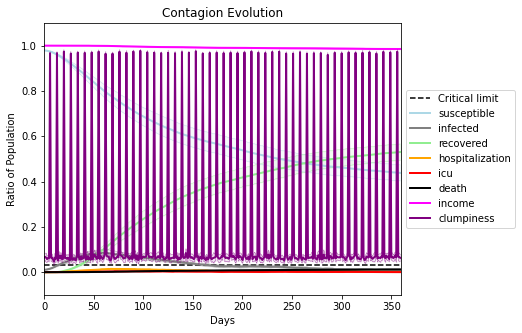

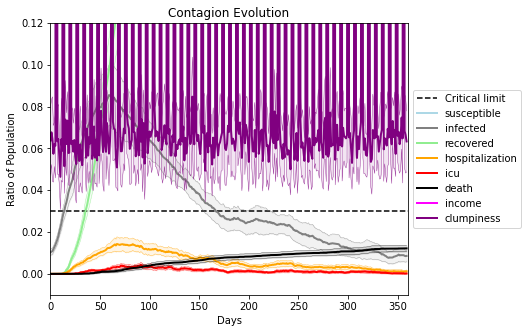

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6784, 9754, 1710, 3071, 8245, 5547, 5000, 25, 4623, 7764, 9593, 7785, 8738, 5566, 4007, 2768, 2480, 3778, 9511, 1857]
Average similarity between family members is 0.9383312363208844 at temperature -0.995
Average similarity between family and home is 0.9998592835060808 at temperature -1
Average similarity between students and their classroom is 0.5835999340014462 at temperature -0.995
Average classroom occupancy is 4.128571428571429 and number classrooms is 70
Average similarity between workers is 0.8918629923114386 at temperature -0.995
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.8508661789900055 for kids: 0.6867618421970955
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5590112152878534
avg restaurant similarity 0.5274139950947084
avg restaurant similarity 0.5561233828229672
avg restaurant similarity 0.6313910885481016
avg restaurant similarity 0.5371734809322918
avg restaurant similarity 0.6519281944583786
avg restaurant similarity 0.5985959394731123
avg restaurant similarity 0.5409984614709735
avg restaurant similarity 0.5777669425665825
avg restaurant similarity 0.5274203210609064
avg restaurant similarity 0.5750675597780195
avg restaurant similarity 0.580337184099976
avg restaurant similarity 0.5470653026241351
avg restaurant similarity 0.5940490750968518
avg restaurant similarity 0.606309417427345
avg restaurant similarity 0.5424620939375873
avg restaurant similarity 0.5284173675318965
avg restaurant similarity 0.6076281740141427
avg restaurant similarity 0.526522188929349
avg restaurant similarity 0.5371876534513266
avg restaurant similarity 0.47660561262358964
avg restaurant similarity 0.5583038081485604
avg restaura

avg restaurant similarity 0.6165068876988047
avg restaurant similarity 0.5334983586850575
avg restaurant similarity 0.57469308906182
avg restaurant similarity 0.5216066202345876
avg restaurant similarity 0.573679219347549
avg restaurant similarity 0.5158029025400707
avg restaurant similarity 0.5398864606567312
avg restaurant similarity 0.5777520876595537
avg restaurant similarity 0.5486233936854568
avg restaurant similarity 0.5735340201179159
avg restaurant similarity 0.5493197291965342
avg restaurant similarity 0.5924651270185541
avg restaurant similarity 0.5478144832641785
avg restaurant similarity 0.5444551877278873
avg restaurant similarity 0.5587355842933422
avg restaurant similarity 0.5137792359369087
avg restaurant similarity 0.5536039144496424
avg restaurant similarity 0.5436481400648625
avg restaurant similarity 0.5776870134034355
avg restaurant similarity 0.5389012263044128
avg restaurant similarity 0.5470925542096486
avg restaurant similarity 0.5539352888856252
avg restauran

avg restaurant similarity 0.5733433658605714
avg restaurant similarity 0.5592855149669292
avg restaurant similarity 0.5782916488020718
avg restaurant similarity 0.5772442270363508
avg restaurant similarity 0.619414611948523
avg restaurant similarity 0.6300699329947964
avg restaurant similarity 0.5803885779627118
avg restaurant similarity 0.5939113366039119
avg restaurant similarity 0.6244750684465448
avg restaurant similarity 0.5717782249777557
avg restaurant similarity 0.5970504896284918
avg restaurant similarity 0.6072138050792552
avg restaurant similarity 0.5734766329808727
avg restaurant similarity 0.5942350189500135
avg restaurant similarity 0.5872373150062705
avg restaurant similarity 0.5798764659865997
avg restaurant similarity 0.5907053497811063
avg restaurant similarity 0.582896898112319
avg restaurant similarity 0.6008863285525546
avg restaurant similarity 0.6056292400208794
avg restaurant similarity 0.5437409854694656
avg restaurant similarity 0.5799648531345919
avg restaura

avg restaurant similarity 0.6996242261614065
avg restaurant similarity 0.6221318356796598
avg restaurant similarity 0.5510080103122837
avg restaurant similarity 0.5866831260717461
avg restaurant similarity 0.5602179221914011
avg restaurant similarity 0.6182543861001578
avg restaurant similarity 0.6524355946878425
avg restaurant similarity 0.5766721578101942
avg restaurant similarity 0.5515298637864752
avg restaurant similarity 0.601801044206481
avg restaurant similarity 0.5564249653126195
avg restaurant similarity 0.5701402239658254
avg restaurant similarity 0.5825969892086891
avg restaurant similarity 0.5636669856917077
avg restaurant similarity 0.6004718724410006
avg restaurant similarity 0.610593301679984
avg restaurant similarity 0.5667526272082818
avg restaurant similarity 0.607230407588546
avg restaurant similarity 0.614353750494352
avg restaurant similarity 0.6011224041525196
avg restaurant similarity 0.5754842198723451
avg restaurant similarity 0.5540438290869651
avg restaurant

avg restaurant similarity 0.6152816945362888
avg restaurant similarity 0.5788591010337368
avg restaurant similarity 0.5540077669339816
avg restaurant similarity 0.621115210227171
avg restaurant similarity 0.5291778201224921
avg restaurant similarity 0.576990890727554
avg restaurant similarity 0.6731948618413879
avg restaurant similarity 0.6353056134366925
avg restaurant similarity 0.5240179107174232
avg restaurant similarity 0.6210886503608427
avg restaurant similarity 0.5416155784773589
avg restaurant similarity 0.5594230912273438
avg restaurant similarity 0.5938225715546753
avg restaurant similarity 0.5682614266389246
avg restaurant similarity 0.6075740487346352
avg restaurant similarity 0.5783703503564737
avg restaurant similarity 0.5820971145259318
avg restaurant similarity 0.5708824042799365
avg restaurant similarity 0.5431037638089422
avg restaurant similarity 0.5778051457779656
avg restaurant similarity 0.5813193041777875
avg restaurant similarity 0.5955515673359812
avg restaura

avg restaurant similarity 0.5339087239201316
avg restaurant similarity 0.577421030365397
avg restaurant similarity 0.5907184961198727
avg restaurant similarity 0.5312447704599321
avg restaurant similarity 0.5617048066825873
avg restaurant similarity 0.5324499194601685
avg restaurant similarity 0.5841046367660229
avg restaurant similarity 0.5643974014070112
avg restaurant similarity 0.5923683029762494
avg restaurant similarity 0.5716905185361382
avg restaurant similarity 0.564740940544473
avg restaurant similarity 0.5665036864920162
avg restaurant similarity 0.5858238850539956
avg restaurant similarity 0.6044453610272731
avg restaurant similarity 0.6026324892044973
avg restaurant similarity 0.524274719101694
avg restaurant similarity 0.579279341858512
avg restaurant similarity 0.5678154612268709
avg restaurant similarity 0.5894773544791754
avg restaurant similarity 0.5681141474361994
avg restaurant similarity 0.5807424896351249
avg restaurant similarity 0.607207745323913
avg restaurant 

avg restaurant similarity 0.5793476624599198
avg restaurant similarity 0.6289146789886606
avg restaurant similarity 0.6447141361561493
avg restaurant similarity 0.6565213008336979
avg restaurant similarity 0.6833762126307055
avg restaurant similarity 0.6266290241025428
avg restaurant similarity 0.6860416068186458
avg restaurant similarity 0.5985173296311658
avg restaurant similarity 0.637282202076001
avg restaurant similarity 0.6529197047635257
avg restaurant similarity 0.6047522776350228
avg restaurant similarity 0.6723617954701335
avg restaurant similarity 0.6202500805060708
avg restaurant similarity 0.6369315263192025
avg restaurant similarity 0.6347651015929198
avg restaurant similarity 0.6750143893979148
avg restaurant similarity 0.6376338038149255
avg restaurant similarity 0.6134106108971925
avg restaurant similarity 0.6851226752583904
avg restaurant similarity 0.6330121555977799
avg restaurant similarity 0.6390629431801448
avg restaurant similarity 0.6884274532818427
avg restaur

avg restaurant similarity 0.6307597765611432
avg restaurant similarity 0.7201868346159656
avg restaurant similarity 0.640789746051233
avg restaurant similarity 0.6214458844264245
avg restaurant similarity 0.5434144062058638
avg restaurant similarity 0.6102353754979942
avg restaurant similarity 0.6439793627891959
avg restaurant similarity 0.5733373595483091
avg restaurant similarity 0.6982356499161017
avg restaurant similarity 0.6379802833702348
avg restaurant similarity 0.6114802841098025
avg restaurant similarity 0.6207321325251544
avg restaurant similarity 0.7268787573941168
avg restaurant similarity 0.5780704836262544
avg restaurant similarity 0.6744729153591158
avg restaurant similarity 0.6901687490675439
avg restaurant similarity 0.6534159381482448
avg restaurant similarity 0.6033393083715637
avg restaurant similarity 0.623101531292265
avg restaurant similarity 0.704681091311874
avg restaurant similarity 0.6242470987550424
avg restaurant similarity 0.6094885029976149
avg restauran

avg restaurant similarity 0.5948606317570185
avg restaurant similarity 0.5969211626366419
avg restaurant similarity 0.6159053752026771
avg restaurant similarity 0.6098807371988597
avg restaurant similarity 0.5820440988787516
avg restaurant similarity 0.6192649712341146
avg restaurant similarity 0.6379286518765103
avg restaurant similarity 0.6133195511480545
avg restaurant similarity 0.596822343251934
avg restaurant similarity 0.6280376613463082
avg restaurant similarity 0.6024712058532466
avg restaurant similarity 0.5883525731896497
avg restaurant similarity 0.586662345570467
avg restaurant similarity 0.6324049612430226
avg restaurant similarity 0.59879821193601
avg restaurant similarity 0.5562520892994792
avg restaurant similarity 0.5895127487059001
avg restaurant similarity 0.6366889319169226
avg restaurant similarity 0.6236725741257292
avg restaurant similarity 0.5759407394211362
avg restaurant similarity 0.5737351122218446
avg restaurant similarity 0.6579753226531609
avg restaurant

avg restaurant similarity 0.6117175891626608
avg restaurant similarity 0.6247308783203138
avg restaurant similarity 0.6496963750644124
avg restaurant similarity 0.6076061256242842
avg restaurant similarity 0.62535795653776
avg restaurant similarity 0.6297415240544972
avg restaurant similarity 0.688946488089434
avg restaurant similarity 0.5726751258785702
avg restaurant similarity 0.6201407914176328
avg restaurant similarity 0.580591783033324
avg restaurant similarity 0.614511313831291
avg restaurant similarity 0.6689884350400811
avg restaurant similarity 0.6086713309056428
avg restaurant similarity 0.6020179830449306
avg restaurant similarity 0.6032902150370346
avg restaurant similarity 0.6338943145093179
avg restaurant similarity 0.5984845066634065
avg restaurant similarity 0.6265797898389052
avg restaurant similarity 0.6073228818722796
avg restaurant similarity 0.6410695578065824
avg restaurant similarity 0.5788333384746049
avg restaurant similarity 0.6460609873250379
avg restaurant 

avg restaurant similarity 0.5458194515898085
avg restaurant similarity 0.5825465199447487
avg restaurant similarity 0.5680502435251255
avg restaurant similarity 0.5247102658321626
avg restaurant similarity 0.5498261530556666
avg restaurant similarity 0.545422234898202
avg restaurant similarity 0.6105298801438446
avg restaurant similarity 0.5790314030929932
avg restaurant similarity 0.6040135339820032
avg restaurant similarity 0.5136405707599517
avg restaurant similarity 0.5240550185137685
avg restaurant similarity 0.5468478870190663
avg restaurant similarity 0.5724555229143703
avg restaurant similarity 0.5809944365530613
avg restaurant similarity 0.6085354500373485
avg restaurant similarity 0.5692385703212601
avg restaurant similarity 0.5766825454563941
avg restaurant similarity 0.5435952603467403
avg restaurant similarity 0.5716230904108083
avg restaurant similarity 0.5321858964979114
avg restaurant similarity 0.5851538748902281
avg restaurant similarity 0.574473999971811
avg restaura

avg restaurant similarity 0.6107304334587712
avg restaurant similarity 0.5309114748243523
avg restaurant similarity 0.5750358826215978
avg restaurant similarity 0.6231163455042067
avg restaurant similarity 0.5807617952669705
avg restaurant similarity 0.5509969185047088
avg restaurant similarity 0.6271128228229117
avg restaurant similarity 0.6638637820300619
avg restaurant similarity 0.5853940313619498
avg restaurant similarity 0.5761223220984
avg restaurant similarity 0.5628066383218286
avg restaurant similarity 0.5813138111532441
avg restaurant similarity 0.5791530703921901
avg restaurant similarity 0.5958446413907942
avg restaurant similarity 0.5956187769249336
avg restaurant similarity 0.5759804558448839
avg restaurant similarity 0.5656254549080754
avg restaurant similarity 0.5664803258504192
avg restaurant similarity 0.5197779983982954
avg restaurant similarity 0.5882485552722998
avg restaurant similarity 0.5676128466893569
avg restaurant similarity 0.5171760166847676
avg restauran

avg restaurant similarity 0.5947968370912079
avg restaurant similarity 0.5684991225549783
avg restaurant similarity 0.5867890747597813
avg restaurant similarity 0.5403253228674378
avg restaurant similarity 0.5596298610570901
avg restaurant similarity 0.5961016042215757
avg restaurant similarity 0.5932902609857529
avg restaurant similarity 0.6092440656451225
avg restaurant similarity 0.583017860660027
avg restaurant similarity 0.513555852131212
avg restaurant similarity 0.5953562785779585
avg restaurant similarity 0.5728128474943092
avg restaurant similarity 0.5775482774990757
avg restaurant similarity 0.5908429719591463
avg restaurant similarity 0.5676265531532696
avg restaurant similarity 0.5786489197416471
avg restaurant similarity 0.5549077783898334
avg restaurant similarity 0.5975396237073352
avg restaurant similarity 0.5918716093559534
avg restaurant similarity 0.5782283706708141
avg restaurant similarity 0.6120620229317959
avg restaurant similarity 0.5532301936704193
avg restaura

avg restaurant similarity 0.6126293664301049
avg restaurant similarity 0.607109496398508
avg restaurant similarity 0.5842659156433028
avg restaurant similarity 0.6176973495768046
avg restaurant similarity 0.5912005752569341
avg restaurant similarity 0.6018687551284753
avg restaurant similarity 0.5957400824629724
avg restaurant similarity 0.5622682506616942
avg restaurant similarity 0.5636313678328221
avg restaurant similarity 0.5453679523183869
avg restaurant similarity 0.5731474327715823
avg restaurant similarity 0.5771671373994045
avg restaurant similarity 0.4924019269877978
avg restaurant similarity 0.5219678678573825
avg restaurant similarity 0.5758774753347349
avg restaurant similarity 0.5659965624476514
avg restaurant similarity 0.535593170994446
avg restaurant similarity 0.4879856930850703
avg restaurant similarity 0.5431976022900875
avg restaurant similarity 0.5978408604792073
avg restaurant similarity 0.5461287679811598
avg restaurant similarity 0.5128091407629719
avg restaura

avg restaurant similarity 0.5893964840258398
avg restaurant similarity 0.5888200358357463
avg restaurant similarity 0.5626937276135772
avg restaurant similarity 0.5503889890425303
avg restaurant similarity 0.5314728053684633
avg restaurant similarity 0.5766264676180264
avg restaurant similarity 0.5699393566999313
avg restaurant similarity 0.5507272030298849
avg restaurant similarity 0.541634310484305
avg restaurant similarity 0.5906887085909578
avg restaurant similarity 0.5621691681822575
avg restaurant similarity 0.5519512521715435
avg restaurant similarity 0.5529665813173726
avg restaurant similarity 0.5287353102245567
avg restaurant similarity 0.5804966849946357
avg restaurant similarity 0.5553719683765275
avg restaurant similarity 0.5708778090812986
avg restaurant similarity 0.6018258907524231
avg restaurant similarity 0.5813682000248982
avg restaurant similarity 0.5558834945479427
avg restaurant similarity 0.5330478905927678
avg restaurant similarity 0.5222807954168145
avg restaur

avg restaurant similarity 0.5829966510311543
avg restaurant similarity 0.5747426781434113
avg restaurant similarity 0.560574216681166
avg restaurant similarity 0.6033015622557807
avg restaurant similarity 0.6362836628298846
avg restaurant similarity 0.6158357967236632
avg restaurant similarity 0.5521407487246913
avg restaurant similarity 0.5823879945301312
avg restaurant similarity 0.5529860483548031
avg restaurant similarity 0.5382259259596586
avg restaurant similarity 0.5361004568218871
avg restaurant similarity 0.6201982237711926
avg restaurant similarity 0.5617042705034577
avg restaurant similarity 0.5788953775154415
avg restaurant similarity 0.520112430728914
avg restaurant similarity 0.5071289394755274
avg restaurant similarity 0.5626797455355463
avg restaurant similarity 0.5438202445699096
avg restaurant similarity 0.5439673939589964
avg restaurant similarity 0.5718130783673253
avg restaurant similarity 0.5780810223702294
avg restaurant similarity 0.5527901453711227
avg restaura

avg restaurant similarity 0.5661222527225396
avg restaurant similarity 0.5591028380181892
avg restaurant similarity 0.627688612589196
avg restaurant similarity 0.5865727309479637
avg restaurant similarity 0.5898601189780223
avg restaurant similarity 0.6347979109602675
avg restaurant similarity 0.6296826122881034
avg restaurant similarity 0.6079374846995079
avg restaurant similarity 0.5805353259469018
avg restaurant similarity 0.6302614332366617
avg restaurant similarity 0.5940316362128025
avg restaurant similarity 0.5799231292864822
avg restaurant similarity 0.5798233515461786
avg restaurant similarity 0.5981583445457382
avg restaurant similarity 0.6150745399695486
avg restaurant similarity 0.5823789959697735
avg restaurant similarity 0.5809842756884244
avg restaurant similarity 0.6504609406275923
avg restaurant similarity 0.5710337020053914
avg restaurant similarity 0.5381074284287363
avg restaurant similarity 0.5678231295158314
avg restaurant similarity 0.5823632065034471
avg restaur

avg restaurant similarity 0.6428608788226553
avg restaurant similarity 0.5735836056486591
avg restaurant similarity 0.5785570559463578
avg restaurant similarity 0.5334432215696109
avg restaurant similarity 0.6394260777201982
avg restaurant similarity 0.5492322324728748
avg restaurant similarity 0.5799840703314695
avg restaurant similarity 0.5475372087511461
avg restaurant similarity 0.5738363211138904
avg restaurant similarity 0.5858593175684459
avg restaurant similarity 0.5645751220192999
avg restaurant similarity 0.5765387632403708
avg restaurant similarity 0.5272711481315683
avg restaurant similarity 0.5870567353670757
avg restaurant similarity 0.5624363188583422
avg restaurant similarity 0.6073204711658595
avg restaurant similarity 0.592232721280461
avg restaurant similarity 0.5643992254053332
avg restaurant similarity 0.5306417231603543
avg restaurant similarity 0.5479317904813282
avg restaurant similarity 0.592080879806813
avg restaurant similarity 0.5983898151610647
avg restaura

avg restaurant similarity 0.5852435551684166
avg restaurant similarity 0.6170541045495014
avg restaurant similarity 0.6047781420825894
avg restaurant similarity 0.6199465320126437
avg restaurant similarity 0.5123632417127274
avg restaurant similarity 0.5905225974934717
avg restaurant similarity 0.5672584169446925
avg restaurant similarity 0.5471051485050766
avg restaurant similarity 0.5549848237371243
avg restaurant similarity 0.5901386070406827
avg restaurant similarity 0.49155352084152903
avg restaurant similarity 0.568492019898311
avg restaurant similarity 0.609051814963337
avg restaurant similarity 0.6663064925491804
avg restaurant similarity 0.5356399601029692
avg restaurant similarity 0.5721919313258174
avg restaurant similarity 0.5463511071773426
avg restaurant similarity 0.5858688170933952
avg restaurant similarity 0.5824110072871425
avg restaurant similarity 0.54351674972399
avg restaurant similarity 0.5528655507839582
avg restaurant similarity 0.5644688219084265
avg restauran

avg restaurant similarity 0.5362965129857379
avg restaurant similarity 0.581510896056889
avg restaurant similarity 0.5867712188250267
avg restaurant similarity 0.5695389008392632
avg restaurant similarity 0.5830980535958197
avg restaurant similarity 0.5604690703461561
avg restaurant similarity 0.5528248478716469
avg restaurant similarity 0.5631720682112501
avg restaurant similarity 0.581634770897295
avg restaurant similarity 0.5558582118376415
avg restaurant similarity 0.5498108690245287
avg restaurant similarity 0.5429560143032077
avg restaurant similarity 0.594725548106812
avg restaurant similarity 0.5393613167749527
avg restaurant similarity 0.608185108512334
avg restaurant similarity 0.504943522255324
avg restaurant similarity 0.6274846465142465
avg restaurant similarity 0.5958371870462542
avg restaurant similarity 0.5874839379798352
avg restaurant similarity 0.6112442156744667
avg restaurant similarity 0.5888319318017275
avg restaurant similarity 0.5922526391621147
avg restaurant 

avg restaurant similarity 0.6118076864746521
avg restaurant similarity 0.544684932588007
avg restaurant similarity 0.5573652679301323
avg restaurant similarity 0.6406393925128901
avg restaurant similarity 0.6239669084837327
avg restaurant similarity 0.571392616959154
avg restaurant similarity 0.6190940234280493
avg restaurant similarity 0.5209803156147768
avg restaurant similarity 0.5860886129161327
avg restaurant similarity 0.5443049385004878
avg restaurant similarity 0.5417728255922639
avg restaurant similarity 0.5630833004684902
avg restaurant similarity 0.5844070545550903
avg restaurant similarity 0.5391654214008281
avg restaurant similarity 0.5510968130072301
avg restaurant similarity 0.5594994180589862
avg restaurant similarity 0.5774281887401186
avg restaurant similarity 0.5936033437232026
avg restaurant similarity 0.5832714647587884
avg restaurant similarity 0.5759559009550959
avg restaurant similarity 0.6036047542660392
avg restaurant similarity 0.593062204801855
avg restauran

avg restaurant similarity 0.5459305687030289
avg restaurant similarity 0.5335914613544331
avg restaurant similarity 0.5733037337999164
avg restaurant similarity 0.5403929283423803
avg restaurant similarity 0.5886341458439226
avg restaurant similarity 0.5769667668805085
avg restaurant similarity 0.5911872359846408
avg restaurant similarity 0.5241098010683094
avg restaurant similarity 0.5372392989701439
avg restaurant similarity 0.5947557853584877
avg restaurant similarity 0.6535236689837817
avg restaurant similarity 0.5630226726828238
avg restaurant similarity 0.5380722097817753
avg restaurant similarity 0.6335812946134556
avg restaurant similarity 0.6212078049343274
avg restaurant similarity 0.6511992608863192
avg restaurant similarity 0.6174893268154965
avg restaurant similarity 0.5806298580728868
avg restaurant similarity 0.6414681409131393
avg restaurant similarity 0.5851824397928354
avg restaurant similarity 0.624677738695925
avg restaurant similarity 0.623709587298143
avg restaura

avg restaurant similarity 0.5910092937955796
avg restaurant similarity 0.5153504868473742
avg restaurant similarity 0.6272403366321742
avg restaurant similarity 0.5944099967736527
avg restaurant similarity 0.5759876299730242
avg restaurant similarity 0.5545824820346004
avg restaurant similarity 0.6208906899426909
avg restaurant similarity 0.5469885369381217
avg restaurant similarity 0.5570933523559601
avg restaurant similarity 0.6138836505775689
avg restaurant similarity 0.578023788929246
avg restaurant similarity 0.5716096182093193
avg restaurant similarity 0.5873603336386691
avg restaurant similarity 0.5810385465461261
avg restaurant similarity 0.5536762405683265
avg restaurant similarity 0.5269020923581826
avg restaurant similarity 0.5600126550707132
avg restaurant similarity 0.6198904953201002
avg restaurant similarity 0.5814208275252738
avg restaurant similarity 0.6080013478973579
avg restaurant similarity 0.5954647371248118
avg restaurant similarity 0.6138490505440567
avg restaur

avg restaurant similarity 0.5495788902464095
avg restaurant similarity 0.5348453356588271
avg restaurant similarity 0.5599888685883226
avg restaurant similarity 0.5545135880487343
avg restaurant similarity 0.576020526969552
avg restaurant similarity 0.5673899509791995
avg restaurant similarity 0.5697009175623327
avg restaurant similarity 0.5528146935785909
avg restaurant similarity 0.5921177126831177
avg restaurant similarity 0.6215630707035547
avg restaurant similarity 0.6083041879687128
avg restaurant similarity 0.5808576857846316
avg restaurant similarity 0.550940882559868
avg restaurant similarity 0.6136986647835304
avg restaurant similarity 0.5811236540713823
avg restaurant similarity 0.5516792178067519
avg restaurant similarity 0.6035856174323811
avg restaurant similarity 0.5900417632481654
avg restaurant similarity 0.5853558626399238
avg restaurant similarity 0.5411946442978217
avg restaurant similarity 0.5712322868348455
avg restaurant similarity 0.5555896434104727
avg restaura

avg restaurant similarity 0.5606567999259312
avg restaurant similarity 0.5207567965240429
avg restaurant similarity 0.5435846766981467
avg restaurant similarity 0.606408018802192
avg restaurant similarity 0.5230513611056002
avg restaurant similarity 0.5547942125472687
avg restaurant similarity 0.5609162283715053
avg restaurant similarity 0.5524350138828944
avg restaurant similarity 0.567960101755233
avg restaurant similarity 0.566438656633039
avg restaurant similarity 0.5288968287071103
avg restaurant similarity 0.5386695456335358
avg restaurant similarity 0.5241338752859173
avg restaurant similarity 0.5622339259124448
avg restaurant similarity 0.5551905061045987
avg restaurant similarity 0.6023186477742851
avg restaurant similarity 0.49716731336527886
avg restaurant similarity 0.4744262666506582
avg restaurant similarity 0.47359278521781045
avg restaurant similarity 0.5081329248303273
avg restaurant similarity 0.5089260258732847
avg restaurant similarity 0.5189690084059103
avg restaur

avg restaurant similarity 0.5113601258062823
avg restaurant similarity 0.517337896180054
avg restaurant similarity 0.5817459910438852
avg restaurant similarity 0.5552857670619351
avg restaurant similarity 0.5593110437533952
avg restaurant similarity 0.5016463172226282
avg restaurant similarity 0.5083253720280914
avg restaurant similarity 0.5824126440361806
avg restaurant similarity 0.6065939147102558
avg restaurant similarity 0.5082272854350195
avg restaurant similarity 0.6030308686564817
avg restaurant similarity 0.5729590079006854
avg restaurant similarity 0.577473030233374
avg restaurant similarity 0.5890786461397444
avg restaurant similarity 0.562673972710481
avg restaurant similarity 0.5826010382506315
avg restaurant similarity 0.5671519604297558
avg restaurant similarity 0.5213437321823372
avg restaurant similarity 0.4934120203235133
avg restaurant similarity 0.5826639747048735
avg restaurant similarity 0.5429617575139457
avg restaurant similarity 0.511898012749058
avg restaurant

avg restaurant similarity 0.5802373065119201
avg restaurant similarity 0.56694057127425
avg restaurant similarity 0.5606822720983243
avg restaurant similarity 0.5348274683549304
avg restaurant similarity 0.5343377456232088
avg restaurant similarity 0.545501786109444
avg restaurant similarity 0.5441170101249004
avg restaurant similarity 0.6120653748948398
avg restaurant similarity 0.5678683722679407
avg restaurant similarity 0.6112293090189445
avg restaurant similarity 0.5552850093699345
avg restaurant similarity 0.5146383327158022
avg restaurant similarity 0.5301363698983222
avg restaurant similarity 0.5541691717268056
avg restaurant similarity 0.567794309951356
avg restaurant similarity 0.5690581129092347
avg restaurant similarity 0.5329849890821502
avg restaurant similarity 0.5278440667384883
avg restaurant similarity 0.6065730536342838
avg restaurant similarity 0.557686297935942
avg restaurant similarity 0.5385263674051795
avg restaurant similarity 0.608697611196483
avg restaurant s

avg restaurant similarity 0.5980686601334217
avg restaurant similarity 0.5847559754237788
avg restaurant similarity 0.5875512102557944
avg restaurant similarity 0.5679419310492332
avg restaurant similarity 0.5292543734452109
avg restaurant similarity 0.593279931869097
avg restaurant similarity 0.5765539352145698
avg restaurant similarity 0.5794054126424701
avg restaurant similarity 0.5843757067674143
avg restaurant similarity 0.5578494896610584
avg restaurant similarity 0.5853841420415532
avg restaurant similarity 0.5549984227068805
avg restaurant similarity 0.6204571694138363
avg restaurant similarity 0.5452456718151574
avg restaurant similarity 0.5447320885769823
avg restaurant similarity 0.491077689354408
avg restaurant similarity 0.6082500767755535
avg restaurant similarity 0.5241577936088884
avg restaurant similarity 0.55525997278924
avg restaurant similarity 0.5223510700449925
avg restaurant similarity 0.5280360377825198
avg restaurant similarity 0.5689981080470154
avg restaurant

avg restaurant similarity 0.5970513815619561
avg restaurant similarity 0.5587772240235862
avg restaurant similarity 0.5227983475325473
avg restaurant similarity 0.5893391428112886
avg restaurant similarity 0.5675131414333088
avg restaurant similarity 0.5989752792750025
avg restaurant similarity 0.5657679037484588
avg restaurant similarity 0.5101199830199177
avg restaurant similarity 0.5692891583411418
avg restaurant similarity 0.5238220567417853
avg restaurant similarity 0.5763438684867987
avg restaurant similarity 0.4943984410668873
avg restaurant similarity 0.547630933890962
avg restaurant similarity 0.5569419981991574
avg restaurant similarity 0.6089522017912705
avg restaurant similarity 0.5755191812439732
avg restaurant similarity 0.5836758971887149
avg restaurant similarity 0.5692396672451814
avg restaurant similarity 0.5654774875727422
avg restaurant similarity 0.5606982041036422
avg restaurant similarity 0.5431182296870705
avg restaurant similarity 0.6224747697545774
avg restaur

avg restaurant similarity 0.620600080503604
avg restaurant similarity 0.5802854636169456
avg restaurant similarity 0.6017327216405186
avg restaurant similarity 0.5664876281875033
avg restaurant similarity 0.6125644358433189
avg restaurant similarity 0.6424582509912854
avg restaurant similarity 0.5883281959365233
avg restaurant similarity 0.6111501778627347
avg restaurant similarity 0.5363919727657317
avg restaurant similarity 0.5524692636596952
avg restaurant similarity 0.5586763501570249
avg restaurant similarity 0.5575438398590079
avg restaurant similarity 0.6107929726811373
avg restaurant similarity 0.572515204632887
avg restaurant similarity 0.5749431980644225
avg restaurant similarity 0.5034537973264601
avg restaurant similarity 0.6461213776015224
avg restaurant similarity 0.5587944611904756
avg restaurant similarity 0.5429706252988991
avg restaurant similarity 0.622639340634485
avg restaurant similarity 0.5937610139194353
avg restaurant similarity 0.5772175919770176
avg restauran

avg restaurant similarity 0.582489769748501
avg restaurant similarity 0.5967047878678361
avg restaurant similarity 0.5725776065010532
avg restaurant similarity 0.6014381840372116
avg restaurant similarity 0.582136349698145
avg restaurant similarity 0.616129792152753
avg restaurant similarity 0.5989942339904166
avg restaurant similarity 0.6260153074601948
avg restaurant similarity 0.5505556897275404
avg restaurant similarity 0.5734353528348067
avg restaurant similarity 0.5893576876847009
avg restaurant similarity 0.5536470768780142
avg restaurant similarity 0.5247127877367518
avg restaurant similarity 0.5445905128500509
avg restaurant similarity 0.6027114483986238
avg restaurant similarity 0.5873094146545088
avg restaurant similarity 0.5860651165091084
avg restaurant similarity 0.5598567793836007
avg restaurant similarity 0.5270085542809226
avg restaurant similarity 0.544558316106051
avg restaurant similarity 0.5714530037059067
avg restaurant similarity 0.5756615331618566
avg restaurant

avg restaurant similarity 0.5356315224990925
avg restaurant similarity 0.5496973920336409
avg restaurant similarity 0.5405882047676188
avg restaurant similarity 0.5810443734311468
avg restaurant similarity 0.5451749568283527
avg restaurant similarity 0.5299271210249673
avg restaurant similarity 0.6030962820913802
avg restaurant similarity 0.5523224562017514
avg restaurant similarity 0.5400688978450354
avg restaurant similarity 0.5029648477063771
avg restaurant similarity 0.6264025534454802
avg restaurant similarity 0.5871494637954647
avg restaurant similarity 0.5932236376481548
avg restaurant similarity 0.5863853731597732
avg restaurant similarity 0.5352116581586029
avg restaurant similarity 0.5406595790971368
avg restaurant similarity 0.5946289080433838
avg restaurant similarity 0.5569875302250986
avg restaurant similarity 0.53740958522663
avg restaurant similarity 0.5244235193882806
avg restaurant similarity 0.5868270196324848
avg restaurant similarity 0.5636352152774483
avg restaura

avg restaurant similarity 0.5374875370259757
avg restaurant similarity 0.61327721890643
avg restaurant similarity 0.5598552017184859
avg restaurant similarity 0.5980932743415639
avg restaurant similarity 0.5988220955819352
avg restaurant similarity 0.5549039445229107
avg restaurant similarity 0.5589051693158812
avg restaurant similarity 0.5739033832291159
avg restaurant similarity 0.6088262884807054
avg restaurant similarity 0.5902872316727249
avg restaurant similarity 0.6025513538107812
avg restaurant similarity 0.6102469636909431
avg restaurant similarity 0.5658842514070846
avg restaurant similarity 0.6671349679972769
avg restaurant similarity 0.5691212582063545
avg restaurant similarity 0.6245212404052125
avg restaurant similarity 0.5848475992816374
avg restaurant similarity 0.5998353070755973
avg restaurant similarity 0.6086349203186313
avg restaurant similarity 0.5818317388008408
avg restaurant similarity 0.6112914635761959
avg restaurant similarity 0.5548256385130806
avg restaura

avg restaurant similarity 0.542670519607105
avg restaurant similarity 0.5768038961078163
avg restaurant similarity 0.5472772702801126
avg restaurant similarity 0.6001001632174543
avg restaurant similarity 0.5673753517801942
avg restaurant similarity 0.5545573140259553
avg restaurant similarity 0.6012635573842922
avg restaurant similarity 0.5766359963725536
avg restaurant similarity 0.6206528764846077
avg restaurant similarity 0.6714101658526844
avg restaurant similarity 0.6350409368751723
avg restaurant similarity 0.6028966047421129
avg restaurant similarity 0.616537137367415
avg restaurant similarity 0.5992478734083999
avg restaurant similarity 0.6083923283895047
avg restaurant similarity 0.5785876122464397
avg restaurant similarity 0.5979811997920561
avg restaurant similarity 0.5670169632958302
avg restaurant similarity 0.5909413638926427
avg restaurant similarity 0.5094389281048666
avg restaurant similarity 0.5508889645742041
avg restaurant similarity 0.5971655773382532
avg restaura

avg restaurant similarity 0.6113919134773487
avg restaurant similarity 0.5730950351218398
avg restaurant similarity 0.5837784367181471
avg restaurant similarity 0.5453903803879268
avg restaurant similarity 0.6094057042472524
avg restaurant similarity 0.5753700253278583
avg restaurant similarity 0.5800101346356376
avg restaurant similarity 0.5932518534299872
avg restaurant similarity 0.5626806408733025
avg restaurant similarity 0.5521459454782807
avg restaurant similarity 0.5651245155948269
avg restaurant similarity 0.5280283790111304
avg restaurant similarity 0.5675627949240292
avg restaurant similarity 0.5795217524415777
avg restaurant similarity 0.6073521240608218
avg restaurant similarity 0.5609565953332724
avg restaurant similarity 0.5796292291829868
avg restaurant similarity 0.5775958281253074
avg restaurant similarity 0.571805626913938
avg restaurant similarity 0.548977327501622
avg restaurant similarity 0.5654479377591252
avg restaurant similarity 0.5842019587171796
avg restaura

avg restaurant similarity 0.5715603688496033
avg restaurant similarity 0.5961665232038332
avg restaurant similarity 0.575420415737728
avg restaurant similarity 0.5273710579734796
avg restaurant similarity 0.5670741313326074
avg restaurant similarity 0.6024459273331442
avg restaurant similarity 0.5445931354483707
avg restaurant similarity 0.5612245279707154
avg restaurant similarity 0.6149072554407826
avg restaurant similarity 0.5652082786953361
avg restaurant similarity 0.5796284261788626
avg restaurant similarity 0.5777440832052898
avg restaurant similarity 0.6043781105752395
avg restaurant similarity 0.6157879711529798
avg restaurant similarity 0.5429304133386381
avg restaurant similarity 0.5803084210470069
avg restaurant similarity 0.5523551228832245
avg restaurant similarity 0.5240990268813852
avg restaurant similarity 0.6142724171194734
avg restaurant similarity 0.5415857486813562
avg restaurant similarity 0.5618918189639337
avg restaurant similarity 0.5880753732421229
avg restaur

avg restaurant similarity 0.5752412005403188
avg restaurant similarity 0.5682974040796664
avg restaurant similarity 0.5736727500573905
avg restaurant similarity 0.5636301209388714
avg restaurant similarity 0.561900866961863
avg restaurant similarity 0.6371266416593295
avg restaurant similarity 0.584934658251051
avg restaurant similarity 0.6197343712611244
avg restaurant similarity 0.5803345008265447
avg restaurant similarity 0.5962217755227174
avg restaurant similarity 0.6205903415322451
avg restaurant similarity 0.5932573755518211
avg restaurant similarity 0.6228210520491168
avg restaurant similarity 0.5779388479209655
avg restaurant similarity 0.5930980846789139
avg restaurant similarity 0.6040069466138221
avg restaurant similarity 0.5996840553416773
avg restaurant similarity 0.5926689821922929
avg restaurant similarity 0.6160205789210508
avg restaurant similarity 0.5935191188612998
avg restaurant similarity 0.561341241037754
avg restaurant similarity 0.5580347350567306
avg restauran

avg restaurant similarity 0.5893009880171731
avg restaurant similarity 0.5673234174157215
avg restaurant similarity 0.5755846907707571
avg restaurant similarity 0.6186201328616833
avg restaurant similarity 0.5877232290750688
avg restaurant similarity 0.5827871063170904
avg restaurant similarity 0.5694171021186416
avg restaurant similarity 0.5808532843461507
avg restaurant similarity 0.6497302183276559
avg restaurant similarity 0.576122680822826
avg restaurant similarity 0.6157681036857162
avg restaurant similarity 0.5825588340876744
avg restaurant similarity 0.5425366621351959
avg restaurant similarity 0.603864291228823
avg restaurant similarity 0.5773141785605422
avg restaurant similarity 0.607181890658979
avg restaurant similarity 0.5979084801069878
avg restaurant similarity 0.5746086933081842
avg restaurant similarity 0.5793452109714498
avg restaurant similarity 0.6308018576484911
avg restaurant similarity 0.6482916259279937
avg restaurant similarity 0.5865469930749175
avg restauran

avg restaurant similarity 0.537355983369645
avg restaurant similarity 0.6163198175310645
avg restaurant similarity 0.6229215660444839
avg restaurant similarity 0.6044491325103578
avg restaurant similarity 0.5789654108886261
avg restaurant similarity 0.519241946318786
avg restaurant similarity 0.5459492887339846
avg restaurant similarity 0.5671626252093289
avg restaurant similarity 0.525394013682631
avg restaurant similarity 0.5728285311666962
avg restaurant similarity 0.5831574053949591
avg restaurant similarity 0.5785600860668113
avg restaurant similarity 0.5344916943681792
avg restaurant similarity 0.597432279345077
avg restaurant similarity 0.5594538750291772
avg restaurant similarity 0.5901150017719635
avg restaurant similarity 0.49649413272196286
avg restaurant similarity 0.6103951452104189
avg restaurant similarity 0.6023326115469314
avg restaurant similarity 0.5772918507447795
avg restaurant similarity 0.5537493250489509
avg restaurant similarity 0.5954872064314425
avg restauran

avg restaurant similarity 0.6181554312858388
avg restaurant similarity 0.5804216562555811
avg restaurant similarity 0.5748682430198845
avg restaurant similarity 0.589797854690978
avg restaurant similarity 0.5584171002058176
avg restaurant similarity 0.5978754267834528
avg restaurant similarity 0.6205943309604767
avg restaurant similarity 0.535010472420852
avg restaurant similarity 0.566597358375786
avg restaurant similarity 0.5614691978122965
avg restaurant similarity 0.5777894135696798
avg restaurant similarity 0.5248556716644388
avg restaurant similarity 0.5627921115497753
avg restaurant similarity 0.5658011702391014
avg restaurant similarity 0.556249835382206
avg restaurant similarity 0.5410336066678322
avg restaurant similarity 0.5321522855305646
avg restaurant similarity 0.5208166696871106
avg restaurant similarity 0.5501618902922607
avg restaurant similarity 0.5340994177873819
avg restaurant similarity 0.5583011480350178
avg restaurant similarity 0.5709384285815842
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

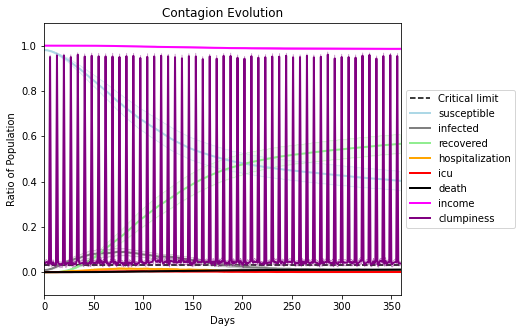

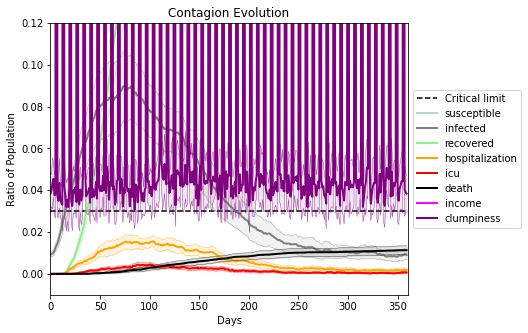

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8034, 9683, 3865, 15, 8935, 1818, 8703, 3394, 3187, 7091, 5730, 5437, 4772, 8493, 9071, 3920, 2073, 995, 9023, 7271]
Average similarity between family members is 0.9343296626253924 at temperature -0.994
Average similarity between family and home is 0.9998565640100301 at temperature -1
Average similarity between students and their classroom is 0.5547907923967625 at temperature -0.994
Average classroom occupancy is 4.348484848484849 and number classrooms is 66
Average similarity between workers is 0.8725973964848054 at temperature -0.994
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8425062809328469 for kids: 0.685103696533412
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5677689581789122
avg restaurant similarity 0.6241429109265346
avg restaurant similarity 0.6076760744005851
avg restaurant similarity 0.5948483914421482
avg restaurant similarity 0.5663766057186317
avg restaurant similarity 0.5843179728557767
avg restaurant similarity 0.5936452596724862
avg restaurant similarity 0.5844719179664726
avg restaurant similarity 0.5634159403783864
avg restaurant similarity 0.5947444974325833
avg restaurant similarity 0.6080438591744768
avg restaurant similarity 0.6432974710899502
avg restaurant similarity 0.5871051597933904
avg restaurant similarity 0.5581386477870033
avg restaurant similarity 0.5893298585746938
avg restaurant similarity 0.5906901397123984
avg restaurant similarity 0.5952372474991124
avg restaurant similarity 0.5934085850297812
avg restaurant similarity 0.5832741718350531
avg restaurant similarity 0.594632293315822
avg restaurant similarity 0.6557109284981113
avg restaurant similarity 0.5614527272601658
avg restaur

avg restaurant similarity 0.5944379284377576
avg restaurant similarity 0.616792415713685
avg restaurant similarity 0.5937069329006592
avg restaurant similarity 0.580174082955513
avg restaurant similarity 0.6196418377569433
avg restaurant similarity 0.6111117245394653
avg restaurant similarity 0.6311950539674288
avg restaurant similarity 0.5875306828732219
avg restaurant similarity 0.5783070682029208
avg restaurant similarity 0.5836802275139692
avg restaurant similarity 0.6454749294609953
avg restaurant similarity 0.5939449882038458
avg restaurant similarity 0.588656801399699
avg restaurant similarity 0.5849745843525817
avg restaurant similarity 0.5997741913727846
avg restaurant similarity 0.591063395240098
avg restaurant similarity 0.6282665618584794
avg restaurant similarity 0.631774666895057
avg restaurant similarity 0.5878963003568257
avg restaurant similarity 0.5995297188087186
avg restaurant similarity 0.5591634087527152
avg restaurant similarity 0.5523644681030395
avg restaurant 

avg restaurant similarity 0.5723623667462934
avg restaurant similarity 0.576064166934219
avg restaurant similarity 0.5861067049047786
avg restaurant similarity 0.5346078944098523
avg restaurant similarity 0.5724808916589323
avg restaurant similarity 0.5371885654308896
avg restaurant similarity 0.5722845011565966
avg restaurant similarity 0.5758325969673427
avg restaurant similarity 0.5641838198411037
avg restaurant similarity 0.5815189977694183
avg restaurant similarity 0.5041605093228151
avg restaurant similarity 0.5679498420788337
avg restaurant similarity 0.560666916795439
avg restaurant similarity 0.5465913433807584
avg restaurant similarity 0.5886411836848767
avg restaurant similarity 0.5620218161987025
avg restaurant similarity 0.5259206657784185
avg restaurant similarity 0.5811387192630526
avg restaurant similarity 0.6107021059977822
avg restaurant similarity 0.5452905502525758
avg restaurant similarity 0.6123981901446747
avg restaurant similarity 0.591995100087554
avg restauran

avg restaurant similarity 0.5774284573424345
avg restaurant similarity 0.5643173191718874
avg restaurant similarity 0.5711034358853033
avg restaurant similarity 0.5438119174676205
avg restaurant similarity 0.5114309403839583
avg restaurant similarity 0.558199942703555
avg restaurant similarity 0.546173885329427
avg restaurant similarity 0.5931195723168291
avg restaurant similarity 0.593837916795369
avg restaurant similarity 0.604996327702533
avg restaurant similarity 0.5732436762240257
avg restaurant similarity 0.5694016735693146
avg restaurant similarity 0.5337097331825945
avg restaurant similarity 0.5957775402568644
avg restaurant similarity 0.5585109199056534
avg restaurant similarity 0.5686032810150682
avg restaurant similarity 0.5349134974499663
avg restaurant similarity 0.564823349552999
avg restaurant similarity 0.582501259961351
avg restaurant similarity 0.5590657932150734
avg restaurant similarity 0.5711362081909815
avg restaurant similarity 0.574540682079545
avg restaurant si

avg restaurant similarity 0.6320660228984293
avg restaurant similarity 0.5596408540540164
avg restaurant similarity 0.597909481902894
avg restaurant similarity 0.5839228155903678
avg restaurant similarity 0.5785760555955936
avg restaurant similarity 0.5811871534800915
avg restaurant similarity 0.5413545837486795
avg restaurant similarity 0.562678074650342
avg restaurant similarity 0.590870058148013
avg restaurant similarity 0.5544258055148679
avg restaurant similarity 0.5933789821842633
avg restaurant similarity 0.5361009956983352
avg restaurant similarity 0.5717046732412926
avg restaurant similarity 0.5659011563904944
avg restaurant similarity 0.5787337285152863
avg restaurant similarity 0.5894149786275
avg restaurant similarity 0.5591085990493101
avg restaurant similarity 0.5613049507112847
avg restaurant similarity 0.5898135558118097
avg restaurant similarity 0.6335587963830225
avg restaurant similarity 0.5595333118405351
avg restaurant similarity 0.6330650197276655
avg restaurant s

avg restaurant similarity 0.5835996441346526
avg restaurant similarity 0.5689929224107744
avg restaurant similarity 0.529039827873261
avg restaurant similarity 0.5772795936267143
avg restaurant similarity 0.581191402852717
avg restaurant similarity 0.5679676102632463
avg restaurant similarity 0.6002185929404711
avg restaurant similarity 0.6115158692614716
avg restaurant similarity 0.5745320249945007
avg restaurant similarity 0.5568459922169496
avg restaurant similarity 0.5329705831319118
avg restaurant similarity 0.5810108636671474
avg restaurant similarity 0.525889802891671
avg restaurant similarity 0.548693788997486
avg restaurant similarity 0.6243597567748003
avg restaurant similarity 0.5526903302150453
avg restaurant similarity 0.5431841934342481
avg restaurant similarity 0.592567768320459
avg restaurant similarity 0.5350222077280254
avg restaurant similarity 0.5804886394835825
avg restaurant similarity 0.5799795047338827
avg restaurant similarity 0.6159191860323943
avg restaurant 

avg restaurant similarity 0.4826490390921518
avg restaurant similarity 0.5835751254572547
avg restaurant similarity 0.5384592501118359
avg restaurant similarity 0.5762805096569188
avg restaurant similarity 0.5661387895083742
avg restaurant similarity 0.5964091606762421
avg restaurant similarity 0.6039911168283606
avg restaurant similarity 0.5401211297849215
avg restaurant similarity 0.583321075203951
avg restaurant similarity 0.5475516641275859
avg restaurant similarity 0.5393783911651605
avg restaurant similarity 0.6135094077807768
avg restaurant similarity 0.562771052843345
avg restaurant similarity 0.5749310899472184
avg restaurant similarity 0.5397449222235767
avg restaurant similarity 0.5212045810760538
avg restaurant similarity 0.5929588183720649
avg restaurant similarity 0.5744119696592337
avg restaurant similarity 0.5769756809248535
avg restaurant similarity 0.5138149359393234
avg restaurant similarity 0.5810786086554558
avg restaurant similarity 0.5554267157421453
avg restaura

avg restaurant similarity 0.5506028152376969
avg restaurant similarity 0.6284862973751923
avg restaurant similarity 0.5219765916503588
avg restaurant similarity 0.580736939931838
avg restaurant similarity 0.566025387447441
avg restaurant similarity 0.6043327954131297
avg restaurant similarity 0.5870626410192966
avg restaurant similarity 0.5870360821453328
avg restaurant similarity 0.6666197386189865
avg restaurant similarity 0.5892963105835156
avg restaurant similarity 0.6017672384926425
avg restaurant similarity 0.5925360007139531
avg restaurant similarity 0.5493438360359504
avg restaurant similarity 0.5693776342968693
avg restaurant similarity 0.5539647100429249
avg restaurant similarity 0.5694449770456999
avg restaurant similarity 0.5575105908335215
avg restaurant similarity 0.5703286547799709
avg restaurant similarity 0.5873738083530713
avg restaurant similarity 0.5853344388014226
avg restaurant similarity 0.5583734846164814
avg restaurant similarity 0.5467208024050912
avg restaura

avg restaurant similarity 0.5831027730484677
avg restaurant similarity 0.5281850503324488
avg restaurant similarity 0.5673277490325124
avg restaurant similarity 0.5532981274208925
avg restaurant similarity 0.5445625029169913
avg restaurant similarity 0.5737883605949258
avg restaurant similarity 0.6215755686515959
avg restaurant similarity 0.5992045036735874
avg restaurant similarity 0.5345437559049044
avg restaurant similarity 0.620360480015256
avg restaurant similarity 0.5430612850966193
avg restaurant similarity 0.5794463607044731
avg restaurant similarity 0.588491543666491
avg restaurant similarity 0.5146243333756002
avg restaurant similarity 0.5920418839533627
avg restaurant similarity 0.525127121141208
avg restaurant similarity 0.5906590534832205
avg restaurant similarity 0.5435583630054166
avg restaurant similarity 0.5769478133985703
avg restaurant similarity 0.5762756761797778
avg restaurant similarity 0.600115342430418
avg restaurant similarity 0.5755745641699498
avg restaurant

avg restaurant similarity 0.5739301165598534
avg restaurant similarity 0.5816711409324121
avg restaurant similarity 0.5274353759204633
avg restaurant similarity 0.5750134921748484
avg restaurant similarity 0.5728385235406972
avg restaurant similarity 0.5661953953337094
avg restaurant similarity 0.5330978993970991
avg restaurant similarity 0.5618047773065635
avg restaurant similarity 0.523248990118092
avg restaurant similarity 0.5748388844822504
avg restaurant similarity 0.5907942112124903
avg restaurant similarity 0.5776313734228051
avg restaurant similarity 0.6298878432374465
avg restaurant similarity 0.5811155385746253
avg restaurant similarity 0.5729102932634312
avg restaurant similarity 0.5684935313833681
avg restaurant similarity 0.47955402212146564
avg restaurant similarity 0.5572941504611587
avg restaurant similarity 0.5779998646481956
avg restaurant similarity 0.5849950099756128
avg restaurant similarity 0.5441925806638064
avg restaurant similarity 0.5802109810183291
avg restau

avg restaurant similarity 0.5363237756821209
avg restaurant similarity 0.5046973968638205
avg restaurant similarity 0.4982527320408413
avg restaurant similarity 0.550218883400677
avg restaurant similarity 0.6104664116840268
avg restaurant similarity 0.5926661524660642
avg restaurant similarity 0.547806555370811
avg restaurant similarity 0.5978823622419812
avg restaurant similarity 0.5425992284154445
avg restaurant similarity 0.5659737910796361
avg restaurant similarity 0.5123293741893682
avg restaurant similarity 0.5741177422984539
avg restaurant similarity 0.5720674419032998
avg restaurant similarity 0.5885045264457176
avg restaurant similarity 0.5478190773900429
avg restaurant similarity 0.544387860771162
avg restaurant similarity 0.5852887672473438
avg restaurant similarity 0.5596993851233699
avg restaurant similarity 0.5554436615663624
avg restaurant similarity 0.5778484266156949
avg restaurant similarity 0.6036410644779256
avg restaurant similarity 0.6028373525670868
avg restauran

avg restaurant similarity 0.5856425166696475
avg restaurant similarity 0.4999529873729897
avg restaurant similarity 0.6222530689996606
avg restaurant similarity 0.5485087190592084
avg restaurant similarity 0.5929604088751752
avg restaurant similarity 0.5720638050455055
avg restaurant similarity 0.5996558269653852
avg restaurant similarity 0.5311820122692548
avg restaurant similarity 0.5947595274723073
avg restaurant similarity 0.5743735525989853
avg restaurant similarity 0.5307129709968172
avg restaurant similarity 0.615794814493133
avg restaurant similarity 0.5794858209336626
avg restaurant similarity 0.6184002907940734
avg restaurant similarity 0.5653749453663034
avg restaurant similarity 0.5725848366264807
avg restaurant similarity 0.5367457357285028
avg restaurant similarity 0.5890017847625562
avg restaurant similarity 0.5184315602488322
avg restaurant similarity 0.5873184298916729
avg restaurant similarity 0.6245316667110073
avg restaurant similarity 0.6432399601220982
avg restaur

avg restaurant similarity 0.5356942839536993
avg restaurant similarity 0.5211723804657119
avg restaurant similarity 0.545167680429635
avg restaurant similarity 0.5399184698515881
avg restaurant similarity 0.5592414330399225
avg restaurant similarity 0.5388499947176892
avg restaurant similarity 0.5383611500398884
avg restaurant similarity 0.5331342782701008
avg restaurant similarity 0.5648936645095615
avg restaurant similarity 0.5188427964726454
avg restaurant similarity 0.5212288877800069
avg restaurant similarity 0.6063774437930028
avg restaurant similarity 0.6215734959928166
avg restaurant similarity 0.5437060423915092
avg restaurant similarity 0.6212770177126876
avg restaurant similarity 0.5836097980619457
avg restaurant similarity 0.5616631582504094
avg restaurant similarity 0.5637176362072923
avg restaurant similarity 0.5976347528112037
avg restaurant similarity 0.5839322324506464
avg restaurant similarity 0.5575830043374869
avg restaurant similarity 0.572827028179762
avg restaura

avg restaurant similarity 0.6265132963196327
avg restaurant similarity 0.5640250203179135
avg restaurant similarity 0.5667538457789307
avg restaurant similarity 0.5223857149743194
avg restaurant similarity 0.5898088508760363
avg restaurant similarity 0.5847293056989159
avg restaurant similarity 0.5939465808151617
avg restaurant similarity 0.572399732355823
avg restaurant similarity 0.5758024959081616
avg restaurant similarity 0.5371596817916673
avg restaurant similarity 0.5854381048362587
avg restaurant similarity 0.618194421179721
avg restaurant similarity 0.5765797294302757
avg restaurant similarity 0.5712932752262351
avg restaurant similarity 0.6007053489338977
avg restaurant similarity 0.5325017949775681
avg restaurant similarity 0.5931525248233543
avg restaurant similarity 0.5433830926931045
avg restaurant similarity 0.5211702804257176
avg restaurant similarity 0.5731956371415973
avg restaurant similarity 0.5771753913057055
avg restaurant similarity 0.5708903397326126
avg restaura

avg restaurant similarity 0.5036517236569692
avg restaurant similarity 0.5525611399386899
avg restaurant similarity 0.524465134021828
avg restaurant similarity 0.5380595395853033
avg restaurant similarity 0.5753663962365747
avg restaurant similarity 0.5648212118028015
avg restaurant similarity 0.5209498561328708
avg restaurant similarity 0.5908993467819827
avg restaurant similarity 0.539580911056124
avg restaurant similarity 0.5563242854781036
avg restaurant similarity 0.4884169622247244
avg restaurant similarity 0.5177051350671883
avg restaurant similarity 0.560828113294928
avg restaurant similarity 0.5072764537756028
avg restaurant similarity 0.5025940576017821
avg restaurant similarity 0.5369594475109154
avg restaurant similarity 0.5359146277318101
avg restaurant similarity 0.5495292210364093
avg restaurant similarity 0.5442765249617438
avg restaurant similarity 0.5723360007274565
avg restaurant similarity 0.4873290167376372
avg restaurant similarity 0.5682333769129698
avg restauran

avg restaurant similarity 0.536522599548019
avg restaurant similarity 0.5485136421388177
avg restaurant similarity 0.5655804674289676
avg restaurant similarity 0.5478776103656918
avg restaurant similarity 0.533902196905777
avg restaurant similarity 0.5669532317959634
avg restaurant similarity 0.5100745904951299
avg restaurant similarity 0.5144586355587919
avg restaurant similarity 0.5473455342271305
avg restaurant similarity 0.5742833617044072
avg restaurant similarity 0.5551103702853089
avg restaurant similarity 0.5547290071817988
avg restaurant similarity 0.5149983368636514
avg restaurant similarity 0.5823401880990366
avg restaurant similarity 0.5235995824089493
avg restaurant similarity 0.5588289436902871
avg restaurant similarity 0.5790920384854205
avg restaurant similarity 0.5350783193699689
avg restaurant similarity 0.5507178837623021
avg restaurant similarity 0.5703430550804148
avg restaurant similarity 0.5305178212539364
avg restaurant similarity 0.5487185407193862
avg restaura

avg restaurant similarity 0.571917375981852
avg restaurant similarity 0.5654466462010469
avg restaurant similarity 0.5633587246142165
avg restaurant similarity 0.5860117359469501
avg restaurant similarity 0.5786262127829751
avg restaurant similarity 0.5988050162093169
avg restaurant similarity 0.5830233756954545
avg restaurant similarity 0.5927883925690651
avg restaurant similarity 0.5707013426858158
avg restaurant similarity 0.5153533539520726
avg restaurant similarity 0.5296203686292631
avg restaurant similarity 0.5428505220473062
avg restaurant similarity 0.5230966102813389
avg restaurant similarity 0.5359743229171829
avg restaurant similarity 0.5475089585201023
avg restaurant similarity 0.6023515184852501
avg restaurant similarity 0.5848088621262919
avg restaurant similarity 0.5732418236311714
avg restaurant similarity 0.5712753969349933
avg restaurant similarity 0.5345756400485699
avg restaurant similarity 0.5787703556011011
avg restaurant similarity 0.5223195300779355
avg restaur

avg restaurant similarity 0.5855638514619618
avg restaurant similarity 0.5090583475369183
avg restaurant similarity 0.5312710179744885
avg restaurant similarity 0.5338590972398803
avg restaurant similarity 0.5942604566994495
avg restaurant similarity 0.5256479138441157
avg restaurant similarity 0.6337529449928436
avg restaurant similarity 0.48607291354733256
avg restaurant similarity 0.5718051922879405
avg restaurant similarity 0.5102834974318347
avg restaurant similarity 0.56502930171622
avg restaurant similarity 0.5274834122295753
avg restaurant similarity 0.5812630853381993
avg restaurant similarity 0.5187770658391249
avg restaurant similarity 0.5680641934589319
avg restaurant similarity 0.5895495893251109
avg restaurant similarity 0.5364837119720965
avg restaurant similarity 0.5610235451124075
avg restaurant similarity 0.5301956733941817
avg restaurant similarity 0.5532147597575785
avg restaurant similarity 0.5598546768475845
avg restaurant similarity 0.5982167187631166
avg restaur

avg restaurant similarity 0.5609979947573032
avg restaurant similarity 0.6067564538117585
avg restaurant similarity 0.6071750080457887
avg restaurant similarity 0.7009780726156489
avg restaurant similarity 0.6925803967184696
avg restaurant similarity 0.6328534127778855
avg restaurant similarity 0.539849744425566
avg restaurant similarity 0.5967036839775067
avg restaurant similarity 0.5743014875772642
avg restaurant similarity 0.6387803035393679
avg restaurant similarity 0.6423844409451511
avg restaurant similarity 0.5505109505200417
avg restaurant similarity 0.5629166245852252
avg restaurant similarity 0.60562667211289
avg restaurant similarity 0.5781892116299124
avg restaurant similarity 0.6071081077746932
avg restaurant similarity 0.6021401556098744
avg restaurant similarity 0.5691456008581192
avg restaurant similarity 0.5753662078148574
avg restaurant similarity 0.5605083504851834
avg restaurant similarity 0.5590952762321084
avg restaurant similarity 0.608351576668704
avg restaurant

avg restaurant similarity 0.5991365893679601
avg restaurant similarity 0.5957624168513082
avg restaurant similarity 0.5969126540467299
avg restaurant similarity 0.5808295088191244
avg restaurant similarity 0.6250152397688348
avg restaurant similarity 0.5604474661330264
avg restaurant similarity 0.6107549356382792
avg restaurant similarity 0.6838776253373031
avg restaurant similarity 0.5454125184633322
avg restaurant similarity 0.6303936149834031
avg restaurant similarity 0.6246680937799913
avg restaurant similarity 0.631986746298313
avg restaurant similarity 0.64829030155942
avg restaurant similarity 0.587038247578953
avg restaurant similarity 0.595629308656645
avg restaurant similarity 0.5387526004869209
avg restaurant similarity 0.5359551999875448
avg restaurant similarity 0.5963594680270843
avg restaurant similarity 0.6199786640011619
avg restaurant similarity 0.6004672685007844
avg restaurant similarity 0.576170350433385
avg restaurant similarity 0.591144330532338
avg restaurant si

avg restaurant similarity 0.6305587059645916
avg restaurant similarity 0.5379421544647125
avg restaurant similarity 0.6099729692052007
avg restaurant similarity 0.6035488184796278
avg restaurant similarity 0.577470210956894
avg restaurant similarity 0.5528958373284859
avg restaurant similarity 0.5624428806888588
avg restaurant similarity 0.5485773081961219
avg restaurant similarity 0.5556511412834599
avg restaurant similarity 0.5522095577228501
avg restaurant similarity 0.5833182081859837
avg restaurant similarity 0.583402723643366
avg restaurant similarity 0.5290952103440555
avg restaurant similarity 0.5991312942988223
avg restaurant similarity 0.5844461311189806
avg restaurant similarity 0.5104089628661793
avg restaurant similarity 0.5744987285776904
avg restaurant similarity 0.5949374435057498
avg restaurant similarity 0.5953804735482268
avg restaurant similarity 0.5508429388833185
avg restaurant similarity 0.568753277695498
avg restaurant similarity 0.5962787406806271
avg restauran

avg restaurant similarity 0.5904085588472562
avg restaurant similarity 0.5768392798645787
avg restaurant similarity 0.5309587161958828
avg restaurant similarity 0.5808907727772367
avg restaurant similarity 0.5540013774876236
avg restaurant similarity 0.572802577831686
avg restaurant similarity 0.553736116449935
avg restaurant similarity 0.5732351557143354
avg restaurant similarity 0.5141150894772893
avg restaurant similarity 0.5101697349921761
avg restaurant similarity 0.5183636649943273
avg restaurant similarity 0.575508442388875
avg restaurant similarity 0.5158891593266799
avg restaurant similarity 0.4961693705468919
avg restaurant similarity 0.5455701166334235
avg restaurant similarity 0.5203893951355045
avg restaurant similarity 0.5745214326563619
avg restaurant similarity 0.5564468201186736
avg restaurant similarity 0.5344621996498259
avg restaurant similarity 0.5494613037422238
avg restaurant similarity 0.6127259070505465
avg restaurant similarity 0.5502871028418949
avg restauran

avg restaurant similarity 0.5725371588057078
avg restaurant similarity 0.5958192124616924
avg restaurant similarity 0.5607970136998294
avg restaurant similarity 0.5437349413442518
avg restaurant similarity 0.6014275155799604
avg restaurant similarity 0.5124257036974009
avg restaurant similarity 0.609343037012573
avg restaurant similarity 0.56872673641955
avg restaurant similarity 0.5503071302265842
avg restaurant similarity 0.5699783423581358
avg restaurant similarity 0.5096507458484988
avg restaurant similarity 0.573327508876694
avg restaurant similarity 0.5690313876082598
avg restaurant similarity 0.5420839732549052
avg restaurant similarity 0.5279216354856758
avg restaurant similarity 0.5757783693830363
avg restaurant similarity 0.5521622603198403
avg restaurant similarity 0.5361637481837177
avg restaurant similarity 0.5650229844049249
avg restaurant similarity 0.5342589618438107
avg restaurant similarity 0.5372416396498575
avg restaurant similarity 0.5629318955068011
avg restaurant

avg restaurant similarity 0.606965166641604
avg restaurant similarity 0.5817800662195137
avg restaurant similarity 0.6008063504337844
avg restaurant similarity 0.5532461262086713
avg restaurant similarity 0.5967270974960287
avg restaurant similarity 0.5650969298690829
avg restaurant similarity 0.5568223726648884
avg restaurant similarity 0.5741096623955838
avg restaurant similarity 0.5612035268118362
avg restaurant similarity 0.583264840290788
avg restaurant similarity 0.53892029349399
avg restaurant similarity 0.5682840524037845
avg restaurant similarity 0.5690256343583054
avg restaurant similarity 0.5890878981567494
avg restaurant similarity 0.5252143633539017
avg restaurant similarity 0.5472373097279852
avg restaurant similarity 0.5853427742091292
avg restaurant similarity 0.6265218695816157
avg restaurant similarity 0.5572459982334513
avg restaurant similarity 0.6009364212069124
avg restaurant similarity 0.5929762414360975
avg restaurant similarity 0.5898855519565027
avg restaurant

avg restaurant similarity 0.5681182452653227
avg restaurant similarity 0.5808037013630128
avg restaurant similarity 0.5253080441222909
avg restaurant similarity 0.5271184316708265
avg restaurant similarity 0.5517516002013716
avg restaurant similarity 0.5772400460988618
avg restaurant similarity 0.6297429361009427
avg restaurant similarity 0.5615419354297764
avg restaurant similarity 0.5978484677127799
avg restaurant similarity 0.5572174891844619
avg restaurant similarity 0.5290024837215791
avg restaurant similarity 0.5429024846907207
avg restaurant similarity 0.5423548744866782
avg restaurant similarity 0.5312312096404653
avg restaurant similarity 0.5675840274399123
avg restaurant similarity 0.547692506000798
avg restaurant similarity 0.5240409397454527
avg restaurant similarity 0.5673613380057922
avg restaurant similarity 0.5813192925891347
avg restaurant similarity 0.503666269893153
avg restaurant similarity 0.5620893813117332
avg restaurant similarity 0.5966437572196228
avg restaura

avg restaurant similarity 0.61327797138608
avg restaurant similarity 0.618060684992595
avg restaurant similarity 0.6463524668716032
avg restaurant similarity 0.6282498032947513
avg restaurant similarity 0.5525377873204182
avg restaurant similarity 0.5329681890885357
avg restaurant similarity 0.5509461272053237
avg restaurant similarity 0.5622620148767171
avg restaurant similarity 0.5480799900296008
avg restaurant similarity 0.6230384270289672
avg restaurant similarity 0.5768609586269635
avg restaurant similarity 0.5990479105474318
avg restaurant similarity 0.5321780913246015
avg restaurant similarity 0.6212481315727318
avg restaurant similarity 0.580400604538948
avg restaurant similarity 0.5673484565964624
avg restaurant similarity 0.5590252763245903
avg restaurant similarity 0.5483000317965676
avg restaurant similarity 0.5591832514207584
avg restaurant similarity 0.5612785830418309
avg restaurant similarity 0.5599738943974454
avg restaurant similarity 0.5522998086584311
avg restaurant

avg restaurant similarity 0.5592523880091762
avg restaurant similarity 0.5383205347048857
avg restaurant similarity 0.5635393769712678
avg restaurant similarity 0.600623407803451
avg restaurant similarity 0.5220749464419873
avg restaurant similarity 0.579570453485872
avg restaurant similarity 0.5643498421303541
avg restaurant similarity 0.5598390590719973
avg restaurant similarity 0.522055475555448
avg restaurant similarity 0.540906629991704
avg restaurant similarity 0.5689169825924256
avg restaurant similarity 0.5532148537002435
avg restaurant similarity 0.5969990822278349
avg restaurant similarity 0.5492144540566741
avg restaurant similarity 0.6201513135968955
avg restaurant similarity 0.5397972570858307
avg restaurant similarity 0.5553864897098418
avg restaurant similarity 0.5738196085194719
avg restaurant similarity 0.6103178920751053
avg restaurant similarity 0.5496331767990047
avg restaurant similarity 0.5337232210561362
avg restaurant similarity 0.5186102551320559
avg restaurant

avg restaurant similarity 0.5336283248697576
avg restaurant similarity 0.5343584045455663
avg restaurant similarity 0.538087313037421
avg restaurant similarity 0.5353893354438682
avg restaurant similarity 0.5496620526342548
avg restaurant similarity 0.5751263103371226
avg restaurant similarity 0.5716768807968616
avg restaurant similarity 0.5539450788602287
avg restaurant similarity 0.5430158397872447
avg restaurant similarity 0.5604378689739121
avg restaurant similarity 0.5429420638195178
avg restaurant similarity 0.5419655228507739
avg restaurant similarity 0.5727504276390206
avg restaurant similarity 0.5318610469114049
avg restaurant similarity 0.5642814225456292
avg restaurant similarity 0.5436287816696478
avg restaurant similarity 0.5648736898404334
avg restaurant similarity 0.5682076043792615
avg restaurant similarity 0.542277906698815
avg restaurant similarity 0.5089573878216826
avg restaurant similarity 0.5505026691573931
avg restaurant similarity 0.4828777529469521
avg restaura

avg restaurant similarity 0.5607864227465417
avg restaurant similarity 0.5677534742672404
avg restaurant similarity 0.5526855722341487
avg restaurant similarity 0.6023855496449272
avg restaurant similarity 0.5569299288689413
avg restaurant similarity 0.5783528353019719
avg restaurant similarity 0.5775675977632461
avg restaurant similarity 0.5234719954210428
avg restaurant similarity 0.5877264974440672
avg restaurant similarity 0.5648828686135979
avg restaurant similarity 0.5168750311835316
avg restaurant similarity 0.5660872952541207
avg restaurant similarity 0.5643146182442401
avg restaurant similarity 0.5912937281257286
avg restaurant similarity 0.548648343375374
avg restaurant similarity 0.5557129563851531
avg restaurant similarity 0.5600906166611213
avg restaurant similarity 0.5789969952797266
avg restaurant similarity 0.5831252120278664
avg restaurant similarity 0.577542142923705
avg restaurant similarity 0.5491919151400476
avg restaurant similarity 0.6011366376474918
avg restaura

avg restaurant similarity 0.5779492157342857
avg restaurant similarity 0.5314271725251694
avg restaurant similarity 0.534575877143708
avg restaurant similarity 0.6095612989407879
avg restaurant similarity 0.5822869452329792
avg restaurant similarity 0.5361183873778245
avg restaurant similarity 0.5578103551886391
avg restaurant similarity 0.6122205564474988
avg restaurant similarity 0.5838299038708347
avg restaurant similarity 0.5618716537876112
avg restaurant similarity 0.5988248312306641
avg restaurant similarity 0.5584237920279567
avg restaurant similarity 0.5290947874148307
avg restaurant similarity 0.5432158204950996
avg restaurant similarity 0.6107839627016992
avg restaurant similarity 0.6030117379650312
avg restaurant similarity 0.5429538495432394
avg restaurant similarity 0.5775169692041169
avg restaurant similarity 0.520049704090163
avg restaurant similarity 0.5446811784248585
avg restaurant similarity 0.5337660468888306
avg restaurant similarity 0.5784074392727653
avg restaura

avg restaurant similarity 0.54534653004793
avg restaurant similarity 0.6037551797102796
avg restaurant similarity 0.6270233118208244
avg restaurant similarity 0.6138462600848449
avg restaurant similarity 0.609438547429987
avg restaurant similarity 0.5941418667040476
avg restaurant similarity 0.5757917884925045
avg restaurant similarity 0.624469666945332
avg restaurant similarity 0.5811532943979859
avg restaurant similarity 0.5909407437312897
avg restaurant similarity 0.6086079124525883
avg restaurant similarity 0.5936749044213164
avg restaurant similarity 0.5819638517840539
avg restaurant similarity 0.6211846174397303
avg restaurant similarity 0.6023934211837276
avg restaurant similarity 0.5786162173396909
avg restaurant similarity 0.6037036013378095
avg restaurant similarity 0.5922008838124571
avg restaurant similarity 0.5993577386232948
avg restaurant similarity 0.667150684454697
avg restaurant similarity 0.5803561496496827
avg restaurant similarity 0.5917156103594304
avg restaurant 

avg restaurant similarity 0.5732605726827875
avg restaurant similarity 0.5503933615513755
avg restaurant similarity 0.5225339149515666
avg restaurant similarity 0.6042897764877329
avg restaurant similarity 0.5781769181090308
avg restaurant similarity 0.5638014405385531
avg restaurant similarity 0.5875217025714649
avg restaurant similarity 0.5763604069116612
avg restaurant similarity 0.5802424732536944
avg restaurant similarity 0.5567059044315713
avg restaurant similarity 0.5994959296921083
avg restaurant similarity 0.5891613515026912
avg restaurant similarity 0.55195236394491
avg restaurant similarity 0.5693977158561299
avg restaurant similarity 0.5612179471660826
avg restaurant similarity 0.5608881907269987
avg restaurant similarity 0.572795863674928
avg restaurant similarity 0.5467015678046484
avg restaurant similarity 0.5845057813524763
avg restaurant similarity 0.5384089613870691
avg restaurant similarity 0.5804656223054203
avg restaurant similarity 0.5712433621820844
avg restauran

avg restaurant similarity 0.5908576694209889
avg restaurant similarity 0.5425079391826849
avg restaurant similarity 0.6085434387700102
avg restaurant similarity 0.5914223329740645
avg restaurant similarity 0.569261943017449
avg restaurant similarity 0.4801388047102189
avg restaurant similarity 0.5552026011123506
avg restaurant similarity 0.5433690925716393
avg restaurant similarity 0.5799899636010118
avg restaurant similarity 0.5524364584203382
avg restaurant similarity 0.5983899125608269
avg restaurant similarity 0.5692003861308896
avg restaurant similarity 0.5228227737450474
avg restaurant similarity 0.5473351903031339
avg restaurant similarity 0.5114472830717867
avg restaurant similarity 0.5594081356443825
avg restaurant similarity 0.5381584157687955
avg restaurant similarity 0.564596642968373
avg restaurant similarity 0.5780291580001785
avg restaurant similarity 0.5827382714948848
avg restaurant similarity 0.5209157482428055
avg restaurant similarity 0.6037478380824111
avg restaura

avg restaurant similarity 0.5466847839746679
avg restaurant similarity 0.5685227031947145
avg restaurant similarity 0.5067098383380328
avg restaurant similarity 0.5291584512958678
avg restaurant similarity 0.5831832097782128
avg restaurant similarity 0.605555141604897
avg restaurant similarity 0.5099294721336782
avg restaurant similarity 0.5854053617996661
avg restaurant similarity 0.5535649788618722
avg restaurant similarity 0.5098899303140987
avg restaurant similarity 0.5964888213204527
avg restaurant similarity 0.4983536500424573
avg restaurant similarity 0.5480007425995514
avg restaurant similarity 0.5373672715229771
avg restaurant similarity 0.48181713780879176
avg restaurant similarity 0.5826786831104549
avg restaurant similarity 0.5671411032668284
avg restaurant similarity 0.5860653921397829
avg restaurant similarity 0.5319569695865424
avg restaurant similarity 0.5162086392286578
avg restaurant similarity 0.5506420830656448
avg restaurant similarity 0.5058642662133628
avg restau

avg restaurant similarity 0.611785345248325
avg restaurant similarity 0.5602032942587719
avg restaurant similarity 0.5784438757167308
avg restaurant similarity 0.5354255743073093
avg restaurant similarity 0.5921899875354496
avg restaurant similarity 0.607010454106633
avg restaurant similarity 0.6188960254427442
avg restaurant similarity 0.6674495586867588
avg restaurant similarity 0.5368023595510413
avg restaurant similarity 0.56827364448757
avg restaurant similarity 0.6331258793568671
avg restaurant similarity 0.5542929434356332
avg restaurant similarity 0.5975731588442226
avg restaurant similarity 0.5877783990617688
avg restaurant similarity 0.586839975259648
avg restaurant similarity 0.5389914609597751
avg restaurant similarity 0.617919346874367
avg restaurant similarity 0.5576342553245188
avg restaurant similarity 0.6078467955324918
avg restaurant similarity 0.6236365678558748
avg restaurant similarity 0.5960546412088796
avg restaurant similarity 0.5366090675144497
avg restaurant s

avg restaurant similarity 0.6156778026836389
avg restaurant similarity 0.5979601677788265
avg restaurant similarity 0.6254041741010975
avg restaurant similarity 0.5214677884814485
avg restaurant similarity 0.5445323032571066
avg restaurant similarity 0.5991194077588173
avg restaurant similarity 0.6026068923354408
avg restaurant similarity 0.566559611088914
avg restaurant similarity 0.5905324542498251
avg restaurant similarity 0.5794234013695081
avg restaurant similarity 0.5638151774919071
avg restaurant similarity 0.6632183651493403
avg restaurant similarity 0.6405316654053735
avg restaurant similarity 0.5303292717175853
avg restaurant similarity 0.5628189020532889
avg restaurant similarity 0.5362639312758934
avg restaurant similarity 0.5961944907181825
avg restaurant similarity 0.5800141375320004
avg restaurant similarity 0.5926732461930071
avg restaurant similarity 0.577762865204584
avg restaurant similarity 0.5797021733711424
avg restaurant similarity 0.6109921891524271
avg restaura

avg restaurant similarity 0.589088321995533
avg restaurant similarity 0.5446600825518271
avg restaurant similarity 0.5598640194378518
avg restaurant similarity 0.548396758283616
avg restaurant similarity 0.5698797128670265
avg restaurant similarity 0.5299059555173506
avg restaurant similarity 0.5329458423769236
avg restaurant similarity 0.6102483040984223
avg restaurant similarity 0.5939028283521083
avg restaurant similarity 0.553043261231935
avg restaurant similarity 0.5214328791378728
avg restaurant similarity 0.5899029473379793
avg restaurant similarity 0.5604318812931395
avg restaurant similarity 0.5121231106299328
avg restaurant similarity 0.5878191072207424
avg restaurant similarity 0.5176614712950116
avg restaurant similarity 0.5784933299708198
avg restaurant similarity 0.5581905058688973
avg restaurant similarity 0.5834816044621076
avg restaurant similarity 0.5419642673269314
avg restaurant similarity 0.604822671720572
avg restaurant similarity 0.6116416667940344
avg restaurant

avg restaurant similarity 0.5621148683589261
avg restaurant similarity 0.5504292225702689
avg restaurant similarity 0.5463555413243762
avg restaurant similarity 0.5717767442749204
avg restaurant similarity 0.5645541694197684
avg restaurant similarity 0.5819751992905811
avg restaurant similarity 0.5369575305847857
avg restaurant similarity 0.5239109250972201
avg restaurant similarity 0.5992242149036703
avg restaurant similarity 0.6154733334740837
avg restaurant similarity 0.6290791625240031
avg restaurant similarity 0.5802429120858615
avg restaurant similarity 0.4872985617435246
avg restaurant similarity 0.5716464465948801
avg restaurant similarity 0.6024750295218111
avg restaurant similarity 0.5309645870152232
avg restaurant similarity 0.619384796523241
avg restaurant similarity 0.5318497509591639
avg restaurant similarity 0.5625224747028666
avg restaurant similarity 0.6105340425934785
avg restaurant similarity 0.5158007518990759
avg restaurant similarity 0.6067810607523717
avg restaur

avg restaurant similarity 0.5829092368158765
avg restaurant similarity 0.5558949757405208
avg restaurant similarity 0.603793969430317
avg restaurant similarity 0.5985291268068738
avg restaurant similarity 0.5962556373892421
avg restaurant similarity 0.6240813462367711
avg restaurant similarity 0.5936625315294078
avg restaurant similarity 0.5975544333948246
avg restaurant similarity 0.6375413628222839
avg restaurant similarity 0.6157786245074673
avg restaurant similarity 0.53506891410905
avg restaurant similarity 0.6063139032664905
avg restaurant similarity 0.5564669152876733
avg restaurant similarity 0.536435389688496
avg restaurant similarity 0.5644312976219525
avg restaurant similarity 0.5518099857604711
avg restaurant similarity 0.5356713580623429
avg restaurant similarity 0.5109344989978406
avg restaurant similarity 0.5690328850386397
avg restaurant similarity 0.588692069277556
avg restaurant similarity 0.5707816902860772
avg restaurant similarity 0.5944647491129167
avg restaurant 

avg restaurant similarity 0.5759672327632487
avg restaurant similarity 0.6296675943564739
avg restaurant similarity 0.623925687815502
avg restaurant similarity 0.5847587639461836
avg restaurant similarity 0.4880449446347475
avg restaurant similarity 0.5930988205109765
avg restaurant similarity 0.5592120122594325
avg restaurant similarity 0.6089571113429738
avg restaurant similarity 0.5935058802877854
avg restaurant similarity 0.591882507137972
avg restaurant similarity 0.5718800812096355
avg restaurant similarity 0.59957271062792
avg restaurant similarity 0.5656271930832615
avg restaurant similarity 0.5647632614757437
avg restaurant similarity 0.5396768953209418
avg restaurant similarity 0.5714295756333186
avg restaurant similarity 0.596715826269179
avg restaurant similarity 0.6079859998942797
avg restaurant similarity 0.4878476394357022
avg restaurant similarity 0.5762260070260109
avg restaurant similarity 0.5376449681196473
avg restaurant similarity 0.5468978552146861
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

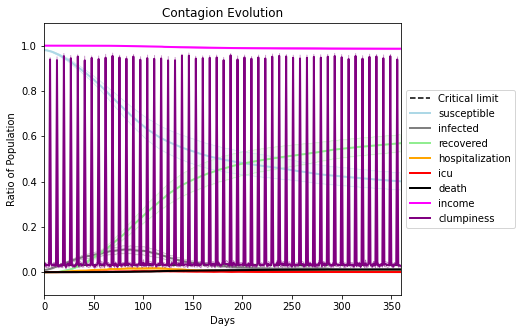

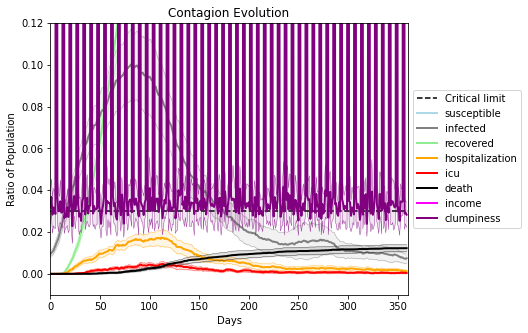

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4029, 5141, 6145, 1537, 8164, 3385, 4838, 3821, 896, 2650, 8357, 8595, 5515, 5114, 8913, 326, 5015, 4160, 9971, 6827]
Average similarity between family members is 0.9230339238931093 at temperature -0.993
Average similarity between family and home is 0.9998571085089657 at temperature -1
Average similarity between students and their classroom is 0.5516589748897306 at temperature -0.993
Average classroom occupancy is 4.185714285714286 and number classrooms is 70
Average similarity between workers is 0.8750652490066041 at temperature -0.993
Average office occupancy is 3.4545454545454546 and number offices is 187
Average friend similarity for adults: 0.8393863250270865 for kids: 0.6671202503459545
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5862600674586144
avg restaurant similarity 0.5270044870351478
avg restaurant similarity 0.5013626735752923
avg restaurant similarity 0.5182043690188981
avg restaurant similarity 0.5170509478774211
avg restaurant similarity 0.5416435437988907
avg restaurant similarity 0.5494338752044581
avg restaurant similarity 0.6091321862547554
avg restaurant similarity 0.5230867648206772
avg restaurant similarity 0.599947270823816
avg restaurant similarity 0.5402661217062367
avg restaurant similarity 0.5932606847172819
avg restaurant similarity 0.4804638920498573
avg restaurant similarity 0.551124728376294
avg restaurant similarity 0.5328900852504398
avg restaurant similarity 0.5863403527642186
avg restaurant similarity 0.5963091928931279
avg restaurant similarity 0.6242758112598157
avg restaurant similarity 0.5718525890814002
avg restaurant similarity 0.5024701169014405
avg restaurant similarity 0.612135768554011
avg restaurant similarity 0.513489656604094
avg restaurant

avg restaurant similarity 0.6115599763057393
avg restaurant similarity 0.5462848247713263
avg restaurant similarity 0.575311987616456
avg restaurant similarity 0.5421730303017579
avg restaurant similarity 0.5733550931041701
avg restaurant similarity 0.5391462216435159
avg restaurant similarity 0.5936005037943114
avg restaurant similarity 0.5361660536017671
avg restaurant similarity 0.5351816228405891
avg restaurant similarity 0.5294971117175593
avg restaurant similarity 0.5449375758997413
avg restaurant similarity 0.616745100496225
avg restaurant similarity 0.5983323701848997
avg restaurant similarity 0.5595623549096319
avg restaurant similarity 0.49425974056532884
avg restaurant similarity 0.5419598420850036
avg restaurant similarity 0.5817711370675693
avg restaurant similarity 0.5872090383281153
avg restaurant similarity 0.5302542004214412
avg restaurant similarity 0.5076293376371165
avg restaurant similarity 0.5868821380027266
avg restaurant similarity 0.5342798829106132
avg restaur

avg restaurant similarity 0.5069728111822942
avg restaurant similarity 0.568289503492858
avg restaurant similarity 0.5656631571110858
avg restaurant similarity 0.5805819203765672
avg restaurant similarity 0.46361638603066035
avg restaurant similarity 0.4936521409281538
avg restaurant similarity 0.5288241471495078
avg restaurant similarity 0.49352231886110876
avg restaurant similarity 0.5283089865397493
avg restaurant similarity 0.5617876667027992
avg restaurant similarity 0.5040667215955693
avg restaurant similarity 0.545794760884167
avg restaurant similarity 0.4814995311293378
avg restaurant similarity 0.5520193885545726
avg restaurant similarity 0.5301170733816206
avg restaurant similarity 0.5067271747471874
avg restaurant similarity 0.5056556321609186
avg restaurant similarity 0.535791362704457
avg restaurant similarity 0.4899624287311468
avg restaurant similarity 0.4980250684804985
avg restaurant similarity 0.4924896856521547
avg restaurant similarity 0.536701576116346
avg restaura

avg restaurant similarity 0.5048382806311043
avg restaurant similarity 0.4945802539784406
avg restaurant similarity 0.4897604271857975
avg restaurant similarity 0.5202105374601838
avg restaurant similarity 0.5233220741459478
avg restaurant similarity 0.5343982595798558
avg restaurant similarity 0.5152962003437366
avg restaurant similarity 0.4587492108629219
avg restaurant similarity 0.485835276299611
avg restaurant similarity 0.5095941109093403
avg restaurant similarity 0.4647211268187779
avg restaurant similarity 0.5408523008009434
avg restaurant similarity 0.45927117627243524
avg restaurant similarity 0.4897730889118002
avg restaurant similarity 0.5304592645029673
avg restaurant similarity 0.5245412451619229
avg restaurant similarity 0.5062603511730547
avg restaurant similarity 0.5030359767796508
avg restaurant similarity 0.523926956390837
avg restaurant similarity 0.48629369344908574
avg restaurant similarity 0.4706968661408278
avg restaurant similarity 0.5458429992665218
avg restau

avg restaurant similarity 0.5467633175333332
avg restaurant similarity 0.5470185748409728
avg restaurant similarity 0.5600106532332053
avg restaurant similarity 0.5477691704988314
avg restaurant similarity 0.5732265594656203
avg restaurant similarity 0.52305926721501
avg restaurant similarity 0.5529221171232415
avg restaurant similarity 0.5580981428670355
avg restaurant similarity 0.5904633023054903
avg restaurant similarity 0.5761707037869455
avg restaurant similarity 0.5159005538618425
avg restaurant similarity 0.5059499181136494
avg restaurant similarity 0.5578506643208802
avg restaurant similarity 0.5498022074686754
avg restaurant similarity 0.6239132182790494
avg restaurant similarity 0.5381995580231784
avg restaurant similarity 0.5455757687472077
avg restaurant similarity 0.5341535954864064
avg restaurant similarity 0.5785213571272855
avg restaurant similarity 0.5593691706194424
avg restaurant similarity 0.5962789062900724
avg restaurant similarity 0.5906779052831612
avg restaura

avg restaurant similarity 0.5726919416400765
avg restaurant similarity 0.5574717337422281
avg restaurant similarity 0.5481877246122966
avg restaurant similarity 0.4971165385633719
avg restaurant similarity 0.5076336787558405
avg restaurant similarity 0.5601485785140727
avg restaurant similarity 0.5743066679288517
avg restaurant similarity 0.5370624440427686
avg restaurant similarity 0.5723003985121147
avg restaurant similarity 0.5094120785550065
avg restaurant similarity 0.5540942066226572
avg restaurant similarity 0.5076820369309251
avg restaurant similarity 0.48875751584807864
avg restaurant similarity 0.5472115222967561
avg restaurant similarity 0.5313067648122376
avg restaurant similarity 0.5511245575359146
avg restaurant similarity 0.5809286351993663
avg restaurant similarity 0.5045443658490175
avg restaurant similarity 0.5066078208182828
avg restaurant similarity 0.5176132853084257
avg restaurant similarity 0.552181722758265
avg restaurant similarity 0.5446027031047311
avg restau

avg restaurant similarity 0.5584667993756841
avg restaurant similarity 0.5419245964564298
avg restaurant similarity 0.5486222942880217
avg restaurant similarity 0.5508619820752587
avg restaurant similarity 0.553772091073935
avg restaurant similarity 0.5816972320682868
avg restaurant similarity 0.5229092056671135
avg restaurant similarity 0.5605889092411436
avg restaurant similarity 0.5865378398167808
avg restaurant similarity 0.5709388330255336
avg restaurant similarity 0.523646673282542
avg restaurant similarity 0.5519975483675543
avg restaurant similarity 0.5646509717958845
avg restaurant similarity 0.5566477472133858
avg restaurant similarity 0.5413709647753777
avg restaurant similarity 0.5028304819240523
avg restaurant similarity 0.5540041058270501
avg restaurant similarity 0.5416748910135102
avg restaurant similarity 0.5410151866893826
avg restaurant similarity 0.5916472194381828
avg restaurant similarity 0.5690368541345063
avg restaurant similarity 0.5666013674611144
avg restaura

avg restaurant similarity 0.5655777737857307
avg restaurant similarity 0.5455771089819472
avg restaurant similarity 0.5980665063531259
avg restaurant similarity 0.5917955415798184
avg restaurant similarity 0.5750857722802248
avg restaurant similarity 0.6288842711388131
avg restaurant similarity 0.5613625015798693
avg restaurant similarity 0.5636688236541368
avg restaurant similarity 0.5615766626384521
avg restaurant similarity 0.5587631007880712
avg restaurant similarity 0.5767367640292184
avg restaurant similarity 0.5580359026156073
avg restaurant similarity 0.5677239916964653
avg restaurant similarity 0.5283621532145468
avg restaurant similarity 0.5312136460697245
avg restaurant similarity 0.5722429147571736
avg restaurant similarity 0.5556698231598058
avg restaurant similarity 0.572776992168953
avg restaurant similarity 0.5708162522237612
avg restaurant similarity 0.5681773084567774
avg restaurant similarity 0.5656337020090836
avg restaurant similarity 0.5848438595464622
avg restaur

avg restaurant similarity 0.5691676196866682
avg restaurant similarity 0.5487166471176498
avg restaurant similarity 0.5581990329799216
avg restaurant similarity 0.5815906338456157
avg restaurant similarity 0.5556101381590294
avg restaurant similarity 0.5853989816003606
avg restaurant similarity 0.5720909162491954
avg restaurant similarity 0.5554765733587124
avg restaurant similarity 0.5560612051785083
avg restaurant similarity 0.5493173093024094
avg restaurant similarity 0.5635029558512926
avg restaurant similarity 0.582377425762116
avg restaurant similarity 0.5704755167170831
avg restaurant similarity 0.5564987507093331
avg restaurant similarity 0.5784854657378639
avg restaurant similarity 0.5611929118305342
avg restaurant similarity 0.5601521455168932
avg restaurant similarity 0.6019940560478411
avg restaurant similarity 0.5779514814901667
avg restaurant similarity 0.5547956871257509
avg restaurant similarity 0.6094969814407328
avg restaurant similarity 0.5394832593745105
avg restaur

avg restaurant similarity 0.5328822503657993
avg restaurant similarity 0.577575191591053
avg restaurant similarity 0.5360904256876324
avg restaurant similarity 0.561559340913536
avg restaurant similarity 0.5404262647711893
avg restaurant similarity 0.5463259414070846
avg restaurant similarity 0.5333101424608049
avg restaurant similarity 0.5776412902681946
avg restaurant similarity 0.5502871082804234
avg restaurant similarity 0.5579076478767433
avg restaurant similarity 0.5423191607404636
avg restaurant similarity 0.5807839892054029
avg restaurant similarity 0.5847342005001137
avg restaurant similarity 0.56174728739919
avg restaurant similarity 0.5282999251245366
avg restaurant similarity 0.5736337139767059
avg restaurant similarity 0.5224449269637963
avg restaurant similarity 0.5602050244613402
avg restaurant similarity 0.5381677983748271
avg restaurant similarity 0.5643857980167939
avg restaurant similarity 0.565870407184876
avg restaurant similarity 0.5820627958866734
avg restaurant 

avg restaurant similarity 0.5378841478383636
avg restaurant similarity 0.6058699767221517
avg restaurant similarity 0.5551815323055798
avg restaurant similarity 0.5994809859379251
avg restaurant similarity 0.6163442569827066
avg restaurant similarity 0.5336447396199889
avg restaurant similarity 0.5723703634353833
avg restaurant similarity 0.63364685185115
avg restaurant similarity 0.5479620201527033
avg restaurant similarity 0.5461222385315351
avg restaurant similarity 0.5272598998338788
avg restaurant similarity 0.6390702071524881
avg restaurant similarity 0.5677179281476946
avg restaurant similarity 0.5280296791036801
avg restaurant similarity 0.5467930168793129
avg restaurant similarity 0.5329722239378353
avg restaurant similarity 0.48088600369406065
avg restaurant similarity 0.5611574246037281
avg restaurant similarity 0.5849054035324879
avg restaurant similarity 0.6004546775438242
avg restaurant similarity 0.5662522098964563
avg restaurant similarity 0.5328267216246929
avg restaur

avg restaurant similarity 0.4863028176762016
avg restaurant similarity 0.614073993964812
avg restaurant similarity 0.6622351743957281
avg restaurant similarity 0.636029232945722
avg restaurant similarity 0.704527943090412
avg restaurant similarity 0.6703408786813853
avg restaurant similarity 0.5222506282747439
avg restaurant similarity 0.6232826647830464
avg restaurant similarity 0.5522080381647309
avg restaurant similarity 0.6757152803372876
avg restaurant similarity 0.5889569728998246
avg restaurant similarity 0.5411224999512366
avg restaurant similarity 0.5113099545731367
avg restaurant similarity 0.6050993875541926
avg restaurant similarity 0.5862756481724308
avg restaurant similarity 0.5591611692945084
avg restaurant similarity 0.5630899644937891
avg restaurant similarity 0.5921825399548392
avg restaurant similarity 0.5906869531864792
avg restaurant similarity 0.5596677224039411
avg restaurant similarity 0.49603887091420884
avg restaurant similarity 0.5643424674675274
avg restaura

avg restaurant similarity 0.49524435897391345
avg restaurant similarity 0.5206603622433378
avg restaurant similarity 0.5302120764224774
avg restaurant similarity 0.4872954941693406
avg restaurant similarity 0.5399672039760386
avg restaurant similarity 0.5348545361317071
avg restaurant similarity 0.4911228513444463
avg restaurant similarity 0.6055170971263695
avg restaurant similarity 0.5510354948405093
avg restaurant similarity 0.5320944525195936
avg restaurant similarity 0.4906027197723155
avg restaurant similarity 0.5635425411714735
avg restaurant similarity 0.5276416544510881
avg restaurant similarity 0.5247283588482763
avg restaurant similarity 0.5407417619409369
avg restaurant similarity 0.5235598216541345
avg restaurant similarity 0.5217362066031833
avg restaurant similarity 0.5424316434457475
avg restaurant similarity 0.5595798981248769
avg restaurant similarity 0.5061334651224172
avg restaurant similarity 0.5493402411597529
avg restaurant similarity 0.4999033135314592
avg resta

avg restaurant similarity 0.549072222544754
avg restaurant similarity 0.5399793425458819
avg restaurant similarity 0.5206516370520624
avg restaurant similarity 0.4865770723371203
avg restaurant similarity 0.5401534266015687
avg restaurant similarity 0.523867839130252
avg restaurant similarity 0.46968642250201964
avg restaurant similarity 0.49018594400001025
avg restaurant similarity 0.58897782942192
avg restaurant similarity 0.5447046232889721
avg restaurant similarity 0.5423804797746945
avg restaurant similarity 0.5264911141117214
avg restaurant similarity 0.5619367142613092
avg restaurant similarity 0.579663762528327
avg restaurant similarity 0.5331489142455005
avg restaurant similarity 0.5696506051984094
avg restaurant similarity 0.5367099689598351
avg restaurant similarity 0.5451945426589867
avg restaurant similarity 0.5284925635268576
avg restaurant similarity 0.5211661695084048
avg restaurant similarity 0.5222810686905482
avg restaurant similarity 0.5471211050769396
avg restauran

avg restaurant similarity 0.5626734631798084
avg restaurant similarity 0.5466497818803769
avg restaurant similarity 0.5376211873207932
avg restaurant similarity 0.5565254974229926
avg restaurant similarity 0.5236194413762478
avg restaurant similarity 0.5466625142331052
avg restaurant similarity 0.5792325716520139
avg restaurant similarity 0.5596361916053164
avg restaurant similarity 0.5186323096800144
avg restaurant similarity 0.5345457199583553
avg restaurant similarity 0.49522030231123226
avg restaurant similarity 0.5889146779502624
avg restaurant similarity 0.5631864926586463
avg restaurant similarity 0.5344924229560418
avg restaurant similarity 0.5248092139896009
avg restaurant similarity 0.5691217678239443
avg restaurant similarity 0.5499840898682326
avg restaurant similarity 0.5197453421188177
avg restaurant similarity 0.5647931187502843
avg restaurant similarity 0.598872621037427
avg restaurant similarity 0.5709963960116443
avg restaurant similarity 0.5518920892956872
avg restau

avg restaurant similarity 0.5586689779685511
avg restaurant similarity 0.5364276593183849
avg restaurant similarity 0.5524461810168863
avg restaurant similarity 0.5482433721495444
avg restaurant similarity 0.5730823229448825
avg restaurant similarity 0.5352532088089332
avg restaurant similarity 0.5103789173405321
avg restaurant similarity 0.5429656176556164
avg restaurant similarity 0.5764646772279557
avg restaurant similarity 0.5713130428961194
avg restaurant similarity 0.556557990542149
avg restaurant similarity 0.48240741729197456
avg restaurant similarity 0.5402213072487227
avg restaurant similarity 0.54005811441491
avg restaurant similarity 0.5357920149955232
avg restaurant similarity 0.5722732840450651
avg restaurant similarity 0.580873431853676
avg restaurant similarity 0.5510061347210703
avg restaurant similarity 0.5669952922293024
avg restaurant similarity 0.5651517580044249
avg restaurant similarity 0.5586923102963582
avg restaurant similarity 0.5351219759020168
avg restauran

avg restaurant similarity 0.5451006560241999
avg restaurant similarity 0.5840830054937712
avg restaurant similarity 0.5721897861753841
avg restaurant similarity 0.5582969510767889
avg restaurant similarity 0.5619237372410211
avg restaurant similarity 0.5581541263075229
avg restaurant similarity 0.5946206354192403
avg restaurant similarity 0.5744140077774974
avg restaurant similarity 0.5358176700547443
avg restaurant similarity 0.5516168929483591
avg restaurant similarity 0.5425414814148639
avg restaurant similarity 0.5363194113271104
avg restaurant similarity 0.5260163214929098
avg restaurant similarity 0.5663492319062982
avg restaurant similarity 0.6072005309780042
avg restaurant similarity 0.5554822667589803
avg restaurant similarity 0.5847271971359665
avg restaurant similarity 0.6159561614971862
avg restaurant similarity 0.5933737774335563
avg restaurant similarity 0.6008932695634884
avg restaurant similarity 0.5491862390831157
avg restaurant similarity 0.6192159738436749
avg restau

avg restaurant similarity 0.5623975131918549
avg restaurant similarity 0.5975924543410905
avg restaurant similarity 0.5866192158043427
avg restaurant similarity 0.5436535052856564
avg restaurant similarity 0.5298991725080276
avg restaurant similarity 0.589348415408788
avg restaurant similarity 0.6112898139662524
avg restaurant similarity 0.6423284701250631
avg restaurant similarity 0.5851390427137624
avg restaurant similarity 0.5938800245121619
avg restaurant similarity 0.5845240091479738
avg restaurant similarity 0.5858295933518871
avg restaurant similarity 0.5561991966479417
avg restaurant similarity 0.548626949843118
avg restaurant similarity 0.602462774732593
avg restaurant similarity 0.582639417580354
avg restaurant similarity 0.5777679261931152
avg restaurant similarity 0.5633608044960895
avg restaurant similarity 0.569339636744758
avg restaurant similarity 0.5523898338562477
avg restaurant similarity 0.5596248216195668
avg restaurant similarity 0.5406834647170132
avg restaurant 

avg restaurant similarity 0.5506190657346746
avg restaurant similarity 0.5872213097514759
avg restaurant similarity 0.5259633661426126
avg restaurant similarity 0.5859271863152112
avg restaurant similarity 0.574257819290645
avg restaurant similarity 0.601590500971483
avg restaurant similarity 0.5563271089491877
avg restaurant similarity 0.586128997513321
avg restaurant similarity 0.5678624868993964
avg restaurant similarity 0.6165322222701652
avg restaurant similarity 0.5383477393536388
avg restaurant similarity 0.5602676418518676
avg restaurant similarity 0.5324128826294114
avg restaurant similarity 0.5691342857181021
avg restaurant similarity 0.5551444478106674
avg restaurant similarity 0.5095478363741195
avg restaurant similarity 0.5858103772723424
avg restaurant similarity 0.5628305107147504
avg restaurant similarity 0.5313279246251631
avg restaurant similarity 0.5670530590357721
avg restaurant similarity 0.5741410479863194
avg restaurant similarity 0.5781944169532873
avg restauran

avg restaurant similarity 0.5478711305885356
avg restaurant similarity 0.5689831027919138
avg restaurant similarity 0.5428315751035361
avg restaurant similarity 0.5810299005005727
avg restaurant similarity 0.5440694684775831
avg restaurant similarity 0.5360763052807391
avg restaurant similarity 0.5700585704678928
avg restaurant similarity 0.5379642262085165
avg restaurant similarity 0.5922745900713381
avg restaurant similarity 0.5524326973993926
avg restaurant similarity 0.5731792219748642
avg restaurant similarity 0.5677057169420616
avg restaurant similarity 0.5688765918408784
avg restaurant similarity 0.5738876883556792
avg restaurant similarity 0.5873236662042008
avg restaurant similarity 0.576290143296777
avg restaurant similarity 0.5950281669907264
avg restaurant similarity 0.5899211484121244
avg restaurant similarity 0.53761507934043
avg restaurant similarity 0.5916046697960274
avg restaurant similarity 0.5524401379951267
avg restaurant similarity 0.5918494436657387
avg restauran

avg restaurant similarity 0.5892371958080888
avg restaurant similarity 0.530000686537928
avg restaurant similarity 0.5548373808485575
avg restaurant similarity 0.6101666740537862
avg restaurant similarity 0.503096842741859
avg restaurant similarity 0.5531004725504093
avg restaurant similarity 0.5490592951301241
avg restaurant similarity 0.565361950468167
avg restaurant similarity 0.5650174753927073
avg restaurant similarity 0.5269919910845909
avg restaurant similarity 0.5782768802458451
avg restaurant similarity 0.4988593818914835
avg restaurant similarity 0.5453524259449947
avg restaurant similarity 0.5446891416718614
avg restaurant similarity 0.5752427235646503
avg restaurant similarity 0.5454009958188699
avg restaurant similarity 0.549216792636985
avg restaurant similarity 0.586762946942273
avg restaurant similarity 0.5727903568962299
avg restaurant similarity 0.5660529173160629
avg restaurant similarity 0.5392076526963707
avg restaurant similarity 0.5843669897410835
avg restaurant 

avg restaurant similarity 0.552719418713245
avg restaurant similarity 0.5205042960660516
avg restaurant similarity 0.5853990207832496
avg restaurant similarity 0.5243130190725976
avg restaurant similarity 0.581712825041495
avg restaurant similarity 0.5670936735893877
avg restaurant similarity 0.5473004571573458
avg restaurant similarity 0.5799693184673727
avg restaurant similarity 0.5842737374522465
avg restaurant similarity 0.5610277607683979
avg restaurant similarity 0.5612138695978304
avg restaurant similarity 0.5748277460179636
avg restaurant similarity 0.5463634611196652
avg restaurant similarity 0.638886665029471
avg restaurant similarity 0.5022152305537357
avg restaurant similarity 0.5679381473399829
avg restaurant similarity 0.5566915362459898
avg restaurant similarity 0.5174385548399768
avg restaurant similarity 0.5659436503224421
avg restaurant similarity 0.5481084522557198
avg restaurant similarity 0.518568359557825
avg restaurant similarity 0.5869336695674954
avg restaurant

avg restaurant similarity 0.6127216905109591
avg restaurant similarity 0.5969360656126848
avg restaurant similarity 0.627631816730885
avg restaurant similarity 0.5911881422784938
avg restaurant similarity 0.5656039925160116
avg restaurant similarity 0.6026108495468988
avg restaurant similarity 0.5896611966622859
avg restaurant similarity 0.5929377826252267
avg restaurant similarity 0.6075512548059663
avg restaurant similarity 0.5794797480564151
avg restaurant similarity 0.5539399975884028
avg restaurant similarity 0.5472784994373838
avg restaurant similarity 0.548232422516027
avg restaurant similarity 0.5899784737084749
avg restaurant similarity 0.5698825790967361
avg restaurant similarity 0.5737725217999852
avg restaurant similarity 0.5790163899807794
avg restaurant similarity 0.5460878147292461
avg restaurant similarity 0.5260962268062029
avg restaurant similarity 0.5881495545532343
avg restaurant similarity 0.6069459948116138
avg restaurant similarity 0.5889326719588283
avg restaura

avg restaurant similarity 0.5852650546406925
avg restaurant similarity 0.5682201488944602
avg restaurant similarity 0.5700944514837281
avg restaurant similarity 0.5769335571626206
avg restaurant similarity 0.6784615858694897
avg restaurant similarity 0.5759421725571128
avg restaurant similarity 0.5527060233547697
avg restaurant similarity 0.5821064172988335
avg restaurant similarity 0.5870477261995009
avg restaurant similarity 0.6136082197151245
avg restaurant similarity 0.588330385709745
avg restaurant similarity 0.5660518477955047
avg restaurant similarity 0.5762019867024304
avg restaurant similarity 0.5941651511209741
avg restaurant similarity 0.5734935547107132
avg restaurant similarity 0.6237116708462254
avg restaurant similarity 0.565183645826739
avg restaurant similarity 0.5637141719735097
avg restaurant similarity 0.6025483547319933
avg restaurant similarity 0.6244918502915904
avg restaurant similarity 0.5843454494073004
avg restaurant similarity 0.5883373679478959
avg restaura

avg restaurant similarity 0.5491817684801513
avg restaurant similarity 0.5393430315075904
avg restaurant similarity 0.5582355944370476
avg restaurant similarity 0.5685888230018126
avg restaurant similarity 0.5409695925148988
avg restaurant similarity 0.6052503393725129
avg restaurant similarity 0.633318917645703
avg restaurant similarity 0.6174289655105961
avg restaurant similarity 0.5254946086326283
avg restaurant similarity 0.5370885970003707
avg restaurant similarity 0.5438613559795137
avg restaurant similarity 0.536918953476255
avg restaurant similarity 0.5984885860963697
avg restaurant similarity 0.6033157566967513
avg restaurant similarity 0.5337573610825351
avg restaurant similarity 0.5716581580861865
avg restaurant similarity 0.5391287752417985
avg restaurant similarity 0.5916524563771923
avg restaurant similarity 0.5352604787115223
avg restaurant similarity 0.5755559889181947
avg restaurant similarity 0.6063127513361702
avg restaurant similarity 0.5647250533311863
avg restaura

avg restaurant similarity 0.5460358679138849
avg restaurant similarity 0.514481128679239
avg restaurant similarity 0.5925604046900073
avg restaurant similarity 0.6201593115320249
avg restaurant similarity 0.5694655945709751
avg restaurant similarity 0.5245264036329143
avg restaurant similarity 0.6063065422433258
avg restaurant similarity 0.5699624576944415
avg restaurant similarity 0.5151450480200611
avg restaurant similarity 0.5606417556696179
avg restaurant similarity 0.5750566396873243
avg restaurant similarity 0.5859399282861908
avg restaurant similarity 0.617351681970097
avg restaurant similarity 0.5767517870599053
avg restaurant similarity 0.5675026117715584
avg restaurant similarity 0.5115684415871328
avg restaurant similarity 0.5565394378202568
avg restaurant similarity 0.6172824041039348
avg restaurant similarity 0.5871797230933025
avg restaurant similarity 0.5814789182077758
avg restaurant similarity 0.5773541820352295
avg restaurant similarity 0.5072373930650674
avg restaura

avg restaurant similarity 0.5860462390699415
avg restaurant similarity 0.6192786783914632
avg restaurant similarity 0.5695879483513641
avg restaurant similarity 0.5623509585979992
avg restaurant similarity 0.5507975795409724
avg restaurant similarity 0.5348148020909427
avg restaurant similarity 0.5248390101205542
avg restaurant similarity 0.5449014459771698
avg restaurant similarity 0.5678385502760458
avg restaurant similarity 0.5652998950834797
avg restaurant similarity 0.5646421560659968
avg restaurant similarity 0.5833702733277379
avg restaurant similarity 0.5229255614234852
avg restaurant similarity 0.5543904082384115
avg restaurant similarity 0.5483393740018803
avg restaurant similarity 0.5759475575583962
avg restaurant similarity 0.5460562706600153
avg restaurant similarity 0.6161753132129731
avg restaurant similarity 0.5482211019138763
avg restaurant similarity 0.581655153006824
avg restaurant similarity 0.574481542231653
avg restaurant similarity 0.5435009215861883
avg restaura

avg restaurant similarity 0.5756685501481504
avg restaurant similarity 0.5572455165894401
avg restaurant similarity 0.5375766926410286
avg restaurant similarity 0.479011243864538
avg restaurant similarity 0.5597885741508453
avg restaurant similarity 0.5428582711227266
avg restaurant similarity 0.533221745723297
avg restaurant similarity 0.5436453449957561
avg restaurant similarity 0.5109002936935647
avg restaurant similarity 0.6028995156035133
avg restaurant similarity 0.5002685082610131
avg restaurant similarity 0.5373653276969815
avg restaurant similarity 0.5169306337797313
avg restaurant similarity 0.6085763793163349
avg restaurant similarity 0.5681705782915253
avg restaurant similarity 0.5693811053801737
avg restaurant similarity 0.5965180463969763
avg restaurant similarity 0.5999265927922122
avg restaurant similarity 0.5637627490415641
avg restaurant similarity 0.5370580357101385
avg restaurant similarity 0.5185741557756195
avg restaurant similarity 0.5691750996150952
avg restaura

avg restaurant similarity 0.5985699487917493
avg restaurant similarity 0.5560204010759181
avg restaurant similarity 0.5074847083608821
avg restaurant similarity 0.5787431266899151
avg restaurant similarity 0.5853965488266907
avg restaurant similarity 0.5802754351090142
avg restaurant similarity 0.5784102549459451
avg restaurant similarity 0.6327854387522062
avg restaurant similarity 0.5900713626885478
avg restaurant similarity 0.6120372114989666
avg restaurant similarity 0.5969513359141864
avg restaurant similarity 0.5960709976921122
avg restaurant similarity 0.5914833750921357
avg restaurant similarity 0.5124843400677277
avg restaurant similarity 0.6040247674762635
avg restaurant similarity 0.534523242550269
avg restaurant similarity 0.5610936778781052
avg restaurant similarity 0.5697754114837896
avg restaurant similarity 0.59530961780238
avg restaurant similarity 0.5757284239801468
avg restaurant similarity 0.5844206833357526
avg restaurant similarity 0.5995926160901414
avg restauran

avg restaurant similarity 0.6046093376692191
avg restaurant similarity 0.557205102711195
avg restaurant similarity 0.6441839194419665
avg restaurant similarity 0.550594041907123
avg restaurant similarity 0.552146951850511
avg restaurant similarity 0.5210132789027984
avg restaurant similarity 0.5570309764388276
avg restaurant similarity 0.5451297110441524
avg restaurant similarity 0.577872508507828
avg restaurant similarity 0.5555724829354394
avg restaurant similarity 0.5799759281330954
avg restaurant similarity 0.5578604831396984
avg restaurant similarity 0.477346695270488
avg restaurant similarity 0.583453221238053
avg restaurant similarity 0.5663593120052034
avg restaurant similarity 0.5978527800691738
avg restaurant similarity 0.5386307032130145
avg restaurant similarity 0.5691973404801566
avg restaurant similarity 0.5368394296563288
avg restaurant similarity 0.5350444312088201
avg restaurant similarity 0.4907825139787708
avg restaurant similarity 0.550388906508259
avg restaurant si

avg restaurant similarity 0.5627045734493965
avg restaurant similarity 0.56713619322343
avg restaurant similarity 0.5550772807110284
avg restaurant similarity 0.5331915473124563
avg restaurant similarity 0.5591930416635914
avg restaurant similarity 0.5095037571512777
avg restaurant similarity 0.5112798908583926
avg restaurant similarity 0.5238000880043864
avg restaurant similarity 0.5379807476611768
avg restaurant similarity 0.5293436193918072
avg restaurant similarity 0.5280540810624913
avg restaurant similarity 0.5835420844984802
avg restaurant similarity 0.5526564147403586
avg restaurant similarity 0.5223788922633817
avg restaurant similarity 0.5226759861531941
avg restaurant similarity 0.5441187124217303
avg restaurant similarity 0.5673016485435579
avg restaurant similarity 0.5405406357758107
avg restaurant similarity 0.5949562898470954
avg restaurant similarity 0.5312489067330862
avg restaurant similarity 0.6106618218023062
avg restaurant similarity 0.5714037585798328
avg restaura

avg restaurant similarity 0.5959746224898196
avg restaurant similarity 0.5676540308676054
avg restaurant similarity 0.5688402102567539
avg restaurant similarity 0.5501868045086131
avg restaurant similarity 0.5492966881713283
avg restaurant similarity 0.5787997019561992
avg restaurant similarity 0.5679134395892732
avg restaurant similarity 0.5379290166076901
avg restaurant similarity 0.5507418490850144
avg restaurant similarity 0.5767446723019831
avg restaurant similarity 0.5401793874917422
avg restaurant similarity 0.5613783543919746
avg restaurant similarity 0.6003970998954636
avg restaurant similarity 0.5490698868342945
avg restaurant similarity 0.549400168966332
avg restaurant similarity 0.5522264254307799
avg restaurant similarity 0.5679524822719962
avg restaurant similarity 0.5323975533520519
avg restaurant similarity 0.5833497198791007
avg restaurant similarity 0.5778072505990216
avg restaurant similarity 0.5612534232040008
avg restaurant similarity 0.5632997638209529
avg restaur

avg restaurant similarity 0.5636055667685983
avg restaurant similarity 0.5334863949980766
avg restaurant similarity 0.5422872482584384
avg restaurant similarity 0.5350048100794114
avg restaurant similarity 0.5315518274398862
avg restaurant similarity 0.6009354422209886
avg restaurant similarity 0.5530218991703507
avg restaurant similarity 0.5254618729810573
avg restaurant similarity 0.517628526207019
avg restaurant similarity 0.5198260778406405
avg restaurant similarity 0.565218816934557
avg restaurant similarity 0.5626329032290447
avg restaurant similarity 0.5256583583036133
avg restaurant similarity 0.5220887524975917
avg restaurant similarity 0.5737088677886443
avg restaurant similarity 0.5899050383248984
avg restaurant similarity 0.5205927300425784
avg restaurant similarity 0.5721612731308536
avg restaurant similarity 0.5522467890354378
avg restaurant similarity 0.5966955108518536
avg restaurant similarity 0.5588074078408942
avg restaurant similarity 0.5243103816340569
avg restaura

avg restaurant similarity 0.5745129958580917
avg restaurant similarity 0.5478725441836225
avg restaurant similarity 0.5467442222800853
avg restaurant similarity 0.5039533361773283
avg restaurant similarity 0.4960605620182344
avg restaurant similarity 0.5873420387895543
avg restaurant similarity 0.5612621332442472
avg restaurant similarity 0.5739280717330678
avg restaurant similarity 0.5696151248756166
avg restaurant similarity 0.5388115185862322
avg restaurant similarity 0.5769577612654467
avg restaurant similarity 0.5171850931159142
avg restaurant similarity 0.5344506911852864
avg restaurant similarity 0.5372498818394781
avg restaurant similarity 0.6038326382448217
avg restaurant similarity 0.547874667741371
avg restaurant similarity 0.5038676145286194
avg restaurant similarity 0.5820337006692262
avg restaurant similarity 0.5378748328130287
avg restaurant similarity 0.5436365832335494
avg restaurant similarity 0.5625832270123999
avg restaurant similarity 0.5310416731890807
avg restaur

avg restaurant similarity 0.5252898100212569
avg restaurant similarity 0.5534626451222122
avg restaurant similarity 0.5828483515473544
avg restaurant similarity 0.5061651400123126
avg restaurant similarity 0.495287226597343
avg restaurant similarity 0.5805629187334103
avg restaurant similarity 0.5459697746630949
avg restaurant similarity 0.5578653878913479
avg restaurant similarity 0.5075622706248598
avg restaurant similarity 0.5196864567173877
avg restaurant similarity 0.5451745952398583
avg restaurant similarity 0.5762666519496247
avg restaurant similarity 0.5406262151842276
avg restaurant similarity 0.558083743670109
avg restaurant similarity 0.539008466905997
avg restaurant similarity 0.5287976251437455
avg restaurant similarity 0.5277967266310624
avg restaurant similarity 0.5258624803655249
avg restaurant similarity 0.5623778751774837
avg restaurant similarity 0.5190574306128971
avg restaurant similarity 0.5547549644757096
avg restaurant similarity 0.518446170083745
avg restaurant

avg restaurant similarity 0.4867575753104455
avg restaurant similarity 0.5231217393416676
avg restaurant similarity 0.5312668468427655
avg restaurant similarity 0.4937463797021673
avg restaurant similarity 0.4943883893603579
avg restaurant similarity 0.5140053163440543
avg restaurant similarity 0.5042023485928351
avg restaurant similarity 0.5728971110447535
avg restaurant similarity 0.5144804102508019
avg restaurant similarity 0.5719055388078929
avg restaurant similarity 0.5215323233667164
avg restaurant similarity 0.5379654498842894
avg restaurant similarity 0.5265527190276116
avg restaurant similarity 0.5263589725017017
avg restaurant similarity 0.5403157414152401
avg restaurant similarity 0.5167132426405009
avg restaurant similarity 0.5183701024870138
avg restaurant similarity 0.5385928202888322
avg restaurant similarity 0.5145265365168689
avg restaurant similarity 0.5469311964910413
avg restaurant similarity 0.5519499042639209
avg restaurant similarity 0.5464649088706958
avg restau

avg restaurant similarity 0.5533187886773978
avg restaurant similarity 0.5589597642592029
avg restaurant similarity 0.5701089699134325
avg restaurant similarity 0.5527550324191882
avg restaurant similarity 0.555053407606915
avg restaurant similarity 0.5046397763571386
avg restaurant similarity 0.5889770448283175
avg restaurant similarity 0.5922811163542513
avg restaurant similarity 0.5620421356695878
avg restaurant similarity 0.5682707677094552
avg restaurant similarity 0.5613564175980735
avg restaurant similarity 0.6157728119944784
avg restaurant similarity 0.5706844043195404
avg restaurant similarity 0.5547402730643884
avg restaurant similarity 0.5404094352567582
avg restaurant similarity 0.5997748101386585
avg restaurant similarity 0.5715015149255235
avg restaurant similarity 0.6085325624734941
avg restaurant similarity 0.595447113784743
avg restaurant similarity 0.5850483507691517
avg restaurant similarity 0.5806683708828597
avg restaurant similarity 0.5492361132829945
avg restaura

avg restaurant similarity 0.5537535979768891
avg restaurant similarity 0.5635888331840533
avg restaurant similarity 0.5765141942681651
avg restaurant similarity 0.5744909570608081
avg restaurant similarity 0.569351300361765
avg restaurant similarity 0.5439695132575635
avg restaurant similarity 0.522670083141671
avg restaurant similarity 0.5372694069742168
avg restaurant similarity 0.5288786746902383
avg restaurant similarity 0.5734273781140632
avg restaurant similarity 0.5647467881836998
avg restaurant similarity 0.5634592598148934
avg restaurant similarity 0.5618994262972195
avg restaurant similarity 0.556460358322383
avg restaurant similarity 0.5243187397088871
avg restaurant similarity 0.5820814782826897
avg restaurant similarity 0.5312159106452643
avg restaurant similarity 0.5455150618023566
avg restaurant similarity 0.5676782007590887
avg restaurant similarity 0.5533244822454554
avg restaurant similarity 0.5293594709954055
avg restaurant similarity 0.5678871903721779
avg restauran

avg restaurant similarity 0.5693296998307297
avg restaurant similarity 0.5875921054620726
avg restaurant similarity 0.5516593497990677
avg restaurant similarity 0.5554361152010366
avg restaurant similarity 0.540565824456054
avg restaurant similarity 0.5663699527392523
avg restaurant similarity 0.5578336895860612
avg restaurant similarity 0.5717772356356934
avg restaurant similarity 0.5667244532722179
avg restaurant similarity 0.6050877882092631
avg restaurant similarity 0.5586911963584574
avg restaurant similarity 0.5557390407866225
avg restaurant similarity 0.569559877737384
avg restaurant similarity 0.6009575422164648
avg restaurant similarity 0.599034830130396
avg restaurant similarity 0.5625623633450303
avg restaurant similarity 0.5676351601815305
avg restaurant similarity 0.5627670282385595
avg restaurant similarity 0.5452772423183234
avg restaurant similarity 0.5912832869093705
avg restaurant similarity 0.5827794620328953
avg restaurant similarity 0.5436060436282171
avg restauran

avg restaurant similarity 0.585872067433062
avg restaurant similarity 0.5728804295366987
avg restaurant similarity 0.5646664346901747
avg restaurant similarity 0.584343849595563
avg restaurant similarity 0.5675042715209121
avg restaurant similarity 0.5833127071580191
avg restaurant similarity 0.5786450021677916
avg restaurant similarity 0.5718523683384859
avg restaurant similarity 0.5744281041628
avg restaurant similarity 0.5973996049062923
avg restaurant similarity 0.5673273378646074
avg restaurant similarity 0.5626271972036392
avg restaurant similarity 0.599824324670616
avg restaurant similarity 0.5674312173586661
avg restaurant similarity 0.5466149304209127
avg restaurant similarity 0.5426956286189202
avg restaurant similarity 0.5924932497691829
avg restaurant similarity 0.5690632430033574
avg restaurant similarity 0.572200300687009
avg restaurant similarity 0.5805533697960262
avg restaurant similarity 0.5652397590904141
avg restaurant similarity 0.5558239458505759
avg restaurant si

(<function dict.items>, <function dict.items>, <function dict.items>)

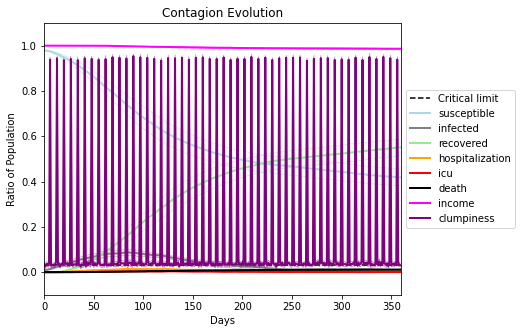

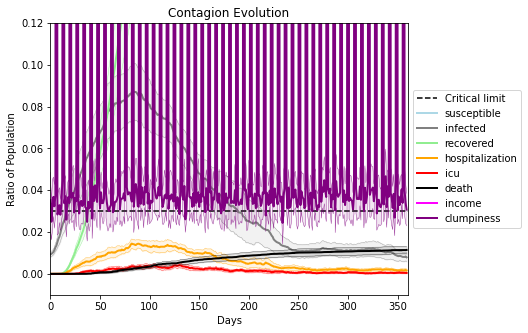

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6696, 2242, 5266, 6643, 7622, 5496, 9200, 2635, 8073, 2734, 3399, 4672, 6465, 2997, 2908, 5157, 2491, 6358, 5381, 3870]
Average similarity between family members is 0.9221496417567291 at temperature -0.992
Average similarity between family and home is 0.9998519943391397 at temperature -1
Average similarity between students and their classroom is 0.5382623794399142 at temperature -0.992
Average classroom occupancy is 4.126760563380282 and number classrooms is 71
Average similarity between workers is 0.8546640384171111 at temperature -0.992
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8487110621374129 for kids: 0.6686520877838255
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5385388539025995
avg restaurant similarity 0.518176645040179
avg restaurant similarity 0.518019740943867
avg restaurant similarity 0.5060847705564322
avg restaurant similarity 0.5506350231479482
avg restaurant similarity 0.5291921008825267
avg restaurant similarity 0.5463706961339166
avg restaurant similarity 0.5383773934034158
avg restaurant similarity 0.5644196452129652
avg restaurant similarity 0.4788624731222436
avg restaurant similarity 0.5311574109674048
avg restaurant similarity 0.44345864192557066
avg restaurant similarity 0.5673822555211829
avg restaurant similarity 0.5608858510141081
avg restaurant similarity 0.534774970771327
avg restaurant similarity 0.5345423434208284
avg restaurant similarity 0.5170278454332949
avg restaurant similarity 0.5582402834815167
avg restaurant similarity 0.5290845441106877
avg restaurant similarity 0.534639395207156
avg restaurant similarity 0.5071615389148002
avg restaurant similarity 0.545311845968456
avg restaurant

avg restaurant similarity 0.4873479679046495
avg restaurant similarity 0.47191799784341043
avg restaurant similarity 0.5609999739927846
avg restaurant similarity 0.4886986153435804
avg restaurant similarity 0.5565811524752365
avg restaurant similarity 0.5309006584467241
avg restaurant similarity 0.4979283760419118
avg restaurant similarity 0.48801101630698823
avg restaurant similarity 0.4515565606345588
avg restaurant similarity 0.5138195044395466
avg restaurant similarity 0.48625513159541567
avg restaurant similarity 0.48379248779623474
avg restaurant similarity 0.5773104779402622
avg restaurant similarity 0.4939968635881814
avg restaurant similarity 0.513209833810512
avg restaurant similarity 0.5367587981590625
avg restaurant similarity 0.48975103033458356
avg restaurant similarity 0.5082246808656318
avg restaurant similarity 0.49761055388912095
avg restaurant similarity 0.553349124011292
avg restaurant similarity 0.49979643708761945
avg restaurant similarity 0.48340425030260464
avg 

avg restaurant similarity 0.4988699263214357
avg restaurant similarity 0.5371831719488855
avg restaurant similarity 0.5118731217268293
avg restaurant similarity 0.4981364975729178
avg restaurant similarity 0.4932130518244666
avg restaurant similarity 0.536124403024217
avg restaurant similarity 0.5479476905001608
avg restaurant similarity 0.5366203245351122
avg restaurant similarity 0.5426945435060532
avg restaurant similarity 0.543318543683074
avg restaurant similarity 0.512401376241644
avg restaurant similarity 0.5106660056479594
avg restaurant similarity 0.5208334297023741
avg restaurant similarity 0.4445644913517956
avg restaurant similarity 0.537690828785839
avg restaurant similarity 0.5180623462998246
avg restaurant similarity 0.4829305426390074
avg restaurant similarity 0.4903161087112274
avg restaurant similarity 0.5740854213030302
avg restaurant similarity 0.4749509073718752
avg restaurant similarity 0.5093800473980513
avg restaurant similarity 0.46706299526212436
avg restauran

avg restaurant similarity 0.5003105348704054
avg restaurant similarity 0.5235843302368554
avg restaurant similarity 0.5102422477189621
avg restaurant similarity 0.5047498240791465
avg restaurant similarity 0.5104634129870942
avg restaurant similarity 0.4850927834292877
avg restaurant similarity 0.4781931219489537
avg restaurant similarity 0.4912852077019201
avg restaurant similarity 0.49123090797539515
avg restaurant similarity 0.5049103873605941
avg restaurant similarity 0.495721004966995
avg restaurant similarity 0.5514540031347975
avg restaurant similarity 0.6155249128080053
avg restaurant similarity 0.47943224999971057
avg restaurant similarity 0.5880827395932706
avg restaurant similarity 0.5296572736801504
avg restaurant similarity 0.49379705482986
avg restaurant similarity 0.49012431110723953
avg restaurant similarity 0.5266034194524009
avg restaurant similarity 0.48916116952299005
avg restaurant similarity 0.5073093287594632
avg restaurant similarity 0.5197364021341637
avg resta

avg restaurant similarity 0.5617793766795105
avg restaurant similarity 0.5079512521623206
avg restaurant similarity 0.56303663942408
avg restaurant similarity 0.5319355656600203
avg restaurant similarity 0.5149935267399438
avg restaurant similarity 0.5484734882100403
avg restaurant similarity 0.5725325527604721
avg restaurant similarity 0.5192370145411488
avg restaurant similarity 0.5023975421980348
avg restaurant similarity 0.4970736299297836
avg restaurant similarity 0.5216413523864101
avg restaurant similarity 0.5357316411827167
avg restaurant similarity 0.532540474747615
avg restaurant similarity 0.5525661683428362
avg restaurant similarity 0.4685261437266443
avg restaurant similarity 0.4994968419732791
avg restaurant similarity 0.5267214374716428
avg restaurant similarity 0.5848846532023679
avg restaurant similarity 0.5635239699895619
avg restaurant similarity 0.5710003869024766
avg restaurant similarity 0.5167588864193206
avg restaurant similarity 0.5452776764389181
avg restauran

avg restaurant similarity 0.5282734607869659
avg restaurant similarity 0.5275511646472538
avg restaurant similarity 0.5567849285405785
avg restaurant similarity 0.5986668085169372
avg restaurant similarity 0.5731955283644914
avg restaurant similarity 0.5584578195777893
avg restaurant similarity 0.5180929225106027
avg restaurant similarity 0.522608741730312
avg restaurant similarity 0.5236717250696858
avg restaurant similarity 0.4603631867725115
avg restaurant similarity 0.5818058770192719
avg restaurant similarity 0.5540050323991543
avg restaurant similarity 0.5675990982799869
avg restaurant similarity 0.5216863002378168
avg restaurant similarity 0.4817128462017594
avg restaurant similarity 0.5086430327446274
avg restaurant similarity 0.5265980830175131
avg restaurant similarity 0.5115957414949028
avg restaurant similarity 0.5632663259433595
avg restaurant similarity 0.5386269051779521
avg restaurant similarity 0.5374419154658275
avg restaurant similarity 0.5076492647679255
avg restaur

avg restaurant similarity 0.5528053865422904
avg restaurant similarity 0.4921626482872101
avg restaurant similarity 0.5133785035510318
avg restaurant similarity 0.44980232922522584
avg restaurant similarity 0.5001569177733772
avg restaurant similarity 0.5171203728078496
avg restaurant similarity 0.5410938542111076
avg restaurant similarity 0.5297078273616739
avg restaurant similarity 0.5564608360267916
avg restaurant similarity 0.5103218546846545
avg restaurant similarity 0.5237479920329922
avg restaurant similarity 0.5333737802950698
avg restaurant similarity 0.5505873840016549
avg restaurant similarity 0.5125721020317837
avg restaurant similarity 0.5276243078368223
avg restaurant similarity 0.4869226162472219
avg restaurant similarity 0.5532376515308941
avg restaurant similarity 0.47602307017426965
avg restaurant similarity 0.504596462142876
avg restaurant similarity 0.5542215871983462
avg restaurant similarity 0.499167445987794
avg restaurant similarity 0.5158929014209968
avg restau

avg restaurant similarity 0.48309114110197077
avg restaurant similarity 0.5529161837289099
avg restaurant similarity 0.5336818710358139
avg restaurant similarity 0.5062086574107457
avg restaurant similarity 0.497727921720217
avg restaurant similarity 0.5320666043033259
avg restaurant similarity 0.53426963571243
avg restaurant similarity 0.5239303148817788
avg restaurant similarity 0.515865316522448
avg restaurant similarity 0.5435078352885842
avg restaurant similarity 0.4958351364757159
avg restaurant similarity 0.4923733868185403
avg restaurant similarity 0.49837037682695745
avg restaurant similarity 0.5239966346228401
avg restaurant similarity 0.5033123134014749
avg restaurant similarity 0.5063827938684105
avg restaurant similarity 0.5333613056982807
avg restaurant similarity 0.4794750186035229
avg restaurant similarity 0.524532636786385
avg restaurant similarity 0.5054657192815856
avg restaurant similarity 0.5494659443422824
avg restaurant similarity 0.5369375621408365
avg restauran

avg restaurant similarity 0.5314163690210416
avg restaurant similarity 0.5020940007609005
avg restaurant similarity 0.5382706388942522
avg restaurant similarity 0.5187411669857896
avg restaurant similarity 0.5443586622681661
avg restaurant similarity 0.5493498422074737
avg restaurant similarity 0.5943965557132067
avg restaurant similarity 0.5790324323522634
avg restaurant similarity 0.5236399294701056
avg restaurant similarity 0.5277952909425705
avg restaurant similarity 0.5335244490334798
avg restaurant similarity 0.5303241691675384
avg restaurant similarity 0.5753883123929386
avg restaurant similarity 0.5095687319467027
avg restaurant similarity 0.5495294943954668
avg restaurant similarity 0.5955910125761846
avg restaurant similarity 0.5988217596605309
avg restaurant similarity 0.5627475348812714
avg restaurant similarity 0.5562949516605272
avg restaurant similarity 0.5443251363795512
avg restaurant similarity 0.5707688747339762
avg restaurant similarity 0.5085713041297378
avg restau

avg restaurant similarity 0.5659323334834252
avg restaurant similarity 0.5310455114051839
avg restaurant similarity 0.5498244251510063
avg restaurant similarity 0.5135175680397654
avg restaurant similarity 0.5131758368526077
avg restaurant similarity 0.5623041140467067
avg restaurant similarity 0.4945023962825324
avg restaurant similarity 0.5831328363167619
avg restaurant similarity 0.4880904576213351
avg restaurant similarity 0.5387733138292371
avg restaurant similarity 0.529180294548134
avg restaurant similarity 0.567876315447885
avg restaurant similarity 0.5703787075887404
avg restaurant similarity 0.5209874217111764
avg restaurant similarity 0.5433389109482641
avg restaurant similarity 0.530315745033775
avg restaurant similarity 0.4998768975335468
avg restaurant similarity 0.48816958659765647
avg restaurant similarity 0.561693091622456
avg restaurant similarity 0.6019626987597199
avg restaurant similarity 0.5648520511628098
avg restaurant similarity 0.5742692799504289
avg restauran

avg restaurant similarity 0.5567936850450578
avg restaurant similarity 0.5821854396915741
avg restaurant similarity 0.5602565391446318
avg restaurant similarity 0.5409964242619582
avg restaurant similarity 0.5152132105912098
avg restaurant similarity 0.502265978662016
avg restaurant similarity 0.5313189407138736
avg restaurant similarity 0.5337197970458581
avg restaurant similarity 0.5087101979601946
avg restaurant similarity 0.5563713884186612
avg restaurant similarity 0.5253204974108516
avg restaurant similarity 0.4824334983295283
avg restaurant similarity 0.6081813877633319
avg restaurant similarity 0.5686175039564394
avg restaurant similarity 0.47730747443067706
avg restaurant similarity 0.5710670631509086
avg restaurant similarity 0.5139313414737704
avg restaurant similarity 0.5617281934527194
avg restaurant similarity 0.48311517408437615
avg restaurant similarity 0.5942980193057879
avg restaurant similarity 0.4990195433830977
avg restaurant similarity 0.5462446208853329
avg resta

avg restaurant similarity 0.5239957866541617
avg restaurant similarity 0.5183175474928623
avg restaurant similarity 0.5789184788996667
avg restaurant similarity 0.5549399394440614
avg restaurant similarity 0.5219488388459755
avg restaurant similarity 0.505103726334082
avg restaurant similarity 0.5196991176084051
avg restaurant similarity 0.5796338357574301
avg restaurant similarity 0.6239049771887483
avg restaurant similarity 0.5540109166878422
avg restaurant similarity 0.5862299657926376
avg restaurant similarity 0.55983875414108
avg restaurant similarity 0.5489562035028213
avg restaurant similarity 0.6097197960401197
avg restaurant similarity 0.5432577967066102
avg restaurant similarity 0.5338046761230767
avg restaurant similarity 0.5523788122062194
avg restaurant similarity 0.5479569746616499
avg restaurant similarity 0.4685564603345074
avg restaurant similarity 0.521665097179096
avg restaurant similarity 0.5194463930755364
avg restaurant similarity 0.5971450715185943
avg restaurant

avg restaurant similarity 0.5208489226040232
avg restaurant similarity 0.5530121222100473
avg restaurant similarity 0.5673856658690919
avg restaurant similarity 0.5127821989412779
avg restaurant similarity 0.5507557500430901
avg restaurant similarity 0.5420749624547807
avg restaurant similarity 0.5118373995036531
avg restaurant similarity 0.5220117799032292
avg restaurant similarity 0.5222260174910986
avg restaurant similarity 0.5481491310713259
avg restaurant similarity 0.5274935007610274
avg restaurant similarity 0.5633725488005034
avg restaurant similarity 0.5310847633883136
avg restaurant similarity 0.6188511738343719
avg restaurant similarity 0.5161835716628033
avg restaurant similarity 0.5267031694969012
avg restaurant similarity 0.529803017417363
avg restaurant similarity 0.48709813173302846
avg restaurant similarity 0.5974351727055623
avg restaurant similarity 0.5105651984905261
avg restaurant similarity 0.5438445955748854
avg restaurant similarity 0.5555079943149076
avg restau

avg restaurant similarity 0.5455403843096214
avg restaurant similarity 0.5927233151356355
avg restaurant similarity 0.4725200776416764
avg restaurant similarity 0.548800352481387
avg restaurant similarity 0.5854721999894239
avg restaurant similarity 0.5312684289813866
avg restaurant similarity 0.5244081622039246
avg restaurant similarity 0.5319076909230191
avg restaurant similarity 0.6079298527192162
avg restaurant similarity 0.5295413005134726
avg restaurant similarity 0.5555843470567744
avg restaurant similarity 0.5679099111758452
avg restaurant similarity 0.46454740809163386
avg restaurant similarity 0.5762289515326636
avg restaurant similarity 0.5333340200239348
avg restaurant similarity 0.5816981261399777
avg restaurant similarity 0.5808789724081751
avg restaurant similarity 0.5426184664125793
avg restaurant similarity 0.5315670543910033
avg restaurant similarity 0.5306109353018643
avg restaurant similarity 0.5409971977773398
avg restaurant similarity 0.5586097176282125
avg restau

avg restaurant similarity 0.5537346430641578
avg restaurant similarity 0.5867991114208505
avg restaurant similarity 0.5677870092126739
avg restaurant similarity 0.581706604172305
avg restaurant similarity 0.6255802367621287
avg restaurant similarity 0.5608991881204131
avg restaurant similarity 0.5196428331651377
avg restaurant similarity 0.5076589332575195
avg restaurant similarity 0.4990220906989061
avg restaurant similarity 0.5871869207931325
avg restaurant similarity 0.5298514016112844
avg restaurant similarity 0.5600423925468747
avg restaurant similarity 0.5616974944565205
avg restaurant similarity 0.5166173265020138
avg restaurant similarity 0.5706194381768251
avg restaurant similarity 0.5373498189057911
avg restaurant similarity 0.5611436872742023
avg restaurant similarity 0.6416627424475311
avg restaurant similarity 0.5759860568569334
avg restaurant similarity 0.6051973963659797
avg restaurant similarity 0.5098435314275138
avg restaurant similarity 0.520018414048987
avg restaura

avg restaurant similarity 0.5825932940146968
avg restaurant similarity 0.5840649119726373
avg restaurant similarity 0.5152502808239512
avg restaurant similarity 0.6012594211625469
avg restaurant similarity 0.6288430747740242
avg restaurant similarity 0.5715373217114907
avg restaurant similarity 0.5784401623064216
avg restaurant similarity 0.5458129922381302
avg restaurant similarity 0.5780018338484195
avg restaurant similarity 0.5732431517785184
avg restaurant similarity 0.5959620122430853
avg restaurant similarity 0.5688100280510716
avg restaurant similarity 0.579287533200532
avg restaurant similarity 0.590906803008316
avg restaurant similarity 0.5809482036070771
avg restaurant similarity 0.6512468876089347
avg restaurant similarity 0.5140797127353973
avg restaurant similarity 0.5465727428641006
avg restaurant similarity 0.587000319798248
avg restaurant similarity 0.5526404625724118
avg restaurant similarity 0.5927453810529824
avg restaurant similarity 0.5753811601530946
avg restauran

avg restaurant similarity 0.4823226412003388
avg restaurant similarity 0.5425415762213923
avg restaurant similarity 0.5034685033765331
avg restaurant similarity 0.5201906885398635
avg restaurant similarity 0.4933855792959462
avg restaurant similarity 0.4843181396990148
avg restaurant similarity 0.5222929809283889
avg restaurant similarity 0.5353998383899794
avg restaurant similarity 0.49431476849728556
avg restaurant similarity 0.5550816630362451
avg restaurant similarity 0.5306728974137653
avg restaurant similarity 0.5362359765668565
avg restaurant similarity 0.5124239975381156
avg restaurant similarity 0.5168766733804467
avg restaurant similarity 0.5736566632584601
avg restaurant similarity 0.5327047649675174
avg restaurant similarity 0.5348310019401139
avg restaurant similarity 0.5207561933600363
avg restaurant similarity 0.537088717494189
avg restaurant similarity 0.5697878652557585
avg restaurant similarity 0.47508459904500655
avg restaurant similarity 0.567007480859405
avg restau

avg restaurant similarity 0.5063795505685474
avg restaurant similarity 0.5243672655427434
avg restaurant similarity 0.48605976902318015
avg restaurant similarity 0.5299087809042263
avg restaurant similarity 0.48865815038215993
avg restaurant similarity 0.5168230297490075
avg restaurant similarity 0.49088008110614495
avg restaurant similarity 0.4936101100046762
avg restaurant similarity 0.5080265635174552
avg restaurant similarity 0.5208991249877409
avg restaurant similarity 0.5124140952782587
avg restaurant similarity 0.5302407223047374
avg restaurant similarity 0.5223733863555131
avg restaurant similarity 0.5500188624548256
avg restaurant similarity 0.5223708319044027
avg restaurant similarity 0.5182550044563466
avg restaurant similarity 0.4896067579388448
avg restaurant similarity 0.4812235334118668
avg restaurant similarity 0.5606940995694499
avg restaurant similarity 0.5284596232392895
avg restaurant similarity 0.5504787206158434
avg restaurant similarity 0.4904449541481256
avg res

avg restaurant similarity 0.5209904901402658
avg restaurant similarity 0.4776756089926669
avg restaurant similarity 0.46924089214493453
avg restaurant similarity 0.5194654908455798
avg restaurant similarity 0.4983707691695027
avg restaurant similarity 0.5603143076203991
avg restaurant similarity 0.5154404882206283
avg restaurant similarity 0.5111638140596722
avg restaurant similarity 0.5528245212019658
avg restaurant similarity 0.5339448418544384
avg restaurant similarity 0.5334325206096702
avg restaurant similarity 0.5320297526479626
avg restaurant similarity 0.48139801033699425
avg restaurant similarity 0.4719943079559886
avg restaurant similarity 0.4579765508518634
avg restaurant similarity 0.5167586952637642
avg restaurant similarity 0.47670666389089605
avg restaurant similarity 0.5207211886728281
avg restaurant similarity 0.4839897586790044
avg restaurant similarity 0.5654079874548722
avg restaurant similarity 0.581867286639792
avg restaurant similarity 0.5778466520528944
avg rest

avg restaurant similarity 0.5317266965728904
avg restaurant similarity 0.5693805260417553
avg restaurant similarity 0.5299552738728804
avg restaurant similarity 0.5336625030133674
avg restaurant similarity 0.5854468065552315
avg restaurant similarity 0.47609701831813434
avg restaurant similarity 0.5162627237782925
avg restaurant similarity 0.4973365828284148
avg restaurant similarity 0.4949687543395401
avg restaurant similarity 0.4795139538004747
avg restaurant similarity 0.5090735096379013
avg restaurant similarity 0.5533753231023129
avg restaurant similarity 0.4888428236547069
avg restaurant similarity 0.49938695050034976
avg restaurant similarity 0.4831726355931786
avg restaurant similarity 0.5806680225519035
avg restaurant similarity 0.5237555296709839
avg restaurant similarity 0.5350184315858469
avg restaurant similarity 0.5086976540043382
avg restaurant similarity 0.5652409333561216
avg restaurant similarity 0.4955504289237284
avg restaurant similarity 0.5230228305527376
avg rest

avg restaurant similarity 0.5170600543923889
avg restaurant similarity 0.4731229306160723
avg restaurant similarity 0.5349715750773643
avg restaurant similarity 0.5979351222799487
avg restaurant similarity 0.5678346085481366
avg restaurant similarity 0.517966030709394
avg restaurant similarity 0.5177776457172526
avg restaurant similarity 0.49984358744844826
avg restaurant similarity 0.5303815589902157
avg restaurant similarity 0.48459428144958294
avg restaurant similarity 0.5931325867578738
avg restaurant similarity 0.5144302271858604
avg restaurant similarity 0.4982446699434514
avg restaurant similarity 0.5620986561335634
avg restaurant similarity 0.5767205990381694
avg restaurant similarity 0.46988162522243326
avg restaurant similarity 0.5856461797007522
avg restaurant similarity 0.5810500194349776
avg restaurant similarity 0.5178835907281575
avg restaurant similarity 0.548961705653172
avg restaurant similarity 0.5340906086655955
avg restaurant similarity 0.5800598386154251
avg resta

avg restaurant similarity 0.5029005156712971
avg restaurant similarity 0.5533180423129955
avg restaurant similarity 0.5197029022203739
avg restaurant similarity 0.5163083570062544
avg restaurant similarity 0.5173582396568255
avg restaurant similarity 0.4960163058858261
avg restaurant similarity 0.5218844501750014
avg restaurant similarity 0.5640902621630358
avg restaurant similarity 0.4930309390338865
avg restaurant similarity 0.5819838428421569
avg restaurant similarity 0.5113404109625922
avg restaurant similarity 0.49095536596582046
avg restaurant similarity 0.49568264848190413
avg restaurant similarity 0.5342852078586441
avg restaurant similarity 0.5534061788401413
avg restaurant similarity 0.5193671352057463
avg restaurant similarity 0.5069797517378334
avg restaurant similarity 0.565130759410852
avg restaurant similarity 0.5255365629973656
avg restaurant similarity 0.47523994726094465
avg restaurant similarity 0.5127141802355404
avg restaurant similarity 0.5525664675250588
avg rest

avg restaurant similarity 0.4892631581175268
avg restaurant similarity 0.5032771720044816
avg restaurant similarity 0.5254465621381315
avg restaurant similarity 0.5263159421974186
avg restaurant similarity 0.4554307465702542
avg restaurant similarity 0.5041286455858519
avg restaurant similarity 0.47752149488271617
avg restaurant similarity 0.5112146208195542
avg restaurant similarity 0.54676536078763
avg restaurant similarity 0.5584548357486668
avg restaurant similarity 0.49061372080890947
avg restaurant similarity 0.47063761350539607
avg restaurant similarity 0.5219244079321486
avg restaurant similarity 0.5535047436927194
avg restaurant similarity 0.510759128844227
avg restaurant similarity 0.5673160028471123
avg restaurant similarity 0.5040337195386861
avg restaurant similarity 0.5241585050889436
avg restaurant similarity 0.5385834623842316
avg restaurant similarity 0.5363757338920377
avg restaurant similarity 0.5113400468336151
avg restaurant similarity 0.4869136778330452
avg restau

avg restaurant similarity 0.5230241746407713
avg restaurant similarity 0.5781742628122255
avg restaurant similarity 0.4719365225592378
avg restaurant similarity 0.4910141380132109
avg restaurant similarity 0.4959459048940547
avg restaurant similarity 0.5220452695364921
avg restaurant similarity 0.4747790436725731
avg restaurant similarity 0.5147703712224699
avg restaurant similarity 0.5333348828617113
avg restaurant similarity 0.4841471224768222
avg restaurant similarity 0.48397069951228633
avg restaurant similarity 0.4543571595495944
avg restaurant similarity 0.5130547084069578
avg restaurant similarity 0.5619378061771039
avg restaurant similarity 0.5046186524191909
avg restaurant similarity 0.542066967250171
avg restaurant similarity 0.5013805200314897
avg restaurant similarity 0.5187577225854979
avg restaurant similarity 0.5231625980335461
avg restaurant similarity 0.5700917121801888
avg restaurant similarity 0.5156654261153913
avg restaurant similarity 0.4958381285770707
avg restau

avg restaurant similarity 0.5067407424562258
avg restaurant similarity 0.5095499195098483
avg restaurant similarity 0.5687264981677985
avg restaurant similarity 0.5430760724600102
avg restaurant similarity 0.5083839516355265
avg restaurant similarity 0.504033607582068
avg restaurant similarity 0.5977105032380892
avg restaurant similarity 0.5895597943104941
avg restaurant similarity 0.5663507851978603
avg restaurant similarity 0.5546778279753629
avg restaurant similarity 0.5595819952273018
avg restaurant similarity 0.5514559228754488
avg restaurant similarity 0.562668613229367
avg restaurant similarity 0.5161560960647283
avg restaurant similarity 0.4859360044397535
avg restaurant similarity 0.509843912973944
avg restaurant similarity 0.5668622259139823
avg restaurant similarity 0.535356612322415
avg restaurant similarity 0.5700624873634736
avg restaurant similarity 0.4724971652658914
avg restaurant similarity 0.5363904973967409
avg restaurant similarity 0.5985568539944249
avg restaurant

avg restaurant similarity 0.5251148426537298
avg restaurant similarity 0.49699956463202855
avg restaurant similarity 0.5720577429048497
avg restaurant similarity 0.5807357177265943
avg restaurant similarity 0.6184189038860193
avg restaurant similarity 0.5595689758582203
avg restaurant similarity 0.5036309938201444
avg restaurant similarity 0.49417657484827004
avg restaurant similarity 0.5017942218070369
avg restaurant similarity 0.5611159494185586
avg restaurant similarity 0.5134419575179479
avg restaurant similarity 0.5444755252028874
avg restaurant similarity 0.4941010601806046
avg restaurant similarity 0.5031914875679742
avg restaurant similarity 0.5471437749245619
avg restaurant similarity 0.5486618269015711
avg restaurant similarity 0.5351544628280197
avg restaurant similarity 0.4830740315789296
avg restaurant similarity 0.5392818622950103
avg restaurant similarity 0.5776502866756216
avg restaurant similarity 0.5299665813829485
avg restaurant similarity 0.5478519760872121
avg rest

avg restaurant similarity 0.45762067893080804
avg restaurant similarity 0.5115770361875441
avg restaurant similarity 0.48665747156152095
avg restaurant similarity 0.5204427008068349
avg restaurant similarity 0.5923710969917945
avg restaurant similarity 0.5023653241616698
avg restaurant similarity 0.49428453929407706
avg restaurant similarity 0.48894376241260745
avg restaurant similarity 0.541031661760364
avg restaurant similarity 0.526289185692911
avg restaurant similarity 0.5271114700355594
avg restaurant similarity 0.4945347251498074
avg restaurant similarity 0.5436652548740357
avg restaurant similarity 0.5140216054118807
avg restaurant similarity 0.5535118248049627
avg restaurant similarity 0.55291443038905
avg restaurant similarity 0.4587442400663039
avg restaurant similarity 0.47751222535846805
avg restaurant similarity 0.47460619652018
avg restaurant similarity 0.4517360192497661
avg restaurant similarity 0.44710565941715213
avg restaurant similarity 0.5115309588697311
avg restau

avg restaurant similarity 0.48958855704878795
avg restaurant similarity 0.5176649951467497
avg restaurant similarity 0.4466411613748032
avg restaurant similarity 0.5148402376390515
avg restaurant similarity 0.5726261541765518
avg restaurant similarity 0.5627869844340502
avg restaurant similarity 0.5480999656812039
avg restaurant similarity 0.5387225877172218
avg restaurant similarity 0.4653740487130185
avg restaurant similarity 0.5090827555741613
avg restaurant similarity 0.5691266214884741
avg restaurant similarity 0.4723184976753372
avg restaurant similarity 0.5224792298911849
avg restaurant similarity 0.5077529203588392
avg restaurant similarity 0.5637948641560337
avg restaurant similarity 0.5277809076887273
avg restaurant similarity 0.5419046026325801
avg restaurant similarity 0.5275744676500748
avg restaurant similarity 0.4974529900598456
avg restaurant similarity 0.5097450065981081
avg restaurant similarity 0.5178158279753715
avg restaurant similarity 0.5162368514008743
avg resta

avg restaurant similarity 0.5347089152166066
avg restaurant similarity 0.5404461702382735
avg restaurant similarity 0.574208069164946
avg restaurant similarity 0.5444905837828258
avg restaurant similarity 0.5403159614639211
avg restaurant similarity 0.5690706054947328
avg restaurant similarity 0.5112574096768052
avg restaurant similarity 0.5239798728944651
avg restaurant similarity 0.5567907843129144
avg restaurant similarity 0.525642850080968
avg restaurant similarity 0.5329185807652765
avg restaurant similarity 0.5488866150086854
avg restaurant similarity 0.5522795563836216
avg restaurant similarity 0.5693525502637092
avg restaurant similarity 0.5663956796555673
avg restaurant similarity 0.5168585830298864
avg restaurant similarity 0.5145490588485964
avg restaurant similarity 0.5097103752390193
avg restaurant similarity 0.5001949184318636
avg restaurant similarity 0.5116612723105269
avg restaurant similarity 0.5332216929585013
avg restaurant similarity 0.5054488558296618
avg restaura

avg restaurant similarity 0.5202915376905368
avg restaurant similarity 0.5036977009986319
avg restaurant similarity 0.5260535766252615
avg restaurant similarity 0.5251586759508199
avg restaurant similarity 0.5402188504019837
avg restaurant similarity 0.5393902421979864
avg restaurant similarity 0.5176535423431033
avg restaurant similarity 0.5289717925984991
avg restaurant similarity 0.547027410585632
avg restaurant similarity 0.5209888582545327
avg restaurant similarity 0.5023590956345463
avg restaurant similarity 0.5387601519115575
avg restaurant similarity 0.5154706548453597
avg restaurant similarity 0.528463800572791
avg restaurant similarity 0.5068936962768994
avg restaurant similarity 0.5838522048470317
avg restaurant similarity 0.5136498640073944
avg restaurant similarity 0.5508877154662996
avg restaurant similarity 0.5641517684975389
avg restaurant similarity 0.511986104167215
avg restaurant similarity 0.5143606389269504
avg restaurant similarity 0.5668940148459388
avg restauran

avg restaurant similarity 0.5840389034242905
avg restaurant similarity 0.5146516600719566
avg restaurant similarity 0.5871731668381347
avg restaurant similarity 0.5542188631938106
avg restaurant similarity 0.5632032862471723
avg restaurant similarity 0.5349232863940382
avg restaurant similarity 0.5719697215445362
avg restaurant similarity 0.5278492178841225
avg restaurant similarity 0.5452452985612375
avg restaurant similarity 0.47462559108655666
avg restaurant similarity 0.5625979144940838
avg restaurant similarity 0.555593776587171
avg restaurant similarity 0.5691433733320207
avg restaurant similarity 0.5698051140532805
avg restaurant similarity 0.4761407039505622
avg restaurant similarity 0.5750278628238275
avg restaurant similarity 0.6141911758984342
avg restaurant similarity 0.4866881358205022
avg restaurant similarity 0.5785326401980789
avg restaurant similarity 0.5280565650741821
avg restaurant similarity 0.5413183608888721
avg restaurant similarity 0.6128392928457304
avg restau

avg restaurant similarity 0.5884379268797939
avg restaurant similarity 0.496331105147018
avg restaurant similarity 0.5675415717066362
avg restaurant similarity 0.47552532357912886
avg restaurant similarity 0.5429648890025495
avg restaurant similarity 0.543549439164728
avg restaurant similarity 0.5110351350603385
avg restaurant similarity 0.5897590083607248
avg restaurant similarity 0.5109180721204033
avg restaurant similarity 0.539043766517715
avg restaurant similarity 0.505202510314439
avg restaurant similarity 0.5474237217476484
avg restaurant similarity 0.6000407902801761
avg restaurant similarity 0.5726375775788866
avg restaurant similarity 0.5371090961839065
avg restaurant similarity 0.5583822791980381
avg restaurant similarity 0.5636628478752247
avg restaurant similarity 0.5703171303812055
avg restaurant similarity 0.5438787338744743
avg restaurant similarity 0.5257922966293535
avg restaurant similarity 0.5509434094483886
avg restaurant similarity 0.49681682970918584
avg restaura

avg restaurant similarity 0.49473577327002044
avg restaurant similarity 0.5124347297069675
avg restaurant similarity 0.5236246427384168
avg restaurant similarity 0.5625655947253388
avg restaurant similarity 0.5037114219089528
avg restaurant similarity 0.512325393273235
avg restaurant similarity 0.5410491688551811
avg restaurant similarity 0.5361992981394861
avg restaurant similarity 0.4725654223469075
avg restaurant similarity 0.554318567770701
avg restaurant similarity 0.5280372660242516
avg restaurant similarity 0.507582848571308
avg restaurant similarity 0.5294756002303731
avg restaurant similarity 0.5486501640218925
avg restaurant similarity 0.49824595240749814
avg restaurant similarity 0.5540228286023661
avg restaurant similarity 0.49747323409714417
avg restaurant similarity 0.5427490482222549
avg restaurant similarity 0.4869902994741683
avg restaurant similarity 0.5991933560889431
avg restaurant similarity 0.5140470018199172
avg restaurant similarity 0.5081135704883428
avg restau

avg restaurant similarity 0.5644560539824901
avg restaurant similarity 0.538874113877932
avg restaurant similarity 0.5410890815301791
avg restaurant similarity 0.48916354048670296
avg restaurant similarity 0.516682446593619
avg restaurant similarity 0.5311134473054835
avg restaurant similarity 0.5083258276764662
avg restaurant similarity 0.4745260492219749
avg restaurant similarity 0.5067176568851646
avg restaurant similarity 0.480478336209343
avg restaurant similarity 0.5209407732875545
avg restaurant similarity 0.5149916409636333
avg restaurant similarity 0.4930978594842465
avg restaurant similarity 0.5064409778479082
avg restaurant similarity 0.5135869533733914
avg restaurant similarity 0.5463894886886406
avg restaurant similarity 0.5152570026309206
avg restaurant similarity 0.4866408309930301
avg restaurant similarity 0.5723402606876079
avg restaurant similarity 0.5142418503495313
avg restaurant similarity 0.5179373667331804
avg restaurant similarity 0.5094371647198123
avg restaura

avg restaurant similarity 0.4411197254109021
avg restaurant similarity 0.515202011491609
avg restaurant similarity 0.5126261731213049
avg restaurant similarity 0.5369965838377302
avg restaurant similarity 0.513471195652014
avg restaurant similarity 0.5673653868101483
avg restaurant similarity 0.47064990509869903
avg restaurant similarity 0.6026426711344868
avg restaurant similarity 0.5187855027379339
avg restaurant similarity 0.485857911944723
avg restaurant similarity 0.5494911105275427
avg restaurant similarity 0.5012727799290047
avg restaurant similarity 0.49188104317852444
avg restaurant similarity 0.5266774193918472
avg restaurant similarity 0.5748249447343999
avg restaurant similarity 0.5654576258966232
avg restaurant similarity 0.5757258749975857
avg restaurant similarity 0.4841731602785498
avg restaurant similarity 0.49924554308105706
avg restaurant similarity 0.5104129966003835
avg restaurant similarity 0.5158191192240464
avg restaurant similarity 0.5000050617262592
avg restau

avg restaurant similarity 0.5182770259265099
avg restaurant similarity 0.5368615141034728
avg restaurant similarity 0.5457056866202509
avg restaurant similarity 0.5206433796851588
avg restaurant similarity 0.5464737769441206
avg restaurant similarity 0.5309411768866374
avg restaurant similarity 0.49214506650375633
avg restaurant similarity 0.5182237553203872
avg restaurant similarity 0.47922099516533284
avg restaurant similarity 0.5028945052120957
avg restaurant similarity 0.6037492573593665
avg restaurant similarity 0.4689085147317976
avg restaurant similarity 0.5114899539068651
avg restaurant similarity 0.519373730419459
avg restaurant similarity 0.5315843092926994
avg restaurant similarity 0.5117450446840526
avg restaurant similarity 0.5363958724365822
avg restaurant similarity 0.5100626431278746
avg restaurant similarity 0.5018171968379102
avg restaurant similarity 0.5202522761020175
avg restaurant similarity 0.541121001658752
avg restaurant similarity 0.4984845734299498
avg restau

avg restaurant similarity 0.52098278912647
avg restaurant similarity 0.6141754841569391
avg restaurant similarity 0.5246878379734473
avg restaurant similarity 0.6010788108749032
avg restaurant similarity 0.5115502667164636
avg restaurant similarity 0.5950065854840215
avg restaurant similarity 0.46758090113352324
avg restaurant similarity 0.5890662384431757
avg restaurant similarity 0.5310482677841488
avg restaurant similarity 0.5107543537382521
avg restaurant similarity 0.5474918462675018
avg restaurant similarity 0.5042730824111376
avg restaurant similarity 0.6138708836487773
avg restaurant similarity 0.53990637095171
avg restaurant similarity 0.5729715171984798
avg restaurant similarity 0.6116458485476253
avg restaurant similarity 0.5804741258160108
avg restaurant similarity 0.543698287144279
avg restaurant similarity 0.5712607979736266
avg restaurant similarity 0.5440011876349409
avg restaurant similarity 0.5837031394416913
avg restaurant similarity 0.5241332055463152
avg restaurant

avg restaurant similarity 0.4716604618815504
avg restaurant similarity 0.5099941318731682
avg restaurant similarity 0.5496852837712722
avg restaurant similarity 0.5398144834364852
avg restaurant similarity 0.5434990393999962
avg restaurant similarity 0.5556175475278696
avg restaurant similarity 0.5479727346430348
avg restaurant similarity 0.559462593658244
avg restaurant similarity 0.5889852256217994
avg restaurant similarity 0.5043947131299159
avg restaurant similarity 0.5411978303754686
avg restaurant similarity 0.47280535051521405
avg restaurant similarity 0.5296555391602028
avg restaurant similarity 0.47423130012034964
avg restaurant similarity 0.5535512536532555
avg restaurant similarity 0.520910308719076
avg restaurant similarity 0.5155998706942068
avg restaurant similarity 0.4997532436205567
avg restaurant similarity 0.5435770841492191
avg restaurant similarity 0.5323488179301439
avg restaurant similarity 0.5821985520082582
avg restaurant similarity 0.6179054171375972
avg restau

avg restaurant similarity 0.5112967456644075
avg restaurant similarity 0.482114132854502
avg restaurant similarity 0.5216368390854098
avg restaurant similarity 0.524490701265664
avg restaurant similarity 0.5225106796673192
avg restaurant similarity 0.5076901260230796
avg restaurant similarity 0.5644750692835803
avg restaurant similarity 0.547575188136301
avg restaurant similarity 0.5106540982794131
avg restaurant similarity 0.5597178491204121
avg restaurant similarity 0.5277882957870158
avg restaurant similarity 0.5986289763457799
avg restaurant similarity 0.5158377537614978
avg restaurant similarity 0.47020214945598343
avg restaurant similarity 0.5065559014065665
avg restaurant similarity 0.5999869457914785
avg restaurant similarity 0.5005928070777216
avg restaurant similarity 0.5319212960622789
avg restaurant similarity 0.4795818570144765
avg restaurant similarity 0.5295919611123945
avg restaurant similarity 0.5153632261537722
avg restaurant similarity 0.4702257525923553
avg restaura

avg restaurant similarity 0.5604620583203659
avg restaurant similarity 0.48070531920536397
avg restaurant similarity 0.5610271470505794
avg restaurant similarity 0.5195094475617048
avg restaurant similarity 0.5410622981368446
avg restaurant similarity 0.4571194941292727
avg restaurant similarity 0.5187174983821184
avg restaurant similarity 0.5701918693128263
avg restaurant similarity 0.4822420968689592
avg restaurant similarity 0.5067854931764395
avg restaurant similarity 0.5001902790567379
avg restaurant similarity 0.4859369114364216
avg restaurant similarity 0.5179883860612802
avg restaurant similarity 0.5581403006631849
avg restaurant similarity 0.525618863289035
avg restaurant similarity 0.504093369825155
avg restaurant similarity 0.47035559283353084
avg restaurant similarity 0.6034268764465566
avg restaurant similarity 0.5138355152445058
avg restaurant similarity 0.5277998098468937
avg restaurant similarity 0.5595417659809051
avg restaurant similarity 0.5165293431051928
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

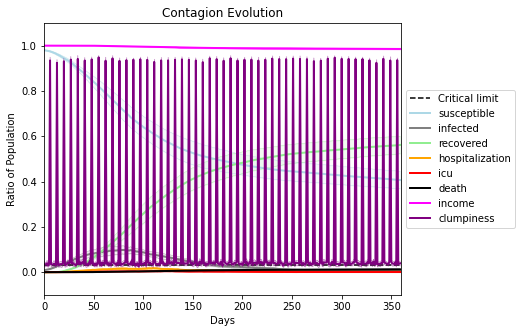

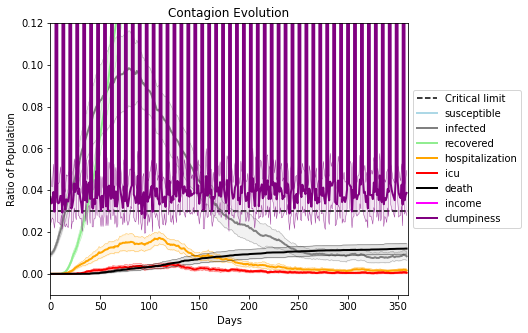

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9615, 850, 9367, 9641, 3418, 2164, 4902, 3338, 6928, 9540, 6048, 756, 7744, 8227, 279, 693, 4502, 6854, 2489, 9450]
Average similarity between family members is 0.9227102861131302 at temperature -0.991
Average similarity between family and home is 0.9998625269125305 at temperature -1
Average similarity between students and their classroom is 0.534195485564426 at temperature -0.991
Average classroom occupancy is 3.898550724637681 and number classrooms is 69
Average similarity between workers is 0.8396460883359853 at temperature -0.991
Average office occupancy is 3.4974358974358974 and number offices is 195
Average friend similarity for adults: 0.8461459746042306 for kids: 0.6588096530487815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.4950060668690906
avg restaurant similarity 0.5496962838338707
avg restaurant similarity 0.5630317553265117
avg restaurant similarity 0.5593297316197992
avg restaurant similarity 0.5007393934900266
avg restaurant similarity 0.5920431147435546
avg restaurant similarity 0.46053366566895426
avg restaurant similarity 0.5382447436000519
avg restaurant similarity 0.589437933914582
avg restaurant similarity 0.560014298372178
avg restaurant similarity 0.5160824956491158
avg restaurant similarity 0.5222795988280717
avg restaurant similarity 0.5680099731638543
avg restaurant similarity 0.5612666838961589
avg restaurant similarity 0.5546851553335606
avg restaurant similarity 0.5745222897287482
avg restaurant similarity 0.5243289379819741
avg restaurant similarity 0.6085701010098112
avg restaurant similarity 0.5051155870775437
avg restaurant similarity 0.5848888466010571
avg restaurant similarity 0.5462189407650607
avg restaurant similarity 0.5778274285574788
avg restaur

avg restaurant similarity 0.513835289728321
avg restaurant similarity 0.5404234360790372
avg restaurant similarity 0.5221699151867919
avg restaurant similarity 0.542154178005039
avg restaurant similarity 0.5455765233443208
avg restaurant similarity 0.5265769448872494
avg restaurant similarity 0.5462949296924408
avg restaurant similarity 0.5473825875291537
avg restaurant similarity 0.5355810700735619
avg restaurant similarity 0.49291299667453864
avg restaurant similarity 0.5321322365658477
avg restaurant similarity 0.5369402958538754
avg restaurant similarity 0.5222159330474763
avg restaurant similarity 0.5333458288249106
avg restaurant similarity 0.5114168852616305
avg restaurant similarity 0.5795065578706622
avg restaurant similarity 0.4894693481184547
avg restaurant similarity 0.5173796348191579
avg restaurant similarity 0.5537271296306793
avg restaurant similarity 0.540886292938071
avg restaurant similarity 0.5038476724767548
avg restaurant similarity 0.5304911567856767
avg restaura

avg restaurant similarity 0.5535471892100812
avg restaurant similarity 0.5522015048607443
avg restaurant similarity 0.5503433701152277
avg restaurant similarity 0.548043462220667
avg restaurant similarity 0.6551320580240315
avg restaurant similarity 0.502263397353372
avg restaurant similarity 0.5080151765164364
avg restaurant similarity 0.5664101910805978
avg restaurant similarity 0.5300051024566789
avg restaurant similarity 0.49685491319106456
avg restaurant similarity 0.5711007166236686
avg restaurant similarity 0.5200235878868885
avg restaurant similarity 0.5079505140439398
avg restaurant similarity 0.538675334487764
avg restaurant similarity 0.5430994620828199
avg restaurant similarity 0.5943531392761862
avg restaurant similarity 0.4615568250081893
avg restaurant similarity 0.5303659523610991
avg restaurant similarity 0.5354973111335465
avg restaurant similarity 0.5769281671048311
avg restaurant similarity 0.5389019927263735
avg restaurant similarity 0.5465965462212169
avg restaura

avg restaurant similarity 0.5783430533196998
avg restaurant similarity 0.5315892378237369
avg restaurant similarity 0.5027853367437937
avg restaurant similarity 0.5750012669631593
avg restaurant similarity 0.5273177621905408
avg restaurant similarity 0.5541859995123306
avg restaurant similarity 0.483696839478605
avg restaurant similarity 0.5116842026765324
avg restaurant similarity 0.5316262167657528
avg restaurant similarity 0.4836293458264066
avg restaurant similarity 0.5593679841773583
avg restaurant similarity 0.5484997966055851
avg restaurant similarity 0.518103021207584
avg restaurant similarity 0.5484321472221299
avg restaurant similarity 0.540056541452829
avg restaurant similarity 0.49396233114370425
avg restaurant similarity 0.5369351477300377
avg restaurant similarity 0.52644816580403
avg restaurant similarity 0.5105220563592574
avg restaurant similarity 0.5699090869951149
avg restaurant similarity 0.5495825022507587
avg restaurant similarity 0.5346183525282625
avg restaurant

avg restaurant similarity 0.4987738154954852
avg restaurant similarity 0.5532704927427025
avg restaurant similarity 0.5616880951001512
avg restaurant similarity 0.5663834179471914
avg restaurant similarity 0.4929559597509008
avg restaurant similarity 0.540641113359709
avg restaurant similarity 0.53874215195632
avg restaurant similarity 0.5200976967784978
avg restaurant similarity 0.46741244200330406
avg restaurant similarity 0.5528117877505172
avg restaurant similarity 0.5221946876982353
avg restaurant similarity 0.5665768989586667
avg restaurant similarity 0.5033830358298284
avg restaurant similarity 0.5602468157619553
avg restaurant similarity 0.5573338250543354
avg restaurant similarity 0.537655976018756
avg restaurant similarity 0.5353141060506291
avg restaurant similarity 0.5306354672898509
avg restaurant similarity 0.5379256216959438
avg restaurant similarity 0.5652809579089997
avg restaurant similarity 0.5249228441516045
avg restaurant similarity 0.49985755897382345
avg restaura

avg restaurant similarity 0.5083513386715741
avg restaurant similarity 0.5432254660454509
avg restaurant similarity 0.42837977835972907
avg restaurant similarity 0.5455262490580542
avg restaurant similarity 0.5455761483877474
avg restaurant similarity 0.564639449864763
avg restaurant similarity 0.5153385564729162
avg restaurant similarity 0.5338213587111525
avg restaurant similarity 0.5412256331462049
avg restaurant similarity 0.5293137764781892
avg restaurant similarity 0.5276226437070538
avg restaurant similarity 0.5577148006604311
avg restaurant similarity 0.5138381760346391
avg restaurant similarity 0.5063024292785121
avg restaurant similarity 0.49056678703930595
avg restaurant similarity 0.5208950795803642
avg restaurant similarity 0.5056548122089454
avg restaurant similarity 0.5093653601340196
avg restaurant similarity 0.5220810457939007
avg restaurant similarity 0.5440364170149142
avg restaurant similarity 0.6283011628572563
avg restaurant similarity 0.5400409380536831
avg resta

avg restaurant similarity 0.5049884639136907
avg restaurant similarity 0.5286034329861395
avg restaurant similarity 0.4990344121724081
avg restaurant similarity 0.4361849497875203
avg restaurant similarity 0.48914092886884275
avg restaurant similarity 0.5241578214298112
avg restaurant similarity 0.494053866525672
avg restaurant similarity 0.4633618669867194
avg restaurant similarity 0.47154028839485906
avg restaurant similarity 0.5118134964709838
avg restaurant similarity 0.48542537277861275
avg restaurant similarity 0.4758259451432364
avg restaurant similarity 0.48893773382119277
avg restaurant similarity 0.46870503015334886
avg restaurant similarity 0.4878000843728106
avg restaurant similarity 0.4668377569612714
avg restaurant similarity 0.4974531002531559
avg restaurant similarity 0.5204575899680783
avg restaurant similarity 0.4902595620795263
avg restaurant similarity 0.5400819510604211
avg restaurant similarity 0.4827855110003525
avg restaurant similarity 0.4959112190700182
avg re

avg restaurant similarity 0.4970839076438252
avg restaurant similarity 0.5019103779562748
avg restaurant similarity 0.5043290370839077
avg restaurant similarity 0.4763741696170038
avg restaurant similarity 0.5160145060253859
avg restaurant similarity 0.4828631395055372
avg restaurant similarity 0.5488384726940155
avg restaurant similarity 0.4959738915319277
avg restaurant similarity 0.4716372996354039
avg restaurant similarity 0.47941709938850796
avg restaurant similarity 0.5116917280806401
avg restaurant similarity 0.5154687131163683
avg restaurant similarity 0.5016481954920557
avg restaurant similarity 0.4573323024862756
avg restaurant similarity 0.5181050088619751
avg restaurant similarity 0.48807323133392794
avg restaurant similarity 0.5106948281219194
avg restaurant similarity 0.47355633680866405
avg restaurant similarity 0.5306240420674998
avg restaurant similarity 0.5112399676066414
avg restaurant similarity 0.5156223418701472
avg restaurant similarity 0.5365972688054836
avg res

avg restaurant similarity 0.5424371205891431
avg restaurant similarity 0.5279310567145916
avg restaurant similarity 0.5380953512043004
avg restaurant similarity 0.5100584500386168
avg restaurant similarity 0.5968050867542753
avg restaurant similarity 0.5163494975430571
avg restaurant similarity 0.5442614806340499
avg restaurant similarity 0.5817455034728727
avg restaurant similarity 0.5675813078662484
avg restaurant similarity 0.5872844441917097
avg restaurant similarity 0.5157780179040596
avg restaurant similarity 0.5389299104470873
avg restaurant similarity 0.5085289511722565
avg restaurant similarity 0.5512095082941392
avg restaurant similarity 0.5081118421617589
avg restaurant similarity 0.46059110447620993
avg restaurant similarity 0.48444387887917323
avg restaurant similarity 0.5287698815130968
avg restaurant similarity 0.5074942470270335
avg restaurant similarity 0.5135077202332625
avg restaurant similarity 0.5370897032108426
avg restaurant similarity 0.47580148066098543
avg res

avg restaurant similarity 0.5623572694072592
avg restaurant similarity 0.5693596902536496
avg restaurant similarity 0.5747580284948666
avg restaurant similarity 0.5488379434269167
avg restaurant similarity 0.5484658067785209
avg restaurant similarity 0.4956822769221984
avg restaurant similarity 0.5916864968937077
avg restaurant similarity 0.5139828853100488
avg restaurant similarity 0.5189760685059349
avg restaurant similarity 0.5264672143070391
avg restaurant similarity 0.5327613517872657
avg restaurant similarity 0.5096012943989562
avg restaurant similarity 0.5873438836455703
avg restaurant similarity 0.5476991836482411
avg restaurant similarity 0.577685966836872
avg restaurant similarity 0.5140468124430082
avg restaurant similarity 0.5119622173306623
avg restaurant similarity 0.566043833197551
avg restaurant similarity 0.5215862163428824
avg restaurant similarity 0.4735430093494372
avg restaurant similarity 0.5328412325900297
avg restaurant similarity 0.5502335539497502
avg restaura

avg restaurant similarity 0.49624720117634313
avg restaurant similarity 0.5471924973220393
avg restaurant similarity 0.5371165134679975
avg restaurant similarity 0.5326086657574708
avg restaurant similarity 0.5124865356469225
avg restaurant similarity 0.5343704411665123
avg restaurant similarity 0.5570741484627955
avg restaurant similarity 0.506069671881908
avg restaurant similarity 0.5635903538021901
avg restaurant similarity 0.5515938730895819
avg restaurant similarity 0.566245085146021
avg restaurant similarity 0.5441445133727077
avg restaurant similarity 0.5153905391710029
avg restaurant similarity 0.5369210378845094
avg restaurant similarity 0.53939734826396
avg restaurant similarity 0.5658828689566697
avg restaurant similarity 0.5103362222362207
avg restaurant similarity 0.5599997246320072
avg restaurant similarity 0.5693260860593994
avg restaurant similarity 0.5495597859723484
avg restaurant similarity 0.48444166530653027
avg restaurant similarity 0.5777544685954096
avg restaura

avg restaurant similarity 0.524527265071278
avg restaurant similarity 0.5591650789108639
avg restaurant similarity 0.5474020059022585
avg restaurant similarity 0.575993067410273
avg restaurant similarity 0.5497311106412909
avg restaurant similarity 0.5545347614522437
avg restaurant similarity 0.47953319510877956
avg restaurant similarity 0.5450434720588277
avg restaurant similarity 0.5249220001871872
avg restaurant similarity 0.5355382926198153
avg restaurant similarity 0.5556035272537747
avg restaurant similarity 0.5528548752252033
avg restaurant similarity 0.5179314112510197
avg restaurant similarity 0.5158258942284437
avg restaurant similarity 0.5548576399734494
avg restaurant similarity 0.5090736142191677
avg restaurant similarity 0.514893783175246
avg restaurant similarity 0.5192654621541269
avg restaurant similarity 0.5238159607107061
avg restaurant similarity 0.5350197931725906
avg restaurant similarity 0.546678420603729
avg restaurant similarity 0.5591700772311218
avg restauran

avg restaurant similarity 0.4880872557061872
avg restaurant similarity 0.5610470609567938
avg restaurant similarity 0.478658193349827
avg restaurant similarity 0.5138283802599114
avg restaurant similarity 0.5183764449276861
avg restaurant similarity 0.44607764181759707
avg restaurant similarity 0.4710840917728469
avg restaurant similarity 0.4929031099832519
avg restaurant similarity 0.48548691744108785
avg restaurant similarity 0.5282506522683822
avg restaurant similarity 0.5264510112979014
avg restaurant similarity 0.4869726061280734
avg restaurant similarity 0.5253314458532005
avg restaurant similarity 0.5184938627895165
avg restaurant similarity 0.5193421710301676
avg restaurant similarity 0.496531462532319
avg restaurant similarity 0.4768770456448122
avg restaurant similarity 0.49358746165150114
avg restaurant similarity 0.49533757053992095
avg restaurant similarity 0.5073866221786345
avg restaurant similarity 0.47490471137389223
avg restaurant similarity 0.5397552333837562
avg res

avg restaurant similarity 0.49468376065141784
avg restaurant similarity 0.4848033188763915
avg restaurant similarity 0.5038345558913545
avg restaurant similarity 0.5154930333836113
avg restaurant similarity 0.5063763032218445
avg restaurant similarity 0.5299268774902878
avg restaurant similarity 0.5054114529729052
avg restaurant similarity 0.44032720355394944
avg restaurant similarity 0.48766718029030126
avg restaurant similarity 0.5024228372672611
avg restaurant similarity 0.4499408826763138
avg restaurant similarity 0.556470793248006
avg restaurant similarity 0.515917511595882
avg restaurant similarity 0.5000568675341835
avg restaurant similarity 0.43828975775102647
avg restaurant similarity 0.5195096661178328
avg restaurant similarity 0.5387767304268428
avg restaurant similarity 0.5304721297926502
avg restaurant similarity 0.4950262976378352
avg restaurant similarity 0.5063008543930583
avg restaurant similarity 0.5050851115471088
avg restaurant similarity 0.4813901664909532
avg rest

avg restaurant similarity 0.5553257003231247
avg restaurant similarity 0.5197703560701823
avg restaurant similarity 0.5859494276195091
avg restaurant similarity 0.5089807035368272
avg restaurant similarity 0.47649016373074504
avg restaurant similarity 0.54277064074526
avg restaurant similarity 0.5448584067377534
avg restaurant similarity 0.5228860951069771
avg restaurant similarity 0.5325278641038381
avg restaurant similarity 0.5782942961164691
avg restaurant similarity 0.49997621850575313
avg restaurant similarity 0.5121886413410324
avg restaurant similarity 0.4946116210723305
avg restaurant similarity 0.5242801109377647
avg restaurant similarity 0.5424826515092587
avg restaurant similarity 0.5302805105592089
avg restaurant similarity 0.447960002854084
avg restaurant similarity 0.4927484488740497
avg restaurant similarity 0.5381348999277038
avg restaurant similarity 0.5376218490896513
avg restaurant similarity 0.5195621010446149
avg restaurant similarity 0.5876869955508518
avg restaur

avg restaurant similarity 0.5502225129278011
avg restaurant similarity 0.5375559936668047
avg restaurant similarity 0.5462502241655313
avg restaurant similarity 0.5381091321419925
avg restaurant similarity 0.5437742449574475
avg restaurant similarity 0.5543210865915035
avg restaurant similarity 0.5343613791470676
avg restaurant similarity 0.5202904703332244
avg restaurant similarity 0.5599457091199749
avg restaurant similarity 0.5858108562000929
avg restaurant similarity 0.5334735101301817
avg restaurant similarity 0.4967843633418577
avg restaurant similarity 0.6016743236827774
avg restaurant similarity 0.4973844316772135
avg restaurant similarity 0.5502336579195467
avg restaurant similarity 0.4972887417689261
avg restaurant similarity 0.5150951272876697
avg restaurant similarity 0.47474417486631953
avg restaurant similarity 0.5351974759270892
avg restaurant similarity 0.5110302499288966
avg restaurant similarity 0.5100734115717878
avg restaurant similarity 0.5095722964257686
avg resta

avg restaurant similarity 0.5501265950962371
avg restaurant similarity 0.5574444948909767
avg restaurant similarity 0.566299106783505
avg restaurant similarity 0.614532753457484
avg restaurant similarity 0.49419228969604617
avg restaurant similarity 0.5177141275728164
avg restaurant similarity 0.5015089946702683
avg restaurant similarity 0.4911203899028609
avg restaurant similarity 0.5569920746813432
avg restaurant similarity 0.556604770967899
avg restaurant similarity 0.5532404606070551
avg restaurant similarity 0.539468156728244
avg restaurant similarity 0.5472970188500886
avg restaurant similarity 0.5032257886534421
avg restaurant similarity 0.49248043712028583
avg restaurant similarity 0.5623407802359202
avg restaurant similarity 0.5099426588770649
avg restaurant similarity 0.5955843775060466
avg restaurant similarity 0.5494888981150664
avg restaurant similarity 0.5157837931232361
avg restaurant similarity 0.5174477692239636
avg restaurant similarity 0.5765382260928801
avg restaura

avg restaurant similarity 0.5093419821254167
avg restaurant similarity 0.5816237271171345
avg restaurant similarity 0.5642587079371069
avg restaurant similarity 0.5108265770792708
avg restaurant similarity 0.47775429768336924
avg restaurant similarity 0.5074667971732079
avg restaurant similarity 0.5580993224280728
avg restaurant similarity 0.49136739169172644
avg restaurant similarity 0.5037272242235357
avg restaurant similarity 0.5839006918632945
avg restaurant similarity 0.540780579597431
avg restaurant similarity 0.5594594355179628
avg restaurant similarity 0.5784916298456725
avg restaurant similarity 0.5004108638066104
avg restaurant similarity 0.48053963490040436
avg restaurant similarity 0.5173015321874549
avg restaurant similarity 0.5644388255074483
avg restaurant similarity 0.5565926342247913
avg restaurant similarity 0.555367907484128
avg restaurant similarity 0.5280769364533959
avg restaurant similarity 0.4956743243353617
avg restaurant similarity 0.6088294881644231
avg resta

avg restaurant similarity 0.584125282888049
avg restaurant similarity 0.5698236737810973
avg restaurant similarity 0.5353225540270392
avg restaurant similarity 0.5334131363766884
avg restaurant similarity 0.574545825418452
avg restaurant similarity 0.5280747341706908
avg restaurant similarity 0.5062379854880411
avg restaurant similarity 0.5515132199114011
avg restaurant similarity 0.5182945394996648
avg restaurant similarity 0.5046926054566462
avg restaurant similarity 0.5191066092212843
avg restaurant similarity 0.5663731680571855
avg restaurant similarity 0.48821787131114047
avg restaurant similarity 0.5534933176475035
avg restaurant similarity 0.5349459914570189
avg restaurant similarity 0.5318034153574753
avg restaurant similarity 0.5814488404081063
avg restaurant similarity 0.5293272026014352
avg restaurant similarity 0.5375201027184656
avg restaurant similarity 0.5273792633904211
avg restaurant similarity 0.5540923676158208
avg restaurant similarity 0.5135992307143711
avg restaur

avg restaurant similarity 0.517094489815
avg restaurant similarity 0.5332305962667451
avg restaurant similarity 0.5126233241069326
avg restaurant similarity 0.45543492024284576
avg restaurant similarity 0.5325166664010202
avg restaurant similarity 0.501809083064564
avg restaurant similarity 0.5506226658064087
avg restaurant similarity 0.5378070607483467
avg restaurant similarity 0.5103709971579566
avg restaurant similarity 0.48807368688934716
avg restaurant similarity 0.5086110763288035
avg restaurant similarity 0.4923977691537425
avg restaurant similarity 0.5209804427434725
avg restaurant similarity 0.5118765830779967
avg restaurant similarity 0.4970473429546849
avg restaurant similarity 0.5002457239082845
avg restaurant similarity 0.4985228232484182
avg restaurant similarity 0.5207664227696349
avg restaurant similarity 0.5390355055286936
avg restaurant similarity 0.4953839296345042
avg restaurant similarity 0.4916406732551602
avg restaurant similarity 0.5543775484427743
avg restauran

avg restaurant similarity 0.5515313001596742
avg restaurant similarity 0.4704377629784317
avg restaurant similarity 0.4980223434358863
avg restaurant similarity 0.5227471214544634
avg restaurant similarity 0.521202291254271
avg restaurant similarity 0.5113536775858976
avg restaurant similarity 0.48722866968024253
avg restaurant similarity 0.4840942545600923
avg restaurant similarity 0.49606207169940275
avg restaurant similarity 0.49310324217926776
avg restaurant similarity 0.49625958919044855
avg restaurant similarity 0.5199601921166834
avg restaurant similarity 0.5010911677677834
avg restaurant similarity 0.47972976449560145
avg restaurant similarity 0.48807339136553357
avg restaurant similarity 0.5332647098480683
avg restaurant similarity 0.5506587896756473
avg restaurant similarity 0.5563421960502741
avg restaurant similarity 0.5282264870658936
avg restaurant similarity 0.5213653476747241
avg restaurant similarity 0.4548428059956963
avg restaurant similarity 0.5530737657784248
avg r

avg restaurant similarity 0.5593872217833925
avg restaurant similarity 0.4921920381770393
avg restaurant similarity 0.5576703352632866
avg restaurant similarity 0.5199165095337818
avg restaurant similarity 0.4560422070603421
avg restaurant similarity 0.46187481735647534
avg restaurant similarity 0.5098193423756064
avg restaurant similarity 0.5261414913877153
avg restaurant similarity 0.5374780192281816
avg restaurant similarity 0.5185579383567047
avg restaurant similarity 0.5129922360893721
avg restaurant similarity 0.5564653538142257
avg restaurant similarity 0.528014201325727
avg restaurant similarity 0.5404807550805661
avg restaurant similarity 0.5607259467074175
avg restaurant similarity 0.5150259323013718
avg restaurant similarity 0.5109742438850615
avg restaurant similarity 0.5407611593416577
avg restaurant similarity 0.5589068188218813
avg restaurant similarity 0.5445164618841455
avg restaurant similarity 0.512762612374465
avg restaurant similarity 0.5112606539707574
avg restaur

avg restaurant similarity 0.5398039284412186
avg restaurant similarity 0.5076380874169887
avg restaurant similarity 0.5324195659697389
avg restaurant similarity 0.5208913687315829
avg restaurant similarity 0.49793325653798387
avg restaurant similarity 0.49586639771329566
avg restaurant similarity 0.5512271792263579
avg restaurant similarity 0.5298648713716843
avg restaurant similarity 0.5431503630284971
avg restaurant similarity 0.5109945110529309
avg restaurant similarity 0.5126236970578336
avg restaurant similarity 0.5404191198764036
avg restaurant similarity 0.51733354267358
avg restaurant similarity 0.5118691620623577
avg restaurant similarity 0.5592073525808778
avg restaurant similarity 0.5486741097273162
avg restaurant similarity 0.5680546137441036
avg restaurant similarity 0.5055767014962683
avg restaurant similarity 0.4946960029149904
avg restaurant similarity 0.5566459430708183
avg restaurant similarity 0.5109246584508305
avg restaurant similarity 0.5255813239641001
avg restau

avg restaurant similarity 0.466362128497022
avg restaurant similarity 0.4363071844893115
avg restaurant similarity 0.5069659137085168
avg restaurant similarity 0.4838308008117176
avg restaurant similarity 0.5061794714131886
avg restaurant similarity 0.5006027056301977
avg restaurant similarity 0.49866912411081477
avg restaurant similarity 0.5212275937908161
avg restaurant similarity 0.4949765646822671
avg restaurant similarity 0.5064668499129288
avg restaurant similarity 0.4810263780340982
avg restaurant similarity 0.43947904355691425
avg restaurant similarity 0.5351176454302722
avg restaurant similarity 0.48310058492908486
avg restaurant similarity 0.47118501289322395
avg restaurant similarity 0.5074049855008979
avg restaurant similarity 0.49120136102025147
avg restaurant similarity 0.5204544446011407
avg restaurant similarity 0.4811686592099116
avg restaurant similarity 0.4858198550439402
avg restaurant similarity 0.5177404324733035
avg restaurant similarity 0.508667081784272
avg res

avg restaurant similarity 0.600451498440555
avg restaurant similarity 0.55383317514761
avg restaurant similarity 0.5166884313607567
avg restaurant similarity 0.5352330141860957
avg restaurant similarity 0.5619525910745218
avg restaurant similarity 0.5521291516444184
avg restaurant similarity 0.5157956681378123
avg restaurant similarity 0.5356033300916311
avg restaurant similarity 0.5089319955358125
avg restaurant similarity 0.5392578511596062
avg restaurant similarity 0.5278598485911135
avg restaurant similarity 0.5578215972205163
avg restaurant similarity 0.5408035168449353
avg restaurant similarity 0.5698656546813946
avg restaurant similarity 0.5301894361174331
avg restaurant similarity 0.6059569591047428
avg restaurant similarity 0.5073841362923325
avg restaurant similarity 0.5485967535992483
avg restaurant similarity 0.527770454207754
avg restaurant similarity 0.5682223308018934
avg restaurant similarity 0.604705901030705
avg restaurant similarity 0.5126282961859858
avg restaurant 

avg restaurant similarity 0.5368117238209834
avg restaurant similarity 0.5250702972553583
avg restaurant similarity 0.5843388965529185
avg restaurant similarity 0.5737744393142292
avg restaurant similarity 0.5218451239631554
avg restaurant similarity 0.5589087143042403
avg restaurant similarity 0.502831302746387
avg restaurant similarity 0.5683513318046992
avg restaurant similarity 0.4944160858732979
avg restaurant similarity 0.5390279322050626
avg restaurant similarity 0.4896558545701654
avg restaurant similarity 0.5485710995550024
avg restaurant similarity 0.5559632518512785
avg restaurant similarity 0.5186916760383579
avg restaurant similarity 0.5078329486245127
avg restaurant similarity 0.5601215459166705
avg restaurant similarity 0.5641478334849257
avg restaurant similarity 0.5468510855936134
avg restaurant similarity 0.5981174512613686
avg restaurant similarity 0.5444909383639983
avg restaurant similarity 0.5689541834983509
avg restaurant similarity 0.5499199078813549
avg restaur

avg restaurant similarity 0.4874937344613065
avg restaurant similarity 0.40448746995896767
avg restaurant similarity 0.52493274594776
avg restaurant similarity 0.5447877001474937
avg restaurant similarity 0.45392059690586656
avg restaurant similarity 0.4810643814580567
avg restaurant similarity 0.4387573854421745
avg restaurant similarity 0.4693437989606958
avg restaurant similarity 0.5699316833040401
avg restaurant similarity 0.444607241285495
avg restaurant similarity 0.5038920637161179
avg restaurant similarity 0.5543843609343124
avg restaurant similarity 0.4872636010981555
avg restaurant similarity 0.4906518135223753
avg restaurant similarity 0.46277640517424445
avg restaurant similarity 0.4989604818231204
avg restaurant similarity 0.5352078029817083
avg restaurant similarity 0.4378609808342007
avg restaurant similarity 0.4955015689369258
avg restaurant similarity 0.5758934991846167
avg restaurant similarity 0.44055480414232395
avg restaurant similarity 0.48574134502646465
avg rest

avg restaurant similarity 0.5382143057351159
avg restaurant similarity 0.5491436197666988
avg restaurant similarity 0.45876872718786577
avg restaurant similarity 0.5486989710286336
avg restaurant similarity 0.489793241483615
avg restaurant similarity 0.4697886407894489
avg restaurant similarity 0.6034012044172736
avg restaurant similarity 0.5170134303554076
avg restaurant similarity 0.49896833682555336
avg restaurant similarity 0.4962029242193457
avg restaurant similarity 0.43564430514302827
avg restaurant similarity 0.5349578247454227
avg restaurant similarity 0.49362039588306644
avg restaurant similarity 0.5345659190267518
avg restaurant similarity 0.477966840212378
avg restaurant similarity 0.5030170914953713
avg restaurant similarity 0.41358978422713477
avg restaurant similarity 0.5258975061405218
avg restaurant similarity 0.5252336703469973
avg restaurant similarity 0.4893692080546165
avg restaurant similarity 0.5362879661604173
avg restaurant similarity 0.5102661290399158
avg res

avg restaurant similarity 0.5257981599012911
avg restaurant similarity 0.5297847793736443
avg restaurant similarity 0.5126783078287803
avg restaurant similarity 0.5345760084400515
avg restaurant similarity 0.5748569457727917
avg restaurant similarity 0.5892127354686775
avg restaurant similarity 0.5635746813774989
avg restaurant similarity 0.5627122745359076
avg restaurant similarity 0.5533020595621164
avg restaurant similarity 0.5660628662977254
avg restaurant similarity 0.5111039229279406
avg restaurant similarity 0.508573696962784
avg restaurant similarity 0.5724188287952351
avg restaurant similarity 0.5222482952221517
avg restaurant similarity 0.5294982894290052
avg restaurant similarity 0.4871981978679846
avg restaurant similarity 0.5226952488166742
avg restaurant similarity 0.5663847428209609
avg restaurant similarity 0.5317610769393155
avg restaurant similarity 0.5913650024788377
avg restaurant similarity 0.5527215465964125
avg restaurant similarity 0.5905527110066282
avg restaur

avg restaurant similarity 0.5918183396294943
avg restaurant similarity 0.4903885646575584
avg restaurant similarity 0.5565304705168198
avg restaurant similarity 0.5677923985826651
avg restaurant similarity 0.5585908873322912
avg restaurant similarity 0.5798293588902257
avg restaurant similarity 0.52545423312561
avg restaurant similarity 0.5602537837200147
avg restaurant similarity 0.5579917204596444
avg restaurant similarity 0.4941006375008674
avg restaurant similarity 0.5336343154110648
avg restaurant similarity 0.5215306280912514
avg restaurant similarity 0.5474487121030696
avg restaurant similarity 0.5427383767788548
avg restaurant similarity 0.5733426381862666
avg restaurant similarity 0.5303223517874527
avg restaurant similarity 0.5357290879984952
avg restaurant similarity 0.5026185975811857
avg restaurant similarity 0.5528526313107913
avg restaurant similarity 0.5919027132103944
avg restaurant similarity 0.5275607805710189
avg restaurant similarity 0.5704853353879259
avg restaura

avg restaurant similarity 0.5623786047763456
avg restaurant similarity 0.5454902640068651
avg restaurant similarity 0.5530538083755596
avg restaurant similarity 0.49948340759532367
avg restaurant similarity 0.5128775457626636
avg restaurant similarity 0.5368572650345551
avg restaurant similarity 0.46382139968117814
avg restaurant similarity 0.5628012554986545
avg restaurant similarity 0.5271509371256846
avg restaurant similarity 0.5548606242606791
avg restaurant similarity 0.572895552148591
avg restaurant similarity 0.5260152328727146
avg restaurant similarity 0.5394595029806663
avg restaurant similarity 0.499939268359111
avg restaurant similarity 0.5051662977071328
avg restaurant similarity 0.5120753946593928
avg restaurant similarity 0.5740484525553536
avg restaurant similarity 0.49291416554473966
avg restaurant similarity 0.47732453503382677
avg restaurant similarity 0.5463096861070682
avg restaurant similarity 0.5334691801227424
avg restaurant similarity 0.4929808404768048
avg rest

avg restaurant similarity 0.5630436280037898
avg restaurant similarity 0.4899562894564514
avg restaurant similarity 0.4939157060360014
avg restaurant similarity 0.5333882892707001
avg restaurant similarity 0.5393215668739955
avg restaurant similarity 0.5442670090029035
avg restaurant similarity 0.5499830169916291
avg restaurant similarity 0.4563091583085083
avg restaurant similarity 0.5133053774679761
avg restaurant similarity 0.5441910227394372
avg restaurant similarity 0.5457571378086123
avg restaurant similarity 0.5480557103304974
avg restaurant similarity 0.5286520015188455
avg restaurant similarity 0.4859677479062025
avg restaurant similarity 0.5027279441202509
avg restaurant similarity 0.4787724795998868
avg restaurant similarity 0.5041973865092586
avg restaurant similarity 0.5346045905998488
avg restaurant similarity 0.5439926743342718
avg restaurant similarity 0.5508545699607943
avg restaurant similarity 0.5902215617308034
avg restaurant similarity 0.48976894301254315
avg resta

avg restaurant similarity 0.5548738729968395
avg restaurant similarity 0.45404357095758474
avg restaurant similarity 0.5022894803710075
avg restaurant similarity 0.5423868090810201
avg restaurant similarity 0.5132506737425605
avg restaurant similarity 0.502608294488271
avg restaurant similarity 0.5490967897235324
avg restaurant similarity 0.5724800794100153
avg restaurant similarity 0.5785495655119618
avg restaurant similarity 0.6057223631407481
avg restaurant similarity 0.5305309770933824
avg restaurant similarity 0.5624034905100377
avg restaurant similarity 0.5154095286393687
avg restaurant similarity 0.5083271386705328
avg restaurant similarity 0.5128943638540014
avg restaurant similarity 0.5019019466486446
avg restaurant similarity 0.5309386111748633
avg restaurant similarity 0.5550371379667536
avg restaurant similarity 0.5283091849316924
avg restaurant similarity 0.4731691121341721
avg restaurant similarity 0.5631267128580141
avg restaurant similarity 0.5155696536615774
avg restau

avg restaurant similarity 0.5316428560794378
avg restaurant similarity 0.5421773111199015
avg restaurant similarity 0.5431365622648306
avg restaurant similarity 0.5354136023844476
avg restaurant similarity 0.4984325059189691
avg restaurant similarity 0.5074810547165595
avg restaurant similarity 0.5431023838130475
avg restaurant similarity 0.5320478274919097
avg restaurant similarity 0.5418112326945049
avg restaurant similarity 0.5431092639295835
avg restaurant similarity 0.5665352057934274
avg restaurant similarity 0.5382091592397314
avg restaurant similarity 0.5672084142992782
avg restaurant similarity 0.4794159583047027
avg restaurant similarity 0.5299308733817593
avg restaurant similarity 0.5072369002708432
avg restaurant similarity 0.521319071900987
avg restaurant similarity 0.4947975637127601
avg restaurant similarity 0.48816199326648274
avg restaurant similarity 0.5596901057254962
avg restaurant similarity 0.5659383018716276
avg restaurant similarity 0.5087095091328857
avg restau

avg restaurant similarity 0.46699861777274254
avg restaurant similarity 0.5321652009037046
avg restaurant similarity 0.49756567226394516
avg restaurant similarity 0.5472744327042861
avg restaurant similarity 0.544984760093574
avg restaurant similarity 0.5324663785868249
avg restaurant similarity 0.5316769901800247
avg restaurant similarity 0.5471186378351559
avg restaurant similarity 0.5006195331075638
avg restaurant similarity 0.5597705670095119
avg restaurant similarity 0.5145950741774477
avg restaurant similarity 0.5597687816450028
avg restaurant similarity 0.5575220621929076
avg restaurant similarity 0.5833398888338481
avg restaurant similarity 0.5452746332702387
avg restaurant similarity 0.44582554034181304
avg restaurant similarity 0.5163584700308448
avg restaurant similarity 0.5205854974285796
avg restaurant similarity 0.520173811817149
avg restaurant similarity 0.5129604378332727
avg restaurant similarity 0.5628512687009857
avg restaurant similarity 0.528357708733104
avg restau

avg restaurant similarity 0.49700297800798793
avg restaurant similarity 0.5331470463150677
avg restaurant similarity 0.5400751838559479
avg restaurant similarity 0.5201197187992178
avg restaurant similarity 0.5421313785477571
avg restaurant similarity 0.5373301730971992
avg restaurant similarity 0.4850626458727621
avg restaurant similarity 0.5194324248088774
avg restaurant similarity 0.5060898168715648
avg restaurant similarity 0.5203054127467075
avg restaurant similarity 0.5436425418734188
avg restaurant similarity 0.5053142390707523
avg restaurant similarity 0.5162362950106949
avg restaurant similarity 0.5376220029629011
avg restaurant similarity 0.5435754274032278
avg restaurant similarity 0.5693996360908113
avg restaurant similarity 0.5219477559784318
avg restaurant similarity 0.5366781080598265
avg restaurant similarity 0.5301232971906314
avg restaurant similarity 0.5294389067592693
avg restaurant similarity 0.5296000423967645
avg restaurant similarity 0.5041014470436085
avg resta

avg restaurant similarity 0.5151890269378812
avg restaurant similarity 0.4775869512190361
avg restaurant similarity 0.524857720104606
avg restaurant similarity 0.5175996134445725
avg restaurant similarity 0.5199134547861856
avg restaurant similarity 0.5148805910708604
avg restaurant similarity 0.5206007103620518
avg restaurant similarity 0.5264429584890555
avg restaurant similarity 0.4892052566433163
avg restaurant similarity 0.5040015118883482
avg restaurant similarity 0.45202027926192795
avg restaurant similarity 0.5401745740314473
avg restaurant similarity 0.5131662814401711
avg restaurant similarity 0.5329304055840608
avg restaurant similarity 0.5540065104778203
avg restaurant similarity 0.5512067185480918
avg restaurant similarity 0.5395509654584493
avg restaurant similarity 0.5027734626334522
avg restaurant similarity 0.5239881021725604
avg restaurant similarity 0.5033214093948546
avg restaurant similarity 0.5641239541121408
avg restaurant similarity 0.5387859238467219
avg restau

avg restaurant similarity 0.5070682638426116
avg restaurant similarity 0.49648412636643174
avg restaurant similarity 0.5707776545551053
avg restaurant similarity 0.5266362546349286
avg restaurant similarity 0.49175800125867963
avg restaurant similarity 0.5253437894450483
avg restaurant similarity 0.5372177940681194
avg restaurant similarity 0.539003213467898
avg restaurant similarity 0.5691786488503329
avg restaurant similarity 0.5474718401225973
avg restaurant similarity 0.5534771372912318
avg restaurant similarity 0.5082082954439019
avg restaurant similarity 0.5012708271354527
avg restaurant similarity 0.5709361658136287
avg restaurant similarity 0.5404604113919482
avg restaurant similarity 0.5326314325917163
avg restaurant similarity 0.5099209731421873
avg restaurant similarity 0.5358433278410814
avg restaurant similarity 0.5325224446796173
avg restaurant similarity 0.5164873636621813
avg restaurant similarity 0.5186069085255847
avg restaurant similarity 0.5380108667229963
avg resta

avg restaurant similarity 0.5071956535592599
avg restaurant similarity 0.5348423011325711
avg restaurant similarity 0.536390831009233
avg restaurant similarity 0.5431911202577246
avg restaurant similarity 0.5082990725322561
avg restaurant similarity 0.5087519847474702
avg restaurant similarity 0.5571944454656532
avg restaurant similarity 0.4956867816627059
avg restaurant similarity 0.5155297085003913
avg restaurant similarity 0.5024768325654899
avg restaurant similarity 0.45465004510168144
avg restaurant similarity 0.5285787164263619
avg restaurant similarity 0.5294330328455629
avg restaurant similarity 0.5455742627695557
avg restaurant similarity 0.5302215898198858
avg restaurant similarity 0.5029304698275606
avg restaurant similarity 0.5618296359157132
avg restaurant similarity 0.47899453367008316
avg restaurant similarity 0.5264765547478601
avg restaurant similarity 0.5137234369574666
avg restaurant similarity 0.5365946529982923
avg restaurant similarity 0.534858358265967
avg restau

avg restaurant similarity 0.5738886359091506
avg restaurant similarity 0.5487022998076483
avg restaurant similarity 0.5871638189731679
avg restaurant similarity 0.5395968577921003
avg restaurant similarity 0.5572717621070677
avg restaurant similarity 0.47915410521841734
avg restaurant similarity 0.5257017865751079
avg restaurant similarity 0.5089236384234975
avg restaurant similarity 0.5338298288876582
avg restaurant similarity 0.5422445837720389
avg restaurant similarity 0.5298491503465688
avg restaurant similarity 0.5415562598321626
avg restaurant similarity 0.5319873693755145
avg restaurant similarity 0.5216034491548047
avg restaurant similarity 0.5428444798387435
avg restaurant similarity 0.5467652830042727
avg restaurant similarity 0.554195378980319
avg restaurant similarity 0.5573213002509251
avg restaurant similarity 0.5319696889783601
avg restaurant similarity 0.5647925932419818
avg restaurant similarity 0.4981889329598766
avg restaurant similarity 0.5434832905313748
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

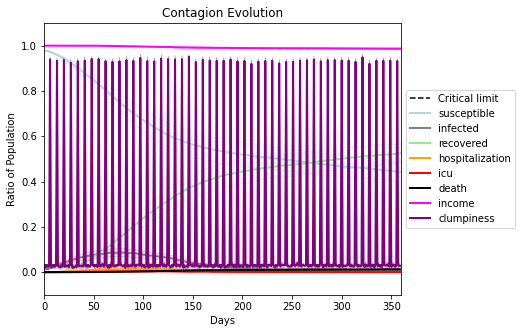

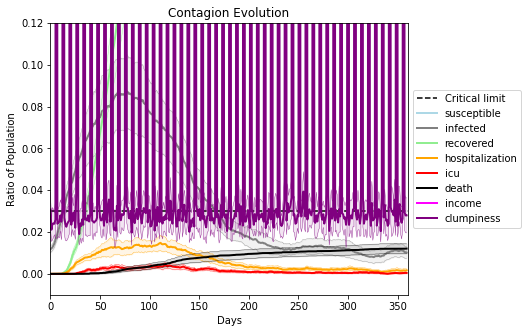

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4665, 4429, 5955, 3766, 3406, 781, 6006, 8154, 9911, 2029, 9516, 1450, 3611, 6466, 215, 4017, 7364, 9420, 699, 8480]
Average similarity between family members is 0.9147440367705345 at temperature -0.99
Average similarity between family and home is 0.9998549616154145 at temperature -1
Average similarity between students and their classroom is 0.4711497682289081 at temperature -0.99
Average classroom occupancy is 4.246376811594203 and number classrooms is 69
Average similarity between workers is 0.8266801570248585 at temperature -0.99
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.8352596194613715 for kids: 0.6503485621914945
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.5260282088296658
avg restaurant similarity 0.5065067219080338
avg restaurant similarity 0.4628195578033029
avg restaurant similarity 0.47744402346991
avg restaurant similarity 0.43585938344297376
avg restaurant similarity 0.4544828133778611
avg restaurant similarity 0.5543436158116576
avg restaurant similarity 0.45615142720103025
avg restaurant similarity 0.4938146041861543
avg restaurant similarity 0.45735633163273814
avg restaurant similarity 0.4544830852173099
avg restaurant similarity 0.4764790761588932
avg restaurant similarity 0.49821021881651145
avg restaurant similarity 0.46973837884768815
avg restaurant similarity 0.4288049003488083
avg restaurant similarity 0.5126115310667254
avg restaurant similarity 0.5575836092357228
avg restaurant similarity 0.46528137445498774
avg restaurant similarity 0.51638593231099
avg restaurant similarity 0.5655899412198897
avg restaurant similarity 0.5005247356024322
avg restaurant similarity 0.492001499530218
avg resta

avg restaurant similarity 0.5455995764479854
avg restaurant similarity 0.4934437268739941
avg restaurant similarity 0.47983400079243654
avg restaurant similarity 0.5724956997794005
avg restaurant similarity 0.5383399523636683
avg restaurant similarity 0.5270123560708934
avg restaurant similarity 0.4908133590447057
avg restaurant similarity 0.4810706944215751
avg restaurant similarity 0.5194427584163873
avg restaurant similarity 0.4929742783837979
avg restaurant similarity 0.48988929684213534
avg restaurant similarity 0.46287105813268753
avg restaurant similarity 0.5133491792684255
avg restaurant similarity 0.5232710975226702
avg restaurant similarity 0.5240124324988157
avg restaurant similarity 0.48324175685760795
avg restaurant similarity 0.44979875440055317
avg restaurant similarity 0.554659573435201
avg restaurant similarity 0.5193720288801555
avg restaurant similarity 0.5229401054796172
avg restaurant similarity 0.5513057600679502
avg restaurant similarity 0.5811064618887526
avg re

avg restaurant similarity 0.5023043767058726
avg restaurant similarity 0.49516817780330047
avg restaurant similarity 0.4746004439600334
avg restaurant similarity 0.49278351254553715
avg restaurant similarity 0.4525312302680356
avg restaurant similarity 0.5024597541484511
avg restaurant similarity 0.47827437564588215
avg restaurant similarity 0.459219151828549
avg restaurant similarity 0.5229427059240799
avg restaurant similarity 0.4956965942917114
avg restaurant similarity 0.49728048991367063
avg restaurant similarity 0.4998250090995383
avg restaurant similarity 0.46529405644526295
avg restaurant similarity 0.4701461972087164
avg restaurant similarity 0.5145009380259109
avg restaurant similarity 0.48667492783194477
avg restaurant similarity 0.4955547664571156
avg restaurant similarity 0.5318164019105504
avg restaurant similarity 0.4852283507302406
avg restaurant similarity 0.47468030110334336
avg restaurant similarity 0.5188955794282447
avg restaurant similarity 0.48715682462168836
avg

avg restaurant similarity 0.4532837854664002
avg restaurant similarity 0.5037581659784036
avg restaurant similarity 0.42707716870816975
avg restaurant similarity 0.48316544067691625
avg restaurant similarity 0.4893343604084518
avg restaurant similarity 0.5005565121326652
avg restaurant similarity 0.43924689421641216
avg restaurant similarity 0.512557004580153
avg restaurant similarity 0.4667582015910244
avg restaurant similarity 0.4558002074096986
avg restaurant similarity 0.48052350735432403
avg restaurant similarity 0.5293191852961596
avg restaurant similarity 0.49295048894402604
avg restaurant similarity 0.4907277828267075
avg restaurant similarity 0.5208059485551425
avg restaurant similarity 0.5150274300318792
avg restaurant similarity 0.47372884501219076
avg restaurant similarity 0.49173077882000726
avg restaurant similarity 0.46803276698290547
avg restaurant similarity 0.4860958188188554
avg restaurant similarity 0.4750788205929729
avg restaurant similarity 0.5164753776850808
avg

avg restaurant similarity 0.5125563054093645
avg restaurant similarity 0.5396529329396794
avg restaurant similarity 0.5513777286263974
avg restaurant similarity 0.4859403695809958
avg restaurant similarity 0.544076085046415
avg restaurant similarity 0.5257449006151346
avg restaurant similarity 0.5123758344083025
avg restaurant similarity 0.5332079693757126
avg restaurant similarity 0.5466293848514634
avg restaurant similarity 0.469137535100644
avg restaurant similarity 0.49805406276991676
avg restaurant similarity 0.5252971172793999
avg restaurant similarity 0.47594933213955926
avg restaurant similarity 0.49206513317447886
avg restaurant similarity 0.5660613198425698
avg restaurant similarity 0.5555378947836757
avg restaurant similarity 0.5085767771965448
avg restaurant similarity 0.5234327624664443
avg restaurant similarity 0.5377483431201285
avg restaurant similarity 0.5414976854267018
avg restaurant similarity 0.47534616084486114
avg restaurant similarity 0.5127163764875801
avg rest

avg restaurant similarity 0.5641577918400158
avg restaurant similarity 0.5292696984241383
avg restaurant similarity 0.5313228522237842
avg restaurant similarity 0.5344393184808123
avg restaurant similarity 0.5374719498006211
avg restaurant similarity 0.5093132583073317
avg restaurant similarity 0.5543904596362881
avg restaurant similarity 0.5037058839398394
avg restaurant similarity 0.4756182679399644
avg restaurant similarity 0.5484364349773236
avg restaurant similarity 0.5118295664185675
avg restaurant similarity 0.5459802603544952
avg restaurant similarity 0.5646276500313866
avg restaurant similarity 0.6062073001683796
avg restaurant similarity 0.4914388888741628
avg restaurant similarity 0.5755085939471313
avg restaurant similarity 0.4960049360215592
avg restaurant similarity 0.5360606205444304
avg restaurant similarity 0.5553638872952446
avg restaurant similarity 0.5961880643562923
avg restaurant similarity 0.5198178362394047
avg restaurant similarity 0.4644269423831568
avg restau

avg restaurant similarity 0.43530202754633146
avg restaurant similarity 0.5076373534084883
avg restaurant similarity 0.44680800924028996
avg restaurant similarity 0.4885689285724609
avg restaurant similarity 0.5026924065049834
avg restaurant similarity 0.4798758844906872
avg restaurant similarity 0.5363628443433716
avg restaurant similarity 0.526147098811971
avg restaurant similarity 0.5136774427628306
avg restaurant similarity 0.543077575284705
avg restaurant similarity 0.49088715089002904
avg restaurant similarity 0.4933092727175848
avg restaurant similarity 0.5273830094108398
avg restaurant similarity 0.4918081807575202
avg restaurant similarity 0.5407557256033114
avg restaurant similarity 0.5549496190689378
avg restaurant similarity 0.5305460807451507
avg restaurant similarity 0.5582457220363034
avg restaurant similarity 0.5236835073492709
avg restaurant similarity 0.5167975141589048
avg restaurant similarity 0.470667388213478
avg restaurant similarity 0.4859510448280645
avg restau

avg restaurant similarity 0.5236779633591925
avg restaurant similarity 0.4655367651779792
avg restaurant similarity 0.5098750856150727
avg restaurant similarity 0.5203066342960289
avg restaurant similarity 0.47129100740830543
avg restaurant similarity 0.54506750140178
avg restaurant similarity 0.5070112198585696
avg restaurant similarity 0.5028459700952586
avg restaurant similarity 0.49170522599327926
avg restaurant similarity 0.5451175442881551
avg restaurant similarity 0.5311179902690754
avg restaurant similarity 0.502064797920235
avg restaurant similarity 0.5177617172151565
avg restaurant similarity 0.5458368179572511
avg restaurant similarity 0.4973101459870194
avg restaurant similarity 0.5144637332191618
avg restaurant similarity 0.5443357272655724
avg restaurant similarity 0.4886040052064077
avg restaurant similarity 0.5361724978052447
avg restaurant similarity 0.5223130583739958
avg restaurant similarity 0.5158541728413718
avg restaurant similarity 0.486968403583128
avg restaura

avg restaurant similarity 0.4887637337782434
avg restaurant similarity 0.5641431442058189
avg restaurant similarity 0.591371210753529
avg restaurant similarity 0.4917266785382259
avg restaurant similarity 0.5391521136939533
avg restaurant similarity 0.5391232755214613
avg restaurant similarity 0.5258857253319528
avg restaurant similarity 0.5329237693980294
avg restaurant similarity 0.5169229649312803
avg restaurant similarity 0.5626995271438433
avg restaurant similarity 0.5419887548745227
avg restaurant similarity 0.500342161812361
avg restaurant similarity 0.5204240205520798
avg restaurant similarity 0.560509842424763
avg restaurant similarity 0.5149205234278729
avg restaurant similarity 0.5160578097143923
avg restaurant similarity 0.542437085325326
avg restaurant similarity 0.5064833646039917
avg restaurant similarity 0.4684564457174169
avg restaurant similarity 0.5183563775632506
avg restaurant similarity 0.526009421140431
avg restaurant similarity 0.51310778520785
avg restaurant si

avg restaurant similarity 0.5216569745686654
avg restaurant similarity 0.5012299506488593
avg restaurant similarity 0.5555968665681503
avg restaurant similarity 0.5330461176985322
avg restaurant similarity 0.50532019764389
avg restaurant similarity 0.5007786003849609
avg restaurant similarity 0.5423411893455722
avg restaurant similarity 0.5377675924535964
avg restaurant similarity 0.49108881482917033
avg restaurant similarity 0.4857088629229082
avg restaurant similarity 0.515097629917179
avg restaurant similarity 0.5483076486247381
avg restaurant similarity 0.5263962457457577
avg restaurant similarity 0.5580623639058653
avg restaurant similarity 0.4771413033148503
avg restaurant similarity 0.5253017211678715
avg restaurant similarity 0.5649680783293439
avg restaurant similarity 0.46795950150975674
avg restaurant similarity 0.5357637164549363
avg restaurant similarity 0.5376278336724124
avg restaurant similarity 0.5091874941403349
avg restaurant similarity 0.5158790588801705
avg restaur

avg restaurant similarity 0.5264189781919135
avg restaurant similarity 0.5601886900943646
avg restaurant similarity 0.4778275506465692
avg restaurant similarity 0.5338215782842944
avg restaurant similarity 0.4955028525945294
avg restaurant similarity 0.5393682841462433
avg restaurant similarity 0.5270376522367758
avg restaurant similarity 0.5322697265220785
avg restaurant similarity 0.5308025830907321
avg restaurant similarity 0.5017513358144585
avg restaurant similarity 0.5276191767742837
avg restaurant similarity 0.5010332980165598
avg restaurant similarity 0.5178028165788137
avg restaurant similarity 0.49483550534129994
avg restaurant similarity 0.5005465761871284
avg restaurant similarity 0.4896333685969463
avg restaurant similarity 0.4884327464448059
avg restaurant similarity 0.48643821032516166
avg restaurant similarity 0.48614830708299095
avg restaurant similarity 0.5209212762804251
avg restaurant similarity 0.5110754749635094
avg restaurant similarity 0.5417632859495666
avg res

avg restaurant similarity 0.5413047475704188
avg restaurant similarity 0.5277731216632092
avg restaurant similarity 0.4749266315827459
avg restaurant similarity 0.49069730771948655
avg restaurant similarity 0.473143979047705
avg restaurant similarity 0.4483184667759332
avg restaurant similarity 0.5460026403126926
avg restaurant similarity 0.5451508126491822
avg restaurant similarity 0.4624358155094725
avg restaurant similarity 0.48732989659527715
avg restaurant similarity 0.5029261538394787
avg restaurant similarity 0.524467948519398
avg restaurant similarity 0.5067957518839837
avg restaurant similarity 0.4786365522896685
avg restaurant similarity 0.494210962431844
avg restaurant similarity 0.4898855638271648
avg restaurant similarity 0.4952091211535518
avg restaurant similarity 0.4944857076878948
avg restaurant similarity 0.48938895389884224
avg restaurant similarity 0.48523921634532197
avg restaurant similarity 0.4879263163553376
avg restaurant similarity 0.458916692385231
avg restau

avg restaurant similarity 0.5102490756333972
avg restaurant similarity 0.5269499736924257
avg restaurant similarity 0.49226320835197884
avg restaurant similarity 0.48284545916554816
avg restaurant similarity 0.552529092754564
avg restaurant similarity 0.49242541919047067
avg restaurant similarity 0.5241674082771502
avg restaurant similarity 0.5030975537920674
avg restaurant similarity 0.49242121731226923
avg restaurant similarity 0.5881147462174922
avg restaurant similarity 0.5164538684031117
avg restaurant similarity 0.45453449207395313
avg restaurant similarity 0.5743105501871348
avg restaurant similarity 0.5518741195293387
avg restaurant similarity 0.5208793267481683
avg restaurant similarity 0.5186633233156206
avg restaurant similarity 0.5168987827384462
avg restaurant similarity 0.5005083940163334
avg restaurant similarity 0.5265155182040886
avg restaurant similarity 0.49457931036333946
avg restaurant similarity 0.4944731121335066
avg restaurant similarity 0.5423588717252183
avg r

avg restaurant similarity 0.47529534848329963
avg restaurant similarity 0.5274405356097487
avg restaurant similarity 0.48641371429747593
avg restaurant similarity 0.4896579433308214
avg restaurant similarity 0.4882807716703037
avg restaurant similarity 0.48630796264999615
avg restaurant similarity 0.47116929699407734
avg restaurant similarity 0.5622351583971734
avg restaurant similarity 0.5198911688883028
avg restaurant similarity 0.4574066828998821
avg restaurant similarity 0.48154075614915015
avg restaurant similarity 0.4817712246819291
avg restaurant similarity 0.4879222553696472
avg restaurant similarity 0.5013659158221531
avg restaurant similarity 0.4568746746033465
avg restaurant similarity 0.48485444268434846
avg restaurant similarity 0.5163388745888464
avg restaurant similarity 0.5071639831422674
avg restaurant similarity 0.4827480512129551
avg restaurant similarity 0.5239836046796049
avg restaurant similarity 0.5187318101741492
avg restaurant similarity 0.5225326831595537
avg 

avg restaurant similarity 0.5373227531788117
avg restaurant similarity 0.4311329574866355
avg restaurant similarity 0.5087369630588698
avg restaurant similarity 0.4838701601201852
avg restaurant similarity 0.476578580106569
avg restaurant similarity 0.4942830086387186
avg restaurant similarity 0.5250230316842034
avg restaurant similarity 0.4917004213182948
avg restaurant similarity 0.5176307521607219
avg restaurant similarity 0.5023906967770694
avg restaurant similarity 0.5317392113597486
avg restaurant similarity 0.597495034560952
avg restaurant similarity 0.5049176941621876
avg restaurant similarity 0.48096362462405806
avg restaurant similarity 0.5144203252236512
avg restaurant similarity 0.4942242619380043
avg restaurant similarity 0.5093988915134898
avg restaurant similarity 0.5105106731050135
avg restaurant similarity 0.5732875104495783
avg restaurant similarity 0.520830950811678
avg restaurant similarity 0.5163636187208769
avg restaurant similarity 0.48990202426738483
avg restaur

avg restaurant similarity 0.5336857787219017
avg restaurant similarity 0.49650941152525585
avg restaurant similarity 0.4566488873269138
avg restaurant similarity 0.5248294814001553
avg restaurant similarity 0.5094850291528162
avg restaurant similarity 0.4674834999069836
avg restaurant similarity 0.5029469345273185
avg restaurant similarity 0.5549019204199939
avg restaurant similarity 0.5122263204127668
avg restaurant similarity 0.49213314779176975
avg restaurant similarity 0.5185212822537506
avg restaurant similarity 0.5679690204826277
avg restaurant similarity 0.5231944770310408
avg restaurant similarity 0.5024902310580014
avg restaurant similarity 0.44233374072980153
avg restaurant similarity 0.5035243757041219
avg restaurant similarity 0.5243686301451719
avg restaurant similarity 0.5015587463009366
avg restaurant similarity 0.48471780038765705
avg restaurant similarity 0.5268683215306814
avg restaurant similarity 0.548444747263743
avg restaurant similarity 0.4876047263710708
avg res

avg restaurant similarity 0.4977888691399669
avg restaurant similarity 0.5100063744965753
avg restaurant similarity 0.49286221912657846
avg restaurant similarity 0.5127538133454217
avg restaurant similarity 0.47882482520124087
avg restaurant similarity 0.46534677988067946
avg restaurant similarity 0.4688780763400876
avg restaurant similarity 0.5164962071475423
avg restaurant similarity 0.4572774721115307
avg restaurant similarity 0.45194256282231543
avg restaurant similarity 0.4906204007178135
avg restaurant similarity 0.5199020399247447
avg restaurant similarity 0.4911121928293327
avg restaurant similarity 0.480090723772648
avg restaurant similarity 0.44090554827564726
avg restaurant similarity 0.5077446106117853
avg restaurant similarity 0.5469748164095964
avg restaurant similarity 0.48528234270805326
avg restaurant similarity 0.5134319544319697
avg restaurant similarity 0.49444821532386585
avg restaurant similarity 0.4385362261332853
avg restaurant similarity 0.5180753899140523
avg 

avg restaurant similarity 0.5347090043037787
avg restaurant similarity 0.5463514763780687
avg restaurant similarity 0.5366297388131231
avg restaurant similarity 0.4798505944415771
avg restaurant similarity 0.5025360336522796
avg restaurant similarity 0.4873575384675149
avg restaurant similarity 0.5689413796306638
avg restaurant similarity 0.5208239279969901
avg restaurant similarity 0.4534626464629966
avg restaurant similarity 0.5040387425519741
avg restaurant similarity 0.5091390431230204
avg restaurant similarity 0.5673097995186571
avg restaurant similarity 0.5025147584158722
avg restaurant similarity 0.5528689303751831
avg restaurant similarity 0.4466972922875317
avg restaurant similarity 0.4755964922046538
avg restaurant similarity 0.4774186478856307
avg restaurant similarity 0.49152980442359434
avg restaurant similarity 0.5056002392841356
avg restaurant similarity 0.5610507523676279
avg restaurant similarity 0.578472263369353
avg restaurant similarity 0.44653160465603864
avg resta

avg restaurant similarity 0.4444920623257289
avg restaurant similarity 0.48349045809615177
avg restaurant similarity 0.4975188816127175
avg restaurant similarity 0.45327733622244587
avg restaurant similarity 0.5003679355546242
avg restaurant similarity 0.506653784979739
avg restaurant similarity 0.47573748681050027
avg restaurant similarity 0.4668173652060489
avg restaurant similarity 0.495477934646865
avg restaurant similarity 0.46448768586062666
avg restaurant similarity 0.49290705563499
avg restaurant similarity 0.5676185811069153
avg restaurant similarity 0.47603970619765495
avg restaurant similarity 0.5309461076594361
avg restaurant similarity 0.5028112913546708
avg restaurant similarity 0.48042061813199427
avg restaurant similarity 0.49773491462346603
avg restaurant similarity 0.5475842944204627
avg restaurant similarity 0.47419628088033416
avg restaurant similarity 0.45564275193959647
avg restaurant similarity 0.5236379496397254
avg restaurant similarity 0.4703626069467461
avg r

avg restaurant similarity 0.47831849903999274
avg restaurant similarity 0.503054656655415
avg restaurant similarity 0.4458844518211192
avg restaurant similarity 0.5114212543416161
avg restaurant similarity 0.508869003941089
avg restaurant similarity 0.5366779377909991
avg restaurant similarity 0.47513914903114335
avg restaurant similarity 0.4925569511233766
avg restaurant similarity 0.5042498264154586
avg restaurant similarity 0.5244637459771759
avg restaurant similarity 0.46083407186752534
avg restaurant similarity 0.44430342189964234
avg restaurant similarity 0.44867488884552736
avg restaurant similarity 0.5081225405662357
avg restaurant similarity 0.4107651215156379
avg restaurant similarity 0.4704211986303527
avg restaurant similarity 0.5600773236321268
avg restaurant similarity 0.46772204508845866
avg restaurant similarity 0.4791871266479723
avg restaurant similarity 0.47704239514532304
avg restaurant similarity 0.5316211383758395
avg restaurant similarity 0.5175907760645723
avg r

avg restaurant similarity 0.45588522427885103
avg restaurant similarity 0.44960024180881536
avg restaurant similarity 0.4263064563884445
avg restaurant similarity 0.4995677008123605
avg restaurant similarity 0.4922012096192239
avg restaurant similarity 0.5196161042918027
avg restaurant similarity 0.5201329409804449
avg restaurant similarity 0.5045553680992957
avg restaurant similarity 0.5029858624358294
avg restaurant similarity 0.4753696736673162
avg restaurant similarity 0.4199608300523126
avg restaurant similarity 0.5168277453661678
avg restaurant similarity 0.5055926185406281
avg restaurant similarity 0.4963491768764948
avg restaurant similarity 0.4817887053961419
avg restaurant similarity 0.5419392749423868
avg restaurant similarity 0.4499602542585851
avg restaurant similarity 0.49966045645698254
avg restaurant similarity 0.46548953616798566
avg restaurant similarity 0.4425878517868292
avg restaurant similarity 0.49852813971789023
avg restaurant similarity 0.535468926375668
avg re

avg restaurant similarity 0.46128308150701236
avg restaurant similarity 0.5035415798195212
avg restaurant similarity 0.4783575609156386
avg restaurant similarity 0.5037813195335141
avg restaurant similarity 0.481982025784475
avg restaurant similarity 0.4764853531721152
avg restaurant similarity 0.53486611626282
avg restaurant similarity 0.5382625296376329
avg restaurant similarity 0.4570247125584394
avg restaurant similarity 0.5081298662521403
avg restaurant similarity 0.46159907979056997
avg restaurant similarity 0.4895958632071819
avg restaurant similarity 0.5951845202746804
avg restaurant similarity 0.530180092287802
avg restaurant similarity 0.48392080051736225
avg restaurant similarity 0.4728606926822185
avg restaurant similarity 0.5134169434742761
avg restaurant similarity 0.44552255939631363
avg restaurant similarity 0.48175439245107105
avg restaurant similarity 0.4380430656915999
avg restaurant similarity 0.5595068526866621
avg restaurant similarity 0.5295786173544708
avg resta

avg restaurant similarity 0.46044848753187817
avg restaurant similarity 0.48376157021784666
avg restaurant similarity 0.469899625280113
avg restaurant similarity 0.4917808466648633
avg restaurant similarity 0.45106789423263427
avg restaurant similarity 0.4312169998742138
avg restaurant similarity 0.559790817973312
avg restaurant similarity 0.47592304199351304
avg restaurant similarity 0.5029259434614957
avg restaurant similarity 0.528656468685711
avg restaurant similarity 0.5281248576052244
avg restaurant similarity 0.48360755001970496
avg restaurant similarity 0.42601726465736445
avg restaurant similarity 0.5099222672714802
avg restaurant similarity 0.4474343876486829
avg restaurant similarity 0.502788066093926
avg restaurant similarity 0.4786891695181854
avg restaurant similarity 0.506451378331922
avg restaurant similarity 0.47089007081114326
avg restaurant similarity 0.46149303165401284
avg restaurant similarity 0.47480388471601187
avg restaurant similarity 0.46874759985335496
avg r

avg restaurant similarity 0.5202547120512077
avg restaurant similarity 0.44248584717720174
avg restaurant similarity 0.47063001047148634
avg restaurant similarity 0.5015107937422181
avg restaurant similarity 0.47289969684894156
avg restaurant similarity 0.48389547239083586
avg restaurant similarity 0.46543170922167243
avg restaurant similarity 0.4802100225336752
avg restaurant similarity 0.5584934469783486
avg restaurant similarity 0.5019148932370108
avg restaurant similarity 0.49616164118487577
avg restaurant similarity 0.4684969294143361
avg restaurant similarity 0.5177078172645363
avg restaurant similarity 0.49059373184508315
avg restaurant similarity 0.5362805553925214
avg restaurant similarity 0.5094555082823428
avg restaurant similarity 0.46887931918368253
avg restaurant similarity 0.5154020899588774
avg restaurant similarity 0.5046066281843439
avg restaurant similarity 0.4823616193492222
avg restaurant similarity 0.5235896447219518
avg restaurant similarity 0.4896382557102527
av

avg restaurant similarity 0.5065427571835522
avg restaurant similarity 0.49863096159025094
avg restaurant similarity 0.47923617864533413
avg restaurant similarity 0.5009996065118438
avg restaurant similarity 0.49235781938652284
avg restaurant similarity 0.5380906764604731
avg restaurant similarity 0.5416390487761155
avg restaurant similarity 0.5332091031403345
avg restaurant similarity 0.4879474972483179
avg restaurant similarity 0.5385692244102859
avg restaurant similarity 0.4877243491485176
avg restaurant similarity 0.4896581940380541
avg restaurant similarity 0.560580066785665
avg restaurant similarity 0.5306723189590333
avg restaurant similarity 0.49815788097529834
avg restaurant similarity 0.47433358762652644
avg restaurant similarity 0.46448883347112396
avg restaurant similarity 0.48020922979220826
avg restaurant similarity 0.5184156693294122
avg restaurant similarity 0.48518809355856607
avg restaurant similarity 0.4701596228983967
avg restaurant similarity 0.5293891579776667
avg

avg restaurant similarity 0.49288812670054705
avg restaurant similarity 0.5055013763774135
avg restaurant similarity 0.5223956581649415
avg restaurant similarity 0.5295449486196366
avg restaurant similarity 0.540975745048344
avg restaurant similarity 0.5261330909460741
avg restaurant similarity 0.5483121427937115
avg restaurant similarity 0.5545852157202205
avg restaurant similarity 0.49530090669526095
avg restaurant similarity 0.564796224578309
avg restaurant similarity 0.4704607954770862
avg restaurant similarity 0.5103958351094584
avg restaurant similarity 0.4946952925070799
avg restaurant similarity 0.49039447373612277
avg restaurant similarity 0.5002887696275051
avg restaurant similarity 0.46020523116287715
avg restaurant similarity 0.4985247107129798
avg restaurant similarity 0.4927605489084447
avg restaurant similarity 0.5212848532974489
avg restaurant similarity 0.49401054497236346
avg restaurant similarity 0.5167903629650917
avg restaurant similarity 0.4672655381213241
avg res

avg restaurant similarity 0.4874030732291323
avg restaurant similarity 0.512348812999897
avg restaurant similarity 0.5171034037025829
avg restaurant similarity 0.5609093800499819
avg restaurant similarity 0.5837398957077642
avg restaurant similarity 0.5430931413942299
avg restaurant similarity 0.5167638645639934
avg restaurant similarity 0.4875797762124137
avg restaurant similarity 0.5154910876643191
avg restaurant similarity 0.5346610763658163
avg restaurant similarity 0.49661025324819497
avg restaurant similarity 0.5815239771643307
avg restaurant similarity 0.5577932707539545
avg restaurant similarity 0.43345731765081613
avg restaurant similarity 0.5820649939756611
avg restaurant similarity 0.5379868035222707
avg restaurant similarity 0.5573776305534531
avg restaurant similarity 0.5233708652900554
avg restaurant similarity 0.5197543946625931
avg restaurant similarity 0.5058490183615155
avg restaurant similarity 0.5429239985599206
avg restaurant similarity 0.5339340886000197
avg resta

avg restaurant similarity 0.528382712815493
avg restaurant similarity 0.50748364248199
avg restaurant similarity 0.5820905096096483
avg restaurant similarity 0.5044837540951818
avg restaurant similarity 0.5697912134569806
avg restaurant similarity 0.5835913145472635
avg restaurant similarity 0.5251512684687931
avg restaurant similarity 0.5693500313385049
avg restaurant similarity 0.5265967340258858
avg restaurant similarity 0.5920700137727531
avg restaurant similarity 0.5148130074754852
avg restaurant similarity 0.5228641297192896
avg restaurant similarity 0.5204264381637744
avg restaurant similarity 0.5231787593177554
avg restaurant similarity 0.550516315093193
avg restaurant similarity 0.49691739074164026
avg restaurant similarity 0.513776176528049
avg restaurant similarity 0.5383287747653787
avg restaurant similarity 0.5003992092722283
avg restaurant similarity 0.5204472774841132
avg restaurant similarity 0.501763732832867
avg restaurant similarity 0.5623155198422166
avg restaurant 

avg restaurant similarity 0.48249439038565395
avg restaurant similarity 0.46425137498336383
avg restaurant similarity 0.491829236257479
avg restaurant similarity 0.5674133677059507
avg restaurant similarity 0.5499805753164123
avg restaurant similarity 0.540380616006394
avg restaurant similarity 0.5294634238570374
avg restaurant similarity 0.5594797588215701
avg restaurant similarity 0.4651683083178857
avg restaurant similarity 0.4890440125622438
avg restaurant similarity 0.5361776943789911
avg restaurant similarity 0.4922896240274624
avg restaurant similarity 0.5186897466919071
avg restaurant similarity 0.5028977927604277
avg restaurant similarity 0.5134255140496633
avg restaurant similarity 0.5322602959886145
avg restaurant similarity 0.5172944753898133
avg restaurant similarity 0.48898864977069745
avg restaurant similarity 0.5391666981702427
avg restaurant similarity 0.46854600519038453
avg restaurant similarity 0.5019533214643366
avg restaurant similarity 0.5498877173484978
avg rest

avg restaurant similarity 0.4984363718070988
avg restaurant similarity 0.48204122423140494
avg restaurant similarity 0.4833837426985298
avg restaurant similarity 0.5615324612805145
avg restaurant similarity 0.4870596593523148
avg restaurant similarity 0.5243247256060866
avg restaurant similarity 0.5295433332530692
avg restaurant similarity 0.4903604399112848
avg restaurant similarity 0.499124675849128
avg restaurant similarity 0.5165980989311851
avg restaurant similarity 0.4389665070050794
avg restaurant similarity 0.473740633139347
avg restaurant similarity 0.4947550590326176
avg restaurant similarity 0.5097790357012474
avg restaurant similarity 0.4741356708774018
avg restaurant similarity 0.5123237482650211
avg restaurant similarity 0.5086886803811195
avg restaurant similarity 0.5203582503828909
avg restaurant similarity 0.49627894843843756
avg restaurant similarity 0.5181188985611864
avg restaurant similarity 0.4512472016836756
avg restaurant similarity 0.5316356963330127
avg restau

avg restaurant similarity 0.515260750171563
avg restaurant similarity 0.5605502193754385
avg restaurant similarity 0.6156639089511237
avg restaurant similarity 0.5223659354030711
avg restaurant similarity 0.4979820221545716
avg restaurant similarity 0.5045863447097242
avg restaurant similarity 0.5456636688526992
avg restaurant similarity 0.5371887616746015
avg restaurant similarity 0.527588745692947
avg restaurant similarity 0.5544736287753986
avg restaurant similarity 0.5325459119294741
avg restaurant similarity 0.5606084367931882
avg restaurant similarity 0.5348623389752585
avg restaurant similarity 0.5695316251542759
avg restaurant similarity 0.5346545690811276
avg restaurant similarity 0.5814593466536496
avg restaurant similarity 0.5347287725856628
avg restaurant similarity 0.5433749444107066
avg restaurant similarity 0.5103473763633914
avg restaurant similarity 0.5411428513822899
avg restaurant similarity 0.5503914340564134
avg restaurant similarity 0.544027907419759
avg restauran

avg restaurant similarity 0.5230871041776632
avg restaurant similarity 0.5193733133186639
avg restaurant similarity 0.5159058500427022
avg restaurant similarity 0.539040437802814
avg restaurant similarity 0.5429729763788715
avg restaurant similarity 0.5519930999078925
avg restaurant similarity 0.5619698188201864
avg restaurant similarity 0.537396871770564
avg restaurant similarity 0.5617597123061534
avg restaurant similarity 0.48805526756582635
avg restaurant similarity 0.5366232623239775
avg restaurant similarity 0.5114963401813095
avg restaurant similarity 0.5607695387782544
avg restaurant similarity 0.5867917440778673
avg restaurant similarity 0.5736628441815909
avg restaurant similarity 0.4783339585620021
avg restaurant similarity 0.5382372009003947
avg restaurant similarity 0.5355169340103068
avg restaurant similarity 0.5509725752590494
avg restaurant similarity 0.5764742646862724
avg restaurant similarity 0.5393515881926015
avg restaurant similarity 0.5411612493069944
avg restaur

avg restaurant similarity 0.4394857698417963
avg restaurant similarity 0.4739086511264134
avg restaurant similarity 0.5043061646671118
avg restaurant similarity 0.48924738943784457
avg restaurant similarity 0.48101695339715816
avg restaurant similarity 0.48525884967436794
avg restaurant similarity 0.46401470893483915
avg restaurant similarity 0.4785818766609668
avg restaurant similarity 0.4340427978338697
avg restaurant similarity 0.4516599963257658
avg restaurant similarity 0.47170065369883163
avg restaurant similarity 0.4662404519159581
avg restaurant similarity 0.4628489952372169
avg restaurant similarity 0.5093610410916277
avg restaurant similarity 0.46183117782603783
avg restaurant similarity 0.4473961887407877
avg restaurant similarity 0.47119389880494783
avg restaurant similarity 0.48125111022327677
avg restaurant similarity 0.45492021195193644
avg restaurant similarity 0.43935275762291554
avg restaurant similarity 0.4682071996395272
avg restaurant similarity 0.43802295292889587

avg restaurant similarity 0.5307185568523735
avg restaurant similarity 0.5504998500289686
avg restaurant similarity 0.4701151166450021
avg restaurant similarity 0.4318714788090161
avg restaurant similarity 0.5059753287511805
avg restaurant similarity 0.4720660527610297
avg restaurant similarity 0.44465959586468196
avg restaurant similarity 0.46524333943054186
avg restaurant similarity 0.465082600367198
avg restaurant similarity 0.4916347967605266
avg restaurant similarity 0.4645817078179619
avg restaurant similarity 0.49223846803400817
avg restaurant similarity 0.5026746162986652
avg restaurant similarity 0.45898645308573266
avg restaurant similarity 0.4570106502755416
avg restaurant similarity 0.471350841305054
avg restaurant similarity 0.4958632743569361
avg restaurant similarity 0.4922485329764571
avg restaurant similarity 0.47510044967267084
avg restaurant similarity 0.4966385324601532
avg restaurant similarity 0.5136536701396166
avg restaurant similarity 0.5548317136083907
avg res

avg restaurant similarity 0.49322850660450196
avg restaurant similarity 0.5176100191409964
avg restaurant similarity 0.5084652647987288
avg restaurant similarity 0.47515473264856584
avg restaurant similarity 0.5038582708424746
avg restaurant similarity 0.5231862102052611
avg restaurant similarity 0.46497974714897844
avg restaurant similarity 0.4887683275648451
avg restaurant similarity 0.487128758300211
avg restaurant similarity 0.4907911858956726
avg restaurant similarity 0.5061600481858461
avg restaurant similarity 0.4678755744346889
avg restaurant similarity 0.4681900242838705
avg restaurant similarity 0.4804093099033647
avg restaurant similarity 0.48436464647473054
avg restaurant similarity 0.4454225377741166
avg restaurant similarity 0.5567359915021819
avg restaurant similarity 0.5087550110206535
avg restaurant similarity 0.530971403948635
avg restaurant similarity 0.48715415897046205
avg restaurant similarity 0.4514459010884517
avg restaurant similarity 0.47571350351717134
avg re

avg restaurant similarity 0.4553713008623663
avg restaurant similarity 0.5063588928122139
avg restaurant similarity 0.47726561545545126
avg restaurant similarity 0.46380260233701004
avg restaurant similarity 0.4972969607642542
avg restaurant similarity 0.4785816113825336
avg restaurant similarity 0.5111382757049993
avg restaurant similarity 0.44751131342996014
avg restaurant similarity 0.5041820734808453
avg restaurant similarity 0.4648895908482793
avg restaurant similarity 0.45365591036912006
avg restaurant similarity 0.4810973832630366
avg restaurant similarity 0.47728718360094163
avg restaurant similarity 0.4526606767381427
avg restaurant similarity 0.4823162517599452
avg restaurant similarity 0.5277551421046566
avg restaurant similarity 0.5003362580705399
avg restaurant similarity 0.4896353292970677
avg restaurant similarity 0.5079958622309559
avg restaurant similarity 0.48017937049953197
avg restaurant similarity 0.42915595015615954
avg restaurant similarity 0.5031555016840228
avg

avg restaurant similarity 0.5756931579306335
avg restaurant similarity 0.5065637675895528
avg restaurant similarity 0.5107312531099143
avg restaurant similarity 0.5269756145966973
avg restaurant similarity 0.4463497880210695
avg restaurant similarity 0.5521784461724664
avg restaurant similarity 0.5063004333613428
avg restaurant similarity 0.478211017872857
avg restaurant similarity 0.5075152304344531
avg restaurant similarity 0.46770995891074435
avg restaurant similarity 0.47619261797449774
avg restaurant similarity 0.5337930195044673
avg restaurant similarity 0.522733365613236
avg restaurant similarity 0.4390668111326305
avg restaurant similarity 0.5072225345462257
avg restaurant similarity 0.5366162013670188
avg restaurant similarity 0.5170379213438987
avg restaurant similarity 0.5311495238328414
avg restaurant similarity 0.48161899355513504
avg restaurant similarity 0.5408756935665681
avg restaurant similarity 0.4553836554432566
avg restaurant similarity 0.5036491463591806
avg resta

avg restaurant similarity 0.6037726313443182
avg restaurant similarity 0.6020483283265773
avg restaurant similarity 0.5391123028459391
avg restaurant similarity 0.5996631222324911
avg restaurant similarity 0.5150473800563535
avg restaurant similarity 0.49925629110183345
avg restaurant similarity 0.46616358508910655
avg restaurant similarity 0.4951531790572691
avg restaurant similarity 0.5855010712599698
avg restaurant similarity 0.5341025039237078
avg restaurant similarity 0.49341263198322005
avg restaurant similarity 0.5093440104233364
avg restaurant similarity 0.5291255019997319
avg restaurant similarity 0.49269755614315747
avg restaurant similarity 0.6052351850724632
avg restaurant similarity 0.55334424480818
avg restaurant similarity 0.5125565564574768
avg restaurant similarity 0.5118314357844124
avg restaurant similarity 0.5104935360483323
avg restaurant similarity 0.5139396955363947
avg restaurant similarity 0.5385754236774822
avg restaurant similarity 0.5936530316285716
avg rest

avg restaurant similarity 0.5829531508627007
avg restaurant similarity 0.5364475604460013
avg restaurant similarity 0.4964045545229418
avg restaurant similarity 0.5210099666639603
avg restaurant similarity 0.49959950862452907
avg restaurant similarity 0.5522710375691581
avg restaurant similarity 0.5339155087975076
avg restaurant similarity 0.4879781769256177
avg restaurant similarity 0.5146520003069239
avg restaurant similarity 0.5596428081278588
avg restaurant similarity 0.5982845515457356
avg restaurant similarity 0.5454877724578291
avg restaurant similarity 0.5028243447405507
avg restaurant similarity 0.5299908393585717
avg restaurant similarity 0.49145995005829607
avg restaurant similarity 0.5322696661210871
avg restaurant similarity 0.46521496523332817
avg restaurant similarity 0.5196200529734692
avg restaurant similarity 0.5013885633260579
avg restaurant similarity 0.5279455518407211
avg restaurant similarity 0.5002967281881137
avg restaurant similarity 0.561170325512706
avg rest

avg restaurant similarity 0.5803838016077033
avg restaurant similarity 0.5342532052723161
avg restaurant similarity 0.5228041741328473
avg restaurant similarity 0.5225307141903681
avg restaurant similarity 0.5242076687871359
avg restaurant similarity 0.5302718821442476
avg restaurant similarity 0.599843860770817
avg restaurant similarity 0.511225870583983
avg restaurant similarity 0.546596842693645
avg restaurant similarity 0.5346870602995474
avg restaurant similarity 0.4918116785697146
avg restaurant similarity 0.5825941852139827
avg restaurant similarity 0.5556147132594774
avg restaurant similarity 0.5705549238616352
avg restaurant similarity 0.47137026134904964
avg restaurant similarity 0.5567154554207087
avg restaurant similarity 0.5434779083992674
avg restaurant similarity 0.5292638303363775
avg restaurant similarity 0.5241589209413673
avg restaurant similarity 0.4353847348727267
avg restaurant similarity 0.4843823820770788
avg restaurant similarity 0.4463664566249612
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

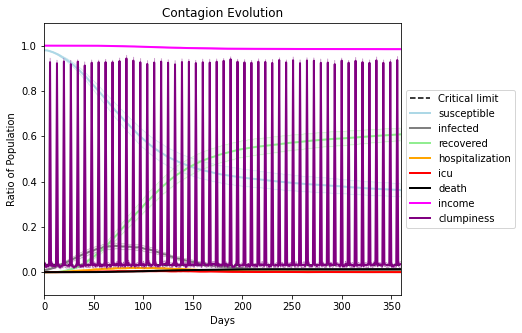

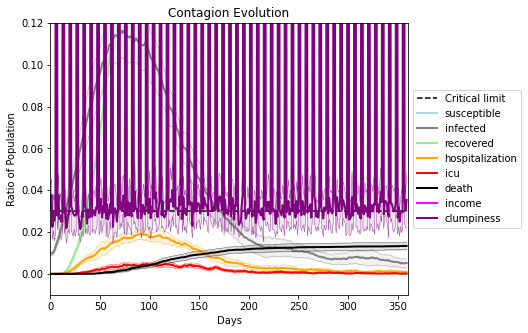

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[5148, 1493, 3623, 7803, 5428, 5320, 9281, 714, 3672, 9637, 3243, 1269, 7104, 7279, 9744, 9564, 4385, 7828, 1208, 1325]
Average similarity between family members is 0.5395553359434963 at temperature -0.9
Average similarity between family and home is 0.9998534333881535 at temperature -1
Average similarity between students and their classroom is 0.15912816965111143 at temperature -0.9
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is 0.43800888105808344 at temperature -0.9
Average office occupancy is 3.2243902439024392 and number offices is 205
Average friend similarity for adults: 0.5886182183397585 for kids: 0.44757356367805273
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.08381779500519439
avg restaurant similarity 0.06060334059229157
avg restaurant similarity 0.030753580091188348
avg restaurant similarity 0.0865067137622175
avg restaurant similarity 0.14920917759665628
avg restaurant similarity 0.11377794685643476
avg restaurant similarity 0.1064959862439836
avg restaurant similarity 0.07627370117783983
avg restaurant similarity 0.10146000728165716
avg restaurant similarity 0.11806739200281312
avg restaurant similarity 0.07117871936490269
avg restaurant similarity 0.1815080417547226
avg restaurant similarity 0.1271579391352086
avg restaurant similarity 0.1291317337706852
avg restaurant similarity 0.15334202633412478
avg restaurant similarity 0.06303870643485016
avg restaurant similarity 0.050649089005615974
avg restaurant similarity 0.11259849591428377
avg restaurant similarity 0.13945140603797587
avg restaurant similarity 0.08432883265489799
avg restaurant similarity 0.060504472405826286
avg restaurant similarity 0.02544887

avg restaurant similarity 0.09614930896736773
avg restaurant similarity 0.05131610890599603
avg restaurant similarity 0.147685768318306
avg restaurant similarity 0.09292232927687899
avg restaurant similarity 0.028499763468629064
avg restaurant similarity 0.11555427006123704
avg restaurant similarity 0.1049341724140007
avg restaurant similarity 0.08015232225727821
avg restaurant similarity 0.1093916775427868
avg restaurant similarity 0.12801928994066689
avg restaurant similarity 0.06324846411098965
avg restaurant similarity 0.10428549925913332
avg restaurant similarity 0.07259182579266783
avg restaurant similarity 0.0669680811786789
avg restaurant similarity 0.12352955139010247
avg restaurant similarity 0.0991668221513003
avg restaurant similarity 0.051792063249528994
avg restaurant similarity 0.05615843036111294
avg restaurant similarity 0.10032131896873354
avg restaurant similarity 0.036420009221332594
avg restaurant similarity 0.12836639910284633
avg restaurant similarity 0.084470263

avg restaurant similarity 0.057366644169953365
avg restaurant similarity 0.036007411096108145
avg restaurant similarity 0.1567318153593772
avg restaurant similarity 0.05921254400160874
avg restaurant similarity 0.060509177285866696
avg restaurant similarity 0.16595995670519284
avg restaurant similarity 0.0767374641799113
avg restaurant similarity 0.09019436139451215
avg restaurant similarity 0.09358548067477479
avg restaurant similarity 0.09855309976897965
avg restaurant similarity 0.0789048723560566
avg restaurant similarity 0.11699527610816575
avg restaurant similarity 0.05443370184380094
avg restaurant similarity 0.06908164788480872
avg restaurant similarity 0.1007957779079976
avg restaurant similarity 0.01170875399400965
avg restaurant similarity 0.15393269129145662
avg restaurant similarity 0.059829773754010926
avg restaurant similarity 0.10993183469181696
avg restaurant similarity 0.12285923932498032
avg restaurant similarity 0.14246468483514377
avg restaurant similarity 0.067033

avg restaurant similarity 0.13181122345266688
avg restaurant similarity 0.07135333932438287
avg restaurant similarity 0.08988305157945077
avg restaurant similarity 0.08822845123875925
avg restaurant similarity 0.12936351914092042
avg restaurant similarity 0.07871684968792587
avg restaurant similarity 0.04282109409056507
avg restaurant similarity 0.10819672691032024
avg restaurant similarity 0.04000900606749326
avg restaurant similarity 0.09845094822041932
avg restaurant similarity 0.09372686450260145
avg restaurant similarity 0.07861185538143946
avg restaurant similarity 0.15418877702321748
avg restaurant similarity 0.09285879383595605
avg restaurant similarity 0.03450573276724608
avg restaurant similarity 0.04411477447796842
avg restaurant similarity 0.019561711783147657
avg restaurant similarity 0.10769771842197769
avg restaurant similarity 0.08129857777155215
avg restaurant similarity 0.10614672980972788
avg restaurant similarity 0.11357797359218254
avg restaurant similarity 0.08790

avg restaurant similarity 0.12282177222841441
avg restaurant similarity 0.09265540484422011
avg restaurant similarity 0.03440450296107307
avg restaurant similarity 0.06889710897030166
avg restaurant similarity 0.06454586346928444
avg restaurant similarity 0.12490188563677422
avg restaurant similarity 0.01688747858453006
avg restaurant similarity 0.07761939197851724
avg restaurant similarity 0.0960445531792316
avg restaurant similarity -0.0627642717368755
avg restaurant similarity 0.08708989576554514
avg restaurant similarity 0.056718019528904894
avg restaurant similarity 0.049516552895004604
avg restaurant similarity 0.015632604027934472
avg restaurant similarity 0.1069724873090983
avg restaurant similarity 0.10083058544481144
avg restaurant similarity 0.02731368122180295
avg restaurant similarity 0.09162091621792909
avg restaurant similarity 0.09245317823106634
avg restaurant similarity 0.1100452045253034
avg restaurant similarity 0.030450371530619292
avg restaurant similarity 0.08288

avg restaurant similarity 0.11091085936844623
avg restaurant similarity 0.003081506331703464
avg restaurant similarity 0.03996141176364512
avg restaurant similarity 0.11088646046190719
avg restaurant similarity 0.06686862382508536
avg restaurant similarity 0.11089635679114528
avg restaurant similarity 0.10559501517261168
avg restaurant similarity 0.04205042285687356
avg restaurant similarity 0.0985291507202233
avg restaurant similarity 0.0634766814213729
avg restaurant similarity 0.028150698417641912
avg restaurant similarity 0.12399546046087356
avg restaurant similarity 0.1064079227472074
avg restaurant similarity 0.07791800602703758
avg restaurant similarity 0.07539107715526656
avg restaurant similarity 0.04884246893874767
avg restaurant similarity 0.09952322665368178
avg restaurant similarity 0.06559027559505547
avg restaurant similarity 0.08132332982183314
avg restaurant similarity 0.039905006735720804
avg restaurant similarity 0.00937116600104261
avg restaurant similarity 0.088130

avg restaurant similarity 0.16506827034750632
avg restaurant similarity 0.06433339572088204
avg restaurant similarity 0.11992246298896565
avg restaurant similarity 0.07718044047977288
avg restaurant similarity 0.050738770616047514
avg restaurant similarity 0.04281752694357111
avg restaurant similarity 0.06205841210747075
avg restaurant similarity 0.046140371326722995
avg restaurant similarity 0.05155049734732464
avg restaurant similarity 0.09896998109585113
avg restaurant similarity 0.10227418220816138
avg restaurant similarity 0.06688466000504631
avg restaurant similarity 0.09550121818825585
avg restaurant similarity 0.04536122216702049
avg restaurant similarity 0.11895092090344071
avg restaurant similarity 0.14886002178620325
avg restaurant similarity 0.0666749342723811
avg restaurant similarity 0.06285569828644688
avg restaurant similarity 0.08201565961977214
avg restaurant similarity 0.07246581622795013
avg restaurant similarity 0.05201709613528003
avg restaurant similarity 0.04476

avg restaurant similarity 0.04630272250613
avg restaurant similarity 0.09760227954547619
avg restaurant similarity 0.02560714483483131
avg restaurant similarity 0.12167159404911858
avg restaurant similarity 0.10118081931089787
avg restaurant similarity 0.07389508266401992
avg restaurant similarity 0.06842776581621487
avg restaurant similarity 0.06989018970907465
avg restaurant similarity 0.07394766860884984
avg restaurant similarity 0.05293851368424377
avg restaurant similarity 0.0827194984914926
avg restaurant similarity 0.08072455686639181
avg restaurant similarity 0.051494328956487416
avg restaurant similarity 0.07844251307824912
avg restaurant similarity 0.0823882227004917
avg restaurant similarity 0.039143453100486704
avg restaurant similarity 0.03477469362074045
avg restaurant similarity 0.1213730022325615
avg restaurant similarity 0.05050019018012672
avg restaurant similarity 0.07823205372043354
avg restaurant similarity 0.10036471570219584
avg restaurant similarity 0.1156758843

avg restaurant similarity 0.11337675520115141
avg restaurant similarity 0.09815878062002198
avg restaurant similarity 0.12276200685157271
avg restaurant similarity 0.14244659348364605
avg restaurant similarity 0.16512382266176587
avg restaurant similarity 0.1290554856375346
avg restaurant similarity 0.11083960416820274
avg restaurant similarity 0.10332500028394205
avg restaurant similarity 0.11317674787387018
avg restaurant similarity 0.08752349069965394
avg restaurant similarity 0.19926636411685372
avg restaurant similarity 0.08163898197706154
avg restaurant similarity 0.13209874784253547
avg restaurant similarity 0.11621104896528234
avg restaurant similarity 0.10199987033131762
avg restaurant similarity 0.06721273465744726
avg restaurant similarity 0.14639435352837332
avg restaurant similarity 0.08175395491643828
avg restaurant similarity 0.12278899937392951
avg restaurant similarity 0.07064405035469125
avg restaurant similarity 0.054094672062924266
avg restaurant similarity 0.168127

avg restaurant similarity 0.1230707566382
avg restaurant similarity 0.1559134091803453
avg restaurant similarity 0.13777882395592417
avg restaurant similarity 0.16976665512669598
avg restaurant similarity 0.17841245871041533
avg restaurant similarity 0.1416174190916112
avg restaurant similarity 0.05647947647280443
avg restaurant similarity 0.11273920768295906
avg restaurant similarity 0.0841129591383725
avg restaurant similarity 0.09741958735909605
avg restaurant similarity 0.14430343647683394
avg restaurant similarity 0.09723394113995783
avg restaurant similarity 0.13613432344592388
avg restaurant similarity 0.07518059704100026
avg restaurant similarity 0.1218133879378945
avg restaurant similarity 0.11300530867982869
avg restaurant similarity 0.10069440596287058
avg restaurant similarity 0.07354376251828003
avg restaurant similarity 0.1465829474200116
avg restaurant similarity 0.0720949163174813
avg restaurant similarity 0.1695067770850853
avg restaurant similarity 0.14005258483577265

avg restaurant similarity 0.1096156858578861
avg restaurant similarity 0.11665047076598425
avg restaurant similarity 0.05825848400114251
avg restaurant similarity 0.031312912822458086
avg restaurant similarity 0.13235138978180447
avg restaurant similarity 0.04137517205108532
avg restaurant similarity 0.10765290651324486
avg restaurant similarity 0.0368500064283607
avg restaurant similarity 0.10812828936280963
avg restaurant similarity 0.06220310350951053
avg restaurant similarity 0.06562788988478405
avg restaurant similarity 0.07985688687643334
avg restaurant similarity 0.08928225794217697
avg restaurant similarity 0.08906964453232223
avg restaurant similarity 0.09476746414308347
avg restaurant similarity 0.11560611364534434
avg restaurant similarity 0.09767396993899438
avg restaurant similarity 0.15068749065403228
avg restaurant similarity 0.08849996842823332
avg restaurant similarity 0.08226789343444653
avg restaurant similarity 0.1321701789684228
avg restaurant similarity 0.13062484

avg restaurant similarity 0.12893051065754713
avg restaurant similarity 0.08873670575612763
avg restaurant similarity 0.0710900367863564
avg restaurant similarity 0.09035171921687778
avg restaurant similarity 0.05615353686431574
avg restaurant similarity 0.08471220197180579
avg restaurant similarity 0.0867127763643759
avg restaurant similarity 0.13578271322347002
avg restaurant similarity 0.15802368688146168
avg restaurant similarity 0.065367083049265
avg restaurant similarity 0.11401162940449854
avg restaurant similarity 0.08933767372832542
avg restaurant similarity 0.1235782598649094
avg restaurant similarity 0.1145695417733738
avg restaurant similarity 0.11646521908685299
avg restaurant similarity 0.07446612347020458
avg restaurant similarity 0.043773304313025174
avg restaurant similarity 0.1202289709041835
avg restaurant similarity 0.10968475223686565
avg restaurant similarity 0.08565187889437366
avg restaurant similarity 0.12665548797675058
avg restaurant similarity 0.094388875124

avg restaurant similarity 0.06496001364268088
avg restaurant similarity 0.04843092071551383
avg restaurant similarity 0.14353376735019913
avg restaurant similarity 0.107849433697773
avg restaurant similarity 0.06350204238024848
avg restaurant similarity 0.0031218552193632704
avg restaurant similarity 0.10570730221114642
avg restaurant similarity 0.08761619922457155
avg restaurant similarity 0.14721492068401276
avg restaurant similarity 0.039855732438605775
avg restaurant similarity 0.06685101340311338
avg restaurant similarity 0.03700332222957561
avg restaurant similarity 0.03862527548730295
avg restaurant similarity 0.13991186782165183
avg restaurant similarity 0.060874688947745836
avg restaurant similarity 0.0516478617688843
avg restaurant similarity -0.0022299775420820387
avg restaurant similarity 0.08260571256483296
avg restaurant similarity 0.06357407933336587
avg restaurant similarity 0.07284072216145174
avg restaurant similarity 0.055196108989946716
avg restaurant similarity 0.0

avg restaurant similarity 0.1234924760874211
avg restaurant similarity 0.03945661243671623
avg restaurant similarity 0.0985351135876606
avg restaurant similarity 0.05577782961951628
avg restaurant similarity 0.15013078945764763
avg restaurant similarity 0.09289680712644681
avg restaurant similarity 0.060789114540579794
avg restaurant similarity 0.12711338518869578
avg restaurant similarity 0.05708568486402302
avg restaurant similarity 0.06450069534509681
avg restaurant similarity 0.07453988875600681
avg restaurant similarity 0.11112178446861927
avg restaurant similarity 0.08066983634892208
avg restaurant similarity 0.12816831752099958
avg restaurant similarity 0.12680874508351125
avg restaurant similarity 0.10673425675580586
avg restaurant similarity 0.07145753949698998
avg restaurant similarity 0.066758156615401
avg restaurant similarity 0.11194805631118392
avg restaurant similarity 0.10147747949323077
avg restaurant similarity 0.15383263736015676
avg restaurant similarity 0.133987557

avg restaurant similarity 0.1485728383102869
avg restaurant similarity 0.09922331518844947
avg restaurant similarity 0.09090097139915482
avg restaurant similarity 0.07889394685740472
avg restaurant similarity 0.113977836821711
avg restaurant similarity 0.07975187278321356
avg restaurant similarity 0.11646050170266249
avg restaurant similarity 0.05419566828014748
avg restaurant similarity 0.14251876113244724
avg restaurant similarity 0.11046185083400673
avg restaurant similarity 0.11774582826115809
avg restaurant similarity 0.04972675119561742
avg restaurant similarity 0.08847011668495103
avg restaurant similarity 0.11207537465241364
avg restaurant similarity 0.08873797880721555
avg restaurant similarity 0.1456722952153552
avg restaurant similarity 0.19228646632031227
avg restaurant similarity 0.1272428367675179
avg restaurant similarity 0.06922737577752719
avg restaurant similarity 0.10688565255066329
avg restaurant similarity 0.17351634448546205
avg restaurant similarity 0.10404192937

avg restaurant similarity 0.12846132041835726
avg restaurant similarity 0.10788965974025873
avg restaurant similarity 0.09945927174534841
avg restaurant similarity 0.13397642580595467
avg restaurant similarity 0.157582071938482
avg restaurant similarity 0.08799037081343784
avg restaurant similarity 0.12901050935081998
avg restaurant similarity 0.10136745632089911
avg restaurant similarity 0.14185255407984695
avg restaurant similarity 0.10254442499807781
avg restaurant similarity 0.11155303640296937
avg restaurant similarity 0.08085579859475778
avg restaurant similarity 0.15511080440027047
avg restaurant similarity 0.18682579635301388
avg restaurant similarity 0.09636002322621667
avg restaurant similarity 0.123293625439924
avg restaurant similarity 0.10813186208397683
avg restaurant similarity 0.09865966764202641
avg restaurant similarity 0.11976241480391245
avg restaurant similarity 0.13647414830352078
avg restaurant similarity 0.14932535293717566
avg restaurant similarity 0.1558724253

avg restaurant similarity 0.10462014694381876
avg restaurant similarity 0.03566015357812769
avg restaurant similarity 0.049130196118189584
avg restaurant similarity 0.09928106334616926
avg restaurant similarity 0.09328310530717271
avg restaurant similarity 0.09640251174374329
avg restaurant similarity 0.10248605023292816
avg restaurant similarity 0.14479962289709208
avg restaurant similarity 0.14638924050734267
avg restaurant similarity 0.13464545727595795
avg restaurant similarity 0.03625746628788831
avg restaurant similarity 0.06549888110929346
avg restaurant similarity 0.1288550653442712
avg restaurant similarity 0.08269405349558319
avg restaurant similarity 0.08101848015759415
avg restaurant similarity 0.12503644039706055
avg restaurant similarity 0.08738137005772363
avg restaurant similarity 0.10790265522731005
avg restaurant similarity 0.10679269362231475
avg restaurant similarity 0.10451315094924585
avg restaurant similarity 0.07294547760074539
avg restaurant similarity 0.048995

avg restaurant similarity 0.03521689543725327
avg restaurant similarity 0.12944250650561726
avg restaurant similarity 0.025217702399973473
avg restaurant similarity 0.05745012549509751
avg restaurant similarity 0.11513847805815046
avg restaurant similarity 0.058676031465265684
avg restaurant similarity 0.08721286311701097
avg restaurant similarity 0.08397781328762313
avg restaurant similarity 0.06244172065347702
avg restaurant similarity 0.08783860177394427
avg restaurant similarity 0.10330290317980857
avg restaurant similarity 0.055339824498067944
avg restaurant similarity 0.05870186736620576
avg restaurant similarity 0.11014013858557593
avg restaurant similarity 0.1057361507339902
avg restaurant similarity 0.11191127703501637
avg restaurant similarity 0.09959783858238748
avg restaurant similarity 0.12363053292637881
avg restaurant similarity 0.1316886217624025
avg restaurant similarity 0.08587164085674041
avg restaurant similarity 0.04428133234585554
avg restaurant similarity 0.14828

avg restaurant similarity 0.1338348396956722
avg restaurant similarity 0.09814961262140508
avg restaurant similarity 0.042200954107122796
avg restaurant similarity 0.16323906825534482
avg restaurant similarity 0.13840833923134963
avg restaurant similarity 0.09366755008186173
avg restaurant similarity 0.13179853532863706
avg restaurant similarity 0.13178379186684522
avg restaurant similarity 0.13380927779256313
avg restaurant similarity 0.10125371334549343
avg restaurant similarity 0.13199934599684304
avg restaurant similarity 0.09087784106057366
avg restaurant similarity 0.1755047086977265
avg restaurant similarity 0.16979289176813156
avg restaurant similarity 0.12249120848520767
avg restaurant similarity 0.12552570188055223
avg restaurant similarity 0.018347178853843106
avg restaurant similarity 0.09843031432830665
avg restaurant similarity 0.08864690720463744
avg restaurant similarity 0.12478441121386682
avg restaurant similarity 0.07288053104050232
avg restaurant similarity 0.099067

avg restaurant similarity 0.07949533739041327
avg restaurant similarity 0.1245388928579552
avg restaurant similarity 0.143973830223604
avg restaurant similarity 0.08594127373811485
avg restaurant similarity 0.03825324101876553
avg restaurant similarity 0.11646202634897215
avg restaurant similarity 0.10392490379742249
avg restaurant similarity 0.06323485984133205
avg restaurant similarity 0.07247870958898792
avg restaurant similarity 0.10119726884594589
avg restaurant similarity 0.08128891598546939
avg restaurant similarity 0.10517020231841619
avg restaurant similarity 0.15156015896470815
avg restaurant similarity 0.11321043872907789
avg restaurant similarity 0.12406872597702286
avg restaurant similarity 0.07714483265823802
avg restaurant similarity 0.13421187024715323
avg restaurant similarity 0.10503890893217861
avg restaurant similarity 0.1326718595123395
avg restaurant similarity 0.055446239467703065
avg restaurant similarity 0.08719443450246875
avg restaurant similarity 0.095447110

avg restaurant similarity 0.13572227145710164
avg restaurant similarity 0.10740142559767521
avg restaurant similarity 0.11360660128442397
avg restaurant similarity 0.15371496592872738
avg restaurant similarity 0.12278245715171086
avg restaurant similarity 0.10643510987387117
avg restaurant similarity 0.1310242254153794
avg restaurant similarity 0.08671289761789075
avg restaurant similarity 0.1069606966587555
avg restaurant similarity 0.043515918730140615
avg restaurant similarity 0.002141323838982188
avg restaurant similarity 0.04567202987095725
avg restaurant similarity 0.09870054246917663
avg restaurant similarity 0.1361924261198089
avg restaurant similarity 0.016857247853591963
avg restaurant similarity 0.10735147653572566
avg restaurant similarity 0.033041374758619256
avg restaurant similarity 0.14606321976500478
avg restaurant similarity 0.016118476950709563
avg restaurant similarity 0.11132225335847636
avg restaurant similarity 0.04675915236881446
avg restaurant similarity 0.0613

avg restaurant similarity 0.1622109628997695
avg restaurant similarity 0.08483892582389023
avg restaurant similarity 0.03878388597188732
avg restaurant similarity 0.07366713851187577
avg restaurant similarity 0.03558972588297464
avg restaurant similarity 0.05311760208798904
avg restaurant similarity 0.08364411566589057
avg restaurant similarity 0.06633378806568399
avg restaurant similarity -0.0005220602130353067
avg restaurant similarity 0.0419590933545464
avg restaurant similarity 0.1544991335007755
avg restaurant similarity 0.10310975112337886
avg restaurant similarity 0.10479911958669792
avg restaurant similarity 0.04009368458871554
avg restaurant similarity 0.07587687914765975
avg restaurant similarity 0.11027985541733654
avg restaurant similarity 0.06752063982374314
avg restaurant similarity 0.04137898974753248
avg restaurant similarity 0.11145449380239483
avg restaurant similarity 0.12911590479333673
avg restaurant similarity 0.10229984676975135
avg restaurant similarity 0.070628

avg restaurant similarity 0.1323344217985345
avg restaurant similarity 0.13500247541171867
avg restaurant similarity 0.12307128461939383
avg restaurant similarity 0.12994758533982947
avg restaurant similarity 0.061797145211565666
avg restaurant similarity 0.1482550604951276
avg restaurant similarity 0.13064656066645225
avg restaurant similarity 0.07422451435431897
avg restaurant similarity 0.11220464738441363
avg restaurant similarity 0.08992741982787074
avg restaurant similarity 0.09317412828614381
avg restaurant similarity 0.11576546562437447
avg restaurant similarity 0.15004760655473093
avg restaurant similarity 0.06988677374546581
avg restaurant similarity 0.03213346046024064
avg restaurant similarity 0.1052535390256687
avg restaurant similarity 0.08464779953998407
avg restaurant similarity 0.14636995985266257
avg restaurant similarity 0.1282458928339387
avg restaurant similarity 0.09240521745214438
avg restaurant similarity 0.08963674399709905
avg restaurant similarity 0.116437272

avg restaurant similarity 0.08904877204171477
avg restaurant similarity 0.11262880613592449
avg restaurant similarity 0.09707573724103376
avg restaurant similarity 0.07654811815549029
avg restaurant similarity 0.12640169878857266
avg restaurant similarity 0.0940229096543628
avg restaurant similarity 0.10023119246458854
avg restaurant similarity 0.1276644135782634
avg restaurant similarity 0.1230928073238963
avg restaurant similarity 0.12667235721593978
avg restaurant similarity 0.11080845676516768
avg restaurant similarity 0.05162178748594303
avg restaurant similarity 0.1312593707723835
avg restaurant similarity 0.09956711843017832
avg restaurant similarity 0.11888234169620339
avg restaurant similarity 0.06656357022437531
avg restaurant similarity 0.13889791485240083
avg restaurant similarity 0.056541039795630486
avg restaurant similarity 0.1265172649635087
avg restaurant similarity 0.04769319887057099
avg restaurant similarity 0.07059094928066435
avg restaurant similarity 0.1043902847

avg restaurant similarity 0.09238657488151783
avg restaurant similarity 0.09280029888236487
avg restaurant similarity 0.11278367826864817
avg restaurant similarity 0.07551568636078108
avg restaurant similarity 0.14441816653556444
avg restaurant similarity 0.07477567567547447
avg restaurant similarity 0.07553411728586891
avg restaurant similarity 0.08906898686111257
avg restaurant similarity 0.10230741413757515
avg restaurant similarity 0.14815860555030042
avg restaurant similarity 0.1367634128821737
avg restaurant similarity 0.11327045057174309
avg restaurant similarity 0.09282217792559717
avg restaurant similarity 0.04874314282750534
avg restaurant similarity 0.05164729176759327
avg restaurant similarity 0.07825059041937489
avg restaurant similarity 0.08640499233348316
avg restaurant similarity 0.04493179526094785
avg restaurant similarity 0.08522881717824884
avg restaurant similarity 0.1029054158272813
avg restaurant similarity 0.09407894786858029
avg restaurant similarity 0.17304241

avg restaurant similarity 0.12739071231229646
avg restaurant similarity 0.07116726773232956
avg restaurant similarity 0.09203949178644351
avg restaurant similarity 0.13001847186719492
avg restaurant similarity 0.07744475170170319
avg restaurant similarity 0.06725036548686732
avg restaurant similarity 0.10182148389824788
avg restaurant similarity 0.09654499771232833
avg restaurant similarity 0.187780114322969
avg restaurant similarity 0.11926411326156436
avg restaurant similarity 0.11594632544675204
avg restaurant similarity 0.1010164953998625
avg restaurant similarity 0.07711152695514834
avg restaurant similarity 0.13540354320938272
avg restaurant similarity 0.13827523440851336
avg restaurant similarity 0.08213564029015655
avg restaurant similarity 0.036059604035761625
avg restaurant similarity 0.10440442435947762
avg restaurant similarity 0.09399732741173619
avg restaurant similarity 0.11923397888023975
avg restaurant similarity 0.12277272268920097
avg restaurant similarity 0.17443843

avg restaurant similarity 0.08326497258804796
avg restaurant similarity 0.0712855517755397
avg restaurant similarity 0.07380821072107481
avg restaurant similarity 0.03894944941236022
avg restaurant similarity 0.09455051530196613
avg restaurant similarity 0.14609796941962747
avg restaurant similarity 0.0563090818953759
avg restaurant similarity 0.12605657635051132
avg restaurant similarity 0.07279783736579186
avg restaurant similarity 0.062214112700951944
avg restaurant similarity 0.08721353288000884
avg restaurant similarity 0.13881580902432739
avg restaurant similarity 0.03804341108299478
avg restaurant similarity 0.1023620424195134
avg restaurant similarity 0.0987053645416689
avg restaurant similarity 0.11060557070073111
avg restaurant similarity 0.15665624288142788
avg restaurant similarity 0.054804615982292616
avg restaurant similarity 0.05887277657798497
avg restaurant similarity 0.05607639401280078
avg restaurant similarity 0.08089027050538847
avg restaurant similarity 0.09807007

avg restaurant similarity 0.13388076143963887
avg restaurant similarity 0.12895582241552409
avg restaurant similarity 0.047851965620509355
avg restaurant similarity 0.09278865202463366
avg restaurant similarity 0.11872590561315091
avg restaurant similarity 0.06456004997290779
avg restaurant similarity 0.030384050096792424
avg restaurant similarity 0.1177692021161687
avg restaurant similarity 0.06400321002623945
avg restaurant similarity 0.05087145025468415
avg restaurant similarity 0.06877409054907183
avg restaurant similarity 0.006996870285799685
avg restaurant similarity 0.08702860170220848
avg restaurant similarity 0.08994857214914607
avg restaurant similarity 0.07761599208540822
avg restaurant similarity 0.08287778723680583
avg restaurant similarity 0.02405835370565535
avg restaurant similarity 0.0864457181340293
avg restaurant similarity 0.08611601724628522
avg restaurant similarity 0.0051890505149526775
avg restaurant similarity 0.03428359691856639
avg restaurant similarity 0.101

avg restaurant similarity 0.105666493876282
avg restaurant similarity 0.08970072638965806
avg restaurant similarity 0.06458921725209148
avg restaurant similarity 0.06785992855071697
avg restaurant similarity 0.07656931336607198
avg restaurant similarity 0.08423534615091674
avg restaurant similarity 0.0839431319673272
avg restaurant similarity 0.09533249565151525
avg restaurant similarity 0.09541197493001997
avg restaurant similarity 0.10002497710733298
avg restaurant similarity 0.05251851920554411
avg restaurant similarity 0.05527525361964318
avg restaurant similarity 0.11032740494127521
avg restaurant similarity 0.13076399807894915
avg restaurant similarity 0.05657226129190444
avg restaurant similarity 0.07681076519117289
avg restaurant similarity 0.11386631926913314
avg restaurant similarity 0.07150804903430374
avg restaurant similarity 0.07035123664661268
avg restaurant similarity 0.11750065450371464
avg restaurant similarity 0.09807376446672823
avg restaurant similarity 0.126359032

avg restaurant similarity 0.1590443796759912
avg restaurant similarity 0.11690850839494707
avg restaurant similarity 0.07997926049788445
avg restaurant similarity 0.07898939715971388
avg restaurant similarity 0.12874057787085003
avg restaurant similarity 0.0820706317361559
avg restaurant similarity 0.1353272673356237
avg restaurant similarity 0.11435089944035948
avg restaurant similarity 0.15697353859503413
avg restaurant similarity 0.13158243487664584
avg restaurant similarity 0.1584261747931268
avg restaurant similarity 0.1223317100865216
avg restaurant similarity 0.07340114943298462
avg restaurant similarity 0.12914609988619202
avg restaurant similarity 0.1490280981743914
avg restaurant similarity 0.12074534453046683
avg restaurant similarity 0.13213213015683098
avg restaurant similarity 0.11798658972393548
avg restaurant similarity 0.1346590717115057
avg restaurant similarity 0.09971757709512606
avg restaurant similarity 0.03245431677087081
avg restaurant similarity 0.0932644055963

avg restaurant similarity 0.06237238355606751
avg restaurant similarity 0.07620222765449304
avg restaurant similarity 0.10217137757402743
avg restaurant similarity 0.03820168661474373
avg restaurant similarity 0.08587895274487763
avg restaurant similarity 0.057522722272888765
avg restaurant similarity 0.0666662455834071
avg restaurant similarity 0.09459310981021804
avg restaurant similarity 0.05563944452924065
avg restaurant similarity 0.08746104701961795
avg restaurant similarity 0.03744038708321485
avg restaurant similarity 0.04632148061108096
avg restaurant similarity 0.12345450453171967
avg restaurant similarity 0.03567218924254524
avg restaurant similarity 0.07944162254751863
avg restaurant similarity 0.11290105754202694
avg restaurant similarity 0.026348087483078316
avg restaurant similarity 0.06282816352135168
avg restaurant similarity 0.04292793404935856
avg restaurant similarity 0.04116556901175598
avg restaurant similarity 0.04102551323352583
avg restaurant similarity 0.15415

avg restaurant similarity 0.05093569829433404
avg restaurant similarity 0.16624239267700225
avg restaurant similarity 0.05645551651370993
avg restaurant similarity 0.1492699380737986
avg restaurant similarity 0.08746690203454104
avg restaurant similarity 0.08629162986427472
avg restaurant similarity 0.1295064676523283
avg restaurant similarity 0.12219361368827591
avg restaurant similarity 0.11329832572975813
avg restaurant similarity 0.10084852642163235
avg restaurant similarity 0.09763781021644585
avg restaurant similarity 0.11574347900366148
avg restaurant similarity 0.08220865023363626
avg restaurant similarity 0.0628296701563974
avg restaurant similarity 0.0957830919702677
avg restaurant similarity 0.02215357099072559
avg restaurant similarity 0.14152955099167713
avg restaurant similarity 0.11420155276730656
avg restaurant similarity 0.044483147177638585
avg restaurant similarity 0.09947797064921557
avg restaurant similarity 0.09546099081802872
avg restaurant similarity 0.058587022

avg restaurant similarity 0.17094136272359303
avg restaurant similarity 0.058316152827630405
avg restaurant similarity 0.07352403736965715
avg restaurant similarity 0.08283119449680772
avg restaurant similarity 0.12133740317977941
avg restaurant similarity 0.05788601847318014
avg restaurant similarity 0.07185178658617523
avg restaurant similarity 0.11076424832906842
avg restaurant similarity 0.06731988350985238
avg restaurant similarity 0.12354648702596985
avg restaurant similarity 0.12324350064279603
avg restaurant similarity 0.06011347473571256
avg restaurant similarity 0.07130315309364228
avg restaurant similarity 0.07441098100408036
avg restaurant similarity 0.1423505566915988
avg restaurant similarity 0.0521261760706348
avg restaurant similarity 0.196416990572029
avg restaurant similarity 0.12173623253856414
avg restaurant similarity 0.09411110078315217
avg restaurant similarity 0.14644902404969604
avg restaurant similarity 0.09659538288328808
avg restaurant similarity 0.062149849

avg restaurant similarity 0.04596065202636431
avg restaurant similarity 0.10093644658965141
avg restaurant similarity 0.09792066891688662
avg restaurant similarity 0.1428174020438125
avg restaurant similarity 0.09228711192786221
avg restaurant similarity 0.14265235073247257
avg restaurant similarity 0.04838552621670173
avg restaurant similarity 0.1353624286969255
avg restaurant similarity 0.10413569694812995
avg restaurant similarity 0.08767017355999208
avg restaurant similarity 0.020152940446841218
avg restaurant similarity 0.17398136657875854
avg restaurant similarity 0.06729937165916394
avg restaurant similarity 0.1352966214741746
avg restaurant similarity 0.10191863642430292
avg restaurant similarity 0.04200317657790702
avg restaurant similarity 0.10372940610749264
avg restaurant similarity 0.15322689115949553
avg restaurant similarity 0.09628165701133425
avg restaurant similarity 0.1784535413044468
avg restaurant similarity 0.041515099422974155
avg restaurant similarity 0.08319109

avg restaurant similarity 0.06463335155133011
avg restaurant similarity 0.0949912969580114
avg restaurant similarity 0.00642329636097873
avg restaurant similarity 0.03493702649406239
avg restaurant similarity 0.0404664037171193
avg restaurant similarity 0.10607341517438454
avg restaurant similarity 0.09506456869230386
avg restaurant similarity -0.017019011404391087
avg restaurant similarity 0.1003927255581648
avg restaurant similarity 0.10653316707564839
avg restaurant similarity 0.13340205452637802
avg restaurant similarity 0.10809310419394977
avg restaurant similarity 0.04273454458589464
avg restaurant similarity 0.0740654382784882
avg restaurant similarity 0.06416181243663122
avg restaurant similarity 0.1820067315357582
avg restaurant similarity 0.024355983472636223
avg restaurant similarity 0.07496886910651084
avg restaurant similarity 0.09806489404319532
avg restaurant similarity 0.04796755668088675
avg restaurant similarity 0.036767785844476375
avg restaurant similarity 0.1389817

avg restaurant similarity 0.057428327771441655
avg restaurant similarity 0.1332557105223407
avg restaurant similarity 0.10151887646611206
avg restaurant similarity 0.054899050027016845
avg restaurant similarity 0.12925923977505985
avg restaurant similarity 0.06363492795798043
avg restaurant similarity 0.06972094815295128
avg restaurant similarity 0.07251078871299008
avg restaurant similarity 0.08076846656975006
avg restaurant similarity 0.17226482302065127
avg restaurant similarity 0.09560258734272997
avg restaurant similarity 0.08508641978879619
avg restaurant similarity 0.04690892932403861
avg restaurant similarity 0.14374370751112817
avg restaurant similarity 0.07202560884575245
avg restaurant similarity 0.03141626343099954
avg restaurant similarity 0.041875707267014006
avg restaurant similarity 0.06449567102222602
avg restaurant similarity 0.0887601600851218
avg restaurant similarity 0.03316873010832097
avg restaurant similarity 0.07179128445260524
avg restaurant similarity 0.10119

avg restaurant similarity 0.0561944325891854
avg restaurant similarity 0.12643061877705525
avg restaurant similarity 0.10717617505684512
avg restaurant similarity 0.0740525277976468
avg restaurant similarity 0.1354525257596493
avg restaurant similarity 0.07224322897653047
avg restaurant similarity 0.1042121499859462
avg restaurant similarity 0.14536590478310724
avg restaurant similarity 0.09841095937148131
avg restaurant similarity 0.1269175683992379
avg restaurant similarity 0.1156627084949887
avg restaurant similarity 0.08795467842867066
avg restaurant similarity 0.042944326721787635
avg restaurant similarity 0.07383916904211674
avg restaurant similarity 0.061066311371393206
avg restaurant similarity 0.16614619725241192
avg restaurant similarity 0.08828015431620148
avg restaurant similarity 0.11007084753357867
avg restaurant similarity 0.158976378701398
avg restaurant similarity 0.05001074639141357
avg restaurant similarity 0.026786606087736434
avg restaurant similarity 0.03191235080

avg restaurant similarity 0.12651413277748733
avg restaurant similarity 0.19182551895682148
avg restaurant similarity 0.16082977366169773
avg restaurant similarity 0.1252207020925169
avg restaurant similarity 0.13220783501156866
avg restaurant similarity 0.03199998717887994
avg restaurant similarity 0.1024828381491095
avg restaurant similarity 0.12349948419302342
avg restaurant similarity 0.08394916688416888
avg restaurant similarity 0.09793303708456136
avg restaurant similarity 0.16359213054822716
avg restaurant similarity 0.12524470224475323
avg restaurant similarity 0.0619688486868262
avg restaurant similarity 0.15757011871800833
avg restaurant similarity 0.11347697390716092
avg restaurant similarity 0.11100970083001425
avg restaurant similarity 0.068067582560567
avg restaurant similarity 0.07672305825440076
avg restaurant similarity 0.046443937996353976
avg restaurant similarity 0.0719815004167906
avg restaurant similarity 0.0702268293398059
avg restaurant similarity 0.064514479679

avg restaurant similarity 0.11410043444168184
avg restaurant similarity 0.0594763492635995
avg restaurant similarity 0.0920073152668881
avg restaurant similarity 0.09724318102540455
avg restaurant similarity 0.020875155616087444
avg restaurant similarity 0.06180217297071338
avg restaurant similarity 0.13478530339242867
avg restaurant similarity 0.05098108228151242
avg restaurant similarity 0.10283003108192104
avg restaurant similarity 0.07344292616542014
avg restaurant similarity 0.08034935780257459
avg restaurant similarity 0.11250468893807555
avg restaurant similarity 0.06828154730236272
avg restaurant similarity 0.10283733022008941
avg restaurant similarity 0.13688117006335734
avg restaurant similarity 0.035573563465967815
avg restaurant similarity 0.05999116185992442
avg restaurant similarity 0.12459094640838476
avg restaurant similarity 0.03941237603151199
avg restaurant similarity 0.12164354014256037
avg restaurant similarity 0.11107041442189702
avg restaurant similarity 0.046109

avg restaurant similarity 0.04480202546649774
avg restaurant similarity 0.10586314501401646
avg restaurant similarity 0.10196178523466601
avg restaurant similarity 0.09892762441906663
avg restaurant similarity 0.07291810128766142
avg restaurant similarity 0.1323060570455426
avg restaurant similarity 0.11034851273774919
avg restaurant similarity 0.04488257287120209
avg restaurant similarity 0.08520115332222311
avg restaurant similarity 0.14993763088385137
avg restaurant similarity 0.14581604916515992
avg restaurant similarity 0.09697497860465279
avg restaurant similarity 0.1445968709692381
avg restaurant similarity 0.039998443790174046
avg restaurant similarity 0.06495669289277384
avg restaurant similarity 0.06619812861670624
avg restaurant similarity 0.03131439257667098
avg restaurant similarity 0.07157801195486624
avg restaurant similarity 0.053194218672245615
avg restaurant similarity 0.04621972581443661
avg restaurant similarity 0.09688993501239208
avg restaurant similarity 0.044884

(<function dict.items>, <function dict.items>, <function dict.items>)

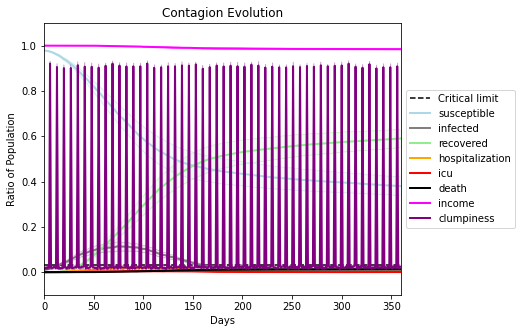

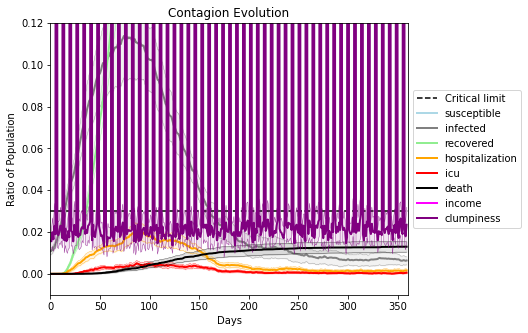

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9693, 4854, 2157, 1278, 8193, 2073, 6754, 9545, 7174, 9461, 7608, 921, 2890, 1302, 3929, 7532, 8081, 8738, 4111, 1405]
Average similarity between family members is 0.43596668008435485 at temperature -0.8
Average similarity between family and home is 0.9998510671556716 at temperature -1
Average similarity between students and their classroom is 0.2243008622299957 at temperature -0.8
Average classroom occupancy is 4.171428571428572 and number classrooms is 70
Average similarity between workers is 0.2939027709760222 at temperature -0.8
Average office occupancy is 3.262135922330097 and number offices is 206
Average friend similarity for adults: 0.5049021968153172 for kids: 0.36848638437613557
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.05024003289636273
avg restaurant similarity 0.05102303304673819
avg restaurant similarity 0.05282244087307951
avg restaurant similarity 0.044416587133661006
avg restaurant similarity 0.0933154652267204
avg restaurant similarity 0.06107706749131914
avg restaurant similarity 0.07539417580671558
avg restaurant similarity 0.09811953002851585
avg restaurant similarity 0.051051241272949036
avg restaurant similarity 0.08014788840928452
avg restaurant similarity 0.05874387599287472
avg restaurant similarity 0.024543236447742162
avg restaurant similarity 0.10265875947341446
avg restaurant similarity 0.13310730012945557
avg restaurant similarity 0.11038801233499938
avg restaurant similarity 0.03125967355961359
avg restaurant similarity 0.06421647220298576
avg restaurant similarity 0.07384562144379302
avg restaurant similarity 0.026149292819016456
avg restaurant similarity 0.08300969592275108
avg restaurant similarity 0.11230951596375313
avg restaurant similarity 0.074

avg restaurant similarity 0.06737090151340881
avg restaurant similarity 0.05251897422517435
avg restaurant similarity 0.07788041507973076
avg restaurant similarity 0.0992784159674185
avg restaurant similarity 0.08956272842286403
avg restaurant similarity 0.05348819276623589
avg restaurant similarity 0.06377531392873324
avg restaurant similarity 0.07136756895879943
avg restaurant similarity 0.08412111330937187
avg restaurant similarity 0.0614362912592871
avg restaurant similarity 0.0426385536698368
avg restaurant similarity 0.06263280555249628
avg restaurant similarity 0.08009704468652622
avg restaurant similarity 0.04627923573970517
avg restaurant similarity 0.07056154244370041
avg restaurant similarity 0.055494208009198145
avg restaurant similarity 0.10394124984040891
avg restaurant similarity 0.026195896788535882
avg restaurant similarity 0.11849933895392094
avg restaurant similarity 0.10480891106541781
avg restaurant similarity 0.09673185671022082
avg restaurant similarity 0.0484969

avg restaurant similarity 0.07167529960936413
avg restaurant similarity 0.10531199399995914
avg restaurant similarity 0.06731783010466949
avg restaurant similarity 0.08728685975252973
avg restaurant similarity 0.10880715683159357
avg restaurant similarity 0.08499125205020126
avg restaurant similarity 0.1308050478898512
avg restaurant similarity 0.13989549030619144
avg restaurant similarity 0.08763567078409996
avg restaurant similarity 0.04330359545092914
avg restaurant similarity 0.12491215798269334
avg restaurant similarity 0.13097605688552436
avg restaurant similarity 0.1311194689222847
avg restaurant similarity 0.12421403229684407
avg restaurant similarity 0.07638026178841498
avg restaurant similarity 0.038483281027696485
avg restaurant similarity 0.06855241935607578
avg restaurant similarity 0.14385615103287533
avg restaurant similarity 0.08989152871540529
avg restaurant similarity 0.10064379227307159
avg restaurant similarity 0.07125748577364338
avg restaurant similarity 0.0864022

avg restaurant similarity 0.09612619739043278
avg restaurant similarity 0.0787570897519823
avg restaurant similarity 0.10189063270383085
avg restaurant similarity 0.1494409143876633
avg restaurant similarity 0.13533994184673653
avg restaurant similarity 0.11023385729987306
avg restaurant similarity 0.09958486604603127
avg restaurant similarity 0.10332564230683
avg restaurant similarity 0.13264282662167168
avg restaurant similarity 0.10474791661263796
avg restaurant similarity 0.09328459659347246
avg restaurant similarity 0.10585672991857384
avg restaurant similarity 0.09728799413808091
avg restaurant similarity 0.05344915580449496
avg restaurant similarity 0.10147663871535999
avg restaurant similarity 0.10226625779619415
avg restaurant similarity 0.09642955722811604
avg restaurant similarity 0.11345067569378345
avg restaurant similarity 0.10611673653878063
avg restaurant similarity 0.11971120885135095
avg restaurant similarity 0.03449047366711275
avg restaurant similarity 0.13877410496

avg restaurant similarity 0.11694884597137908
avg restaurant similarity 0.12565768999874763
avg restaurant similarity 0.0967595973899294
avg restaurant similarity 0.08234419920563689
avg restaurant similarity 0.07649876074357777
avg restaurant similarity 0.09747660004845743
avg restaurant similarity 0.08095160091640004
avg restaurant similarity 0.08683359913674558
avg restaurant similarity 0.05736395570159245
avg restaurant similarity 0.10082528647760422
avg restaurant similarity 0.05599128890805047
avg restaurant similarity 0.1632302712329146
avg restaurant similarity 0.047326024472595776
avg restaurant similarity 0.08308841748867803
avg restaurant similarity 0.13785544405061678
avg restaurant similarity 0.12981712270658857
avg restaurant similarity 0.0763385133667825
avg restaurant similarity 0.1192444305777611
avg restaurant similarity 0.15414760717863882
avg restaurant similarity 0.12582501561802847
avg restaurant similarity 0.1274035134673239
avg restaurant similarity 0.1092782559

avg restaurant similarity 0.14045968861616542
avg restaurant similarity 0.07915698166780748
avg restaurant similarity 0.06722962856361964
avg restaurant similarity 0.11253573894900701
avg restaurant similarity 0.09523335478124845
avg restaurant similarity 0.10068483028443653
avg restaurant similarity 0.10616932597077375
avg restaurant similarity 0.1283870361392067
avg restaurant similarity 0.0758561097297317
avg restaurant similarity 0.1630682098257345
avg restaurant similarity 0.11638915065917721
avg restaurant similarity 0.07675793386339966
avg restaurant similarity 0.11096883698449414
avg restaurant similarity 0.08973267118042175
avg restaurant similarity 0.054288635107999625
avg restaurant similarity 0.1791530601687094
avg restaurant similarity 0.05115752962386299
avg restaurant similarity 0.07549051327357167
avg restaurant similarity 0.12365601744119831
avg restaurant similarity 0.11395658114967702
avg restaurant similarity 0.07746420047070891
avg restaurant similarity 0.120280944

avg restaurant similarity 0.06167430779444718
avg restaurant similarity 0.1308014207438716
avg restaurant similarity 0.061871979415758754
avg restaurant similarity 0.08974317487946613
avg restaurant similarity 0.11700400645618238
avg restaurant similarity 0.03497971223100827
avg restaurant similarity 0.04022863262413618
avg restaurant similarity 0.10699908786056148
avg restaurant similarity 0.0716943624411576
avg restaurant similarity 0.10276973688889042
avg restaurant similarity 0.07431230322137658
avg restaurant similarity 0.19638634831919183
avg restaurant similarity 0.07578322552307784
avg restaurant similarity 0.1196432074969442
avg restaurant similarity 0.15500495332359593
avg restaurant similarity 0.10496801332450507
avg restaurant similarity 0.10677846262883423
avg restaurant similarity 0.15136567496905065
avg restaurant similarity 0.025477889480976946
avg restaurant similarity 0.08341253369647003
avg restaurant similarity 0.14052870844203647
avg restaurant similarity 0.0829804

avg restaurant similarity 0.0833160850365756
avg restaurant similarity 0.09583502669722399
avg restaurant similarity 0.05954402923765689
avg restaurant similarity 0.09476323265332355
avg restaurant similarity 0.036617699233649575
avg restaurant similarity 0.09591828687131147
avg restaurant similarity 0.11677120622217038
avg restaurant similarity 0.06945367743315388
avg restaurant similarity 0.1728233885053116
avg restaurant similarity 0.13641362154583384
avg restaurant similarity 0.08059136851713197
avg restaurant similarity 0.038412373016688706
avg restaurant similarity 0.1279513228637992
avg restaurant similarity 0.05891932607804405
avg restaurant similarity 0.03431295657712295
avg restaurant similarity 0.12828768506791105
avg restaurant similarity 0.12348499044649763
avg restaurant similarity 0.035299790654484416
avg restaurant similarity 0.045153222466959
avg restaurant similarity 0.09258816221442706
avg restaurant similarity 0.14943499632381527
avg restaurant similarity 0.10854485

avg restaurant similarity 0.12928312714779688
avg restaurant similarity 0.16299026524561216
avg restaurant similarity 0.08007411636915569
avg restaurant similarity 0.06707936194292625
avg restaurant similarity 0.09044338069449477
avg restaurant similarity 0.027716759424710722
avg restaurant similarity 0.1248953207331487
avg restaurant similarity 0.11208174648003325
avg restaurant similarity 0.05939053079540598
avg restaurant similarity 0.1272644532042099
avg restaurant similarity 0.07587288029761641
avg restaurant similarity 0.14294549224462125
avg restaurant similarity 0.08742820131222198
avg restaurant similarity 0.11989474660030146
avg restaurant similarity 0.10650345732798913
avg restaurant similarity 0.033576046703272466
avg restaurant similarity 0.07837078907132734
avg restaurant similarity 0.07249304268367417
avg restaurant similarity 0.05220716823884557
avg restaurant similarity 0.13183951525766627
avg restaurant similarity 0.12403698767645366
avg restaurant similarity 0.095968

avg restaurant similarity 0.07142404146603933
avg restaurant similarity 0.042207795243091525
avg restaurant similarity 0.06035793287775394
avg restaurant similarity 0.09601661547847834
avg restaurant similarity 0.08962604770283032
avg restaurant similarity 0.14764539866102466
avg restaurant similarity 0.09927222684369057
avg restaurant similarity 0.10489996822826235
avg restaurant similarity 0.09865736981606926
avg restaurant similarity 0.11837936354467211
avg restaurant similarity 0.07881962785513356
avg restaurant similarity 0.09851214673963005
avg restaurant similarity 0.025528033533038823
avg restaurant similarity 0.09854566627084049
avg restaurant similarity 0.10198653917086897
avg restaurant similarity 0.13975410824014617
avg restaurant similarity 0.06296742560710654
avg restaurant similarity 0.09905645616599383
avg restaurant similarity 0.07841809775201845
avg restaurant similarity 0.10987286786662545
avg restaurant similarity 0.06535148307375924
avg restaurant similarity 0.1158

avg restaurant similarity 0.08241517219830675
avg restaurant similarity 0.10603182931404954
avg restaurant similarity 0.07885378473008094
avg restaurant similarity 0.16454765911820413
avg restaurant similarity 0.07807383614760971
avg restaurant similarity 0.10313724831160145
avg restaurant similarity 0.013138506808861012
avg restaurant similarity 0.01198107480150398
avg restaurant similarity 0.07167737207276476
avg restaurant similarity 0.0946928583729303
avg restaurant similarity 0.04622941620509436
avg restaurant similarity 0.11905228363482974
avg restaurant similarity 0.0706531684503491
avg restaurant similarity 0.07581698222559335
avg restaurant similarity 0.09176214159399557
avg restaurant similarity 0.05871954700488404
avg restaurant similarity 0.03773707016901442
avg restaurant similarity 0.12280228051480618
avg restaurant similarity 0.09855742520833556
avg restaurant similarity 0.08646295912577724
avg restaurant similarity 0.11995045114986978
avg restaurant similarity 0.1100573

avg restaurant similarity 0.10539475266759037
avg restaurant similarity 0.04269641867645082
avg restaurant similarity 0.03617138804570294
avg restaurant similarity 0.10780378542222761
avg restaurant similarity 0.06736917196942124
avg restaurant similarity 0.05372919308495967
avg restaurant similarity 0.09848844596975201
avg restaurant similarity 0.09526052538052167
avg restaurant similarity 0.09470063725342674
avg restaurant similarity 0.10524728364964848
avg restaurant similarity 0.07245696074959698
avg restaurant similarity 0.0883391560843556
avg restaurant similarity 0.0907933416812958
avg restaurant similarity 0.14840733487927565
avg restaurant similarity 0.14966222171798646
avg restaurant similarity 0.1236082053360487
avg restaurant similarity 0.11957270292999803
avg restaurant similarity 0.08967562280387874
avg restaurant similarity 0.07049565127243858
avg restaurant similarity 0.09525310673372257
avg restaurant similarity 0.1159040240225537
avg restaurant similarity 0.1077358140

avg restaurant similarity 0.04612814310525793
avg restaurant similarity 0.06426515891413943
avg restaurant similarity 0.0497394200256814
avg restaurant similarity 0.03223725730436108
avg restaurant similarity 0.09153292065200842
avg restaurant similarity 0.0735389077647949
avg restaurant similarity 0.1041825619437374
avg restaurant similarity 0.05828973159376746
avg restaurant similarity -0.008933157772892294
avg restaurant similarity 0.024434099888727
avg restaurant similarity 0.15315557766988408
avg restaurant similarity 0.05571871465759371
avg restaurant similarity 0.10801865182733565
avg restaurant similarity 0.11805368340899988
avg restaurant similarity 0.06394351080694972
avg restaurant similarity 0.05758085998030902
avg restaurant similarity 0.03139505480250833
avg restaurant similarity 0.1016028486148464
avg restaurant similarity 0.06920654267433092
avg restaurant similarity 0.12899803513534044
avg restaurant similarity 0.13369259935035682
avg restaurant similarity 0.0246738234

avg restaurant similarity 0.07913066281452602
avg restaurant similarity 0.03171450392065715
avg restaurant similarity 0.09701506507945293
avg restaurant similarity 0.055994670093823105
avg restaurant similarity 0.08987396406715925
avg restaurant similarity 0.033993827241378186
avg restaurant similarity 0.09397998194850757
avg restaurant similarity 0.05667521313390187
avg restaurant similarity 0.053356943742695735
avg restaurant similarity 0.178359614642979
avg restaurant similarity 0.1334214255432119
avg restaurant similarity 0.07674671394368959
avg restaurant similarity 0.033195079271833315
avg restaurant similarity 0.06954772150423263
avg restaurant similarity 0.03698113742121335
avg restaurant similarity 0.08636281957179393
avg restaurant similarity 0.08462894654980764
avg restaurant similarity 0.07422439331679381
avg restaurant similarity 0.10554251900510411
avg restaurant similarity 0.09548494615915956
avg restaurant similarity 0.08902056525395056
avg restaurant similarity 0.09270

avg restaurant similarity 0.07962711821137537
avg restaurant similarity 0.0049170036258262585
avg restaurant similarity 0.05559295188278831
avg restaurant similarity 0.09774980245163657
avg restaurant similarity 0.07062034508896138
avg restaurant similarity 0.06958623844239391
avg restaurant similarity 0.03697896777593027
avg restaurant similarity 0.044576240989960436
avg restaurant similarity 0.07644065355428123
avg restaurant similarity 0.07178935689285093
avg restaurant similarity 0.06347043011274087
avg restaurant similarity 0.06937058363243329
avg restaurant similarity 0.06971511363027758
avg restaurant similarity 0.10848044560764292
avg restaurant similarity 0.011980604082360867
avg restaurant similarity 0.05175010639585787
avg restaurant similarity 0.07467121498928632
avg restaurant similarity 0.06472622843258584
avg restaurant similarity 0.07217493850187039
avg restaurant similarity 0.06235763960176137
avg restaurant similarity 0.1284340734243138
avg restaurant similarity 0.066

avg restaurant similarity 0.11766004697013505
avg restaurant similarity 0.06175747146593365
avg restaurant similarity 0.06496019768785956
avg restaurant similarity 0.09128462572221108
avg restaurant similarity 0.10346866070704187
avg restaurant similarity 0.054517340899179596
avg restaurant similarity 0.0972256554332853
avg restaurant similarity 0.059148873901387816
avg restaurant similarity 0.07522959079094274
avg restaurant similarity 0.13294266240608532
avg restaurant similarity 0.07144780170290167
avg restaurant similarity 0.03973612834491737
avg restaurant similarity 0.0923699591833439
avg restaurant similarity 0.037607163057345745
avg restaurant similarity 0.03916066275368037
avg restaurant similarity 0.044271691083577286
avg restaurant similarity 0.1029071297681657
avg restaurant similarity 0.05207510525433099
avg restaurant similarity 0.0769849372960034
avg restaurant similarity 0.06778168943268605
avg restaurant similarity 0.05403648757791302
avg restaurant similarity 0.085347

avg restaurant similarity 0.08907084615671607
avg restaurant similarity 0.10175635948647069
avg restaurant similarity 0.13174545454352682
avg restaurant similarity 0.10062947935855034
avg restaurant similarity 0.07852583609621742
avg restaurant similarity 0.06195169948479662
avg restaurant similarity 0.13139868897089316
avg restaurant similarity 0.11575612459275281
avg restaurant similarity 0.0631686741110925
avg restaurant similarity 0.117387293547888
avg restaurant similarity 0.0704418646226517
avg restaurant similarity 0.008725731006857211
avg restaurant similarity 0.044235223790299545
avg restaurant similarity 0.07167199660260552
avg restaurant similarity 0.11056304675444327
avg restaurant similarity 0.12344769289392847
avg restaurant similarity 0.041532056153061894
avg restaurant similarity 0.05800093506064745
avg restaurant similarity 0.02631826988211779
avg restaurant similarity 0.052703780903922894
avg restaurant similarity 0.08872925755946975
avg restaurant similarity 0.099347

avg restaurant similarity 0.09850236060968151
avg restaurant similarity 0.07365214189848081
avg restaurant similarity 0.14864817808664513
avg restaurant similarity 0.09173731534651747
avg restaurant similarity 0.046628001060234486
avg restaurant similarity 0.0880411532142112
avg restaurant similarity 0.1097446986569647
avg restaurant similarity 0.1070361144277439
avg restaurant similarity 0.0484026334427463
avg restaurant similarity 0.1241542277544669
avg restaurant similarity 0.07235281136358962
avg restaurant similarity 0.006836679218354946
avg restaurant similarity 0.10567920285719516
avg restaurant similarity 0.1002942254653812
avg restaurant similarity 0.1158531298238058
avg restaurant similarity 0.0895117209011701
avg restaurant similarity 0.034473308021336774
avg restaurant similarity 0.07108591402184185
avg restaurant similarity 0.06883976459570708
avg restaurant similarity 0.08290736341737005
avg restaurant similarity 0.12205903768568749
avg restaurant similarity 0.07730299154

avg restaurant similarity 0.04814233762800838
avg restaurant similarity 0.06289875751331236
avg restaurant similarity 0.0890454182446887
avg restaurant similarity 0.1051904804315326
avg restaurant similarity 0.12622304352878336
avg restaurant similarity 0.10797955694455899
avg restaurant similarity 0.03421315040401177
avg restaurant similarity 0.10408415838103031
avg restaurant similarity 0.02595361113765238
avg restaurant similarity 0.15540175052195798
avg restaurant similarity 0.10631608119995013
avg restaurant similarity 0.1214710536761323
avg restaurant similarity 0.12862366950777088
avg restaurant similarity 0.03358542310516933
avg restaurant similarity 0.11815189359279328
avg restaurant similarity 0.05984200331268294
avg restaurant similarity 0.09836414359258204
avg restaurant similarity 0.11405563605987773
avg restaurant similarity 0.11466933952399873
avg restaurant similarity 0.1513808489971145
avg restaurant similarity 0.2056446634151556
avg restaurant similarity 0.11980467463

avg restaurant similarity 0.11634667155632146
avg restaurant similarity 0.1468450602128853
avg restaurant similarity 0.14580977877775297
avg restaurant similarity 0.09870100897020576
avg restaurant similarity 0.08329812596088716
avg restaurant similarity 0.0945863406176236
avg restaurant similarity 0.16584740439025977
avg restaurant similarity 0.08464249394853815
avg restaurant similarity 0.05870832053333173
avg restaurant similarity 0.09926637477878818
avg restaurant similarity 0.1418612044490908
avg restaurant similarity 0.1356491380670839
avg restaurant similarity 0.09066880694460812
avg restaurant similarity 0.15448509464878643
avg restaurant similarity 0.08986960331315913
avg restaurant similarity 0.08911416582335495
avg restaurant similarity 0.11175071341657736
avg restaurant similarity 0.19503842569195262
avg restaurant similarity 0.11481625345906368
avg restaurant similarity 0.09806569585617643
avg restaurant similarity 0.09880474469741397
avg restaurant similarity 0.1448169659

avg restaurant similarity 0.12292048752394061
avg restaurant similarity 0.1078991147458767
avg restaurant similarity 0.15026682292440355
avg restaurant similarity 0.10077895988361862
avg restaurant similarity 0.1010932073674386
avg restaurant similarity 0.08641174452769737
avg restaurant similarity 0.08798836138805359
avg restaurant similarity 0.0876684997019833
avg restaurant similarity 0.08667771264774758
avg restaurant similarity 0.06259975780900283
avg restaurant similarity 0.07853319573062331
avg restaurant similarity 0.13712351106722145
avg restaurant similarity 0.08077129373041497
avg restaurant similarity 0.10908196208047406
avg restaurant similarity 0.06016613217934121
avg restaurant similarity 0.12028391017141983
avg restaurant similarity 0.09671864830794591
avg restaurant similarity 0.09811191937685367
avg restaurant similarity 0.09596716922556477
avg restaurant similarity 0.12498574431650453
avg restaurant similarity 0.08716062475392887
avg restaurant similarity 0.116709645

avg restaurant similarity 0.1285280508250394
avg restaurant similarity 0.11561216794596008
avg restaurant similarity 0.07858336398530365
avg restaurant similarity 0.09995676275931081
avg restaurant similarity 0.11899292607980394
avg restaurant similarity 0.06633237493814063
avg restaurant similarity 0.09752891949109466
avg restaurant similarity 0.05505109722550428
avg restaurant similarity 0.08475303909908301
avg restaurant similarity 0.11164203370634518
avg restaurant similarity 0.09636177414497506
avg restaurant similarity 0.1196348147084475
avg restaurant similarity 0.11822531865705585
avg restaurant similarity 0.10201476991921135
avg restaurant similarity 0.06834268666646523
avg restaurant similarity 0.06916506753410112
avg restaurant similarity 0.11809463413851118
avg restaurant similarity 0.06897529541892018
avg restaurant similarity 0.09928035465828298
avg restaurant similarity 0.10731010443366032
avg restaurant similarity 0.09304744483382664
avg restaurant similarity 0.10314379

avg restaurant similarity 0.09355575942927874
avg restaurant similarity 0.04392527795671403
avg restaurant similarity 0.07777950646860049
avg restaurant similarity 0.07446715652260327
avg restaurant similarity 0.05962286276488085
avg restaurant similarity 0.11949362613119269
avg restaurant similarity 0.0769644663470948
avg restaurant similarity 0.07186105890415803
avg restaurant similarity 0.08467402409209854
avg restaurant similarity 0.07951291817461043
avg restaurant similarity 0.08998571812124748
avg restaurant similarity 0.044075081642497446
avg restaurant similarity 0.1303510347576118
avg restaurant similarity 0.10501216182704017
avg restaurant similarity 0.06543326971049139
avg restaurant similarity 0.09765106209397119
avg restaurant similarity 0.06645343140767059
avg restaurant similarity 0.09308194666047971
avg restaurant similarity -0.00011939446395134906
avg restaurant similarity 0.06779407429033463
avg restaurant similarity 0.08901075530044324
avg restaurant similarity 0.096

avg restaurant similarity 0.06449536901858118
avg restaurant similarity 0.09298389081586236
avg restaurant similarity 0.022299994092470257
avg restaurant similarity 0.09341696660317453
avg restaurant similarity 0.07525176829816457
avg restaurant similarity 0.08088110552527325
avg restaurant similarity 0.09065517886448374
avg restaurant similarity 0.07040864912773613
avg restaurant similarity 0.0812817494684278
avg restaurant similarity 0.0729116102715643
avg restaurant similarity 0.07338036938928344
avg restaurant similarity 0.09564174366239317
avg restaurant similarity 0.10779176255049104
avg restaurant similarity 0.1302097862404871
avg restaurant similarity 0.07936198755788777
avg restaurant similarity 0.10296645749853083
avg restaurant similarity 0.10399755289539034
avg restaurant similarity 0.03923320004887201
avg restaurant similarity 0.054503077621300314
avg restaurant similarity 0.06179057380784585
avg restaurant similarity 0.11544671818112469
avg restaurant similarity 0.0657262

avg restaurant similarity 0.10197159284113719
avg restaurant similarity 0.06216023500519673
avg restaurant similarity 0.030428891608435007
avg restaurant similarity 0.010618922694268958
avg restaurant similarity 0.08304895567422614
avg restaurant similarity 0.006661093817090493
avg restaurant similarity 0.07798211742879795
avg restaurant similarity 0.0634428787465143
avg restaurant similarity 0.058114507283603865
avg restaurant similarity 0.10843065539703753
avg restaurant similarity 0.10119379614155663
avg restaurant similarity 0.09871152994449156
avg restaurant similarity 0.022899132796362888
avg restaurant similarity 0.09471047578119986
avg restaurant similarity 0.09375558281735537
avg restaurant similarity 0.02989055179290089
avg restaurant similarity 0.08373497884689364
avg restaurant similarity 0.07444235891362583
avg restaurant similarity 0.1152933851368208
avg restaurant similarity 0.06143695026715043
avg restaurant similarity 0.04161814365176344
avg restaurant similarity 0.119

avg restaurant similarity 0.02497640259274646
avg restaurant similarity 0.056917933304392945
avg restaurant similarity 0.11375232321281863
avg restaurant similarity -0.012255175769072726
avg restaurant similarity 0.04898826673663938
avg restaurant similarity -0.004610566646812642
avg restaurant similarity 0.09346301906661242
avg restaurant similarity 0.0797420891493308
avg restaurant similarity 0.10410886404861056
avg restaurant similarity 0.05952286813442555
avg restaurant similarity 0.025059530378156076
avg restaurant similarity 0.07089320880280722
avg restaurant similarity 0.09653913263814234
avg restaurant similarity 0.06190565200852144
avg restaurant similarity 0.028664113571226918
avg restaurant similarity 0.11122459431163655
avg restaurant similarity 0.08511147124600209
avg restaurant similarity 0.08757631281375895
avg restaurant similarity 0.05792028353450868
avg restaurant similarity 0.04719577026082937
avg restaurant similarity 0.07712747239897957
avg restaurant similarity 0.

avg restaurant similarity 0.1133351891913223
avg restaurant similarity 0.07406457553001766
avg restaurant similarity 0.055200675908316066
avg restaurant similarity 0.11512723056710561
avg restaurant similarity 0.0893085221850409
avg restaurant similarity 0.07256214378824977
avg restaurant similarity 0.09423079696916989
avg restaurant similarity 0.11468404459302997
avg restaurant similarity 0.13279813565036339
avg restaurant similarity 0.10062165025066654
avg restaurant similarity 0.07734181723338017
avg restaurant similarity 0.08888275967959562
avg restaurant similarity 0.15383646382903418
avg restaurant similarity 0.07721276461955931
avg restaurant similarity 0.0935572645667157
avg restaurant similarity 0.08669846627093378
avg restaurant similarity 0.09582881861488464
avg restaurant similarity 0.10940044199507179
avg restaurant similarity 0.13294922717971294
avg restaurant similarity 0.08488354215247584
avg restaurant similarity 0.06980273393923897
avg restaurant similarity 0.07653145

avg restaurant similarity 0.11549635684196881
avg restaurant similarity 0.09435296996010062
avg restaurant similarity 0.13549939413392104
avg restaurant similarity 0.1128044693883539
avg restaurant similarity 0.09576617853428249
avg restaurant similarity 0.11467886842184238
avg restaurant similarity 0.08989913083688726
avg restaurant similarity 0.13020523923044472
avg restaurant similarity 0.06851148284322843
avg restaurant similarity 0.13767306513102776
avg restaurant similarity 0.0649183169105693
avg restaurant similarity 0.14131884378229168
avg restaurant similarity 0.1564365665339073
avg restaurant similarity 0.048103818257532335
avg restaurant similarity 0.1178659727428911
avg restaurant similarity 0.1291301069729885
avg restaurant similarity 0.09567776668590176
avg restaurant similarity 0.15215473178190406
avg restaurant similarity 0.08628336155890597
avg restaurant similarity 0.07702763851750745
avg restaurant similarity 0.10767567800904383
avg restaurant similarity 0.0657388483

avg restaurant similarity 0.14932006721303603
avg restaurant similarity -0.0013843746269454938
avg restaurant similarity 0.0810635239702431
avg restaurant similarity 0.06952394077012501
avg restaurant similarity 0.1501790305942422
avg restaurant similarity 0.1397083875510866
avg restaurant similarity 0.0746631955526897
avg restaurant similarity 0.07494134328360239
avg restaurant similarity 0.0831976863697774
avg restaurant similarity 0.15680485380533135
avg restaurant similarity 0.13375346897309612
avg restaurant similarity 0.092852628991504
avg restaurant similarity 0.10113845474074751
avg restaurant similarity 0.13718754684703635
avg restaurant similarity 0.07842113589288922
avg restaurant similarity 0.09937529061131838
avg restaurant similarity 0.05507470309209401
avg restaurant similarity 0.1415666195111712
avg restaurant similarity 0.15557549937961368
avg restaurant similarity 0.08799092410668126
avg restaurant similarity 0.15037760229889108
avg restaurant similarity 0.11813345547

avg restaurant similarity 0.07890948592686736
avg restaurant similarity 0.11213169012020636
avg restaurant similarity 0.05644449331894108
avg restaurant similarity 0.11726226056999725
avg restaurant similarity 0.07323578767872907
avg restaurant similarity 0.12159064667353892
avg restaurant similarity 0.08453608913201124
avg restaurant similarity 0.13079217847633592
avg restaurant similarity 0.1505958350190353
avg restaurant similarity 0.061590871885451426
avg restaurant similarity 0.035167190419145754
avg restaurant similarity 0.1400840672915632
avg restaurant similarity 0.0509792694274867
avg restaurant similarity 0.09363216368213306
avg restaurant similarity 0.09759090905506594
avg restaurant similarity 0.056903710582024154
avg restaurant similarity 0.15458639602159369
avg restaurant similarity 0.08795672434005783
avg restaurant similarity 0.10622920769349019
avg restaurant similarity 0.07617325563699948
avg restaurant similarity 0.11754787331376992
avg restaurant similarity 0.115516

avg restaurant similarity 0.07892334478996477
avg restaurant similarity 0.1215013273230659
avg restaurant similarity 0.12676069373634372
avg restaurant similarity 0.0967339024878493
avg restaurant similarity 0.10014577734998534
avg restaurant similarity 0.07586639945196474
avg restaurant similarity 0.09056502526802059
avg restaurant similarity 0.10801385083944529
avg restaurant similarity 0.08494524183889392
avg restaurant similarity 0.13849461552673797
avg restaurant similarity 0.09947505422878107
avg restaurant similarity 0.03535398053346485
avg restaurant similarity 0.09698709198381518
avg restaurant similarity 0.07401112733027872
avg restaurant similarity 0.08197887011671412
avg restaurant similarity 0.15209057448985536
avg restaurant similarity 0.056966144824118006
avg restaurant similarity 0.08648107582183472
avg restaurant similarity 0.11270284849552505
avg restaurant similarity 0.03798589976512729
avg restaurant similarity 0.10673687082397236
avg restaurant similarity 0.0712168

avg restaurant similarity 0.11340880804809937
avg restaurant similarity 0.14924561235329084
avg restaurant similarity 0.1343401616779591
avg restaurant similarity 0.05577203003710005
avg restaurant similarity 0.07839525052785537
avg restaurant similarity 0.09265696982529188
avg restaurant similarity 0.10871874226674605
avg restaurant similarity 0.06926968026772572
avg restaurant similarity 0.08009746745748828
avg restaurant similarity 0.08220423140028002
avg restaurant similarity 0.06842977672983011
avg restaurant similarity 0.03882973672544068
avg restaurant similarity 0.04464361898509251
avg restaurant similarity 0.10755766099708335
avg restaurant similarity 0.05686508676585484
avg restaurant similarity 0.05667207903508784
avg restaurant similarity 0.06334542352164835
avg restaurant similarity 0.12180134546627519
avg restaurant similarity 0.06014369839483896
avg restaurant similarity 0.09302842150456257
avg restaurant similarity 0.08801910510444083
avg restaurant similarity 0.0855182

avg restaurant similarity 0.019401816924890774
avg restaurant similarity 0.04177384436774086
avg restaurant similarity 0.03587444218712242
avg restaurant similarity 0.03230682788021851
avg restaurant similarity 0.01837668627460956
avg restaurant similarity 0.1410843421070577
avg restaurant similarity 0.02054172119334792
avg restaurant similarity 0.05262092154282812
avg restaurant similarity 0.047990214875278214
avg restaurant similarity 0.041493099762238965
avg restaurant similarity 0.05268434790726801
avg restaurant similarity 0.07182330951597143
avg restaurant similarity 0.03978562818751021
avg restaurant similarity 0.15334781792813745
avg restaurant similarity 0.09955513841220294
avg restaurant similarity 0.015526684536404177
avg restaurant similarity 0.05793245471671341
avg restaurant similarity 0.09646582922958243
avg restaurant similarity 0.0629140998575112
avg restaurant similarity 0.06381505404862392
avg restaurant similarity 0.021524454398842544
avg restaurant similarity 0.086

avg restaurant similarity 0.07699499645316894
avg restaurant similarity -0.00944765924835884
avg restaurant similarity 0.07839719136768432
avg restaurant similarity 0.06397352391201204
avg restaurant similarity -0.03021457560095091
avg restaurant similarity 0.057036465233267046
avg restaurant similarity 0.03737494431744125
avg restaurant similarity 0.1274231828575948
avg restaurant similarity 0.060801602068690265
avg restaurant similarity 0.024769457854605968
avg restaurant similarity 0.06762200436732109
avg restaurant similarity 0.056683416521905214
avg restaurant similarity 0.1269072087407374
avg restaurant similarity 0.023376798726916847
avg restaurant similarity 0.0729630758369571
avg restaurant similarity 0.06399230701335798
avg restaurant similarity 0.007507994270821274
avg restaurant similarity 0.023391285693216437
avg restaurant similarity 0.09581508860337677
avg restaurant similarity 0.07563420230962543
avg restaurant similarity 0.07211453013398932
avg restaurant similarity 0.

avg restaurant similarity 0.04418736232401928
avg restaurant similarity 0.0874539609284257
avg restaurant similarity 0.13518660566588286
avg restaurant similarity 0.07943933474046655
avg restaurant similarity 0.10665657691600738
avg restaurant similarity 0.07793647157274851
avg restaurant similarity 0.08447419435934074
avg restaurant similarity 0.1204588032316568
avg restaurant similarity 0.08967416254509655
avg restaurant similarity 0.040149965597920015
avg restaurant similarity 0.07710092002901515
avg restaurant similarity 0.10567748295646305
avg restaurant similarity 0.04424078299467292
avg restaurant similarity 0.04407190088480404
avg restaurant similarity 0.02282523302537513
avg restaurant similarity 0.04637148799449947
avg restaurant similarity 0.09361954156235285
avg restaurant similarity 0.10542338238475028
avg restaurant similarity 0.09016576745557389
avg restaurant similarity 0.05469821040914181
avg restaurant similarity 0.11387997377408492
avg restaurant similarity 0.0659779

avg restaurant similarity 0.06211497448045489
avg restaurant similarity 0.09663208475561987
avg restaurant similarity 0.09210417458115684
avg restaurant similarity 0.04117961010998354
avg restaurant similarity 0.09387149856147185
avg restaurant similarity 0.12078134731579544
avg restaurant similarity 0.06421875831608105
avg restaurant similarity 0.16605370272599979
avg restaurant similarity 0.09488362887258991
avg restaurant similarity 0.0599516753117666
avg restaurant similarity 0.06643263159760361
avg restaurant similarity 0.07993927525858774
avg restaurant similarity 0.10520494520706129
avg restaurant similarity 0.11680910719473095
avg restaurant similarity 0.10792888600569722
avg restaurant similarity 0.07700063188034656
avg restaurant similarity 0.02626346701606092
avg restaurant similarity 0.10986720205418742
avg restaurant similarity 0.09054972195377008
avg restaurant similarity 0.12166182510284183
avg restaurant similarity 0.07103969943126263
avg restaurant similarity 0.0580476

avg restaurant similarity 0.06040102083917077
avg restaurant similarity 0.07158446606618667
avg restaurant similarity 0.10831435162785562
avg restaurant similarity 0.1291680248877722
avg restaurant similarity 0.08897115094327698
avg restaurant similarity 0.1236131518648316
avg restaurant similarity 0.08776859033069594
avg restaurant similarity 0.12826165693648336
avg restaurant similarity 0.06921758263338681
avg restaurant similarity 0.024002117514855682
avg restaurant similarity 0.049820233079677465
avg restaurant similarity 0.06140187508228922
avg restaurant similarity 0.10035998083915183
avg restaurant similarity 0.08063490382672726
avg restaurant similarity 0.097629650638038
avg restaurant similarity 0.10146160644526707
avg restaurant similarity 0.0923885611124409
avg restaurant similarity 0.10746259311718577
avg restaurant similarity 0.07941586268492459
avg restaurant similarity 0.09926484460217834
avg restaurant similarity 0.05557193779184008
avg restaurant similarity 0.081329200

avg restaurant similarity 0.07462722584193791
avg restaurant similarity 0.0795829454877014
avg restaurant similarity 0.08525058640573772
avg restaurant similarity 0.16700498681376247
avg restaurant similarity 0.07823552479511742
avg restaurant similarity 0.14671416336130289
avg restaurant similarity 0.07360851412479255
avg restaurant similarity 0.06915337966837543
avg restaurant similarity 0.07679106711619062
avg restaurant similarity 0.09503287106722445
avg restaurant similarity 0.07833485215558829
avg restaurant similarity 0.14532327321676197
avg restaurant similarity 0.0668107070031217
avg restaurant similarity 0.06892198573170026
avg restaurant similarity 0.0973155977059835
avg restaurant similarity 0.06052255422041551
avg restaurant similarity 0.07976303055661375
avg restaurant similarity 0.09365294563542517
avg restaurant similarity 0.08648220141452041
avg restaurant similarity 0.13648505353285925
avg restaurant similarity 0.11151551405488716
avg restaurant similarity 0.075585297

avg restaurant similarity 0.04721971444191926
avg restaurant similarity 0.026586843633062185
avg restaurant similarity 0.04034042502127053
avg restaurant similarity 0.10045668327905181
avg restaurant similarity 0.10475596980728981
avg restaurant similarity 0.1501719478370988
avg restaurant similarity 0.09899756546536101
avg restaurant similarity 0.0429570498000872
avg restaurant similarity 0.07717989772045529
avg restaurant similarity 0.14085570769204758
avg restaurant similarity 0.060405173087716986
avg restaurant similarity 0.09227100395511419
avg restaurant similarity 0.013095842759525753
avg restaurant similarity 0.03936771603540253
avg restaurant similarity 0.09810431484859623
avg restaurant similarity 0.06529400380726044
avg restaurant similarity 0.04072204153475471
avg restaurant similarity 0.05481914846845754
avg restaurant similarity 0.08745220730461994
avg restaurant similarity 0.0376658253171849
avg restaurant similarity 0.06982066640364176
avg restaurant similarity 0.021414

avg restaurant similarity 0.11888561365082938
avg restaurant similarity 0.08060816377336744
avg restaurant similarity 0.08870409411710228
avg restaurant similarity 0.06988618910973435
avg restaurant similarity 0.10066687149409198
avg restaurant similarity 0.09260213093066919
avg restaurant similarity 0.12200728358733988
avg restaurant similarity 0.06610190697513857
avg restaurant similarity 0.11286609185937806
avg restaurant similarity 0.09826037615062835
avg restaurant similarity 0.07098657724694836
avg restaurant similarity 0.07701332250022341
avg restaurant similarity 0.1218533230167206
avg restaurant similarity 0.027881439038899877
avg restaurant similarity 0.051325344674373705
avg restaurant similarity 0.06053244946203573
avg restaurant similarity 0.13153354812304638
avg restaurant similarity 0.11013287713017034
avg restaurant similarity 0.09314402362779865
avg restaurant similarity 0.08977441278734906
avg restaurant similarity 0.10773348499579564
avg restaurant similarity 0.01639

(<function dict.items>, <function dict.items>, <function dict.items>)

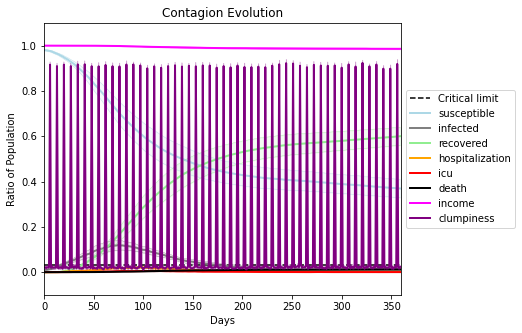

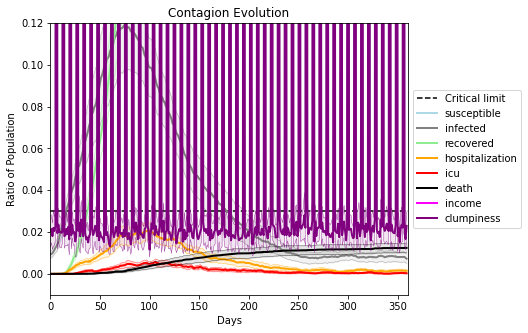

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8378, 2607, 6205, 4446, 5965, 3504, 4463, 3725, 1521, 2272, 746, 257, 2534, 4946, 1460, 4954, 4906, 3650, 1380, 2040]
Average similarity between family members is 0.3614563576987249 at temperature -0.7
Average similarity between family and home is 0.9998556543099346 at temperature -1
Average similarity between students and their classroom is 0.18590886764310188 at temperature -0.7
Average classroom occupancy is 4.070422535211268 and number classrooms is 71
Average similarity between workers is 0.18382915493953358 at temperature -0.7
Average office occupancy is 3.2450980392156863 and number offices is 204
Average friend similarity for adults: 0.428791183203617 for kids: 0.2785616350600046
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.0661534370059892
avg restaurant similarity 0.07693729949430274
avg restaurant similarity 0.11611211626232455
avg restaurant similarity 0.05682947135238804
avg restaurant similarity 0.05425006188813155
avg restaurant similarity 0.07309322682891461
avg restaurant similarity 0.12762276339429476
avg restaurant similarity 0.0782704184697338
avg restaurant similarity 0.12488188896343111
avg restaurant similarity 0.07226161255611806
avg restaurant similarity 0.17167925566461734
avg restaurant similarity 0.11199917807384435
avg restaurant similarity 0.10707364616539342
avg restaurant similarity 0.1467153684900329
avg restaurant similarity 0.10762777803335312
avg restaurant similarity 0.059136314961562526
avg restaurant similarity 0.05181073315710147
avg restaurant similarity 0.10266383518333791
avg restaurant similarity 0.0939521143444866
avg restaurant similarity 0.10447514532599485
avg restaurant similarity 0.08320181513284726
avg restaurant similarity 0.050608619

avg restaurant similarity 0.1179009301248467
avg restaurant similarity 0.08462267734893293
avg restaurant similarity 0.10567837954818114
avg restaurant similarity 0.11852813456420269
avg restaurant similarity 0.0610196153150238
avg restaurant similarity 0.1408778476576085
avg restaurant similarity 0.12915093879949202
avg restaurant similarity 0.08525682864737359
avg restaurant similarity 0.08540192800145988
avg restaurant similarity 0.026287512228154754
avg restaurant similarity 0.13914768867356075
avg restaurant similarity 0.07368701993170136
avg restaurant similarity 0.11317482793705724
avg restaurant similarity 0.10224237616692751
avg restaurant similarity 0.11236382764590884
avg restaurant similarity 0.11553717658499904
avg restaurant similarity 0.14404096848908082
avg restaurant similarity 0.08931379280331941
avg restaurant similarity 0.06978452037989953
avg restaurant similarity 0.04343381495352716
avg restaurant similarity 0.05963870149542034
avg restaurant similarity 0.09640705

avg restaurant similarity 0.06410205843094899
avg restaurant similarity 0.060684442979369264
avg restaurant similarity 0.0223884566037241
avg restaurant similarity 0.05239298953741345
avg restaurant similarity 0.12080193614915581
avg restaurant similarity 0.06328615666317666
avg restaurant similarity 0.0757433718226191
avg restaurant similarity 0.07099240142257733
avg restaurant similarity 0.051939030636680636
avg restaurant similarity 0.0687656172278985
avg restaurant similarity 0.06139258787280615
avg restaurant similarity 0.08763588256278919
avg restaurant similarity 0.12980846638872343
avg restaurant similarity 0.11037333385328477
avg restaurant similarity 0.08838134845899653
avg restaurant similarity 0.027737869629157138
avg restaurant similarity 0.05486184483118918
avg restaurant similarity 0.11689440884063637
avg restaurant similarity 0.0989405019918853
avg restaurant similarity 0.041290140692494676
avg restaurant similarity 0.06435366492062071
avg restaurant similarity 0.054803

avg restaurant similarity 0.08543124910281612
avg restaurant similarity 0.10263317881369347
avg restaurant similarity 0.05343007344274415
avg restaurant similarity 0.10991941501243749
avg restaurant similarity 0.06788747309485861
avg restaurant similarity 0.046859151586821295
avg restaurant similarity 0.0826160009386516
avg restaurant similarity 0.08266955792534056
avg restaurant similarity 0.08520765939728474
avg restaurant similarity 0.08028569852882897
avg restaurant similarity 0.10488032772861362
avg restaurant similarity 0.015439872200338125
avg restaurant similarity 0.0923602236172763
avg restaurant similarity 0.07282263582233728
avg restaurant similarity 0.12614296695532828
avg restaurant similarity 0.04329060029669163
avg restaurant similarity 0.08037368778756612
avg restaurant similarity 0.09604538988340265
avg restaurant similarity 0.08199147345471451
avg restaurant similarity 0.08148226872128943
avg restaurant similarity 0.09415737553400387
avg restaurant similarity 0.092390

avg restaurant similarity 0.07868392441131193
avg restaurant similarity 0.07110723238167756
avg restaurant similarity 0.08413706214891122
avg restaurant similarity 0.09868415015927742
avg restaurant similarity 0.11389449129498012
avg restaurant similarity 0.04279277985377299
avg restaurant similarity 0.05993816494518983
avg restaurant similarity 0.06832280794861817
avg restaurant similarity 0.037522334165169834
avg restaurant similarity 0.13905977600936342
avg restaurant similarity 0.038604647443358495
avg restaurant similarity 0.0647559212963416
avg restaurant similarity 0.08945837429056026
avg restaurant similarity 0.10835817474611388
avg restaurant similarity 0.09760152410966036
avg restaurant similarity 0.09687147007047552
avg restaurant similarity 0.08926073142994093
avg restaurant similarity 0.0666947132304355
avg restaurant similarity 0.037803078163819226
avg restaurant similarity 0.0812371377175753
avg restaurant similarity 0.09163277799246332
avg restaurant similarity 0.094925

avg restaurant similarity 0.08933637355294428
avg restaurant similarity 0.0548663313969676
avg restaurant similarity 0.07060613901980703
avg restaurant similarity 0.08196488680900212
avg restaurant similarity 0.06882143458870069
avg restaurant similarity 0.10175216335653853
avg restaurant similarity 0.08408145968505704
avg restaurant similarity 0.07308422301153603
avg restaurant similarity 0.01805468396434644
avg restaurant similarity 0.0729042762885835
avg restaurant similarity 0.102202744229497
avg restaurant similarity 0.040586428338770936
avg restaurant similarity 0.04715236520653244
avg restaurant similarity 0.1230558647176468
avg restaurant similarity 0.07529160792595375
avg restaurant similarity 0.08239948514592589
avg restaurant similarity 0.10673777054930648
avg restaurant similarity 0.058656157157376335
avg restaurant similarity 0.06952103983269203
avg restaurant similarity 0.0911303570280128
avg restaurant similarity 0.04441179558134458
avg restaurant similarity 0.0852785796

avg restaurant similarity 0.01676678565438207
avg restaurant similarity 0.13555564147138233
avg restaurant similarity 0.09986390390075431
avg restaurant similarity 0.07282754500103485
avg restaurant similarity 0.077028575577604
avg restaurant similarity 0.06787412046148074
avg restaurant similarity 0.02420709102329389
avg restaurant similarity 0.019926842966876086
avg restaurant similarity 0.042045557983470025
avg restaurant similarity 0.07714631810749092
avg restaurant similarity 0.1227475229653112
avg restaurant similarity 0.09201232586469112
avg restaurant similarity 0.00249578976512311
avg restaurant similarity 0.0666641920578954
avg restaurant similarity 0.17353634073317922
avg restaurant similarity 0.09126805049430822
avg restaurant similarity 0.05854535921745209
avg restaurant similarity 0.06325279579655034
avg restaurant similarity 0.10404761445871458
avg restaurant similarity 0.048672249058723374
avg restaurant similarity 0.015040683943667024
avg restaurant similarity 0.098113

avg restaurant similarity 0.04321080413705852
avg restaurant similarity 0.06867644755141557
avg restaurant similarity 0.09751586837972673
avg restaurant similarity 0.06885251946826836
avg restaurant similarity 0.170532812789593
avg restaurant similarity 0.05572685154068953
avg restaurant similarity 0.07119815254178498
avg restaurant similarity 0.02286890245964083
avg restaurant similarity 0.0759561167612731
avg restaurant similarity 0.060332191803749366
avg restaurant similarity 0.04613271744160572
avg restaurant similarity 0.15603193721457861
avg restaurant similarity 0.07419297476704928
avg restaurant similarity 0.11109478131473588
avg restaurant similarity 0.06312071516026901
avg restaurant similarity 0.0877458217009743
avg restaurant similarity 0.04956521761959986
avg restaurant similarity 0.10826283951908369
avg restaurant similarity 0.012473452409227035
avg restaurant similarity 0.09943678461198749
avg restaurant similarity 0.1066178038618956
avg restaurant similarity 0.088981453

avg restaurant similarity 0.05794726521615732
avg restaurant similarity 0.08998663504959438
avg restaurant similarity 0.04268850903132125
avg restaurant similarity 0.044573748526653266
avg restaurant similarity 0.06675478132005876
avg restaurant similarity 0.05857842781085802
avg restaurant similarity 0.07259617169613512
avg restaurant similarity 0.05965178364366053
avg restaurant similarity 0.07057040878356377
avg restaurant similarity 0.08928387787598707
avg restaurant similarity 0.035161080917646144
avg restaurant similarity 0.09518033673110482
avg restaurant similarity 0.08393047735868256
avg restaurant similarity 0.10371514677218718
avg restaurant similarity 0.05982325250270117
avg restaurant similarity 0.08214981387598336
avg restaurant similarity 0.024906756109676405
avg restaurant similarity 0.03450323313032643
avg restaurant similarity 0.13181801172521052
avg restaurant similarity 0.03510931079188804
avg restaurant similarity 0.07358547467364956
avg restaurant similarity 0.072

avg restaurant similarity 0.10063453153790396
avg restaurant similarity 0.10208990725333285
avg restaurant similarity 0.023727610564011556
avg restaurant similarity 0.05473806822303938
avg restaurant similarity 0.053827312646943515
avg restaurant similarity -0.005852067992550694
avg restaurant similarity 0.06719439047498989
avg restaurant similarity 0.06310734199860665
avg restaurant similarity 0.09503757706220273
avg restaurant similarity 0.07021782934381259
avg restaurant similarity 0.0643849189160257
avg restaurant similarity 0.08859185532660441
avg restaurant similarity 0.08946038140990775
avg restaurant similarity 0.04947717281674788
avg restaurant similarity 0.11403939203295554
avg restaurant similarity 0.12897289613354598
avg restaurant similarity 0.14390253161418
avg restaurant similarity 0.05901266105350611
avg restaurant similarity 0.04285669870871395
avg restaurant similarity 0.04675915339739179
avg restaurant similarity 0.08380264416192722
avg restaurant similarity 0.037050

avg restaurant similarity 0.02528681882285119
avg restaurant similarity 0.05991392363441219
avg restaurant similarity 0.07716394987355044
avg restaurant similarity 0.06526683006233588
avg restaurant similarity 0.08322045974088031
avg restaurant similarity 0.06714344108894608
avg restaurant similarity 0.11050633984750696
avg restaurant similarity 0.08672614522738863
avg restaurant similarity 0.09635649707275694
avg restaurant similarity 0.053187563121193035
avg restaurant similarity 0.09040792786834717
avg restaurant similarity 0.04875017267839073
avg restaurant similarity 0.08509911598462298
avg restaurant similarity 0.11525064825478286
avg restaurant similarity 0.1054908631702325
avg restaurant similarity 0.14033958146382597
avg restaurant similarity 0.08866620220497216
avg restaurant similarity 0.09721013057775715
avg restaurant similarity 0.07198281634196789
avg restaurant similarity 0.09750236805223085
avg restaurant similarity 0.04805085877933578
avg restaurant similarity 0.093864

avg restaurant similarity 0.11833582947022794
avg restaurant similarity 0.09758479108085619
avg restaurant similarity 0.08327990960606169
avg restaurant similarity 0.09142987947795289
avg restaurant similarity 0.07367547639321105
avg restaurant similarity 0.037581729608009644
avg restaurant similarity 0.08980153787677263
avg restaurant similarity 0.0834100566708995
avg restaurant similarity 0.06513739192870312
avg restaurant similarity 0.06229657951857906
avg restaurant similarity 0.06215585682380577
avg restaurant similarity 0.11390330088230807
avg restaurant similarity 0.09715436719633458
avg restaurant similarity 0.048924464392243655
avg restaurant similarity 0.04177506747014574
avg restaurant similarity 0.009283105323705295
avg restaurant similarity 0.08757051324570565
avg restaurant similarity 0.038667604668410696
avg restaurant similarity 0.11108954641195211
avg restaurant similarity 0.08858923440287694
avg restaurant similarity 0.04916305113611457
avg restaurant similarity 0.015

avg restaurant similarity 0.059998823430183174
avg restaurant similarity 0.0010130047098937233
avg restaurant similarity 0.06777015684720132
avg restaurant similarity 0.025476309723078922
avg restaurant similarity 0.020785249220265277
avg restaurant similarity 0.04992176978814488
avg restaurant similarity 0.08088318202933271
avg restaurant similarity 0.060931385433879104
avg restaurant similarity 0.028192568552844424
avg restaurant similarity -0.013166241230887627
avg restaurant similarity 0.07885628920540913
avg restaurant similarity 0.04948243605976275
avg restaurant similarity 0.07205675133976017
avg restaurant similarity 0.007722257758900235
avg restaurant similarity 0.030080370554254998
avg restaurant similarity 0.07257305218637701
avg restaurant similarity 0.031705261056534116
avg restaurant similarity 0.05330945291446373
avg restaurant similarity 0.04179152337772657
avg restaurant similarity 0.044641030979230126
avg restaurant similarity 0.058744952589576606
avg restaurant simil

avg restaurant similarity 0.1152168077114454
avg restaurant similarity 0.06002900017416832
avg restaurant similarity 0.023376103793402134
avg restaurant similarity 0.04424268092550307
avg restaurant similarity 0.004770567505854597
avg restaurant similarity 0.038124988412216496
avg restaurant similarity 0.04198070665920339
avg restaurant similarity 0.0872321829715957
avg restaurant similarity 0.04350222202050723
avg restaurant similarity 0.033148758360080834
avg restaurant similarity 0.009080002646139165
avg restaurant similarity 0.07524036483797263
avg restaurant similarity 0.04262004189203133
avg restaurant similarity 0.017579946775780685
avg restaurant similarity 0.07892811639448448
avg restaurant similarity 0.061965210394421086
avg restaurant similarity 0.0430345859578493
avg restaurant similarity 0.02996683780048494
avg restaurant similarity -0.0168174232764442
avg restaurant similarity 0.02183836586875827
avg restaurant similarity 0.01326202288440321
avg restaurant similarity 0.06

avg restaurant similarity 0.07215049585793702
avg restaurant similarity 0.05020592889054609
avg restaurant similarity -0.01278047423202961
avg restaurant similarity 0.002784566678524137
avg restaurant similarity 0.08850449963420015
avg restaurant similarity 0.08017074041353563
avg restaurant similarity 0.05722023248345206
avg restaurant similarity 0.09379291537775396
avg restaurant similarity 0.08052860158955352
avg restaurant similarity 0.0706451315653141
avg restaurant similarity 0.018453371763525375
avg restaurant similarity 0.032737952213903604
avg restaurant similarity 0.02963453144537067
avg restaurant similarity 0.09172640027954419
avg restaurant similarity 0.10840601199337048
avg restaurant similarity 0.07853253296212938
avg restaurant similarity 0.0519568421396348
avg restaurant similarity 0.13050138734406314
avg restaurant similarity 0.08102683816733718
avg restaurant similarity 0.10988798692207524
avg restaurant similarity 0.04424207696397647
avg restaurant similarity 0.0434

avg restaurant similarity 0.08645664842682776
avg restaurant similarity 0.01234042548801913
avg restaurant similarity 0.05883139569163849
avg restaurant similarity 0.05821355458263755
avg restaurant similarity 0.08552207260270207
avg restaurant similarity 0.08480603635129648
avg restaurant similarity 0.08083679136010047
avg restaurant similarity 0.06409213528945061
avg restaurant similarity 0.04241166998042845
avg restaurant similarity 0.07610547138050586
avg restaurant similarity 0.04277035089694454
avg restaurant similarity 0.0330320051262448
avg restaurant similarity 0.08372447255261908
avg restaurant similarity 0.02070613610945448
avg restaurant similarity 0.044718424071338934
avg restaurant similarity 0.02718416208860751
avg restaurant similarity 0.08067733889537641
avg restaurant similarity 0.07615151248963424
avg restaurant similarity 0.08385227265454542
avg restaurant similarity 0.08704397478990092
avg restaurant similarity 0.0714448114560313
avg restaurant similarity 0.0723299

avg restaurant similarity 0.069665723809973
avg restaurant similarity 0.10964988996359692
avg restaurant similarity 0.08353870584484298
avg restaurant similarity 0.029014596754603487
avg restaurant similarity 0.04063259584554773
avg restaurant similarity 0.08861850865503025
avg restaurant similarity 0.061046036086103636
avg restaurant similarity 0.03680301083228898
avg restaurant similarity 0.048787981714700224
avg restaurant similarity 0.03071841400676009
avg restaurant similarity 0.010203841138178106
avg restaurant similarity 0.04728749168376182
avg restaurant similarity 0.04892449981342099
avg restaurant similarity 0.015515954352777795
avg restaurant similarity 0.05400150254407431
avg restaurant similarity 0.06342198189626065
avg restaurant similarity 0.06492693720632636
avg restaurant similarity 0.040427155729726674
avg restaurant similarity 0.0724502734498863
avg restaurant similarity 0.07423021708681293
avg restaurant similarity 0.07378865897985339
avg restaurant similarity 0.164

avg restaurant similarity 0.02375026837678813
avg restaurant similarity 0.13114945968493386
avg restaurant similarity -0.01141617368936464
avg restaurant similarity 0.1034558195678245
avg restaurant similarity 0.07520608899059784
avg restaurant similarity 0.07853754881962721
avg restaurant similarity 0.07447716060888564
avg restaurant similarity 0.07078679285705525
avg restaurant similarity 0.04478944259765453
avg restaurant similarity 0.07399128932440867
avg restaurant similarity 0.0831796644289142
avg restaurant similarity 0.04192790538109227
avg restaurant similarity 0.11655590226947726
avg restaurant similarity 0.08942457056176914
avg restaurant similarity 0.049996958664134596
avg restaurant similarity 0.030746163010321657
avg restaurant similarity 0.05462328220452589
avg restaurant similarity 0.05684174699042349
avg restaurant similarity 0.19528469904455664
avg restaurant similarity 0.07086544746543563
avg restaurant similarity 0.05692846724859602
avg restaurant similarity 0.06651

avg restaurant similarity 0.06162537667553833
avg restaurant similarity 0.08175942547546038
avg restaurant similarity 0.06245520299346671
avg restaurant similarity 0.15441851128051592
avg restaurant similarity 0.06747876284975167
avg restaurant similarity 0.062443839408283214
avg restaurant similarity 0.12244729706766092
avg restaurant similarity 0.04352932559564633
avg restaurant similarity 0.04513147791618833
avg restaurant similarity 0.07038807255409636
avg restaurant similarity 0.0904851949756373
avg restaurant similarity 0.09921103167745916
avg restaurant similarity 0.10803565043537576
avg restaurant similarity 0.07530748895682524
avg restaurant similarity 0.07069079477774444
avg restaurant similarity 0.0995818466651382
avg restaurant similarity 0.07226094045052778
avg restaurant similarity 0.08906155758530636
avg restaurant similarity 0.12893869612404057
avg restaurant similarity 0.01280063733301855
avg restaurant similarity 0.08824423139012312
avg restaurant similarity 0.1378164

avg restaurant similarity 0.07596437105663595
avg restaurant similarity 0.08001317317340989
avg restaurant similarity 0.12097407731984318
avg restaurant similarity 0.11364231883537228
avg restaurant similarity 0.09108487452800663
avg restaurant similarity 0.11386820663127281
avg restaurant similarity 0.10683760403934144
avg restaurant similarity 0.0413976870249688
avg restaurant similarity 0.12341133839914038
avg restaurant similarity 0.07048430913299089
avg restaurant similarity 0.06823210817108674
avg restaurant similarity 0.02838541714232047
avg restaurant similarity 0.0332175656313097
avg restaurant similarity 0.08664488519681836
avg restaurant similarity 0.11938523080344307
avg restaurant similarity 0.11463852937353304
avg restaurant similarity 0.08558852219910693
avg restaurant similarity 0.10999146368846213
avg restaurant similarity 0.10319450826525944
avg restaurant similarity 0.050409346756611975
avg restaurant similarity 0.08369149024519372
avg restaurant similarity 0.0336554

avg restaurant similarity 0.05276793796295516
avg restaurant similarity 0.09417152279823393
avg restaurant similarity 0.06522142448397844
avg restaurant similarity 0.07851115220452795
avg restaurant similarity 0.03792471202525757
avg restaurant similarity 0.08941234708339676
avg restaurant similarity 0.06593599988430743
avg restaurant similarity 0.080888651299383
avg restaurant similarity 0.08397249889434176
avg restaurant similarity 0.031639400101025957
avg restaurant similarity 0.07999295922888662
avg restaurant similarity 0.04701888094421385
avg restaurant similarity 0.06549824771178123
avg restaurant similarity 0.06467668104572813
avg restaurant similarity 0.09717519809613269
avg restaurant similarity 0.08608349757440245
avg restaurant similarity 0.07558724233883149
avg restaurant similarity 0.08865083036394569
avg restaurant similarity 0.18088102124103314
avg restaurant similarity 0.047437591973474455
avg restaurant similarity 0.03508323755338772
avg restaurant similarity 0.078317

avg restaurant similarity 0.0325989078468291
avg restaurant similarity 0.0751114767571585
avg restaurant similarity 0.03777449297304243
avg restaurant similarity 0.0796144037854467
avg restaurant similarity 0.06655905322447699
avg restaurant similarity 0.08407004361053493
avg restaurant similarity 0.06837558980711798
avg restaurant similarity 0.06578069625744587
avg restaurant similarity 0.04362392686500829
avg restaurant similarity 0.11574433293559251
avg restaurant similarity 0.07534492272597429
avg restaurant similarity 0.0860504876205368
avg restaurant similarity 0.03716635210106173
avg restaurant similarity 0.10617080436663899
avg restaurant similarity 0.08441048198058217
avg restaurant similarity 0.13724395994217786
avg restaurant similarity 0.070569806916288
avg restaurant similarity 0.07759601372407372
avg restaurant similarity 0.10615720122890357
avg restaurant similarity 0.01806748643994693
avg restaurant similarity 0.09687988066766069
avg restaurant similarity 0.053925180696

avg restaurant similarity 0.07415165248162552
avg restaurant similarity 0.12488640318456679
avg restaurant similarity 0.09341296527293529
avg restaurant similarity 0.10423672714244271
avg restaurant similarity 0.11934731380825285
avg restaurant similarity 0.10306139260103177
avg restaurant similarity 0.03692712175044894
avg restaurant similarity 0.0693478104766465
avg restaurant similarity 0.11477892050030948
avg restaurant similarity 0.06238172178891008
avg restaurant similarity 0.10343832166963224
avg restaurant similarity 0.06946166244587265
avg restaurant similarity 0.033505658687681565
avg restaurant similarity 0.09298841477573941
avg restaurant similarity 0.08080304132794836
avg restaurant similarity 0.05626581086305876
avg restaurant similarity 0.07240114214760805
avg restaurant similarity 0.08271777745809891
avg restaurant similarity 0.08293941882601431
avg restaurant similarity 0.1045213905044457
avg restaurant similarity 0.03704900403916622
avg restaurant similarity 0.0407191

avg restaurant similarity 0.05912037289777051
avg restaurant similarity 0.0925884688256918
avg restaurant similarity 0.0555681721881302
avg restaurant similarity 0.055399351231974064
avg restaurant similarity 0.1346399711143022
avg restaurant similarity 0.04957723958471663
avg restaurant similarity 0.005123883931194868
avg restaurant similarity 0.1093551319349031
avg restaurant similarity 0.09731764539939998
avg restaurant similarity 0.09486578035701587
avg restaurant similarity 0.02645821966302311
avg restaurant similarity 0.05670048840668358
avg restaurant similarity 0.0497896862340415
avg restaurant similarity 0.0560478556882596
avg restaurant similarity 0.04716851480968185
avg restaurant similarity 0.03032608502188324
avg restaurant similarity 0.11372151798418363
avg restaurant similarity 0.06163889431992606
avg restaurant similarity 0.07218109029011384
avg restaurant similarity 0.08898177731985626
avg restaurant similarity 0.07146325097819907
avg restaurant similarity 0.0557310062

avg restaurant similarity 0.1725140009932246
avg restaurant similarity 0.09695715271139563
avg restaurant similarity 0.11359107670455325
avg restaurant similarity 0.11265284434947528
avg restaurant similarity 0.12264940325971113
avg restaurant similarity 0.11506849006748615
avg restaurant similarity 0.10226962151572551
avg restaurant similarity 0.07196555506063891
avg restaurant similarity 0.10080152257072417
avg restaurant similarity 0.018513888944224732
avg restaurant similarity 0.09263769105960581
avg restaurant similarity 0.09458002216603409
avg restaurant similarity 0.05885335087325265
avg restaurant similarity 0.09784312063852198
avg restaurant similarity 0.06131649597359575
avg restaurant similarity 0.04239109716024203
avg restaurant similarity 0.11509781124862387
avg restaurant similarity 0.03873837970620411
avg restaurant similarity 0.10580796031142932
avg restaurant similarity 0.09975339913290936
avg restaurant similarity 0.10702651414945791
avg restaurant similarity 0.085881

avg restaurant similarity 0.10423307995934716
avg restaurant similarity 0.02349388528299797
avg restaurant similarity 0.11283107217204721
avg restaurant similarity 0.11103834309084105
avg restaurant similarity 0.06022406909847723
avg restaurant similarity 0.05851370295984108
avg restaurant similarity 0.07333791245403488
avg restaurant similarity 0.09258940246915909
avg restaurant similarity 0.060894832447302226
avg restaurant similarity 0.12619894446169796
avg restaurant similarity 0.11486029063887063
avg restaurant similarity 0.06743324678613022
avg restaurant similarity 0.12183289990414496
avg restaurant similarity 0.09212891793296422
avg restaurant similarity 0.09184645369310694
avg restaurant similarity 0.0526215545726262
avg restaurant similarity 0.11046139496793282
avg restaurant similarity 0.07045991958969795
avg restaurant similarity 0.10200238030867462
avg restaurant similarity 0.086865573989661
avg restaurant similarity 0.10054772761104797
avg restaurant similarity 0.07519954

avg restaurant similarity 0.03800589715340472
avg restaurant similarity 0.06571950305533257
avg restaurant similarity 0.08846942705005613
avg restaurant similarity 0.0649508056404862
avg restaurant similarity 0.016484392610804696
avg restaurant similarity 0.08931758077152883
avg restaurant similarity 0.11212711188650826
avg restaurant similarity 0.025966729196253733
avg restaurant similarity 0.011125999110608782
avg restaurant similarity 0.05354340786754787
avg restaurant similarity 0.11308067969452779
avg restaurant similarity 0.07382582671006405
avg restaurant similarity 0.12003493744579764
avg restaurant similarity 0.06155696410351664
avg restaurant similarity 0.08336239280129702
avg restaurant similarity 0.08313078068655616
avg restaurant similarity 0.08375071649908215
avg restaurant similarity 0.1138261159350543
avg restaurant similarity 0.06893757490794711
avg restaurant similarity 0.06484918559230149
avg restaurant similarity 0.052589615234055635
avg restaurant similarity 0.0444

avg restaurant similarity 0.09803305418208304
avg restaurant similarity 0.08869084247187047
avg restaurant similarity 0.08797787915415725
avg restaurant similarity 0.0859998073918033
avg restaurant similarity 0.10391244583787591
avg restaurant similarity 0.06616943979768809
avg restaurant similarity 0.08812010853369498
avg restaurant similarity 0.08571712592352947
avg restaurant similarity 0.10452841505944856
avg restaurant similarity 0.13524021353275495
avg restaurant similarity 0.0850141618184022
avg restaurant similarity 0.06652652257503433
avg restaurant similarity 0.010479494510673353
avg restaurant similarity 0.03300372767790997
avg restaurant similarity 0.07628219612830375
avg restaurant similarity 0.10141917728905558
avg restaurant similarity 0.07761042551590558
avg restaurant similarity 0.0541451011542944
avg restaurant similarity 0.10166501798578169
avg restaurant similarity 0.04066815521123669
avg restaurant similarity 0.02424246143381278
avg restaurant similarity 0.09448448

avg restaurant similarity 0.14580034101907532
avg restaurant similarity 0.08023737066037712
avg restaurant similarity 0.11524364101716572
avg restaurant similarity 0.049725937689151824
avg restaurant similarity 0.08937371387748892
avg restaurant similarity 0.06917930550672605
avg restaurant similarity 0.0192210543643461
avg restaurant similarity 0.04517084706414611
avg restaurant similarity 0.055163993872029644
avg restaurant similarity 0.09110393900007994
avg restaurant similarity 0.0918307217840285
avg restaurant similarity 0.1018229821788988
avg restaurant similarity 0.05611776768452426
avg restaurant similarity 0.08941804526455793
avg restaurant similarity 0.09859426588444807
avg restaurant similarity 0.022649073599301173
avg restaurant similarity 0.08345366141902426
avg restaurant similarity 0.09027948700078142
avg restaurant similarity 0.06915555587223247
avg restaurant similarity 0.027344564641535334
avg restaurant similarity 0.049722316786205936
avg restaurant similarity 0.0624

avg restaurant similarity 0.08828461308421603
avg restaurant similarity 0.06611533305494587
avg restaurant similarity 0.03912582205956896
avg restaurant similarity 0.040041693715485285
avg restaurant similarity 0.05592488848000981
avg restaurant similarity 0.06991025850407454
avg restaurant similarity 0.08154748613433443
avg restaurant similarity 0.06528522316449994
avg restaurant similarity 0.041936125594284016
avg restaurant similarity 0.09320099988030056
avg restaurant similarity 0.055791485421720265
avg restaurant similarity 0.10376876274635012
avg restaurant similarity 0.07867496205274549
avg restaurant similarity 0.08765564193306638
avg restaurant similarity 0.07153804896662298
avg restaurant similarity 0.04965178542316664
avg restaurant similarity 0.05220821317176056
avg restaurant similarity 0.05771213672063196
avg restaurant similarity 0.06025295740706578
avg restaurant similarity 0.027719797044725387
avg restaurant similarity 0.09480967408689828
avg restaurant similarity 0.04

avg restaurant similarity 0.12474812137506733
avg restaurant similarity 0.04456794380564562
avg restaurant similarity 0.03457382782062362
avg restaurant similarity 0.12008513950708072
avg restaurant similarity 0.13063192609912117
avg restaurant similarity 0.056318747210580646
avg restaurant similarity 0.0794382058559101
avg restaurant similarity 0.08181988543569009
avg restaurant similarity 0.0733878586443945
avg restaurant similarity 0.1106235276328383
avg restaurant similarity 0.09395041277582673
avg restaurant similarity 0.04735406278030142
avg restaurant similarity 0.10880785891149565
avg restaurant similarity 0.06601816251031005
avg restaurant similarity 0.12189729703784005
avg restaurant similarity 0.05242644395755346
avg restaurant similarity 0.06869409907565463
avg restaurant similarity 0.08013479330575993
avg restaurant similarity 0.08700383872397167
avg restaurant similarity 0.0923902793005731
avg restaurant similarity 0.09041527861465204
avg restaurant similarity 0.087784103

avg restaurant similarity 0.08412942960234762
avg restaurant similarity 0.09498780860805713
avg restaurant similarity 0.08753637531734133
avg restaurant similarity 0.0652110560995521
avg restaurant similarity 0.08910990220619286
avg restaurant similarity 0.07518901069142413
avg restaurant similarity 0.07500150417629878
avg restaurant similarity 0.08300542532577831
avg restaurant similarity 0.0027379783294988022
avg restaurant similarity 0.10658707023312355
avg restaurant similarity 0.0830539793416351
avg restaurant similarity 0.0907910968227539
avg restaurant similarity 0.08603095299162362
avg restaurant similarity 0.14791686020563424
avg restaurant similarity 0.11037563954187317
avg restaurant similarity 0.06275345566778302
avg restaurant similarity 0.04622355642107069
avg restaurant similarity 0.08565455408900122
avg restaurant similarity 0.11860416235193501
avg restaurant similarity 0.11186798512266313
avg restaurant similarity 0.07528190855242493
avg restaurant similarity 0.0732253

avg restaurant similarity 0.032039371688611186
avg restaurant similarity 0.05173859145055415
avg restaurant similarity 0.05116035542893003
avg restaurant similarity 0.019406986663978967
avg restaurant similarity 0.08272761163161133
avg restaurant similarity 0.06665304421857982
avg restaurant similarity 0.04592448696737069
avg restaurant similarity 0.06937393654841241
avg restaurant similarity 0.06292899032660049
avg restaurant similarity 0.0778393480502312
avg restaurant similarity 0.08011807224259038
avg restaurant similarity 0.11313068421955859
avg restaurant similarity 0.091702638509934
avg restaurant similarity 0.04318321463522253
avg restaurant similarity 0.0937004376231828
avg restaurant similarity 0.050610687688102285
avg restaurant similarity 0.02914480412016313
avg restaurant similarity 0.020909013115310387
avg restaurant similarity 0.04651823305907045
avg restaurant similarity 0.072845790204351
avg restaurant similarity 0.07725081876433156
avg restaurant similarity 0.06285956

avg restaurant similarity 0.06653163544826303
avg restaurant similarity 0.021820440093506147
avg restaurant similarity 0.03174484883866057
avg restaurant similarity 0.0749138113223724
avg restaurant similarity 0.05827243235644603
avg restaurant similarity 0.04768994267532278
avg restaurant similarity 0.026742690908522868
avg restaurant similarity 0.02877870175198419
avg restaurant similarity 0.04653121505524745
avg restaurant similarity 0.07473059604700907
avg restaurant similarity 0.07152247939903483
avg restaurant similarity 0.002238974845168824
avg restaurant similarity 0.05369378735280725
avg restaurant similarity 0.10521045741450187
avg restaurant similarity 0.11128627263068042
avg restaurant similarity 0.023477120965615397
avg restaurant similarity 0.10639884331053807
avg restaurant similarity 0.019178614162193852
avg restaurant similarity 0.04420327602407288
avg restaurant similarity 0.011331565903907933
avg restaurant similarity 0.0564723831429771
avg restaurant similarity 0.04

avg restaurant similarity 0.08835828847984901
avg restaurant similarity 0.042777719358847506
avg restaurant similarity 0.1126351779008056
avg restaurant similarity 0.12345103791733845
avg restaurant similarity 0.10917082183588234
avg restaurant similarity 0.04083040572299622
avg restaurant similarity 0.075536904952699
avg restaurant similarity 0.05638391004570842
avg restaurant similarity 0.11996401424955414
avg restaurant similarity 0.06942593501506167
avg restaurant similarity 0.14083911886041722
avg restaurant similarity 0.08360220529357167
avg restaurant similarity 0.094999333685651
avg restaurant similarity 0.07866426306371319
avg restaurant similarity 0.08583829242071302
avg restaurant similarity 0.11770944686354197
avg restaurant similarity 0.08294401180489501
avg restaurant similarity 0.10514446571880746
avg restaurant similarity 0.09820440955926545
avg restaurant similarity 0.053365845914338544
avg restaurant similarity 0.06650742960241078
avg restaurant similarity 0.099152169

avg restaurant similarity 0.10498185376779144
avg restaurant similarity 0.12719376081167585
avg restaurant similarity 0.1429676480179746
avg restaurant similarity 0.14390150006134061
avg restaurant similarity 0.11685018460290583
avg restaurant similarity 0.038743579326186724
avg restaurant similarity 0.06977684277424132
avg restaurant similarity 0.0938766975429372
avg restaurant similarity 0.0914207209078935
avg restaurant similarity 0.09895133130620057
avg restaurant similarity 0.10452833585942833
avg restaurant similarity 0.08069726331551041
avg restaurant similarity 0.07071534486369474
avg restaurant similarity 0.08688702889474638
avg restaurant similarity 0.07977660298485642
avg restaurant similarity 0.10198590707293735
avg restaurant similarity 0.06712437544958202
avg restaurant similarity 0.0886011017962101
avg restaurant similarity 0.12356124738993612
avg restaurant similarity 0.07024511309990968
avg restaurant similarity 0.09883971904973887
avg restaurant similarity 0.086720749

avg restaurant similarity 0.058654679790694136
avg restaurant similarity 0.1346725028956853
avg restaurant similarity 0.09271208613089213
avg restaurant similarity 0.08336697715084429
avg restaurant similarity 0.04618774597696123
avg restaurant similarity 0.09649259673301053
avg restaurant similarity 0.12625812923009444
avg restaurant similarity 0.06962041750706757
avg restaurant similarity 0.06698875132390705
avg restaurant similarity 0.08973627144454836
avg restaurant similarity 0.06546082380006163
avg restaurant similarity 0.11358029620076458
avg restaurant similarity 0.0764051314500561
avg restaurant similarity 0.1135772653892862
avg restaurant similarity 0.08578811865975254
avg restaurant similarity 0.1096250389453608
avg restaurant similarity 0.02815170997754262
avg restaurant similarity 0.14043727771959938
avg restaurant similarity 0.07739996109321359
avg restaurant similarity 0.059706814911025245
avg restaurant similarity 0.04085065165997022
avg restaurant similarity 0.08190259

avg restaurant similarity 0.0678766315003816
avg restaurant similarity 0.10644222258927602
avg restaurant similarity 0.11555613302774909
avg restaurant similarity 0.061321856899719356
avg restaurant similarity 0.12361271823457963
avg restaurant similarity 0.11852952463679728
avg restaurant similarity 0.07336692601669291
avg restaurant similarity 0.14121438594359054
avg restaurant similarity 0.13619415238725394
avg restaurant similarity 0.0670382171748542
avg restaurant similarity 0.07211882128902698
avg restaurant similarity 0.06327110951906284
avg restaurant similarity 0.1250600384551394
avg restaurant similarity 0.11747356999541612
avg restaurant similarity 0.03489362347949167
avg restaurant similarity 0.09701472436640605
avg restaurant similarity 0.12048023860029938
avg restaurant similarity 0.0398480070659662
avg restaurant similarity 0.05276268534534713
avg restaurant similarity 0.09743263124775983
avg restaurant similarity 0.08305203092445286
avg restaurant similarity 0.049781424

avg restaurant similarity 0.12863503204784968
avg restaurant similarity 0.11691481265823157
avg restaurant similarity 0.05162996453684393
avg restaurant similarity 0.15647087804142806
avg restaurant similarity 0.10000267414097067
avg restaurant similarity 0.1412861922793675
avg restaurant similarity 0.1174725793082197
avg restaurant similarity 0.10982084844280471
avg restaurant similarity 0.107293152754647
avg restaurant similarity 0.0880429718518625
avg restaurant similarity 0.08237230148231377
avg restaurant similarity 0.10099187097403456
avg restaurant similarity 0.09945643940372334
avg restaurant similarity 0.1281795146638335
avg restaurant similarity 0.07415135475122331
avg restaurant similarity 0.07474873869204281
avg restaurant similarity 0.13312722218581316
avg restaurant similarity 0.10963377730920733
avg restaurant similarity 0.07706455705979899
avg restaurant similarity 0.09111200229899408
avg restaurant similarity 0.10713983989030991
avg restaurant similarity 0.141918562135

avg restaurant similarity 0.05619489668133839
avg restaurant similarity 0.09854393957790518
avg restaurant similarity 0.12198269501882103
avg restaurant similarity 0.04300528727472136
avg restaurant similarity 0.11826159780203752
avg restaurant similarity 0.13436600254898182
avg restaurant similarity 0.08212212745857694
avg restaurant similarity 0.08286322811003506
avg restaurant similarity 0.09492329215407594
avg restaurant similarity 0.09749324808307408
avg restaurant similarity 0.119058095333988
avg restaurant similarity 0.1006900888774654
avg restaurant similarity 0.12701348031666806
avg restaurant similarity 0.04926371249838954
avg restaurant similarity 0.08160346147866268
avg restaurant similarity 0.10851883603838001
avg restaurant similarity 0.10983469226788359
avg restaurant similarity 0.10206918816219641
avg restaurant similarity 0.13661172883421813
avg restaurant similarity 0.10955681912795252
avg restaurant similarity 0.07960566958648026
avg restaurant similarity 0.162292276

(<function dict.items>, <function dict.items>, <function dict.items>)

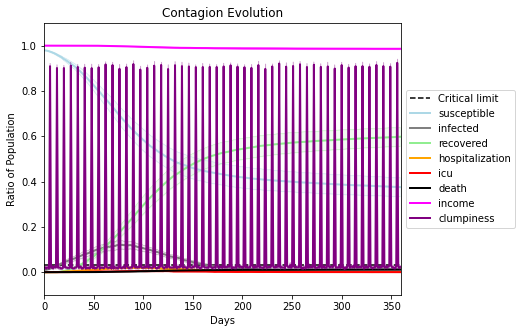

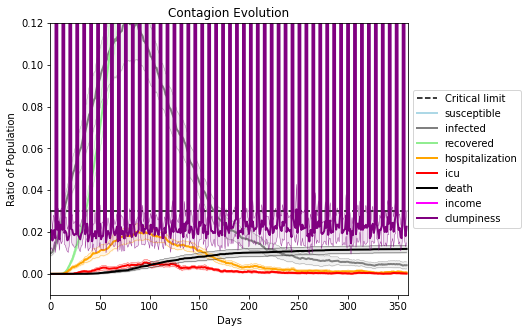

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[8899, 9918, 9683, 8871, 4882, 299, 9718, 7751, 7288, 137, 9738, 790, 2269, 552, 8685, 4484, 3120, 9117, 6325, 563]
Average similarity between family members is 0.30556321988543567 at temperature -0.6
Average similarity between family and home is 0.99985028434459 at temperature -1
Average similarity between students and their classroom is 0.17162041521714155 at temperature -0.6
Average classroom occupancy is 3.9714285714285715 and number classrooms is 70
Average similarity between workers is 0.14607041293426531 at temperature -0.6
Average office occupancy is 3.299019607843137 and number offices is 204
Average friend similarity for adults: 0.38907506715730444 for kids: 0.2168854592217498
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.024095651552462648
avg restaurant similarity 0.021964418638918418
avg restaurant similarity 0.07248920956373824
avg restaurant similarity 0.06340736682958187
avg restaurant similarity 0.06866191791071909
avg restaurant similarity 0.08237539932370543
avg restaurant similarity 0.07909458586485012
avg restaurant similarity 0.07639301195338015
avg restaurant similarity 0.086895749205961
avg restaurant similarity 0.10500445847620378
avg restaurant similarity 0.0727599845697952
avg restaurant similarity 0.07969056048207325
avg restaurant similarity 0.07680157991695714
avg restaurant similarity 0.08812475156567863
avg restaurant similarity 0.09769395603257007
avg restaurant similarity 0.05097296764137861
avg restaurant similarity 0.02037943377483349
avg restaurant similarity 0.06273370806532892
avg restaurant similarity 0.08802544200803575
avg restaurant similarity 0.12342152960447236
avg restaurant similarity 0.10974964263832486
avg restaurant similarity 0.0527114

avg restaurant similarity 0.08794746600345621
avg restaurant similarity 0.10180421766638278
avg restaurant similarity 0.07918056764675051
avg restaurant similarity 0.11272968337316541
avg restaurant similarity 0.028823874021144214
avg restaurant similarity 0.05906278127085802
avg restaurant similarity 0.08956174402984754
avg restaurant similarity 0.08451567423639583
avg restaurant similarity 0.04303331082678672
avg restaurant similarity 0.10065350938667622
avg restaurant similarity 0.03642795790612254
avg restaurant similarity 0.058581823845534335
avg restaurant similarity 0.15878907839173412
avg restaurant similarity 0.08680081017963476
avg restaurant similarity 0.03313367175306281
avg restaurant similarity 0.039782937187928635
avg restaurant similarity 0.07918004226722844
avg restaurant similarity 0.05513353318658728
avg restaurant similarity 0.10103817644699369
avg restaurant similarity 0.05601743069478935
avg restaurant similarity 0.07428268037014
avg restaurant similarity 0.118772

avg restaurant similarity 0.10949519743431697
avg restaurant similarity 0.06517070463093626
avg restaurant similarity 0.056041069439608154
avg restaurant similarity 0.1234850762237211
avg restaurant similarity 0.08241875288636856
avg restaurant similarity 0.06973279064494185
avg restaurant similarity 0.08021781435800128
avg restaurant similarity 0.12289312375405959
avg restaurant similarity 0.0346727689322807
avg restaurant similarity 0.07314708803296924
avg restaurant similarity 0.08125116292177005
avg restaurant similarity 0.06448469714191467
avg restaurant similarity 0.0069286080645507096
avg restaurant similarity 0.046038865003903535
avg restaurant similarity 0.0745651125473677
avg restaurant similarity 0.04369493771101655
avg restaurant similarity 0.08190660661367492
avg restaurant similarity 0.076673529613614
avg restaurant similarity 0.07384035141234581
avg restaurant similarity 0.05888806436178253
avg restaurant similarity 0.05009134720158666
avg restaurant similarity 0.0368550

avg restaurant similarity 0.07333781618118485
avg restaurant similarity 0.061455829697794125
avg restaurant similarity 0.08098512893820536
avg restaurant similarity 0.05482689689269425
avg restaurant similarity 0.08392528647980833
avg restaurant similarity 0.060563724114366536
avg restaurant similarity 0.07492305445538669
avg restaurant similarity 0.06651159904286581
avg restaurant similarity 0.020259801941162777
avg restaurant similarity 0.08737565810155938
avg restaurant similarity 0.06976029738150333
avg restaurant similarity 0.0937487927299562
avg restaurant similarity 0.07247863590530101
avg restaurant similarity 0.10308993879076235
avg restaurant similarity 0.14087746938333873
avg restaurant similarity 0.09680902861977128
avg restaurant similarity 0.06231359857891613
avg restaurant similarity 0.07026070476728405
avg restaurant similarity 0.14369846499472372
avg restaurant similarity 0.11549555080321804
avg restaurant similarity 0.039188541711447956
avg restaurant similarity 0.063

avg restaurant similarity 0.10778450213780341
avg restaurant similarity 0.08645958652910296
avg restaurant similarity 0.018153422089512036
avg restaurant similarity 0.07051307302162962
avg restaurant similarity 0.0312159440635749
avg restaurant similarity 0.07025777573375425
avg restaurant similarity 0.042646907483628003
avg restaurant similarity 0.05625251599124642
avg restaurant similarity 0.06586332330167817
avg restaurant similarity 0.0573678722708411
avg restaurant similarity 0.088683389071149
avg restaurant similarity 0.10661571291390662
avg restaurant similarity 0.06294678477338643
avg restaurant similarity 0.08862543656863549
avg restaurant similarity 0.040994693385175085
avg restaurant similarity 0.08708442145387583
avg restaurant similarity 0.06992936080391632
avg restaurant similarity 0.09233750433524757
avg restaurant similarity 0.08981456307343627
avg restaurant similarity 0.07043985759148753
avg restaurant similarity 0.06525716064876258
avg restaurant similarity 0.0774784

avg restaurant similarity 0.058664896475032625
avg restaurant similarity 0.07492902558378002
avg restaurant similarity 0.09229256202700463
avg restaurant similarity 0.05779146164163953
avg restaurant similarity 0.09461462553066324
avg restaurant similarity 0.05927108614740938
avg restaurant similarity 0.0570503477756936
avg restaurant similarity 0.048032908905563707
avg restaurant similarity 0.10158869027429525
avg restaurant similarity 0.050783666208715154
avg restaurant similarity 0.06355116549982685
avg restaurant similarity 0.051085158868102984
avg restaurant similarity 0.1086866492409286
avg restaurant similarity 0.10967540528013098
avg restaurant similarity 0.055399161403379214
avg restaurant similarity 0.07932817148882136
avg restaurant similarity 0.039500058696139186
avg restaurant similarity 0.07883722533962596
avg restaurant similarity 0.07965819971866565
avg restaurant similarity 0.0885791260679837
avg restaurant similarity 0.08430561333724053
avg restaurant similarity 0.045

avg restaurant similarity 0.06691389247363948
avg restaurant similarity 0.08133789403249803
avg restaurant similarity 0.025762343907031932
avg restaurant similarity 0.035171090339732224
avg restaurant similarity 0.07126505230728825
avg restaurant similarity 0.04968640815561022
avg restaurant similarity 0.08516896141133079
avg restaurant similarity 0.0546515859819246
avg restaurant similarity 0.048477493904186236
avg restaurant similarity 0.07094964083716764
avg restaurant similarity -0.003784556328768679
avg restaurant similarity 0.0004209233741092975
avg restaurant similarity 0.03277726458401515
avg restaurant similarity 0.037762160187990675
avg restaurant similarity 0.1256739356640593
avg restaurant similarity 0.01355874331918931
avg restaurant similarity 0.049714241151625406
avg restaurant similarity 0.025807431349945315
avg restaurant similarity -0.002426958161845531
avg restaurant similarity 0.07896459106451556
avg restaurant similarity 0.043573328992447445
avg restaurant similari

avg restaurant similarity 0.004729194686230241
avg restaurant similarity 0.06975174538082594
avg restaurant similarity 0.04051996698890705
avg restaurant similarity 0.11357386504636431
avg restaurant similarity 0.05778029015044477
avg restaurant similarity 0.026624175488279216
avg restaurant similarity 0.07246369673623908
avg restaurant similarity 0.06615632588904437
avg restaurant similarity 0.03532238525385113
avg restaurant similarity 0.017789566142820835
avg restaurant similarity 0.09960096431102237
avg restaurant similarity 0.027078712188649375
avg restaurant similarity 0.064667927417407
avg restaurant similarity 0.061225604443413885
avg restaurant similarity 0.01511650196114231
avg restaurant similarity 0.05196649691640992
avg restaurant similarity 0.06301963528739245
avg restaurant similarity 0.07148085073178978
avg restaurant similarity 0.10075548448029906
avg restaurant similarity 0.07751738146574402
avg restaurant similarity 0.07172756201733317
avg restaurant similarity -0.01

avg restaurant similarity 0.1077731160936559
avg restaurant similarity 0.0196848165331353
avg restaurant similarity 0.01849046148965695
avg restaurant similarity 0.039906336367398466
avg restaurant similarity 0.05895641724908566
avg restaurant similarity 0.03108278922903398
avg restaurant similarity 0.0378998781077762
avg restaurant similarity 0.06910357171404138
avg restaurant similarity 0.012004023871503892
avg restaurant similarity 0.015524384331450267
avg restaurant similarity 0.011433759889846799
avg restaurant similarity 0.07546829244424248
avg restaurant similarity 0.05243808087645909
avg restaurant similarity 0.056047180924810674
avg restaurant similarity 0.055931867433807264
avg restaurant similarity 0.013900852428556137
avg restaurant similarity 0.06424642474548357
avg restaurant similarity 0.0390495161206335
avg restaurant similarity 0.049029585941988654
avg restaurant similarity 0.059749985559364366
avg restaurant similarity 0.07193201558191452
avg restaurant similarity 0.0

avg restaurant similarity 0.03698968782913457
avg restaurant similarity 0.004829575960946951
avg restaurant similarity 0.08131565079819335
avg restaurant similarity 0.028732877118920606
avg restaurant similarity 0.06739688606335788
avg restaurant similarity 0.06074715561864166
avg restaurant similarity 0.03444081772901855
avg restaurant similarity 0.060707202534627525
avg restaurant similarity 0.05750690438455823
avg restaurant similarity 0.051630120153891956
avg restaurant similarity 0.07689576692743078
avg restaurant similarity 0.007955597750423442
avg restaurant similarity -0.0013832385105397118
avg restaurant similarity 0.0368360270737537
avg restaurant similarity 0.05914102538524556
avg restaurant similarity 0.06643583702028118
avg restaurant similarity 0.08003502847749837
avg restaurant similarity 0.04696648393837625
avg restaurant similarity 0.031160633208008045
avg restaurant similarity 0.022542160219695566
avg restaurant similarity 0.04156642013859028
avg restaurant similarity

avg restaurant similarity 0.051950423730001825
avg restaurant similarity 0.06896526953709263
avg restaurant similarity 0.05267968658879222
avg restaurant similarity 0.07244662541176818
avg restaurant similarity 0.10603067998942566
avg restaurant similarity 0.03691021119136682
avg restaurant similarity 0.041644821781149165
avg restaurant similarity -0.0025278376182532236
avg restaurant similarity 0.0948966583112057
avg restaurant similarity 0.07905799431780167
avg restaurant similarity 0.07904393777269286
avg restaurant similarity 0.060738866418371854
avg restaurant similarity 0.09392863860269654
avg restaurant similarity 0.0805472504845465
avg restaurant similarity 0.047698321509253606
avg restaurant similarity 0.10137235996355075
avg restaurant similarity 0.10627858983394127
avg restaurant similarity 0.04323244636702982
avg restaurant similarity 0.09292627720221294
avg restaurant similarity 0.0764276399388569
avg restaurant similarity 0.10629903795457689
avg restaurant similarity 0.05

avg restaurant similarity 0.09223549754813297
avg restaurant similarity 0.05230032310152381
avg restaurant similarity 0.043733194429567857
avg restaurant similarity 0.06846529549357923
avg restaurant similarity 0.08220802382577422
avg restaurant similarity 0.06566297224888383
avg restaurant similarity 0.023135287266656385
avg restaurant similarity 0.050682411935481855
avg restaurant similarity 0.04675100322450869
avg restaurant similarity 0.05928108796333254
avg restaurant similarity 0.0690056960340715
avg restaurant similarity 0.07294480743975132
avg restaurant similarity 0.05954755704074409
avg restaurant similarity 0.025906778046369802
avg restaurant similarity 0.05969705613642275
avg restaurant similarity 0.09543665900828645
avg restaurant similarity 0.08698301211223314
avg restaurant similarity 0.022919795570655984
avg restaurant similarity 0.058423671036339185
avg restaurant similarity 0.018249309242399498
avg restaurant similarity 0.08066529841511087
avg restaurant similarity 0.

avg restaurant similarity 0.12405493378810797
avg restaurant similarity 0.10328998876464347
avg restaurant similarity 0.12779361157555202
avg restaurant similarity 0.05087646212247023
avg restaurant similarity 0.09405704470284897
avg restaurant similarity 0.12684301799884187
avg restaurant similarity 0.12777849081443277
avg restaurant similarity 0.06681547801032196
avg restaurant similarity 0.13873360839867183
avg restaurant similarity 0.08579673218687077
avg restaurant similarity 0.1092192108518857
avg restaurant similarity 0.13079891089515575
avg restaurant similarity 0.08187044851554265
avg restaurant similarity 0.06642483811136633
avg restaurant similarity 0.014902941395811328
avg restaurant similarity 0.08029248561647936
avg restaurant similarity 0.08559757645422587
avg restaurant similarity 0.06171170366485308
avg restaurant similarity 0.10594338218147137
avg restaurant similarity 0.11106534729960345
avg restaurant similarity 0.1597651632094147
avg restaurant similarity 0.0817573

avg restaurant similarity 0.05651363480293536
avg restaurant similarity 0.16373141119730047
avg restaurant similarity 0.13334530279264661
avg restaurant similarity 0.042963329779736104
avg restaurant similarity 0.10956622015824517
avg restaurant similarity 0.0594309430427457
avg restaurant similarity 0.15039668114850546
avg restaurant similarity 0.14270136760105565
avg restaurant similarity 0.12650986061968006
avg restaurant similarity 0.06382383327420436
avg restaurant similarity 0.08798543647052026
avg restaurant similarity 0.09332610703077053
avg restaurant similarity 0.1073261917676109
avg restaurant similarity 0.04805365811327595
avg restaurant similarity 0.057041328702623136
avg restaurant similarity 0.12332949646413209
avg restaurant similarity 0.10235902879694848
avg restaurant similarity 0.10137807928280185
avg restaurant similarity 0.13872626627046825
avg restaurant similarity 0.1251004247124697
avg restaurant similarity 0.11417545637548066
avg restaurant similarity 0.0897409

avg restaurant similarity 0.09123906680507808
avg restaurant similarity 0.10602392347217388
avg restaurant similarity 0.07282793370395012
avg restaurant similarity 0.03324797842675169
avg restaurant similarity 0.06720778885444871
avg restaurant similarity 0.08249678480088923
avg restaurant similarity 0.06388031970462864
avg restaurant similarity 0.09036077143751231
avg restaurant similarity 0.08677032144028844
avg restaurant similarity 0.11909374194524291
avg restaurant similarity 0.06335778954796108
avg restaurant similarity 0.08085697790560299
avg restaurant similarity 0.0957112505828867
avg restaurant similarity 0.07309294953736523
avg restaurant similarity 0.07756343358357833
avg restaurant similarity 0.099673300492167
avg restaurant similarity 0.08512384025078963
avg restaurant similarity 0.05851349224729165
avg restaurant similarity 0.07372414533067599
avg restaurant similarity 0.04596062366532999
avg restaurant similarity 0.04802600231757647
avg restaurant similarity 0.070451465

avg restaurant similarity 0.03961223839537601
avg restaurant similarity 0.07032795321374155
avg restaurant similarity 0.09506935767766338
avg restaurant similarity 0.0800607318477824
avg restaurant similarity 0.03862260212767185
avg restaurant similarity 0.05652448563853072
avg restaurant similarity 0.05362818146214904
avg restaurant similarity 0.08750305020131856
avg restaurant similarity 0.07983177561830435
avg restaurant similarity 0.09304766600905356
avg restaurant similarity 0.08269031795947542
avg restaurant similarity 0.12263478321422128
avg restaurant similarity 0.10883979619710363
avg restaurant similarity 0.057616838642563145
avg restaurant similarity 0.11056040187227846
avg restaurant similarity 0.07965162619479609
avg restaurant similarity 0.05930450192689595
avg restaurant similarity 0.09453612621251646
avg restaurant similarity 0.03923035002389665
avg restaurant similarity 0.02370141518026194
avg restaurant similarity 0.09244994598980805
avg restaurant similarity 0.007569

avg restaurant similarity 0.09697750770442415
avg restaurant similarity 0.05248868148674442
avg restaurant similarity -0.02286481652053125
avg restaurant similarity 0.05494469759882656
avg restaurant similarity 0.0951178736991391
avg restaurant similarity 0.051290716952849376
avg restaurant similarity 0.07811316571326218
avg restaurant similarity 0.079035972911216
avg restaurant similarity 0.06570787441351744
avg restaurant similarity 0.09883032775258085
avg restaurant similarity 0.14883767499200076
avg restaurant similarity 0.1337116165056976
avg restaurant similarity 0.05665122198471794
avg restaurant similarity 0.08941025527980674
avg restaurant similarity 0.12881296771132225
avg restaurant similarity 0.056628250154599206
avg restaurant similarity 0.08953476542421004
avg restaurant similarity 0.09387630380117938
avg restaurant similarity 0.09674952982932493
avg restaurant similarity 0.15300926223338937
avg restaurant similarity 0.0194781705044152
avg restaurant similarity 0.08791947

avg restaurant similarity 0.04851730187065209
avg restaurant similarity 0.1163356469824875
avg restaurant similarity 0.0428926413112686
avg restaurant similarity 0.09942902904609575
avg restaurant similarity 0.14136482557897706
avg restaurant similarity 0.04401311099390547
avg restaurant similarity 0.008271673452131945
avg restaurant similarity 0.08817304483684145
avg restaurant similarity 0.06049092921968127
avg restaurant similarity 0.03635716439901475
avg restaurant similarity 0.0556350351186307
avg restaurant similarity 0.09131356781514885
avg restaurant similarity 0.10254346039696656
avg restaurant similarity 0.10933747278826246
avg restaurant similarity 0.11135800103608633
avg restaurant similarity 0.020981577630620776
avg restaurant similarity 0.08680428632490529
avg restaurant similarity 0.09309392882625916
avg restaurant similarity 0.09592154355940881
avg restaurant similarity -0.007794173141017161
avg restaurant similarity 0.0907105947441957
avg restaurant similarity 0.091257

avg restaurant similarity 0.05621328034449789
avg restaurant similarity 0.06052546681606451
avg restaurant similarity 0.08135137841894144
avg restaurant similarity 0.08841199717537941
avg restaurant similarity 0.07267808839933072
avg restaurant similarity 0.11836571342003184
avg restaurant similarity 0.03167197106613285
avg restaurant similarity 0.08194925020223338
avg restaurant similarity 0.10295185343377489
avg restaurant similarity 0.07776906131790136
avg restaurant similarity 0.09822745507094709
avg restaurant similarity 0.11009037486025587
avg restaurant similarity 0.0349300555590224
avg restaurant similarity 0.08551227762839135
avg restaurant similarity 0.0770391026874144
avg restaurant similarity 0.05296972171600513
avg restaurant similarity 0.09892823412378728
avg restaurant similarity 0.07979063179882727
avg restaurant similarity 0.02245481799669101
avg restaurant similarity 0.08442272245510676
avg restaurant similarity 0.11133781467265781
avg restaurant similarity 0.00430153

avg restaurant similarity 0.060420876729135695
avg restaurant similarity 0.08515515080534682
avg restaurant similarity 0.05011914343133004
avg restaurant similarity 0.12394665567418027
avg restaurant similarity 0.10616589753385428
avg restaurant similarity 0.12535469852205053
avg restaurant similarity 0.09773897662337161
avg restaurant similarity 0.06495015462016941
avg restaurant similarity 0.07236834697054617
avg restaurant similarity 0.07516484591525475
avg restaurant similarity 0.06785128288320988
avg restaurant similarity 0.011569342153055592
avg restaurant similarity 0.16116878496946918
avg restaurant similarity 0.11778112636818439
avg restaurant similarity 0.09716621561040717
avg restaurant similarity 0.0404738782590346
avg restaurant similarity 0.1695223962969674
avg restaurant similarity 0.10551039773979168
avg restaurant similarity 0.11349044140621911
avg restaurant similarity 0.01661425109675273
avg restaurant similarity 0.12015260056757399
avg restaurant similarity 0.078318

avg restaurant similarity 0.09500353493892358
avg restaurant similarity 0.11239320366987937
avg restaurant similarity 0.062453304997222785
avg restaurant similarity 0.11870828271282177
avg restaurant similarity 0.06503415068208986
avg restaurant similarity 0.11750820701257658
avg restaurant similarity 0.06435086951700389
avg restaurant similarity 0.06110290572605258
avg restaurant similarity 0.10467345758534129
avg restaurant similarity 0.11006839905374348
avg restaurant similarity 0.0882886252461092
avg restaurant similarity 0.08160243291661273
avg restaurant similarity 0.10281636218742424
avg restaurant similarity 0.1017473217821633
avg restaurant similarity 0.002989053005234461
avg restaurant similarity 0.11315400529239142
avg restaurant similarity 0.07052142888722829
avg restaurant similarity 0.13261382372822694
avg restaurant similarity 0.0815700479342472
avg restaurant similarity 0.13413392473713823
avg restaurant similarity 0.06898710331740442
avg restaurant similarity 0.0641231

avg restaurant similarity 0.08283040858330318
avg restaurant similarity 0.07306663976073159
avg restaurant similarity 0.10975130141405726
avg restaurant similarity 0.10915441172828025
avg restaurant similarity 0.11833346152122756
avg restaurant similarity 0.06814288776146032
avg restaurant similarity 0.06511987408212494
avg restaurant similarity 0.1094348410063869
avg restaurant similarity 0.11054060526034436
avg restaurant similarity 0.1142488775209636
avg restaurant similarity 0.10567443594801365
avg restaurant similarity 0.09918416949035386
avg restaurant similarity 0.12494687875803798
avg restaurant similarity 0.09949340049287832
avg restaurant similarity 0.0943201564553299
avg restaurant similarity 0.09310412245291565
avg restaurant similarity 0.0612633758244928
avg restaurant similarity 0.09868020396489575
avg restaurant similarity 0.08220400188531553
avg restaurant similarity 0.18710532113102113
avg restaurant similarity 0.05047835147276233
avg restaurant similarity 0.0751910675

avg restaurant similarity 0.05178482697252413
avg restaurant similarity 0.0954738143490246
avg restaurant similarity 0.024392114702069218
avg restaurant similarity 0.04003639039942736
avg restaurant similarity 0.026175885266367875
avg restaurant similarity 0.05715456760075944
avg restaurant similarity 0.08085039851278125
avg restaurant similarity 0.03382614654772076
avg restaurant similarity 0.06901822487132837
avg restaurant similarity 0.064809313189083
avg restaurant similarity 0.057874458685840624
avg restaurant similarity 0.04015401706193129
avg restaurant similarity 0.025538992171789815
avg restaurant similarity 0.029206132520709138
avg restaurant similarity 0.052277507339520156
avg restaurant similarity 0.07309354151071855
avg restaurant similarity 0.038751964368847265
avg restaurant similarity 0.10461672937737398
avg restaurant similarity 0.1020811416839045
avg restaurant similarity 0.08665384931395649
avg restaurant similarity 0.09359992442493975
avg restaurant similarity 0.069

avg restaurant similarity 0.08394333015981903
avg restaurant similarity 0.0934164226257282
avg restaurant similarity 0.040945443066577464
avg restaurant similarity 0.0584958291189243
avg restaurant similarity 0.10983119162019424
avg restaurant similarity 0.051640177791769624
avg restaurant similarity 0.02705817544780367
avg restaurant similarity 0.0824729197932515
avg restaurant similarity 0.060528061904456316
avg restaurant similarity 0.09408093837547103
avg restaurant similarity 0.06933569143500809
avg restaurant similarity 0.01086595816230564
avg restaurant similarity 0.06554986796867121
avg restaurant similarity 0.07403680764249645
avg restaurant similarity 0.08338924547116297
avg restaurant similarity 0.014599205846706374
avg restaurant similarity 0.07722217960960807
avg restaurant similarity 0.0897274882958473
avg restaurant similarity 0.08074089344948576
avg restaurant similarity 0.09161518241121268
avg restaurant similarity 0.04525190707071169
avg restaurant similarity 0.068292

avg restaurant similarity 0.07338130901876702
avg restaurant similarity 0.11797248915926921
avg restaurant similarity 0.07229525173773468
avg restaurant similarity 0.08745942620144241
avg restaurant similarity 0.12243324513804424
avg restaurant similarity 0.09351647494018024
avg restaurant similarity 0.04766527283157182
avg restaurant similarity 0.03143412763042732
avg restaurant similarity 0.13678204922764736
avg restaurant similarity 0.08494391533639462
avg restaurant similarity 0.047995753853768065
avg restaurant similarity 0.05611134693777931
avg restaurant similarity 0.03880276114432653
avg restaurant similarity 0.11426718473211664
avg restaurant similarity 0.06997199830759064
avg restaurant similarity 0.06808870804203203
avg restaurant similarity 0.14512604574181487
avg restaurant similarity 0.04446622295506188
avg restaurant similarity 0.1031333358181944
avg restaurant similarity 0.07945549452393073
avg restaurant similarity 0.05418652115278723
avg restaurant similarity 0.103386

avg restaurant similarity 0.12493878777241978
avg restaurant similarity 0.05377847527743332
avg restaurant similarity 0.05779661577803449
avg restaurant similarity 0.09704607935124447
avg restaurant similarity 0.16525974934543156
avg restaurant similarity 0.11179205292860733
avg restaurant similarity 0.09125949817550076
avg restaurant similarity 0.0588305325124962
avg restaurant similarity 0.05835304838865909
avg restaurant similarity 0.056095317192868366
avg restaurant similarity 0.09107991336890829
avg restaurant similarity 0.09895715086838398
avg restaurant similarity 0.04560807060518454
avg restaurant similarity 0.04509915110867152
avg restaurant similarity 0.08581961799222318
avg restaurant similarity 0.06845664121369266
avg restaurant similarity 0.05393644755985067
avg restaurant similarity 0.1294049398739886
avg restaurant similarity 0.03927483110204585
avg restaurant similarity 0.10859574827194929
avg restaurant similarity 0.03025892258369898
avg restaurant similarity 0.0266344

avg restaurant similarity 0.1222220839901794
avg restaurant similarity 0.11137942153692021
avg restaurant similarity 0.10723157130907353
avg restaurant similarity 0.03498265462803504
avg restaurant similarity 0.052845946809632664
avg restaurant similarity 0.08745041493634137
avg restaurant similarity 0.12168378141029287
avg restaurant similarity 0.08386101922034674
avg restaurant similarity 0.11518444467119356
avg restaurant similarity 0.047538488071258475
avg restaurant similarity 0.060072085901920945
avg restaurant similarity 0.06890708461714655
avg restaurant similarity 0.08771380844196243
avg restaurant similarity 0.124230278273573
avg restaurant similarity 0.06389729460111399
avg restaurant similarity 0.06808150207272184
avg restaurant similarity 0.06349095616827131
avg restaurant similarity 0.09757677504083064
avg restaurant similarity 0.11010164726173823
avg restaurant similarity 0.09555585875165663
avg restaurant similarity 0.06087100513246534
avg restaurant similarity 0.083752

avg restaurant similarity 0.05647771365181371
avg restaurant similarity 0.09634464163774951
avg restaurant similarity 0.06479648637648117
avg restaurant similarity 0.08073716078510142
avg restaurant similarity 0.10738308295950544
avg restaurant similarity 0.09049882709410925
avg restaurant similarity 0.03985335255784417
avg restaurant similarity 0.11711287918785045
avg restaurant similarity 0.11122219918436022
avg restaurant similarity 0.05904420303652636
avg restaurant similarity 0.07318663958070454
avg restaurant similarity 0.08718256893029298
avg restaurant similarity 0.08137717281146033
avg restaurant similarity 0.10379604767818418
avg restaurant similarity 0.03949180228647716
avg restaurant similarity 0.004986582892154613
avg restaurant similarity 0.05991083868367049
avg restaurant similarity 0.07511907977624531
avg restaurant similarity 0.0733299127234656
avg restaurant similarity 0.054371920389188
avg restaurant similarity 0.036056625251432946
avg restaurant similarity 0.0856179

avg restaurant similarity 0.030897846868243668
avg restaurant similarity 0.05865757553866974
avg restaurant similarity -0.012691384765024107
avg restaurant similarity 0.032766854322571086
avg restaurant similarity 0.02707967273993277
avg restaurant similarity 0.04081935607228432
avg restaurant similarity 0.07436301762946931
avg restaurant similarity 0.028657880748005727
avg restaurant similarity 0.035021367395211674
avg restaurant similarity 0.09283563958018469
avg restaurant similarity 0.11812495541346998
avg restaurant similarity 0.023574816211308983
avg restaurant similarity 0.06269631496962787
avg restaurant similarity 0.021085786763248474
avg restaurant similarity 0.03781681741494281
avg restaurant similarity 0.09119476899160486
avg restaurant similarity 0.02121056885238163
avg restaurant similarity 0.07544692952932236
avg restaurant similarity 0.07070971961292474
avg restaurant similarity 0.04291355881964933
avg restaurant similarity -0.022053843967662825
avg restaurant similarit

avg restaurant similarity 0.015535660865255693
avg restaurant similarity 0.029874250650602046
avg restaurant similarity 0.050914198731705086
avg restaurant similarity 0.10239911501452832
avg restaurant similarity 0.05455189089100568
avg restaurant similarity 0.07586970171560924
avg restaurant similarity 0.003705259185090394
avg restaurant similarity 0.024132477957587672
avg restaurant similarity 0.02065261187555958
avg restaurant similarity 0.12313602756683867
avg restaurant similarity 0.011083870012475038
avg restaurant similarity 0.025961377982623025
avg restaurant similarity 0.04022421735956327
avg restaurant similarity 0.09161006383146457
avg restaurant similarity 0.08126383994626965
avg restaurant similarity 0.07901200326208709
avg restaurant similarity 0.08377789533713183
avg restaurant similarity 0.02323906032770508
avg restaurant similarity 0.026281807731385314
avg restaurant similarity 0.05661273452560918
avg restaurant similarity 0.11071906122547932
avg restaurant similarity 

avg restaurant similarity 0.12382313705105354
avg restaurant similarity 0.06810061665007386
avg restaurant similarity 0.03682450432871891
avg restaurant similarity 0.09968362569545416
avg restaurant similarity 0.04465281838485627
avg restaurant similarity 0.06708577354486576
avg restaurant similarity 0.0708334158887222
avg restaurant similarity 0.066657758541727
avg restaurant similarity 0.07538147854130861
avg restaurant similarity 0.05591227735008494
avg restaurant similarity 0.07134684210550635
avg restaurant similarity 0.0946610055701681
avg restaurant similarity 0.04491714767464494
avg restaurant similarity 0.08157667497992746
avg restaurant similarity 0.10227196594369754
avg restaurant similarity 0.0834113271339335
avg restaurant similarity 0.07579437942019794
avg restaurant similarity 0.0643066376063625
avg restaurant similarity 0.06359783228388569
avg restaurant similarity 0.09146338676660877
avg restaurant similarity 0.042212979513021054
avg restaurant similarity 0.06616615077

avg restaurant similarity 0.018940667453780816
avg restaurant similarity 0.0228686612733587
avg restaurant similarity 0.05822195844059694
avg restaurant similarity 0.08183634181026214
avg restaurant similarity 0.0311766750208164
avg restaurant similarity 0.08525144165931092
avg restaurant similarity -0.003467140609937342
avg restaurant similarity 0.09534259498451142
avg restaurant similarity 0.07405344347975938
avg restaurant similarity 0.04934674207437141
avg restaurant similarity 0.054847699278905766
avg restaurant similarity 0.09105291236515038
avg restaurant similarity 0.027508078663983148
avg restaurant similarity 0.09643479580704954
avg restaurant similarity 0.0720444955686546
avg restaurant similarity 0.05955318853398039
avg restaurant similarity 0.03331429591372162
avg restaurant similarity 0.05951934519584905
avg restaurant similarity 0.09783927157327935
avg restaurant similarity 0.04240073062692492
avg restaurant similarity 0.03975230099124937
avg restaurant similarity 0.0571

avg restaurant similarity 0.09958422237552256
avg restaurant similarity 0.1402706295409524
avg restaurant similarity 0.11267520934520078
avg restaurant similarity 0.0887379269076977
avg restaurant similarity 0.09597311284640897
avg restaurant similarity 0.10206203204316874
avg restaurant similarity 0.09016650119087384
avg restaurant similarity 0.12345868830306737
avg restaurant similarity 0.09520633306049396
avg restaurant similarity 0.0646115854564175
avg restaurant similarity 0.10444125558234128
avg restaurant similarity 0.10454931114482353
avg restaurant similarity 0.1156558155095209
avg restaurant similarity 0.10912917592186526
avg restaurant similarity 0.08530938844234828
avg restaurant similarity 0.05672248603872102
avg restaurant similarity 0.08852327648626186
avg restaurant similarity 0.17532560819960316
avg restaurant similarity 0.09779468135537744
avg restaurant similarity 0.07785700108903097
avg restaurant similarity 0.10937488677463597
avg restaurant similarity 0.0644632308

avg restaurant similarity 0.09948445711195097
avg restaurant similarity 0.12061822938912774
avg restaurant similarity 0.054750568544065424
avg restaurant similarity 0.14875720430783593
avg restaurant similarity 0.11534694070535581
avg restaurant similarity 0.10076632030234538
avg restaurant similarity 0.14517097676813961
avg restaurant similarity 0.11198382436132502
avg restaurant similarity 0.05632058193913264
avg restaurant similarity 0.12583534734923468
avg restaurant similarity 0.08910088772669572
avg restaurant similarity 0.10790782619317565
avg restaurant similarity 0.09669141097787366
avg restaurant similarity 0.08718620146655791
avg restaurant similarity 0.07984262151774273
avg restaurant similarity 0.1220663345658004
avg restaurant similarity 0.09044380560064895
avg restaurant similarity 0.1073158405978673
avg restaurant similarity 0.15021883466200905
avg restaurant similarity 0.02579281584115869
avg restaurant similarity 0.14126897654149687
avg restaurant similarity 0.1207054

avg restaurant similarity 0.021665644240609974
avg restaurant similarity 0.05865899018772343
avg restaurant similarity 0.05909554797365631
avg restaurant similarity 0.09847927660283277
avg restaurant similarity 0.05822731359209247
avg restaurant similarity 0.11975591738793091
avg restaurant similarity 0.11104099136584572
avg restaurant similarity 0.08504640293885188
avg restaurant similarity 0.06564558608404088
avg restaurant similarity 0.12096979874578295
avg restaurant similarity 0.06034404355083452
avg restaurant similarity 0.09148382806433951
avg restaurant similarity 0.12330779021441327
avg restaurant similarity 0.0947526713307853
avg restaurant similarity 0.1217651863110605
avg restaurant similarity 0.09636859830269265
avg restaurant similarity 0.14366817517315666
avg restaurant similarity 0.1750320674252017
avg restaurant similarity 0.10313510157296661
avg restaurant similarity 0.09842399054342135
avg restaurant similarity 0.10905680244875018
avg restaurant similarity 0.12612166

avg restaurant similarity 0.09770943668921801
avg restaurant similarity 0.10896283886417217
avg restaurant similarity 0.03656726368239745
avg restaurant similarity 0.09537561083291403
avg restaurant similarity 0.09459349299657611
avg restaurant similarity 0.09793160782851318
avg restaurant similarity 0.13256348839055074
avg restaurant similarity 0.1483542361889652
avg restaurant similarity 0.07433431083806606
avg restaurant similarity 0.106974025381616
avg restaurant similarity 0.0773202916842774
avg restaurant similarity 0.09618247127137887
avg restaurant similarity 0.12654734768044934
avg restaurant similarity 0.08556372290208088
avg restaurant similarity 0.054631161163391916
avg restaurant similarity 0.15433430056445988
avg restaurant similarity 0.04695969403892435
avg restaurant similarity 0.08506815593053606
avg restaurant similarity 0.1046120766326777
avg restaurant similarity 0.09945964972443362
avg restaurant similarity 0.05547323237989836
avg restaurant similarity 0.1484712726

avg restaurant similarity 0.05338771180365191
avg restaurant similarity 0.07993327459346287
avg restaurant similarity 0.0870106331792793
avg restaurant similarity 0.1164822817851279
avg restaurant similarity 0.05992011011699755
avg restaurant similarity 0.09376420659723671
avg restaurant similarity 0.09725813038398805
avg restaurant similarity 0.09102637193773948
avg restaurant similarity 0.0503863834962349
avg restaurant similarity 0.07218234385317966
avg restaurant similarity 0.04261027720193325
avg restaurant similarity 0.10360998413271086
avg restaurant similarity 0.11460286971399825
avg restaurant similarity 0.1211995425350559
avg restaurant similarity 0.09855033516727921
avg restaurant similarity 0.02807519820699461
avg restaurant similarity 0.10867119378280207
avg restaurant similarity 0.05698026894631827
avg restaurant similarity 0.06581811070805312
avg restaurant similarity 0.08234794405011366
avg restaurant similarity 0.06697523949632903
avg restaurant similarity 0.0805308926

avg restaurant similarity 0.08904370444351463
avg restaurant similarity 0.052200528301389666
avg restaurant similarity 0.08437833311560212
avg restaurant similarity 0.025303495802241737
avg restaurant similarity 0.05594632980677791
avg restaurant similarity 0.07072645770881111
avg restaurant similarity 0.057712753430178065
avg restaurant similarity 0.09461761603905605
avg restaurant similarity 0.023437737053970845
avg restaurant similarity 0.07613022683689388
avg restaurant similarity 0.08230192356784452
avg restaurant similarity 0.0534415753631599
avg restaurant similarity 0.06634540467033821
avg restaurant similarity 0.02048758997927264
avg restaurant similarity 0.09255303998187646
avg restaurant similarity 0.03339003387634779
avg restaurant similarity 0.11824428380644823
avg restaurant similarity 0.08109779609996472
avg restaurant similarity 0.07239484947404493
avg restaurant similarity 0.1111307112917035
avg restaurant similarity 0.057128588168668955
avg restaurant similarity 0.064

avg restaurant similarity 0.06287480227276111
avg restaurant similarity 0.05273925406120746
avg restaurant similarity 0.06327240567691998
avg restaurant similarity 0.07946823248291787
avg restaurant similarity 0.07237998212776785
avg restaurant similarity 0.02448787893350553
avg restaurant similarity 0.11147635442405832
avg restaurant similarity 0.07968174836871021
avg restaurant similarity 0.005211846240608196
avg restaurant similarity 0.12802006435974989
avg restaurant similarity -0.004592141212440568
avg restaurant similarity 0.10352365124931198
avg restaurant similarity 0.07587668120044987
avg restaurant similarity 0.0577754084577482
avg restaurant similarity 0.09398905104977705
avg restaurant similarity 0.09901779009729667
avg restaurant similarity 0.08918511083160441
avg restaurant similarity 0.09469180308902511
avg restaurant similarity 0.11373082002844205
avg restaurant similarity 0.009015946949461935
avg restaurant similarity 0.023447282191332634
avg restaurant similarity 0.11

avg restaurant similarity 0.08029738631759734
avg restaurant similarity 0.05578752712310721
avg restaurant similarity 0.08346960354248054
avg restaurant similarity 0.06780938938576324
avg restaurant similarity 0.05458742079875704
avg restaurant similarity 0.06025102234991332
avg restaurant similarity 0.031904582327475756
avg restaurant similarity 0.06327258560883108
avg restaurant similarity 0.0584696185893013
avg restaurant similarity 0.09163627281591917
avg restaurant similarity 0.10302501448419059
avg restaurant similarity 0.04264762629542152
avg restaurant similarity 0.08221211790801966
avg restaurant similarity 0.12154192431119547
avg restaurant similarity 0.08929893873761822
avg restaurant similarity 0.04186222802226806
avg restaurant similarity 0.044284926684785515
avg restaurant similarity 0.05409589872096278
avg restaurant similarity 0.08623262156925135
avg restaurant similarity 0.09885900324456393
avg restaurant similarity 0.07143026724956034
avg restaurant similarity 0.05423

(<function dict.items>, <function dict.items>, <function dict.items>)

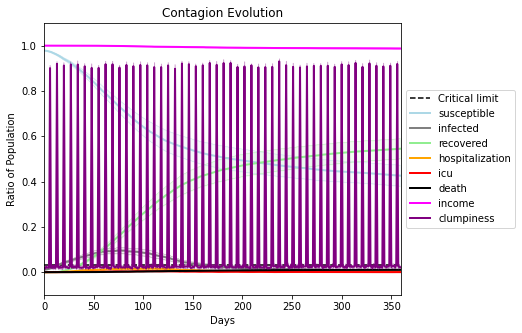

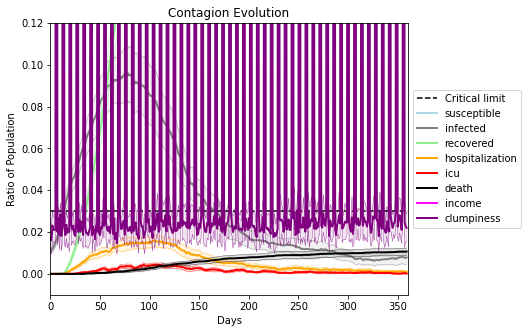

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1158, 5916, 7462, 500, 8813, 1706, 2622, 6821, 6517, 1949, 4214, 9046, 7858, 8944, 9574, 6370, 8238, 3496, 6963, 2903]
Average similarity between family members is 0.2627440413417254 at temperature -0.5
Average similarity between family and home is 0.9998495720676452 at temperature -1
Average similarity between students and their classroom is 0.1333488774887358 at temperature -0.5
Average classroom occupancy is 3.943661971830986 and number classrooms is 71
Average similarity between workers is 0.16919179751402968 at temperature -0.5
Average office occupancy is 3.251256281407035 and number offices is 199
Average friend similarity for adults: 0.32669903706207615 for kids: 0.19697522881349142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.08750984716502677
avg restaurant similarity 0.04330250437241838
avg restaurant similarity 0.05720530957754564
avg restaurant similarity 0.0194183050630759
avg restaurant similarity 0.11131023601045686
avg restaurant similarity 0.10488660344715926
avg restaurant similarity 0.06902334749311191
avg restaurant similarity 0.10464199958517498
avg restaurant similarity 0.09573338371811899
avg restaurant similarity 0.051734302023546216
avg restaurant similarity 0.0668571419977032
avg restaurant similarity 0.04643737799842004
avg restaurant similarity 0.021996251985938957
avg restaurant similarity 0.05022050154948152
avg restaurant similarity 0.04909958306302581
avg restaurant similarity 0.07793035284603426
avg restaurant similarity 0.055667376587905305
avg restaurant similarity 0.09005507797367483
avg restaurant similarity 0.045410683495346923
avg restaurant similarity 0.07839915211520102
avg restaurant similarity 0.11213229897307436
avg restaurant similarity 0.0262

avg restaurant similarity 0.10906692417677682
avg restaurant similarity 0.1545853723429367
avg restaurant similarity 0.05170070897034178
avg restaurant similarity 0.02234596602406101
avg restaurant similarity 0.10579990455473927
avg restaurant similarity 0.09077896047279423
avg restaurant similarity 0.01778097814008746
avg restaurant similarity 0.09794943774017359
avg restaurant similarity 0.023507258966056377
avg restaurant similarity 0.07652516962258192
avg restaurant similarity 0.050897757300436657
avg restaurant similarity 0.04335202468857889
avg restaurant similarity 0.07699658465659047
avg restaurant similarity 0.08885899726224271
avg restaurant similarity 0.1603354042225973
avg restaurant similarity 0.0928923760798907
avg restaurant similarity 0.0723716867400487
avg restaurant similarity 0.07740354293226832
avg restaurant similarity 0.05877476436541349
avg restaurant similarity 0.022347053270464906
avg restaurant similarity 0.05239791964365486
avg restaurant similarity 0.0485021

avg restaurant similarity 0.06046422905978639
avg restaurant similarity 0.08378782663018931
avg restaurant similarity 0.046038471333137855
avg restaurant similarity 0.09546549399465377
avg restaurant similarity 0.08910157969478473
avg restaurant similarity 0.10488137479857368
avg restaurant similarity 0.10666260899888454
avg restaurant similarity 0.03997008475702815
avg restaurant similarity 0.013573509967495359
avg restaurant similarity 0.08256738988758981
avg restaurant similarity 0.07565753552985356
avg restaurant similarity 0.06366843711407948
avg restaurant similarity 0.05448205902357443
avg restaurant similarity 0.0796345001039824
avg restaurant similarity 0.08750483787611742
avg restaurant similarity 0.12217069552409252
avg restaurant similarity 0.09459200780144265
avg restaurant similarity 0.052937005808574765
avg restaurant similarity 0.08315627434357585
avg restaurant similarity 0.09526536623908233
avg restaurant similarity 0.10025668686515847
avg restaurant similarity 0.0479

avg restaurant similarity 0.11274273791706936
avg restaurant similarity 0.027145989885024004
avg restaurant similarity 0.1387541033411481
avg restaurant similarity 0.08132173005167992
avg restaurant similarity 0.07205094851401918
avg restaurant similarity 0.10717462951164154
avg restaurant similarity 0.06111843553285437
avg restaurant similarity 0.10836046693943266
avg restaurant similarity 0.07797913260077968
avg restaurant similarity 0.08090420360827227
avg restaurant similarity 0.08568145224599708
avg restaurant similarity 0.10317067305424447
avg restaurant similarity 0.03334867780927199
avg restaurant similarity 0.09233910008519028
avg restaurant similarity 0.09650791651106118
avg restaurant similarity 0.06858779504076348
avg restaurant similarity 0.10113825133475575
avg restaurant similarity 0.10796477055416481
avg restaurant similarity 0.1330982944760334
avg restaurant similarity 0.06991276092421689
avg restaurant similarity 0.06893283605383503
avg restaurant similarity 0.0569253

avg restaurant similarity 0.1004860674798933
avg restaurant similarity 0.10410581067323608
avg restaurant similarity 0.09206803917329931
avg restaurant similarity 0.05553926148107253
avg restaurant similarity 0.05060891961771084
avg restaurant similarity 0.06321187062927872
avg restaurant similarity 0.04641660293242062
avg restaurant similarity 0.08166123548265734
avg restaurant similarity 0.1219105533089055
avg restaurant similarity 0.03288319903011828
avg restaurant similarity 0.0717624928557353
avg restaurant similarity 0.05316451526088388
avg restaurant similarity 0.1015084477099463
avg restaurant similarity 0.0885350073715054
avg restaurant similarity 0.04790128013649712
avg restaurant similarity 0.07027391314382588
avg restaurant similarity 0.12531282416383915
avg restaurant similarity 0.10594789833929646
avg restaurant similarity 0.07692996590262689
avg restaurant similarity 0.08279169658028793
avg restaurant similarity 0.10213288982443458
avg restaurant similarity 0.07902829439

avg restaurant similarity 0.07580481777596108
avg restaurant similarity 0.11690741690456617
avg restaurant similarity 0.05796004494248255
avg restaurant similarity 0.10412792430572683
avg restaurant similarity 0.11012448856785632
avg restaurant similarity 0.0739273605271239
avg restaurant similarity 0.06960560690978501
avg restaurant similarity 0.11592900461027383
avg restaurant similarity 0.10119656448007622
avg restaurant similarity 0.07756277298305665
avg restaurant similarity 0.0723496389154962
avg restaurant similarity 0.06395544366907667
avg restaurant similarity 0.07993931461683108
avg restaurant similarity 0.07146678937169582
avg restaurant similarity 0.09939481013534314
avg restaurant similarity 0.0783238851710808
avg restaurant similarity 0.07950094139284732
avg restaurant similarity 0.12404322122796559
avg restaurant similarity 0.12383533829836478
avg restaurant similarity 0.08775927542762947
avg restaurant similarity 0.056765882354040335
avg restaurant similarity 0.09221157

avg restaurant similarity 0.049319920177039546
avg restaurant similarity 0.10108809463962812
avg restaurant similarity 0.08259475251333967
avg restaurant similarity 0.10115720301120919
avg restaurant similarity 0.07295661056729028
avg restaurant similarity 0.08340340206250571
avg restaurant similarity 0.09300463268449628
avg restaurant similarity 0.061536741988491815
avg restaurant similarity 0.08662487384944606
avg restaurant similarity 0.05395659460927748
avg restaurant similarity 0.11996263761568568
avg restaurant similarity 0.06329715744282136
avg restaurant similarity 0.09769412688758605
avg restaurant similarity 0.08157690228681488
avg restaurant similarity 0.09626796389044619
avg restaurant similarity 0.12909212403580245
avg restaurant similarity 0.07435139151607306
avg restaurant similarity 0.052926931122106766
avg restaurant similarity 0.07259997908050503
avg restaurant similarity 0.10643805720155332
avg restaurant similarity 0.1062654886608523
avg restaurant similarity 0.0836

avg restaurant similarity 0.12330758430585673
avg restaurant similarity 0.08921670884004096
avg restaurant similarity 0.06644138754508752
avg restaurant similarity 0.06832668203332658
avg restaurant similarity 0.08606540186364049
avg restaurant similarity 0.08699149022347027
avg restaurant similarity 0.07208102001831951
avg restaurant similarity 0.09598464159753084
avg restaurant similarity 0.03646930022788973
avg restaurant similarity 0.04470044012065757
avg restaurant similarity 0.05272894527947757
avg restaurant similarity 0.07259591029102462
avg restaurant similarity 0.08343246199155427
avg restaurant similarity 0.08397467189666975
avg restaurant similarity 0.08192304247955225
avg restaurant similarity 0.06615721602687469
avg restaurant similarity 0.08650749093762002
avg restaurant similarity 0.0849794453747368
avg restaurant similarity 0.07974008087523704
avg restaurant similarity 0.06201369836111421
avg restaurant similarity 0.05902171633826037
avg restaurant similarity 0.0689594

avg restaurant similarity 0.11740640214966708
avg restaurant similarity 0.12497025066526551
avg restaurant similarity 0.08668981092516087
avg restaurant similarity 0.1374053193643994
avg restaurant similarity 0.09852153445366321
avg restaurant similarity 0.107170263667432
avg restaurant similarity 0.12256993852905805
avg restaurant similarity 0.1342053203810488
avg restaurant similarity 0.0977666509289067
avg restaurant similarity 0.10515259881845193
avg restaurant similarity 0.09953085422079833
avg restaurant similarity 0.07426730464363931
avg restaurant similarity 0.10738737682368356
avg restaurant similarity 0.08201741711145585
avg restaurant similarity 0.1159613906627927
avg restaurant similarity 0.1216730232310908
avg restaurant similarity 0.087431304999163
avg restaurant similarity 0.1078577965572484
avg restaurant similarity 0.09593321743704074
avg restaurant similarity 0.11999339100364823
avg restaurant similarity 0.13311928491030814
avg restaurant similarity 0.0819522194549287

avg restaurant similarity 0.13962486946698927
avg restaurant similarity 0.13616813537171493
avg restaurant similarity 0.08561330807099675
avg restaurant similarity 0.09855982179276891
avg restaurant similarity 0.06718295507211434
avg restaurant similarity 0.07009557869226474
avg restaurant similarity 0.09957648315439095
avg restaurant similarity 0.11008430031861545
avg restaurant similarity 0.08577673516510463
avg restaurant similarity 0.10443108375872849
avg restaurant similarity 0.06802776001526775
avg restaurant similarity 0.12345272821298144
avg restaurant similarity 0.07753158126330233
avg restaurant similarity 0.12096142405909091
avg restaurant similarity 0.06084984200552359
avg restaurant similarity 0.09758951119115566
avg restaurant similarity 0.111805217166702
avg restaurant similarity 0.12127956742475611
avg restaurant similarity 0.07042994057485238
avg restaurant similarity 0.12981183782944014
avg restaurant similarity 0.13158862170252678
avg restaurant similarity 0.14998969

avg restaurant similarity 0.08841733290947391
avg restaurant similarity 0.06885161256567285
avg restaurant similarity 0.049300697160522
avg restaurant similarity 0.10372774867998473
avg restaurant similarity 0.08532220248735979
avg restaurant similarity 0.13132648698959698
avg restaurant similarity 0.03306619041965903
avg restaurant similarity 0.06881811153804175
avg restaurant similarity 0.052840006536928996
avg restaurant similarity 0.0531819693780125
avg restaurant similarity 0.06361197628905516
avg restaurant similarity 0.02557743863417052
avg restaurant similarity 0.07047583172296554
avg restaurant similarity 0.05239971545786728
avg restaurant similarity 0.07266767434818813
avg restaurant similarity 0.08722035839621346
avg restaurant similarity 0.10168612523030136
avg restaurant similarity 0.04957874110994151
avg restaurant similarity 0.08196452733959148
avg restaurant similarity 0.08238727040067194
avg restaurant similarity 0.03030454556572569
avg restaurant similarity 0.06819718

avg restaurant similarity 0.0744120625269976
avg restaurant similarity 0.06348697342869664
avg restaurant similarity 0.1283029190574354
avg restaurant similarity 0.10143682190877457
avg restaurant similarity 0.08637600127450035
avg restaurant similarity 0.05462374312696639
avg restaurant similarity 0.08880279071562822
avg restaurant similarity 0.06551108295460371
avg restaurant similarity 0.07739778943396103
avg restaurant similarity 0.0683964212614212
avg restaurant similarity 0.09094684792407787
avg restaurant similarity 0.11057410711294542
avg restaurant similarity 0.08543490962741687
avg restaurant similarity 0.10234628124748048
avg restaurant similarity 0.0890514847089197
avg restaurant similarity 0.09711829885740902
avg restaurant similarity 0.024580511407428642
avg restaurant similarity 0.019104668577940142
avg restaurant similarity 0.05343653556540118
avg restaurant similarity 0.06615889722842577
avg restaurant similarity 0.07047048486989947
avg restaurant similarity 0.08215297

avg restaurant similarity 0.13520649078792932
avg restaurant similarity 0.12097797755525282
avg restaurant similarity 0.025606365965043933
avg restaurant similarity 0.10845900474792906
avg restaurant similarity 0.11019177166355071
avg restaurant similarity 0.1135392641087867
avg restaurant similarity 0.06371009373953498
avg restaurant similarity 0.1016313092304632
avg restaurant similarity 0.07748460070309206
avg restaurant similarity 0.08166536731567749
avg restaurant similarity 0.06732356617827827
avg restaurant similarity 0.09215211187771057
avg restaurant similarity 0.050650188815172116
avg restaurant similarity 0.057670855598905814
avg restaurant similarity 0.080000682170508
avg restaurant similarity 0.042685297482355396
avg restaurant similarity 0.0512886534534495
avg restaurant similarity 0.08361400195168515
avg restaurant similarity 0.06821001230065178
avg restaurant similarity 0.08540503406233874
avg restaurant similarity 0.07908177557241408
avg restaurant similarity 0.0820431

avg restaurant similarity 0.09019529970772995
avg restaurant similarity 0.11849142252857536
avg restaurant similarity 0.061729091950202535
avg restaurant similarity 0.09307084999656867
avg restaurant similarity 0.10637852965441749
avg restaurant similarity 0.10855537056144819
avg restaurant similarity 0.04379776469463178
avg restaurant similarity 0.08936070951159113
avg restaurant similarity 0.08088761491414044
avg restaurant similarity 0.040933124433260776
avg restaurant similarity 0.13658739061167943
avg restaurant similarity 0.0309884487096352
avg restaurant similarity 0.011903908295720482
avg restaurant similarity 0.07478431628697545
avg restaurant similarity 0.10316516487451384
avg restaurant similarity 0.0632392866516928
avg restaurant similarity 0.1098204610317375
avg restaurant similarity 0.07750619055449116
avg restaurant similarity 0.0690499558080873
avg restaurant similarity 0.07344205155045039
avg restaurant similarity 0.07216210967179855
avg restaurant similarity 0.1202477

avg restaurant similarity 0.05407728122083588
avg restaurant similarity 0.08643361622702088
avg restaurant similarity 0.12289343572519294
avg restaurant similarity 0.014397654251101259
avg restaurant similarity 0.06913323238280643
avg restaurant similarity 0.07990942640264835
avg restaurant similarity 0.07579803652940549
avg restaurant similarity 0.09370033770651462
avg restaurant similarity 0.10653497921491614
avg restaurant similarity 0.11772852909715999
avg restaurant similarity 0.058200185156414314
avg restaurant similarity 0.0796778079972288
avg restaurant similarity 0.09526727099557117
avg restaurant similarity 0.059019504633840585
avg restaurant similarity 0.09447078719291321
avg restaurant similarity 0.10238869433614729
avg restaurant similarity 0.065643558020894
avg restaurant similarity 0.06920582757181756
avg restaurant similarity 0.06070060115120634
avg restaurant similarity 0.07147708453821769
avg restaurant similarity 0.08130609260077774
avg restaurant similarity 0.074670

avg restaurant similarity 0.08213387334775894
avg restaurant similarity 0.069567240783544
avg restaurant similarity 0.08820248321355288
avg restaurant similarity 0.08729848695760313
avg restaurant similarity 0.09855654218345807
avg restaurant similarity 0.08703648877654242
avg restaurant similarity 0.07213489238173292
avg restaurant similarity 0.06586480461588856
avg restaurant similarity 0.030126550203569143
avg restaurant similarity 0.09170608372288369
avg restaurant similarity 0.056669263889433115
avg restaurant similarity 0.09320702438330201
avg restaurant similarity 0.07691064435715418
avg restaurant similarity 0.08318551440683095
avg restaurant similarity 0.10083805937137374
avg restaurant similarity 0.09862173647381771
avg restaurant similarity 0.09997889128819265
avg restaurant similarity 0.13177639539503572
avg restaurant similarity 0.08677282950018032
avg restaurant similarity 0.0887256909665901
avg restaurant similarity 0.07543791039897704
avg restaurant similarity 0.0829388

avg restaurant similarity 0.12015960735744412
avg restaurant similarity 0.07203205951508623
avg restaurant similarity 0.07031947216697146
avg restaurant similarity 0.10714761614294267
avg restaurant similarity 0.14064982051130986
avg restaurant similarity 0.055127977674709
avg restaurant similarity 0.08430824689410238
avg restaurant similarity 0.08562611710690662
avg restaurant similarity 0.08874635175660309
avg restaurant similarity 0.07876634910735941
avg restaurant similarity 0.07981318164682098
avg restaurant similarity 0.06574020481297992
avg restaurant similarity 0.11396376800464415
avg restaurant similarity 0.03636407707459409
avg restaurant similarity 0.080239814383244
avg restaurant similarity 0.08289235727984483
avg restaurant similarity 0.057396841696062614
avg restaurant similarity 0.055599159364029246
avg restaurant similarity 0.06336681744856584
avg restaurant similarity 0.08505086164757089
avg restaurant similarity 0.0939065825526139
avg restaurant similarity 0.065795339

avg restaurant similarity 0.10109977739505129
avg restaurant similarity 0.0514359197242456
avg restaurant similarity 0.11072230658223878
avg restaurant similarity 0.07965892047445496
avg restaurant similarity 0.06999399003914099
avg restaurant similarity 0.07785500863348915
avg restaurant similarity 0.100594944272321
avg restaurant similarity 0.11012608072852975
avg restaurant similarity 0.050530815837228314
avg restaurant similarity 0.07722570766667038
avg restaurant similarity 0.09517024520487603
avg restaurant similarity 0.08422130125914447
avg restaurant similarity 0.10155332641222221
avg restaurant similarity 0.04080119784511453
avg restaurant similarity 0.12482867371723241
avg restaurant similarity 0.0899019343717065
avg restaurant similarity 0.06869059742391884
avg restaurant similarity 0.06460807007218516
avg restaurant similarity 0.09799807928291232
avg restaurant similarity 0.06699377403919239
avg restaurant similarity 0.07362616559081187
avg restaurant similarity 0.093882083

avg restaurant similarity 0.08795611138882102
avg restaurant similarity 0.07905194095687258
avg restaurant similarity 0.06486090536401787
avg restaurant similarity 0.08115069528534809
avg restaurant similarity 0.06292302704463476
avg restaurant similarity 0.12213579298804185
avg restaurant similarity 0.0946827434745451
avg restaurant similarity 0.12744493392081516
avg restaurant similarity 0.06805334979106235
avg restaurant similarity 0.09869488887706886
avg restaurant similarity 0.1301080405786935
avg restaurant similarity 0.08423727366858935
avg restaurant similarity 0.06514724656496133
avg restaurant similarity 0.0636193232682283
avg restaurant similarity 0.14358342180439654
avg restaurant similarity 0.046782335949001067
avg restaurant similarity 0.1261174965362527
avg restaurant similarity 0.060220996155535035
avg restaurant similarity 0.06291735185475708
avg restaurant similarity 0.11290160977813798
avg restaurant similarity 0.05480139372467239
avg restaurant similarity 0.10582854

avg restaurant similarity 0.020887353191455703
avg restaurant similarity 0.0801121977241028
avg restaurant similarity -0.01055764026819989
avg restaurant similarity 0.1053032895573196
avg restaurant similarity 0.05101055082407484
avg restaurant similarity 0.03428093955153601
avg restaurant similarity 0.07915227945998704
avg restaurant similarity 0.0608523767276944
avg restaurant similarity 0.053701042298371256
avg restaurant similarity 0.06762110682758928
avg restaurant similarity 0.11015032776793086
avg restaurant similarity 0.026335523345975862
avg restaurant similarity 0.07077102929818131
avg restaurant similarity 0.06742875489851656
avg restaurant similarity 0.0828497059262742
avg restaurant similarity 0.09782966331479975
avg restaurant similarity 0.06913594475911092
avg restaurant similarity 0.0641212581633237
avg restaurant similarity 0.09566991380605254
avg restaurant similarity 0.09606422532041112
avg restaurant similarity 0.06764634871777325
avg restaurant similarity 0.0157692

avg restaurant similarity 0.07017380102369407
avg restaurant similarity 0.0568428470622208
avg restaurant similarity 0.04815427250256606
avg restaurant similarity 0.052929266382751784
avg restaurant similarity 0.04913257175412445
avg restaurant similarity 0.05156599670370887
avg restaurant similarity 0.09186117499641654
avg restaurant similarity 0.008736035862063138
avg restaurant similarity 0.09540399263466143
avg restaurant similarity 0.0444870111550454
avg restaurant similarity 0.042801711687281564
avg restaurant similarity 0.05829054501784051
avg restaurant similarity 0.09583617836301125
avg restaurant similarity 0.05862035156131073
avg restaurant similarity 0.06122872253600355
avg restaurant similarity 0.08878130161822612
avg restaurant similarity 0.06519789037719881
avg restaurant similarity 0.052940908627688285
avg restaurant similarity 0.09221935562432866
avg restaurant similarity 0.03344030477620871
avg restaurant similarity 0.05796156084585967
avg restaurant similarity 0.0434

avg restaurant similarity 0.07470407903059324
avg restaurant similarity 0.07242101858640816
avg restaurant similarity 0.04854009849767858
avg restaurant similarity 0.06191400004200218
avg restaurant similarity 0.01736055487307932
avg restaurant similarity 0.06436952486856658
avg restaurant similarity 0.05746311412473963
avg restaurant similarity 0.1058713812198415
avg restaurant similarity 0.09946719737995997
avg restaurant similarity 0.07010440898470997
avg restaurant similarity 0.07643645670527688
avg restaurant similarity 0.10052927546016815
avg restaurant similarity 0.07002927703719075
avg restaurant similarity 0.055568634984176295
avg restaurant similarity 0.052005488755758056
avg restaurant similarity 0.08682956949162986
avg restaurant similarity 0.09549609706972566
avg restaurant similarity 0.06846571719250606
avg restaurant similarity 0.05119350873010706
avg restaurant similarity -0.0028535615677502814
avg restaurant similarity 0.049320478157900416
avg restaurant similarity 0.0

avg restaurant similarity 0.08511974852239294
avg restaurant similarity 0.08704592695930805
avg restaurant similarity 0.04967278667836618
avg restaurant similarity 0.046349922184782934
avg restaurant similarity 0.07532382881829949
avg restaurant similarity 0.07047430455810305
avg restaurant similarity 0.09253170097485906
avg restaurant similarity 0.037305625254988886
avg restaurant similarity 0.06803218566301729
avg restaurant similarity 0.05223528343507896
avg restaurant similarity 0.061914903817915354
avg restaurant similarity 0.038210065619755706
avg restaurant similarity 0.05135535912526569
avg restaurant similarity 0.04587910785582287
avg restaurant similarity 0.029780606312758702
avg restaurant similarity 0.04720773515705781
avg restaurant similarity 0.010230421807343924
avg restaurant similarity 0.05177485813708662
avg restaurant similarity 0.056908179695777855
avg restaurant similarity 0.10494720582282543
avg restaurant similarity 0.008138444358051665
avg restaurant similarity 

avg restaurant similarity 0.033490349859026686
avg restaurant similarity 0.055312583319901104
avg restaurant similarity 0.08065582417009264
avg restaurant similarity 0.02766723814139691
avg restaurant similarity 0.07485708700040124
avg restaurant similarity 0.020595311593971148
avg restaurant similarity 0.05825865168546314
avg restaurant similarity 0.012212120301044405
avg restaurant similarity 0.049124283300490276
avg restaurant similarity 0.01459418023008797
avg restaurant similarity 0.1130356050061921
avg restaurant similarity 0.03789763037051171
avg restaurant similarity 0.06816254452882455
avg restaurant similarity -0.01215929871322494
avg restaurant similarity 0.10665802429675322
avg restaurant similarity -0.02986075256092528
avg restaurant similarity 0.05236452014082681
avg restaurant similarity 0.03979008405368465
avg restaurant similarity 0.05090666093300349
avg restaurant similarity 0.03515658372239283
avg restaurant similarity 0.03746706692899541
avg restaurant similarity 0.

avg restaurant similarity 0.08129182492854149
avg restaurant similarity 0.05697313738944332
avg restaurant similarity 0.003928802796775345
avg restaurant similarity 0.04668776958379984
avg restaurant similarity 0.11814085908999954
avg restaurant similarity 0.06376927099863007
avg restaurant similarity 0.026601963415351954
avg restaurant similarity 0.08062175950958413
avg restaurant similarity 0.0592570969298863
avg restaurant similarity 0.079756964218137
avg restaurant similarity 0.049379133141837776
avg restaurant similarity 0.07624459632150075
avg restaurant similarity 0.03604998419530631
avg restaurant similarity 0.08852630506268168
avg restaurant similarity 0.02351526171829383
avg restaurant similarity 0.0715635636702935
avg restaurant similarity 0.0321410048747237
avg restaurant similarity 0.0006674937675206071
avg restaurant similarity 0.04521668320283073
avg restaurant similarity 0.05959719132807331
avg restaurant similarity 0.06397913521360969
avg restaurant similarity 0.048180

avg restaurant similarity 0.09254312417426433
avg restaurant similarity 0.07171362182776433
avg restaurant similarity 0.11448650188451495
avg restaurant similarity 0.03983364180250858
avg restaurant similarity 0.04064411890520985
avg restaurant similarity 0.04636353259032059
avg restaurant similarity 0.08283752191781897
avg restaurant similarity 0.04827873747182437
avg restaurant similarity 0.0838752384588997
avg restaurant similarity 0.02756161524390842
avg restaurant similarity 0.07258935417091043
avg restaurant similarity 0.05122908251130501
avg restaurant similarity 0.07858046418747973
avg restaurant similarity 0.07777623466625916
avg restaurant similarity 0.0719593971693313
avg restaurant similarity 0.09451454775042384
avg restaurant similarity 0.09829865811993384
avg restaurant similarity 0.04259415664005285
avg restaurant similarity 0.05350968775212519
avg restaurant similarity 0.10267409931768744
avg restaurant similarity 0.05743137387435037
avg restaurant similarity 0.07532046

avg restaurant similarity 0.09502029142426709
avg restaurant similarity 0.08038452768613835
avg restaurant similarity 0.10654211202603903
avg restaurant similarity 0.04684548939522418
avg restaurant similarity 0.07187311871646397
avg restaurant similarity 0.053341267546138826
avg restaurant similarity 0.09771523565538696
avg restaurant similarity 0.08854633100755266
avg restaurant similarity 0.09829424436646117
avg restaurant similarity 0.06689404674818085
avg restaurant similarity 0.09497785729642616
avg restaurant similarity 0.07662191291724718
avg restaurant similarity 0.0890646173582021
avg restaurant similarity 0.07607167347691372
avg restaurant similarity 0.09929864724245478
avg restaurant similarity 0.06422378903417598
avg restaurant similarity 0.1157184822149558
avg restaurant similarity 0.08293355100029176
avg restaurant similarity 0.05730025661420261
avg restaurant similarity 0.10061849374015702
avg restaurant similarity 0.07786750913087113
avg restaurant similarity 0.0734375

avg restaurant similarity 0.12444370818578956
avg restaurant similarity 0.0876292908244791
avg restaurant similarity 0.07299340649429424
avg restaurant similarity 0.04353146359296446
avg restaurant similarity 0.054792541734668
avg restaurant similarity 0.09949759024726273
avg restaurant similarity 0.060245466645584986
avg restaurant similarity 0.043997202808272594
avg restaurant similarity 0.08372009006998243
avg restaurant similarity 0.10523101885576977
avg restaurant similarity 0.045955917362215576
avg restaurant similarity 0.1105816552025831
avg restaurant similarity 0.0029014496997216083
avg restaurant similarity 0.04864122622804936
avg restaurant similarity 0.09660438345085103
avg restaurant similarity 0.07342285431792017
avg restaurant similarity 0.08750820480803194
avg restaurant similarity 0.07236563575566697
avg restaurant similarity 0.08523158200577276
avg restaurant similarity 0.09099389314124974
avg restaurant similarity 0.047856851649796646
avg restaurant similarity 0.0562

avg restaurant similarity 0.005358894832184698
avg restaurant similarity 0.04523727626800468
avg restaurant similarity 0.06791876334593999
avg restaurant similarity 0.021018065562187178
avg restaurant similarity 0.08861283016011491
avg restaurant similarity 0.10054289173583884
avg restaurant similarity 0.050015156442072856
avg restaurant similarity 0.05171694421968087
avg restaurant similarity 0.09103726309752898
avg restaurant similarity 0.09194343366816961
avg restaurant similarity 0.06567334376632039
avg restaurant similarity 0.060167033587117176
avg restaurant similarity 0.05920128007806865
avg restaurant similarity 0.012852787308738404
avg restaurant similarity 0.07876099260729134
avg restaurant similarity -0.006217759457400008
avg restaurant similarity 0.06274781814848855
avg restaurant similarity 0.08490418812214694
avg restaurant similarity 0.08982228747293403
avg restaurant similarity 0.04371858444493149
avg restaurant similarity 0.04705264465427934
avg restaurant similarity 0

avg restaurant similarity 0.07584684218693727
avg restaurant similarity 0.06329880227515938
avg restaurant similarity 0.10118247742489384
avg restaurant similarity 0.09015788861513711
avg restaurant similarity 0.06567708274470707
avg restaurant similarity 0.058240477639510596
avg restaurant similarity 0.05318981935284439
avg restaurant similarity 0.13036932180029992
avg restaurant similarity 0.09112866381440693
avg restaurant similarity 0.04719219486582134
avg restaurant similarity 0.06513563874169924
avg restaurant similarity 0.08122961612922702
avg restaurant similarity 0.09764160220646596
avg restaurant similarity 0.035905540158418736
avg restaurant similarity 0.05477965676659243
avg restaurant similarity 0.09707276709702937
avg restaurant similarity 0.059198534172774035
avg restaurant similarity 0.10301727110381086
avg restaurant similarity 0.029635616310238883
avg restaurant similarity 0.043240668961313705
avg restaurant similarity 0.10853164593513977
avg restaurant similarity 0.0

avg restaurant similarity 0.04205703695351214
avg restaurant similarity 0.05857917680274563
avg restaurant similarity 0.033046553775138786
avg restaurant similarity 0.0393692503042952
avg restaurant similarity 0.11062686184331198
avg restaurant similarity 0.06532219511217884
avg restaurant similarity 0.07785139304973249
avg restaurant similarity 0.07788104883150986
avg restaurant similarity 0.047348595172197694
avg restaurant similarity 0.053588106522532326
avg restaurant similarity 0.11309869692641446
avg restaurant similarity 0.06275393120867274
avg restaurant similarity 0.06766507622478508
avg restaurant similarity 0.08082689368587011
avg restaurant similarity 0.08441022846774104
avg restaurant similarity 0.07925500627202696
avg restaurant similarity 0.08387791309678885
avg restaurant similarity 0.02418985002902173
avg restaurant similarity 0.08031191080107504
avg restaurant similarity 0.058435997064443405
avg restaurant similarity 0.011679368059661945
avg restaurant similarity 0.07

avg restaurant similarity 0.09296274296342402
avg restaurant similarity 0.07956341077621967
avg restaurant similarity 0.0820321858827265
avg restaurant similarity 0.05631427918395976
avg restaurant similarity 0.07002154509187389
avg restaurant similarity 0.09303599285356629
avg restaurant similarity 0.0838434042977803
avg restaurant similarity 0.06154336639696245
avg restaurant similarity 0.08574731228861025
avg restaurant similarity 0.06084083193972427
avg restaurant similarity 0.062096435763803914
avg restaurant similarity 0.06255221637413708
avg restaurant similarity 0.06277083393313304
avg restaurant similarity 0.041984356306013264
avg restaurant similarity 0.09553265367227516
avg restaurant similarity 0.09086275875773332
avg restaurant similarity 0.09311620526446407
avg restaurant similarity 0.04627980701116982
avg restaurant similarity 0.046215390030610884
avg restaurant similarity 0.08134688007647432
avg restaurant similarity 0.08386279420563243
avg restaurant similarity 0.03090

avg restaurant similarity 0.08253644079956146
avg restaurant similarity 0.10531495750444646
avg restaurant similarity 0.07343625059056944
avg restaurant similarity 0.08273290324790063
avg restaurant similarity 0.0767988815435718
avg restaurant similarity 0.08185330080197524
avg restaurant similarity 0.05742133286385972
avg restaurant similarity 0.09795229637942406
avg restaurant similarity 0.046896634585317225
avg restaurant similarity 0.056959420440731226
avg restaurant similarity 0.06658176147323225
avg restaurant similarity 0.0779972737273211
avg restaurant similarity 0.053492175722314926
avg restaurant similarity 0.06435256271138486
avg restaurant similarity 0.0962093539219055
avg restaurant similarity 0.08535534146713851
avg restaurant similarity 0.051236086537249675
avg restaurant similarity 0.08185330992969668
avg restaurant similarity 0.0909332222315012
avg restaurant similarity 0.10800949218987073
avg restaurant similarity 0.0891339366388351
avg restaurant similarity 0.0742399

avg restaurant similarity 0.08417727486358341
avg restaurant similarity 0.0743305659720174
avg restaurant similarity 0.08586952480437246
avg restaurant similarity 0.06871258914542178
avg restaurant similarity 0.14539644253107523
avg restaurant similarity 0.08069688714284434
avg restaurant similarity 0.12348773543648596
avg restaurant similarity 0.07386852266010303
avg restaurant similarity 0.09002853974822012
avg restaurant similarity 0.07920840531400453
avg restaurant similarity 0.13074074254954737
avg restaurant similarity 0.08129128370208523
avg restaurant similarity 0.10156386267752544
avg restaurant similarity 0.11157339748954916
avg restaurant similarity 0.06974353703345094
avg restaurant similarity 0.050265009839747646
avg restaurant similarity 0.09128896215269006
avg restaurant similarity 0.09751975421195722
avg restaurant similarity 0.07540017827258884
avg restaurant similarity 0.0902224792798878
avg restaurant similarity 0.09796852126393132
avg restaurant similarity 0.1006314

avg restaurant similarity 0.08276389472304405
avg restaurant similarity 0.10154769351229338
avg restaurant similarity 0.021443303228857808
avg restaurant similarity 0.03666023947440882
avg restaurant similarity 0.043699102887513296
avg restaurant similarity 0.05735877708682241
avg restaurant similarity 0.07002366833159078
avg restaurant similarity 0.06031578572430479
avg restaurant similarity 0.051981030651267995
avg restaurant similarity 0.06943842169327015
avg restaurant similarity 0.14857930993375254
avg restaurant similarity 0.05666073081372611
avg restaurant similarity 0.049030781243955414
avg restaurant similarity 0.07913578697347703
avg restaurant similarity 0.07563818500958172
avg restaurant similarity 0.11458230010936567
avg restaurant similarity 0.055024547268989685
avg restaurant similarity 0.05742603229897175
avg restaurant similarity 0.019111469216490675
avg restaurant similarity 0.06552762050208226
avg restaurant similarity 0.05953779581475474
avg restaurant similarity 0.

avg restaurant similarity 0.045340168106631204
avg restaurant similarity 0.07821106465395468
avg restaurant similarity 0.07287289750684119
avg restaurant similarity 0.0606977567818756
avg restaurant similarity 0.08510714910057415
avg restaurant similarity 0.020681651691845628
avg restaurant similarity 0.04050256813408655
avg restaurant similarity 0.04379904893661608
avg restaurant similarity 0.12862032253168923
avg restaurant similarity 0.10056624570944159
avg restaurant similarity 0.011413756372753013
avg restaurant similarity 0.07451997355831114
avg restaurant similarity 0.051681734392811055
avg restaurant similarity 0.08861504435021805
avg restaurant similarity 0.038765470938083205
avg restaurant similarity 0.02501801048286374
avg restaurant similarity 0.02661108291851806
avg restaurant similarity 0.053916188877701034
avg restaurant similarity 0.08761255733894137
avg restaurant similarity 0.10358338840248386
avg restaurant similarity 0.0714958224525237
avg restaurant similarity 0.07

avg restaurant similarity 0.09476088172308952
avg restaurant similarity 0.08141413966089087
avg restaurant similarity 0.10906231868474181
avg restaurant similarity 0.06131736160925652
avg restaurant similarity 0.06064188290770655
avg restaurant similarity 0.11914422905803806
avg restaurant similarity 0.10590692776090985
avg restaurant similarity 0.05701962670080339
avg restaurant similarity 0.08619208673743135
avg restaurant similarity 0.09076657209084343
avg restaurant similarity 0.03204146764703861
avg restaurant similarity 0.12203098762913461
avg restaurant similarity 0.07147619175607314
avg restaurant similarity 0.0979879343330183
avg restaurant similarity 0.07119153937950737
avg restaurant similarity 0.10653562229046272
avg restaurant similarity 0.11750158403312917
avg restaurant similarity 0.101697222593503
avg restaurant similarity 0.09217218667773613
avg restaurant similarity 0.09106723474698825
avg restaurant similarity 0.07858044733237234
avg restaurant similarity 0.052177928

avg restaurant similarity 0.04792868884031507
avg restaurant similarity 0.08708054536318122
avg restaurant similarity 0.07891493043704141
avg restaurant similarity 0.056806495881175194
avg restaurant similarity 0.10478458569936239
avg restaurant similarity 0.04765707456553505
avg restaurant similarity 0.08688755592932867
avg restaurant similarity 0.07410860998410763
avg restaurant similarity 0.10788501657989825
avg restaurant similarity 0.09031991638266505
avg restaurant similarity 0.09212020946507968
avg restaurant similarity 0.026081680280012166
avg restaurant similarity 0.0653057124691839
avg restaurant similarity 0.08309572868445807
avg restaurant similarity 0.12033295297033081
avg restaurant similarity 0.04059891869701306
avg restaurant similarity 0.05534920538467848
avg restaurant similarity 0.0666833771534293
avg restaurant similarity 0.04923561462701985
avg restaurant similarity 0.07669587031361981
avg restaurant similarity 0.08235233681047753
avg restaurant similarity 0.119165

avg restaurant similarity 0.07010795355998095
avg restaurant similarity 0.10861817891175503
avg restaurant similarity 0.15204551841748531
avg restaurant similarity 0.07083420901501838
avg restaurant similarity 0.09627454193287631
avg restaurant similarity 0.058471268659236346
avg restaurant similarity 0.0746112760519722
avg restaurant similarity 0.10877654054727096
avg restaurant similarity 0.10807109125041228
avg restaurant similarity 0.028833534205222184
avg restaurant similarity 0.024148901333393324
avg restaurant similarity 0.10607523544580934
avg restaurant similarity 0.11439531120448017
avg restaurant similarity 0.08157038013620281
avg restaurant similarity 0.06700922976239886
avg restaurant similarity 0.0881502323736389
avg restaurant similarity 0.10511427623929626
avg restaurant similarity 0.12103985040729284
avg restaurant similarity 0.013795141345871176
avg restaurant similarity 0.05995928938715856
avg restaurant similarity 0.11619866188189713
avg restaurant similarity 0.1024

avg restaurant similarity 0.10833653501927001
avg restaurant similarity 0.09208086407103928
avg restaurant similarity 0.04951520225611813
avg restaurant similarity 0.09858226976097823
avg restaurant similarity 0.08058848707111341
avg restaurant similarity 0.08841470414492794
avg restaurant similarity 0.04842037177561741
avg restaurant similarity 0.09829427559956984
avg restaurant similarity 0.060812362064200806
avg restaurant similarity 0.07049220061935135
avg restaurant similarity 0.04988547276244772
avg restaurant similarity 0.07808616626101457
avg restaurant similarity 0.09371850691733612
avg restaurant similarity 0.08393822964504623
avg restaurant similarity 0.12938748640987516
avg restaurant similarity 0.12204697866236265
avg restaurant similarity 0.16747033352821908
avg restaurant similarity 0.08545415062276907
avg restaurant similarity 0.10312423813459483
avg restaurant similarity 0.084968562127521
avg restaurant similarity 0.07449428593880224
avg restaurant similarity 0.0704054

(<function dict.items>, <function dict.items>, <function dict.items>)

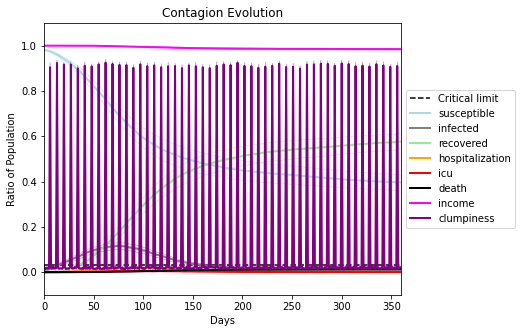

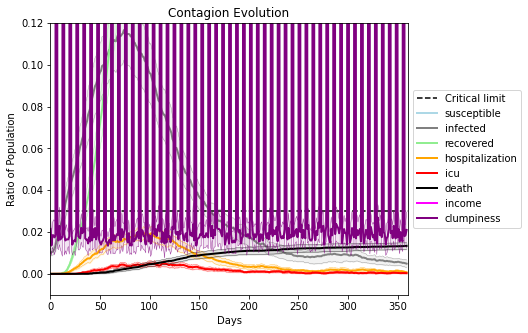

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7560, 8535, 3746, 8379, 1319, 7395, 2032, 7301, 7293, 9793, 1612, 9350, 2675, 6948, 5083, 6994, 5679, 4728, 5072, 8119]
Average similarity between family members is 0.23384811542739392 at temperature -0.4
Average similarity between family and home is 0.9998433959173206 at temperature -1
Average similarity between students and their classroom is 0.18934548252971903 at temperature -0.4
Average classroom occupancy is 3.7857142857142856 and number classrooms is 70
Average similarity between workers is 0.1583790588055407 at temperature -0.4
Average office occupancy is 3.3316831683168315 and number offices is 202
Average friend similarity for adults: 0.3026461125342934 for kids: 0.20135221986726543
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.070952993017755
avg restaurant similarity 0.11837035433562743
avg restaurant similarity 0.10381898934458621
avg restaurant similarity 0.08202194029186052
avg restaurant similarity 0.0634362506934473
avg restaurant similarity 0.0689608736607448
avg restaurant similarity 0.0818933529854924
avg restaurant similarity 0.08676025877713726
avg restaurant similarity 0.11176276726333045
avg restaurant similarity 0.07116377396373254
avg restaurant similarity 0.10800124203323927
avg restaurant similarity 0.15080232969981697
avg restaurant similarity 0.05325213658605746
avg restaurant similarity 0.07794679870405255
avg restaurant similarity 0.07229884033083711
avg restaurant similarity 0.10486604622189719
avg restaurant similarity 0.09884389261335631
avg restaurant similarity 0.10588748489813048
avg restaurant similarity 0.09570573550851766
avg restaurant similarity 0.04665689276582683
avg restaurant similarity 0.10011105593512848
avg restaurant similarity 0.08726321532

avg restaurant similarity 0.07588113815414747
avg restaurant similarity 0.12357207097876785
avg restaurant similarity 0.12077561808076083
avg restaurant similarity 0.011186967064352961
avg restaurant similarity 0.06642389237454178
avg restaurant similarity 0.10395719011805059
avg restaurant similarity 0.06208188854477599
avg restaurant similarity 0.06212564483625096
avg restaurant similarity 0.11923535056496071
avg restaurant similarity 0.06710525867120141
avg restaurant similarity 0.04636404992115765
avg restaurant similarity 0.08038312546217113
avg restaurant similarity 0.08529743706156193
avg restaurant similarity 0.047982626247473924
avg restaurant similarity 0.1327439934691402
avg restaurant similarity 0.07059876775637802
avg restaurant similarity 0.09730003524239751
avg restaurant similarity 0.0948762749846521
avg restaurant similarity 0.06783651962240561
avg restaurant similarity 0.05511057235844352
avg restaurant similarity 0.06638352926972377
avg restaurant similarity 0.045847

avg restaurant similarity 0.07159279575802886
avg restaurant similarity 0.06583438591804534
avg restaurant similarity 0.07127928318976648
avg restaurant similarity 0.09652356562638452
avg restaurant similarity 0.08509328049653785
avg restaurant similarity 0.0473310084874062
avg restaurant similarity 0.06833586049769022
avg restaurant similarity 0.11223154175077078
avg restaurant similarity 0.10255798689304309
avg restaurant similarity 0.049016114572674886
avg restaurant similarity 0.10775642921624634
avg restaurant similarity 0.08923886133715174
avg restaurant similarity 0.06672276019282669
avg restaurant similarity 0.08786499476823242
avg restaurant similarity 0.07148067106403229
avg restaurant similarity 0.07050350267541491
avg restaurant similarity 0.1017544198965956
avg restaurant similarity 0.05291769498348696
avg restaurant similarity 0.07696262967832451
avg restaurant similarity 0.09095481754168928
avg restaurant similarity 0.042520924426516137
avg restaurant similarity 0.095057

avg restaurant similarity 0.09284238941537144
avg restaurant similarity 0.12460253677398414
avg restaurant similarity 0.0629609850354618
avg restaurant similarity 0.08737381855288325
avg restaurant similarity 0.030852049045938912
avg restaurant similarity 0.05257593290458797
avg restaurant similarity 0.07193747201828536
avg restaurant similarity 0.06085646682146781
avg restaurant similarity 0.06527314601738707
avg restaurant similarity 0.03321396320215232
avg restaurant similarity 0.07224454405438925
avg restaurant similarity 0.07573001788566977
avg restaurant similarity 0.06088244674338605
avg restaurant similarity 0.12034687362910494
avg restaurant similarity 0.05473856955654511
avg restaurant similarity 0.07690290693361256
avg restaurant similarity 0.02943272256068418
avg restaurant similarity 0.0829814765861732
avg restaurant similarity 0.05774870555612516
avg restaurant similarity 0.09722090797230348
avg restaurant similarity 0.11522777671689877
avg restaurant similarity 0.0872634

avg restaurant similarity 0.0031762199144990478
avg restaurant similarity 0.029166975833539246
avg restaurant similarity 0.0900942522191115
avg restaurant similarity 0.060338153406898354
avg restaurant similarity 0.04141863260503482
avg restaurant similarity 0.05644909549744552
avg restaurant similarity 0.0458188879843253
avg restaurant similarity 0.0476834721418357
avg restaurant similarity 0.04891435835482128
avg restaurant similarity 0.09803090864551357
avg restaurant similarity 0.029079772026492395
avg restaurant similarity 0.08997954684482287
avg restaurant similarity 0.0400233277262091
avg restaurant similarity 0.06566456061763547
avg restaurant similarity 0.06253644816974288
avg restaurant similarity 0.05350247353610884
avg restaurant similarity 0.06068462173745527
avg restaurant similarity 0.0868309383218911
avg restaurant similarity 0.010314969621215817
avg restaurant similarity 0.05024236128709217
avg restaurant similarity 0.019159169767964758
avg restaurant similarity 0.0481

avg restaurant similarity 0.06624553968526864
avg restaurant similarity 0.07308384070472658
avg restaurant similarity 0.03460458145604177
avg restaurant similarity 0.07633362561943262
avg restaurant similarity 0.07276194604808905
avg restaurant similarity 0.04081651384447868
avg restaurant similarity 0.05060080358015567
avg restaurant similarity 0.029438158283285182
avg restaurant similarity 0.1296908765810228
avg restaurant similarity 0.08689722015883254
avg restaurant similarity 0.030827863217685318
avg restaurant similarity 0.03075418976019833
avg restaurant similarity 0.08758972110500907
avg restaurant similarity 0.020995267237348
avg restaurant similarity 0.08816989526766643
avg restaurant similarity 0.0351654957248566
avg restaurant similarity 0.03190315842541482
avg restaurant similarity 0.06135946901052307
avg restaurant similarity 0.05454089404127242
avg restaurant similarity 0.09626458778822668
avg restaurant similarity 0.03816889608951075
avg restaurant similarity 0.02855776

avg restaurant similarity 0.10177083762868162
avg restaurant similarity 0.05291259784632565
avg restaurant similarity 0.045511085431008055
avg restaurant similarity 0.042491981555633426
avg restaurant similarity 0.10144733703601296
avg restaurant similarity 0.06835180407859934
avg restaurant similarity 0.10334478326184138
avg restaurant similarity 0.10869708605376135
avg restaurant similarity 0.11074432923809137
avg restaurant similarity 0.06331012586971035
avg restaurant similarity 0.11854070719505286
avg restaurant similarity 0.10114742880420516
avg restaurant similarity 0.06885193088204353
avg restaurant similarity 0.10467696487087003
avg restaurant similarity 0.03880413590273571
avg restaurant similarity 0.032930831972022734
avg restaurant similarity 0.04997107359653017
avg restaurant similarity 0.08814760905724044
avg restaurant similarity 0.07349439927674832
avg restaurant similarity 0.10709719289062047
avg restaurant similarity 0.09163394853564823
avg restaurant similarity 0.082

avg restaurant similarity 0.08451969304247758
avg restaurant similarity 0.11564669805103438
avg restaurant similarity 0.07782695426132015
avg restaurant similarity 0.12787358039857943
avg restaurant similarity 0.02854255190221318
avg restaurant similarity 0.09409870080493977
avg restaurant similarity 0.07105844741481329
avg restaurant similarity 0.10059201349322261
avg restaurant similarity 0.07941135520708012
avg restaurant similarity 0.034360020951000575
avg restaurant similarity 0.11013204650826437
avg restaurant similarity 0.057614425681507
avg restaurant similarity 0.11758060761344458
avg restaurant similarity 0.10219017002380296
avg restaurant similarity 0.08216422144525763
avg restaurant similarity 0.0743087749289493
avg restaurant similarity 0.04444812069734814
avg restaurant similarity 0.09318146054315794
avg restaurant similarity 0.0681286485953038
avg restaurant similarity 0.08424881350251978
avg restaurant similarity 0.07386502079781662
avg restaurant similarity 0.061032714

avg restaurant similarity 0.0597741583180398
avg restaurant similarity 0.06175547639409079
avg restaurant similarity 0.0257685275039821
avg restaurant similarity 0.07006093514444589
avg restaurant similarity 0.051527458276696546
avg restaurant similarity 0.07388329719398293
avg restaurant similarity 0.0647475165704361
avg restaurant similarity 0.03305343286206718
avg restaurant similarity 0.056759977441364316
avg restaurant similarity 0.05808293995139827
avg restaurant similarity 0.05982649323765909
avg restaurant similarity 0.07104635215772499
avg restaurant similarity 0.040894087139314673
avg restaurant similarity 0.08761545486474706
avg restaurant similarity 0.062010830209043535
avg restaurant similarity 0.03988606046090929
avg restaurant similarity 0.07370349018621927
avg restaurant similarity 0.05294153899250295
avg restaurant similarity 0.05260583688573076
avg restaurant similarity 0.07202124049366199
avg restaurant similarity 0.03690042350122276
avg restaurant similarity 0.06494

avg restaurant similarity 0.059015071561138666
avg restaurant similarity 0.05500831352046044
avg restaurant similarity 0.0568337314309004
avg restaurant similarity 0.048309360217006866
avg restaurant similarity 0.014695155291363197
avg restaurant similarity 0.015442147316692589
avg restaurant similarity 0.05089063215578359
avg restaurant similarity 0.09124621496765235
avg restaurant similarity 0.02074702818641264
avg restaurant similarity 0.06914029582217854
avg restaurant similarity 0.0739524899572122
avg restaurant similarity 0.059525701874430584
avg restaurant similarity 0.014017449169324644
avg restaurant similarity 0.030859489001453702
avg restaurant similarity 0.06515033582955695
avg restaurant similarity 0.05687960972231787
avg restaurant similarity 0.06866709265455087
avg restaurant similarity 0.012193974230890048
avg restaurant similarity 0.058067817260854915
avg restaurant similarity 0.040485519787710665
avg restaurant similarity 0.07953510665743545
avg restaurant similarity 

avg restaurant similarity 0.07773298399060362
avg restaurant similarity 0.04421694041829179
avg restaurant similarity 0.0579708014473751
avg restaurant similarity 0.03321976311009901
avg restaurant similarity 0.07439949617486293
avg restaurant similarity 0.09181735495667133
avg restaurant similarity 0.1438845516401814
avg restaurant similarity 0.08315597633596973
avg restaurant similarity 0.10822498085486551
avg restaurant similarity 0.047685973284153756
avg restaurant similarity 0.07125889846931051
avg restaurant similarity 0.08516237378361428
avg restaurant similarity 0.03709818591570824
avg restaurant similarity 0.046454032128965955
avg restaurant similarity 0.06825588407134031
avg restaurant similarity 0.07274343646689196
avg restaurant similarity 0.12497051611981412
avg restaurant similarity 0.10352130720744655
avg restaurant similarity 0.11204302120525868
avg restaurant similarity 0.08070070221613167
avg restaurant similarity 0.0647497146763395
avg restaurant similarity 0.0502850

avg restaurant similarity 0.06568553666221266
avg restaurant similarity 0.05997069218470945
avg restaurant similarity 0.12090612380221735
avg restaurant similarity 0.10128456247371828
avg restaurant similarity 0.14485805282647457
avg restaurant similarity 0.03716965765856719
avg restaurant similarity 0.04979875007694154
avg restaurant similarity 0.062632170284195
avg restaurant similarity 0.14150969188354662
avg restaurant similarity 0.08931513029432564
avg restaurant similarity 0.03097917360710628
avg restaurant similarity 0.10019604711223482
avg restaurant similarity 0.08907958778325104
avg restaurant similarity 0.06505325255974019
avg restaurant similarity 0.08173518610634374
avg restaurant similarity 0.08489457310772074
avg restaurant similarity 0.09649450911223142
avg restaurant similarity 0.08552309714927901
avg restaurant similarity 0.0987157148847267
avg restaurant similarity 0.1279069047108473
avg restaurant similarity 0.10954006734025445
avg restaurant similarity 0.1139576259

avg restaurant similarity 0.05366125090921287
avg restaurant similarity 0.07748504203832524
avg restaurant similarity 0.0860351379727769
avg restaurant similarity 0.046406608522808035
avg restaurant similarity 0.02952193307496627
avg restaurant similarity 0.08156671665924017
avg restaurant similarity 0.08425670281925816
avg restaurant similarity 0.025222299421605334
avg restaurant similarity 0.0773058095352
avg restaurant similarity 0.05535774170202171
avg restaurant similarity 0.07399223679642243
avg restaurant similarity 0.10439005626791313
avg restaurant similarity 0.09108906774585011
avg restaurant similarity 0.09322125487572919
avg restaurant similarity 0.030787620399332083
avg restaurant similarity 0.03444098863099121
avg restaurant similarity 0.08477553059894823
avg restaurant similarity 0.10987633947033787
avg restaurant similarity 0.06046069311448493
avg restaurant similarity 0.05717148885430144
avg restaurant similarity 0.0756514182695241
avg restaurant similarity 0.102312353

avg restaurant similarity 0.07089650774923029
avg restaurant similarity 0.05080926652693771
avg restaurant similarity 0.060749339987613116
avg restaurant similarity 0.04681854603565015
avg restaurant similarity 0.17466311887752692
avg restaurant similarity 0.06804424696497391
avg restaurant similarity 0.10892421288187193
avg restaurant similarity 0.10137482552911775
avg restaurant similarity 0.08742839339470306
avg restaurant similarity 0.08853835322020745
avg restaurant similarity 0.02363912168993879
avg restaurant similarity 0.08998589406432361
avg restaurant similarity 0.06636826174544644
avg restaurant similarity 0.09765811332889629
avg restaurant similarity 0.09279925862302449
avg restaurant similarity 0.09602536077643489
avg restaurant similarity 0.0747753430292229
avg restaurant similarity 0.08357306800257615
avg restaurant similarity 0.06203106141836954
avg restaurant similarity 0.1237316225280295
avg restaurant similarity 0.06642826047487199
avg restaurant similarity 0.0583824

avg restaurant similarity 0.06225945757618801
avg restaurant similarity 0.13887759189901222
avg restaurant similarity 0.06921850157900866
avg restaurant similarity 0.08631011438408734
avg restaurant similarity 0.10955996388741425
avg restaurant similarity 0.07181201478092368
avg restaurant similarity 0.05227258719637097
avg restaurant similarity 0.09673919875173044
avg restaurant similarity 0.11295284077879598
avg restaurant similarity 0.11548327591183273
avg restaurant similarity 0.1422530705092843
avg restaurant similarity 0.09325316637984014
avg restaurant similarity 0.08218122737820939
avg restaurant similarity 0.08669336839053313
avg restaurant similarity 0.11866735455025765
avg restaurant similarity 0.1310265576297897
avg restaurant similarity 0.09484540323860238
avg restaurant similarity 0.08846993427693972
avg restaurant similarity 0.1332320798144884
avg restaurant similarity 0.12038914129231604
avg restaurant similarity 0.1389008700547552
avg restaurant similarity 0.1407464841

avg restaurant similarity 0.04227339597125599
avg restaurant similarity 0.11430329890691907
avg restaurant similarity 0.08601000877338373
avg restaurant similarity 0.07342815141565534
avg restaurant similarity 0.07164762646690145
avg restaurant similarity 0.1205837563763695
avg restaurant similarity 0.05914982985460371
avg restaurant similarity 0.06191658723555213
avg restaurant similarity 0.07397556693541693
avg restaurant similarity 0.09946288700008218
avg restaurant similarity 0.11689275524091738
avg restaurant similarity 0.09962810881515954
avg restaurant similarity 0.09738257372467632
avg restaurant similarity 0.11298188783436221
avg restaurant similarity 0.09334032913211712
avg restaurant similarity 0.0838271228374215
avg restaurant similarity 0.11005713258900528
avg restaurant similarity 0.0958699738993395
avg restaurant similarity 0.07659942885799921
avg restaurant similarity 0.09962295245986409
avg restaurant similarity 0.08028659079962543
avg restaurant similarity 0.105091918

avg restaurant similarity 0.047835175344693726
avg restaurant similarity 0.06306711605692691
avg restaurant similarity 0.0593358373143347
avg restaurant similarity 0.05867679245879959
avg restaurant similarity 0.07715931963275567
avg restaurant similarity 0.024774022148500028
avg restaurant similarity 0.043575625094552525
avg restaurant similarity 0.06381375949725673
avg restaurant similarity 0.03125721647756581
avg restaurant similarity 0.07021312538876463
avg restaurant similarity 0.04597795284496152
avg restaurant similarity 0.08451917127257069
avg restaurant similarity 0.071269299864917
avg restaurant similarity 0.036379995533682714
avg restaurant similarity 0.07677101511148414
avg restaurant similarity 0.10072968415274802
avg restaurant similarity 0.08871767272440412
avg restaurant similarity 0.08633872484329724
avg restaurant similarity 0.05532896823303953
avg restaurant similarity 0.042301248763609633
avg restaurant similarity 0.09657269399122827
avg restaurant similarity 0.0754

avg restaurant similarity 0.0690039035676271
avg restaurant similarity 0.06596589540702541
avg restaurant similarity 0.06645503024437777
avg restaurant similarity 0.0425708782403733
avg restaurant similarity 0.08321460525255536
avg restaurant similarity 0.04846652312238019
avg restaurant similarity 0.09001738337512598
avg restaurant similarity 0.03660547638771305
avg restaurant similarity 0.10290368149957575
avg restaurant similarity 0.04993383960117379
avg restaurant similarity 0.028063385999051935
avg restaurant similarity 0.10830010950975864
avg restaurant similarity 0.08273094524811675
avg restaurant similarity 0.05226953008898731
avg restaurant similarity 0.04778280531736251
avg restaurant similarity 0.05402400105492634
avg restaurant similarity 0.06065013796551553
avg restaurant similarity 0.07001489324529224
avg restaurant similarity 0.05097141776652996
avg restaurant similarity 0.06071811188677807
avg restaurant similarity 0.08104433523775696
avg restaurant similarity 0.0799670

avg restaurant similarity 0.08330109521737562
avg restaurant similarity 0.09725266838364767
avg restaurant similarity 0.06024041718716883
avg restaurant similarity 0.1012459999644544
avg restaurant similarity 0.10254950271227885
avg restaurant similarity 0.07717408440110848
avg restaurant similarity 0.06667539153140145
avg restaurant similarity 0.06934936979704226
avg restaurant similarity 0.06075803952482172
avg restaurant similarity 0.07627466838804824
avg restaurant similarity 0.02979209301802908
avg restaurant similarity 0.1039274507829287
avg restaurant similarity 0.11079593624523122
avg restaurant similarity 0.08467986008601942
avg restaurant similarity 0.07070868620106668
avg restaurant similarity 0.09068171817957935
avg restaurant similarity 0.06549765191794492
avg restaurant similarity 0.0798336077038338
avg restaurant similarity 0.05487539229237475
avg restaurant similarity 0.08264529435447714
avg restaurant similarity 0.0645725564817192
avg restaurant similarity 0.0978588702

avg restaurant similarity 0.0776026920616891
avg restaurant similarity 0.07036692583438695
avg restaurant similarity 0.08045623865737822
avg restaurant similarity 0.08628005216523145
avg restaurant similarity 0.05473071394287146
avg restaurant similarity 0.101074748431942
avg restaurant similarity 0.048986273996201285
avg restaurant similarity 0.10281440110264586
avg restaurant similarity 0.09142766967080669
avg restaurant similarity 0.09418211060791079
avg restaurant similarity 0.08522700756935504
avg restaurant similarity 0.09334664360416746
avg restaurant similarity 0.10977993991478663
avg restaurant similarity 0.07958535243991216
avg restaurant similarity 0.0782662630346978
avg restaurant similarity 0.06996602277333551
avg restaurant similarity 0.06385430173805416
avg restaurant similarity 0.03894747820916123
avg restaurant similarity 0.05484998341204359
avg restaurant similarity 0.08175919361695586
avg restaurant similarity 0.06325099684825956
avg restaurant similarity 0.067053433

avg restaurant similarity 0.03423213684778896
avg restaurant similarity 0.007295475519492364
avg restaurant similarity 0.01572478265212614
avg restaurant similarity 0.04128512385049145
avg restaurant similarity 0.03681717680350308
avg restaurant similarity 0.007172385947756072
avg restaurant similarity 0.03665176760067352
avg restaurant similarity 0.07584686785815668
avg restaurant similarity 0.01621865134290871
avg restaurant similarity 0.018777186115647587
avg restaurant similarity 0.019363623116325893
avg restaurant similarity 0.059584138098176906
avg restaurant similarity 0.07114013603158723
avg restaurant similarity 0.045373514440267014
avg restaurant similarity 0.036552887445555605
avg restaurant similarity 0.08121624024244355
avg restaurant similarity 0.025021514642526818
avg restaurant similarity 0.060033274757181516
avg restaurant similarity 0.0025422063305665927
avg restaurant similarity 0.03553427736430268
avg restaurant similarity 0.06167160845544948
avg restaurant similari

avg restaurant similarity 0.03132944910721335
avg restaurant similarity 0.039999676863126964
avg restaurant similarity 0.02568023563484117
avg restaurant similarity 0.018850176672197676
avg restaurant similarity 0.059759208977323584
avg restaurant similarity 0.08605692284791294
avg restaurant similarity 0.05813969614264002
avg restaurant similarity 0.08290614729781673
avg restaurant similarity 0.010322110569176906
avg restaurant similarity 0.02631032040589291
avg restaurant similarity -0.0022607621391309346
avg restaurant similarity 0.03161626802449197
avg restaurant similarity 0.03125240639136906
avg restaurant similarity 0.017999785631901643
avg restaurant similarity 0.034186030366520924
avg restaurant similarity 0.036483044525692
avg restaurant similarity 0.03179092206596797
avg restaurant similarity -0.0019354557796260677
avg restaurant similarity 0.036784182065140274
avg restaurant similarity 0.0124367912532412
avg restaurant similarity 0.06236937046650146
avg restaurant similarit

avg restaurant similarity 0.02992046851644973
avg restaurant similarity 0.07258908873464859
avg restaurant similarity 0.09214856302963506
avg restaurant similarity 0.04271916817211141
avg restaurant similarity 0.04707254867610772
avg restaurant similarity 0.044437838634705726
avg restaurant similarity 0.09962960926708565
avg restaurant similarity -0.0030294338488216477
avg restaurant similarity 0.06586599577978632
avg restaurant similarity 0.07906878981394869
avg restaurant similarity 0.07022625615192266
avg restaurant similarity 0.07017684498222743
avg restaurant similarity 0.07611691646137478
avg restaurant similarity 0.08074916920199667
avg restaurant similarity 0.05649934660646208
avg restaurant similarity 0.04126848497904676
avg restaurant similarity 0.043249622871675664
avg restaurant similarity 0.03675522627407436
avg restaurant similarity 0.08560975646534003
avg restaurant similarity 0.03540317131068281
avg restaurant similarity 0.07595275783260878
avg restaurant similarity 0.0

avg restaurant similarity 0.08543196079958858
avg restaurant similarity 0.08416431380164514
avg restaurant similarity 0.05815871947465238
avg restaurant similarity 0.033237381488506294
avg restaurant similarity 0.04859223224573893
avg restaurant similarity 0.08837709470361692
avg restaurant similarity 0.057049361815418406
avg restaurant similarity 0.0942909789096348
avg restaurant similarity 0.07533366375471512
avg restaurant similarity 0.10893016926768491
avg restaurant similarity 0.10225267927890616
avg restaurant similarity 0.0731171910699552
avg restaurant similarity 0.1043269605732491
avg restaurant similarity 0.06235123775576271
avg restaurant similarity 0.04866326300927944
avg restaurant similarity 0.10667957392414827
avg restaurant similarity 0.003074139562159917
avg restaurant similarity 0.014927985086161515
avg restaurant similarity 0.054171604232743586
avg restaurant similarity 0.060825353423830025
avg restaurant similarity 0.06160483978801532
avg restaurant similarity -0.00

avg restaurant similarity 0.08524266050129703
avg restaurant similarity 0.0994750800148186
avg restaurant similarity 0.10818705345825076
avg restaurant similarity 0.06642750134558599
avg restaurant similarity 0.06822341058396722
avg restaurant similarity 0.05390090105961139
avg restaurant similarity 0.05098773637414822
avg restaurant similarity 0.05804610397668571
avg restaurant similarity 0.10045537513889156
avg restaurant similarity 0.15731182831584375
avg restaurant similarity 0.03127238178511496
avg restaurant similarity 0.030005369019272077
avg restaurant similarity 0.0840805282572292
avg restaurant similarity 0.05474031463734174
avg restaurant similarity 0.01933428332545623
avg restaurant similarity 0.056048666558052886
avg restaurant similarity 0.044914645447776486
avg restaurant similarity 0.029607827158042426
avg restaurant similarity 0.03718411928549648
avg restaurant similarity 0.03292732360790974
avg restaurant similarity 0.03991745068064479
avg restaurant similarity 0.1288

avg restaurant similarity 0.0657512801653585
avg restaurant similarity 0.07220939961083737
avg restaurant similarity 0.06852662129154902
avg restaurant similarity 0.0729012202804127
avg restaurant similarity 0.02993897434156947
avg restaurant similarity 0.05727599986725329
avg restaurant similarity 0.06413954960196704
avg restaurant similarity 0.05231259773313038
avg restaurant similarity 0.050976731339067605
avg restaurant similarity 0.05520874744574641
avg restaurant similarity 0.06253698289965878
avg restaurant similarity 0.037383304127716385
avg restaurant similarity 0.09375684200404291
avg restaurant similarity -0.007528353047366462
avg restaurant similarity 0.03448443486616783
avg restaurant similarity 0.08194694615037759
avg restaurant similarity 0.0948259046337422
avg restaurant similarity 0.0034837593085902383
avg restaurant similarity 0.07428006741537231
avg restaurant similarity 0.029870463867927535
avg restaurant similarity 0.07795645511963249
avg restaurant similarity 0.05

avg restaurant similarity 0.057477030602622416
avg restaurant similarity 0.07171629772487337
avg restaurant similarity 0.06057514720506286
avg restaurant similarity 0.07542016842102452
avg restaurant similarity 0.06904619478992978
avg restaurant similarity 0.05801626901022618
avg restaurant similarity 0.11135945283514694
avg restaurant similarity 0.10136979149101846
avg restaurant similarity 0.060172808551451344
avg restaurant similarity 0.030925102189167764
avg restaurant similarity 0.06302305769747177
avg restaurant similarity 0.034681513973681424
avg restaurant similarity 0.08328710393354541
avg restaurant similarity 0.06505965608510544
avg restaurant similarity 0.08098868808703234
avg restaurant similarity 0.08864783823147333
avg restaurant similarity 0.06574715241361076
avg restaurant similarity 0.04971676709975162
avg restaurant similarity 0.057219324174707306
avg restaurant similarity 0.02071130966091607
avg restaurant similarity 0.09151735848073615
avg restaurant similarity 0.0

avg restaurant similarity 0.04069293202041479
avg restaurant similarity 0.10836065943917082
avg restaurant similarity 0.021032932720310725
avg restaurant similarity 0.11848822694178716
avg restaurant similarity 0.09344559345064271
avg restaurant similarity 0.07894644532183827
avg restaurant similarity 0.05452208396389858
avg restaurant similarity 0.08752436987848161
avg restaurant similarity 0.10118633824602724
avg restaurant similarity 0.12973737329345902
avg restaurant similarity 0.08140434146720489
avg restaurant similarity 0.09302953719196572
avg restaurant similarity 0.04241435809343988
avg restaurant similarity 0.08994474608489346
avg restaurant similarity 0.10544800330206937
avg restaurant similarity 0.03433338377396415
avg restaurant similarity 0.03683148996340995
avg restaurant similarity 0.04276561980369871
avg restaurant similarity 0.07129365688080512
avg restaurant similarity 0.05560513734411109
avg restaurant similarity 0.0663643889877134
avg restaurant similarity 0.110641

avg restaurant similarity 0.03624369325860647
avg restaurant similarity 0.03059909640969181
avg restaurant similarity 0.1468499112937827
avg restaurant similarity 0.044694504877589386
avg restaurant similarity 0.03382069398141675
avg restaurant similarity 0.07628066600818002
avg restaurant similarity 0.008394487035957392
avg restaurant similarity 0.05351819245239388
avg restaurant similarity 0.08187843888928789
avg restaurant similarity 0.09063394551430065
avg restaurant similarity 0.10667335646417198
avg restaurant similarity 0.08371477425183421
avg restaurant similarity 0.053580121812780906
avg restaurant similarity 0.033274088395247654
avg restaurant similarity 0.05810816183425491
avg restaurant similarity 0.03203865036120398
avg restaurant similarity 0.07194142071296966
avg restaurant similarity 0.03416328682223405
avg restaurant similarity 0.024261246300832685
avg restaurant similarity 0.08854376065328667
avg restaurant similarity 0.11874639318839585
avg restaurant similarity 0.00

avg restaurant similarity 0.037847945472765064
avg restaurant similarity 0.09386497935118188
avg restaurant similarity 0.0706058346130835
avg restaurant similarity 0.09172689403691459
avg restaurant similarity 0.13177267614169094
avg restaurant similarity 0.04821221556870767
avg restaurant similarity 0.050787726278687634
avg restaurant similarity 0.03649363678737072
avg restaurant similarity 0.08890893504233612
avg restaurant similarity -0.014445131047710447
avg restaurant similarity 0.060725960932480644
avg restaurant similarity 0.07908277839097298
avg restaurant similarity 0.06392377413916303
avg restaurant similarity 0.06609414044517024
avg restaurant similarity 0.12360747501527493
avg restaurant similarity 0.0708504402491918
avg restaurant similarity 0.10550922178979383
avg restaurant similarity 0.09049670786061713
avg restaurant similarity 0.0626714622890754
avg restaurant similarity 0.11578460640714239
avg restaurant similarity 0.04250913279800288
avg restaurant similarity 0.0588

avg restaurant similarity 0.056744758529109096
avg restaurant similarity 0.055125071337363905
avg restaurant similarity 0.1084026127009084
avg restaurant similarity 0.07157752732849439
avg restaurant similarity 0.06047590847055289
avg restaurant similarity 0.06719992767971564
avg restaurant similarity 0.02732327731448044
avg restaurant similarity 0.06991931731612724
avg restaurant similarity 0.06094268923772643
avg restaurant similarity 0.06212420813780742
avg restaurant similarity 0.13555157340107357
avg restaurant similarity 0.04739740412648885
avg restaurant similarity 0.0725060284094895
avg restaurant similarity 0.06042520858128179
avg restaurant similarity 0.04050343076763804
avg restaurant similarity 0.008374602161207138
avg restaurant similarity 0.04200148548493331
avg restaurant similarity 0.10628539055943452
avg restaurant similarity 0.07182468908218786
avg restaurant similarity 0.07557679374987454
avg restaurant similarity 0.09022417009762572
avg restaurant similarity 0.03961

avg restaurant similarity 0.10816848476283121
avg restaurant similarity 0.05166824311758892
avg restaurant similarity 0.030979383934401222
avg restaurant similarity 0.05647631084935188
avg restaurant similarity 0.08576722251477947
avg restaurant similarity -0.003097353497823882
avg restaurant similarity 0.01667258303822767
avg restaurant similarity 0.05770920396175603
avg restaurant similarity 0.023729198257781026
avg restaurant similarity 0.06514991074185722
avg restaurant similarity 0.09682551808555039
avg restaurant similarity 0.032510561480337034
avg restaurant similarity 0.04422996109735411
avg restaurant similarity 0.04256754995645043
avg restaurant similarity 0.04573493188322231
avg restaurant similarity 0.06529953215182253
avg restaurant similarity 0.061064079684495245
avg restaurant similarity 0.07887851840845747
avg restaurant similarity 0.11540095340595896
avg restaurant similarity 0.00823435211606324
avg restaurant similarity 0.05522252812496529
avg restaurant similarity 0.

avg restaurant similarity 0.0539777292205358
avg restaurant similarity 0.05086301782343202
avg restaurant similarity 0.04546928681461924
avg restaurant similarity 0.0977302402338235
avg restaurant similarity 0.08724928468493168
avg restaurant similarity 0.06971941419512137
avg restaurant similarity 0.07986583670744696
avg restaurant similarity 0.09667252085222232
avg restaurant similarity 0.09228871581025044
avg restaurant similarity 0.05755606448038922
avg restaurant similarity 0.11327662116122643
avg restaurant similarity 0.08235052961305993
avg restaurant similarity 0.10429887868548397
avg restaurant similarity 0.06796032850330438
avg restaurant similarity 0.052065157078597005
avg restaurant similarity 0.0649352098985785
avg restaurant similarity 0.1022694805133765
avg restaurant similarity 0.1139857164900982
avg restaurant similarity 0.03951607010674204
avg restaurant similarity 0.08020968021191736
avg restaurant similarity 0.11498198645369276
avg restaurant similarity 0.0658942019

avg restaurant similarity 0.06217562571218918
avg restaurant similarity 0.08442886709880142
avg restaurant similarity 0.0719710002581345
avg restaurant similarity 0.10774170867681553
avg restaurant similarity 0.09055186298670596
avg restaurant similarity 0.026399132583144115
avg restaurant similarity 0.08571871767366566
avg restaurant similarity 0.09545873538453344
avg restaurant similarity 0.06891810291985363
avg restaurant similarity 0.0652634470833344
avg restaurant similarity 0.07426589788348056
avg restaurant similarity 0.06254186907588745
avg restaurant similarity 0.0621463008218391
avg restaurant similarity 0.12820818089079636
avg restaurant similarity 0.06964332923778263
avg restaurant similarity 0.10001762504588363
avg restaurant similarity 0.038472432870317055
avg restaurant similarity 0.09498237627746593
avg restaurant similarity 0.05893515404211397
avg restaurant similarity 0.07075354984248179
avg restaurant similarity 0.07901571190829021
avg restaurant similarity 0.0444834

avg restaurant similarity 0.07813865989362354
avg restaurant similarity 0.09056249998597411
avg restaurant similarity 0.03200918718782757
avg restaurant similarity 0.05556163055846448
avg restaurant similarity 0.050336672520981236
avg restaurant similarity 0.07166854578036272
avg restaurant similarity 0.07204442851968426
avg restaurant similarity 0.08991398654358146
avg restaurant similarity 0.03171765932116356
avg restaurant similarity 0.055907936067759643
avg restaurant similarity 0.040225292299123465
avg restaurant similarity 0.09416415956330267
avg restaurant similarity 0.053093640991076343
avg restaurant similarity 0.1031927930172837
avg restaurant similarity 0.04326369722805656
avg restaurant similarity 0.0938734363229474
avg restaurant similarity 0.04450312574660543
avg restaurant similarity 0.021745255059400607
avg restaurant similarity 0.0935863371945182
avg restaurant similarity 0.04197988260461923
avg restaurant similarity 0.08976541361309535
avg restaurant similarity 0.0794

avg restaurant similarity 0.05459794828957937
avg restaurant similarity 0.05793095429786384
avg restaurant similarity 0.04771806502809717
avg restaurant similarity 0.06822147212609088
avg restaurant similarity 0.06468128494226563
avg restaurant similarity 0.08936775858628346
avg restaurant similarity 0.10706133847112062
avg restaurant similarity 0.05659154147794731
avg restaurant similarity 0.020540169369293673
avg restaurant similarity 0.029781445615245893
avg restaurant similarity 0.08910488819151208
avg restaurant similarity 0.04772969230485687
avg restaurant similarity 0.05082098633636461
avg restaurant similarity 0.0899728795840571
avg restaurant similarity 0.07803216627064272
avg restaurant similarity 0.05450820306606028
avg restaurant similarity 0.03178038302892108
avg restaurant similarity 0.04404379767906098
avg restaurant similarity 0.05545039230221077
avg restaurant similarity 0.08315063171859693
avg restaurant similarity 0.07148067615265466
avg restaurant similarity 0.04156

avg restaurant similarity 0.09936422429173972
avg restaurant similarity 0.10471518706834383
avg restaurant similarity 0.0851227697028976
avg restaurant similarity 0.01590748275609692
avg restaurant similarity 0.035200638221073464
avg restaurant similarity 0.06394364466129668
avg restaurant similarity 0.056426101420110314
avg restaurant similarity 0.07767233942310071
avg restaurant similarity 0.04403213543285448
avg restaurant similarity 0.053929470473754924
avg restaurant similarity 0.09817760503451634
avg restaurant similarity 0.0596219658627085
avg restaurant similarity 0.043330373513031706
avg restaurant similarity 0.0864574982662664
avg restaurant similarity 0.05613900774241678
avg restaurant similarity 0.03192117878192141
avg restaurant similarity 0.10918900463930425
avg restaurant similarity 0.04773321881691137
avg restaurant similarity 0.06887846502555432
avg restaurant similarity 0.07258392632836967
avg restaurant similarity 0.0628350332337982
avg restaurant similarity 0.126778

avg restaurant similarity 0.08726963870172623
avg restaurant similarity 0.10912493871882838
avg restaurant similarity 0.07832197897204408
avg restaurant similarity 0.03369543310953652
avg restaurant similarity 0.11189506821613178
avg restaurant similarity 0.05069526487114388
avg restaurant similarity 0.04032440116952982
avg restaurant similarity 0.04185013921110792
avg restaurant similarity 0.041129489216839066
avg restaurant similarity 0.07362931497400721
avg restaurant similarity 0.07535338976452098
avg restaurant similarity 0.05328930004868436
avg restaurant similarity 0.07238409048352808
avg restaurant similarity 0.06958682510960008
avg restaurant similarity 0.08473461455863253
avg restaurant similarity 0.08053678092207651
avg restaurant similarity 0.10544078929162827
avg restaurant similarity 0.056820708361531524
avg restaurant similarity 0.10809781665200027
avg restaurant similarity 0.09420653068981032
avg restaurant similarity 0.08885537784025828
avg restaurant similarity 0.0768

avg restaurant similarity 0.0957605308238881
avg restaurant similarity 0.1031899706371363
avg restaurant similarity 0.09106848064188433
avg restaurant similarity 0.08905262435150899
avg restaurant similarity 0.06530677722806871
avg restaurant similarity 0.055972320489310834
avg restaurant similarity 0.08035167278566646
avg restaurant similarity 0.03842874466647649
avg restaurant similarity 0.07667299471518745
avg restaurant similarity 0.06476479557531302
avg restaurant similarity 0.1416457038568373
avg restaurant similarity 0.06441753696482194
avg restaurant similarity 0.08114676923481452
avg restaurant similarity 0.08534756807051551
avg restaurant similarity 0.09790775222344529
avg restaurant similarity 0.08150125926805488
avg restaurant similarity 0.08822034927044123
avg restaurant similarity -0.005925463700332664
avg restaurant similarity 0.1045276668480809
avg restaurant similarity 0.055166477510279054
avg restaurant similarity 0.07786244147660122
avg restaurant similarity 0.113613

avg restaurant similarity 0.07259499348951783
avg restaurant similarity 0.048647408946577576
avg restaurant similarity 0.07208998267132338
avg restaurant similarity 0.06855819770593774
avg restaurant similarity 0.07044973167335142
avg restaurant similarity 0.052735899746145
avg restaurant similarity 0.007490891793436802
avg restaurant similarity 0.10631379432060123
avg restaurant similarity 0.07655978704988264
avg restaurant similarity 0.049578336595435916
avg restaurant similarity 0.058506381854327036
avg restaurant similarity 0.10595516467611515
avg restaurant similarity 0.08055101044410379
avg restaurant similarity 0.10176360704129916
avg restaurant similarity 0.10178997991509048
avg restaurant similarity 0.09453957321026771
avg restaurant similarity 0.05243981323347188
avg restaurant similarity 0.07745154005591881
avg restaurant similarity 0.1079649400513752
avg restaurant similarity 0.09776925358493106
avg restaurant similarity 0.05821209328019227
avg restaurant similarity 0.06361

(<function dict.items>, <function dict.items>, <function dict.items>)

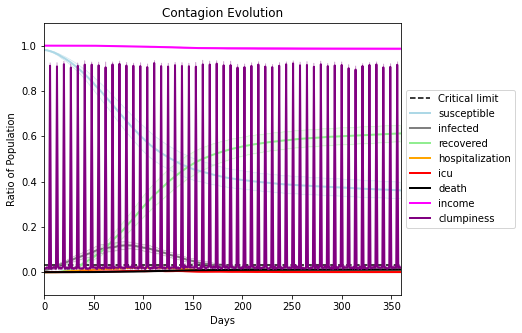

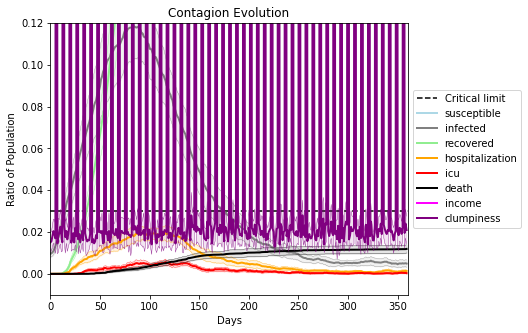

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8195, 8545, 4206, 6089, 3609, 9810, 9683, 3441, 6392, 6830, 3371, 1949, 7969, 7246, 7854, 4495, 4848, 39, 4647, 2407]
Average similarity between family members is 0.22216082850627794 at temperature -0.3
Average similarity between family and home is 0.9998511030324555 at temperature -1
Average similarity between students and their classroom is 0.19261553914899343 at temperature -0.3
Average classroom occupancy is 4.102941176470588 and number classrooms is 68
Average similarity between workers is 0.15126573093402643 at temperature -0.3
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.259266145258058 for kids: 0.21817899902884813
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.09896233265651297
avg restaurant similarity 0.04711230465604355
avg restaurant similarity 0.07473627610363232
avg restaurant similarity 0.06134015524991369
avg restaurant similarity 0.042232568247928176
avg restaurant similarity 0.1002582877742134
avg restaurant similarity 0.06538848128864364
avg restaurant similarity 0.0815379609058994
avg restaurant similarity 0.09169240023750742
avg restaurant similarity 0.07626281341144402
avg restaurant similarity 0.11064335090705829
avg restaurant similarity 0.07115375185242213
avg restaurant similarity 0.08330931576366592
avg restaurant similarity 0.08367475580819238
avg restaurant similarity 0.07745532673255713
avg restaurant similarity 0.05751200195025952
avg restaurant similarity 0.08686289227190697
avg restaurant similarity 0.07013271049092289
avg restaurant similarity 0.06685782171736512
avg restaurant similarity 0.10608767684760945
avg restaurant similarity 0.08890680446870654
avg restaurant similarity 0.1013004

avg restaurant similarity 0.07713791547559747
avg restaurant similarity 0.09251944665800964
avg restaurant similarity 0.08328943610621274
avg restaurant similarity 0.09813286775190007
avg restaurant similarity 0.09976877547869917
avg restaurant similarity 0.08226176464614246
avg restaurant similarity 0.04802889500019939
avg restaurant similarity 0.0734090586952221
avg restaurant similarity 0.10485522439963194
avg restaurant similarity 0.10380540298521493
avg restaurant similarity 0.07227157749945225
avg restaurant similarity 0.07152400259131175
avg restaurant similarity 0.09702003952824477
avg restaurant similarity 0.07634743958907622
avg restaurant similarity 0.08946348839271027
avg restaurant similarity 0.06566999499127613
avg restaurant similarity 0.06288168915992708
avg restaurant similarity 0.0669758878591269
avg restaurant similarity 0.09542649206937061
avg restaurant similarity 0.10642553525606921
avg restaurant similarity 0.0629005734807966
avg restaurant similarity 0.079200096

avg restaurant similarity 0.05351415004644291
avg restaurant similarity 0.0730483614856451
avg restaurant similarity 0.02009752296532478
avg restaurant similarity 0.0544452647111707
avg restaurant similarity 0.009218473430594207
avg restaurant similarity 0.08623881738148775
avg restaurant similarity 0.056887305385295045
avg restaurant similarity 0.02557255249440523
avg restaurant similarity 0.026447512801099984
avg restaurant similarity 0.05483495651665302
avg restaurant similarity 0.0493111197022617
avg restaurant similarity 0.05438684485244789
avg restaurant similarity 0.02594794807370547
avg restaurant similarity 0.06158702608265087
avg restaurant similarity 0.04057425916756088
avg restaurant similarity 0.06939537182263184
avg restaurant similarity 0.05764688331717178
avg restaurant similarity 0.030858651135743126
avg restaurant similarity -0.002112879220541534
avg restaurant similarity 0.07749750885264593
avg restaurant similarity 0.03298360907277322
avg restaurant similarity 0.034

avg restaurant similarity 0.020107843389264593
avg restaurant similarity 0.04131372864945388
avg restaurant similarity 0.07163907542804367
avg restaurant similarity 0.008510515120341396
avg restaurant similarity -0.020898130693732257
avg restaurant similarity 0.04688845411238183
avg restaurant similarity 0.0031278354083390456
avg restaurant similarity 0.09525035330984108
avg restaurant similarity 0.032378972139577265
avg restaurant similarity 0.060288190845839085
avg restaurant similarity 0.04644730607381337
avg restaurant similarity 0.058956530189372656
avg restaurant similarity 0.06604730079349364
avg restaurant similarity 0.04981914315913711
avg restaurant similarity 0.062148193948404956
avg restaurant similarity 0.03213193541682111
avg restaurant similarity -0.010334690424623556
avg restaurant similarity 0.07584772166671501
avg restaurant similarity 0.05988264106051346
avg restaurant similarity 0.042764853490501346
avg restaurant similarity 0.046229945284993385
avg restaurant simil

avg restaurant similarity 0.046483533640244566
avg restaurant similarity 0.10722867232883887
avg restaurant similarity 0.06087140804963203
avg restaurant similarity 0.09604006658887522
avg restaurant similarity 0.06993634140095888
avg restaurant similarity 0.05765359519009289
avg restaurant similarity 0.09927167295917105
avg restaurant similarity 0.05918378877591019
avg restaurant similarity 0.07187873923193407
avg restaurant similarity 0.0490348944851729
avg restaurant similarity 0.053427997513180996
avg restaurant similarity 0.07402051100530152
avg restaurant similarity 0.08170169125251822
avg restaurant similarity 0.043503347610373375
avg restaurant similarity 0.07105470446985478
avg restaurant similarity 0.058222675405751496
avg restaurant similarity 0.035148869022703165
avg restaurant similarity 0.04981872929376956
avg restaurant similarity 0.10679256301695274
avg restaurant similarity 0.04647436813806253
avg restaurant similarity 0.049522553315034405
avg restaurant similarity 0.0

avg restaurant similarity 0.024967515916801172
avg restaurant similarity 0.03494061262628729
avg restaurant similarity 0.07294656834644443
avg restaurant similarity 0.10602890416280861
avg restaurant similarity 0.05049772271541392
avg restaurant similarity 0.08065791564745636
avg restaurant similarity 0.06424289598267591
avg restaurant similarity 0.07759076461422648
avg restaurant similarity 0.03025401931080127
avg restaurant similarity 0.08513619357860656
avg restaurant similarity 0.048233381367302534
avg restaurant similarity 0.04764060788303664
avg restaurant similarity 0.06963743434568308
avg restaurant similarity 0.09789273261656534
avg restaurant similarity 0.09061743390131702
avg restaurant similarity 0.0633118596738288
avg restaurant similarity 0.052936334071230454
avg restaurant similarity 0.08836599994156544
avg restaurant similarity 0.03139165911309526
avg restaurant similarity 0.09341682349196194
avg restaurant similarity 0.048083257766035864
avg restaurant similarity 0.051

avg restaurant similarity 0.08326996583567321
avg restaurant similarity 0.04908025715375513
avg restaurant similarity 0.03937026249271234
avg restaurant similarity 0.037243292492371384
avg restaurant similarity 0.08898758524721424
avg restaurant similarity 0.062120237789120576
avg restaurant similarity 0.07872748435786558
avg restaurant similarity 0.06516569458914355
avg restaurant similarity 0.05779247858728273
avg restaurant similarity 0.05514960519909415
avg restaurant similarity 0.06102540572772988
avg restaurant similarity 0.049032630819145766
avg restaurant similarity 0.04261053187996656
avg restaurant similarity 0.06640233101099677
avg restaurant similarity 0.03650185353612688
avg restaurant similarity 0.04535492999807143
avg restaurant similarity 0.058201219561308734
avg restaurant similarity 0.07445324343462684
avg restaurant similarity 0.07598756704907005
avg restaurant similarity 0.015159938903143233
avg restaurant similarity 0.033011675525495617
avg restaurant similarity 0.

avg restaurant similarity 0.030376943139819056
avg restaurant similarity 0.0484081956213159
avg restaurant similarity 0.005763254168533848
avg restaurant similarity 0.07705397999293633
avg restaurant similarity 0.02582378564182098
avg restaurant similarity 0.03969537165459999
avg restaurant similarity 0.07415950858322626
avg restaurant similarity 0.07592448480731424
avg restaurant similarity 0.04731620780292848
avg restaurant similarity 0.02141567310687502
avg restaurant similarity 0.04373016052699279
avg restaurant similarity 0.011809245823835903
avg restaurant similarity 0.04358925541005937
avg restaurant similarity 0.03218950383906301
avg restaurant similarity 0.013555090105285474
avg restaurant similarity 0.03438767558682558
avg restaurant similarity 0.047745086355329217
avg restaurant similarity 0.04249003651934105
avg restaurant similarity 0.04854697805490144
avg restaurant similarity 0.007027186881798737
avg restaurant similarity 0.057058132615484154
avg restaurant similarity 0.

avg restaurant similarity 0.056731762717467445
avg restaurant similarity 0.0368401868997491
avg restaurant similarity 0.033243130426479715
avg restaurant similarity 0.046766243830262864
avg restaurant similarity 0.04583988638108145
avg restaurant similarity 0.003499288092670056
avg restaurant similarity 0.05190058906381677
avg restaurant similarity 0.03455801006507575
avg restaurant similarity 0.08426787065346081
avg restaurant similarity 0.038222478842489506
avg restaurant similarity 0.06049949860539682
avg restaurant similarity 0.06791912630887378
avg restaurant similarity 0.04346952487670273
avg restaurant similarity 0.05979833282664078
avg restaurant similarity 0.06818770889703693
avg restaurant similarity 0.03287613582725392
avg restaurant similarity 0.03968602208055704
avg restaurant similarity 0.10131933064459134
avg restaurant similarity 0.0932261380134958
avg restaurant similarity 0.10042326985032572
avg restaurant similarity 0.05454608136370427
avg restaurant similarity 0.063

avg restaurant similarity 0.09932063727389118
avg restaurant similarity 0.06258718446021154
avg restaurant similarity 0.05149166030378952
avg restaurant similarity 0.10067630065377647
avg restaurant similarity 0.04074018498801379
avg restaurant similarity 0.07993990478401847
avg restaurant similarity 0.06682270108453249
avg restaurant similarity 0.03342918081426834
avg restaurant similarity 0.07863536529305144
avg restaurant similarity 0.08524485409872563
avg restaurant similarity 0.09691861340364812
avg restaurant similarity 0.10056662652835066
avg restaurant similarity 0.05573284270978485
avg restaurant similarity 0.06420669238434216
avg restaurant similarity 0.06745133859295672
avg restaurant similarity 0.08407317022647161
avg restaurant similarity 0.014637419999874437
avg restaurant similarity 0.02045086859583555
avg restaurant similarity 0.05412381587449434
avg restaurant similarity 0.020489709920433335
avg restaurant similarity 0.04592598396684948
avg restaurant similarity 0.0490

avg restaurant similarity 0.038574493944621084
avg restaurant similarity 0.06882557762585358
avg restaurant similarity 0.04165017640238228
avg restaurant similarity 0.020024419419707267
avg restaurant similarity 0.08205714063092379
avg restaurant similarity 0.034197240749054274
avg restaurant similarity 0.03238867349927601
avg restaurant similarity 0.07398619924361399
avg restaurant similarity 0.024783405605434766
avg restaurant similarity 0.04103457166728584
avg restaurant similarity 0.07238218705483135
avg restaurant similarity 0.047763964862274945
avg restaurant similarity 0.020695860505398712
avg restaurant similarity 0.059021483615073395
avg restaurant similarity 0.10526858458049627
avg restaurant similarity 0.013225136554388188
avg restaurant similarity 0.025334971417565254
avg restaurant similarity 0.031562655872761775
avg restaurant similarity 0.022523653473168884
avg restaurant similarity -0.0003909482168692478
avg restaurant similarity 0.055696719248453735
avg restaurant simi

avg restaurant similarity 0.08233683590167354
avg restaurant similarity 0.09666046192758616
avg restaurant similarity 0.07796845854757903
avg restaurant similarity 0.003647686425165907
avg restaurant similarity 0.01925457565042311
avg restaurant similarity 0.10189982132839337
avg restaurant similarity 0.00344382707229509
avg restaurant similarity 0.026839032159211972
avg restaurant similarity 0.028236066243274804
avg restaurant similarity 0.08252978139729299
avg restaurant similarity 0.030333680292401723
avg restaurant similarity 0.09376167117419199
avg restaurant similarity 0.05379756671041777
avg restaurant similarity 0.04205784340302815
avg restaurant similarity 0.052961801000307646
avg restaurant similarity 0.11076156073355685
avg restaurant similarity 0.0312444541083921
avg restaurant similarity 0.08461978378124428
avg restaurant similarity 0.004271444681679231
avg restaurant similarity 0.08859048306509053
avg restaurant similarity 0.06688087835818474
avg restaurant similarity 0.1

avg restaurant similarity 0.03093968912314472
avg restaurant similarity 0.06824479124766869
avg restaurant similarity 0.07322286048597368
avg restaurant similarity 0.04506682163126053
avg restaurant similarity 0.07049893148221424
avg restaurant similarity 0.06419761190633322
avg restaurant similarity 0.06121158441209728
avg restaurant similarity 0.08249178546424206
avg restaurant similarity 0.04562393309878229
avg restaurant similarity 0.08692366336768274
avg restaurant similarity 0.07656656607954453
avg restaurant similarity 0.041438411198112056
avg restaurant similarity 0.09295537351611026
avg restaurant similarity 0.0857175052183099
avg restaurant similarity 0.10662439140807639
avg restaurant similarity 0.08357826540384063
avg restaurant similarity 0.057086923923664185
avg restaurant similarity 0.13151670883288152
avg restaurant similarity 0.07033564624873088
avg restaurant similarity 0.08556092115599925
avg restaurant similarity 0.06561803234340065
avg restaurant similarity 0.06462

avg restaurant similarity 0.10032339639282861
avg restaurant similarity 0.04418433947303332
avg restaurant similarity 0.06762317847461237
avg restaurant similarity 0.08154821544115805
avg restaurant similarity 0.05606809056763605
avg restaurant similarity 0.0687704816602292
avg restaurant similarity 0.05895836536202449
avg restaurant similarity 0.10419622443346542
avg restaurant similarity 0.0691605081524437
avg restaurant similarity 0.10781720042478354
avg restaurant similarity 0.038748975561539764
avg restaurant similarity 0.10304397009559856
avg restaurant similarity 0.08891514107175356
avg restaurant similarity 0.11023635720130523
avg restaurant similarity 0.08898361693416365
avg restaurant similarity 0.09327537254654084
avg restaurant similarity 0.06816709042807162
avg restaurant similarity 0.037032921821920944
avg restaurant similarity 0.10564690996871637
avg restaurant similarity 0.046329243150467055
avg restaurant similarity 0.030901152250025588
avg restaurant similarity 0.0529

avg restaurant similarity 0.06649217660341054
avg restaurant similarity 0.0399772855579823
avg restaurant similarity 0.0941586627140414
avg restaurant similarity 0.053247573418134346
avg restaurant similarity 0.062122230176590215
avg restaurant similarity 0.043727049149057576
avg restaurant similarity 0.08587485439725559
avg restaurant similarity 0.10753614658087765
avg restaurant similarity 0.06412918429868085
avg restaurant similarity 0.033589114408409594
avg restaurant similarity 0.05250505346807374
avg restaurant similarity 0.04914138324099877
avg restaurant similarity 0.07156615023800894
avg restaurant similarity 0.07790355007218487
avg restaurant similarity 0.11195497324167977
avg restaurant similarity 0.06007620394545641
avg restaurant similarity 0.053881787639944154
avg restaurant similarity 0.04403617336071683
avg restaurant similarity 0.05650666067070646
avg restaurant similarity 0.029820459110249865
avg restaurant similarity 0.044751878159571705
avg restaurant similarity 0.0

avg restaurant similarity 0.04611122207791488
avg restaurant similarity 0.030650484042804703
avg restaurant similarity 0.05442403203917176
avg restaurant similarity 0.021583582566298658
avg restaurant similarity 0.07051451054100581
avg restaurant similarity 0.058485795624870954
avg restaurant similarity 0.052839224518600285
avg restaurant similarity 0.07750872374989708
avg restaurant similarity 0.07620431137511424
avg restaurant similarity 0.07549646414502756
avg restaurant similarity -0.021375808237775143
avg restaurant similarity 0.06943280408494949
avg restaurant similarity 0.0719693232679978
avg restaurant similarity 0.0708383830869162
avg restaurant similarity 0.034498966103191406
avg restaurant similarity 0.05584930219631746
avg restaurant similarity 0.06574202682151035
avg restaurant similarity 0.05984546597341469
avg restaurant similarity 0.04543674585698973
avg restaurant similarity 0.07900975405200826
avg restaurant similarity 0.03836422041574252
avg restaurant similarity 0.0

avg restaurant similarity 0.05273172569195399
avg restaurant similarity 0.07056981140277849
avg restaurant similarity 0.07097040612872679
avg restaurant similarity 0.07058017595466463
avg restaurant similarity 0.07898700679462123
avg restaurant similarity 0.047881400336782495
avg restaurant similarity 0.020625265778434338
avg restaurant similarity 0.056797639743419455
avg restaurant similarity 0.07260521081316383
avg restaurant similarity 0.03089423649302012
avg restaurant similarity 0.02901511884734472
avg restaurant similarity 0.04549987699874045
avg restaurant similarity 0.06509984060582318
avg restaurant similarity 0.036339338960032
avg restaurant similarity 0.05588858183208629
avg restaurant similarity 0.05459363983568262
avg restaurant similarity 0.08392772538525485
avg restaurant similarity 0.059873626705904126
avg restaurant similarity 0.05384217474742072
avg restaurant similarity 0.043572839059894036
avg restaurant similarity 0.08532452844201523
avg restaurant similarity 0.048

avg restaurant similarity 0.12144532303702188
avg restaurant similarity 0.07326024249064872
avg restaurant similarity 0.10478954583962785
avg restaurant similarity 0.10223557162012907
avg restaurant similarity 0.0359067366093798
avg restaurant similarity 0.08239539508634967
avg restaurant similarity 0.06713251020721428
avg restaurant similarity 0.02090430285394832
avg restaurant similarity 0.03539260340982492
avg restaurant similarity 0.07296373977300716
avg restaurant similarity 0.06243342911431358
avg restaurant similarity 0.07820492184896662
avg restaurant similarity 0.06564899563608317
avg restaurant similarity 0.07491563895384981
avg restaurant similarity 0.036801835211413544
avg restaurant similarity 0.07071147070762125
avg restaurant similarity 0.11449516801156379
avg restaurant similarity 0.050522848819898845
avg restaurant similarity 0.04427053816705247
avg restaurant similarity 0.08449100690414903
avg restaurant similarity 0.05899521210492182
avg restaurant similarity 0.08508

avg restaurant similarity 0.04529805908845515
avg restaurant similarity 0.077485159921277
avg restaurant similarity 0.03521245504451069
avg restaurant similarity 0.049485415763458
avg restaurant similarity 0.09732240066082672
avg restaurant similarity 0.03719698637939406
avg restaurant similarity 0.023809314022010933
avg restaurant similarity 0.1097841775639888
avg restaurant similarity 0.05953281309427338
avg restaurant similarity 0.06046326951722702
avg restaurant similarity 0.053764908645266965
avg restaurant similarity 0.030975152240918364
avg restaurant similarity 0.06175800521431345
avg restaurant similarity 0.09227353069753987
avg restaurant similarity -0.006269451142068978
avg restaurant similarity 0.04991389452386152
avg restaurant similarity 0.06794178256306875
avg restaurant similarity 0.07446939614032776
avg restaurant similarity 0.022229492451946043
avg restaurant similarity 0.05277571314128974
avg restaurant similarity 0.00566555441220969
avg restaurant similarity 0.10793

avg restaurant similarity 0.05336701098738528
avg restaurant similarity 0.07050170458065404
avg restaurant similarity 0.0526729279848583
avg restaurant similarity 0.05193758844546729
avg restaurant similarity 0.0814272874844866
avg restaurant similarity 0.02792776684553513
avg restaurant similarity 0.04125097967518026
avg restaurant similarity 0.06805412422677408
avg restaurant similarity 0.08427103525672579
avg restaurant similarity 0.04158361608418527
avg restaurant similarity 0.07982591089866306
avg restaurant similarity 0.06810118717160266
avg restaurant similarity 0.06113567494238191
avg restaurant similarity 0.11194010112084689
avg restaurant similarity 0.10061191900866692
avg restaurant similarity 0.051863151640860555
avg restaurant similarity 0.07027134465145944
avg restaurant similarity 0.033542283251898224
avg restaurant similarity 0.06306135582503107
avg restaurant similarity 0.04113931049686238
avg restaurant similarity 0.026282022263509557
avg restaurant similarity 0.02262

avg restaurant similarity 0.06768593046501274
avg restaurant similarity 0.10491117696298476
avg restaurant similarity 0.06460390643755248
avg restaurant similarity 0.041761404781067116
avg restaurant similarity 0.04610247303704525
avg restaurant similarity 0.08698968491560281
avg restaurant similarity 0.0966218179898631
avg restaurant similarity 0.08228944882441427
avg restaurant similarity 0.05016646939357709
avg restaurant similarity 0.02749735411386255
avg restaurant similarity 0.004462538325884368
avg restaurant similarity 0.07130725242254123
avg restaurant similarity 0.12226869176984057
avg restaurant similarity 0.12019831779277049
avg restaurant similarity 0.06640206022999137
avg restaurant similarity 0.05996590429494827
avg restaurant similarity 0.03384463405598424
avg restaurant similarity 0.08219086607345927
avg restaurant similarity 0.04212863505260291
avg restaurant similarity 0.03757489400778801
avg restaurant similarity 0.07994213894615018
avg restaurant similarity 0.08408

avg restaurant similarity 0.08326263678154604
avg restaurant similarity 0.047527891313624206
avg restaurant similarity 0.08149528171704445
avg restaurant similarity 0.06326262692456827
avg restaurant similarity 0.038237299260899416
avg restaurant similarity 0.05626940236234991
avg restaurant similarity 0.07188059068110136
avg restaurant similarity 0.012139815064818399
avg restaurant similarity 0.08571564882899324
avg restaurant similarity 0.027678760844258316
avg restaurant similarity 0.05952840615305047
avg restaurant similarity 0.07500754025438097
avg restaurant similarity 0.04699945579607073
avg restaurant similarity 0.08258246774488148
avg restaurant similarity 0.020528076297380123
avg restaurant similarity 0.06598257568272023
avg restaurant similarity 0.049634466813180525
avg restaurant similarity 0.05744836779809804
avg restaurant similarity 0.044081177085187224
avg restaurant similarity 0.07522086787656954
avg restaurant similarity 0.04101641115200499
avg restaurant similarity 0

avg restaurant similarity 0.10610014048372486
avg restaurant similarity 0.08518435474200171
avg restaurant similarity 0.0951519324585898
avg restaurant similarity 0.10525503266750758
avg restaurant similarity 0.11209641871614608
avg restaurant similarity 0.08636712378999187
avg restaurant similarity 0.12114067786106687
avg restaurant similarity 0.04957730851279116
avg restaurant similarity 0.07453553943088549
avg restaurant similarity 0.09649428640711057
avg restaurant similarity 0.07482027163059689
avg restaurant similarity 0.04119723659812815
avg restaurant similarity 0.0682747148540315
avg restaurant similarity 0.09157679492731707
avg restaurant similarity 0.10055406186060302
avg restaurant similarity 0.05625725351096328
avg restaurant similarity 0.10881705941154726
avg restaurant similarity 0.031263439228194315
avg restaurant similarity 0.08143325416754969
avg restaurant similarity 0.05794628506037561
avg restaurant similarity 0.10479860609908659
avg restaurant similarity 0.0411422

avg restaurant similarity 0.02786125172994805
avg restaurant similarity 0.06366366969346764
avg restaurant similarity 0.08556815249191266
avg restaurant similarity 0.12914729511018083
avg restaurant similarity 0.023911657038785054
avg restaurant similarity 0.04691706275046157
avg restaurant similarity 0.14236638959621348
avg restaurant similarity 0.08099099450326837
avg restaurant similarity 0.09570067907153326
avg restaurant similarity 0.07736432700846378
avg restaurant similarity 0.0710541433827243
avg restaurant similarity 0.09000486311742684
avg restaurant similarity 0.054160744273434556
avg restaurant similarity 0.14243936392496953
avg restaurant similarity 0.13216906679271218
avg restaurant similarity 0.12573736346717357
avg restaurant similarity 0.07756999748647332
avg restaurant similarity 0.09611639127547005
avg restaurant similarity 0.09771180471246028
avg restaurant similarity 0.10478140819444737
avg restaurant similarity 0.10802318831352065
avg restaurant similarity 0.10476

avg restaurant similarity -0.0034477186745333803
avg restaurant similarity 0.0423595512312911
avg restaurant similarity 0.08843956970093111
avg restaurant similarity 0.05281434387511776
avg restaurant similarity 0.08502107941661836
avg restaurant similarity 0.04165950541504902
avg restaurant similarity 0.08027411251430787
avg restaurant similarity 0.004632211973647485
avg restaurant similarity 0.04168523622946136
avg restaurant similarity 0.03890915791211713
avg restaurant similarity 0.06175496060199981
avg restaurant similarity 0.020677909571192733
avg restaurant similarity 0.05113546792273599
avg restaurant similarity 0.10369146207982738
avg restaurant similarity 0.05756603003931026
avg restaurant similarity 0.07172367985212717
avg restaurant similarity 0.021495803587780988
avg restaurant similarity 0.0794762262888335
avg restaurant similarity 0.056119821322400135
avg restaurant similarity 0.057468115336964984
avg restaurant similarity 0.10783654827052191
avg restaurant similarity 0.

avg restaurant similarity 0.08311099739943928
avg restaurant similarity 0.0664246009779498
avg restaurant similarity 0.09924216918758055
avg restaurant similarity 0.05489212509152042
avg restaurant similarity 0.09415103896991803
avg restaurant similarity 0.06295863771114568
avg restaurant similarity 0.06302425532343044
avg restaurant similarity 0.07175578169998452
avg restaurant similarity 0.0409591353891194
avg restaurant similarity -0.019003301697877388
avg restaurant similarity 0.09648010828068862
avg restaurant similarity 0.03560136947765565
avg restaurant similarity 0.08103210117629989
avg restaurant similarity 0.057079331290624986
avg restaurant similarity -0.0034024535637999435
avg restaurant similarity 0.035683917347512965
avg restaurant similarity 0.03533781360263893
avg restaurant similarity 0.04471260559778219
avg restaurant similarity 0.05775100747839893
avg restaurant similarity 0.048601367383414425
avg restaurant similarity 0.05872680555332187
avg restaurant similarity 0.

avg restaurant similarity 0.07885889141345347
avg restaurant similarity 0.0774849272643596
avg restaurant similarity 0.008722546824626011
avg restaurant similarity 0.05241249292238831
avg restaurant similarity 0.07498308724955945
avg restaurant similarity 0.0009932555489041409
avg restaurant similarity 0.08840691582303122
avg restaurant similarity 0.05755440365169408
avg restaurant similarity 0.03470714044742473
avg restaurant similarity 0.0824392498010435
avg restaurant similarity 0.07199564430888683
avg restaurant similarity 0.0850553635216281
avg restaurant similarity 0.07847940236096305
avg restaurant similarity 0.09950433194515805
avg restaurant similarity 0.026911096643294902
avg restaurant similarity 0.04400630309725528
avg restaurant similarity 0.03776621371505801
avg restaurant similarity 0.04948776588505464
avg restaurant similarity 0.08433182967741049
avg restaurant similarity 0.006152182868331114
avg restaurant similarity 0.032599832755858524
avg restaurant similarity 0.075

avg restaurant similarity 0.04653287039492702
avg restaurant similarity 0.06608285747652902
avg restaurant similarity 0.008247866124745618
avg restaurant similarity 0.04888396392036925
avg restaurant similarity 0.07501804516874075
avg restaurant similarity 0.0460717049640163
avg restaurant similarity 0.05300544903373831
avg restaurant similarity 0.10751249210573102
avg restaurant similarity 0.043395822738208745
avg restaurant similarity 0.03311739991877823
avg restaurant similarity 0.08184440379999162
avg restaurant similarity 0.0789860525671205
avg restaurant similarity 0.013552181300246107
avg restaurant similarity 0.023407453393313783
avg restaurant similarity 0.056510839093361714
avg restaurant similarity 0.07348135477442333
avg restaurant similarity -0.041838986041424144
avg restaurant similarity 0.031673469031589484
avg restaurant similarity 0.035143136507466345
avg restaurant similarity 0.009098212162584256
avg restaurant similarity 0.025755566740781086
avg restaurant similarity

avg restaurant similarity 0.11201577355703765
avg restaurant similarity 0.064346439333295
avg restaurant similarity 0.06281726340742814
avg restaurant similarity 0.06678874522966882
avg restaurant similarity 0.10173933091007152
avg restaurant similarity 0.09927286307288484
avg restaurant similarity 0.09287777742809569
avg restaurant similarity 0.0569921515995437
avg restaurant similarity 0.02065853876996103
avg restaurant similarity 0.0499551794653672
avg restaurant similarity 0.08594192499942659
avg restaurant similarity 0.03174438873616064
avg restaurant similarity 0.11654329249284398
avg restaurant similarity 0.06146225308294214
avg restaurant similarity 0.11724309741172678
avg restaurant similarity 0.05364770795699402
avg restaurant similarity -0.0053013708173318685
avg restaurant similarity 0.05664012283587063
avg restaurant similarity 0.10581928768547864
avg restaurant similarity 0.04938830944971927
avg restaurant similarity 0.09524069077135658
avg restaurant similarity 0.0530396

avg restaurant similarity 0.03148651118923262
avg restaurant similarity 0.03150678739715598
avg restaurant similarity 0.0644976423826601
avg restaurant similarity 0.07406108394568955
avg restaurant similarity 0.08223415626972182
avg restaurant similarity 0.01908824413417093
avg restaurant similarity 0.081116178654881
avg restaurant similarity 0.03812304369870157
avg restaurant similarity 0.05682268981984218
avg restaurant similarity 0.08570644073698397
avg restaurant similarity 0.04587824864060976
avg restaurant similarity 0.11364451379464656
avg restaurant similarity 0.0595239167673226
avg restaurant similarity 0.05116540581069211
avg restaurant similarity 0.08151105054734055
avg restaurant similarity 0.05444369556248537
avg restaurant similarity 0.04271203797917755
avg restaurant similarity 0.03962294074013769
avg restaurant similarity 0.06299364918701242
avg restaurant similarity 0.09564330912627436
avg restaurant similarity 0.053316397241516794
avg restaurant similarity 0.062376238

avg restaurant similarity 0.08534469970093234
avg restaurant similarity 0.0857269635428076
avg restaurant similarity 0.08891669610448451
avg restaurant similarity 0.06621756524582642
avg restaurant similarity 0.07940928928494788
avg restaurant similarity 0.10376506986677103
avg restaurant similarity 0.04455652252960219
avg restaurant similarity 0.07123982839288252
avg restaurant similarity 0.09484134147985247
avg restaurant similarity 0.08148577896314116
avg restaurant similarity 0.1147123334733325
avg restaurant similarity 0.0532282761309848
avg restaurant similarity 0.08734980100568583
avg restaurant similarity 0.13125934439403464
avg restaurant similarity 0.09819802546103422
avg restaurant similarity 0.12924008514211197
avg restaurant similarity 0.06705802547527215
avg restaurant similarity 0.05807132125690664
avg restaurant similarity 0.07537162564560639
avg restaurant similarity 0.054188339167850055
avg restaurant similarity 0.0793785004987156
avg restaurant similarity 0.092174779

avg restaurant similarity 0.0732279781030542
avg restaurant similarity 0.04377742811201339
avg restaurant similarity 0.11135941434292376
avg restaurant similarity 0.09009745495562732
avg restaurant similarity 0.07566452324372223
avg restaurant similarity 0.08745874209789142
avg restaurant similarity 0.06612211192393447
avg restaurant similarity 0.11736729973814461
avg restaurant similarity 0.11948763774589953
avg restaurant similarity 0.08278763326223337
avg restaurant similarity 0.05421355192935002
avg restaurant similarity 0.06963551598574236
avg restaurant similarity 0.08322909962796365
avg restaurant similarity 0.09064064095917881
avg restaurant similarity 0.08520387329657406
avg restaurant similarity 0.045152259658023886
avg restaurant similarity 0.05273572696065988
avg restaurant similarity 0.06814222642856756
avg restaurant similarity 0.10687135985185113
avg restaurant similarity 0.05405883244131193
avg restaurant similarity 0.09648258810981859
avg restaurant similarity 0.081806

avg restaurant similarity 0.07239910222074888
avg restaurant similarity 0.11738997388933049
avg restaurant similarity 0.10283587917705624
avg restaurant similarity 0.10130683049676388
avg restaurant similarity 0.12062505601413759
avg restaurant similarity 0.07243876790946534
avg restaurant similarity 0.03498960672312659
avg restaurant similarity 0.10846572970590306
avg restaurant similarity 0.06892403587072947
avg restaurant similarity 0.048573766691563915
avg restaurant similarity 0.11737430677219801
avg restaurant similarity 0.12703365820216173
avg restaurant similarity 0.1155273119685
avg restaurant similarity 0.037186146612122245
avg restaurant similarity 0.05622093960559306
avg restaurant similarity 0.11741151368672106
avg restaurant similarity 0.10384867248898644
avg restaurant similarity 0.1294892877071916
avg restaurant similarity 0.06926579138268726
avg restaurant similarity 0.14315172066373244
avg restaurant similarity 0.1070976865123966
avg restaurant similarity 0.0544947555

avg restaurant similarity 0.11316763022900225
avg restaurant similarity 0.07262135796512921
avg restaurant similarity 0.10032867657734255
avg restaurant similarity 0.03226759307264342
avg restaurant similarity 0.06048584228043262
avg restaurant similarity 0.1388924263385134
avg restaurant similarity 0.034156466930659275
avg restaurant similarity 0.14208447753631523
avg restaurant similarity 0.12536225920107516
avg restaurant similarity 0.10394990470360752
avg restaurant similarity 0.13493323611875152
avg restaurant similarity 0.05838516813373824
avg restaurant similarity 0.14279029296868553
avg restaurant similarity 0.037291104479399685
avg restaurant similarity 0.06371413486801474
avg restaurant similarity 0.09647154299336122
avg restaurant similarity 0.10953980804881297
avg restaurant similarity 0.13343393930806857
avg restaurant similarity 0.05723897266551762
avg restaurant similarity 0.10759027257530102
avg restaurant similarity 0.10292527500404242
avg restaurant similarity 0.09176

avg restaurant similarity 0.03855338975462353
avg restaurant similarity 0.029949051739936162
avg restaurant similarity 0.07514335602575346
avg restaurant similarity 0.031665985532782825
avg restaurant similarity 0.058590911183795204
avg restaurant similarity 0.06098800784534087
avg restaurant similarity 0.0774890823522255
avg restaurant similarity 0.07846392085622544
avg restaurant similarity 0.08161232863590717
avg restaurant similarity 0.09510741727114559
avg restaurant similarity 0.08648703527345931
avg restaurant similarity 0.05693232225514772
avg restaurant similarity 0.11748369976825812
avg restaurant similarity 0.042296279199032984
avg restaurant similarity 0.0994505933138583
avg restaurant similarity 0.08659405851268791
avg restaurant similarity 0.06456669444114507
avg restaurant similarity 0.06649548788161541
avg restaurant similarity 0.0609322133803151
avg restaurant similarity 0.10705093021502066
avg restaurant similarity 0.0527907804228852
avg restaurant similarity 0.070541

avg restaurant similarity 0.05469938154494328
avg restaurant similarity 0.08924719766537255
avg restaurant similarity 0.05822008385418629
avg restaurant similarity 0.09494141408418638
avg restaurant similarity 0.1017767305361543
avg restaurant similarity 0.04633818835376066
avg restaurant similarity 0.018291262341282533
avg restaurant similarity 0.08188473051711355
avg restaurant similarity 0.04332660335524618
avg restaurant similarity 0.045975452441066746
avg restaurant similarity 0.05912655580763239
avg restaurant similarity 0.052654193338836607
avg restaurant similarity 0.08317106667296882
avg restaurant similarity 0.08858209509861813
avg restaurant similarity 0.0579710826110794
avg restaurant similarity 0.04958573771152212
avg restaurant similarity 0.1054067961429917
avg restaurant similarity 0.0797165745014816
avg restaurant similarity 0.08073551464012932
avg restaurant similarity 0.06300330173005342
avg restaurant similarity 0.08172483431155189
avg restaurant similarity 0.0967317

avg restaurant similarity 0.11026156271427985
avg restaurant similarity 0.09534403371134928
avg restaurant similarity 0.09881395435600387
avg restaurant similarity 0.060981464835658104
avg restaurant similarity 0.04983238664460362
avg restaurant similarity 0.008485777095273199
avg restaurant similarity 0.059892708782838935
avg restaurant similarity 0.06769847153576071
avg restaurant similarity 0.054778787615424235
avg restaurant similarity 0.08342715716383735
avg restaurant similarity 0.05643064120283745
avg restaurant similarity 0.034723629771700154
avg restaurant similarity 0.0690559143986665
avg restaurant similarity 0.010447974610535964
avg restaurant similarity 0.06471845871999282
avg restaurant similarity 0.02968446813011153
avg restaurant similarity 0.01720021190353299
avg restaurant similarity 0.0252074963261124
avg restaurant similarity 0.051276925165708115
avg restaurant similarity -0.004242776357829508
avg restaurant similarity 0.07462735575986064
avg restaurant similarity 0

avg restaurant similarity 0.052591181983165695
avg restaurant similarity 0.05158841911289511
avg restaurant similarity 0.06476692395799528
avg restaurant similarity 0.09059486958644242
avg restaurant similarity 0.09820868647669205
avg restaurant similarity 0.05134250779850684
avg restaurant similarity 0.0868380014415505
avg restaurant similarity 0.0822356322042132
avg restaurant similarity 0.08349080302351584
avg restaurant similarity -0.006635386096211546
avg restaurant similarity 0.048256496817001816
avg restaurant similarity 0.05966770517275047
avg restaurant similarity 0.0640821235178957
avg restaurant similarity 0.05386424516662496
avg restaurant similarity 0.03511342775179753
avg restaurant similarity 0.107487626865641
avg restaurant similarity 0.007832995512685487
avg restaurant similarity 0.06830551266694168
avg restaurant similarity -0.0014155248154910677
avg restaurant similarity 0.0801871868079845
avg restaurant similarity 0.11522444066511872
avg restaurant similarity 0.0024

avg restaurant similarity 0.07455692906195875
avg restaurant similarity 0.029836008539991556
avg restaurant similarity 0.06817822441900201
avg restaurant similarity 0.11729488958418381
avg restaurant similarity 0.008756128633738577
avg restaurant similarity 0.04951250460125234
avg restaurant similarity 0.10178524318615041
avg restaurant similarity 0.01876490981558862
avg restaurant similarity 0.1012934602184521
avg restaurant similarity 0.054640930319045045
avg restaurant similarity 0.04901280682834392
avg restaurant similarity 0.12613861637640134
avg restaurant similarity 0.07484326615824126
avg restaurant similarity 0.0783186629805664
avg restaurant similarity 0.050742405156886335
avg restaurant similarity 0.06961505108700929
avg restaurant similarity 0.10982873116761553
avg restaurant similarity 0.07774058000082265
avg restaurant similarity 0.1138883189160468
avg restaurant similarity 0.08128353267205411
avg restaurant similarity 0.07772923886264264
avg restaurant similarity 0.06824

avg restaurant similarity 0.09345466167741615
avg restaurant similarity 0.04588076544302874
avg restaurant similarity 0.05428393194246468
avg restaurant similarity 0.10319597158025723
avg restaurant similarity 0.08463655071980222
avg restaurant similarity 0.06990751784794595
avg restaurant similarity 0.14773432855019542
avg restaurant similarity 0.08372161009907289
avg restaurant similarity 0.09749776061747818
avg restaurant similarity 0.0831595780018815
avg restaurant similarity 0.10041103685698136
avg restaurant similarity 0.0852380254950514
avg restaurant similarity 0.0890163159357869
avg restaurant similarity 0.1186870730249226
avg restaurant similarity 0.005339912750698414
avg restaurant similarity 0.10376848326036772
avg restaurant similarity 0.0968011524234102
avg restaurant similarity 0.06864668942870358
avg restaurant similarity 0.07190372876414391
avg restaurant similarity 0.06795260532993155
avg restaurant similarity 0.11655516128344622
avg restaurant similarity 0.0931004889

(<function dict.items>, <function dict.items>, <function dict.items>)

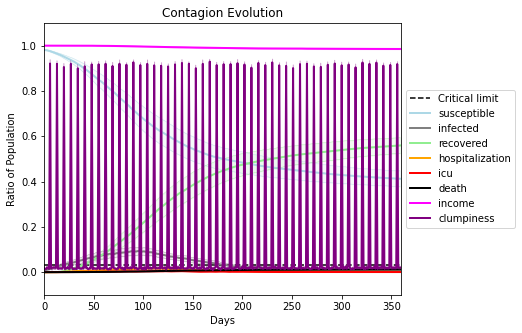

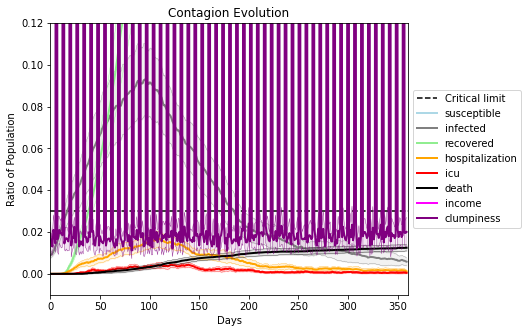

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6617, 9623, 1284, 1350, 9145, 7276, 2103, 6993, 1006, 8832, 5391, 5138, 9608, 2837, 4940, 5253, 7679, 6701, 6782, 3612]
Average similarity between family members is 0.20910770808082993 at temperature -0.2
Average similarity between family and home is 0.9998553648446751 at temperature -1
Average similarity between students and their classroom is 0.16685386219249249 at temperature -0.2
Average classroom occupancy is 4.138888888888889 and number classrooms is 72
Average similarity between workers is 0.17071207528127813 at temperature -0.2
Average office occupancy is 3.284263959390863 and number offices is 197
Average friend similarity for adults: 0.2142593875309094 for kids: 0.19528021261625825
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.0687617266369472
avg restaurant similarity 0.07518413879209987
avg restaurant similarity 0.038736329411458235
avg restaurant similarity 0.06204772392597732
avg restaurant similarity 0.06519875136569908
avg restaurant similarity 0.06665214052266057
avg restaurant similarity 0.04841954245649591
avg restaurant similarity 0.07237355758835712
avg restaurant similarity 0.07773480574140543
avg restaurant similarity 0.07930984633373028
avg restaurant similarity 0.06884984260784166
avg restaurant similarity 0.061168019678709766
avg restaurant similarity 0.10315025993256799
avg restaurant similarity 0.0758961291111362
avg restaurant similarity 0.07229550358053936
avg restaurant similarity 0.04628344809887714
avg restaurant similarity 0.10738505193726781
avg restaurant similarity 0.08577681791670426
avg restaurant similarity 0.06313033092673016
avg restaurant similarity 0.04233749909682403
avg restaurant similarity 0.06447518225344674
avg restaurant similarity 0.082437

avg restaurant similarity 0.10176356736738806
avg restaurant similarity 0.0645468036141751
avg restaurant similarity 0.08372059438608809
avg restaurant similarity 0.04380961803763037
avg restaurant similarity 0.06556123075493094
avg restaurant similarity 0.06849471181493966
avg restaurant similarity 0.05813213172080246
avg restaurant similarity 0.07350331831521702
avg restaurant similarity 0.08822686480727501
avg restaurant similarity 0.04493958380822232
avg restaurant similarity 0.10014477349060742
avg restaurant similarity 0.07303252829947952
avg restaurant similarity 0.07092330593944354
avg restaurant similarity 0.10493937336155268
avg restaurant similarity 0.04485793643059916
avg restaurant similarity 0.05930082177462095
avg restaurant similarity 0.07693355978215005
avg restaurant similarity 0.07446876599719539
avg restaurant similarity 0.10189215833562593
avg restaurant similarity 0.060294169042736954
avg restaurant similarity 0.09071222754307987
avg restaurant similarity 0.038869

avg restaurant similarity 0.034268736272835526
avg restaurant similarity 0.0619550058533558
avg restaurant similarity 0.07446351295562752
avg restaurant similarity 0.04302089067002916
avg restaurant similarity 0.08328704505778332
avg restaurant similarity 0.0633643912330957
avg restaurant similarity 0.0582076085428423
avg restaurant similarity 0.07237827337070085
avg restaurant similarity 0.09246319070041224
avg restaurant similarity 0.06022781705095786
avg restaurant similarity 0.08260616539511573
avg restaurant similarity 0.005127524031490888
avg restaurant similarity 0.07293627507533887
avg restaurant similarity 0.039991316165181444
avg restaurant similarity 0.08434873150220822
avg restaurant similarity 0.08119233374661979
avg restaurant similarity 0.07606041616993979
avg restaurant similarity 0.06191207311103581
avg restaurant similarity 0.021885944891171075
avg restaurant similarity 0.04327614059500299
avg restaurant similarity 0.07699956575480231
avg restaurant similarity 0.06765

avg restaurant similarity 0.11120253738410954
avg restaurant similarity 0.03496289767196567
avg restaurant similarity 0.10599518927758976
avg restaurant similarity 0.07918227302177744
avg restaurant similarity 0.09338683873954771
avg restaurant similarity 0.0980049039585004
avg restaurant similarity 0.036772462083923284
avg restaurant similarity 0.05868628576149692
avg restaurant similarity 0.05490920558147978
avg restaurant similarity 0.0049534807466556285
avg restaurant similarity 0.07974772310131434
avg restaurant similarity 0.07024536582848005
avg restaurant similarity 0.10219567442782132
avg restaurant similarity 0.057735488256091
avg restaurant similarity 0.020110191141896328
avg restaurant similarity 0.050330871707515885
avg restaurant similarity 0.08222071014584513
avg restaurant similarity 0.07859684042688102
avg restaurant similarity 0.030881395073671648
avg restaurant similarity 0.05615570828611149
avg restaurant similarity 0.06965180983217853
avg restaurant similarity 0.038

avg restaurant similarity 0.15845380534558498
avg restaurant similarity 0.07447777436306025
avg restaurant similarity 0.050725046747488914
avg restaurant similarity 0.08833832910357575
avg restaurant similarity 0.08080464199618353
avg restaurant similarity 0.08949031169278555
avg restaurant similarity 0.05246839218187577
avg restaurant similarity 0.029118805917717545
avg restaurant similarity 0.05207345899072157
avg restaurant similarity 0.05344191898044423
avg restaurant similarity 0.1313605584572472
avg restaurant similarity 0.06657028215842181
avg restaurant similarity 0.0973503902879107
avg restaurant similarity 0.1042624490374951
avg restaurant similarity 0.044345692364228854
avg restaurant similarity 0.09931251782209893
avg restaurant similarity 0.08510555598467726
avg restaurant similarity 0.07431887291576939
avg restaurant similarity 0.054449459897817645
avg restaurant similarity 0.06076006177261885
avg restaurant similarity 0.06614449274185412
avg restaurant similarity 0.05285

avg restaurant similarity 0.10894954357810728
avg restaurant similarity 0.09480637998459462
avg restaurant similarity 0.06469922439095133
avg restaurant similarity 0.061078503138640605
avg restaurant similarity 0.0515225375680775
avg restaurant similarity 0.048975473438365884
avg restaurant similarity 0.10131051866574672
avg restaurant similarity 0.05737375061310679
avg restaurant similarity 0.10209790415191924
avg restaurant similarity 0.06850213891675976
avg restaurant similarity 0.04649466517608846
avg restaurant similarity 0.07179200842304831
avg restaurant similarity 0.06730269217472885
avg restaurant similarity 0.06969906883526544
avg restaurant similarity 0.035473292251131515
avg restaurant similarity 0.06748059951703916
avg restaurant similarity 0.0333698630493371
avg restaurant similarity 0.04575853969159291
avg restaurant similarity 0.06896040424082304
avg restaurant similarity 0.0288618272272047
avg restaurant similarity 0.1244105120015192
avg restaurant similarity 0.0183856

avg restaurant similarity 0.06804284669682897
avg restaurant similarity 0.1060153291540575
avg restaurant similarity 0.05480191834403744
avg restaurant similarity 0.05423841473973778
avg restaurant similarity 0.08622581387735201
avg restaurant similarity 0.05893394419068269
avg restaurant similarity 0.07540409492690026
avg restaurant similarity 0.10749136916513158
avg restaurant similarity 0.11092123295012528
avg restaurant similarity 0.07660206280779878
avg restaurant similarity 0.09508483612350722
avg restaurant similarity 0.11686651681685264
avg restaurant similarity 0.06920870907837709
avg restaurant similarity 0.06856983890885815
avg restaurant similarity 0.07172688997698153
avg restaurant similarity 0.06255849458053762
avg restaurant similarity 0.039532530995505535
avg restaurant similarity 0.13685922329763672
avg restaurant similarity 0.08932416925787813
avg restaurant similarity 0.04839613670883051
avg restaurant similarity 0.10364094500889973
avg restaurant similarity 0.085874

avg restaurant similarity 0.013177860743827749
avg restaurant similarity 0.008944903462340762
avg restaurant similarity 0.03727205109995612
avg restaurant similarity 0.06997757378974372
avg restaurant similarity 0.024932165244638656
avg restaurant similarity 0.06141522020178163
avg restaurant similarity 0.05448537506606765
avg restaurant similarity 0.07428076636922294
avg restaurant similarity 0.06743623366639137
avg restaurant similarity 0.0837666650409783
avg restaurant similarity 0.05942339495972693
avg restaurant similarity 0.04732543330933491
avg restaurant similarity 0.06695758611425118
avg restaurant similarity 0.06539047094629702
avg restaurant similarity 0.03541345107597016
avg restaurant similarity 0.09852032296839139
avg restaurant similarity 0.05334676256889317
avg restaurant similarity 0.08540754293861402
avg restaurant similarity 0.06638479504889382
avg restaurant similarity 0.0812114040590158
avg restaurant similarity 0.0696071727574385
avg restaurant similarity 0.058569

avg restaurant similarity 0.07123506276101144
avg restaurant similarity 0.05617413182284525
avg restaurant similarity 0.0684779864461069
avg restaurant similarity 0.03680033054407127
avg restaurant similarity 0.08297072147742389
avg restaurant similarity 0.0269335875441171
avg restaurant similarity 0.02186120862606005
avg restaurant similarity 0.07009145005732922
avg restaurant similarity -0.04272779251955722
avg restaurant similarity 0.06354673193330194
avg restaurant similarity 0.08564555763983947
avg restaurant similarity 0.07860378205918186
avg restaurant similarity 0.0675816047818783
avg restaurant similarity 0.0432040276503525
avg restaurant similarity 0.08275905142024492
avg restaurant similarity 0.06796157615565937
avg restaurant similarity 0.06091726639384944
avg restaurant similarity 0.00621286523051898
avg restaurant similarity 0.048422952489397285
avg restaurant similarity 0.028109848059260163
avg restaurant similarity 0.06591848459529819
avg restaurant similarity 0.0374009

avg restaurant similarity 0.09149084094441925
avg restaurant similarity 0.04940775119934846
avg restaurant similarity 0.05489194074928648
avg restaurant similarity 0.057170578575707856
avg restaurant similarity -0.009959714389695068
avg restaurant similarity 0.03886060299815946
avg restaurant similarity 0.05322440818576464
avg restaurant similarity 0.06227371139516613
avg restaurant similarity 0.046947446416929835
avg restaurant similarity 0.02296876036351047
avg restaurant similarity -0.0017865853192139053
avg restaurant similarity 0.0720798858375467
avg restaurant similarity 0.059428799707651456
avg restaurant similarity 0.08355564077900615
avg restaurant similarity 0.023574353179284076
avg restaurant similarity 0.07094920782799823
avg restaurant similarity 0.05084832536910478
avg restaurant similarity 0.07862245454035495
avg restaurant similarity 0.0407499164925932
avg restaurant similarity 0.04419456948395161
avg restaurant similarity 0.025703613147515132
avg restaurant similarity 

avg restaurant similarity 0.12222053277788969
avg restaurant similarity 0.06268965169108526
avg restaurant similarity 0.0785294603301585
avg restaurant similarity 0.12355638740184482
avg restaurant similarity 0.07095121296089155
avg restaurant similarity 0.10953757664640346
avg restaurant similarity 0.08120989139416508
avg restaurant similarity 0.07233505009668832
avg restaurant similarity 0.08849869661442349
avg restaurant similarity 0.0747956035766424
avg restaurant similarity 0.0696763997473844
avg restaurant similarity 0.13282239597932996
avg restaurant similarity 0.07635065838714838
avg restaurant similarity 0.03781004865973756
avg restaurant similarity 0.07241783491181307
avg restaurant similarity 0.051433970660268655
avg restaurant similarity 0.053933743785899255
avg restaurant similarity 0.07173106484021272
avg restaurant similarity 0.11204901245312425
avg restaurant similarity 0.0794112191998067
avg restaurant similarity 0.09752497263765048
avg restaurant similarity 0.07327261

avg restaurant similarity 0.05491095160960545
avg restaurant similarity 0.09953130056911015
avg restaurant similarity 0.08207056157930806
avg restaurant similarity 0.08753896568424319
avg restaurant similarity 0.06298698205518098
avg restaurant similarity 0.08728293270132413
avg restaurant similarity 0.09729741705576123
avg restaurant similarity 0.08209958905423421
avg restaurant similarity 0.09151064450290346
avg restaurant similarity 0.11175377191992462
avg restaurant similarity 0.09445735407156637
avg restaurant similarity 0.06175974483590839
avg restaurant similarity 0.09332391329492881
avg restaurant similarity 0.1082805794161207
avg restaurant similarity 0.06647863869276202
avg restaurant similarity 0.13714014358052537
avg restaurant similarity 0.06327948541802356
avg restaurant similarity 0.12234099839017314
avg restaurant similarity 0.07839410891470117
avg restaurant similarity 0.08874984131732438
avg restaurant similarity 0.0589189900238537
avg restaurant similarity 0.00715998

avg restaurant similarity 0.0816688210174837
avg restaurant similarity 0.08622044041948777
avg restaurant similarity 0.10926345421450971
avg restaurant similarity 0.04363862787420062
avg restaurant similarity 0.05841323315529439
avg restaurant similarity 0.051643494840898564
avg restaurant similarity 0.07128833589357692
avg restaurant similarity 0.0615354504289555
avg restaurant similarity 0.11332230421401535
avg restaurant similarity 0.09264494648579447
avg restaurant similarity 0.06330712237214761
avg restaurant similarity 0.05826031354696319
avg restaurant similarity 0.02752076851432839
avg restaurant similarity 0.09273797174054699
avg restaurant similarity 0.07239601368410183
avg restaurant similarity 0.07826881144980262
avg restaurant similarity 0.0723285678897046
avg restaurant similarity 0.07481554055109077
avg restaurant similarity 0.08532714267635512
avg restaurant similarity 0.07440325995853261
avg restaurant similarity 0.08616676978807214
avg restaurant similarity 0.09697237

avg restaurant similarity 0.10772143038141506
avg restaurant similarity 0.12962461742298742
avg restaurant similarity 0.06283394371164042
avg restaurant similarity 0.12490439162175292
avg restaurant similarity 0.09009283761168888
avg restaurant similarity 0.11334725396066724
avg restaurant similarity 0.11559151354533079
avg restaurant similarity 0.14297985291812956
avg restaurant similarity 0.055591599930864995
avg restaurant similarity 0.11341587426459801
avg restaurant similarity 0.10482514277304893
avg restaurant similarity 0.023640249045362768
avg restaurant similarity 0.05123362486255438
avg restaurant similarity 0.10217231540024585
avg restaurant similarity 0.10049751186475726
avg restaurant similarity 0.0701165851685015
avg restaurant similarity 0.0990018380937128
avg restaurant similarity 0.08556350194381507
avg restaurant similarity 0.11135181568548826
avg restaurant similarity 0.05797887445230967
avg restaurant similarity 0.07190358023211867
avg restaurant similarity 0.095532

avg restaurant similarity 0.06655958907998993
avg restaurant similarity 0.01564520567734094
avg restaurant similarity 0.0032381488568182697
avg restaurant similarity 0.11533810457564977
avg restaurant similarity 0.03518520551615916
avg restaurant similarity 0.04984666394280902
avg restaurant similarity 0.008029220927416638
avg restaurant similarity 0.00790485957693431
avg restaurant similarity 0.020231312636491885
avg restaurant similarity -0.002809666662218729
avg restaurant similarity 0.012587396038951995
avg restaurant similarity 0.027501811146908507
avg restaurant similarity 0.08071339125952585
avg restaurant similarity 0.027510634781865027
avg restaurant similarity -0.00818465797844372
avg restaurant similarity 0.031185337710320487
avg restaurant similarity 0.035090974868878
avg restaurant similarity 0.06862269284823255
avg restaurant similarity 0.008607356514018467
avg restaurant similarity 0.0007587211608261828
avg restaurant similarity 0.027072403287606364
avg restaurant simila

avg restaurant similarity 0.041059695359314044
avg restaurant similarity 0.08266120623998524
avg restaurant similarity 0.03573025858837395
avg restaurant similarity 0.06081343002696899
avg restaurant similarity 0.06773572671928156
avg restaurant similarity 0.05630154657395352
avg restaurant similarity 0.0367337856492318
avg restaurant similarity 0.049519327380473634
avg restaurant similarity 0.05462758224810125
avg restaurant similarity 0.04068197282859571
avg restaurant similarity 0.060149890577588086
avg restaurant similarity 0.07963369074786739
avg restaurant similarity 0.06383626753795307
avg restaurant similarity 0.04753467165823967
avg restaurant similarity 0.07274354117674973
avg restaurant similarity 0.014032047864110773
avg restaurant similarity 0.030790033059854754
avg restaurant similarity 0.004317779255203682
avg restaurant similarity 0.046637273084122306
avg restaurant similarity 0.02994438837885048
avg restaurant similarity 0.033165699831369126
avg restaurant similarity 0

avg restaurant similarity 0.0707030554783622
avg restaurant similarity 0.04477948197937268
avg restaurant similarity 0.05432954107674331
avg restaurant similarity 0.038910956806895186
avg restaurant similarity 0.07263747443265986
avg restaurant similarity 0.048069626158165964
avg restaurant similarity 0.0606049947505477
avg restaurant similarity 0.03715321686722645
avg restaurant similarity 0.08920162334634439
avg restaurant similarity 0.048224864642388315
avg restaurant similarity 0.049758766664968035
avg restaurant similarity 0.04315716024835233
avg restaurant similarity 0.05452230752496774
avg restaurant similarity 0.10195757799231271
avg restaurant similarity 0.04894113391322435
avg restaurant similarity 0.06643899211876526
avg restaurant similarity 0.016161538579392783
avg restaurant similarity 0.028265598291359214
avg restaurant similarity 0.07771044021282122
avg restaurant similarity 0.08391706603810338
avg restaurant similarity 0.10097036838351717
avg restaurant similarity 0.06

avg restaurant similarity 0.05895585226775993
avg restaurant similarity 0.05258235305189212
avg restaurant similarity 0.046914735511597465
avg restaurant similarity 0.05582077707277887
avg restaurant similarity 0.03950710878730503
avg restaurant similarity 0.05924529385673232
avg restaurant similarity 0.08416550652932388
avg restaurant similarity 0.030601485642417076
avg restaurant similarity 0.04912449197256384
avg restaurant similarity 0.0017162610996203803
avg restaurant similarity 0.04221083823271728
avg restaurant similarity 0.0417372854185004
avg restaurant similarity 0.06810449832115953
avg restaurant similarity 0.042432515655366584
avg restaurant similarity 0.05418193972797844
avg restaurant similarity 0.020179754871435827
avg restaurant similarity 0.06340355926261466
avg restaurant similarity 0.07563114825576857
avg restaurant similarity 0.03860810069428149
avg restaurant similarity 0.03700000422627144
avg restaurant similarity 0.06898352979902334
avg restaurant similarity 0.0

avg restaurant similarity 0.04852286002642794
avg restaurant similarity 0.032834772770562015
avg restaurant similarity 0.04268563678395551
avg restaurant similarity 0.008597028501495825
avg restaurant similarity 0.05110428380081511
avg restaurant similarity 0.03436075059540255
avg restaurant similarity 0.04430630187401654
avg restaurant similarity 0.02186654571791148
avg restaurant similarity 0.06978031539266973
avg restaurant similarity 0.03737720309781675
avg restaurant similarity 0.06620873709195954
avg restaurant similarity 0.06784699183393614
avg restaurant similarity 0.05929980688344229
avg restaurant similarity 0.0761870711921346
avg restaurant similarity 0.06393023844823643
avg restaurant similarity 0.060328684133504555
avg restaurant similarity 0.03181742213055536
avg restaurant similarity 0.0627619358460036
avg restaurant similarity 0.029740287671923042
avg restaurant similarity 0.013963149213325473
avg restaurant similarity 0.07441561959079228
avg restaurant similarity 0.059

avg restaurant similarity 0.03657210732245932
avg restaurant similarity 0.0654979871495322
avg restaurant similarity 0.052705111435980986
avg restaurant similarity 0.026369090906782782
avg restaurant similarity 0.04265954609771227
avg restaurant similarity 0.0791591759603306
avg restaurant similarity 0.021182668972421978
avg restaurant similarity 0.067519043522382
avg restaurant similarity 0.07407602774738399
avg restaurant similarity 0.05446154064621374
avg restaurant similarity 0.034417204422070226
avg restaurant similarity 0.10376911550250556
avg restaurant similarity 0.043440686403334136
avg restaurant similarity 0.0653160609923632
avg restaurant similarity 0.03003471266823793
avg restaurant similarity 0.10507166771998079
avg restaurant similarity 0.025911480890388937
avg restaurant similarity 0.052511370834781725
avg restaurant similarity 0.08557250503841658
avg restaurant similarity 0.003853953105491464
avg restaurant similarity 0.048773967381424685
avg restaurant similarity 0.05

avg restaurant similarity 0.05179509581614424
avg restaurant similarity 0.1033175307507546
avg restaurant similarity 0.10031716304881437
avg restaurant similarity 0.08557611053739905
avg restaurant similarity 0.06839145153856957
avg restaurant similarity 0.036051646033930115
avg restaurant similarity 0.022283121550544967
avg restaurant similarity 0.0687287402605202
avg restaurant similarity 0.032462295676343254
avg restaurant similarity 0.0737651686420707
avg restaurant similarity 0.08890785119880638
avg restaurant similarity 0.09163719260847408
avg restaurant similarity 0.027187888770284014
avg restaurant similarity 0.06533563576615617
avg restaurant similarity 0.0716930171404786
avg restaurant similarity 0.026573985848928203
avg restaurant similarity 0.040237009774646865
avg restaurant similarity 0.08361068235343365
avg restaurant similarity 0.05420614543654356
avg restaurant similarity 0.0830043375794091
avg restaurant similarity 0.08764387187656436
avg restaurant similarity 0.02790

avg restaurant similarity 0.05675892375769542
avg restaurant similarity 0.043159527669481904
avg restaurant similarity 0.06528409941960348
avg restaurant similarity 0.06341235536090105
avg restaurant similarity 0.0847707449363379
avg restaurant similarity 0.014809412859663057
avg restaurant similarity 0.029146361541328065
avg restaurant similarity 0.05788863236973483
avg restaurant similarity 0.039359945236588145
avg restaurant similarity 0.05913381483750508
avg restaurant similarity 0.07106981508737777
avg restaurant similarity 0.05358670542733092
avg restaurant similarity 0.030921338488591413
avg restaurant similarity 0.05535580545411049
avg restaurant similarity 0.03180359878041673
avg restaurant similarity 0.07389550942868461
avg restaurant similarity 0.10878408576845494
avg restaurant similarity 0.08797554229334487
avg restaurant similarity 0.06104562155945641
avg restaurant similarity 0.0476769508540422
avg restaurant similarity 0.07409843163649053
avg restaurant similarity 0.050

avg restaurant similarity 0.07391011411211093
avg restaurant similarity 0.06960680122963443
avg restaurant similarity 0.022908767037313295
avg restaurant similarity 0.06664746135316925
avg restaurant similarity 0.04617074978179637
avg restaurant similarity 0.04885040354717723
avg restaurant similarity 0.06707293560347065
avg restaurant similarity 0.08036179437379283
avg restaurant similarity 0.07530929051145578
avg restaurant similarity 0.0600724524336138
avg restaurant similarity 0.08318176215470224
avg restaurant similarity 0.11282039113140784
avg restaurant similarity 0.09596689140869467
avg restaurant similarity 0.034546132298325295
avg restaurant similarity 0.03430562091971883
avg restaurant similarity 0.06646426800263808
avg restaurant similarity 0.07612790614742217
avg restaurant similarity 0.04083914394846245
avg restaurant similarity 0.048655077385104925
avg restaurant similarity 0.09199975974397046
avg restaurant similarity 0.0407327717798642
avg restaurant similarity 0.11841

avg restaurant similarity 0.09667794626988371
avg restaurant similarity 0.07365174596635526
avg restaurant similarity 0.02500689779327875
avg restaurant similarity 0.0723455204891693
avg restaurant similarity 0.06879719706304308
avg restaurant similarity 0.06933676571151141
avg restaurant similarity 0.0610416519463897
avg restaurant similarity 0.019213762844030084
avg restaurant similarity 0.05570595776224577
avg restaurant similarity 0.08493909804507696
avg restaurant similarity 0.017356694098715805
avg restaurant similarity 0.04783571460328639
avg restaurant similarity 0.0734075444664772
avg restaurant similarity 0.11665653097868076
avg restaurant similarity 0.044836781087750285
avg restaurant similarity 0.016248070237813512
avg restaurant similarity 0.09076044683007516
avg restaurant similarity 0.051251916329051926
avg restaurant similarity 0.008556233133134163
avg restaurant similarity 0.06682911992780588
avg restaurant similarity 0.05512447117636035
avg restaurant similarity 0.046

avg restaurant similarity 0.04665480506551374
avg restaurant similarity 0.06046188633972217
avg restaurant similarity 0.11332672806387532
avg restaurant similarity 0.04819768709108694
avg restaurant similarity 0.09057105081317975
avg restaurant similarity 0.11641380300057555
avg restaurant similarity 0.06341551199802986
avg restaurant similarity 0.08837590877618842
avg restaurant similarity 0.08316621563788348
avg restaurant similarity 0.10174487387438601
avg restaurant similarity 0.09190142437171497
avg restaurant similarity 0.08026078510069688
avg restaurant similarity 0.10746324241569169
avg restaurant similarity 0.05865312424509614
avg restaurant similarity 0.07991927402967132
avg restaurant similarity 0.06018957354592496
avg restaurant similarity 0.0570420788816027
avg restaurant similarity 0.06428276188784587
avg restaurant similarity 0.12430249117823017
avg restaurant similarity 0.09526318156391282
avg restaurant similarity 0.06895410666461986
avg restaurant similarity 0.0617153

avg restaurant similarity 0.03122402906781952
avg restaurant similarity 0.04602897112203575
avg restaurant similarity 0.08110758480377549
avg restaurant similarity 0.04585620064023075
avg restaurant similarity 0.0858140003310404
avg restaurant similarity 0.07863028019201472
avg restaurant similarity 0.03774211844215836
avg restaurant similarity 0.09307531463102972
avg restaurant similarity 0.020638776837524367
avg restaurant similarity 0.03595321101625983
avg restaurant similarity 0.08740607826594265
avg restaurant similarity 0.07410363278037846
avg restaurant similarity 0.11045855474364487
avg restaurant similarity 0.07204074834926273
avg restaurant similarity 0.024882460293461108
avg restaurant similarity 0.0810196107229147
avg restaurant similarity 0.073218463994525
avg restaurant similarity 0.061552291314739
avg restaurant similarity 0.07438430429683729
avg restaurant similarity 0.10387570245827299
avg restaurant similarity 0.13563292491929013
avg restaurant similarity 0.0423292671

avg restaurant similarity 0.048819079685248186
avg restaurant similarity -0.010472959610155331
avg restaurant similarity 0.024372955357522746
avg restaurant similarity 0.05066218145130767
avg restaurant similarity 0.04929002345662986
avg restaurant similarity 0.07321258150412784
avg restaurant similarity 0.04148539066372385
avg restaurant similarity 0.022678547625019113
avg restaurant similarity 0.07037685515811921
avg restaurant similarity 0.018157026527790693
avg restaurant similarity 0.06270389963491006
avg restaurant similarity 0.05682389847573348
avg restaurant similarity 0.016343783677001716
avg restaurant similarity 0.10340409426726996
avg restaurant similarity 0.06319124451753541
avg restaurant similarity 0.011875212156197164
avg restaurant similarity 0.055077176058960196
avg restaurant similarity 0.07644095251318987
avg restaurant similarity 0.07546241563078086
avg restaurant similarity 0.05008011086639181
avg restaurant similarity 0.052356290686364014
avg restaurant similarit

avg restaurant similarity 0.06258571863224972
avg restaurant similarity 0.038055994014608394
avg restaurant similarity 0.06063700069004423
avg restaurant similarity 0.019744184319735087
avg restaurant similarity 0.04947709387928962
avg restaurant similarity 0.06789299968630574
avg restaurant similarity 0.06938731226545874
avg restaurant similarity 0.07398237161477896
avg restaurant similarity 0.0020643044320206956
avg restaurant similarity 0.03274339996846607
avg restaurant similarity 0.03623226898593399
avg restaurant similarity 0.04864172045808708
avg restaurant similarity 0.018920148734311682
avg restaurant similarity 0.08515546348511267
avg restaurant similarity 0.01018866158926263
avg restaurant similarity 0.00919593374753131
avg restaurant similarity 0.06046258160785794
avg restaurant similarity 0.08224565479350036
avg restaurant similarity 0.060798206942488185
avg restaurant similarity 0.06058479789240061
avg restaurant similarity 0.019577876636084526
avg restaurant similarity 0

avg restaurant similarity 0.029544327698802695
avg restaurant similarity 0.04179184021739796
avg restaurant similarity 0.03479852285814046
avg restaurant similarity 0.044293207934350085
avg restaurant similarity 0.062281134687474315
avg restaurant similarity 0.025974201432434174
avg restaurant similarity 0.0837113949667367
avg restaurant similarity 0.07095238552493757
avg restaurant similarity 0.028186497367860778
avg restaurant similarity 0.050195117988573804
avg restaurant similarity 0.09219670085981162
avg restaurant similarity 0.03269716429300262
avg restaurant similarity 0.08834497058857482
avg restaurant similarity 0.031734483279544874
avg restaurant similarity 0.026184121256236908
avg restaurant similarity 0.03518676837238391
avg restaurant similarity 0.051840907440313055
avg restaurant similarity 0.07077554482833162
avg restaurant similarity 0.04833783434580736
avg restaurant similarity 0.061499194713657446
avg restaurant similarity 0.040920486697527625
avg restaurant similarit

avg restaurant similarity 0.05046598293617558
avg restaurant similarity 0.05519114817107514
avg restaurant similarity 0.07957985618675584
avg restaurant similarity 0.04976094338703297
avg restaurant similarity 0.061801068930515
avg restaurant similarity 0.03908962394080982
avg restaurant similarity 0.06977493523425102
avg restaurant similarity 0.029815758099973933
avg restaurant similarity 0.0703563363370111
avg restaurant similarity 0.05709632528549977
avg restaurant similarity 0.005385338082007732
avg restaurant similarity 0.06729962615233076
avg restaurant similarity 0.0813763842411716
avg restaurant similarity 0.020639136714850143
avg restaurant similarity 0.05639252661194693
avg restaurant similarity 0.04784913405724998
avg restaurant similarity 0.009523397454344355
avg restaurant similarity 0.05901081665547793
avg restaurant similarity 0.042438513415961054
avg restaurant similarity 0.04771898422353757
avg restaurant similarity 0.07388434706725891
avg restaurant similarity 0.05358

avg restaurant similarity 0.054274704915742954
avg restaurant similarity -0.0021913156273631806
avg restaurant similarity 0.07387019153304353
avg restaurant similarity 0.04697369887004665
avg restaurant similarity 0.04167974163508793
avg restaurant similarity 0.04812378987483762
avg restaurant similarity 0.07051729896375411
avg restaurant similarity 0.06852010009438772
avg restaurant similarity 0.054646691972855634
avg restaurant similarity 0.08244292762323757
avg restaurant similarity 0.0659534445382237
avg restaurant similarity 0.026873922902695288
avg restaurant similarity 0.0596198603124629
avg restaurant similarity 0.09324310089657165
avg restaurant similarity 0.023490625701974382
avg restaurant similarity 0.06742521138861685
avg restaurant similarity 0.07135762710093026
avg restaurant similarity 0.08825241986244205
avg restaurant similarity 0.07143266464086039
avg restaurant similarity 0.007397049248548813
avg restaurant similarity 0.10589062934757655
avg restaurant similarity 0.

avg restaurant similarity 0.012997751587986226
avg restaurant similarity 0.026910568060295993
avg restaurant similarity 0.03776279101696159
avg restaurant similarity 0.027246708149180874
avg restaurant similarity 0.07804849512682202
avg restaurant similarity 0.07853352216743541
avg restaurant similarity 0.09086333006211865
avg restaurant similarity 0.12633239830827936
avg restaurant similarity 0.0683656325107688
avg restaurant similarity 0.0669823542852261
avg restaurant similarity 0.05280460380767451
avg restaurant similarity 0.06376371608936188
avg restaurant similarity 0.02024160468354564
avg restaurant similarity 0.049282843758000905
avg restaurant similarity 0.039009933099565464
avg restaurant similarity 0.043593021991136426
avg restaurant similarity 0.0868820990805321
avg restaurant similarity 0.04331107996613924
avg restaurant similarity 0.09628962892387738
avg restaurant similarity 0.08271855672349505
avg restaurant similarity 0.010083746688425047
avg restaurant similarity 0.03

avg restaurant similarity 0.08321387353622643
avg restaurant similarity 0.0985612253124388
avg restaurant similarity 0.11220901183900021
avg restaurant similarity 0.12650232971991165
avg restaurant similarity 0.06156239288537594
avg restaurant similarity 0.11204996038460668
avg restaurant similarity 0.08711571144809566
avg restaurant similarity 0.13041802415618908
avg restaurant similarity 0.08364500609639866
avg restaurant similarity 0.12141221445513573
avg restaurant similarity 0.057130166805352996
avg restaurant similarity 0.04982447958255734
avg restaurant similarity 0.06718542081993718
avg restaurant similarity 0.09152861232627175
avg restaurant similarity 0.0490834648825047
avg restaurant similarity 0.11266290237676506
avg restaurant similarity 0.10037517302353648
avg restaurant similarity 0.07712941965483089
avg restaurant similarity 0.0733349168453018
avg restaurant similarity 0.07931240866792279
avg restaurant similarity 0.05839214873300458
avg restaurant similarity 0.09137400

avg restaurant similarity 0.08613974706202729
avg restaurant similarity 0.09952943143982822
avg restaurant similarity 0.09767578982425072
avg restaurant similarity 0.07823713070283324
avg restaurant similarity 0.06799782219690029
avg restaurant similarity 0.08603204381527083
avg restaurant similarity 0.09759166507422405
avg restaurant similarity 0.10378089467968553
avg restaurant similarity 0.0811365203283121
avg restaurant similarity 0.07853496445614523
avg restaurant similarity 0.08710956372149581
avg restaurant similarity 0.07806161553790061
avg restaurant similarity 0.06009704534527536
avg restaurant similarity 0.09299553438723032
avg restaurant similarity 0.11927031971642248
avg restaurant similarity 0.048830669879478664
avg restaurant similarity 0.06340408815892758
avg restaurant similarity 0.0747704019686644
avg restaurant similarity 0.10685476742346897
avg restaurant similarity 0.16774923313964363
avg restaurant similarity 0.0987470558951128
avg restaurant similarity 0.06028349

avg restaurant similarity 0.030194533854229835
avg restaurant similarity 0.06714121666828375
avg restaurant similarity 0.051422610528256335
avg restaurant similarity 0.05790061046064542
avg restaurant similarity 0.11293770150422856
avg restaurant similarity 0.024654522478634346
avg restaurant similarity 0.09727106079393086
avg restaurant similarity 0.05809239841625687
avg restaurant similarity 0.062036090494178436
avg restaurant similarity 0.0687235970149643
avg restaurant similarity 0.0599863589364099
avg restaurant similarity 0.10268650116671243
avg restaurant similarity 0.05521214937046962
avg restaurant similarity 0.08282676200381965
avg restaurant similarity 0.04523550732770712
avg restaurant similarity 0.08133653853552442
avg restaurant similarity 0.0902286949063732
avg restaurant similarity 0.02857208206162277
avg restaurant similarity 0.10883517457873337
avg restaurant similarity 0.043049575499208875
avg restaurant similarity 0.09430678993342993
avg restaurant similarity 0.0573

avg restaurant similarity 0.04954065482972778
avg restaurant similarity 0.08905500327227475
avg restaurant similarity 0.038876745291811635
avg restaurant similarity 0.023660863951974555
avg restaurant similarity 0.004375441836084154
avg restaurant similarity 0.05246418626914319
avg restaurant similarity 0.08656157553813518
avg restaurant similarity 0.11049938364984821
avg restaurant similarity 0.05264309013203047
avg restaurant similarity 0.044032086671536484
avg restaurant similarity 0.0690453888264843
avg restaurant similarity 0.030202200649316818
avg restaurant similarity 0.08324463238707105
avg restaurant similarity 0.060052548785951926
avg restaurant similarity 0.08284646637882957
avg restaurant similarity 0.03949225127237808
avg restaurant similarity 0.05336962345856135
avg restaurant similarity 0.11772775107206074
avg restaurant similarity 0.1285059931807184
avg restaurant similarity 0.0739429194524805
avg restaurant similarity 0.060600494458347476
avg restaurant similarity 0.00

avg restaurant similarity 0.041849991483647396
avg restaurant similarity 0.09147898839478309
avg restaurant similarity 0.08261270779437238
avg restaurant similarity 0.06105919031476595
avg restaurant similarity 0.06083776588701202
avg restaurant similarity -0.01711817033693642
avg restaurant similarity 0.037077393230064544
avg restaurant similarity 0.046627889404889156
avg restaurant similarity 0.07158342724293393
avg restaurant similarity 0.07203327423673936
avg restaurant similarity 0.03595264744191185
avg restaurant similarity 0.06942803095742393
avg restaurant similarity 0.009282654168052488
avg restaurant similarity 0.0923998040236532
avg restaurant similarity 0.06252750783792328
avg restaurant similarity 0.062312857332330995
avg restaurant similarity 0.101842478822788
avg restaurant similarity 0.041950321648659895
avg restaurant similarity 0.07008902252730842
avg restaurant similarity 0.032117868226272085
avg restaurant similarity 0.03140537025555438
avg restaurant similarity 0.0

avg restaurant similarity 0.0038599459013322008
avg restaurant similarity 0.06803323575124538
avg restaurant similarity 0.07800911279276515
avg restaurant similarity 0.07132244061764344
avg restaurant similarity 0.09697471516337403
avg restaurant similarity 0.10928513158216911
avg restaurant similarity 0.05124663380358472
avg restaurant similarity 0.033537090700640586
avg restaurant similarity 0.03481753632091039
avg restaurant similarity 0.09955893097646666
avg restaurant similarity 0.05963306389344046
avg restaurant similarity 0.04245028937136223
avg restaurant similarity 0.0941804132760939
avg restaurant similarity 0.08820770602445628
avg restaurant similarity 0.08410164028843009
avg restaurant similarity 0.04822804953163914
avg restaurant similarity 0.05057678794721721
avg restaurant similarity 0.09987564717979278
avg restaurant similarity 0.04686593910430946
avg restaurant similarity 0.04200798047650476
avg restaurant similarity 0.14095194358058463
avg restaurant similarity 0.0729

avg restaurant similarity 0.04167557853428183
avg restaurant similarity 0.07165705650927406
avg restaurant similarity 0.04583571124808526
avg restaurant similarity 0.05697459579628565
avg restaurant similarity 0.035918129173922654
avg restaurant similarity 0.05518754111291729
avg restaurant similarity 0.1066895489368155
avg restaurant similarity 0.054532000840778624
avg restaurant similarity 0.03345591052454103
avg restaurant similarity 0.09628335519498318
avg restaurant similarity 0.04548584937757169
avg restaurant similarity 0.024630940647420264
avg restaurant similarity 0.060347992123172475
avg restaurant similarity 0.0689317523486141
avg restaurant similarity 0.08980759415276568
avg restaurant similarity 0.06300704929770395
avg restaurant similarity 0.02822665611076482
avg restaurant similarity 0.08131904402842238
avg restaurant similarity 0.12594631252870625
avg restaurant similarity 0.04408894972150096
avg restaurant similarity 0.03836446877485954
avg restaurant similarity 0.0700

avg restaurant similarity 0.06593208273702991
avg restaurant similarity 0.06221022320517654
avg restaurant similarity 0.07737011217448668
avg restaurant similarity 0.0278741982294977
avg restaurant similarity 0.10148053762383676
avg restaurant similarity 0.0644384803589451
avg restaurant similarity 0.027020584538129413
avg restaurant similarity 0.0500656730890338
avg restaurant similarity 0.037718380214950366
avg restaurant similarity 0.05790159476398961
avg restaurant similarity 0.062004683965673685
avg restaurant similarity -0.005046836803831321
avg restaurant similarity 0.05456821390021125
avg restaurant similarity 0.07072743426413619
avg restaurant similarity 0.05234738212692028
avg restaurant similarity 0.0617550810228097
avg restaurant similarity 0.05698759145306963
avg restaurant similarity 0.02784715315734509
avg restaurant similarity 0.10284358579191642
avg restaurant similarity 0.08332474619748358
avg restaurant similarity 0.07429922407731945
avg restaurant similarity 0.03918

(<function dict.items>, <function dict.items>, <function dict.items>)

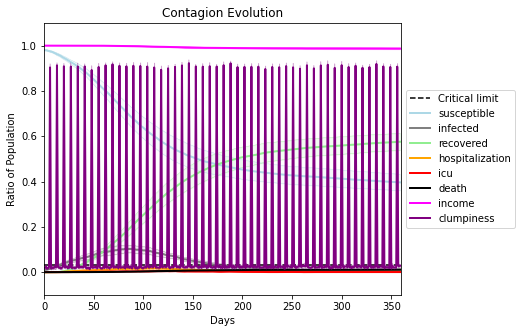

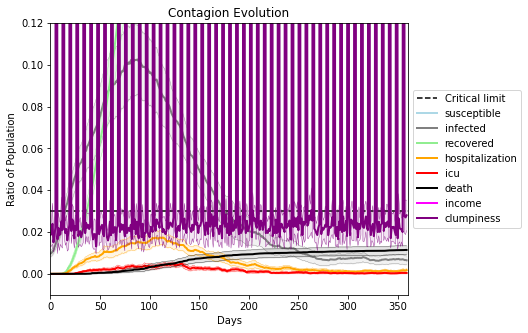

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5355, 8506, 3530, 6791, 6576, 4646, 9242, 3564, 2335, 37, 4164, 6029, 4548, 2964, 1631, 2586, 3047, 1844, 3141, 6882]
Average similarity between family members is 0.15961325404583074 at temperature -0.1
Average similarity between family and home is 0.999858400240347 at temperature -1
Average similarity between students and their classroom is 0.14710149350510915 at temperature -0.1
Average classroom occupancy is 4.285714285714286 and number classrooms is 70
Average similarity between workers is 0.14461906097201582 at temperature -0.1
Average office occupancy is 3.1492537313432836 and number offices is 201
Average friend similarity for adults: 0.20799118669394862 for kids: 0.19172095337774517
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.06414598035395482
avg restaurant similarity 0.07720099566922543
avg restaurant similarity 0.0752668678934749
avg restaurant similarity 0.046189157647383024
avg restaurant similarity 0.05732264749972954
avg restaurant similarity 0.07042678131536928
avg restaurant similarity 0.10055628691195191
avg restaurant similarity 0.09963148925695299
avg restaurant similarity 0.0409626403744054
avg restaurant similarity 0.0368524339057611
avg restaurant similarity 0.04898462839664208
avg restaurant similarity 0.07550797320562101
avg restaurant similarity 0.08082648604118875
avg restaurant similarity 0.055791888252614504
avg restaurant similarity 0.03083658203455105
avg restaurant similarity 0.08588856493046348
avg restaurant similarity 0.07009820283716983
avg restaurant similarity 0.024351753000978853
avg restaurant similarity 0.06228463172502079
avg restaurant similarity 0.07302631634068217
avg restaurant similarity 0.0808889527673418
avg restaurant similarity 0.0856457

avg restaurant similarity 0.10834728651817828
avg restaurant similarity 0.04618758820027689
avg restaurant similarity 0.10163625837070166
avg restaurant similarity 0.10250099386952054
avg restaurant similarity 0.030931692211808443
avg restaurant similarity 0.02963924426997681
avg restaurant similarity 0.052387043304724934
avg restaurant similarity 0.02701295451811649
avg restaurant similarity 0.10324031552065764
avg restaurant similarity 0.08075189180049275
avg restaurant similarity 0.10992772260043741
avg restaurant similarity 0.08854648875085615
avg restaurant similarity 0.09870122368079493
avg restaurant similarity 0.06582762535849772
avg restaurant similarity 0.09799837432234283
avg restaurant similarity 0.06525399054772006
avg restaurant similarity 0.10582357572104549
avg restaurant similarity 0.028261697723303666
avg restaurant similarity 0.040648951440266944
avg restaurant similarity -0.03162124159516808
avg restaurant similarity 0.0632094485637407
avg restaurant similarity 0.07

avg restaurant similarity 0.04581411174841201
avg restaurant similarity 0.05818616785236257
avg restaurant similarity 0.023150435203386308
avg restaurant similarity 0.03925403969908821
avg restaurant similarity 0.0466582315504265
avg restaurant similarity 0.06079164967600453
avg restaurant similarity 0.04414167957156464
avg restaurant similarity 0.07616510379612895
avg restaurant similarity 0.061993298780586376
avg restaurant similarity 0.05123311402971149
avg restaurant similarity 0.022276899006402034
avg restaurant similarity -0.0011340516309277671
avg restaurant similarity 0.07331778061565343
avg restaurant similarity 0.0904914992267967
avg restaurant similarity 0.08135954477912961
avg restaurant similarity 0.05682676993332435
avg restaurant similarity 0.04528900531194828
avg restaurant similarity 0.08227559779417626
avg restaurant similarity 0.09483888104270323
avg restaurant similarity 0.08202015252800222
avg restaurant similarity 0.05867810971615147
avg restaurant similarity 0.01

avg restaurant similarity 0.041449510784560724
avg restaurant similarity 0.07162236751055541
avg restaurant similarity 0.04246965906302866
avg restaurant similarity 0.07121687777344089
avg restaurant similarity 0.09101113461844125
avg restaurant similarity 0.08262250672931792
avg restaurant similarity 0.025434524501374026
avg restaurant similarity 0.058572083444665246
avg restaurant similarity 0.07226818392246283
avg restaurant similarity 0.052319861032415094
avg restaurant similarity 0.06062683614958402
avg restaurant similarity 0.06402432230051408
avg restaurant similarity 0.04693653729171568
avg restaurant similarity 0.061939866705421995
avg restaurant similarity 0.08337143350979088
avg restaurant similarity 0.07920313242200556
avg restaurant similarity 0.11649901764291491
avg restaurant similarity 0.06113077642468448
avg restaurant similarity 0.10504220190919226
avg restaurant similarity 0.08524231915765819
avg restaurant similarity 0.06043827173366199
avg restaurant similarity 0.1

avg restaurant similarity 0.008693761571233537
avg restaurant similarity 0.06796629045779005
avg restaurant similarity 0.05372828809405141
avg restaurant similarity 0.1055079425770213
avg restaurant similarity 0.06234688549550901
avg restaurant similarity 0.034991940305174773
avg restaurant similarity 0.06544481627392028
avg restaurant similarity 0.05014857645850893
avg restaurant similarity 0.03300661955742448
avg restaurant similarity 0.11503638067187752
avg restaurant similarity 0.05920861411893284
avg restaurant similarity 0.06391588686485165
avg restaurant similarity 0.09384371299575572
avg restaurant similarity 0.09457169200627623
avg restaurant similarity 0.06318245153100764
avg restaurant similarity 0.11573695485066585
avg restaurant similarity 0.027455151084589655
avg restaurant similarity 0.03247782650699516
avg restaurant similarity 0.06406949169250477
avg restaurant similarity 0.04710071791230227
avg restaurant similarity 0.05259098137106672
avg restaurant similarity 0.0897

avg restaurant similarity 0.0630886446823401
avg restaurant similarity 0.04298047461801889
avg restaurant similarity 0.05298097959078038
avg restaurant similarity 0.06690368610085749
avg restaurant similarity 0.08867057727623012
avg restaurant similarity 0.09642058312245391
avg restaurant similarity 0.03901503787035061
avg restaurant similarity 0.057535373276050704
avg restaurant similarity 0.026587479448398895
avg restaurant similarity 0.07303309288409726
avg restaurant similarity 0.03670909917258444
avg restaurant similarity 0.0833286562251576
avg restaurant similarity 0.030738085213450922
avg restaurant similarity 0.06638476751959291
avg restaurant similarity 0.042074852682446165
avg restaurant similarity 0.04272066125033819
avg restaurant similarity 0.1010752818253527
avg restaurant similarity 0.07991560991724418
avg restaurant similarity 0.06999066659655087
avg restaurant similarity 0.06476389473489125
avg restaurant similarity 0.052291734250983
avg restaurant similarity 0.0428774

avg restaurant similarity 0.06524172293263474
avg restaurant similarity 0.056960124972781453
avg restaurant similarity 0.012854645834103576
avg restaurant similarity 0.0663870846360556
avg restaurant similarity 0.06022879554069983
avg restaurant similarity 0.048022652155465306
avg restaurant similarity 0.05213606039998388
avg restaurant similarity 0.0868148501298881
avg restaurant similarity 0.07006811682005028
avg restaurant similarity 0.07671468014761137
avg restaurant similarity 0.041862620713299804
avg restaurant similarity 0.01727639713382164
avg restaurant similarity 0.05686249714631158
avg restaurant similarity 0.037477517823263536
avg restaurant similarity 0.07372845176507845
avg restaurant similarity 0.0818610732128527
avg restaurant similarity 0.09240517088090316
avg restaurant similarity 0.0355772726658609
avg restaurant similarity 0.06484846958928894
avg restaurant similarity 0.07755185963911397
avg restaurant similarity 0.10595289598262453
avg restaurant similarity 0.04296

avg restaurant similarity 0.11131558436079322
avg restaurant similarity -0.02548203177124848
avg restaurant similarity 0.03872470449634267
avg restaurant similarity 0.07301080940154821
avg restaurant similarity 0.05657502378785497
avg restaurant similarity 0.09135821067087219
avg restaurant similarity 0.04011151265708252
avg restaurant similarity 0.06277206290158989
avg restaurant similarity 0.024147625160297
avg restaurant similarity 0.0362075978634474
avg restaurant similarity 0.020559208869506018
avg restaurant similarity 0.052886144374726884
avg restaurant similarity 0.013025329600880887
avg restaurant similarity 0.11102707579260325
avg restaurant similarity 0.09140532065465028
avg restaurant similarity 0.04834320843648532
avg restaurant similarity 0.06883128246439707
avg restaurant similarity 0.024010370897775128
avg restaurant similarity 0.11073960856184228
avg restaurant similarity 0.0013868087874202115
avg restaurant similarity 0.03931240375582735
avg restaurant similarity -0.0

avg restaurant similarity 0.06077143842171485
avg restaurant similarity 0.04947187987826489
avg restaurant similarity 0.06383216080822528
avg restaurant similarity 0.05650007254120831
avg restaurant similarity 0.0420618829470565
avg restaurant similarity 0.043715467263757544
avg restaurant similarity 0.08356641873095735
avg restaurant similarity 0.06675865075967148
avg restaurant similarity 0.023585799635994987
avg restaurant similarity 0.08880767677775016
avg restaurant similarity 0.0874192302962612
avg restaurant similarity 0.09943984012137017
avg restaurant similarity 0.048611337608785485
avg restaurant similarity 0.06955855779233877
avg restaurant similarity 0.05654973658933105
avg restaurant similarity 0.07636122807569652
avg restaurant similarity 0.06200636774988576
avg restaurant similarity 0.07174669153276288
avg restaurant similarity 0.06177024894476483
avg restaurant similarity 0.02702416768902139
avg restaurant similarity 0.011008926355725175
avg restaurant similarity 0.0613

avg restaurant similarity 0.05905910491138549
avg restaurant similarity 0.08204781049621356
avg restaurant similarity 0.06455629615159911
avg restaurant similarity 0.04354238259787467
avg restaurant similarity 0.01639310605157067
avg restaurant similarity 0.04529161011994351
avg restaurant similarity 0.08519920069539491
avg restaurant similarity 0.07837726717334918
avg restaurant similarity 0.0054153088901639605
avg restaurant similarity 0.03294765720268127
avg restaurant similarity 0.013913875774582952
avg restaurant similarity 0.048356139957970855
avg restaurant similarity 0.03282224606774268
avg restaurant similarity 0.062015397604752
avg restaurant similarity 0.030196868849381484
avg restaurant similarity 0.0565981314722368
avg restaurant similarity 0.03147204470952873
avg restaurant similarity 0.061065019105098206
avg restaurant similarity 0.04352328111186275
avg restaurant similarity 0.0503321195042812
avg restaurant similarity 0.05109007063873517
avg restaurant similarity 0.0357

avg restaurant similarity 0.05552939536938144
avg restaurant similarity 0.058481430644916704
avg restaurant similarity 0.06324801351251419
avg restaurant similarity 0.03404732278484932
avg restaurant similarity 0.06680381577946094
avg restaurant similarity 0.03660751350481556
avg restaurant similarity 0.10480914251949475
avg restaurant similarity 0.04658529621095774
avg restaurant similarity 0.04067667392304587
avg restaurant similarity 0.022079024089499855
avg restaurant similarity 0.07803122476382958
avg restaurant similarity 0.04222740855543062
avg restaurant similarity 0.043983411561144097
avg restaurant similarity 0.035327633928977746
avg restaurant similarity 0.05771274372523908
avg restaurant similarity 0.08261119232658098
avg restaurant similarity 0.05078456154402833
avg restaurant similarity 0.05049992172108434
avg restaurant similarity 0.07021221628329234
avg restaurant similarity 0.015884715601791
avg restaurant similarity 0.05757837942398556
avg restaurant similarity 0.0632

avg restaurant similarity 0.03313141520389505
avg restaurant similarity 0.07265411449365446
avg restaurant similarity 0.049544251144378035
avg restaurant similarity 0.0506451596729253
avg restaurant similarity 0.07149858322770994
avg restaurant similarity 0.08302490252621349
avg restaurant similarity 0.0636529502077986
avg restaurant similarity 0.045102707779060794
avg restaurant similarity 0.03064258373514062
avg restaurant similarity 0.07002918532199778
avg restaurant similarity 0.05204616656373375
avg restaurant similarity 0.07566541663501598
avg restaurant similarity 0.07093759398106941
avg restaurant similarity 0.04891873295885027
avg restaurant similarity 0.06627141537019876
avg restaurant similarity 0.06265629382588878
avg restaurant similarity 0.026454767048107414
avg restaurant similarity 0.015570728068298406
avg restaurant similarity 0.038034995205378036
avg restaurant similarity 0.07166296786049113
avg restaurant similarity 0.05365911001026531
avg restaurant similarity 0.051

avg restaurant similarity 0.07194738330177378
avg restaurant similarity 0.0716543773725204
avg restaurant similarity 0.023981974073451224
avg restaurant similarity 0.07724888727282037
avg restaurant similarity 0.049247669432162314
avg restaurant similarity 0.058799671972109585
avg restaurant similarity 0.01497682423250116
avg restaurant similarity 0.08690472782178656
avg restaurant similarity 0.07747464902930515
avg restaurant similarity 0.08173434257674267
avg restaurant similarity 0.0930811028008363
avg restaurant similarity 0.08136531106692066
avg restaurant similarity 0.04791607073046923
avg restaurant similarity 0.09010242339754032
avg restaurant similarity 0.04935923293859952
avg restaurant similarity 0.10732829594027
avg restaurant similarity 0.07212791259105729
avg restaurant similarity 0.0908150129171973
avg restaurant similarity 0.05325140803362551
avg restaurant similarity 0.06893633850600245
avg restaurant similarity 0.11617654944858112
avg restaurant similarity 0.013445458

avg restaurant similarity 0.0568653658735865
avg restaurant similarity 0.05868698694136908
avg restaurant similarity 0.02874539395034633
avg restaurant similarity 0.03952688598303205
avg restaurant similarity 0.017068071526944888
avg restaurant similarity 0.036673067388312774
avg restaurant similarity 0.0480184818465234
avg restaurant similarity 0.11220266012744531
avg restaurant similarity 0.020623173414839324
avg restaurant similarity 0.07606455218222787
avg restaurant similarity 0.11856716866783765
avg restaurant similarity 0.07129575655124878
avg restaurant similarity 0.05870022644809597
avg restaurant similarity 0.0701848353750901
avg restaurant similarity 0.0846148746174259
avg restaurant similarity 0.03201078749324962
avg restaurant similarity 0.04315400853782544
avg restaurant similarity 0.10047969691234879
avg restaurant similarity 0.06765884558344623
avg restaurant similarity 0.028043956508476763
avg restaurant similarity 0.07243905239370144
avg restaurant similarity 0.072882

avg restaurant similarity 0.05054846683695136
avg restaurant similarity 0.1035059608445223
avg restaurant similarity 0.045452974508974515
avg restaurant similarity 0.0500825891956824
avg restaurant similarity 0.08119095373298804
avg restaurant similarity 0.06938508632687553
avg restaurant similarity 0.05294439684757794
avg restaurant similarity 0.05304172727578482
avg restaurant similarity 0.05038386754149749
avg restaurant similarity 0.06613360210624888
avg restaurant similarity 0.037496679421349384
avg restaurant similarity 0.07847484301496878
avg restaurant similarity 0.0881618594577314
avg restaurant similarity 0.07806103146169355
avg restaurant similarity 0.08286829690930679
avg restaurant similarity 0.07202921215091011
avg restaurant similarity 0.08815521299347154
avg restaurant similarity 0.05728654504176956
avg restaurant similarity 0.11443295433461396
avg restaurant similarity 0.04088169154656198
avg restaurant similarity 0.0469602054537275
avg restaurant similarity 0.11364821

avg restaurant similarity 0.09326685123295125
avg restaurant similarity 0.13677681888306695
avg restaurant similarity 0.09569224338170096
avg restaurant similarity 0.05908464004590958
avg restaurant similarity 0.10866178352703833
avg restaurant similarity 0.06891077860921847
avg restaurant similarity 0.045435099050091785
avg restaurant similarity 0.05975824447008222
avg restaurant similarity 0.11837775560940317
avg restaurant similarity 0.0896721986138491
avg restaurant similarity 0.04802283300198597
avg restaurant similarity 0.0530615329181379
avg restaurant similarity 0.09478029870655154
avg restaurant similarity 0.06563015948674496
avg restaurant similarity 0.07533366626160456
avg restaurant similarity 0.020647907852816033
avg restaurant similarity 0.07581377134861018
avg restaurant similarity 0.07657694696253323
avg restaurant similarity 0.049059558802500576
avg restaurant similarity 0.09499725671845348
avg restaurant similarity 0.06505751741763831
avg restaurant similarity 0.09392

avg restaurant similarity 0.029879710340720147
avg restaurant similarity 0.058222854802518195
avg restaurant similarity 0.06293130629875646
avg restaurant similarity 0.059197504613568666
avg restaurant similarity 0.051435125306657205
avg restaurant similarity 0.04262889045603641
avg restaurant similarity 0.07943599895236787
avg restaurant similarity 0.01843702535645382
avg restaurant similarity -0.015594644928775863
avg restaurant similarity -0.04178244696822723
avg restaurant similarity 0.044940882435064514
avg restaurant similarity 0.044901847946438964
avg restaurant similarity 0.053264059761785706
avg restaurant similarity 0.04728016139334691
avg restaurant similarity 0.05070233280731334
avg restaurant similarity 0.024592403512830756
avg restaurant similarity 0.037731235411599985
avg restaurant similarity 0.025464438420459753
avg restaurant similarity 0.05097083478122648
avg restaurant similarity 0.08220345796153451
avg restaurant similarity 0.05533867216537701
avg restaurant simila

avg restaurant similarity 0.027780138741577882
avg restaurant similarity 0.04013810371056276
avg restaurant similarity 0.04235523057843816
avg restaurant similarity 0.04484859582996268
avg restaurant similarity 0.04438009333850479
avg restaurant similarity 0.06052307983364313
avg restaurant similarity 0.08526119440376739
avg restaurant similarity 0.09758591927803957
avg restaurant similarity 0.017032039627590794
avg restaurant similarity 0.02982277320898494
avg restaurant similarity 0.011043829670171583
avg restaurant similarity 0.0021653282153592454
avg restaurant similarity 0.03175328485011273
avg restaurant similarity 0.04579756621104153
avg restaurant similarity 0.025998940749879254
avg restaurant similarity 0.020861073196385572
avg restaurant similarity 0.048672417676425675
avg restaurant similarity 0.054041161851438486
avg restaurant similarity 0.029767500168377606
avg restaurant similarity 0.06284412009776412
avg restaurant similarity 0.0705135887366965
avg restaurant similarity

avg restaurant similarity 0.041311081838460745
avg restaurant similarity 0.03868621895831017
avg restaurant similarity 0.027656452007575896
avg restaurant similarity 0.0028628300261202833
avg restaurant similarity -0.022530667003235496
avg restaurant similarity 0.06306330053140105
avg restaurant similarity 0.04063416706644403
avg restaurant similarity 0.031651250833729695
avg restaurant similarity 0.08715061744727948
avg restaurant similarity 0.049030612617847906
avg restaurant similarity 0.08077821397975961
avg restaurant similarity 0.06364248250920222
avg restaurant similarity 0.07371886476650627
avg restaurant similarity 0.030220268766794966
avg restaurant similarity 0.04103927644767469
avg restaurant similarity 0.053571244688177776
avg restaurant similarity 0.03603833286304516
avg restaurant similarity -0.017451106618795526
avg restaurant similarity 0.07538388104585421
avg restaurant similarity 0.08772559994778209
avg restaurant similarity 0.06739313269074107
avg restaurant similar

avg restaurant similarity 0.054626583129095636
avg restaurant similarity 0.03466336598439305
avg restaurant similarity 0.09697765648085327
avg restaurant similarity 0.02727548489773521
avg restaurant similarity 0.05055854674939323
avg restaurant similarity 0.02186774788858758
avg restaurant similarity 0.03843766023353245
avg restaurant similarity 0.07307097993851525
avg restaurant similarity 0.05350684184981855
avg restaurant similarity 0.062023828901226215
avg restaurant similarity 0.07723061341167353
avg restaurant similarity 0.03985409038769149
avg restaurant similarity 0.05457517657366474
avg restaurant similarity 0.08080562243725864
avg restaurant similarity 0.03677315489171426
avg restaurant similarity 0.01778770026252675
avg restaurant similarity 0.03767721426555546
avg restaurant similarity 0.019333825491875557
avg restaurant similarity 0.060043222517931684
avg restaurant similarity 0.05314321949056523
avg restaurant similarity 0.05994192907627893
avg restaurant similarity 0.05

avg restaurant similarity 0.06655397972809524
avg restaurant similarity 0.14251966744407588
avg restaurant similarity 0.0951824863634972
avg restaurant similarity 0.07731125370222178
avg restaurant similarity 0.10483258801408803
avg restaurant similarity 0.0716622051298806
avg restaurant similarity 0.09807629440933795
avg restaurant similarity 0.10338240749464443
avg restaurant similarity 0.08903453044523747
avg restaurant similarity 0.07331471521662157
avg restaurant similarity 0.06567671100255085
avg restaurant similarity 0.12102674243207408
avg restaurant similarity 0.10399946083986976
avg restaurant similarity 0.07848523883779744
avg restaurant similarity 0.13016759346423193
avg restaurant similarity 0.06853470701733679
avg restaurant similarity 0.14570320294089215
avg restaurant similarity 0.16411311654267713
avg restaurant similarity 0.10911394608274996
avg restaurant similarity 0.06696421829818353
avg restaurant similarity 0.109416927193849
avg restaurant similarity 0.1110715932

avg restaurant similarity 0.07581640247769914
avg restaurant similarity 0.09215746944751434
avg restaurant similarity 0.10160516887323165
avg restaurant similarity 0.09083925974606433
avg restaurant similarity 0.07212493562096872
avg restaurant similarity 0.028363247969096714
avg restaurant similarity 0.05132793999708463
avg restaurant similarity 0.1097883854607839
avg restaurant similarity 0.08069487253395748
avg restaurant similarity 0.09195763683047099
avg restaurant similarity 0.10275071784272073
avg restaurant similarity 0.07889751515543184
avg restaurant similarity 0.10446905034383429
avg restaurant similarity 0.06993902935241847
avg restaurant similarity 0.10252060426651505
avg restaurant similarity 0.12359720476462095
avg restaurant similarity 0.08091868184358338
avg restaurant similarity 0.09748547548611045
avg restaurant similarity 0.03806861507427922
avg restaurant similarity 0.07037264380080122
avg restaurant similarity 0.0729494161659744
avg restaurant similarity 0.0637480

avg restaurant similarity 0.04378707104326576
avg restaurant similarity 0.03955239216875851
avg restaurant similarity 0.08176037546469349
avg restaurant similarity 0.05745564645608461
avg restaurant similarity 0.10557196082409624
avg restaurant similarity 0.09151305384774747
avg restaurant similarity -0.009666538867143436
avg restaurant similarity 0.045505703058111954
avg restaurant similarity 0.013939536345975695
avg restaurant similarity 0.05496819190227179
avg restaurant similarity 0.029780007235096096
avg restaurant similarity 0.09556619206997526
avg restaurant similarity 0.08267318210478332
avg restaurant similarity 0.01916822419493888
avg restaurant similarity 0.057181205511911457
avg restaurant similarity 0.1449645966888146
avg restaurant similarity 0.058113375391641194
avg restaurant similarity 0.07648501646337373
avg restaurant similarity 0.09667960938618181
avg restaurant similarity 0.06338955777028753
avg restaurant similarity 0.017364991700051326
avg restaurant similarity 0

avg restaurant similarity 0.05902271730943817
avg restaurant similarity 0.03178337177184161
avg restaurant similarity 0.0120958344033983
avg restaurant similarity -0.04349392107984361
avg restaurant similarity 0.024898189058040785
avg restaurant similarity 0.031756990680485264
avg restaurant similarity 0.10968801347233356
avg restaurant similarity 0.051897494772591334
avg restaurant similarity 0.053717968946907606
avg restaurant similarity 0.0357232743248253
avg restaurant similarity 0.08649958140382598
avg restaurant similarity 0.08692165958729985
avg restaurant similarity 0.03333247584416465
avg restaurant similarity 0.04505855646682513
avg restaurant similarity 0.07179666596742082
avg restaurant similarity 0.00457344451024477
avg restaurant similarity 0.07370667642576793
avg restaurant similarity 0.015679285758162905
avg restaurant similarity 0.08997012570697066
avg restaurant similarity 0.060160302899746804
avg restaurant similarity 0.07185350864567493
avg restaurant similarity 0.0

avg restaurant similarity 0.08192675908131623
avg restaurant similarity 0.06951567953948445
avg restaurant similarity 0.02041569636120784
avg restaurant similarity 0.08734354787584436
avg restaurant similarity 0.05642146455564672
avg restaurant similarity 0.07926632619526168
avg restaurant similarity 0.043782991241721005
avg restaurant similarity -0.024604550614931397
avg restaurant similarity 0.03343566129824556
avg restaurant similarity 0.07870009346878706
avg restaurant similarity 0.0637341748953301
avg restaurant similarity 0.045077357378797464
avg restaurant similarity 0.08854633975077762
avg restaurant similarity 0.07795822603237001
avg restaurant similarity 0.0588832851214152
avg restaurant similarity 0.09103906884267092
avg restaurant similarity 0.08826642704790852
avg restaurant similarity 0.11063363256269107
avg restaurant similarity 0.10808136249432959
avg restaurant similarity 0.04546809646268221
avg restaurant similarity 0.009352188434271673
avg restaurant similarity 0.039

avg restaurant similarity 0.01428010509770063
avg restaurant similarity 0.033783083900499174
avg restaurant similarity 0.009093156170038192
avg restaurant similarity 0.08860140962787517
avg restaurant similarity 0.05758687051149195
avg restaurant similarity -0.0075484659294389345
avg restaurant similarity 0.02248467469209071
avg restaurant similarity 0.035536662839145076
avg restaurant similarity 0.04455781623561631
avg restaurant similarity 0.024974194753132582
avg restaurant similarity 0.06430349594607153
avg restaurant similarity 0.052609936806624964
avg restaurant similarity 0.07432828632809335
avg restaurant similarity 0.010001228410811344
avg restaurant similarity 0.05709450396644255
avg restaurant similarity 0.05932892820699992
avg restaurant similarity 0.03315116193836211
avg restaurant similarity 0.04084985870589548
avg restaurant similarity 0.0468768342641937
avg restaurant similarity 0.0514129469478648
avg restaurant similarity 0.07731127428488857
avg restaurant similarity 0

avg restaurant similarity 0.044563548355924486
avg restaurant similarity 0.0335427934255095
avg restaurant similarity 0.026925228365903046
avg restaurant similarity 0.03259887780716756
avg restaurant similarity 0.02728727134735272
avg restaurant similarity 0.06554313097451588
avg restaurant similarity 0.03259130349826552
avg restaurant similarity 0.04137313859893745
avg restaurant similarity 0.0664784171451154
avg restaurant similarity 0.05430395406681861
avg restaurant similarity 0.06013085448121288
avg restaurant similarity 0.012369865170909395
avg restaurant similarity 0.06030280968611248
avg restaurant similarity 0.061419970634902815
avg restaurant similarity 0.015867314957187885
avg restaurant similarity 0.025385315062294137
avg restaurant similarity 0.040409020508392145
avg restaurant similarity 0.042933688802058646
avg restaurant similarity 0.033658558707140566
avg restaurant similarity 0.05271125209141295
avg restaurant similarity 0.07029217702620438
avg restaurant similarity 0

avg restaurant similarity 0.09506174542667098
avg restaurant similarity 0.10821573984343644
avg restaurant similarity 0.05870668119081475
avg restaurant similarity 0.01641001993174164
avg restaurant similarity 0.058676203145571586
avg restaurant similarity 0.029558615025961257
avg restaurant similarity 0.05317150120393414
avg restaurant similarity 0.08403832998401141
avg restaurant similarity 0.04824450684938867
avg restaurant similarity 0.029717845512857697
avg restaurant similarity 0.038129108265446195
avg restaurant similarity 0.08980281772267401
avg restaurant similarity 0.038966451819629364
avg restaurant similarity 0.0446688290162588
avg restaurant similarity 0.0539282702130281
avg restaurant similarity 0.04740909236364773
avg restaurant similarity 0.06079572293833354
avg restaurant similarity 0.054751985156069834
avg restaurant similarity 0.08279871246406059
avg restaurant similarity 0.042801583292861524
avg restaurant similarity 0.06829632856887811
avg restaurant similarity 0.0

avg restaurant similarity 0.07282080103051887
avg restaurant similarity 0.0345695198297408
avg restaurant similarity 0.004841936347387815
avg restaurant similarity 0.05031830753647723
avg restaurant similarity 0.05915120410272282
avg restaurant similarity 0.04559173826376418
avg restaurant similarity 0.08052646222905989
avg restaurant similarity 0.07684701737571248
avg restaurant similarity 0.010455412221328462
avg restaurant similarity 0.07996539369501139
avg restaurant similarity 0.06302664914573464
avg restaurant similarity 0.05127702455965724
avg restaurant similarity 0.028655055852847854
avg restaurant similarity 0.048686015665716405
avg restaurant similarity 0.0185549660927452
avg restaurant similarity 0.05952647885053508
avg restaurant similarity 0.051727129735587914
avg restaurant similarity 0.1109461037548918
avg restaurant similarity 0.09184435550021017
avg restaurant similarity 0.04106442858373567
avg restaurant similarity 0.040432504442098095
avg restaurant similarity -0.00

avg restaurant similarity 0.055923531747570664
avg restaurant similarity 0.045998544220373416
avg restaurant similarity 0.03126444105883818
avg restaurant similarity 0.030645577062571948
avg restaurant similarity 0.013508230249122182
avg restaurant similarity 0.04910967736523901
avg restaurant similarity 0.0540567232428395
avg restaurant similarity 0.026025512329105417
avg restaurant similarity 0.024631822971139607
avg restaurant similarity 0.05021059981442539
avg restaurant similarity 0.05287183312336783
avg restaurant similarity 0.04958290396480473
avg restaurant similarity 0.034172092631642795
avg restaurant similarity 0.0596154953969239
avg restaurant similarity 0.04438467626053681
avg restaurant similarity 0.06843061146268373
avg restaurant similarity -0.007166065127881897
avg restaurant similarity 0.053532634431468606
avg restaurant similarity 0.046120314546002725
avg restaurant similarity 0.035171716736771975
avg restaurant similarity 0.04736945530841223
avg restaurant similarit

avg restaurant similarity 0.010589448912907915
avg restaurant similarity 0.0260814440670309
avg restaurant similarity 0.10103802482046348
avg restaurant similarity 0.05447999222921893
avg restaurant similarity 0.0064554748833658875
avg restaurant similarity 0.04877744599057955
avg restaurant similarity 0.08753225738717106
avg restaurant similarity 0.0312983789613762
avg restaurant similarity 0.029393239765777096
avg restaurant similarity 0.013743147997017938
avg restaurant similarity 0.021894969900322844
avg restaurant similarity 0.047740187286675305
avg restaurant similarity 0.011182490455273877
avg restaurant similarity 0.018368457079756297
avg restaurant similarity 0.032918389501419766
avg restaurant similarity 0.08007441934541829
avg restaurant similarity 0.04310583744564434
avg restaurant similarity 0.07572140609549603
avg restaurant similarity 0.06683860178106323
avg restaurant similarity 0.014436114368865159
avg restaurant similarity 0.0422243399881061
avg restaurant similarity 

avg restaurant similarity 0.06335100539365023
avg restaurant similarity 0.029321285137782472
avg restaurant similarity 0.015604108984669214
avg restaurant similarity 0.044839161269623215
avg restaurant similarity 0.02594722062191233
avg restaurant similarity 0.05585668865394467
avg restaurant similarity 0.05694081259131707
avg restaurant similarity 0.07110063041416785
avg restaurant similarity 0.05032973713344424
avg restaurant similarity 0.0328992359747414
avg restaurant similarity 0.021186184095475128
avg restaurant similarity 0.02669845659912919
avg restaurant similarity 0.006072768217317871
avg restaurant similarity 0.033172708214010055
avg restaurant similarity 0.013956639028321888
avg restaurant similarity 0.06613694952454918
avg restaurant similarity 0.01402315823170743
avg restaurant similarity 0.0707538497898726
avg restaurant similarity 0.007517415213269147
avg restaurant similarity 0.043984380732267035
avg restaurant similarity 0.051774394233426245
avg restaurant similarity 

avg restaurant similarity 0.05459751601070311
avg restaurant similarity 0.08174741991817872
avg restaurant similarity 0.0653820663408565
avg restaurant similarity 0.028106021046980408
avg restaurant similarity 0.036726717382040856
avg restaurant similarity 0.05400751844226208
avg restaurant similarity 0.0528177182752917
avg restaurant similarity 0.061237535869567206
avg restaurant similarity 0.05629542740511098
avg restaurant similarity 0.08345551343225613
avg restaurant similarity 0.06286515302870836
avg restaurant similarity 0.026061060094389677
avg restaurant similarity 0.08961574665155174
avg restaurant similarity 0.061583989418189135
avg restaurant similarity 0.063301644147583
avg restaurant similarity 0.043642726142100796
avg restaurant similarity 0.07255465254209853
avg restaurant similarity 0.03956946621342706
avg restaurant similarity 0.059357330531890115
avg restaurant similarity 0.07257563397332205
avg restaurant similarity 0.08156542631714342
avg restaurant similarity 0.061

avg restaurant similarity 0.059045651221009236
avg restaurant similarity 0.07194724172140275
avg restaurant similarity 0.045692888608658784
avg restaurant similarity -0.020234857763926476
avg restaurant similarity 0.0741890199181614
avg restaurant similarity 0.04567736362687216
avg restaurant similarity 0.07041079211976023
avg restaurant similarity 0.054808538913703055
avg restaurant similarity 0.08386238861951743
avg restaurant similarity 0.04850750841389691
avg restaurant similarity 0.0806020745154812
avg restaurant similarity 0.06776643730208834
avg restaurant similarity 0.0682400724500553
avg restaurant similarity 0.07169563554013418
avg restaurant similarity 0.03429890392081894
avg restaurant similarity 0.07868528095126971
avg restaurant similarity 0.06713987778383743
avg restaurant similarity 0.007480259643398805
avg restaurant similarity 0.11522866653871724
avg restaurant similarity 0.0370869433876267
avg restaurant similarity 0.0429159312161795
avg restaurant similarity 0.08360

avg restaurant similarity 0.0557577913035316
avg restaurant similarity 0.08832638053661564
avg restaurant similarity 0.037229815184901316
avg restaurant similarity 0.07279431049779123
avg restaurant similarity 0.0695072130023211
avg restaurant similarity 0.07470417677108501
avg restaurant similarity 0.02920567384965248
avg restaurant similarity 0.05386463929481
avg restaurant similarity 0.06933578841949971
avg restaurant similarity 0.0769268902368904
avg restaurant similarity 0.059411153201254945
avg restaurant similarity 0.033221908672388306
avg restaurant similarity 0.05648208579395969
avg restaurant similarity 0.0966412736114122
avg restaurant similarity 0.060754882045414925
avg restaurant similarity 0.0089512494789005
avg restaurant similarity 0.0360304087694319
avg restaurant similarity 0.08552099660333064
avg restaurant similarity 0.0247865337647025
avg restaurant similarity 0.07666758076857134
avg restaurant similarity 0.08417914857150842
avg restaurant similarity 0.001912945314

avg restaurant similarity 0.020043202908856955
avg restaurant similarity 0.03869167561388949
avg restaurant similarity 0.014705730980309624
avg restaurant similarity 0.03728025793949805
avg restaurant similarity 0.012997901644893365
avg restaurant similarity 0.06892301617127397
avg restaurant similarity 0.024328359467224947
avg restaurant similarity 0.04590859648238386
avg restaurant similarity 0.08226796402142314
avg restaurant similarity 0.07449346912237925
avg restaurant similarity 0.07112390828092469
avg restaurant similarity 0.08282283786322105
avg restaurant similarity 0.08806502231552782
avg restaurant similarity 0.06850345821240003
avg restaurant similarity 0.03956852852423876
avg restaurant similarity -0.003433938427066697
avg restaurant similarity 0.03372933896760126
avg restaurant similarity 0.022804674841844695
avg restaurant similarity 0.08570610771280472
avg restaurant similarity 0.08192408518492811
avg restaurant similarity 0.02794075266075044
avg restaurant similarity 0

avg restaurant similarity 0.07665776620333407
avg restaurant similarity 0.033286468157448096
avg restaurant similarity 0.06764813595454726
avg restaurant similarity 0.09690944607735573
avg restaurant similarity 0.07281149619212185
avg restaurant similarity 0.0793902750588093
avg restaurant similarity 0.0993977507279623
avg restaurant similarity 0.08176242004893358
avg restaurant similarity 0.0765737941705461
avg restaurant similarity 0.07525468159347394
avg restaurant similarity 0.10625725511050822
avg restaurant similarity 0.04098693885469954
avg restaurant similarity 0.1046952106831066
avg restaurant similarity 0.004751640576767801
avg restaurant similarity 0.04795066583352913
avg restaurant similarity 0.05642682805808291
avg restaurant similarity 0.07269630036084143
avg restaurant similarity 0.05468660976335178
avg restaurant similarity 0.10006381618131545
avg restaurant similarity 0.03319921481516545
avg restaurant similarity 0.046940878067015836
avg restaurant similarity 0.0646583

avg restaurant similarity 0.09386588710606933
avg restaurant similarity 0.061706290801184345
avg restaurant similarity 0.09517136171464831
avg restaurant similarity 0.015295330228822734
avg restaurant similarity 0.07103115268548621
avg restaurant similarity 0.03349836673677859
avg restaurant similarity 0.007160594313917443
avg restaurant similarity 0.02203838179763608
avg restaurant similarity 0.057312454565321864
avg restaurant similarity 0.12466634813419938
avg restaurant similarity 0.06215869553248559
avg restaurant similarity 0.027135790302330907
avg restaurant similarity 0.0654184305844386
avg restaurant similarity 0.07372651799677336
avg restaurant similarity 0.0765758835031762
avg restaurant similarity 0.08722540702335295
avg restaurant similarity 0.060303086332388976
avg restaurant similarity 0.06348749830479386
avg restaurant similarity 0.0636703453460603
avg restaurant similarity 0.0382798360645112
avg restaurant similarity 0.06697361521386891
avg restaurant similarity 0.0810

avg restaurant similarity 0.059557776541920876
avg restaurant similarity 0.06263954685321974
avg restaurant similarity 0.04888728539537092
avg restaurant similarity 0.052563390072729796
avg restaurant similarity 0.05689455653330216
avg restaurant similarity 0.08820148187221434
avg restaurant similarity 0.09335570728171666
avg restaurant similarity 0.11633022137285613
avg restaurant similarity 0.04895262214295287
avg restaurant similarity 0.031018272730588728
avg restaurant similarity 0.06913129482185092
avg restaurant similarity 0.03973580338268253
avg restaurant similarity 0.04432940230456362
avg restaurant similarity 0.07420513288790917
avg restaurant similarity 0.05826072895697551
avg restaurant similarity 0.06970993929278205
avg restaurant similarity 0.07222078525806963
avg restaurant similarity 0.014486950687956359
avg restaurant similarity 0.044422235039918205
avg restaurant similarity 0.05373476783562496
avg restaurant similarity 0.0280914616126128
avg restaurant similarity 0.06

avg restaurant similarity 0.07471202205840836
avg restaurant similarity 0.07102456963792564
avg restaurant similarity 0.044953441378074666
avg restaurant similarity 0.06483238399923835
avg restaurant similarity 0.08315956380823009
avg restaurant similarity 5.4833805224681585e-05
avg restaurant similarity 0.07582894986927939
avg restaurant similarity 0.06768499177616401
avg restaurant similarity 0.08241573793001003
avg restaurant similarity 0.0413645907188372
avg restaurant similarity 0.03291284644863598
avg restaurant similarity 0.07078609574549478
avg restaurant similarity 0.05711709814090783
avg restaurant similarity 0.0707234561029032
avg restaurant similarity 0.060255189439886434
avg restaurant similarity 0.022182048728603618
avg restaurant similarity 0.0813788935893059
avg restaurant similarity 0.0675414944099894
avg restaurant similarity 0.020927442965641536
avg restaurant similarity 0.08389645253522703
avg restaurant similarity 0.059394409621256986
avg restaurant similarity 0.08

(<function dict.items>, <function dict.items>, <function dict.items>)

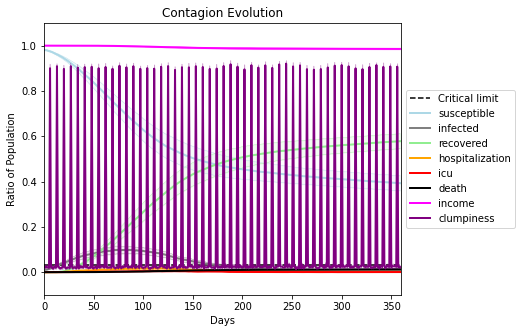

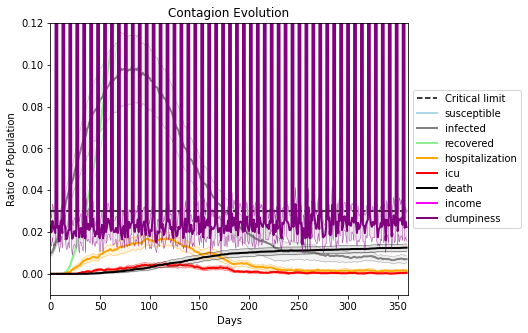

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9668, 6937, 375, 9179, 4439, 7976, 3351, 6185, 152, 2055, 8575, 9140, 7691, 9573, 5592, 7392, 7954, 3769, 4652, 4013]
Average similarity between family members is 0.1517956270889564 at temperature 0
Average similarity between family and home is 0.9998588062320308 at temperature -1
Average similarity between students and their classroom is 0.17111022648925198 at temperature 0
Average classroom occupancy is 3.9722222222222223 and number classrooms is 72
Average similarity between workers is 0.1649584788245881 at temperature 0
Average office occupancy is 3.283582089552239 and number offices is 201
Average friend similarity for adults: 0.22653962672474273 for kids: 0.2127370890295386
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneou

avg restaurant similarity 0.026302376133590554
avg restaurant similarity 0.10763308908299893
avg restaurant similarity 0.10275873407718888
avg restaurant similarity 0.11258223603624465
avg restaurant similarity 0.08439940046102984
avg restaurant similarity 0.07272587992634548
avg restaurant similarity 0.06030700185069559
avg restaurant similarity 0.0688560616788809
avg restaurant similarity 0.08645312538856033
avg restaurant similarity 0.05150395507095515
avg restaurant similarity 0.0653862831270901
avg restaurant similarity 0.09936060515461541
avg restaurant similarity 0.14259021623344334
avg restaurant similarity 0.10127855489058894
avg restaurant similarity 0.08526827958624943
avg restaurant similarity 0.09127765563457449
avg restaurant similarity 0.08007476908079968
avg restaurant similarity 0.07361948843001574
avg restaurant similarity 0.070060476585136
avg restaurant similarity 0.04125948410985736
avg restaurant similarity 0.06267534972680044
avg restaurant similarity 0.155749844

avg restaurant similarity 0.10147969798320186
avg restaurant similarity 0.031021926811770385
avg restaurant similarity 0.05738090935405004
avg restaurant similarity 0.0944169573136767
avg restaurant similarity 0.028181185416679688
avg restaurant similarity 0.07419265415943029
avg restaurant similarity 0.07846417673386703
avg restaurant similarity 0.07961908199294246
avg restaurant similarity 0.023572179593880978
avg restaurant similarity 0.15239368970022255
avg restaurant similarity 0.06196213324174449
avg restaurant similarity 0.0464799167873693
avg restaurant similarity 0.07148982179242695
avg restaurant similarity 0.09853386117490494
avg restaurant similarity 0.016490018052558078
avg restaurant similarity 0.07386152420799964
avg restaurant similarity 0.12022841021885336
avg restaurant similarity 0.04283768810156523
avg restaurant similarity 0.060253316724222614
avg restaurant similarity 0.031830643212915725
avg restaurant similarity 0.05353617462226222
avg restaurant similarity 0.04

avg restaurant similarity 0.010882193602380373
avg restaurant similarity 0.025404236476357995
avg restaurant similarity 0.041664832570227704
avg restaurant similarity 0.05127006040969404
avg restaurant similarity 0.025852839831246435
avg restaurant similarity 0.04986638150918771
avg restaurant similarity 0.09220079752177988
avg restaurant similarity 0.057969768288179624
avg restaurant similarity 0.025716558889628545
avg restaurant similarity 0.06716125272585054
avg restaurant similarity 0.02357706661885135
avg restaurant similarity 0.06790783100896862
avg restaurant similarity 0.0309559392590267
avg restaurant similarity 0.06831237998808122
avg restaurant similarity 0.053326169359057464
avg restaurant similarity 0.08531064311375584
avg restaurant similarity 0.0781773915112114
avg restaurant similarity 0.11859313453450096
avg restaurant similarity 0.03478390494425312
avg restaurant similarity 0.08645876463267002
avg restaurant similarity 0.07857566630464774
avg restaurant similarity 0.0

avg restaurant similarity 0.014578574049920317
avg restaurant similarity 0.04807926397673326
avg restaurant similarity 0.026390312377443076
avg restaurant similarity 0.03381697371964618
avg restaurant similarity 0.05818499187786987
avg restaurant similarity 0.025889094997386498
avg restaurant similarity 0.01928270287605645
avg restaurant similarity 0.06738938273793053
avg restaurant similarity 0.04827902970663172
avg restaurant similarity 0.07739197945067292
avg restaurant similarity 0.059321159014110426
avg restaurant similarity 0.08189967388086748
avg restaurant similarity 0.07842204553964581
avg restaurant similarity 0.06509802773655482
avg restaurant similarity 0.05539100499592967
avg restaurant similarity 0.06915641961261507
avg restaurant similarity 0.08385655032219608
avg restaurant similarity 0.029031024893781336
avg restaurant similarity 0.012784960567865955
avg restaurant similarity 0.018767203493540642
avg restaurant similarity 0.0485759745414461
avg restaurant similarity 0.

avg restaurant similarity 0.058350693468511246
avg restaurant similarity 0.07778040238116699
avg restaurant similarity 0.061537053304451916
avg restaurant similarity 0.06535949274846792
avg restaurant similarity 0.05087765022752249
avg restaurant similarity 0.05500322509687853
avg restaurant similarity 0.07271626839124083
avg restaurant similarity 0.07003169983362019
avg restaurant similarity 0.016181278808252292
avg restaurant similarity 0.08027724218044822
avg restaurant similarity 0.07733161282553616
avg restaurant similarity -1.57746778605932e-05
avg restaurant similarity 0.10428328960495811
avg restaurant similarity 0.12002946981062346
avg restaurant similarity 0.08355011220405131
avg restaurant similarity 0.05390706891978885
avg restaurant similarity 0.07864916943128368
avg restaurant similarity 0.08722285928628672
avg restaurant similarity 0.03910785948598129
avg restaurant similarity 0.06235995093123511
avg restaurant similarity 0.0937087184551418
avg restaurant similarity 0.07

avg restaurant similarity 0.06341554147870072
avg restaurant similarity 0.09479179908449772
avg restaurant similarity 0.07670636051748879
avg restaurant similarity 0.039875233191186465
avg restaurant similarity 0.0833355778956192
avg restaurant similarity 0.019451496856976506
avg restaurant similarity 0.08320474628922028
avg restaurant similarity 0.09655568235669129
avg restaurant similarity 0.01817138749064536
avg restaurant similarity 0.04623193322724421
avg restaurant similarity 0.07830537673092856
avg restaurant similarity 0.06692993554606605
avg restaurant similarity 0.05550637706017092
avg restaurant similarity 0.05601561588872614
avg restaurant similarity 0.030599592447570254
avg restaurant similarity 0.021741849774822356
avg restaurant similarity 0.06805837400285226
avg restaurant similarity 0.11438257724382768
avg restaurant similarity 0.0340785076874058
avg restaurant similarity 0.05115817291257095
avg restaurant similarity 0.04891267572566631
avg restaurant similarity 0.0738

avg restaurant similarity 0.055286870503130275
avg restaurant similarity 0.05006854674459999
avg restaurant similarity 0.0349765593885871
avg restaurant similarity 0.041942819394476076
avg restaurant similarity 0.03149309712752197
avg restaurant similarity 0.055114463118004935
avg restaurant similarity 0.05980553020152088
avg restaurant similarity 0.09429768596523862
avg restaurant similarity 0.07289054476189591
avg restaurant similarity 0.05032932955309706
avg restaurant similarity 0.05864442712860789
avg restaurant similarity 0.07144980118734104
avg restaurant similarity 0.0664166721128435
avg restaurant similarity 0.09251638071998537
avg restaurant similarity 0.04498450361211327
avg restaurant similarity 0.0976504215148554
avg restaurant similarity 0.09106923160503785
avg restaurant similarity 0.063310047017977
avg restaurant similarity 0.08908711223400748
avg restaurant similarity 0.024255238826086975
avg restaurant similarity 0.11397874944162206
avg restaurant similarity 0.0921505

avg restaurant similarity 0.044683058907585456
avg restaurant similarity 0.03681553329747125
avg restaurant similarity 0.02030489422487025
avg restaurant similarity 0.0641867469809283
avg restaurant similarity 0.03226099202806491
avg restaurant similarity 0.07908262203415539
avg restaurant similarity 0.06711833852788025
avg restaurant similarity 0.09486764478148414
avg restaurant similarity 0.09210744523885468
avg restaurant similarity 0.03709437061651929
avg restaurant similarity 0.0535351021772263
avg restaurant similarity 0.04135795788105342
avg restaurant similarity 0.04831285894635047
avg restaurant similarity 0.006371331983075723
avg restaurant similarity -0.0030293336074942987
avg restaurant similarity 0.049901696162499946
avg restaurant similarity 0.0162838396788892
avg restaurant similarity 0.017692315648411065
avg restaurant similarity 0.07177552502374031
avg restaurant similarity 0.051869954383068795
avg restaurant similarity 0.010786281575677646
avg restaurant similarity 0.

avg restaurant similarity 0.04181372716423269
avg restaurant similarity 0.039518719360995345
avg restaurant similarity 0.025973140323666353
avg restaurant similarity 0.03525063644512321
avg restaurant similarity 0.035560602617514224
avg restaurant similarity 0.002497515170533137
avg restaurant similarity 0.003269007638416846
avg restaurant similarity 0.07758278321587628
avg restaurant similarity -0.010169895851456756
avg restaurant similarity 0.04370909777618941
avg restaurant similarity 0.07341991331229374
avg restaurant similarity 0.005920292067256028
avg restaurant similarity 0.07050228437909474
avg restaurant similarity 0.04567493821030684
avg restaurant similarity 0.05625475661838627
avg restaurant similarity 0.02957826634001771
avg restaurant similarity 0.04359038069827788
avg restaurant similarity 0.0726768363162312
avg restaurant similarity 0.026399708013710648
avg restaurant similarity 0.01129158871002674
avg restaurant similarity 0.054520252718009456
avg restaurant similarity

avg restaurant similarity 0.000555429354539919
avg restaurant similarity -0.0026507095282838912
avg restaurant similarity 0.030646008555153623
avg restaurant similarity 0.04704694413183093
avg restaurant similarity 0.03521545552332608
avg restaurant similarity 0.02405093060581276
avg restaurant similarity 0.03085555715989486
avg restaurant similarity 0.04216180566110182
avg restaurant similarity 0.003319273513747215
avg restaurant similarity 0.07658727080740256
avg restaurant similarity 0.008364373172645094
avg restaurant similarity 0.037336067260089464
avg restaurant similarity 0.05133171897134492
avg restaurant similarity 0.054048659663842986
avg restaurant similarity 0.02214086481268727
avg restaurant similarity 0.025615017420944932
avg restaurant similarity 0.04895494609235353
avg restaurant similarity 0.0004361582353347793
avg restaurant similarity 0.013133341344760751
avg restaurant similarity 0.020026974408680627
avg restaurant similarity 0.07209272732071062
avg restaurant simil

avg restaurant similarity 0.09010736074979803
avg restaurant similarity 0.06250879560835247
avg restaurant similarity 0.06454466995878577
avg restaurant similarity 0.045220985068750295
avg restaurant similarity 0.07567957807299852
avg restaurant similarity 0.048733548523841985
avg restaurant similarity 0.06884139555448934
avg restaurant similarity 0.06374358153346675
avg restaurant similarity 0.006485821539648148
avg restaurant similarity 0.027914752693707814
avg restaurant similarity 0.041376901571253615
avg restaurant similarity 0.05671527207284859
avg restaurant similarity 0.07642225908479018
avg restaurant similarity -0.018814172962977892
avg restaurant similarity 0.005621279580504915
avg restaurant similarity 0.010808973021524412
avg restaurant similarity 0.046235289757467275
avg restaurant similarity 0.018247575145467015
avg restaurant similarity 0.0750089972483953
avg restaurant similarity 0.03969520148180822
avg restaurant similarity 0.04409342400479898
avg restaurant similarit

avg restaurant similarity 0.03963125743479879
avg restaurant similarity 0.03987095954796102
avg restaurant similarity 0.06722707047774952
avg restaurant similarity 0.06562531153734556
avg restaurant similarity 0.029588338952481655
avg restaurant similarity 0.02588848063155694
avg restaurant similarity 0.03667305173172569
avg restaurant similarity 0.08977244658604316
avg restaurant similarity 0.06769369643139245
avg restaurant similarity -0.009876220458277126
avg restaurant similarity 0.06652145056286873
avg restaurant similarity 0.02992189877382983
avg restaurant similarity 0.003976989567045723
avg restaurant similarity 0.04840306273381859
avg restaurant similarity -0.007697131280628784
avg restaurant similarity 0.014504883760473826
avg restaurant similarity 0.08237223912992277
avg restaurant similarity 0.0492173346620361
avg restaurant similarity 0.0877960960775085
avg restaurant similarity 0.06511940171188607
avg restaurant similarity 0.0015463155300310906
avg restaurant similarity 0

avg restaurant similarity 0.034280999898602775
avg restaurant similarity 0.05497572010634634
avg restaurant similarity 0.055208767527483035
avg restaurant similarity 0.08912657655312634
avg restaurant similarity 0.08457333040543247
avg restaurant similarity 0.09099835105465498
avg restaurant similarity 0.07854025261832705
avg restaurant similarity 0.06868187584912745
avg restaurant similarity 0.09944083114292786
avg restaurant similarity 0.0897357518447239
avg restaurant similarity 0.030565595577859584
avg restaurant similarity 0.07184577591526058
avg restaurant similarity 0.08895376158210909
avg restaurant similarity 0.03912920828020664
avg restaurant similarity 0.11039595836357997
avg restaurant similarity 0.04986612205364369
avg restaurant similarity 0.06640765896744523
avg restaurant similarity 0.0758517910443365
avg restaurant similarity 0.0456809027066608
avg restaurant similarity 0.07457529937480453
avg restaurant similarity 0.06176135366021387
avg restaurant similarity 0.042992

avg restaurant similarity 0.08518921182275786
avg restaurant similarity 0.0630730473000799
avg restaurant similarity 0.09228580368043916
avg restaurant similarity 0.07142155952145085
avg restaurant similarity 0.057600894588311066
avg restaurant similarity 0.06777612679321068
avg restaurant similarity 0.06946546543027082
avg restaurant similarity 0.08398912480087536
avg restaurant similarity 0.05014938732033255
avg restaurant similarity 0.08666081370858637
avg restaurant similarity 0.07055508733907463
avg restaurant similarity 0.06664442013949674
avg restaurant similarity 0.05409689907958504
avg restaurant similarity 0.06299347212023912
avg restaurant similarity 0.0498802690244792
avg restaurant similarity 0.039630235057154385
avg restaurant similarity 0.05195579568504958
avg restaurant similarity 0.04387671010665593
avg restaurant similarity 0.08756851586707043
avg restaurant similarity 0.0646885256275589
avg restaurant similarity 0.08630315390421102
avg restaurant similarity 0.0914522

avg restaurant similarity 0.04466090831488645
avg restaurant similarity 0.07020950400329401
avg restaurant similarity 0.09386246855647262
avg restaurant similarity 0.09722960098337416
avg restaurant similarity 0.06789263928549706
avg restaurant similarity 0.025589966672501876
avg restaurant similarity 0.0068265531428566666
avg restaurant similarity 0.045929322368205634
avg restaurant similarity 0.05999554998005826
avg restaurant similarity 0.10078433301919067
avg restaurant similarity 0.06896630718222893
avg restaurant similarity 0.06759010348065696
avg restaurant similarity 0.07083899221502
avg restaurant similarity 0.08980301379817363
avg restaurant similarity 0.10355049918810899
avg restaurant similarity 0.03576291837941299
avg restaurant similarity 0.03941192988054865
avg restaurant similarity 0.06572906187239039
avg restaurant similarity 0.09263030075209859
avg restaurant similarity 0.09661041568237246
avg restaurant similarity 0.0656086457363262
avg restaurant similarity 0.099345

avg restaurant similarity 0.053769262610555695
avg restaurant similarity 0.05563715978609026
avg restaurant similarity 0.029189134702869744
avg restaurant similarity 0.068325729459711
avg restaurant similarity 0.11158666393746905
avg restaurant similarity 0.10555078049725106
avg restaurant similarity 0.05574713283676571
avg restaurant similarity 0.08753335454714568
avg restaurant similarity 0.09320946434943234
avg restaurant similarity 0.08665102321704847
avg restaurant similarity 0.08222624721977646
avg restaurant similarity 0.043810116803886294
avg restaurant similarity 0.07366414814364974
avg restaurant similarity 0.08843441834186684
avg restaurant similarity 0.04728767319687957
avg restaurant similarity 0.0640063793522714
avg restaurant similarity 0.07740359547508927
avg restaurant similarity 0.06059712638718418
avg restaurant similarity 0.10850212876875417
avg restaurant similarity 0.0891054645294752
avg restaurant similarity 0.1049670411481501
avg restaurant similarity 0.10041312

avg restaurant similarity 0.03649834738085372
avg restaurant similarity 0.07918933244921277
avg restaurant similarity 0.07811591023992596
avg restaurant similarity 0.06988269872020335
avg restaurant similarity 0.059448855905726614
avg restaurant similarity 0.05140460656280693
avg restaurant similarity 0.05475743906668061
avg restaurant similarity 0.10196136346817056
avg restaurant similarity 0.06633909850468166
avg restaurant similarity 0.09439279030209295
avg restaurant similarity 0.08087445230955748
avg restaurant similarity 0.07794172808623857
avg restaurant similarity 0.07720489170011072
avg restaurant similarity 0.07718181889014528
avg restaurant similarity 0.08653292324938708
avg restaurant similarity 0.07801365639558075
avg restaurant similarity 0.09589575983346488
avg restaurant similarity 0.07961644313459307
avg restaurant similarity 0.07784201398734404
avg restaurant similarity 0.08767544851045438
avg restaurant similarity 0.08838916652312746
avg restaurant similarity 0.07370

avg restaurant similarity 0.09035386330674
avg restaurant similarity 0.06676816871777225
avg restaurant similarity 0.0827584801860068
avg restaurant similarity 0.09065917426369369
avg restaurant similarity 0.09260354475553641
avg restaurant similarity 0.04969382736752394
avg restaurant similarity 0.08636473331058482
avg restaurant similarity 0.06643674358308828
avg restaurant similarity 0.05685231694729576
avg restaurant similarity 0.08331555250854666
avg restaurant similarity 0.07951905794195036
avg restaurant similarity 0.08405651771189586
avg restaurant similarity 0.08787461883550567
avg restaurant similarity 0.06741014720268396
avg restaurant similarity 0.10995519023416427
avg restaurant similarity 0.08949547827050693
avg restaurant similarity 0.0635892367945628
avg restaurant similarity 0.07943047348352818
avg restaurant similarity 0.06710222030775381
avg restaurant similarity 0.06377974371637202
avg restaurant similarity 0.05739522997901009
avg restaurant similarity 0.03156214784

avg restaurant similarity 0.05964831640435488
avg restaurant similarity 0.07042515591462484
avg restaurant similarity 0.08601840792228993
avg restaurant similarity 0.03937794238131417
avg restaurant similarity 0.0529660062027582
avg restaurant similarity 0.041383923714342415
avg restaurant similarity 0.06081260894962102
avg restaurant similarity 0.0696786659825808
avg restaurant similarity 0.10601567574159751
avg restaurant similarity 0.0939368781855135
avg restaurant similarity 0.08673108538606597
avg restaurant similarity 0.02994934256556439
avg restaurant similarity 0.057996945663575425
avg restaurant similarity 0.10845011189481663
avg restaurant similarity 0.04286502872671512
avg restaurant similarity 0.03291122779539972
avg restaurant similarity 0.03340532247111622
avg restaurant similarity 0.02710443184192963
avg restaurant similarity 0.09264013506665138
avg restaurant similarity 0.05690722559372669
avg restaurant similarity 0.0049319396717182554
avg restaurant similarity 0.02325

avg restaurant similarity 0.07889199514994714
avg restaurant similarity 0.04890325704268025
avg restaurant similarity 0.06412682277267591
avg restaurant similarity 0.047904599892885556
avg restaurant similarity 0.05244935313252443
avg restaurant similarity 0.031063225454877177
avg restaurant similarity 0.09747670291435437
avg restaurant similarity 0.0606976311691664
avg restaurant similarity 0.10326558896575717
avg restaurant similarity 0.05099373092409533
avg restaurant similarity 0.08795447256798061
avg restaurant similarity 0.08485157879294075
avg restaurant similarity 0.08891541994511377
avg restaurant similarity 0.0718863034574262
avg restaurant similarity 0.10720986264107492
avg restaurant similarity 0.09685868409270497
avg restaurant similarity 0.06157911239037908
avg restaurant similarity 0.07864623310850896
avg restaurant similarity 0.046817453690272834
avg restaurant similarity 0.06636856341339083
avg restaurant similarity 0.07809214799434758
avg restaurant similarity 0.07909

avg restaurant similarity 0.03418983152742726
avg restaurant similarity 0.055435572644476364
avg restaurant similarity 0.06317406670391204
avg restaurant similarity 0.04884245800937525
avg restaurant similarity 0.049334022525597425
avg restaurant similarity 0.009152426331499167
avg restaurant similarity 0.0816684772966405
avg restaurant similarity 0.009276461076768003
avg restaurant similarity -0.005104985212140409
avg restaurant similarity 0.03439983912411625
avg restaurant similarity 0.038600951317158114
avg restaurant similarity 0.0282354327967568
avg restaurant similarity 0.04644834595840109
avg restaurant similarity 0.03472657949767993
avg restaurant similarity 0.04270018706471896
avg restaurant similarity 0.030455351895223748
avg restaurant similarity 0.01578643199935285
avg restaurant similarity -0.004871841366276637
avg restaurant similarity 0.021680818521317376
avg restaurant similarity 0.07753126644541924
avg restaurant similarity 0.04644554665323466
avg restaurant similarity

avg restaurant similarity 0.03646514523611097
avg restaurant similarity -0.019070957901821475
avg restaurant similarity 0.06583256373763342
avg restaurant similarity 0.09138012936023536
avg restaurant similarity 0.012384831927047334
avg restaurant similarity 0.04847697903605354
avg restaurant similarity 0.08644777488325714
avg restaurant similarity 0.07774307553098879
avg restaurant similarity 0.06613285449006506
avg restaurant similarity -0.005358321247333433
avg restaurant similarity 0.07253993029000602
avg restaurant similarity 0.05863345162393685
avg restaurant similarity 0.023820827635229525
avg restaurant similarity 0.020828791088186614
avg restaurant similarity 0.010523212918257308
avg restaurant similarity 0.047126690536752155
avg restaurant similarity 0.08490481027780107
avg restaurant similarity -0.016074942662084975
avg restaurant similarity 0.05426352840283899
avg restaurant similarity 0.057293135830115666
avg restaurant similarity 0.07037886118158082
avg restaurant similar

avg restaurant similarity 0.06175422416655647
avg restaurant similarity 0.03065986037429587
avg restaurant similarity 0.0637003980733144
avg restaurant similarity 0.07336200815365143
avg restaurant similarity 0.005962700614402468
avg restaurant similarity 0.0874665374695172
avg restaurant similarity 0.09725854421519363
avg restaurant similarity 0.04538414306619238
avg restaurant similarity 0.04220194917688099
avg restaurant similarity 0.029344794733164363
avg restaurant similarity 0.05923084792454922
avg restaurant similarity 0.018177198467698726
avg restaurant similarity 0.05825978425063657
avg restaurant similarity 0.07841036720742624
avg restaurant similarity 0.06051953215931547
avg restaurant similarity 0.07334690420972703
avg restaurant similarity 0.08736516454397387
avg restaurant similarity 0.08395054845339402
avg restaurant similarity 0.09577803814640372
avg restaurant similarity 0.05263836247272841
avg restaurant similarity 0.04890506798657488
avg restaurant similarity 0.04171

avg restaurant similarity 0.05040387117907365
avg restaurant similarity 0.048563051068991885
avg restaurant similarity 0.022891540952202978
avg restaurant similarity 0.052933373741966834
avg restaurant similarity 0.0781312028494069
avg restaurant similarity 0.04172006168671258
avg restaurant similarity 0.027338474499761126
avg restaurant similarity 0.008051264320011478
avg restaurant similarity 0.09418399744363284
avg restaurant similarity 0.07178472966469346
avg restaurant similarity 0.07090007981436962
avg restaurant similarity 0.042074905672804974
avg restaurant similarity 0.04826065775849343
avg restaurant similarity 0.09151408292857134
avg restaurant similarity 0.09889160960316078
avg restaurant similarity 0.04193570234471047
avg restaurant similarity 0.07604488846306146
avg restaurant similarity 0.044885265563653985
avg restaurant similarity 0.09608618739162468
avg restaurant similarity 0.05831382447263077
avg restaurant similarity 0.08083446243024302
avg restaurant similarity 0.

avg restaurant similarity 0.03788580296362875
avg restaurant similarity 0.05222672910674951
avg restaurant similarity 0.08098630621192525
avg restaurant similarity 0.05706273601989358
avg restaurant similarity 0.0690792742477301
avg restaurant similarity 0.041318477090243826
avg restaurant similarity 0.04867041059031257
avg restaurant similarity 0.06581759069235489
avg restaurant similarity 0.0025788491940062787
avg restaurant similarity 0.11397644015086085
avg restaurant similarity 0.0320452741448403
avg restaurant similarity 0.07406032255863408
avg restaurant similarity 0.02938610859090189
avg restaurant similarity 0.03124925919477126
avg restaurant similarity 0.013957819084042344
avg restaurant similarity 0.07175815655513793
avg restaurant similarity 0.04625638504519835
avg restaurant similarity 0.05644238069275959
avg restaurant similarity 0.06446116064582519
avg restaurant similarity 0.04993962913380767
avg restaurant similarity -0.022783686974682676
avg restaurant similarity 0.02

avg restaurant similarity 0.06658884215220254
avg restaurant similarity 0.018067040821944665
avg restaurant similarity 0.018539593693436444
avg restaurant similarity 0.09136287036966366
avg restaurant similarity 0.03372803922505611
avg restaurant similarity 0.02904892123953597
avg restaurant similarity 0.031376799642410504
avg restaurant similarity 0.09182569640340243
avg restaurant similarity 0.05215564605252537
avg restaurant similarity 0.09793532619764224
avg restaurant similarity 0.032360380087826594
avg restaurant similarity 0.059126324261509114
avg restaurant similarity 0.0620114036949343
avg restaurant similarity 0.038891968452335154
avg restaurant similarity 0.03415842154733545
avg restaurant similarity 0.06514102811169788
avg restaurant similarity 0.06765761670885378
avg restaurant similarity 0.06137195330573836
avg restaurant similarity 0.06228627340509422
avg restaurant similarity 0.05487877988942123
avg restaurant similarity 0.05401466263550499
avg restaurant similarity 0.0

avg restaurant similarity 0.06368563915482667
avg restaurant similarity 0.029651266557911317
avg restaurant similarity 0.06061892100921319
avg restaurant similarity 0.04703246173354407
avg restaurant similarity 0.06866162343298425
avg restaurant similarity -0.010398497967152004
avg restaurant similarity 0.04557311336668292
avg restaurant similarity 0.038621939623262616
avg restaurant similarity 0.04548701196099442
avg restaurant similarity 0.07733461236152013
avg restaurant similarity 0.048153677029859954
avg restaurant similarity 0.05182804387335875
avg restaurant similarity 0.04192937429124347
avg restaurant similarity 0.06284171602057183
avg restaurant similarity 0.05904664998270078
avg restaurant similarity 0.0741693764022112
avg restaurant similarity 0.05349623161522032
avg restaurant similarity 0.04299535884746737
avg restaurant similarity 0.055495230470509055
avg restaurant similarity 0.05933157122721927
avg restaurant similarity 0.030748232606622024
avg restaurant similarity 0.

avg restaurant similarity 0.05189051713260344
avg restaurant similarity 0.06576649056575386
avg restaurant similarity 0.04688236634550713
avg restaurant similarity 0.03915160795707795
avg restaurant similarity 0.07111842785557211
avg restaurant similarity 0.08080479269563902
avg restaurant similarity 0.07123856059979439
avg restaurant similarity 0.023757987755159016
avg restaurant similarity 0.022716475705503527
avg restaurant similarity 0.06129602394937309
avg restaurant similarity 0.0600065867244844
avg restaurant similarity 0.05348141638937399
avg restaurant similarity 0.013236604026903624
avg restaurant similarity 0.02999559531793514
avg restaurant similarity 0.05456942639568836
avg restaurant similarity 0.06102869721287867
avg restaurant similarity 0.07573188770415988
avg restaurant similarity 0.05144400134984491
avg restaurant similarity 0.04134249478814852
avg restaurant similarity 0.006508405508052298
avg restaurant similarity 0.05279705325305997
avg restaurant similarity 0.069

avg restaurant similarity 0.05221989084269176
avg restaurant similarity 0.05172398220848629
avg restaurant similarity 0.03379874354972443
avg restaurant similarity -0.0013331249360939784
avg restaurant similarity 0.015396372236457704
avg restaurant similarity 0.05494372568704749
avg restaurant similarity 0.034140168823189834
avg restaurant similarity 0.06200069961612677
avg restaurant similarity 0.0261302809502718
avg restaurant similarity 0.010980840826838251
avg restaurant similarity 0.013616745615081909
avg restaurant similarity 0.007887674611448361
avg restaurant similarity 0.021795741221632227
avg restaurant similarity 0.03949444646884021
avg restaurant similarity 0.03812227654388086
avg restaurant similarity 0.05720553528407638
avg restaurant similarity 0.07617184670926283
avg restaurant similarity 0.08693616210126354
avg restaurant similarity 0.09549438849743914
avg restaurant similarity 0.03890995403724391
avg restaurant similarity 0.03705624337662044
avg restaurant similarity 

avg restaurant similarity 0.055762418046351306
avg restaurant similarity 0.020350929215602023
avg restaurant similarity 0.05510426687626745
avg restaurant similarity 0.06470285638354441
avg restaurant similarity 0.01830597252028153
avg restaurant similarity 0.057110792530770046
avg restaurant similarity 0.029134366832499554
avg restaurant similarity 0.0313869152080322
avg restaurant similarity 0.014576026898197708
avg restaurant similarity 0.08877676691626693
avg restaurant similarity 0.018201259128100302
avg restaurant similarity 0.053658654864980976
avg restaurant similarity 0.04848920805106623
avg restaurant similarity -0.0064468267101488
avg restaurant similarity 0.055108268970507274
avg restaurant similarity 0.049368347703649
avg restaurant similarity 0.05675786959194066
avg restaurant similarity 0.0912425971094304
avg restaurant similarity 0.026416135878739082
avg restaurant similarity 0.022203045739782015
avg restaurant similarity 0.030021231553964144
avg restaurant similarity 0

avg restaurant similarity 0.018328430241417806
avg restaurant similarity 0.05844857745648319
avg restaurant similarity -0.005567295416357778
avg restaurant similarity 0.040949950883079296
avg restaurant similarity 0.07321531191975957
avg restaurant similarity 0.037861957721194724
avg restaurant similarity 0.08645031617379177
avg restaurant similarity 0.03344544763524213
avg restaurant similarity 0.059092780345267
avg restaurant similarity 0.0535565953158904
avg restaurant similarity 0.059849156500838
avg restaurant similarity 0.04313105987880037
avg restaurant similarity 0.03504656652180144
avg restaurant similarity 0.030327919697309476
avg restaurant similarity 0.06903726372817805
avg restaurant similarity 0.07069670865444937
avg restaurant similarity 0.022343747399127947
avg restaurant similarity 0.014706138799257407
avg restaurant similarity 0.07258527188204954
avg restaurant similarity 0.05615401301415272
avg restaurant similarity 0.002210622744632628
avg restaurant similarity 0.05

avg restaurant similarity 0.024645628066508635
avg restaurant similarity 0.05534993877320822
avg restaurant similarity 0.05512431104296818
avg restaurant similarity 0.08145323748488677
avg restaurant similarity 0.0072069361504399744
avg restaurant similarity 0.05731418869850805
avg restaurant similarity 0.03286998080466391
avg restaurant similarity 0.053650006243782376
avg restaurant similarity 0.011407666738508786
avg restaurant similarity 0.011974324613342031
avg restaurant similarity 0.03399772429388426
avg restaurant similarity 0.062339969146897586
avg restaurant similarity 0.016587872289734164
avg restaurant similarity 0.04336665331438181
avg restaurant similarity 0.05949285956216648
avg restaurant similarity 0.055539923412972335
avg restaurant similarity 0.08521964433509802
avg restaurant similarity 0.033659966765201374
avg restaurant similarity 0.01851941195708029
avg restaurant similarity 0.04321886265759994
avg restaurant similarity 0.04935173027926601
avg restaurant similarit

avg restaurant similarity 0.027462161173666365
avg restaurant similarity 0.031256113153191475
avg restaurant similarity 0.06343529615244295
avg restaurant similarity 0.04337847393547835
avg restaurant similarity 0.10000020544354041
avg restaurant similarity 0.0629514908303859
avg restaurant similarity 0.017544207257628917
avg restaurant similarity 0.012971536688775957
avg restaurant similarity 0.05530891820538977
avg restaurant similarity 0.07551034206912802
avg restaurant similarity 0.04715984939530708
avg restaurant similarity 0.048120527129151616
avg restaurant similarity 0.08480475246006583
avg restaurant similarity 0.07761775258317676
avg restaurant similarity 0.035002703891076625
avg restaurant similarity 0.07916504165407445
avg restaurant similarity 0.04796221468703636
avg restaurant similarity 0.046524971856997596
avg restaurant similarity 0.06771924332117232
avg restaurant similarity 0.05074756553041287
avg restaurant similarity 0.04622715808060998
avg restaurant similarity 0.

avg restaurant similarity 0.11607726032323461
avg restaurant similarity 0.08071080416258594
avg restaurant similarity 0.012526516427649358
avg restaurant similarity 0.07003645033533185
avg restaurant similarity 0.05039336915710555
avg restaurant similarity 0.07825038079130046
avg restaurant similarity 0.026685666596882204
avg restaurant similarity 0.050865165190780805
avg restaurant similarity 0.04063347330137174
avg restaurant similarity 0.033989631542667834
avg restaurant similarity 0.07970926050465106
avg restaurant similarity 0.005183467051117504
avg restaurant similarity 0.06222522015366232
avg restaurant similarity 0.06160866903785983
avg restaurant similarity 0.04589814022226012
avg restaurant similarity 0.07556665502166379
avg restaurant similarity 0.06517370427973908
avg restaurant similarity 0.07259306244475673
avg restaurant similarity 0.03652463711973671
avg restaurant similarity 0.06847672606341419
avg restaurant similarity 0.05409641828504249
avg restaurant similarity 0.0

avg restaurant similarity 0.052889615590516095
avg restaurant similarity 0.11898604171735264
avg restaurant similarity 0.06930995170205134
avg restaurant similarity 0.08822017506904344
avg restaurant similarity 0.0801440164854781
avg restaurant similarity 0.08553205496791741
avg restaurant similarity 0.0528861607111741
avg restaurant similarity 0.09249234010972694
avg restaurant similarity 0.04466491291269427
avg restaurant similarity 0.06659950867134586
avg restaurant similarity 0.05998045333886553
avg restaurant similarity 0.059984627109761414
avg restaurant similarity 0.06942164410764574
avg restaurant similarity 0.014029637934795674
avg restaurant similarity 0.05987035121766999
avg restaurant similarity 0.031000388292285658
avg restaurant similarity 0.07396466125814757
avg restaurant similarity 0.07935478812258108
avg restaurant similarity 0.10781491259100012
avg restaurant similarity 0.05971317308646136
avg restaurant similarity 0.08585600200761731
avg restaurant similarity 0.0132

avg restaurant similarity 0.08846373572007242
avg restaurant similarity 0.05043585745836064
avg restaurant similarity 0.06875422517324623
avg restaurant similarity 0.06143418413687533
avg restaurant similarity 0.0470593586877512
avg restaurant similarity 0.04507364128369141
avg restaurant similarity 0.08251000425385155
avg restaurant similarity 0.014857766067056377
avg restaurant similarity 0.07129968060762817
avg restaurant similarity 0.06856275981480052
avg restaurant similarity 0.04116288977032609
avg restaurant similarity 0.0742369053837967
avg restaurant similarity 0.06332325499527706
avg restaurant similarity -0.003563094556103665
avg restaurant similarity 0.0750666751967077
avg restaurant similarity 0.075831377515455
avg restaurant similarity 0.03208848492994116
avg restaurant similarity 0.050017841962273095
avg restaurant similarity 0.09213076530507465
avg restaurant similarity 0.021440588149673367
avg restaurant similarity 0.08913451433793929
avg restaurant similarity 0.058476

avg restaurant similarity 0.09300475203426102
avg restaurant similarity 0.05449769663905145
avg restaurant similarity 0.06660098649619986
avg restaurant similarity 0.05485554751196215
avg restaurant similarity 0.038196864160773544
avg restaurant similarity 0.08673865113072882
avg restaurant similarity 0.064173451774132
avg restaurant similarity 0.060662020117895364
avg restaurant similarity 0.08000627360081314
avg restaurant similarity 0.05964259203339117
avg restaurant similarity 0.037391790400069326
avg restaurant similarity 0.09239360395642983
avg restaurant similarity 0.04833685128655797
avg restaurant similarity 0.027374424408237612
avg restaurant similarity 0.04027291989009399
avg restaurant similarity 0.0751238845082822
avg restaurant similarity 0.051810785425383615
avg restaurant similarity 0.05983907145208645
avg restaurant similarity 0.12213783702925092
avg restaurant similarity 0.03389352442651946
avg restaurant similarity 0.07451323124965946
avg restaurant similarity 0.0531

avg restaurant similarity 0.012598668489555154
avg restaurant similarity 0.07852333552903398
avg restaurant similarity 0.02569950685426161
avg restaurant similarity 0.057435497774757864
avg restaurant similarity 0.07979433277759433
avg restaurant similarity 0.059313825521712674
avg restaurant similarity 0.04292059317533922
avg restaurant similarity 0.059648246693458785
avg restaurant similarity 0.03090426510114159
avg restaurant similarity 0.06385025326990218
avg restaurant similarity 0.09048933852926681
avg restaurant similarity 0.061692783604568216
avg restaurant similarity 0.0655833937680282
avg restaurant similarity 0.030136254513835822
avg restaurant similarity 0.031038857621108164
avg restaurant similarity 0.046896008998641735
avg restaurant similarity 0.029004971914118167
avg restaurant similarity -0.0034994677990586227
avg restaurant similarity 0.07276227044309186
avg restaurant similarity 0.06004151100894399
avg restaurant similarity 0.05370685917454552
avg restaurant similari

avg restaurant similarity 0.07977777124293026
avg restaurant similarity 0.0520267434077036
avg restaurant similarity 0.09570060493966129
avg restaurant similarity 0.04957712959604804
avg restaurant similarity 0.05162981722997689
avg restaurant similarity 0.0713733120769227
avg restaurant similarity 0.03721070291776737
avg restaurant similarity 0.060603227034965367
avg restaurant similarity 0.10206946715853855
avg restaurant similarity 0.0700809169585886
avg restaurant similarity 0.06136791279902026
avg restaurant similarity 0.06991550674167799
avg restaurant similarity 0.05684439105565361
avg restaurant similarity 0.05848603511161052
avg restaurant similarity 0.07856147042783809
avg restaurant similarity 0.07694017115303721
avg restaurant similarity 0.05210655787809193
avg restaurant similarity 0.040906219510927336
avg restaurant similarity 0.064002210687523
avg restaurant similarity 0.07590043809380417
avg restaurant similarity 0.08277375970714775
avg restaurant similarity 0.055335906

avg restaurant similarity 0.07196709372646361
avg restaurant similarity 0.08983549035366849
avg restaurant similarity 0.07492897029895136
avg restaurant similarity 0.08507393189540091
avg restaurant similarity 0.08564359988070532
avg restaurant similarity 0.07127028094478484
avg restaurant similarity 0.04688207456231995
avg restaurant similarity 0.12183555565098839
avg restaurant similarity 0.08039519311674409
avg restaurant similarity 0.10090521790989766
avg restaurant similarity 0.08799968223184867
avg restaurant similarity 0.08828622648698148
avg restaurant similarity 0.06601321768708107
avg restaurant similarity 0.06853125431148599
avg restaurant similarity 0.04141687092847714
avg restaurant similarity 0.08723046602440801
avg restaurant similarity 0.061199796801522065
avg restaurant similarity 0.08144870198666544
avg restaurant similarity 0.08001758651610245
avg restaurant similarity 0.04334100407469607
avg restaurant similarity 0.05398592432307598
avg restaurant similarity 0.09647

(<function dict.items>, <function dict.items>, <function dict.items>)

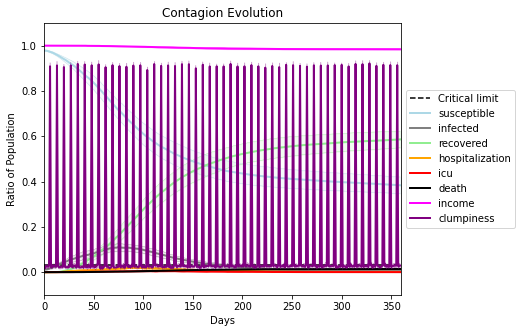

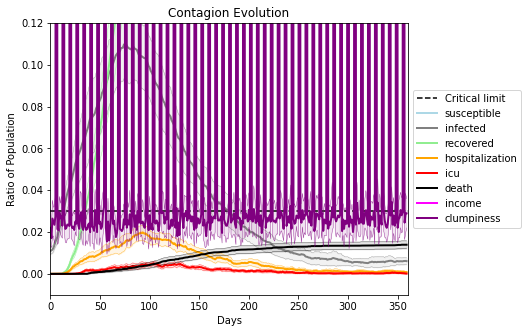

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[889, 9230, 7053, 3514, 43, 7337, 2479, 3740, 6891, 397, 4206, 9575, 6469, 1159, 6503, 7863, 9994, 5146, 883, 5451]
Average similarity between family members is 0.0871890014366512 at temperature 0.33
Average similarity between family and home is 0.9998568277596093 at temperature -1
Average similarity between students and their classroom is 0.1258605335968194 at temperature 0.33
Average classroom occupancy is 4.17910447761194 and number classrooms is 67
Average similarity between workers is 0.11650269581614979 at temperature 0.33
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.16872479276346256 for kids: 0.15695023707603864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding

avg restaurant similarity 0.022862235722000347
avg restaurant similarity 0.05261503825531415
avg restaurant similarity 0.03924371096516691
avg restaurant similarity 0.047541579629384684
avg restaurant similarity 0.06556303269165724
avg restaurant similarity 0.03943514310997447
avg restaurant similarity 0.0872925185791768
avg restaurant similarity 0.03809633361470886
avg restaurant similarity 0.03206986880917261
avg restaurant similarity 0.009566659809978404
avg restaurant similarity 0.044531055593640484
avg restaurant similarity 0.058437685030619656
avg restaurant similarity -0.019140821940856555
avg restaurant similarity 0.07333538653170438
avg restaurant similarity 0.05032801270430522
avg restaurant similarity 0.04304804689830671
avg restaurant similarity 0.024353238748968498
avg restaurant similarity -0.008776233552405296
avg restaurant similarity 0.07570711815311726
avg restaurant similarity 0.026663576039610178
avg restaurant similarity 0.0899335037094992
avg restaurant similarity

avg restaurant similarity 0.005774182028575857
avg restaurant similarity 0.07190297592152896
avg restaurant similarity 0.048433840692115836
avg restaurant similarity 0.0850444422602604
avg restaurant similarity 0.07827159762267417
avg restaurant similarity 0.05310341050756648
avg restaurant similarity 0.06547502341481165
avg restaurant similarity 0.0558423443018104
avg restaurant similarity 0.039160250823319365
avg restaurant similarity 0.046043979218858395
avg restaurant similarity 0.04841076741053197
avg restaurant similarity -0.0030228859712780848
avg restaurant similarity 0.036091905060508994
avg restaurant similarity 0.02168186616336474
avg restaurant similarity 0.055311724586449514
avg restaurant similarity 0.0008461588985568508
avg restaurant similarity 0.08111558971169779
avg restaurant similarity 0.050588393700539476
avg restaurant similarity 0.051415899373655975
avg restaurant similarity 0.07338974063207099
avg restaurant similarity 0.04543696963276311
avg restaurant similari

avg restaurant similarity 0.07437770114437958
avg restaurant similarity 0.03634096813083451
avg restaurant similarity 0.0680118702239702
avg restaurant similarity 0.05678792920871853
avg restaurant similarity 0.06296781663259507
avg restaurant similarity 0.050202368285245165
avg restaurant similarity 0.07331039633051704
avg restaurant similarity 0.06963488297807735
avg restaurant similarity 0.05877792481498999
avg restaurant similarity 0.05861508517069235
avg restaurant similarity 0.04644934438103764
avg restaurant similarity 0.12083713314821054
avg restaurant similarity 0.038876428102324015
avg restaurant similarity 0.023140279540038278
avg restaurant similarity 0.0305216017870059
avg restaurant similarity 0.07952100240524033
avg restaurant similarity 0.033285528726113366
avg restaurant similarity 0.07251023806350301
avg restaurant similarity 0.06268660254318802
avg restaurant similarity 0.035920177843092344
avg restaurant similarity 0.06255343552667487
avg restaurant similarity 0.034

avg restaurant similarity 0.05379308052206784
avg restaurant similarity 0.04997231602579233
avg restaurant similarity 0.10618984761683008
avg restaurant similarity 0.03452102631178762
avg restaurant similarity 0.03240962584777097
avg restaurant similarity 0.07207773656519
avg restaurant similarity 0.06345412457051476
avg restaurant similarity 0.07820782221224383
avg restaurant similarity 0.05020317435487165
avg restaurant similarity 0.06398097987870277
avg restaurant similarity 0.06480524169061837
avg restaurant similarity 0.038375787305026575
avg restaurant similarity 0.06986410499039594
avg restaurant similarity 0.034688264812991546
avg restaurant similarity 0.043900927699418134
avg restaurant similarity 0.05279746585460161
avg restaurant similarity 0.05796646443213087
avg restaurant similarity 0.07669140834908995
avg restaurant similarity 0.054619911318564786
avg restaurant similarity 0.07746710581554597
avg restaurant similarity 0.0600571607717473
avg restaurant similarity 0.060442

avg restaurant similarity 0.044623587999512465
avg restaurant similarity 0.03233017707614986
avg restaurant similarity 0.06616980275728082
avg restaurant similarity 0.07723251330105824
avg restaurant similarity 0.015703886254372156
avg restaurant similarity 0.06708602666293427
avg restaurant similarity 0.03476951499520621
avg restaurant similarity 0.07399457782307937
avg restaurant similarity 0.06309352648092956
avg restaurant similarity 0.06247927585789641
avg restaurant similarity 0.03926546811001914
avg restaurant similarity 0.06013216069031752
avg restaurant similarity 0.04916192434558344
avg restaurant similarity 0.06467468744312911
avg restaurant similarity 0.07190350216729584
avg restaurant similarity 0.06872195490932623
avg restaurant similarity 0.05034215893548306
avg restaurant similarity 0.04315449808008279
avg restaurant similarity 0.06123131638292952
avg restaurant similarity 0.035364563876911184
avg restaurant similarity 0.038614489596860826
avg restaurant similarity 0.04

avg restaurant similarity 0.07459760438746532
avg restaurant similarity 0.05278786050917813
avg restaurant similarity 0.06470849649207022
avg restaurant similarity 0.05024248942912221
avg restaurant similarity 0.04831877564914271
avg restaurant similarity 0.03861989144540668
avg restaurant similarity 0.05369249844569458
avg restaurant similarity 0.05783913254408819
avg restaurant similarity 0.06729416056044392
avg restaurant similarity 0.04707251556541887
avg restaurant similarity 0.04474380417670935
avg restaurant similarity 0.052623566195935834
avg restaurant similarity 0.05133737595771217
avg restaurant similarity 0.05846873611982925
avg restaurant similarity -0.003051523027831505
avg restaurant similarity 0.06649254897277818
avg restaurant similarity 0.009325534164009499
avg restaurant similarity 0.05344476344888755
avg restaurant similarity 0.09966738355794572
avg restaurant similarity 0.032625142561916794
avg restaurant similarity 0.06282760035965358
avg restaurant similarity 0.0

avg restaurant similarity 0.036940003955514625
avg restaurant similarity 0.05233945282427476
avg restaurant similarity -0.005847645727541385
avg restaurant similarity 0.05496718682403978
avg restaurant similarity 0.03709889966938678
avg restaurant similarity 0.034824892663582345
avg restaurant similarity 0.020607006261013215
avg restaurant similarity 0.041694278903178686
avg restaurant similarity 0.071579688019412
avg restaurant similarity 0.07322851015339552
avg restaurant similarity 0.03573177910398833
avg restaurant similarity 0.08805422529916625
avg restaurant similarity 0.05877393507263177
avg restaurant similarity -0.004277214368918027
avg restaurant similarity 0.046950709509877106
avg restaurant similarity 0.07864219773574566
avg restaurant similarity 0.030786905036942907
avg restaurant similarity -0.007541354021261333
avg restaurant similarity 0.07317364109648224
avg restaurant similarity 0.05546007322555691
avg restaurant similarity 0.04195554892070995
avg restaurant similarit

avg restaurant similarity 0.05788665373876965
avg restaurant similarity 0.04018303858833419
avg restaurant similarity 0.09752865711353975
avg restaurant similarity 0.049087296868205475
avg restaurant similarity 0.026558173887959512
avg restaurant similarity 0.024454751185165404
avg restaurant similarity 0.03127301186778662
avg restaurant similarity 0.03821406672273427
avg restaurant similarity 0.0419701504991338
avg restaurant similarity 0.034785915997439534
avg restaurant similarity 0.018048484482488834
avg restaurant similarity 0.009363417459286549
avg restaurant similarity 0.06340629555493199
avg restaurant similarity 0.03964057636930311
avg restaurant similarity 0.057757640467416604
avg restaurant similarity 0.062456698368448575
avg restaurant similarity 0.04956679067099322
avg restaurant similarity 0.07405128258994781
avg restaurant similarity 0.06241069357847821
avg restaurant similarity 0.06728786201009833
avg restaurant similarity 0.036947756184221525
avg restaurant similarity 

avg restaurant similarity 0.03943495506908863
avg restaurant similarity 0.016180163083097873
avg restaurant similarity 0.0638307542294973
avg restaurant similarity 0.03493878198109576
avg restaurant similarity 0.015470889445524744
avg restaurant similarity 0.028042340457345268
avg restaurant similarity 0.04786842577977104
avg restaurant similarity 0.01574425379121927
avg restaurant similarity 0.03764906502849564
avg restaurant similarity 0.05113713087431639
avg restaurant similarity 0.05503554526680443
avg restaurant similarity 0.03236223478738885
avg restaurant similarity 0.015884629802163073
avg restaurant similarity 0.0517271834965454
avg restaurant similarity 0.06395064109523149
avg restaurant similarity 0.033584229062403555
avg restaurant similarity 0.05140700687499352
avg restaurant similarity 0.01917816980086787
avg restaurant similarity 0.017287219199688557
avg restaurant similarity 0.07485570448662282
avg restaurant similarity 0.014835234045442668
avg restaurant similarity 0.0

avg restaurant similarity 0.07222693208113173
avg restaurant similarity 0.025763787997866945
avg restaurant similarity 0.01973462491711372
avg restaurant similarity 0.04320588537118355
avg restaurant similarity 0.05470305972538238
avg restaurant similarity 0.0608960125800496
avg restaurant similarity 0.04225932814198342
avg restaurant similarity 0.07072790419716078
avg restaurant similarity 0.045129393284812
avg restaurant similarity 0.06684068763094646
avg restaurant similarity 0.05922358391737533
avg restaurant similarity 0.007510801535452238
avg restaurant similarity 0.031758335516962756
avg restaurant similarity -0.0055375384450057664
avg restaurant similarity 0.017914150172293527
avg restaurant similarity 0.032366850484624836
avg restaurant similarity 0.0014991658920479659
avg restaurant similarity 0.018368067897534493
avg restaurant similarity 0.04302417809641933
avg restaurant similarity 0.01483047280916851
avg restaurant similarity 0.015675544818309576
avg restaurant similarity

avg restaurant similarity -0.002480284215255633
avg restaurant similarity 0.03243123351954888
avg restaurant similarity 0.016095257979669913
avg restaurant similarity 0.06253298420239498
avg restaurant similarity 0.03422261022311089
avg restaurant similarity 0.02438769174564206
avg restaurant similarity 0.0003791962465414656
avg restaurant similarity 0.05250288029688997
avg restaurant similarity 0.062171912313927824
avg restaurant similarity 0.03697061723915914
avg restaurant similarity 0.014756504894573506
avg restaurant similarity 0.020743986653993896
avg restaurant similarity 0.06004713271669922
avg restaurant similarity 0.07880902781871126
avg restaurant similarity 0.08231113336399053
avg restaurant similarity 0.06759237910143545
avg restaurant similarity 0.04976734604473582
avg restaurant similarity 0.020535546749627525
avg restaurant similarity 0.046642641577072416
avg restaurant similarity 0.06456069058845659
avg restaurant similarity 0.06801011138448557
avg restaurant similarit

avg restaurant similarity -0.025081999112969693
avg restaurant similarity 0.036871332492037945
avg restaurant similarity 0.0717552171479475
avg restaurant similarity 0.004626853004740409
avg restaurant similarity 0.04818451546840672
avg restaurant similarity 0.06576948189722567
avg restaurant similarity 0.053864461536260046
avg restaurant similarity 0.05987457303382902
avg restaurant similarity 0.017560993005159186
avg restaurant similarity 0.0520961121036019
avg restaurant similarity 0.03640139820832554
avg restaurant similarity -0.0026106324085457913
avg restaurant similarity 0.06444648635284334
avg restaurant similarity 0.030338724519478995
avg restaurant similarity 0.03944726960660184
avg restaurant similarity 0.04791324187413368
avg restaurant similarity 0.0018953005654846714
avg restaurant similarity -0.0779001916484524
avg restaurant similarity 0.023038205480339503
avg restaurant similarity 0.07694180749739327
avg restaurant similarity 0.05630845394029853
avg restaurant similari

avg restaurant similarity 0.05960083873198428
avg restaurant similarity 0.0343591427973627
avg restaurant similarity 0.0411819529381395
avg restaurant similarity 0.08519931590232253
avg restaurant similarity 0.04713676619729851
avg restaurant similarity 0.04415195297287651
avg restaurant similarity 0.06540706931301742
avg restaurant similarity 0.05250138704721261
avg restaurant similarity 0.05898625283621727
avg restaurant similarity 0.06784895994396652
avg restaurant similarity 0.040890704764124125
avg restaurant similarity 0.07801536237039933
avg restaurant similarity 0.03622267254802531
avg restaurant similarity 0.039029901613382455
avg restaurant similarity 0.03253888249380833
avg restaurant similarity 0.0628506696730938
avg restaurant similarity 0.04567570855035598
avg restaurant similarity 0.062460171737582885
avg restaurant similarity 0.1044156748835048
avg restaurant similarity 0.030316132750408096
avg restaurant similarity 0.031226576212467657
avg restaurant similarity 0.05956

avg restaurant similarity 0.045037892453506395
avg restaurant similarity 0.0762889334449022
avg restaurant similarity 0.011378639104551008
avg restaurant similarity 0.00047623950425592
avg restaurant similarity 0.00631833663643616
avg restaurant similarity 0.05244203294729768
avg restaurant similarity 0.049356337275624496
avg restaurant similarity 0.01490359648785236
avg restaurant similarity 0.01995841154642877
avg restaurant similarity 0.02665204826385223
avg restaurant similarity 0.03985901400603305
avg restaurant similarity 0.06638382926864854
avg restaurant similarity 0.0310213676622238
avg restaurant similarity 0.06311721888320883
avg restaurant similarity 0.026711913039485887
avg restaurant similarity 0.05652378215580489
avg restaurant similarity 0.06416902554995556
avg restaurant similarity 0.06951596687114504
avg restaurant similarity 0.07303074304362589
avg restaurant similarity 0.02639560506752563
avg restaurant similarity 0.06598600201284321
avg restaurant similarity 0.0489

avg restaurant similarity -0.0039018998784128302
avg restaurant similarity -0.002075945991156449
avg restaurant similarity 0.06302319415886855
avg restaurant similarity 0.019096116947802583
avg restaurant similarity 0.056998551652407706
avg restaurant similarity 0.0414538774330803
avg restaurant similarity 0.045936565207314525
avg restaurant similarity 0.019840142136466454
avg restaurant similarity 0.0634425641764973
avg restaurant similarity 0.0885483472742544
avg restaurant similarity 0.007644294456112753
avg restaurant similarity 0.0376475836532992
avg restaurant similarity 0.04483080673709231
avg restaurant similarity 0.042631363385441094
avg restaurant similarity 0.02764787657748071
avg restaurant similarity 0.027655197523010846
avg restaurant similarity 0.03664640083064528
avg restaurant similarity 0.02061106978062786
avg restaurant similarity 0.04015266295528489
avg restaurant similarity 0.03108613616499157
avg restaurant similarity 0.013389714707765989
avg restaurant similarity

avg restaurant similarity 0.06652557346628635
avg restaurant similarity 0.05264025436593385
avg restaurant similarity 0.0410699174650265
avg restaurant similarity 0.06936607926497208
avg restaurant similarity 0.02295870929894139
avg restaurant similarity 0.044490222622932694
avg restaurant similarity 0.07469552998578824
avg restaurant similarity 0.044930715592878374
avg restaurant similarity 0.04562070047713065
avg restaurant similarity 0.06863916020007609
avg restaurant similarity 0.06299622037796508
avg restaurant similarity 0.04508175949253857
avg restaurant similarity 0.025320770843038017
avg restaurant similarity 0.009530172506382696
avg restaurant similarity 0.011988437950030989
avg restaurant similarity 0.05362347097495344
avg restaurant similarity 0.05242215817235795
avg restaurant similarity -0.023234718117397926
avg restaurant similarity 0.025825646684509512
avg restaurant similarity 0.02123205403647957
avg restaurant similarity 0.006772933709383653
avg restaurant similarity 

avg restaurant similarity 0.016095754649470613
avg restaurant similarity 0.04877005745325483
avg restaurant similarity 0.018809198328543598
avg restaurant similarity 0.047057504516010026
avg restaurant similarity 0.011943797707441408
avg restaurant similarity 0.04160672335432356
avg restaurant similarity 0.013177643804273293
avg restaurant similarity 0.03293065112693644
avg restaurant similarity 0.10078786559799385
avg restaurant similarity 0.010251526016978457
avg restaurant similarity 0.0641140781675655
avg restaurant similarity 0.013745143844937925
avg restaurant similarity 0.08902076782671524
avg restaurant similarity 0.024492886069917234
avg restaurant similarity 0.058410263698224475
avg restaurant similarity 0.02659066781408759
avg restaurant similarity 0.02225983534545366
avg restaurant similarity 0.020275325180977476
avg restaurant similarity 0.02861272951793058
avg restaurant similarity 0.05829679022783362
avg restaurant similarity 0.04847315451049472
avg restaurant similarity

avg restaurant similarity 0.023365860701195347
avg restaurant similarity -0.003412886084773032
avg restaurant similarity 0.05637488436553134
avg restaurant similarity 0.05029717621347662
avg restaurant similarity -0.0013265872819024352
avg restaurant similarity 0.03543212114334366
avg restaurant similarity 0.056550100977030456
avg restaurant similarity 0.08584444969015825
avg restaurant similarity 0.026871946516210013
avg restaurant similarity 0.05511972533026605
avg restaurant similarity 0.06012269147187019
avg restaurant similarity 0.060916712030017764
avg restaurant similarity 0.012321614384012835
avg restaurant similarity 0.04255983959663977
avg restaurant similarity 0.05610487162946277
avg restaurant similarity 0.03175011323836951
avg restaurant similarity 0.006547828726853393
avg restaurant similarity 0.07741113357253919
avg restaurant similarity 0.006444638339681111
avg restaurant similarity 0.028105535617931138
avg restaurant similarity 0.03365422250285657
avg restaurant simila

avg restaurant similarity 0.05025837024024804
avg restaurant similarity 0.06106161705960245
avg restaurant similarity 0.0620453935382799
avg restaurant similarity 0.05337140425434977
avg restaurant similarity -0.0221255179248665
avg restaurant similarity 0.06807961514843115
avg restaurant similarity 0.07377304682705316
avg restaurant similarity 0.05314166375998194
avg restaurant similarity 0.03024680436691666
avg restaurant similarity 0.023958882459093195
avg restaurant similarity 0.023965020014157318
avg restaurant similarity 0.07474866319524337
avg restaurant similarity 0.03594775107024886
avg restaurant similarity 0.01629938639851143
avg restaurant similarity 0.08751565499579057
avg restaurant similarity 0.04594924451020542
avg restaurant similarity 0.015271489786386316
avg restaurant similarity 0.019329645222494477
avg restaurant similarity 0.036204028341620585
avg restaurant similarity 0.017350971565437585
avg restaurant similarity 0.07568793544488502
avg restaurant similarity 0.0

avg restaurant similarity 0.0355458334530334
avg restaurant similarity 0.010282714956744399
avg restaurant similarity 0.062209158806858116
avg restaurant similarity 0.020434244702447396
avg restaurant similarity 0.0868142862799392
avg restaurant similarity 0.06803875202853557
avg restaurant similarity 0.037100428511553894
avg restaurant similarity 0.09089831666001336
avg restaurant similarity 0.04551339524324326
avg restaurant similarity 0.05062524886432792
avg restaurant similarity 0.04805291928429154
avg restaurant similarity 0.042278582555749795
avg restaurant similarity 0.031095283732317833
avg restaurant similarity 0.01155606240844607
avg restaurant similarity 0.07540505723333353
avg restaurant similarity 0.09684098327129008
avg restaurant similarity 0.07999904155964052
avg restaurant similarity 0.03709534648636293
avg restaurant similarity 0.03605107285677776
avg restaurant similarity 0.04910903147609138
avg restaurant similarity 0.05771464890043997
avg restaurant similarity 0.07

avg restaurant similarity 0.058258282893651925
avg restaurant similarity 0.0822514043341992
avg restaurant similarity 0.05143231318396845
avg restaurant similarity 0.062446032977859944
avg restaurant similarity 0.03295990703381526
avg restaurant similarity 0.08684264201047101
avg restaurant similarity 0.012788869598836744
avg restaurant similarity 0.06272197731924446
avg restaurant similarity 0.05787330827410185
avg restaurant similarity 0.043676715238672614
avg restaurant similarity 0.061153055450499635
avg restaurant similarity 0.049045038514317345
avg restaurant similarity 0.04040955194554678
avg restaurant similarity 0.050850665596394576
avg restaurant similarity 0.03126418411954538
avg restaurant similarity 0.06854786897843604
avg restaurant similarity 0.0497067502775532
avg restaurant similarity 0.051335444700988705
avg restaurant similarity 0.024633956606311774
avg restaurant similarity 0.05583794191389171
avg restaurant similarity 0.0503305571420603
avg restaurant similarity 0.

avg restaurant similarity 0.05132277058306959
avg restaurant similarity 0.05141887261770307
avg restaurant similarity 0.007308544992548518
avg restaurant similarity 0.06927627412769967
avg restaurant similarity 0.024386851477125573
avg restaurant similarity 0.025783036838328832
avg restaurant similarity 0.022221786002033915
avg restaurant similarity 0.0011844570792036591
avg restaurant similarity 0.04720818662213164
avg restaurant similarity 0.03847257300222301
avg restaurant similarity 0.04481975272315094
avg restaurant similarity 0.0651003364814669
avg restaurant similarity 0.054613874137319045
avg restaurant similarity 0.008580816086055173
avg restaurant similarity 0.024173990942219562
avg restaurant similarity 0.07275682882221744
avg restaurant similarity 0.05948231360464877
avg restaurant similarity 0.04552769897819053
avg restaurant similarity 0.0728532069155412
avg restaurant similarity -0.0047140138313231045
avg restaurant similarity 0.039395564874321755
avg restaurant similari

avg restaurant similarity 0.05979770292272141
avg restaurant similarity 0.01996632972955159
avg restaurant similarity 0.029139893530201685
avg restaurant similarity 0.013321140659028887
avg restaurant similarity 0.007592198672807305
avg restaurant similarity 0.04099476543560324
avg restaurant similarity 0.013458881874248624
avg restaurant similarity 0.030621133347697685
avg restaurant similarity -0.022378878515619864
avg restaurant similarity 0.03364614187900989
avg restaurant similarity -0.0028658889632429832
avg restaurant similarity 0.04345354116486018
avg restaurant similarity 0.02815640032988907
avg restaurant similarity -0.0032068000678286902
avg restaurant similarity -0.013640873560951198
avg restaurant similarity 0.02898958288957827
avg restaurant similarity 0.011591090977720512
avg restaurant similarity 0.04725615944937171
avg restaurant similarity 0.06024282737723028
avg restaurant similarity 0.051550396428074456
avg restaurant similarity 0.004705230135474169
avg restaurant s

avg restaurant similarity 0.0004688683462732387
avg restaurant similarity 0.08378899783939557
avg restaurant similarity 0.02681172785418454
avg restaurant similarity 0.04978318376637984
avg restaurant similarity -0.005438919979768404
avg restaurant similarity 0.031150937781720383
avg restaurant similarity -0.008199186258243776
avg restaurant similarity 0.013786665728049409
avg restaurant similarity 0.033398465797606754
avg restaurant similarity 0.03921439003085958
avg restaurant similarity 0.025988447547761924
avg restaurant similarity 0.02033561064807259
avg restaurant similarity 0.031573942610220236
avg restaurant similarity 0.04244566578782231
avg restaurant similarity 0.004655711975755573
avg restaurant similarity 0.009526691071732448
avg restaurant similarity 0.03244925217596978
avg restaurant similarity 0.02784146234484138
avg restaurant similarity 0.0015777797377663685
avg restaurant similarity 0.06588473367275023
avg restaurant similarity 0.03128673162669305
avg restaurant simi

avg restaurant similarity -0.00032025815979467345
avg restaurant similarity 0.011985047540523347
avg restaurant similarity 0.003684713734654555
avg restaurant similarity 0.021148616015372563
avg restaurant similarity 0.04686880564629692
avg restaurant similarity -0.015392328471618665
avg restaurant similarity 0.029045070153196524
avg restaurant similarity 0.07387984581218529
avg restaurant similarity 0.017929872797514724
avg restaurant similarity 0.09901251642058194
avg restaurant similarity 0.03820795694222918
avg restaurant similarity 0.018574611042168364
avg restaurant similarity 0.01273224198027543
avg restaurant similarity 0.06972137190139628
avg restaurant similarity 0.05734817846365185
avg restaurant similarity -0.007413701770658465
avg restaurant similarity 0.01220969539441489
avg restaurant similarity 0.028884323411804094
avg restaurant similarity 0.03872858530200993
avg restaurant similarity 0.04599052769116219
avg restaurant similarity 0.05418027983287781
avg restaurant simi

avg restaurant similarity 0.058850864108686285
avg restaurant similarity 0.033936225373911104
avg restaurant similarity 0.024348433717731165
avg restaurant similarity 0.041094028490127776
avg restaurant similarity 0.10535704859491678
avg restaurant similarity 0.01058464100280288
avg restaurant similarity 0.037913593946039686
avg restaurant similarity 0.024981269789050787
avg restaurant similarity 0.011004771446234397
avg restaurant similarity 0.06778494097843753
avg restaurant similarity 0.06548921294728828
avg restaurant similarity 0.005946232356953938
avg restaurant similarity 0.08421214948649274
avg restaurant similarity 0.05418566448196543
avg restaurant similarity 0.038868842650920506
avg restaurant similarity 0.04099059724669359
avg restaurant similarity 0.021518676285285546
avg restaurant similarity 0.014409271748226319
avg restaurant similarity 0.01381505107817992
avg restaurant similarity 0.010541107593949063
avg restaurant similarity 0.06909742321474666
avg restaurant similar

avg restaurant similarity 0.06080191336363518
avg restaurant similarity 0.05840442548018628
avg restaurant similarity 0.021651721687779433
avg restaurant similarity -0.012823403631386229
avg restaurant similarity -0.009616708856265992
avg restaurant similarity 0.0075300616035217415
avg restaurant similarity 0.018058900871997078
avg restaurant similarity 0.03304424759242043
avg restaurant similarity 0.039838044664146796
avg restaurant similarity 0.02910710688368926
avg restaurant similarity 0.000752570863129641
avg restaurant similarity 0.0269300306190019
avg restaurant similarity 0.05821146156054214
avg restaurant similarity 0.029273027772166477
avg restaurant similarity 0.030847087539798028
avg restaurant similarity 0.015500129692290544
avg restaurant similarity 0.025098187503504975
avg restaurant similarity 0.008124526050383423
avg restaurant similarity 0.03361660268450341
avg restaurant similarity 0.013016846483210855
avg restaurant similarity 0.06330835054669226
avg restaurant simi

avg restaurant similarity 0.028145597029861677
avg restaurant similarity -0.03573384891981342
avg restaurant similarity 0.03380252849313819
avg restaurant similarity 0.022409441716532356
avg restaurant similarity 0.031227904317701453
avg restaurant similarity 0.011827116792263961
avg restaurant similarity 0.008515725276842752
avg restaurant similarity -0.025273381450639315
avg restaurant similarity 0.03052673210616412
avg restaurant similarity 0.020975856475466466
avg restaurant similarity -0.02070606202552989
avg restaurant similarity 0.01278681479687553
avg restaurant similarity -0.01082764971450763
avg restaurant similarity 0.012041500383077804
avg restaurant similarity -0.02970837135122603
avg restaurant similarity -0.0030278028181424175
avg restaurant similarity 0.007829439601204228
avg restaurant similarity 0.05480644285361006
avg restaurant similarity 0.04833410466771215
avg restaurant similarity -0.001656422132415592
avg restaurant similarity 0.024780664616041923
avg restaurant

avg restaurant similarity 0.028447885240362198
avg restaurant similarity 0.04824991137496865
avg restaurant similarity 0.04015508048601495
avg restaurant similarity 0.09160357536967013
avg restaurant similarity 0.06727352717190219
avg restaurant similarity 0.03131227467981729
avg restaurant similarity 0.0761971901575215
avg restaurant similarity 0.042860977269320595
avg restaurant similarity 0.06166933742650641
avg restaurant similarity 0.06202683784337639
avg restaurant similarity 0.06220117083015676
avg restaurant similarity 0.03358024771792446
avg restaurant similarity 0.05264005937338834
avg restaurant similarity 0.023676606556004464
avg restaurant similarity 0.005525399662644545
avg restaurant similarity 0.0712361164267949
avg restaurant similarity 0.03656933223931602
avg restaurant similarity 0.07517247740135811
avg restaurant similarity 0.03690090702129847
avg restaurant similarity 0.05475844695374819
avg restaurant similarity 0.050584232353344805
avg restaurant similarity 0.051

avg restaurant similarity 0.07955821467541731
avg restaurant similarity 0.0498384696122954
avg restaurant similarity 0.005386215573395494
avg restaurant similarity 0.05455763261074926
avg restaurant similarity 0.07500977924849687
avg restaurant similarity 0.05652111705045686
avg restaurant similarity 0.03829519082051839
avg restaurant similarity 0.07531603680353928
avg restaurant similarity 0.035648927349011886
avg restaurant similarity 0.08285131245187319
avg restaurant similarity 0.07713480739184865
avg restaurant similarity 0.043402138757933736
avg restaurant similarity 0.0687020199273932
avg restaurant similarity 0.07871177246283921
avg restaurant similarity 0.0999757551637692
avg restaurant similarity 0.0792279401655767
avg restaurant similarity 0.006287850528288094
avg restaurant similarity 0.036962595938108606
avg restaurant similarity 0.05765672289621367
avg restaurant similarity 0.0704241231057288
avg restaurant similarity 0.08637850409945462
avg restaurant similarity 0.052299

avg restaurant similarity 0.06232581354248969
avg restaurant similarity 0.07828625168450397
avg restaurant similarity 0.11684192679653232
avg restaurant similarity 0.056092322150994765
avg restaurant similarity 0.059681667395936486
avg restaurant similarity 0.05584076588558882
avg restaurant similarity 0.08389331637209137
avg restaurant similarity 0.04675885884384191
avg restaurant similarity 0.08506981284317527
avg restaurant similarity 0.062309978856257726
avg restaurant similarity 0.0060181915138192744
avg restaurant similarity 0.07078773547768688
avg restaurant similarity 0.02601228407371806
avg restaurant similarity 0.07831431040306402
avg restaurant similarity 0.004060038966248963
avg restaurant similarity 0.0555569461834789
avg restaurant similarity 0.1033745062600843
avg restaurant similarity 0.06208437113464745
avg restaurant similarity 0.08950481275342423
avg restaurant similarity 0.032794766572601525
avg restaurant similarity 0.01234242258722248
avg restaurant similarity 0.0

avg restaurant similarity 0.025565804781597104
avg restaurant similarity 0.04960804662420561
avg restaurant similarity 0.059208254590612096
avg restaurant similarity 0.043632723911683935
avg restaurant similarity 0.034157398880588836
avg restaurant similarity 0.029637919050769193
avg restaurant similarity 0.05121854107406671
avg restaurant similarity 0.044491837917595915
avg restaurant similarity 0.07873492740596696
avg restaurant similarity 0.10125053725351418
avg restaurant similarity 0.07712273254493328
avg restaurant similarity 0.05400348588329698
avg restaurant similarity 0.0666951820859279
avg restaurant similarity 0.027537529753821566
avg restaurant similarity 0.11194801271837489
avg restaurant similarity 0.06161800770092706
avg restaurant similarity 0.019924786205183224
avg restaurant similarity 0.10772743206195595
avg restaurant similarity 0.0746976969174048
avg restaurant similarity 0.11117292034463525
avg restaurant similarity 0.056894469981346216
avg restaurant similarity 0

avg restaurant similarity 0.020088062130447476
avg restaurant similarity 0.04199670927542473
avg restaurant similarity 0.03693473081063229
avg restaurant similarity 0.05648019738080869
avg restaurant similarity 0.0337021389952096
avg restaurant similarity 0.02952949116221429
avg restaurant similarity 0.0730883857078722
avg restaurant similarity 0.04057767736218989
avg restaurant similarity 0.02766170095612432
avg restaurant similarity 0.0150679335450304
avg restaurant similarity 0.04587961446389089
avg restaurant similarity 0.06253651649105425
avg restaurant similarity 0.00408403581647196
avg restaurant similarity -0.006251964124303358
avg restaurant similarity 0.0420043652392297
avg restaurant similarity 0.049946611984155384
avg restaurant similarity 0.07561860421773545
avg restaurant similarity 0.026762946175799864
avg restaurant similarity 0.043333279748178834
avg restaurant similarity 0.06338982456596305
avg restaurant similarity 0.025203802645373828
avg restaurant similarity 0.023

avg restaurant similarity 0.034591904393091844
avg restaurant similarity 0.033772269353788464
avg restaurant similarity 0.022375931016957073
avg restaurant similarity 0.02285348329810345
avg restaurant similarity 0.03286794586977246
avg restaurant similarity 0.02601221720518013
avg restaurant similarity 0.02611529792481795
avg restaurant similarity 0.024663341789566858
avg restaurant similarity 0.016449312424719767
avg restaurant similarity 0.039931251478143394
avg restaurant similarity 0.01342377950745745
avg restaurant similarity -0.016824196461992964
avg restaurant similarity 0.015335773358309856
avg restaurant similarity 0.0254326344486663
avg restaurant similarity 0.037287444186112254
avg restaurant similarity 0.051409376646066075
avg restaurant similarity 0.009749604873129538
avg restaurant similarity 0.02127882286954301
avg restaurant similarity 0.0003089333256034646
avg restaurant similarity -0.005222739984592547
avg restaurant similarity -0.011408411879360302
avg restaurant si

avg restaurant similarity 0.010191382768742763
avg restaurant similarity 0.024155312085674823
avg restaurant similarity 0.022526855705473362
avg restaurant similarity 0.004790922160107788
avg restaurant similarity 0.010649609192052958
avg restaurant similarity 0.05428766317561318
avg restaurant similarity 0.027369477415494985
avg restaurant similarity 0.041400788939041366
avg restaurant similarity 0.04427416063216592
avg restaurant similarity 0.10631420792612456
avg restaurant similarity 0.0009848534092889015
avg restaurant similarity 0.028815240976417265
avg restaurant similarity 0.08219101168909974
avg restaurant similarity 0.01586607184266338
avg restaurant similarity 0.045691978114402135
avg restaurant similarity 0.0601333343964003
avg restaurant similarity 0.011290524042989305
avg restaurant similarity 0.04613065853807742
avg restaurant similarity 0.025083400124909033
avg restaurant similarity 0.030215745359108936
avg restaurant similarity 0.05241259349781949
avg restaurant simila

avg restaurant similarity 0.021268789155154812
avg restaurant similarity 0.027378048161282895
avg restaurant similarity 0.03365355800506874
avg restaurant similarity 0.02036243482990686
avg restaurant similarity 0.043995050982155844
avg restaurant similarity 0.0846449728860479
avg restaurant similarity 0.009294942069662806
avg restaurant similarity 0.03771051786024989
avg restaurant similarity 0.03506950481850969
avg restaurant similarity -0.006629674309297079
avg restaurant similarity 0.04571845133470038
avg restaurant similarity 0.04420590002692979
avg restaurant similarity 0.06569884100229678
avg restaurant similarity 0.04591616284105663
avg restaurant similarity 0.013092167030510249
avg restaurant similarity 0.050914075019198625
avg restaurant similarity 0.029711163946255625
avg restaurant similarity 0.028881167982625952
avg restaurant similarity 0.04516271970387081
avg restaurant similarity 0.027223205287895787
avg restaurant similarity 0.025217809379980274
avg restaurant similari

avg restaurant similarity 0.06706843500148668
avg restaurant similarity 0.0700849869908217
avg restaurant similarity 0.05069067047828048
avg restaurant similarity 0.06665366605428781
avg restaurant similarity 0.04823272718117672
avg restaurant similarity 0.06781166429865287
avg restaurant similarity 0.05246861336898985
avg restaurant similarity 0.07654211322634574
avg restaurant similarity 0.06800204197047809
avg restaurant similarity 0.02819859098121615
avg restaurant similarity 0.06967664486892972
avg restaurant similarity 0.03872970332138123
avg restaurant similarity 0.029370904078832756
avg restaurant similarity -0.007509331546367587
avg restaurant similarity 0.05032113156173511
avg restaurant similarity 0.10354571009525065
avg restaurant similarity 0.013268634836458152
avg restaurant similarity 0.06553987902374436
avg restaurant similarity 0.05507502218499882
avg restaurant similarity 0.002902322020387907
avg restaurant similarity 0.04628356141686621
avg restaurant similarity -0.0

avg restaurant similarity 0.08579754303034084
avg restaurant similarity 0.07936497350260559
avg restaurant similarity 0.038970049519288556
avg restaurant similarity 0.046503683666868884
avg restaurant similarity 0.10225094601077456
avg restaurant similarity 0.023132540128441664
avg restaurant similarity 0.09291460436660459
avg restaurant similarity 0.01679425834323926
avg restaurant similarity 0.0809418559553951
avg restaurant similarity 0.08535379895706105
avg restaurant similarity 0.06574033476526392
avg restaurant similarity 0.04451577846441002
avg restaurant similarity 0.06888842464877806
avg restaurant similarity 0.057642462375884336
avg restaurant similarity 0.026350146748991478
avg restaurant similarity 0.038598878352560526
avg restaurant similarity 0.019542400946081465
avg restaurant similarity 0.10158509276204379
avg restaurant similarity 0.029267117061916408
avg restaurant similarity 0.04189930010676016
avg restaurant similarity -0.011427603177450429
avg restaurant similarity

avg restaurant similarity 0.07039947722777723
avg restaurant similarity 0.014466957301279728
avg restaurant similarity 0.04872742013303136
avg restaurant similarity 0.03449120150101068
avg restaurant similarity 0.04555445960009124
avg restaurant similarity 0.013508467680352368
avg restaurant similarity 0.04712475657173568
avg restaurant similarity 0.010547360240476459
avg restaurant similarity 0.027801078371259925
avg restaurant similarity 0.10198791236425064
avg restaurant similarity 0.025894944844960535
avg restaurant similarity 0.055623992828086916
avg restaurant similarity 0.049016710203044184
avg restaurant similarity 0.021679681841045746
avg restaurant similarity 0.09330127313898182
avg restaurant similarity 0.030177927154452895
avg restaurant similarity 0.04711967003520199
avg restaurant similarity 0.10185334229352871
avg restaurant similarity 0.011053818743213309
avg restaurant similarity 0.057209054860332204
avg restaurant similarity 0.08517277648181641
avg restaurant similari

avg restaurant similarity 0.07727798120554326
avg restaurant similarity 0.09144442302430293
avg restaurant similarity -0.010025035097178591
avg restaurant similarity 0.06023776648213215
avg restaurant similarity 0.09004089919706633
avg restaurant similarity -0.010618932255101823
avg restaurant similarity 0.06615661304164988
avg restaurant similarity 0.08171780873647602
avg restaurant similarity 0.043635612632041056
avg restaurant similarity 0.0605009744104238
avg restaurant similarity 0.07961512472974545
avg restaurant similarity 0.02879974619077872
avg restaurant similarity 0.04512869312634711
avg restaurant similarity 0.06369045319315814
avg restaurant similarity 0.03031580584832384
avg restaurant similarity 0.020228255026145475
avg restaurant similarity 0.019840209157969645
avg restaurant similarity 0.028389991177619193
avg restaurant similarity 0.05411287172767392
avg restaurant similarity 0.032430195514371166
avg restaurant similarity 0.029144053674173838
avg restaurant similarity

(<function dict.items>, <function dict.items>, <function dict.items>)

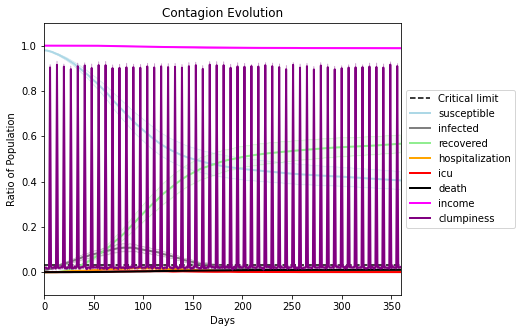

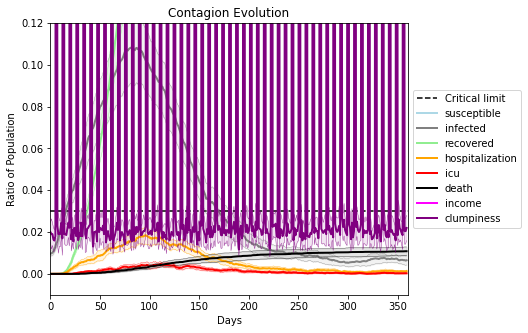

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[596, 3947, 6962, 5415, 7389, 8422, 9904, 6574, 6832, 6549, 245, 7369, 1757, 9030, 6445, 9408, 8046, 3605, 991, 312]
Average similarity between family members is 0.06317576073000422 at temperature 0.66
Average similarity between family and home is 0.9998557129444738 at temperature -1
Average similarity between students and their classroom is 0.06364464127878205 at temperature 0.66
Average classroom occupancy is 3.9444444444444446 and number classrooms is 72
Average similarity between workers is 0.05549638089308664 at temperature 0.66
Average office occupancy is 3.262376237623762 and number offices is 202
Average friend similarity for adults: 0.1254314561204126 for kids: 0.127310018403298
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.03713769987147616
avg restaurant similarity 0.009126490385762116
avg restaurant similarity 0.025966596299901456
avg restaurant similarity 0.01204391672153391
avg restaurant similarity 0.04614364801270684
avg restaurant similarity -0.000522422691429347
avg restaurant similarity -0.021563557765836735
avg restaurant similarity 0.00020592152702938966
avg restaurant similarity 0.008740460510996242
avg restaurant similarity -0.052068143382896774
avg restaurant similarity 0.0046066014701414484
avg restaurant similarity -0.01699325488623413
avg restaurant similarity 0.008059253821678521
avg restaurant similarity 0.023009705160731555
avg restaurant similarity -0.00714771797893316
avg restaurant similarity 0.0032012848763921914
avg restaurant similarity 0.009897478606174712
avg restaurant similarity 0.020866608644694026
avg restaurant similarity 0.017939635390479488
avg restaurant similarity -0.016206747028108124
avg restaurant similarity 0.017891951290988483
avg rest

avg restaurant similarity -0.024033109418518037
avg restaurant similarity 0.02238108604777103
avg restaurant similarity 0.019098598311009265
avg restaurant similarity 0.017516893816857098
avg restaurant similarity 0.04225642693593105
avg restaurant similarity -0.02011882568794685
avg restaurant similarity -0.034667146398239417
avg restaurant similarity 0.02876001383462886
avg restaurant similarity 0.04955394813326859
avg restaurant similarity -0.015473887139083887
avg restaurant similarity 0.015392403167822512
avg restaurant similarity 0.0299632132500515
avg restaurant similarity 0.008766089955906322
avg restaurant similarity 0.007052829812572664
avg restaurant similarity 0.035693503309611484
avg restaurant similarity 0.013234278726941703
avg restaurant similarity 0.020810901675064584
avg restaurant similarity 0.004814380872920552
avg restaurant similarity -0.003921576343702478
avg restaurant similarity -0.0014565854188304918
avg restaurant similarity 0.009724161201484468
avg restauran

avg restaurant similarity 0.0534009121884355
avg restaurant similarity 0.021457786728172272
avg restaurant similarity 0.009004849673584633
avg restaurant similarity 0.035101274971715876
avg restaurant similarity -0.025886694975482634
avg restaurant similarity 0.02675676786431023
avg restaurant similarity 0.04966989653961672
avg restaurant similarity 0.011361094465147815
avg restaurant similarity 0.005725971274282401
avg restaurant similarity -0.0012747796422904925
avg restaurant similarity 0.010801012804989766
avg restaurant similarity 0.045357217061092574
avg restaurant similarity -0.01431004455861549
avg restaurant similarity 0.010287443439360822
avg restaurant similarity 0.018298253396240107
avg restaurant similarity 0.0006726995313208764
avg restaurant similarity 0.009989472624756322
avg restaurant similarity -0.0008042691287911929
avg restaurant similarity 0.01566402719604197
avg restaurant similarity -0.009123033827367
avg restaurant similarity -0.007964795618433532
avg restauran

avg restaurant similarity 0.02183063331661639
avg restaurant similarity 0.03237499102337244
avg restaurant similarity 0.05449038027591912
avg restaurant similarity 0.039197725845236245
avg restaurant similarity 0.011945893705085617
avg restaurant similarity 0.011863045396083636
avg restaurant similarity 0.0027316231117138793
avg restaurant similarity 0.03638644305959813
avg restaurant similarity 0.029005015361675893
avg restaurant similarity 0.06419804068929799
avg restaurant similarity 0.03301799334548878
avg restaurant similarity 0.04610124444639871
avg restaurant similarity 0.022641676175002436
avg restaurant similarity -0.020897712257034025
avg restaurant similarity 0.05573227827869836
avg restaurant similarity 0.02533609744383411
avg restaurant similarity 0.02867455736042274
avg restaurant similarity 0.04800357903155787
avg restaurant similarity 0.006536756112684989
avg restaurant similarity 0.06629301799627274
avg restaurant similarity 0.036213421863378024
avg restaurant similari

avg restaurant similarity 0.03294233397921537
avg restaurant similarity 0.004390438152515226
avg restaurant similarity 0.06980021802390397
avg restaurant similarity 0.06479266714816706
avg restaurant similarity 0.0665640791023897
avg restaurant similarity 0.08044711722428945
avg restaurant similarity 0.030910474837805457
avg restaurant similarity 0.007975487796323816
avg restaurant similarity 0.026984733217899116
avg restaurant similarity 0.04564380504013508
avg restaurant similarity 0.00017627226795477476
avg restaurant similarity 0.035299180892557375
avg restaurant similarity -0.008706204161392141
avg restaurant similarity 0.012271311307499831
avg restaurant similarity 0.03536773448540289
avg restaurant similarity 0.08407488692803389
avg restaurant similarity -0.02395382734512864
avg restaurant similarity -0.007837229992556802
avg restaurant similarity 0.017092998278184977
avg restaurant similarity 0.0012479785133460528
avg restaurant similarity 0.01983705267848398
avg restaurant sim

avg restaurant similarity 0.03432704055792534
avg restaurant similarity -0.004039012106890397
avg restaurant similarity 0.05766083582183599
avg restaurant similarity -0.010237098120442689
avg restaurant similarity 0.0018383448959221815
avg restaurant similarity -0.002425787770369008
avg restaurant similarity 0.00960162471980289
avg restaurant similarity -0.012282108369779766
avg restaurant similarity 0.041376769721953095
avg restaurant similarity 0.036587727040365725
avg restaurant similarity 0.04832429304266401
avg restaurant similarity 0.03800716852248085
avg restaurant similarity -0.007456140044449799
avg restaurant similarity 0.007012758773986109
avg restaurant similarity -0.008030582341565637
avg restaurant similarity 0.01282966255866852
avg restaurant similarity 0.017741017521997395
avg restaurant similarity -0.03670502385205432
avg restaurant similarity -0.009405422929977118
avg restaurant similarity -0.009944082890622565
avg restaurant similarity 0.040242666070128344
avg restau

avg restaurant similarity 0.040665602135768836
avg restaurant similarity 0.019149201648784035
avg restaurant similarity 0.0248664549793442
avg restaurant similarity 0.05223792388627633
avg restaurant similarity -0.008860222577299943
avg restaurant similarity -0.008048805924402096
avg restaurant similarity 0.024286186273438492
avg restaurant similarity 0.007380109499104664
avg restaurant similarity 0.050977201762342696
avg restaurant similarity -0.0004385164796917411
avg restaurant similarity 0.012422565061686403
avg restaurant similarity 0.05094217677075026
avg restaurant similarity -0.0027658004236156873
avg restaurant similarity -0.005012366177719174
avg restaurant similarity 0.023409341265412713
avg restaurant similarity 0.06730896914544171
avg restaurant similarity 0.010769300572189661
avg restaurant similarity 0.0533284188279381
avg restaurant similarity 0.03198519912696028
avg restaurant similarity 0.04543796454026223
avg restaurant similarity 0.06633941786508157
avg restaurant s

avg restaurant similarity -0.005163017312655703
avg restaurant similarity 0.02753548636137204
avg restaurant similarity 0.037261403430317946
avg restaurant similarity -0.006863923221660661
avg restaurant similarity 0.03803241725989181
avg restaurant similarity 0.022332483479249595
avg restaurant similarity -0.004924434166936073
avg restaurant similarity 0.018162887196043354
avg restaurant similarity 0.02517131295944453
avg restaurant similarity 0.004181244920197538
avg restaurant similarity 0.02898108209471867
avg restaurant similarity 0.052502466078805196
avg restaurant similarity 0.003946403800892343
avg restaurant similarity 0.01912238730963575
avg restaurant similarity -0.02597518761669813
avg restaurant similarity 0.03899733192826511
avg restaurant similarity 0.0231318971673574
avg restaurant similarity 0.030196861674427485
avg restaurant similarity 0.03254074197266688
avg restaurant similarity 0.027337893193387117
avg restaurant similarity 0.038310351390541335
avg restaurant simi

avg restaurant similarity 0.025423390319878517
avg restaurant similarity 0.0003572257229229591
avg restaurant similarity 0.07604029402288894
avg restaurant similarity 0.04727375140802106
avg restaurant similarity 0.07665282248063772
avg restaurant similarity 0.06229155063878825
avg restaurant similarity 0.03206125850090278
avg restaurant similarity 0.04926591433108882
avg restaurant similarity 0.04774537926243557
avg restaurant similarity 0.08340433711467145
avg restaurant similarity 0.07013979401756812
avg restaurant similarity 0.047051689758151154
avg restaurant similarity 0.02037924895304593
avg restaurant similarity 0.028165865686807207
avg restaurant similarity 0.07337769892922837
avg restaurant similarity 0.06191971409481228
avg restaurant similarity 0.03478934902350702
avg restaurant similarity 0.10951427109644861
avg restaurant similarity 0.041364328981525096
avg restaurant similarity -0.0023891043547049225
avg restaurant similarity 0.0455881632512481
avg restaurant similarity 

avg restaurant similarity 0.042567955692762734
avg restaurant similarity 0.06319382355090307
avg restaurant similarity 0.04432925535984762
avg restaurant similarity 0.05517839567045459
avg restaurant similarity 0.04741852929038255
avg restaurant similarity 0.0686732993559668
avg restaurant similarity 0.09210343859658529
avg restaurant similarity 0.04248457723847104
avg restaurant similarity 0.056033496388491075
avg restaurant similarity 0.07244808691263399
avg restaurant similarity 0.03070597065081027
avg restaurant similarity 0.024422701116033525
avg restaurant similarity 0.09353582299979331
avg restaurant similarity 0.05992054606909446
avg restaurant similarity 0.044444582020855224
avg restaurant similarity 0.062455233819529964
avg restaurant similarity 0.0342161542789884
avg restaurant similarity 0.06281756191372821
avg restaurant similarity 0.04864522569225911
avg restaurant similarity 0.04329661091387768
avg restaurant similarity 0.04135885929479994
avg restaurant similarity 0.031

avg restaurant similarity 0.04281272714650805
avg restaurant similarity 0.031195379922322065
avg restaurant similarity 0.09989887597393066
avg restaurant similarity 0.04351507847000476
avg restaurant similarity 0.04638729905969569
avg restaurant similarity 0.08228827740076902
avg restaurant similarity 0.04510153931880249
avg restaurant similarity 0.034973740799768296
avg restaurant similarity 0.022308783106080622
avg restaurant similarity 0.05890732390892219
avg restaurant similarity 0.05538453053426218
avg restaurant similarity 0.029893484105244422
avg restaurant similarity 0.023529561111747723
avg restaurant similarity 0.024913289518471753
avg restaurant similarity 0.0007367727601940835
avg restaurant similarity -0.00779918469281024
avg restaurant similarity 0.06638415937741986
avg restaurant similarity -0.019298925821418345
avg restaurant similarity 0.07733190046707114
avg restaurant similarity 0.052676265019180046
avg restaurant similarity 0.010609397719552043
avg restaurant simila

avg restaurant similarity 0.012939280521061554
avg restaurant similarity 0.01864707811475634
avg restaurant similarity 0.018435987235401005
avg restaurant similarity 0.05596804858425082
avg restaurant similarity 0.07603303448712523
avg restaurant similarity 0.059424594438281506
avg restaurant similarity 0.00892262987061996
avg restaurant similarity 0.09407942580896303
avg restaurant similarity 0.05303661498879643
avg restaurant similarity 0.06279193761041854
avg restaurant similarity 0.08745682706015528
avg restaurant similarity 0.030608585510565094
avg restaurant similarity 0.06740142712877023
avg restaurant similarity 0.05009557035666855
avg restaurant similarity 0.05702433220604178
avg restaurant similarity 0.03208197347515009
avg restaurant similarity 0.060832445626430066
avg restaurant similarity 0.023573531027846293
avg restaurant similarity 0.050806010646421665
avg restaurant similarity 0.06269495994993081
avg restaurant similarity 0.03397077400717715
avg restaurant similarity 0

avg restaurant similarity 0.02102703916623456
avg restaurant similarity 0.08555275516039071
avg restaurant similarity 0.01823135277962686
avg restaurant similarity 0.018961681666499013
avg restaurant similarity 0.014910437979101156
avg restaurant similarity 0.02393049079558356
avg restaurant similarity 0.05560571354985984
avg restaurant similarity 0.08072321356305963
avg restaurant similarity 0.060469151271213696
avg restaurant similarity 0.013456142581579133
avg restaurant similarity 0.03729654896465674
avg restaurant similarity 0.05299480795737389
avg restaurant similarity -0.0003197174853441504
avg restaurant similarity 0.05200709647011822
avg restaurant similarity 0.007042636417962635
avg restaurant similarity 0.025079750083245093
avg restaurant similarity 0.07658165545391095
avg restaurant similarity 0.030497473664368186
avg restaurant similarity 0.08594333993351187
avg restaurant similarity 0.03261667116240463
avg restaurant similarity 0.024334366020353514
avg restaurant similari

avg restaurant similarity 0.08611500347770602
avg restaurant similarity -0.019066576378321314
avg restaurant similarity 0.022256497497748082
avg restaurant similarity 0.011527932013285556
avg restaurant similarity 0.015976667907183047
avg restaurant similarity 0.042437613588998946
avg restaurant similarity 0.0399902190529104
avg restaurant similarity 0.026645180672481193
avg restaurant similarity 0.0033256221145304796
avg restaurant similarity 0.06689081028040816
avg restaurant similarity 0.09798959503273319
avg restaurant similarity 0.055158318068015015
avg restaurant similarity 0.047501179022895815
avg restaurant similarity 0.033066203740700885
avg restaurant similarity 0.012388261438404161
avg restaurant similarity 0.0672592993812932
avg restaurant similarity 0.03726622838658761
avg restaurant similarity 0.02581322338694192
avg restaurant similarity 0.01638653668043356
avg restaurant similarity 0.01597160717795855
avg restaurant similarity 0.013940596428310791
avg restaurant similar

avg restaurant similarity 0.0165306774556412
avg restaurant similarity -0.002686381070412471
avg restaurant similarity 0.034784638696061826
avg restaurant similarity 0.04436275049885929
avg restaurant similarity 0.010092278377206405
avg restaurant similarity 0.01954802967287855
avg restaurant similarity 0.02188001069339653
avg restaurant similarity 0.04704032383549962
avg restaurant similarity 0.04379443768632954
avg restaurant similarity 0.05271459474021702
avg restaurant similarity 0.0337592593380962
avg restaurant similarity -0.02016172288815522
avg restaurant similarity 0.034867896512330805
avg restaurant similarity 0.021805946095852586
avg restaurant similarity -0.02405519452871782
avg restaurant similarity -0.001982343633611579
avg restaurant similarity -0.025976026395690372
avg restaurant similarity 0.03782145066514522
avg restaurant similarity -0.013132036416304413
avg restaurant similarity 0.0031646741923266474
avg restaurant similarity -0.0047357133701330005
avg restaurant si

avg restaurant similarity 0.02636505294359156
avg restaurant similarity 0.03217203706421203
avg restaurant similarity 0.031090770202123714
avg restaurant similarity 0.04158252981189004
avg restaurant similarity -0.02680147577499781
avg restaurant similarity -0.009685450020639044
avg restaurant similarity 0.007995807224853397
avg restaurant similarity -0.030924975467181665
avg restaurant similarity 0.06130483555962381
avg restaurant similarity -0.006277538234745047
avg restaurant similarity 0.0028403349461404953
avg restaurant similarity 0.038651343058005154
avg restaurant similarity -0.020968616388418695
avg restaurant similarity 0.004737063561712071
avg restaurant similarity -0.04795004973632207
avg restaurant similarity -0.0010104335131946
avg restaurant similarity 0.01570187452544872
avg restaurant similarity 0.020105380447186415
avg restaurant similarity 0.0008633858192819012
avg restaurant similarity 0.01503047608816404
avg restaurant similarity 0.03928768554438761
avg restaurant 

avg restaurant similarity 0.01393961640761443
avg restaurant similarity 0.007798811617786396
avg restaurant similarity 0.023249694935822223
avg restaurant similarity 0.032263943422109344
avg restaurant similarity 0.06533361295835545
avg restaurant similarity 0.03565682672666847
avg restaurant similarity -0.008903706554469377
avg restaurant similarity 0.02656758021805613
avg restaurant similarity 0.03213889358815896
avg restaurant similarity 0.012333418681857257
avg restaurant similarity -0.007169679167700918
avg restaurant similarity 0.026552427773607494
avg restaurant similarity 0.0031451562982741776
avg restaurant similarity 0.08159040628385937
avg restaurant similarity 0.005745888072601461
avg restaurant similarity 0.04694643801189996
avg restaurant similarity 0.027971092753681828
avg restaurant similarity 0.043927923806588165
avg restaurant similarity 0.00721198243408589
avg restaurant similarity 0.052135582027413946
avg restaurant similarity 0.0032954422572480505
avg restaurant si

avg restaurant similarity 0.036108630882327436
avg restaurant similarity 0.037345282363241146
avg restaurant similarity 0.03965809761360143
avg restaurant similarity 0.005865253397400647
avg restaurant similarity 0.027517032282087232
avg restaurant similarity 0.027711346726409746
avg restaurant similarity 0.03463085360791525
avg restaurant similarity 0.019108326277966926
avg restaurant similarity 0.06637216066043744
avg restaurant similarity 0.07342017721757811
avg restaurant similarity 0.019928908801632405
avg restaurant similarity 0.049643881617979696
avg restaurant similarity 0.03557642283312718
avg restaurant similarity 0.03900298546960468
avg restaurant similarity -0.0008976883917913275
avg restaurant similarity 0.015209836974804578
avg restaurant similarity 0.023585244459122166
avg restaurant similarity 0.07940221227733173
avg restaurant similarity 0.002731406867735159
avg restaurant similarity -0.012628475062458074
avg restaurant similarity 0.022034493080212145
avg restaurant si

avg restaurant similarity 0.08147943234366513
avg restaurant similarity 0.04945273924991052
avg restaurant similarity 0.08235931921034896
avg restaurant similarity 0.017427585489157783
avg restaurant similarity 0.05355679790165367
avg restaurant similarity 0.030053095739288778
avg restaurant similarity 0.010272403542065014
avg restaurant similarity 0.07325681367889315
avg restaurant similarity 0.030936291065051445
avg restaurant similarity 0.02656525531120952
avg restaurant similarity 0.045657770602935785
avg restaurant similarity 0.07035908209152715
avg restaurant similarity 0.0379606299244415
avg restaurant similarity 0.05172979425258716
avg restaurant similarity 0.06289129450394043
avg restaurant similarity 0.06050472121965347
avg restaurant similarity 0.10611844121291363
avg restaurant similarity 0.0372081365249742
avg restaurant similarity 0.08191691862080525
avg restaurant similarity 0.08763144226146977
avg restaurant similarity 0.03795047541568464
avg restaurant similarity 0.055

avg restaurant similarity 0.04922971484401811
avg restaurant similarity 0.0359956698943461
avg restaurant similarity 0.04686861787162132
avg restaurant similarity 0.06057934857725015
avg restaurant similarity 0.08824138358981093
avg restaurant similarity 0.04633142164673457
avg restaurant similarity 0.04562052046227776
avg restaurant similarity 0.028121483425745462
avg restaurant similarity 0.05626229831986744
avg restaurant similarity 0.012889695020092969
avg restaurant similarity 0.07981368664030569
avg restaurant similarity 0.04746641396321198
avg restaurant similarity 0.09088660641400184
avg restaurant similarity 0.05992890100597729
avg restaurant similarity 0.0635072450222415
avg restaurant similarity 0.031579588419491635
avg restaurant similarity 0.07191925148405502
avg restaurant similarity 0.03346442809537467
avg restaurant similarity 0.05431087266405305
avg restaurant similarity 0.06415533877806659
avg restaurant similarity 0.0352562508772881
avg restaurant similarity 0.075608

avg restaurant similarity 0.05281972587907945
avg restaurant similarity -0.01832647288594544
avg restaurant similarity 0.021658461871805756
avg restaurant similarity 0.012327347283053023
avg restaurant similarity 0.0006824605388914359
avg restaurant similarity 0.03377095422357013
avg restaurant similarity 0.054707998688615186
avg restaurant similarity 0.01506832733654249
avg restaurant similarity 0.013593488075344336
avg restaurant similarity 0.0204491203164461
avg restaurant similarity 0.057001509499558546
avg restaurant similarity 0.018718356317881345
avg restaurant similarity 0.010694247932643838
avg restaurant similarity 0.04631060281339539
avg restaurant similarity 0.020080124324323483
avg restaurant similarity 0.022498066982272698
avg restaurant similarity 0.042434141401200935
avg restaurant similarity 0.045125967544764424
avg restaurant similarity -0.059875126813215176
avg restaurant similarity 0.08379183596967514
avg restaurant similarity 0.011769606117350498
avg restaurant sim

avg restaurant similarity 0.02309901289721484
avg restaurant similarity -0.010645738719540717
avg restaurant similarity 0.03856798161862712
avg restaurant similarity 0.003106928037230482
avg restaurant similarity -0.00741367956186457
avg restaurant similarity 0.012284420357749739
avg restaurant similarity 0.02599335322831587
avg restaurant similarity 0.008009081564615866
avg restaurant similarity -0.004354027055543431
avg restaurant similarity 0.004029365514732389
avg restaurant similarity 0.017953656771891632
avg restaurant similarity 0.05008851974909716
avg restaurant similarity 0.030678102814575604
avg restaurant similarity 0.018617776781765363
avg restaurant similarity -0.014871022162372821
avg restaurant similarity 0.026205375388043455
avg restaurant similarity 0.0018109046440352092
avg restaurant similarity 0.04842043907143613
avg restaurant similarity 0.03228653126696646
avg restaurant similarity 0.001219205294479345
avg restaurant similarity 0.030700198843671436
avg restaurant 

avg restaurant similarity -0.009634325020601043
avg restaurant similarity -0.014814421860967276
avg restaurant similarity 0.018272428263288305
avg restaurant similarity 0.04303270852024821
avg restaurant similarity 0.021161635710659717
avg restaurant similarity 0.03694190471721268
avg restaurant similarity 0.02774774845276452
avg restaurant similarity 0.05043151109485235
avg restaurant similarity -0.012192619599877625
avg restaurant similarity 0.02910457612498815
avg restaurant similarity -0.03274312730025705
avg restaurant similarity 7.307184442204184e-05
avg restaurant similarity 0.002918136791132474
avg restaurant similarity -0.02537559306728705
avg restaurant similarity 0.036379423291522814
avg restaurant similarity 0.028023314184400232
avg restaurant similarity 0.017670349978162605
avg restaurant similarity 0.0240555021980841
avg restaurant similarity 0.0036304886703608483
avg restaurant similarity 0.0029854188603026213
avg restaurant similarity -0.023166031678343454
avg restauran

avg restaurant similarity 0.04604850882238603
avg restaurant similarity -0.030878623590312352
avg restaurant similarity 0.028531508806211393
avg restaurant similarity -0.038733147039344155
avg restaurant similarity 0.00587933464262952
avg restaurant similarity 0.02577976111117364
avg restaurant similarity 0.020816489396637296
avg restaurant similarity 0.030880192105174686
avg restaurant similarity -0.0028999542401168957
avg restaurant similarity -0.01636726052687205
avg restaurant similarity 0.008732102622042907
avg restaurant similarity -0.0946173214780709
avg restaurant similarity 0.009747378178356627
avg restaurant similarity 0.03780072970798291
avg restaurant similarity 0.029236545178679522
avg restaurant similarity 0.026067071540553606
avg restaurant similarity 0.005977217976838521
avg restaurant similarity 0.03254185291067145
avg restaurant similarity 0.019935728299540177
avg restaurant similarity -0.02464927172704611
avg restaurant similarity 0.013942208683541037
avg restaurant 

avg restaurant similarity 0.0014234814105284052
avg restaurant similarity -0.011783663393323898
avg restaurant similarity 6.31951943301539e-05
avg restaurant similarity 0.01899513713488651
avg restaurant similarity 0.02499023333135256
avg restaurant similarity 0.010794995584672394
avg restaurant similarity 0.022374753074593984
avg restaurant similarity 0.012651346102941297
avg restaurant similarity 0.013703506566038312
avg restaurant similarity 0.002401997152906261
avg restaurant similarity 0.0289637277789381
avg restaurant similarity -0.02393700627344039
avg restaurant similarity -0.008819906942730604
avg restaurant similarity 0.06991338279961573
avg restaurant similarity 0.02445560179129749
avg restaurant similarity 0.04360262322970937
avg restaurant similarity 0.02965471521003598
avg restaurant similarity 0.04116665768194251
avg restaurant similarity 0.030115389011725256
avg restaurant similarity 0.03364248134358493
avg restaurant similarity 0.014729921456609358
avg restaurant simil

avg restaurant similarity 0.030326374346913234
avg restaurant similarity 0.011689912782872876
avg restaurant similarity 0.03424315016464852
avg restaurant similarity 0.0026084341606845466
avg restaurant similarity 0.026030494675020995
avg restaurant similarity 0.05460000992406726
avg restaurant similarity -0.014508359749862922
avg restaurant similarity 0.03860440759420199
avg restaurant similarity 0.03360948602383848
avg restaurant similarity -0.03937396972402138
avg restaurant similarity 0.03577987691084894
avg restaurant similarity 0.02682533491528614
avg restaurant similarity 0.04190207838176868
avg restaurant similarity 0.022495675078273516
avg restaurant similarity 0.06140173185702403
avg restaurant similarity -0.008578862507216251
avg restaurant similarity -0.005078309625449614
avg restaurant similarity 0.02335000381364166
avg restaurant similarity 0.026678564755939743
avg restaurant similarity -0.006867820625031122
avg restaurant similarity -0.007957170684231905
avg restaurant s

avg restaurant similarity 0.008331830027099148
avg restaurant similarity 0.014634008035250392
avg restaurant similarity 0.039124878900961835
avg restaurant similarity 0.04192776298177477
avg restaurant similarity -0.005016882994136282
avg restaurant similarity 0.058686402261556136
avg restaurant similarity -0.0049679735606210085
avg restaurant similarity 0.06633099092246704
avg restaurant similarity -0.0008088087400062223
avg restaurant similarity 0.005713252656005059
avg restaurant similarity 0.004243436515557918
avg restaurant similarity 0.021605678519708186
avg restaurant similarity 0.003352295205699924
avg restaurant similarity 0.0637535127261445
avg restaurant similarity 0.04401720618764667
avg restaurant similarity -0.0033566279359903807
avg restaurant similarity 0.024006899597323165
avg restaurant similarity 0.031146806550579536
avg restaurant similarity 0.008225830927881782
avg restaurant similarity -0.012643711127741725
avg restaurant similarity 0.0036749172335311174
avg resta

avg restaurant similarity -0.005954554229682712
avg restaurant similarity 0.042361869228296656
avg restaurant similarity 0.048359898434023114
avg restaurant similarity 0.057718845302004655
avg restaurant similarity 0.02141287735969064
avg restaurant similarity -0.011000121632538903
avg restaurant similarity -0.0036993918564788863
avg restaurant similarity 0.007189865524516826
avg restaurant similarity 0.05153150784304224
avg restaurant similarity 0.014016142444942764
avg restaurant similarity 0.014223565272547936
avg restaurant similarity 0.01471590191758081
avg restaurant similarity 0.07905170712837067
avg restaurant similarity 0.04813231434007951
avg restaurant similarity 0.07339317651952032
avg restaurant similarity 0.009965623197035336
avg restaurant similarity 0.03590600675075021
avg restaurant similarity 0.03398314368509861
avg restaurant similarity 0.02685347173003435
avg restaurant similarity 0.01624227085555538
avg restaurant similarity -0.018063962836974132
avg restaurant sim

avg restaurant similarity -0.03783550033088009
avg restaurant similarity 0.010035568171900653
avg restaurant similarity 0.0035215806019729943
avg restaurant similarity -0.039984920887608896
avg restaurant similarity 0.02157405800283087
avg restaurant similarity 0.03488585859996189
avg restaurant similarity 0.01142542387405233
avg restaurant similarity 0.056783543079517204
avg restaurant similarity -0.0023775437426720226
avg restaurant similarity -0.00985063098951775
avg restaurant similarity 0.10095032118528528
avg restaurant similarity -0.013541561421081828
avg restaurant similarity 0.028236955071248286
avg restaurant similarity 0.0016598360061193713
avg restaurant similarity 0.0382089319268189
avg restaurant similarity 0.03295268438132818
avg restaurant similarity -0.02031841769174627
avg restaurant similarity -0.012031238845556206
avg restaurant similarity -0.005415321432964619
avg restaurant similarity -0.04424823631150772
avg restaurant similarity 0.00332007191416019
avg restauran

avg restaurant similarity 0.0476986928549739
avg restaurant similarity 0.02274979492001716
avg restaurant similarity 0.002746733717185431
avg restaurant similarity -0.01307000427368187
avg restaurant similarity 0.025696417212808086
avg restaurant similarity -0.014754935284167346
avg restaurant similarity -0.023759315047327367
avg restaurant similarity -0.01864182552928071
avg restaurant similarity -0.03789626122956962
avg restaurant similarity 0.02112499437176235
avg restaurant similarity 0.009842931969640076
avg restaurant similarity -0.017486293483092462
avg restaurant similarity 0.004546718555333491
avg restaurant similarity -0.0224902677042879
avg restaurant similarity 0.006598765358612499
avg restaurant similarity 0.03770946561816217
avg restaurant similarity 0.036190820469622735
avg restaurant similarity -0.01664521367652215
avg restaurant similarity -0.015713958429440858
avg restaurant similarity 0.005365221574746391
avg restaurant similarity -0.01758416891516261
avg restaurant 

avg restaurant similarity 0.003731076834113935
avg restaurant similarity 0.006301121591084645
avg restaurant similarity 0.007070923307198034
avg restaurant similarity 0.019336021717471823
avg restaurant similarity 0.04406750243060851
avg restaurant similarity 0.031284493738741606
avg restaurant similarity 0.015405781314063878
avg restaurant similarity 0.07844874078787815
avg restaurant similarity 0.03467171892918395
avg restaurant similarity 0.022986876673841472
avg restaurant similarity 0.08210688054803143
avg restaurant similarity -0.0020442122769372554
avg restaurant similarity 0.00930754154030746
avg restaurant similarity 0.025990447165800377
avg restaurant similarity 0.02848431599076342
avg restaurant similarity 0.03337261178698242
avg restaurant similarity 0.032463733626003494
avg restaurant similarity 0.07019788039270879
avg restaurant similarity 0.08309661580337985
avg restaurant similarity 0.03406612358397382
avg restaurant similarity 0.010808633050231747
avg restaurant simila

avg restaurant similarity 0.03249644158195959
avg restaurant similarity 0.053532440651552125
avg restaurant similarity 0.04120575022521056
avg restaurant similarity 0.12984662677251885
avg restaurant similarity 0.032060702989612964
avg restaurant similarity 0.06581244643856063
avg restaurant similarity 0.054845860702541625
avg restaurant similarity 0.04582102891278536
avg restaurant similarity 0.05319943711579596
avg restaurant similarity -0.0033299129638357954
avg restaurant similarity 0.0360962080859451
avg restaurant similarity 0.05334463997465283
avg restaurant similarity 0.03639685571232196
avg restaurant similarity 0.014904186727275143
avg restaurant similarity 0.001050190060798101
avg restaurant similarity 0.11335737147518364
avg restaurant similarity 0.04511307675008954
avg restaurant similarity 0.04716838509992789
avg restaurant similarity 0.051032159495466196
avg restaurant similarity 0.009132956752127514
avg restaurant similarity 0.0030559386486913925
avg restaurant similari

avg restaurant similarity 0.026879317074244638
avg restaurant similarity 0.04512211949131303
avg restaurant similarity -0.0006582363140844248
avg restaurant similarity 0.017748787540151034
avg restaurant similarity -0.010014955370093068
avg restaurant similarity 0.018336248694395547
avg restaurant similarity 0.023404121953022796
avg restaurant similarity 0.02741490092494493
avg restaurant similarity 0.009316707375271256
avg restaurant similarity 0.020162519791483532
avg restaurant similarity 0.04768991532269536
avg restaurant similarity -0.006844710213208815
avg restaurant similarity 0.025867299815181145
avg restaurant similarity 0.046558376063079256
avg restaurant similarity 0.033880015300285136
avg restaurant similarity -0.02590915212156588
avg restaurant similarity 0.03154757106380947
avg restaurant similarity 0.005368036240653793
avg restaurant similarity 0.0243592073799538
avg restaurant similarity 0.0010619907481819227
avg restaurant similarity 0.025757854128623702
avg restaurant

avg restaurant similarity 0.013776553376132292
avg restaurant similarity 0.00933625802264699
avg restaurant similarity 0.011805759698481272
avg restaurant similarity 0.03630438933689769
avg restaurant similarity 0.006478077782097177
avg restaurant similarity 0.020907741624480853
avg restaurant similarity 0.03279709220797108
avg restaurant similarity -0.020979388835728634
avg restaurant similarity 0.05229267891834723
avg restaurant similarity 0.009330465623165937
avg restaurant similarity -0.009880455842220689
avg restaurant similarity 0.02333214272700808
avg restaurant similarity 0.010307304335151106
avg restaurant similarity 0.007501858626097122
avg restaurant similarity 0.03342250676868311
avg restaurant similarity 0.06391803617893024
avg restaurant similarity 0.049068292157379644
avg restaurant similarity 0.03892135920492172
avg restaurant similarity -0.012290008330139789
avg restaurant similarity 0.0261589113753597
avg restaurant similarity 0.002149647429924345
avg restaurant simil

avg restaurant similarity 0.02632175268010224
avg restaurant similarity 0.01488790261015251
avg restaurant similarity 0.04313048790150667
avg restaurant similarity 0.05355537654831001
avg restaurant similarity 0.0389833345824365
avg restaurant similarity 0.03658766234973093
avg restaurant similarity 0.009002952695100644
avg restaurant similarity -0.022285766135050435
avg restaurant similarity 0.03668563855342514
avg restaurant similarity 0.017160903794611597
avg restaurant similarity 0.030294928496466273
avg restaurant similarity 0.007451231340834028
avg restaurant similarity -0.015938815541543652
avg restaurant similarity 0.06001311381810531
avg restaurant similarity 0.06510341553733018
avg restaurant similarity 0.012425209788265595
avg restaurant similarity 0.005564850063190989
avg restaurant similarity 0.028173035420225007
avg restaurant similarity 0.014035464896017787
avg restaurant similarity 0.0015785267483805789
avg restaurant similarity -0.03215058685160029
avg restaurant simil

avg restaurant similarity 0.0544955114888745
avg restaurant similarity 0.031310659784545
avg restaurant similarity 0.03205233922102014
avg restaurant similarity 0.03987179876363371
avg restaurant similarity 0.014505168437465318
avg restaurant similarity 0.01616782778315206
avg restaurant similarity 0.029981179973270433
avg restaurant similarity 0.013011768390603503
avg restaurant similarity 0.016525526395329868
avg restaurant similarity 0.06055170888011392
avg restaurant similarity 0.015617747824707855
avg restaurant similarity 0.05330504971385111
avg restaurant similarity 0.012616648116883735
avg restaurant similarity 0.03050532380594058
avg restaurant similarity 0.0030531344304546653
avg restaurant similarity 0.030554994483656412
avg restaurant similarity 0.04214591290204253
avg restaurant similarity 0.008537932750162045
avg restaurant similarity 0.018459201677903766
avg restaurant similarity 0.08673250408090556
avg restaurant similarity 0.00142010800345991
avg restaurant similarity 

avg restaurant similarity 0.03801166310307409
avg restaurant similarity 0.062376686927689134
avg restaurant similarity 0.015983084803717382
avg restaurant similarity 0.0044452681081230145
avg restaurant similarity -0.046080549037885256
avg restaurant similarity 0.026072442993509873
avg restaurant similarity -0.023953729026046786
avg restaurant similarity 0.052706694190542955
avg restaurant similarity -0.031044417440523935
avg restaurant similarity -0.028586303362842114
avg restaurant similarity -0.001001111965809799
avg restaurant similarity 0.01815241317087514
avg restaurant similarity 0.014893204492310002
avg restaurant similarity 0.04868309556689286
avg restaurant similarity -0.02753383432055607
avg restaurant similarity 0.05259210174608792
avg restaurant similarity 0.048618685194706905
avg restaurant similarity 0.016852106819625026
avg restaurant similarity 0.029054653183419724
avg restaurant similarity -0.022098052790569304
avg restaurant similarity 0.015796733082671065
avg restau

avg restaurant similarity -0.015775536403185738
avg restaurant similarity -0.0008722998696236252
avg restaurant similarity 0.012529773632384974
avg restaurant similarity -0.008867805939776534
avg restaurant similarity 0.052353343347717574
avg restaurant similarity 0.009028156897654323
avg restaurant similarity -0.03742878231884474
avg restaurant similarity -0.0031551877623647124
avg restaurant similarity 0.06869830087638548
avg restaurant similarity -0.015618336658285223
avg restaurant similarity -0.0032551098945256345
avg restaurant similarity -0.008532638959370262
avg restaurant similarity 0.06867732489053596
avg restaurant similarity -0.05158643182137767
avg restaurant similarity 0.0037474451022019998
avg restaurant similarity -0.009636052189191596
avg restaurant similarity -0.028678903356396442
avg restaurant similarity -0.05204937933540249
avg restaurant similarity -0.00708125132694849
avg restaurant similarity -0.035307868691181486
avg restaurant similarity -0.0024513713958577384

avg restaurant similarity 0.04744703639922228
avg restaurant similarity 0.05179721513882769
avg restaurant similarity 0.0268920541534356
avg restaurant similarity 0.04304396754402583
avg restaurant similarity 0.0010771637963171035
avg restaurant similarity 0.054484651280227094
avg restaurant similarity -0.006579233319667183
avg restaurant similarity 0.07717123739669815
avg restaurant similarity -0.015033415383791774
avg restaurant similarity 0.03698499165206079
avg restaurant similarity -0.015279356385810499
avg restaurant similarity -0.027281210697092093
avg restaurant similarity 0.02942151985837713
avg restaurant similarity 0.08074172889539098
avg restaurant similarity 0.02653827546796702
avg restaurant similarity 0.05035580127265264
avg restaurant similarity -0.029854731694633815
avg restaurant similarity 0.00776439082737512
avg restaurant similarity 0.006330904543928476
avg restaurant similarity -0.03330088172043127
avg restaurant similarity 0.061808595946896326
avg restaurant simi

avg restaurant similarity -0.004065188924841581
avg restaurant similarity 0.030260680575010676
avg restaurant similarity 0.04040290404316452
avg restaurant similarity -0.005691014420769196
avg restaurant similarity -0.0031548238585857417
avg restaurant similarity 0.01022314279862739
avg restaurant similarity -0.018611533334585123
avg restaurant similarity 0.07358162226627736
avg restaurant similarity 0.02005885065232132
avg restaurant similarity -0.002702593219757727
avg restaurant similarity 0.005433052502125332
avg restaurant similarity -0.00784110594892887
avg restaurant similarity 0.016288967241439776
avg restaurant similarity -0.029178605583418955
avg restaurant similarity 0.01005124883559671
avg restaurant similarity 0.009648326468990288
avg restaurant similarity 0.04590849949884549
avg restaurant similarity 0.013602323474484545
avg restaurant similarity 0.0156855917202595
avg restaurant similarity 0.0522001342935864
avg restaurant similarity 0.002930111230913484
avg restaurant s

(<function dict.items>, <function dict.items>, <function dict.items>)

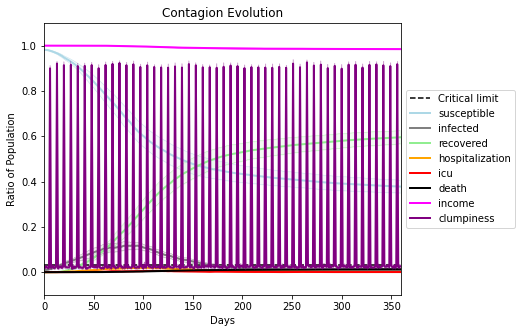

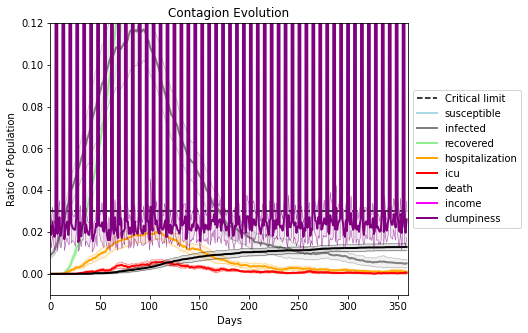

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1741, 8086, 1778, 2476, 7408, 1239, 606, 6991, 2556, 8122, 9157, 5383, 9764, 3832, 8114, 9284, 8789, 3561, 277, 8687]
Average similarity between family members is 0.022406676263955153 at temperature 1
Average similarity between family and home is 0.9998531215816456 at temperature -1
Average similarity between students and their classroom is -0.0030223639082582214 at temperature 1
Average classroom occupancy is 3.887323943661972 and number classrooms is 71
Average similarity between workers is -0.016873602654431392 at temperature 1
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.08637974478909577 for kids: 0.07425036071844512
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.004801421106520964
avg restaurant similarity 0.014417028429088317
avg restaurant similarity 0.0021947966523965957
avg restaurant similarity 0.0019121445168164594
avg restaurant similarity -0.0017430255749427488
avg restaurant similarity 0.024228044939358376
avg restaurant similarity -0.01025007491559585
avg restaurant similarity -0.02718236273335907
avg restaurant similarity 0.022601365323711146
avg restaurant similarity 0.042648480237589145
avg restaurant similarity 0.01707736721442536
avg restaurant similarity -7.034568068340827e-05
avg restaurant similarity -0.01842312688735219
avg restaurant similarity 0.03784160689969397
avg restaurant similarity 0.029597733004150546
avg restaurant similarity 0.015250716370365909
avg restaurant similarity 0.023311952962008838
avg restaurant similarity 0.02173992764509516
avg restaurant similarity -0.011229368786487363
avg restaurant similarity 0.03265281315109939
avg restaurant similarity 0.030323590837135747
avg restau

avg restaurant similarity 0.0269232559829636
avg restaurant similarity 0.026179871132736256
avg restaurant similarity -0.00011920690853026687
avg restaurant similarity -0.010320250305206101
avg restaurant similarity 0.016557717900947372
avg restaurant similarity -0.0006121406300030996
avg restaurant similarity 0.023861225908712525
avg restaurant similarity -0.0159347186948509
avg restaurant similarity 0.01955962725497894
avg restaurant similarity -0.013909488713195724
avg restaurant similarity 0.0019710363778999928
avg restaurant similarity 0.027122587888533112
avg restaurant similarity 0.03390912882197702
avg restaurant similarity 0.05652945082231673
avg restaurant similarity -0.008452927077977563
avg restaurant similarity 0.013323396731863685
avg restaurant similarity 0.012284509739521974
avg restaurant similarity -0.0031552229480527644
avg restaurant similarity 0.007006590246315171
avg restaurant similarity -0.005036832315618278
avg restaurant similarity 0.007402150811835402
avg res

avg restaurant similarity 0.02779242152593555
avg restaurant similarity 0.04437832490117315
avg restaurant similarity -0.03622995075220686
avg restaurant similarity 0.023479354639780924
avg restaurant similarity 0.03198660147475945
avg restaurant similarity 0.004005752894407314
avg restaurant similarity 0.020589399189892377
avg restaurant similarity -0.022974975431240583
avg restaurant similarity -0.016958179754000647
avg restaurant similarity 0.0343449289582523
avg restaurant similarity 0.029220446163381694
avg restaurant similarity 0.06638399191178297
avg restaurant similarity -0.0063816783881291885
avg restaurant similarity 0.0054664385135000425
avg restaurant similarity -0.004858649132243111
avg restaurant similarity 0.02577076842172837
avg restaurant similarity 0.015689057136641968
avg restaurant similarity 0.0180723491180386
avg restaurant similarity 0.0008756976271845104
avg restaurant similarity 0.02637749779212386
avg restaurant similarity 0.04257735357222181
avg restaurant si

avg restaurant similarity 0.011269666630126674
avg restaurant similarity 0.023178858506827296
avg restaurant similarity 0.014054762077456718
avg restaurant similarity -0.017422610118557974
avg restaurant similarity 0.00891188628885807
avg restaurant similarity 0.013083343044507936
avg restaurant similarity 0.04150196145650255
avg restaurant similarity 0.0036012326330424004
avg restaurant similarity 0.03422728855314979
avg restaurant similarity -0.007729380687367149
avg restaurant similarity -0.013161177909688857
avg restaurant similarity 0.04114771791677882
avg restaurant similarity 0.005234153234697409
avg restaurant similarity 0.03550483177435065
avg restaurant similarity 0.03970958709456269
avg restaurant similarity 0.01213224047467276
avg restaurant similarity 0.027407841195487125
avg restaurant similarity -0.0032534302426685787
avg restaurant similarity 0.009384579798046086
avg restaurant similarity 0.009585809069381343
avg restaurant similarity 0.026510874994745907
avg restaurant

avg restaurant similarity 0.0057218210430413415
avg restaurant similarity -0.019895565151887888
avg restaurant similarity -0.012538439170638252
avg restaurant similarity 0.023829790178844883
avg restaurant similarity 0.0038923829855763083
avg restaurant similarity 0.002288499206719635
avg restaurant similarity -0.036842100031708784
avg restaurant similarity 0.01726104206842813
avg restaurant similarity 0.009786391067025538
avg restaurant similarity -0.004971282340048224
avg restaurant similarity -0.00034462031124376033
avg restaurant similarity 0.019046991859214733
avg restaurant similarity -0.008233312426230132
avg restaurant similarity 0.004642097305234516
avg restaurant similarity -0.006494049290097647
avg restaurant similarity -0.01485030905267637
avg restaurant similarity -0.004187796196241613
avg restaurant similarity 0.02744646445856
avg restaurant similarity 0.035598292666471215
avg restaurant similarity 0.0029926429708093663
avg restaurant similarity -0.018660792942650623
avg 

avg restaurant similarity 0.004598734542180422
avg restaurant similarity 0.03757059373225482
avg restaurant similarity 0.01037333499083139
avg restaurant similarity 0.0071837637808123385
avg restaurant similarity 0.011687597660537551
avg restaurant similarity 0.03550670666791756
avg restaurant similarity 0.0015904046485636669
avg restaurant similarity -0.026212181361122293
avg restaurant similarity 0.036193240245213636
avg restaurant similarity 0.013204106399411539
avg restaurant similarity 0.04020412734598061
avg restaurant similarity -0.006200000377693618
avg restaurant similarity -0.018733387291503967
avg restaurant similarity -0.025596288379090438
avg restaurant similarity 0.032219788583804226
avg restaurant similarity 0.017817266191629808
avg restaurant similarity 0.015347422664228144
avg restaurant similarity 0.04923896224715155
avg restaurant similarity 0.008653799087890664
avg restaurant similarity -0.0014125870460438227
avg restaurant similarity 0.014839761690376664
avg restau

avg restaurant similarity 0.007479639794418776
avg restaurant similarity -0.027550770080676062
avg restaurant similarity 0.034686386318642105
avg restaurant similarity 0.022442213486834665
avg restaurant similarity -0.016017730266071485
avg restaurant similarity -0.001550944501701744
avg restaurant similarity -0.01630287726900915
avg restaurant similarity 0.051200729835493806
avg restaurant similarity 0.0500387522698551
avg restaurant similarity 0.03732058344599437
avg restaurant similarity -0.002469958267486954
avg restaurant similarity 0.016247316701091603
avg restaurant similarity 0.008908291712880299
avg restaurant similarity 0.0010407213544637787
avg restaurant similarity 0.0038083403074386964
avg restaurant similarity 0.036848072921754384
avg restaurant similarity -0.0011632236196857581
avg restaurant similarity -0.02013886013151957
avg restaurant similarity 0.03994333014890337
avg restaurant similarity -0.025004667936143105
avg restaurant similarity 0.022524639602772935
avg rest

avg restaurant similarity 0.009279434036663788
avg restaurant similarity -0.011728913569856262
avg restaurant similarity 0.024518300656312986
avg restaurant similarity 0.021571211843928576
avg restaurant similarity -0.015667307879691148
avg restaurant similarity -0.011323873410584774
avg restaurant similarity -0.00014513493324554115
avg restaurant similarity 0.03951540209403524
avg restaurant similarity 0.012964072274118048
avg restaurant similarity 0.03768569330129971
avg restaurant similarity 0.011551663138171948
avg restaurant similarity 0.0595452727408374
avg restaurant similarity -0.02232740638217897
avg restaurant similarity 0.031410042205793604
avg restaurant similarity 0.03434235412116596
avg restaurant similarity 0.02260200804110804
avg restaurant similarity -0.019800511204221286
avg restaurant similarity -0.024106701354141034
avg restaurant similarity -0.026751445261479843
avg restaurant similarity -0.010728090951992767
avg restaurant similarity -0.014731700254771602
avg rest

avg restaurant similarity 0.03489987904281425
avg restaurant similarity -0.03431075235127719
avg restaurant similarity -0.037579938881256165
avg restaurant similarity -0.009539654604703214
avg restaurant similarity -0.01803586039607441
avg restaurant similarity -0.02958394929733117
avg restaurant similarity -0.050265550516184386
avg restaurant similarity -0.020499043304901793
avg restaurant similarity -0.02931298016937563
avg restaurant similarity -0.034841217467638415
avg restaurant similarity -0.024452378254268506
avg restaurant similarity 0.015410443463460204
avg restaurant similarity -0.016316906874031784
avg restaurant similarity -0.027941747329814522
avg restaurant similarity -0.004907814828797836
avg restaurant similarity -0.012271215643731353
avg restaurant similarity -0.03719015643963335
avg restaurant similarity -0.014059671772699447
avg restaurant similarity -0.039005521101351796
avg restaurant similarity -0.0161681360627751
avg restaurant similarity -0.0236778507987594
avg 

avg restaurant similarity 0.01825594525783943
avg restaurant similarity -0.01852262958766029
avg restaurant similarity -0.02092696836692817
avg restaurant similarity -0.00281120083866595
avg restaurant similarity -0.008472152211413888
avg restaurant similarity -0.02438339468216595
avg restaurant similarity -0.030973088182647206
avg restaurant similarity -0.019398535070263723
avg restaurant similarity -0.009333283755600927
avg restaurant similarity -0.00456228783502193
avg restaurant similarity 0.014612926682245179
avg restaurant similarity 0.004813652282700648
avg restaurant similarity -0.03468994652514401
avg restaurant similarity -0.016562919513947894
avg restaurant similarity -0.04363600199187754
avg restaurant similarity -0.05189363713384688
avg restaurant similarity 0.03862894039754569
avg restaurant similarity -0.07113027829984374
avg restaurant similarity -0.03995285089588403
avg restaurant similarity -0.015020964336706948
avg restaurant similarity -0.0165706956757231
avg restau

avg restaurant similarity 0.04531119458105826
avg restaurant similarity -0.026065455905915712
avg restaurant similarity -0.009100281125119892
avg restaurant similarity 0.0026833378588007736
avg restaurant similarity 0.030649182743749812
avg restaurant similarity -0.0320343027555348
avg restaurant similarity 0.0029927096128023957
avg restaurant similarity 0.0015835670585984006
avg restaurant similarity 0.011138622469806654
avg restaurant similarity 0.022865356660412367
avg restaurant similarity 0.009040087752992443
avg restaurant similarity 0.03891026229410365
avg restaurant similarity 0.027261567454899775
avg restaurant similarity 0.018549503638047953
avg restaurant similarity 0.0031169133617343636
avg restaurant similarity 0.008948586718461642
avg restaurant similarity 0.00036044157136681294
avg restaurant similarity 0.005381259319951261
avg restaurant similarity -0.04014471300553857
avg restaurant similarity 0.007930644113635418
avg restaurant similarity -0.018829558942463902
avg res

avg restaurant similarity -0.013412888525286033
avg restaurant similarity 0.016849678953928495
avg restaurant similarity 0.038690847942916155
avg restaurant similarity -0.003610401899628048
avg restaurant similarity -0.006645654816136301
avg restaurant similarity 0.0016700820445219133
avg restaurant similarity 0.006178100151497121
avg restaurant similarity 0.02286518083879877
avg restaurant similarity 0.019722914675092327
avg restaurant similarity 0.01370521565621324
avg restaurant similarity 0.017599287717571722
avg restaurant similarity 0.021814509917600085
avg restaurant similarity -0.00834335199732672
avg restaurant similarity 0.0037019141685978385
avg restaurant similarity 0.03331993746736791
avg restaurant similarity 0.027770888533742242
avg restaurant similarity 0.03445422810932614
avg restaurant similarity 0.05489764227775248
avg restaurant similarity -0.005360041114972033
avg restaurant similarity 0.007856353713608974
avg restaurant similarity -0.012074545551073705
avg restaur

avg restaurant similarity -0.034606344033516104
avg restaurant similarity -0.019613553786445394
avg restaurant similarity -0.01300907906713732
avg restaurant similarity 0.01779483653569674
avg restaurant similarity -0.0023601283645988493
avg restaurant similarity 0.006260606847187581
avg restaurant similarity 0.0005881804772069997
avg restaurant similarity 0.018581708706056313
avg restaurant similarity 0.020829991266409217
avg restaurant similarity -0.014349064251013031
avg restaurant similarity 8.899665857338794e-05
avg restaurant similarity 0.007396808115608236
avg restaurant similarity 0.009173151983094572
avg restaurant similarity -0.03065572140398463
avg restaurant similarity -0.037123691428062294
avg restaurant similarity 0.006544622301903054
avg restaurant similarity -0.007965682862177666
avg restaurant similarity 0.03662225279481742
avg restaurant similarity -0.015054129958878571
avg restaurant similarity 0.013463265442438307
avg restaurant similarity -0.0056621649466433695
avg

avg restaurant similarity -0.0017390114798698478
avg restaurant similarity 0.01148011540155391
avg restaurant similarity -0.05054972724829506
avg restaurant similarity -0.014353191268687893
avg restaurant similarity -0.03519461464394449
avg restaurant similarity -0.007406880912319388
avg restaurant similarity 0.005647584385756949
avg restaurant similarity -0.016754238333220303
avg restaurant similarity -0.03238048590358063
avg restaurant similarity -0.0009094912782734832
avg restaurant similarity -0.020461806185310315
avg restaurant similarity 0.014456805664153685
avg restaurant similarity -0.00474976390845949
avg restaurant similarity 0.026048699976159852
avg restaurant similarity -0.02985949086606745
avg restaurant similarity 0.002275452132266458
avg restaurant similarity 0.0213011858937806
avg restaurant similarity 0.025942346555339044
avg restaurant similarity -0.043823654563339524
avg restaurant similarity 0.0005309151876216985
avg restaurant similarity -0.00848719067326199
avg re

avg restaurant similarity -0.00608776069595047
avg restaurant similarity 0.011500524428586819
avg restaurant similarity -0.01568573005503752
avg restaurant similarity -0.013788246591874347
avg restaurant similarity -0.0005683084261910197
avg restaurant similarity -0.008549167306873917
avg restaurant similarity 0.04584004880561401
avg restaurant similarity 0.01693259263085595
avg restaurant similarity 0.038351170134648116
avg restaurant similarity 0.03342625139362308
avg restaurant similarity 0.004675521346515207
avg restaurant similarity 0.010961527763410252
avg restaurant similarity 0.005538551278194932
avg restaurant similarity 0.030667856166876457
avg restaurant similarity 0.01593896971005162
avg restaurant similarity 0.022633110353898568
avg restaurant similarity 0.015468385045654745
avg restaurant similarity 0.050169954156872656
avg restaurant similarity 0.041682687605216186
avg restaurant similarity 0.02305175669818271
avg restaurant similarity 0.036461955884718865
avg restaurant

avg restaurant similarity -0.009019816096579968
avg restaurant similarity 0.05214401567411593
avg restaurant similarity 0.025017780861971237
avg restaurant similarity -0.004990099245427792
avg restaurant similarity 0.045644946684864005
avg restaurant similarity 0.007979025952244066
avg restaurant similarity 0.015525781353872203
avg restaurant similarity 0.008568429661758803
avg restaurant similarity -0.0017127941649006642
avg restaurant similarity 0.02421395857057022
avg restaurant similarity 0.0012372889702002325
avg restaurant similarity -0.005297352157148604
avg restaurant similarity 0.005765050499179028
avg restaurant similarity 0.0342835851755124
avg restaurant similarity 0.0027136682928951767
avg restaurant similarity -0.036543200616804
avg restaurant similarity 0.037133816815265674
avg restaurant similarity -0.0008807640715628339
avg restaurant similarity 0.027920953574819427
avg restaurant similarity 0.04022357378017119
avg restaurant similarity -0.02488995406684394
avg restaur

avg restaurant similarity 0.01706231560574987
avg restaurant similarity 0.004204618340811152
avg restaurant similarity -0.006315888629314529
avg restaurant similarity -0.023260291438058547
avg restaurant similarity -0.03618443675226868
avg restaurant similarity -0.03103205025578356
avg restaurant similarity -0.010542720695742634
avg restaurant similarity -0.007198437514599102
avg restaurant similarity 0.010433496998303005
avg restaurant similarity -0.032142418552341484
avg restaurant similarity 0.021967449005903104
avg restaurant similarity 0.02109115843783628
avg restaurant similarity 0.05249143856348436
avg restaurant similarity -0.015322822542145762
avg restaurant similarity -0.0015519770395492401
avg restaurant similarity 0.0338286382788559
avg restaurant similarity 0.042623819314755694
avg restaurant similarity -0.02501061309399886
avg restaurant similarity 0.007862440376391128
avg restaurant similarity -0.011468918395864712
avg restaurant similarity -0.00976119187399489
avg resta

avg restaurant similarity -0.04270487680684629
avg restaurant similarity 0.0009101444872588057
avg restaurant similarity -0.018771231592159442
avg restaurant similarity 0.00751021212623073
avg restaurant similarity 0.018746517749536524
avg restaurant similarity -0.001133866683023266
avg restaurant similarity 0.020796897182592096
avg restaurant similarity 0.005145561054548403
avg restaurant similarity -0.02115278332029797
avg restaurant similarity 0.016757397786776956
avg restaurant similarity -0.05901866282882345
avg restaurant similarity 0.001760495900129799
avg restaurant similarity 0.009371401708271849
avg restaurant similarity 0.015695617778926356
avg restaurant similarity 0.02267793427145607
avg restaurant similarity -0.01944781200279211
avg restaurant similarity 0.004021951579269449
avg restaurant similarity 0.010659806203564352
avg restaurant similarity 0.008522778063815984
avg restaurant similarity 0.00616563924423638
avg restaurant similarity 0.019076141069454516
avg restauran

avg restaurant similarity 0.03207377583359954
avg restaurant similarity 0.017581366368728913
avg restaurant similarity 0.00712757904253371
avg restaurant similarity 0.031165373954020147
avg restaurant similarity 0.008314107688134915
avg restaurant similarity 0.018250558303207036
avg restaurant similarity 0.006761929721981132
avg restaurant similarity -0.014672785558542803
avg restaurant similarity 0.005460211719507821
avg restaurant similarity 0.017958386541683767
avg restaurant similarity -0.005579781252103682
avg restaurant similarity 0.005556687585377756
avg restaurant similarity -0.0016130013804623912
avg restaurant similarity 0.051826727701460996
avg restaurant similarity 0.029505063329367528
avg restaurant similarity 0.017329520094491496
avg restaurant similarity 0.018610154717857465
avg restaurant similarity 0.02475111236946403
avg restaurant similarity 0.017102028188774078
avg restaurant similarity 0.004443692492419264
avg restaurant similarity -0.023191625080858314
avg restaur

avg restaurant similarity 0.005061715357447762
avg restaurant similarity -0.027759381007311464
avg restaurant similarity -0.0013819343538493385
avg restaurant similarity -0.019979816102046605
avg restaurant similarity 0.02429517193712565
avg restaurant similarity -0.020118771626581083
avg restaurant similarity 0.030506168739200288
avg restaurant similarity 0.024021031065414505
avg restaurant similarity -0.003525768367202618
avg restaurant similarity 0.01012758751830538
avg restaurant similarity 0.02873077731071344
avg restaurant similarity 0.0035750496335477753
avg restaurant similarity 0.031148773853398218
avg restaurant similarity 0.016595958255473213
avg restaurant similarity 0.019354473235521877
avg restaurant similarity 0.01474400608766659
avg restaurant similarity 0.0009419765199131688
avg restaurant similarity 0.01662587668011189
avg restaurant similarity 0.015036932328038698
avg restaurant similarity -0.02255087452521128
avg restaurant similarity 0.024374988464116277
avg restau

avg restaurant similarity 0.006600506038342783
avg restaurant similarity 0.0038900542643391847
avg restaurant similarity -0.06471882662774084
avg restaurant similarity -0.06956566584952827
avg restaurant similarity -0.03737278096987836
avg restaurant similarity -0.03226791138018293
avg restaurant similarity -0.005757988453160941
avg restaurant similarity -0.02680602400961013
avg restaurant similarity -0.04141654383503568
avg restaurant similarity -0.051218827683789624
avg restaurant similarity -0.061020804306812795
avg restaurant similarity -0.03560041058108553
avg restaurant similarity -0.008683351035412549
avg restaurant similarity -0.026465305859227663
avg restaurant similarity 0.02966542040281938
avg restaurant similarity -0.021259614523693862
avg restaurant similarity -0.0026366786433986164
avg restaurant similarity -0.015988059747725943
avg restaurant similarity -0.03690029265104632
avg restaurant similarity -0.012272666593902849
avg restaurant similarity -0.05985744497004477
avg

avg restaurant similarity -0.016703226595348963
avg restaurant similarity -0.02513980647367724
avg restaurant similarity -0.029197852001425863
avg restaurant similarity -0.043450374675917634
avg restaurant similarity 0.029409491780784704
avg restaurant similarity 0.003260563834096525
avg restaurant similarity 0.009919964324338197
avg restaurant similarity -0.002411142448584953
avg restaurant similarity -0.008073427913087933
avg restaurant similarity -0.013570576221464986
avg restaurant similarity -0.019264614783107002
avg restaurant similarity -0.010228649488330709
avg restaurant similarity -0.04223428146310272
avg restaurant similarity -0.02767824907990317
avg restaurant similarity -0.03996015529275738
avg restaurant similarity -0.02873518637865833
avg restaurant similarity 0.003144833145733245
avg restaurant similarity -0.030582375481189958
avg restaurant similarity -0.029627880910190252
avg restaurant similarity -0.019560701737088734
avg restaurant similarity -0.012794707956514838
a

avg restaurant similarity 0.03268445891817434
avg restaurant similarity 0.015040769600894979
avg restaurant similarity 0.033426927768776205
avg restaurant similarity -0.01848022338021616
avg restaurant similarity 0.04052603353834169
avg restaurant similarity -0.024609413640925778
avg restaurant similarity -0.02947733521832491
avg restaurant similarity 0.02487408432473579
avg restaurant similarity -0.0018420279578077168
avg restaurant similarity 0.031919150166433194
avg restaurant similarity 0.00660411650152217
avg restaurant similarity 0.013805501430311017
avg restaurant similarity 0.012968601054528683
avg restaurant similarity 0.02875826515058134
avg restaurant similarity 0.025543811168650586
avg restaurant similarity -0.011576099658525654
avg restaurant similarity 0.050160321633444395
avg restaurant similarity 0.05212558847846358
avg restaurant similarity 0.01674639578424922
avg restaurant similarity 0.025505794433067195
avg restaurant similarity -0.014131386105034399
avg restaurant 

avg restaurant similarity 0.011860428253741617
avg restaurant similarity 0.0030851902889628083
avg restaurant similarity -0.03269773613901891
avg restaurant similarity -0.0057368074526922865
avg restaurant similarity -0.007128980923281747
avg restaurant similarity -0.020371003726770025
avg restaurant similarity -0.023398141503389883
avg restaurant similarity 0.02462303623207971
avg restaurant similarity 0.023404190922534575
avg restaurant similarity 0.03294263395580883
avg restaurant similarity 0.025514378165738177
avg restaurant similarity -0.011387280863763121
avg restaurant similarity -0.008492975295172829
avg restaurant similarity 0.03125706669250957
avg restaurant similarity 0.020698188507477778
avg restaurant similarity -0.020714319888723843
avg restaurant similarity -0.02027061096359597
avg restaurant similarity 0.016627744857733627
avg restaurant similarity -0.012409828896120178
avg restaurant similarity 0.0013146746930836333
avg restaurant similarity 0.02324330268451854
avg re

avg restaurant similarity -0.003062706457227484
avg restaurant similarity -0.024846241995033734
avg restaurant similarity 0.037733341711067465
avg restaurant similarity -0.015182380634243299
avg restaurant similarity 0.0010328097360459444
avg restaurant similarity -0.02476246424042876
avg restaurant similarity 0.017230815890329078
avg restaurant similarity 0.03727149477720493
avg restaurant similarity 0.028952065513740122
avg restaurant similarity -0.04600398883352575
avg restaurant similarity 0.0012505228988476814
avg restaurant similarity -0.032712128115429985
avg restaurant similarity -0.004380845491924475
avg restaurant similarity 0.01815157530585112
avg restaurant similarity -0.037276209875577906
avg restaurant similarity 0.010689436184915888
avg restaurant similarity 0.018308222287334905
avg restaurant similarity -0.02736234047114454
avg restaurant similarity 0.020057628060582623
avg restaurant similarity -0.013147035336789575
avg restaurant similarity 0.029074175954708688
avg re

avg restaurant similarity -0.03841470393560698
avg restaurant similarity 0.01525157740064362
avg restaurant similarity -0.012771053389305852
avg restaurant similarity -0.010991802116104118
avg restaurant similarity 0.018258214319459395
avg restaurant similarity -0.012048215408003984
avg restaurant similarity 0.0023936044047374243
avg restaurant similarity -0.022403328392027723
avg restaurant similarity -0.004231486700660979
avg restaurant similarity 0.02528353876772568
avg restaurant similarity 0.005260525367492211
avg restaurant similarity 0.020761252797336493
avg restaurant similarity -4.700583230602998e-05
avg restaurant similarity 0.001963089293979966
avg restaurant similarity -0.038064739143180135
avg restaurant similarity 0.042963221642216755
avg restaurant similarity 0.008567334553119331
avg restaurant similarity -0.01868446355883097
avg restaurant similarity 0.025565022244844266
avg restaurant similarity -0.00716446811049923
avg restaurant similarity -0.013768776547435654
avg r

avg restaurant similarity 0.045720290021331086
avg restaurant similarity 0.033941939849066564
avg restaurant similarity 0.04975889937444784
avg restaurant similarity 0.04411113553113561
avg restaurant similarity -0.019045300549442114
avg restaurant similarity 0.03775527786140126
avg restaurant similarity 0.05440964643034705
avg restaurant similarity 0.06359109538161475
avg restaurant similarity 0.03891814345585107
avg restaurant similarity 0.04963480064583573
avg restaurant similarity 0.07610042497533767
avg restaurant similarity 0.011467696835404096
avg restaurant similarity 0.041305970692999225
avg restaurant similarity 0.005312639681594047
avg restaurant similarity -0.010749072297207887
avg restaurant similarity 0.013178119555757857
avg restaurant similarity 0.004378522304775841
avg restaurant similarity -0.01840437460070258
avg restaurant similarity 0.07111698220016416
avg restaurant similarity 0.06863505712547668
avg restaurant similarity 0.04709200914464568
avg restaurant similar

avg restaurant similarity 0.041388498436633774
avg restaurant similarity 0.02522261941773752
avg restaurant similarity 0.05978220011831743
avg restaurant similarity 0.01294715120676284
avg restaurant similarity 0.02554656322718844
avg restaurant similarity 0.02732316801384624
avg restaurant similarity -0.013892229647160097
avg restaurant similarity 0.05498242309505006
avg restaurant similarity 0.04638111327233928
avg restaurant similarity 0.03457677783255468
avg restaurant similarity 0.0800208078817115
avg restaurant similarity 0.02824106604099344
avg restaurant similarity 0.018662347641382686
avg restaurant similarity 0.08469057549569209
avg restaurant similarity -0.004186376414609757
avg restaurant similarity 0.0351594157333523
avg restaurant similarity 0.005413597903704153
avg restaurant similarity 0.03637256115464257
avg restaurant similarity 0.05024205302616161
avg restaurant similarity 0.018074366488908266
avg restaurant similarity 0.05717782789986197
avg restaurant similarity 0.

avg restaurant similarity 0.018857681608233378
avg restaurant similarity 0.011209866548877546
avg restaurant similarity 0.024854148445549413
avg restaurant similarity -0.015288101717970699
avg restaurant similarity 0.034967110332943314
avg restaurant similarity 0.01008485345616791
avg restaurant similarity 0.0040375997337352065
avg restaurant similarity 0.04429874040047369
avg restaurant similarity -0.020117865786385167
avg restaurant similarity 0.003753176211899968
avg restaurant similarity 0.051077625284701875
avg restaurant similarity 0.031213723465113266
avg restaurant similarity 0.06726120879002163
avg restaurant similarity -0.018397628916937577
avg restaurant similarity -0.0034401402504386264
avg restaurant similarity 0.016168183286072432
avg restaurant similarity 0.021674532031932526
avg restaurant similarity 0.006386143131382789
avg restaurant similarity 0.025806483213644787
avg restaurant similarity 0.0075797768283188995
avg restaurant similarity 0.0010171285621956346
avg rest

avg restaurant similarity 0.01882438643608783
avg restaurant similarity 0.019863255591119632
avg restaurant similarity 0.021576916269994712
avg restaurant similarity 0.03560591488709885
avg restaurant similarity -0.0015475444582116324
avg restaurant similarity -0.00543705215746247
avg restaurant similarity -0.043103903961930756
avg restaurant similarity -0.042665274358187455
avg restaurant similarity 0.05288818702232591
avg restaurant similarity -0.021726450529612296
avg restaurant similarity 0.0074960805109604905
avg restaurant similarity 0.0022988089441903304
avg restaurant similarity -0.019113306968440005
avg restaurant similarity -0.006817086382570655
avg restaurant similarity 0.01169079590375814
avg restaurant similarity 0.02582417311708851
avg restaurant similarity 0.016801843168189078
avg restaurant similarity 0.04515606095624776
avg restaurant similarity 0.04047665273025753
avg restaurant similarity 0.005869336118216748
avg restaurant similarity -0.008529422535910169
avg restau

avg restaurant similarity 0.01420571950696047
avg restaurant similarity 0.03380206172709179
avg restaurant similarity -0.007457277148562526
avg restaurant similarity -0.026966177532546185
avg restaurant similarity 0.06677440066139098
avg restaurant similarity 0.03256088823949745
avg restaurant similarity 0.03529008772260201
avg restaurant similarity -0.01580130305960083
avg restaurant similarity -0.03241490204315524
avg restaurant similarity 0.011917017851952457
avg restaurant similarity -0.03864920257769876
avg restaurant similarity 0.013183277220957386
avg restaurant similarity 0.02945239689420481
avg restaurant similarity -0.02507919188004716
avg restaurant similarity 0.021807275300767398
avg restaurant similarity -0.005502665986758803
avg restaurant similarity 0.018049139321285216
avg restaurant similarity 0.03681803759086
avg restaurant similarity 0.010781225897498683
avg restaurant similarity 0.01346244599747387
avg restaurant similarity 0.013607095267214871
avg restaurant simila

avg restaurant similarity -0.006301710649172333
avg restaurant similarity -0.0011001658304231028
avg restaurant similarity 0.009751030454616689
avg restaurant similarity -0.013441941024108495
avg restaurant similarity 0.033134617146273096
avg restaurant similarity 0.00923876484082622
avg restaurant similarity -0.014706131699748982
avg restaurant similarity 0.01747585209709325
avg restaurant similarity 0.006425691588741582
avg restaurant similarity -0.04527443885250359
avg restaurant similarity -0.01377312109408923
avg restaurant similarity -0.0020877326630244467
avg restaurant similarity -0.008492739042431039
avg restaurant similarity 0.0037920061451265632
avg restaurant similarity -0.0025929410370867764
avg restaurant similarity 0.02460774714857109
avg restaurant similarity 0.023947171274193164
avg restaurant similarity -0.04407170818757206
avg restaurant similarity 0.003969755077462235
avg restaurant similarity 0.048002471431434976
avg restaurant similarity 0.005160404154800788
avg r

avg restaurant similarity -0.0343987770415178
avg restaurant similarity 0.017108086761110045
avg restaurant similarity -0.048128160079452385
avg restaurant similarity 0.0032797801124937334
avg restaurant similarity -0.028751220979119432
avg restaurant similarity 0.02252221399120759
avg restaurant similarity -0.039812368684502615
avg restaurant similarity -0.029437814095179426
avg restaurant similarity -0.013369393978226642
avg restaurant similarity -0.0351590722011088
avg restaurant similarity -0.0230645803957019
avg restaurant similarity -0.010352646238176189
avg restaurant similarity -0.005605833869672965
avg restaurant similarity 0.017412292507674704
avg restaurant similarity 0.002689374565474157
avg restaurant similarity -0.020736341688720215
avg restaurant similarity -0.005486420023197237
avg restaurant similarity 0.02652335361712034
avg restaurant similarity -0.008717670217476282
avg restaurant similarity 0.03165816622106675
avg restaurant similarity 0.006728597500480278
avg rest

avg restaurant similarity 0.0003098782710401912
avg restaurant similarity -0.056814618105969196
avg restaurant similarity 0.005153020183580824
avg restaurant similarity 0.021490921211611776
avg restaurant similarity 0.0012282630856302447
avg restaurant similarity 0.015226760415436679
avg restaurant similarity -0.051723295809608966
avg restaurant similarity 0.0046343924682945474
avg restaurant similarity 0.029415632055633145
avg restaurant similarity 0.01881543481907477
avg restaurant similarity -0.0109820113359203
avg restaurant similarity -0.002815788339918
avg restaurant similarity -0.02263683266666848
avg restaurant similarity -0.017105671721871822
avg restaurant similarity -0.005227166115533311
avg restaurant similarity 0.020306865137108315
avg restaurant similarity -0.015004951413
avg restaurant similarity 0.0033073405898734836
avg restaurant similarity -0.003978120490411666
avg restaurant similarity -0.06581295211665482
avg restaurant similarity -0.013046228153890484
avg restaura

avg restaurant similarity 0.005419087565359947
avg restaurant similarity -0.021597100101405503
avg restaurant similarity 0.013944823984129438
avg restaurant similarity 0.012128030188385493
avg restaurant similarity 0.027742014885663618
avg restaurant similarity 0.009867064747682277
avg restaurant similarity 3.085488342370064e-05
avg restaurant similarity 0.0019031148905182844
avg restaurant similarity -0.00178663797484412
avg restaurant similarity 0.023355007437174325
avg restaurant similarity -0.003675141784770383
avg restaurant similarity 0.02619752748498219
avg restaurant similarity 0.001829597277508806
avg restaurant similarity 0.01204780512476781
avg restaurant similarity 0.034136134981564974
avg restaurant similarity -0.008077019780326804
avg restaurant similarity 0.03287443017011979
avg restaurant similarity 0.006058685614160627
avg restaurant similarity -0.004060854912718157
avg restaurant similarity -0.01132938486431733
avg restaurant similarity -0.0012595880101587944
avg rest

avg restaurant similarity 0.015810250750585716
avg restaurant similarity 0.008098501691704146
avg restaurant similarity -0.003518392698217133
avg restaurant similarity -0.0038199482466371817
avg restaurant similarity 0.012477304605700224
avg restaurant similarity 0.011417936742321978
avg restaurant similarity -0.02212125750269145
avg restaurant similarity -0.00048442707996596576
avg restaurant similarity -0.00431114190291999
avg restaurant similarity 0.01270183569136267
avg restaurant similarity 0.035125892372286714
avg restaurant similarity -0.005389620710021902
avg restaurant similarity 0.03782803488405433
avg restaurant similarity 0.01111626271417421
avg restaurant similarity -0.006522888913822066
avg restaurant similarity 0.007569200216516148
avg restaurant similarity 0.029004675893157184
avg restaurant similarity 0.01306070192639428
avg restaurant similarity 0.03373654870577142
avg restaurant similarity -0.0080870443920637
avg restaurant similarity 0.022504508154918862
avg restaur

avg restaurant similarity 0.008013750463584598
avg restaurant similarity 0.03455341584730324
avg restaurant similarity 0.04877447361698883
avg restaurant similarity 0.01857297200428617
avg restaurant similarity -0.035714610650777905
avg restaurant similarity 0.0027434444037748437
avg restaurant similarity -0.024130530498484137
avg restaurant similarity 0.0005945915981574338
avg restaurant similarity 0.03168216289040783
avg restaurant similarity 0.04170239741617348
avg restaurant similarity -0.009149617809634145
avg restaurant similarity 0.019039942406663235
avg restaurant similarity 0.0029777209469274593
avg restaurant similarity -0.010589682042196602
avg restaurant similarity 0.009534089685286067
avg restaurant similarity 0.030161402494800177
avg restaurant similarity -0.007261392299231824
avg restaurant similarity -0.021738410344650433
avg restaurant similarity 0.03423612633024368
avg restaurant similarity 0.04383305818269149
avg restaurant similarity 0.03983423628506859
avg restaura

avg restaurant similarity 0.017828905160208398
avg restaurant similarity 0.023805411404364176
avg restaurant similarity 0.020544411637208153
avg restaurant similarity 0.0355741587183231
avg restaurant similarity 0.06756947776294724
avg restaurant similarity 0.0307877498035276
avg restaurant similarity -0.023813526164228594
avg restaurant similarity 0.01758914948916006
avg restaurant similarity 0.02790418973798125
avg restaurant similarity 0.02870279972779074
avg restaurant similarity 0.016808827950279014
avg restaurant similarity 0.013714658480584214
avg restaurant similarity 0.04621813485404665
avg restaurant similarity 0.03709361215299425
avg restaurant similarity 0.0023259652305817166
avg restaurant similarity 0.010517122028335832
avg restaurant similarity 0.01489025206912997
avg restaurant similarity -0.013992228535136538
avg restaurant similarity 0.015310906504424116
avg restaurant similarity -0.0111024479251276
avg restaurant similarity 0.007050154142457521
avg restaurant similar

avg restaurant similarity 0.03250031465249395
avg restaurant similarity 0.00715496300213425
avg restaurant similarity 0.0023731967252744093
avg restaurant similarity 0.020919664386168567
avg restaurant similarity -0.006462919815639566
avg restaurant similarity 0.009746207152976511
avg restaurant similarity -0.018330533667038244
avg restaurant similarity 0.02920274246128095
avg restaurant similarity 0.02832332349647735
avg restaurant similarity -0.01989035726378964
avg restaurant similarity 0.023221671156334948
avg restaurant similarity -0.00027465682444916006
avg restaurant similarity 0.007852776952879332
avg restaurant similarity 0.023376490645700975
avg restaurant similarity 0.016955201462490507
avg restaurant similarity 9.352953783604703e-05
avg restaurant similarity -0.0050572254326722976
avg restaurant similarity 0.034067610377063656
avg restaurant similarity -0.038410821609030095
avg restaurant similarity 0.035529966219751415
avg restaurant similarity 0.019542598406444258
avg res

avg restaurant similarity 0.0008248257988182709
avg restaurant similarity 0.00579916049595354
avg restaurant similarity 0.04881714626532305
avg restaurant similarity -0.002196766589679276
avg restaurant similarity 0.03302618159721733
avg restaurant similarity 0.014182413017484491
avg restaurant similarity -0.024855228681996668
avg restaurant similarity -0.004348673050957995
avg restaurant similarity 0.017642691749840553
avg restaurant similarity 0.026046381074984477
avg restaurant similarity 0.051081095294195494
avg restaurant similarity 0.01672185956318577
avg restaurant similarity 0.0038446689552409817
avg restaurant similarity -0.005186548464220263
avg restaurant similarity -0.014174888995905641
avg restaurant similarity 0.04191315245134585
avg restaurant similarity 0.030217738608185246
avg restaurant similarity 0.015897382319472877
avg restaurant similarity -0.006909817805278359
avg restaurant similarity 0.0038704218566904835
avg restaurant similarity 0.014966161593604881
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

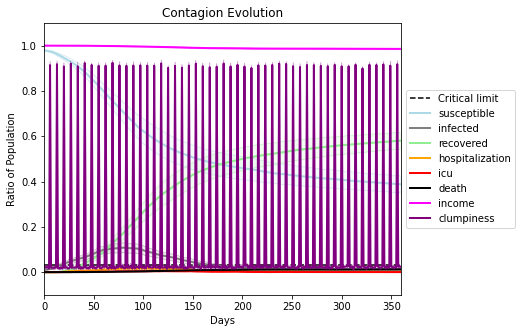

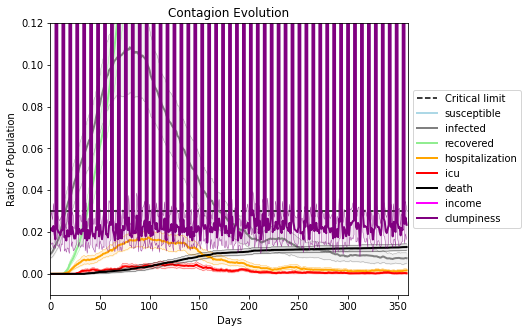

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)